In [3]:
from cleverhans.torch.attacks.fast_gradient_method import fast_gradient_method 
from cleverhans.torch.attacks.projected_gradient_descent import projected_gradient_descent
from cleverhans.torch.attacks.noise import noise 
from cleverhans.torch.attacks.hop_skip_jump_attack import hop_skip_jump_attack 
from cleverhans.torch.attacks.spsa import spsa 
from cleverhans.torch.attacks.carlini_wagner_l2 import carlini_wagner_l2 
from cleverhans.torch.attacks.sparse_l1_descent import sparse_l1_descent 

import random



In [4]:
#https://github.com/nhamlv-55/CFI_NNs/blob/master/MNIST_toy/Experiment-Feb28-xujie-Copy1.ipynb

from models import FeedforwardNeuralNetModel, TinyCNN, PatternClassifier, NewTinyCNN
import regularizer_losts as rl
from torchvision import datasets, transforms
from torch import optim
import torch
import torch.nn.functional as F
from torch.optim.lr_scheduler import StepLR
from tqdm import tqdm
import copy
import utils as CFI_utils
from matplotlib import pyplot as plt
import numpy as np
from collections import defaultdict
#from frozendict import frozendict
from datetime import datetime
# import seaborn as sn
import pandas as pd


from absl import app, flags
from easydict import EasyDict
import torch.nn as nn





%matplotlib inline

import seaborn as sns
colors = sns.color_palette("tab10")

#Logging stuffs
import logging
import sys
# Create logger
logger = logging.getLogger()
logger.setLevel(logging.INFO)

# Create STDERR handler
handler = logging.StreamHandler(sys.stderr)
# ch.setLevel(logging.DEBUG)

# Create formatter and add it to the handler
formatter = logging.Formatter('%(name)s - %(levelname)s - %(message)s')
handler.setFormatter(formatter)

# Set STDERR handler as the only handler 
logger.handlers = [handler]

#configs
epochs = 10
batch_size = 1000
test_batch_size = 10000
stable_batch_size = 60000
# use_cuda = torch.cuda.is_available()
use_cuda = False
print(use_cuda)

lr = 0.01
log_interval = 100

#torch specific configs
torch.manual_seed(1)

device = torch.device("cuda" if use_cuda else "cpu")
print(device)

train_kwargs = {'batch_size': batch_size}

test_kwargs = {'batch_size': test_batch_size}
stable_kwargs = {'batch_size': stable_batch_size}
unshuffle_kwargs = {'batch_size': test_batch_size}
unshuffle_train_kwargs = {'batch_size': stable_batch_size}

if use_cuda:
    cuda_kwargs = {'num_workers': 1,
                   'pin_memory': True,
                   'shuffle': True}
    train_kwargs.update(cuda_kwargs)
    test_kwargs.update(cuda_kwargs)
    stable_kwargs.update(cuda_kwargs)
    unshuffle_kwargs.update(cuda_kwargs)
    unshuffle_kwargs['shuffle'] = False
    unshuffle_train_kwargs.update(cuda_kwargs)
    unshuffle_train_kwargs['shuffle'] = False
class Shift:
    def __init__(self, shift = 0):
        print("alive")
        self.shift = shift

    def __call__(self, arr):
        print("running")
        #print(arr)
        return arr
    def __repr__(self) -> str:
        return f"{self.__class__.__name__}()"
    
class Rescale(object):
    """Rescale the image in a sample to a given size.

    Args:
        output_size (tuple or int): Desired output size. If tuple, output is
            matched to output_size. If int, smaller of image edges is matched
            to output_size keeping aspect ratio the same.
    """

    def __init__(self, output_size):
        assert isinstance(output_size, (int, tuple))
        self.output_size = output_size

    def __call__(self, sample):
        image, landmarks = sample['image'], sample['landmarks']

        h, w = image.shape[:2]
        if isinstance(self.output_size, int):
            if h > w:
                new_h, new_w = self.output_size * h / w, self.output_size
            else:
                new_h, new_w = self.output_size, self.output_size * w / h
        else:
            new_h, new_w = self.output_size

        new_h, new_w = int(new_h), int(new_w)

        img = transform.resize(image, (new_h, new_w))

        # h and w are swapped for landmarks because for images,
        # x and y axes are axis 1 and 0 respectively
        landmarks = landmarks * [new_w / w, new_h / h]

        return {'image': img, 'landmarks': landmarks}


transform = transforms.Compose([
    transforms.ToTensor(),
   
    transforms.Normalize((0.1307,), (0.3081,))
   
  
])

def shift_and_roll(arr : torch.Tensor, x : int , y : int) -> torch.Tensor:
    return torch.roll(arr, shifts = (x,y), dims = (0,1)) #indexing
def shift(arr : torch.Tensor, x : int , y : int) -> torch.Tensor:

    pad = [0,0,0,0]
    x_start = 0
    x_end = 0
    y_start = 0
    y_end = 0
    if x >= 0:
        pad[0] = x
        x_start = 0
        x_end = 28
    else:
        pad[1] = abs(x)
        x_start = -28
         
         
        
         
    
    if y >= 0:
        pad[2] = y
        y_start = 0
        y_end = 28
    else:
        pad[3] = abs(y)
        y_start= -28
        print("ys is {}".format(y_start))
    

    padder = torch.nn.ZeroPad2d(tuple(pad))
  
    result = padder(arr)

    if y < 0:
        y_end = result.shape[0]
    if x < 0:
        x_end = result.shape[1]
    
    return result[y_start:y_end, x_start:x_end]

def noisify(arr : torch.Tensor , distribution : torch.distributions.Distribution) -> torch.Tensor: #randomly add noise
   
    #print(distribution.sample(arr.size()).shape\\)
    #print(torch.reshape(distribution.sample(arr.size()), (28,28)).shape)
   
    noise = torch.reshape(distribution.sample(arr.size()), (arr.shape))
    return arr + noise
transform = transforms.Compose([
    transforms.ToTensor(),
   
    transforms.Normalize((0.1307,), (0.3081,))
])


False
cpu


In [5]:
def transform_dataset(dataset):
    '''
    DO A STATE CHANGE
    '''
    shift_x = 1
    shift_y = 0
    mu = 1
    sigma = 1
    do_shift = False
    do_noisfy = True
    modification_string = "base"
    if do_shift:
        modification_string += " -shift {} {} - ".format(shift_x, shift_y)
    if do_noisfy:
        modification_string += " -noise added using gaussian using mean {} and stddev {}- ".format(mu, sigma)
    for i in range(dataset.data.shape[0]):
        if do_shift:
            dataset.data[i,:,:] = shift(dataset.data[i,:,:],shift_x, shift_y)
        
        if do_noisfy:
            gaussian = torch.distributions.Normal(loc = mu, scale = sigma)# loc = mu, scale = stddev

            dataset.data[i,:,:] = noisify(dataset.data[i,:,:], gaussian)
    return modification_string

## Train/Load model


In [6]:
def check_gradient(grad, label, last_sorted_grads, plot = False):
    logging.info("CHECKING GRADIENT FOR LABEL {}".format(label))
    sum_abs_grad = np.sum(abs(grad[label]), axis = 0)
    
    current_sorted_grad = (-sum_abs_grad).argsort()
    
#     if len(last_sorted_grads[label]) > 0:
#         for k in [100, 200, 300, 400]:
#             prev_top_k = set(last_sorted_grads[label][-1][:k])
#             current_top_k = set(current_sorted_grad[:k])
#             intersect = prev_top_k.intersection(current_top_k)
#             logging.info('k = {}. How many top Gradients are stable since last epoch?: {}'.format(k, len(intersect)))
        
    for k in [0, 9, 99, 199]:    
        logging.debug('{}th biggest gradient = {}'.format(k, np.sort(-sum_abs_grad)[k]))
    if plot:
        fig = plt.figure(figsize=(30, 1))
        plt.bar(range(sum_abs_grad.shape[0]), sum_abs_grad)
        plt.show()
        print(sum_abs_grad.max(), sum_abs_grad.argmax(), sum_abs_grad.min())

    return current_sorted_grad



#init stuffs
LOAD = True
# LOADPATH = 'FFN19-17-24'
LOADPATH = 'FFN18_28_21'
# LOADPATH = 'TinyCNN14-28-29'

LAST_N_EPOCHS = 10

dataset1 = datasets.MNIST('./data', train=True, download=False,
                          transform=transform)
dataset2 = datasets.MNIST('./data', train=False, download=False,
                          transform=transform)


#transform_dataset(dataset1)
#modification_string = transform_dataset(dataset2)
modification_string = ""
train_loader = torch.utils.data.DataLoader(dataset1, **train_kwargs)
test_loader = torch.utils.data.DataLoader(dataset2, **test_kwargs)
unshuffle_train_loader = torch.utils.data.DataLoader(dataset1, **unshuffle_train_kwargs)

unshuffle_test_loader = torch.utils.data.DataLoader(dataset2, **unshuffle_kwargs)

model = FeedforwardNeuralNetModel(28*28, 128, 10).to(device)
# model = TinyCNN().to(device)

if LOAD:
    model.load_state_dict(torch.load(LOADPATH, map_location=device))
else:

    epochs = 10
    optimizer = optim.Adadelta(model.parameters(), lr=lr)

    scheduler = StepLR(optimizer, step_size=1, gamma = 0.7)
    last_sorted_grads = defaultdict(list)
    
    all_rows = []
    
    for epoch in tqdm(range(1, epochs + 1)):
        model.register_gradient()
        model.train()
        target_log  = None # need to record the label to match with the gradient later
        for data, target in train_loader:
            target_log = np.concatenate((target_log, target), axis = 0) if target_log is not None else target
            data, target = data.to(device), target.to(device)
            optimizer.zero_grad()
            output = model(data.float())
            loss = F.nll_loss(output, target)
            loss.backward()
            optimizer.step()
        CFI_utils.test(model, device, test_loader)
#         scheduler.step()
        grad = CFI_utils.get_grad_each_label(model.gradient_log, 
                                      target_log = target_log, 
                                      layers = ['fc1', 'fc2', 'fc3', 'fc4'], 
#                                       layers = ['conv1', 'conv2','fc1', 'fc2'],
                                      labels = range(10))
        torch.save(model.state_dict(), model.model_savename())
        
        row_data = []
        for label in range(10):
            r = []
            logging.info("After {} epoch:".format(epoch))
            last_sorted_grads[label].append(check_gradient(grad, label, last_sorted_grads))
            
            
            if epoch >= LAST_N_EPOCHS:
                for k in [100, 200, 300, 400]:
                    all_top_k = [set(sorted_grad[:k]) for sorted_grad in last_sorted_grads[label][-LAST_N_EPOCHS:]]
                    intersect = set.intersection(*all_top_k)
                    logging.info('k = {}. How many top Gradients are stable among all last {} epochs?: {}'.format(k, LAST_N_EPOCHS, len(intersect)))

                    

with torch.no_grad():
    total = 0
    correct = 0
    for data, target in dataset2:
        data_extend = data[None, :]
        if int(torch.argmax(model.cpu()(data.cpu()), dim = 1)) == target:
#         if int(torch.argmax(model.cuda()(data_extend.cuda()), dim = 1)) == target:
            correct += 1
        total+=1
    "accuracy {}".format( correct/total)
    modification_string += " -accuracy {}-".format( correct/total)
    print(modification_string)

model = model.to(device)

 -accuracy 0.9042-


#### Compute all patterns in the training set, and put them into corresponding labels

In [7]:
class Patterns:
    def __init__(self, model: torch.nn.Module, dataloader: torch.utils.data.DataLoader, labels, layers):
        self._model = model
        self.label2patterns = {}
        self.label2idx = {}
        self._labels = labels
        self._layers = layers
        self._dataloader = dataloader
        self._populate()
        
    def _populate(self):
        
        label2patterns = {}
        label2idx = {}
        for label in self._labels:
            patterns = []
            filter_ids = []
            
            for data, target in self._dataloader:
                
                flter = np.where(target == label)
                filter_ids.append(flter)
                data = data[flter]
                logging.debug(data.shape[0])
                pattern = self._model.get_pattern(data, layers, device, flatten = True)
                logging.debug(pattern.shape)
                patterns.append(pattern)

            patterns = np.squeeze(np.concatenate(patterns, axis = 0))
            filter_ids = np.squeeze(np.concatenate(filter_ids, axis = 0))
            label2patterns[label] = patterns
            label2idx[label] = filter_ids
            
            logging.info(patterns.shape)
        
        #freeze
        self.label2patterns = dict(label2patterns)
        self.label2idx = dict(label2idx)
        
    def apply_filter(self, f):
        pass
    
    def unique():
        pass
    
    def query_pattern():
        pass
    
    

layers = ['fc1', 'fc2', 'fc3', 'fc4']
# layers = ['conv1', 'conv2','fc1', 'fc2']

labels = range(10)
K = 25
stable_loader = torch.utils.data.DataLoader(dataset1, **stable_kwargs)

all_patterns = Patterns(model = model,
                        dataloader = stable_loader,
                        labels = labels,
                        layers = layers)
all_test_patterns = Patterns(model = model,
                        dataloader = test_loader,
                        labels = labels,
                        layers = layers)



root - INFO - (5923, 458)
root - INFO - (6742, 458)
root - INFO - (5958, 458)
root - INFO - (6131, 458)
root - INFO - (5842, 458)
root - INFO - (5421, 458)
root - INFO - (5918, 458)
root - INFO - (6265, 458)
root - INFO - (5851, 458)
root - INFO - (5949, 458)
root - INFO - (980, 458)
root - INFO - (1135, 458)
root - INFO - (1032, 458)
root - INFO - (1010, 458)
root - INFO - (982, 458)
root - INFO - (892, 458)
root - INFO - (958, 458)
root - INFO - (1028, 458)
root - INFO - (974, 458)
root - INFO - (1009, 458)


In [8]:
#we can only study gradient if the model is trained
# FIXME: should save gradient into a pickle as well
if not LOAD:
    for K in [25, 50, 100]:
        print("K=", K)
        row = []
        row.append(str(K))
        for label in labels:
            #construct the stable gradients 
            all_top_k = [set(sorted_grad[:K]) for sorted_grad in last_sorted_grads[label][-LAST_N_EPOCHS:]]
            intersect = set.intersection(*all_top_k)
            stable_grad = np.array(sorted(list(intersect)))
            print("There are {} stable grad in top K".format(len(stable_grad)))
            print(stable_grad)

            logging.info(all_patterns[label].shape)
            print("LABEL:", label)
            print("how many unique paths in the full pattern?", np.unique(all_patterns[label], axis = 0).shape)
            print("how many unique paths in the filtered pattern?", np.unique(all_patterns[label][:, stable_grad ], axis = 0).shape)
            print("how many unique paths in the randomly filtered pattern?", 
                  np.unique(patterns[:, 
                                     np.random.choice(458, len(stable_grad), replace = False) ], axis = 0).shape)
            row.append("|".join([str(len(stable_grad)),
                                 str(np.unique(all_patterns[label], axis = 0).shape[0]),
                                 str(np.unique(all_patterns[label][:, stable_grad ], axis = 0).shape[0]),
                                 str(np.unique(all_patterns[label][:, np.random.choice(458, len(stable_grad), replace = False) ], axis = 0).shape[0])
                                ]))
        all_rows.append(",".join(row)+"\n")

    with open("gradient_exp_log_2.csv", "w") as f:
        f.write("K,"+",".join([str(l) for l in labels]) + "\n")
        f.writelines(all_rows)

# Preperation Work

### get the data and target

In [10]:

for train_data, train_target in unshuffle_train_loader:
    print(train_data.size())
    print(train_target.size())

    
for test_data, test_target in unshuffle_test_loader:
    print(test_data.size())
    print(test_target.size())



mu, std = 0.1307, 0.3081
pixel_max = (1 - mu) / std
pixel_min = (0 - mu) / std

torch.Size([60000, 1, 28, 28])
torch.Size([60000])
torch.Size([10000, 1, 28, 28])
torch.Size([10000])


# Experiments

## Checking how pixel wise of modification will affect the prediction
- Calculate the min and max value of a pixel could have (which is done above, since the images are normalized)
- sample the values from min to max with equal distance, and for each pixel, setting the pixel value to the value we sample one by one and check the prediction for each setting

### From train

Check Values = [-0.42421292 -0.06357965  0.29705363  0.6576869   1.01832017  1.37895344
  1.73958671  2.10021999  2.46085326  2.82148653]
7840 done
7840 done
7840 done
7840 done
7840 done
7840 done
7840 done
7840 done
Train: At (i, j) = (7, 14) and value = 2.4608532583216127, pred = 5, before_pred = 4, gt = 7


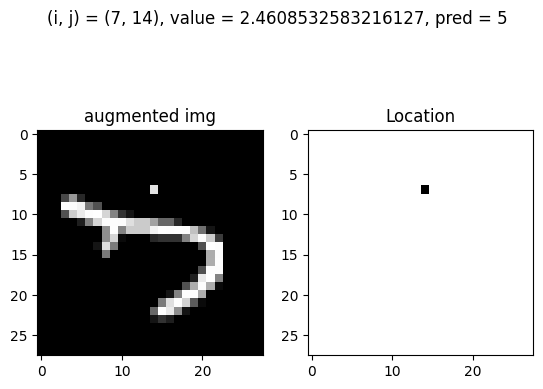

Train: At (i, j) = (7, 14) and value = 2.82148653034729, pred = 5, before_pred = 4, gt = 7


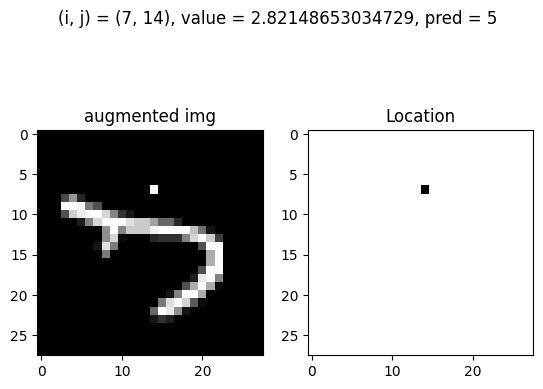

Train: At (i, j) = (7, 15) and value = 2.4608532583216127, pred = 9, before_pred = 4, gt = 7


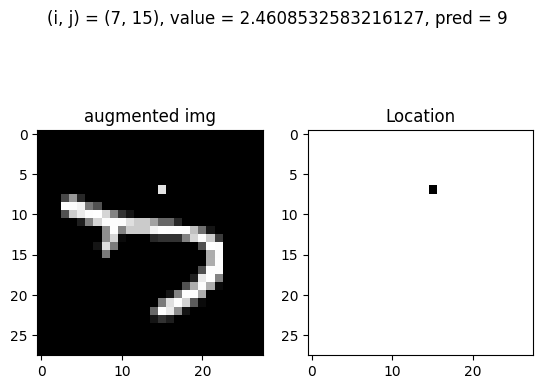

Train: At (i, j) = (7, 15) and value = 2.82148653034729, pred = 9, before_pred = 4, gt = 7


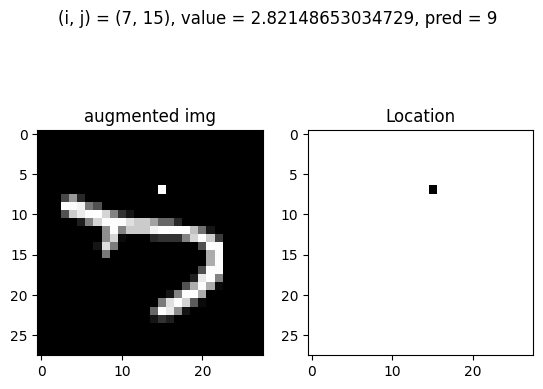

Train: At (i, j) = (7, 16) and value = 2.4608532583216127, pred = 9, before_pred = 4, gt = 7


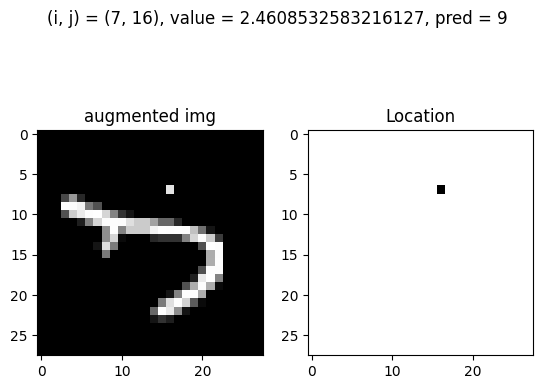

Train: At (i, j) = (7, 16) and value = 2.82148653034729, pred = 9, before_pred = 4, gt = 7


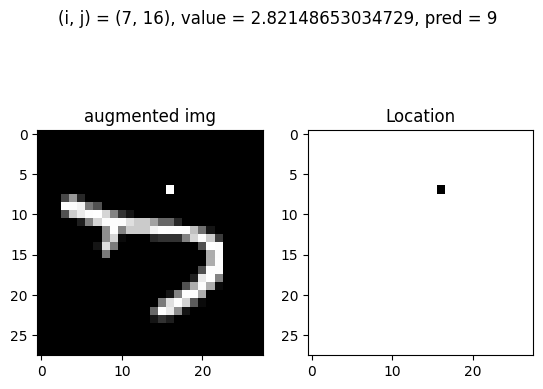

Train: At (i, j) = (7, 17) and value = 2.82148653034729, pred = 9, before_pred = 4, gt = 7


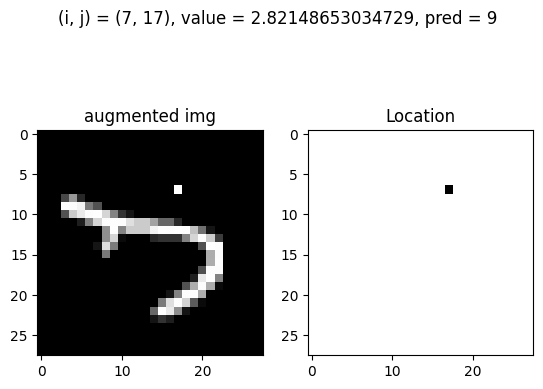

Train: At (i, j) = (8, 15) and value = 2.4608532583216127, pred = 9, before_pred = 4, gt = 7


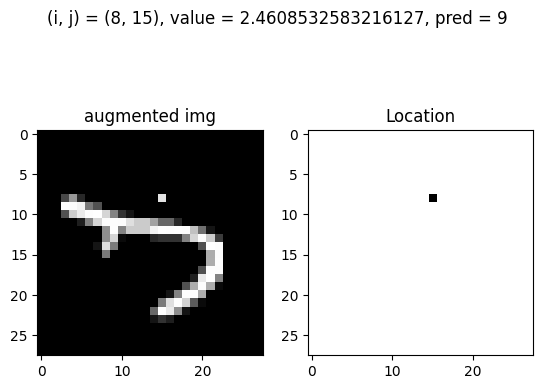

Train: At (i, j) = (8, 15) and value = 2.82148653034729, pred = 9, before_pred = 4, gt = 7


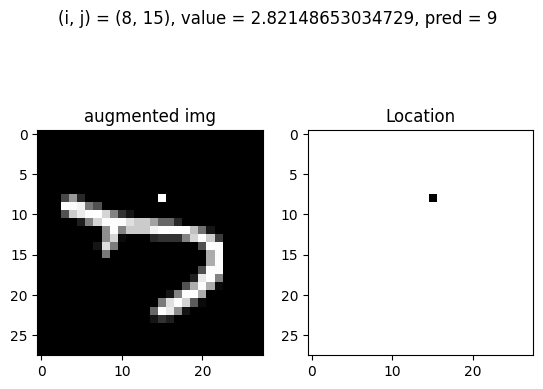

Train: At (i, j) = (9, 15) and value = 2.4608532583216127, pred = 9, before_pred = 4, gt = 7


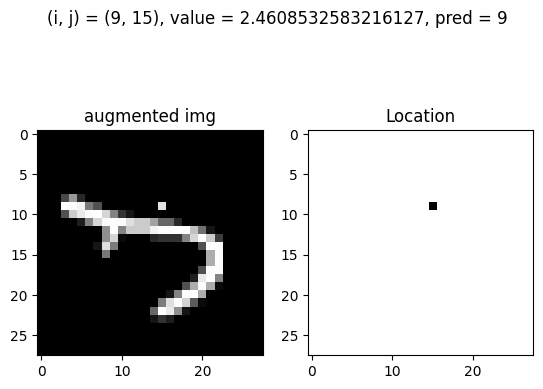

Train: At (i, j) = (9, 15) and value = 2.82148653034729, pred = 9, before_pred = 4, gt = 7


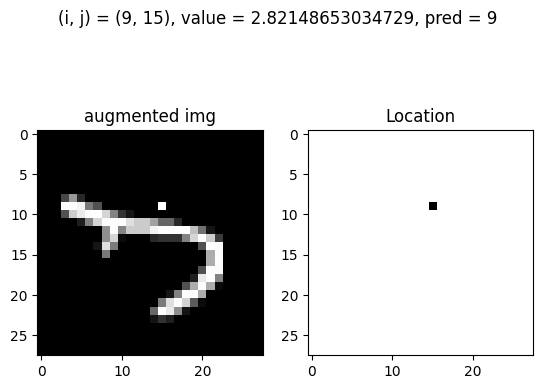

Train: At (i, j) = (12, 17) and value = -0.424212917883804, pred = 5, before_pred = 4, gt = 7


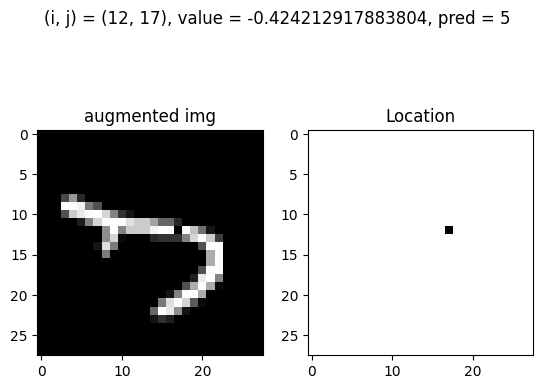

Train: At (i, j) = (20, 7) and value = 2.82148653034729, pred = 5, before_pred = 4, gt = 7


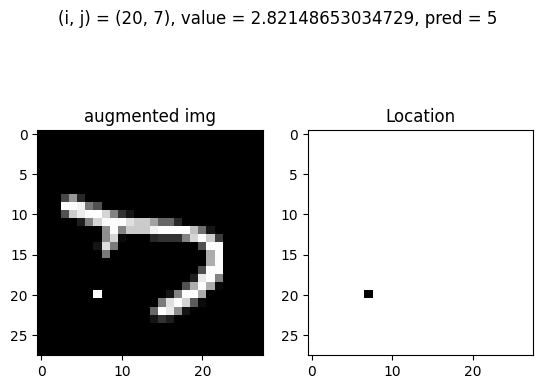

Train: At (i, j) = (20, 8) and value = 2.4608532583216127, pred = 5, before_pred = 4, gt = 7


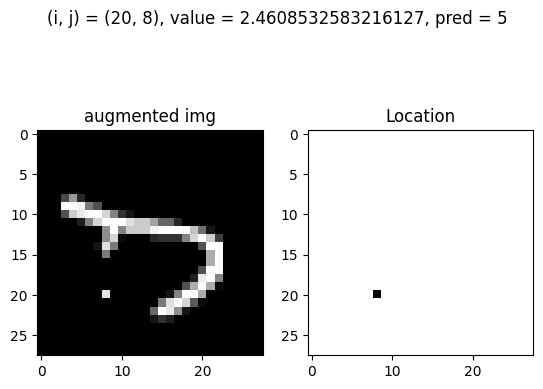

Train: At (i, j) = (20, 8) and value = 2.82148653034729, pred = 5, before_pred = 4, gt = 7


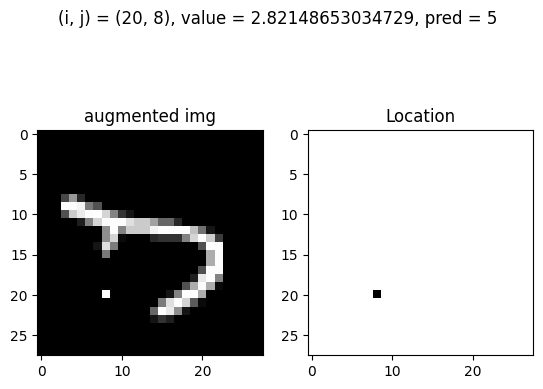

Train: At (i, j) = (21, 9) and value = 2.82148653034729, pred = 5, before_pred = 4, gt = 7


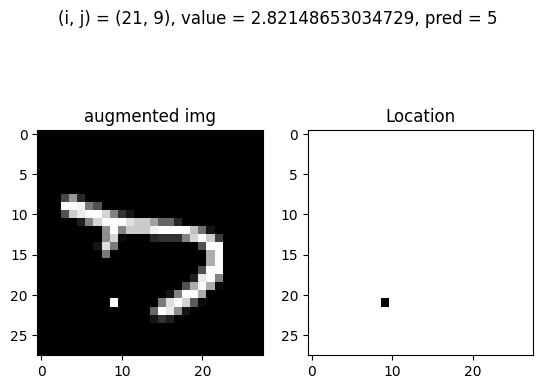

7840 done
7840 done
7840 done
7840 done
7840 done
7840 done
7840 done
7840 done
7840 done
7840 done
7840 done
7840 done
7840 done
Train: At (i, j) = (1, 15) and value = 2.82148653034729, pred = 5, before_pred = 3, gt = 5


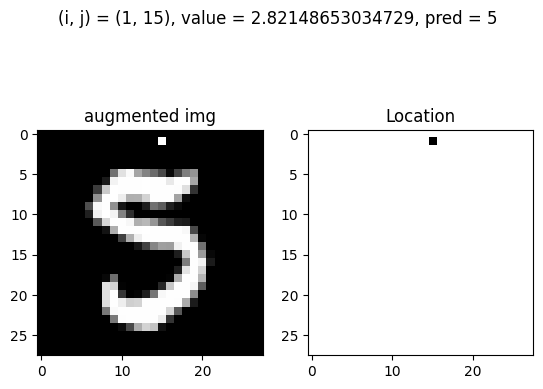

Train: At (i, j) = (4, 17) and value = 2.82148653034729, pred = 5, before_pred = 3, gt = 5


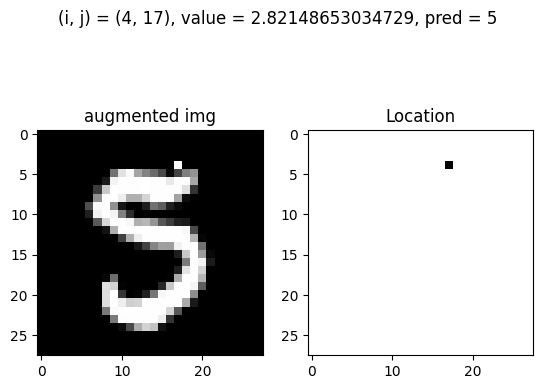

Train: At (i, j) = (4, 22) and value = 2.82148653034729, pred = 5, before_pred = 3, gt = 5


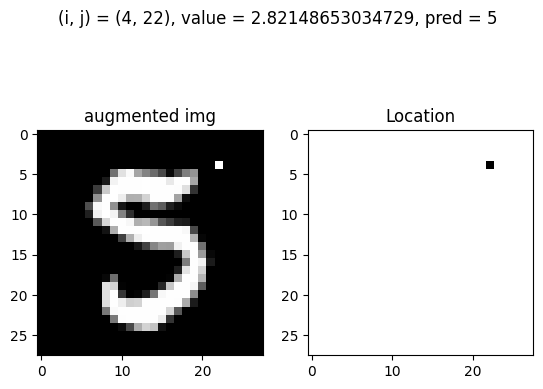

Train: At (i, j) = (5, 10) and value = -0.424212917883804, pred = 5, before_pred = 3, gt = 5


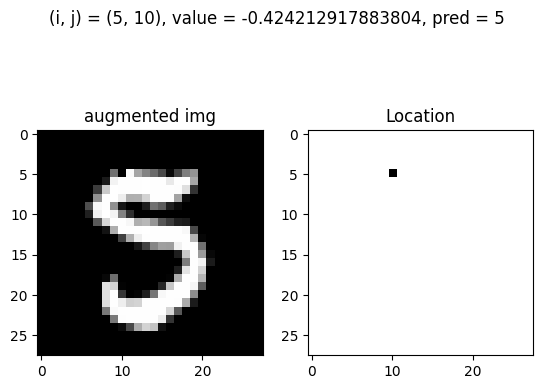

Train: At (i, j) = (5, 10) and value = -0.06357964585812692, pred = 5, before_pred = 3, gt = 5


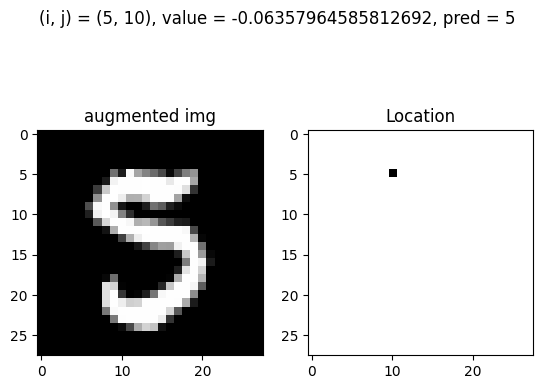

Train: At (i, j) = (5, 11) and value = -0.424212917883804, pred = 5, before_pred = 3, gt = 5


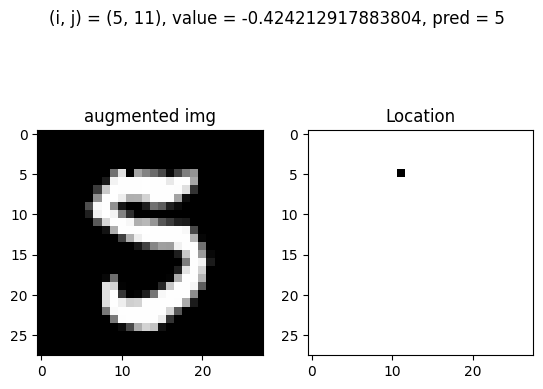

Train: At (i, j) = (5, 11) and value = -0.06357964585812692, pred = 5, before_pred = 3, gt = 5


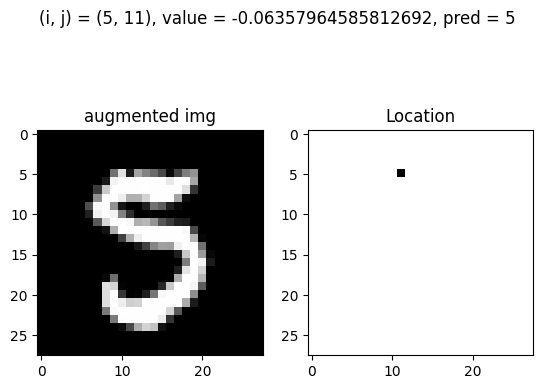

Train: At (i, j) = (5, 11) and value = 0.29705362616755016, pred = 5, before_pred = 3, gt = 5


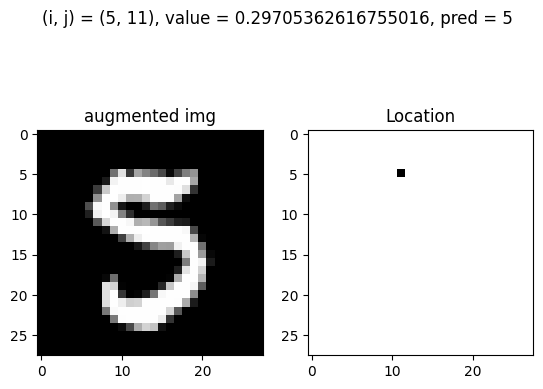

Train: At (i, j) = (5, 11) and value = 0.6576868981932272, pred = 5, before_pred = 3, gt = 5


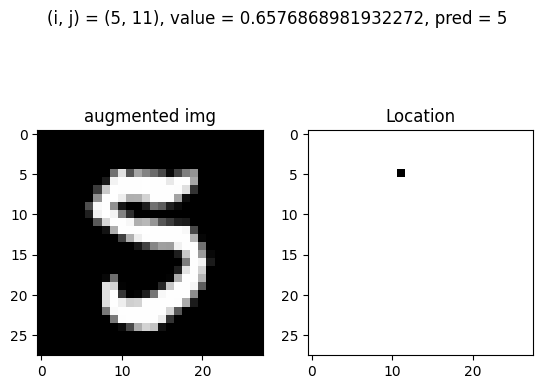

Train: At (i, j) = (5, 11) and value = 1.0183201702189044, pred = 5, before_pred = 3, gt = 5


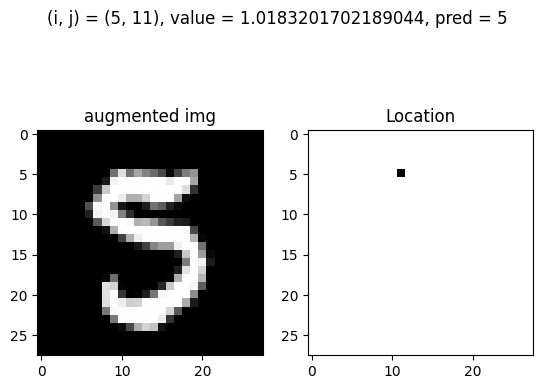

Train: At (i, j) = (5, 21) and value = 2.1002199862959356, pred = 5, before_pred = 3, gt = 5


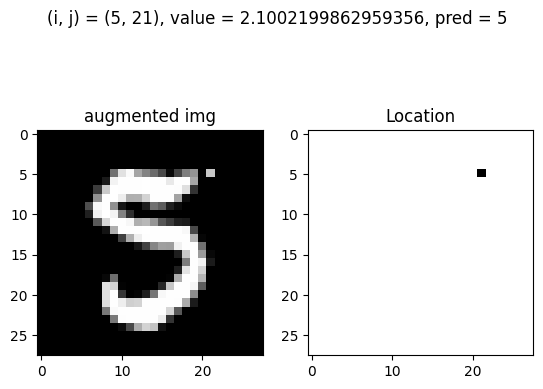

Train: At (i, j) = (5, 21) and value = 2.4608532583216127, pred = 5, before_pred = 3, gt = 5


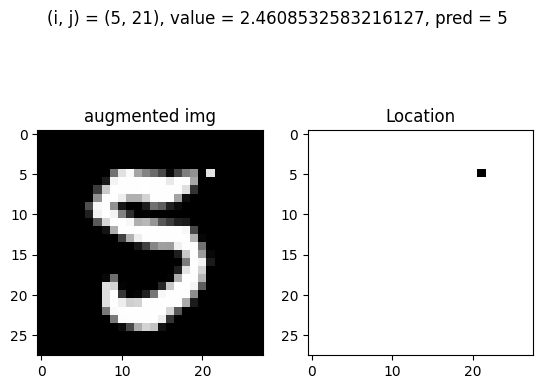

Train: At (i, j) = (5, 21) and value = 2.82148653034729, pred = 5, before_pred = 3, gt = 5


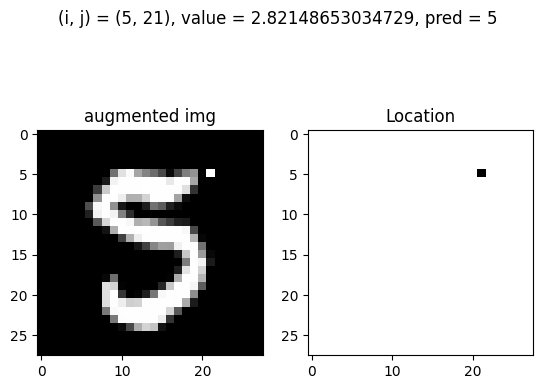

Train: At (i, j) = (6, 9) and value = -0.424212917883804, pred = 5, before_pred = 3, gt = 5


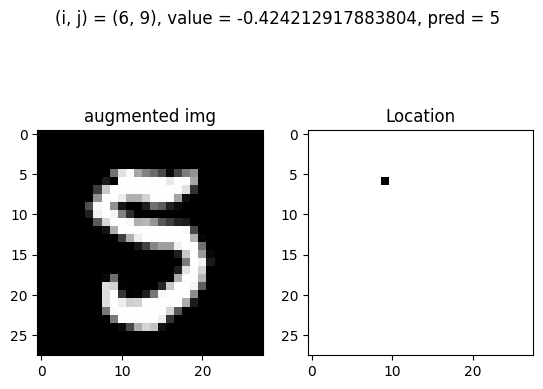

Train: At (i, j) = (6, 10) and value = -0.424212917883804, pred = 5, before_pred = 3, gt = 5


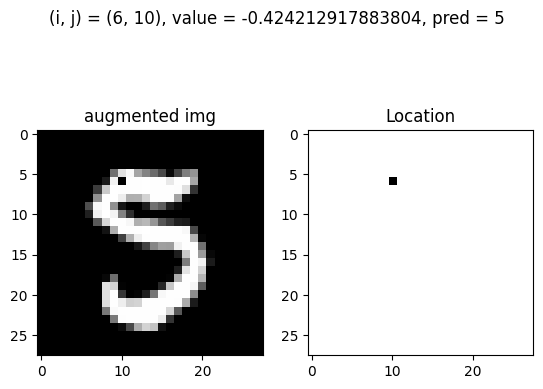

Train: At (i, j) = (6, 10) and value = -0.06357964585812692, pred = 5, before_pred = 3, gt = 5


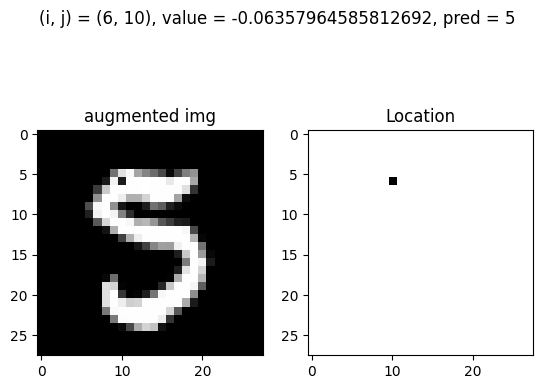

Train: At (i, j) = (6, 11) and value = -0.424212917883804, pred = 5, before_pred = 3, gt = 5


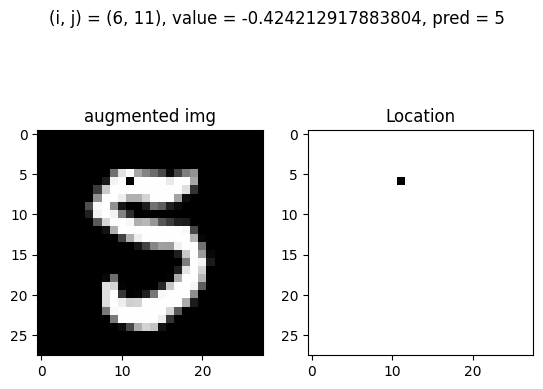

Train: At (i, j) = (6, 12) and value = -0.424212917883804, pred = 5, before_pred = 3, gt = 5


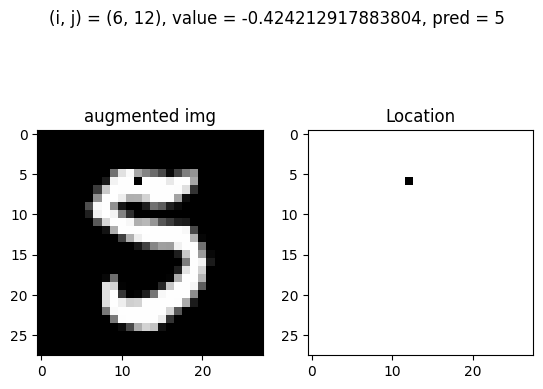

Train: At (i, j) = (6, 12) and value = -0.06357964585812692, pred = 5, before_pred = 3, gt = 5


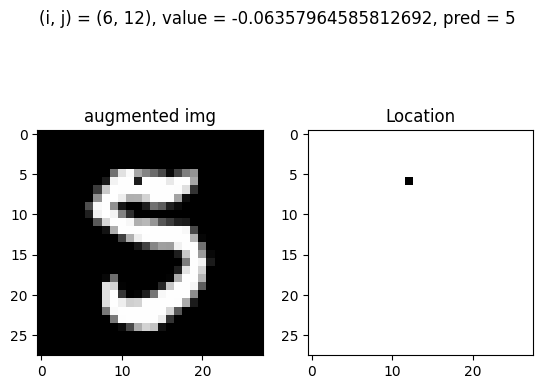

Train: At (i, j) = (6, 12) and value = 0.29705362616755016, pred = 5, before_pred = 3, gt = 5


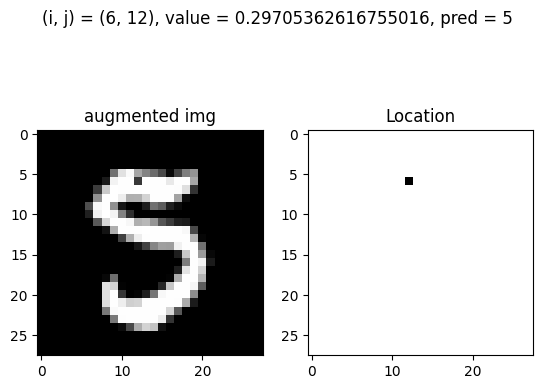

Train: At (i, j) = (6, 14) and value = -0.424212917883804, pred = 5, before_pred = 3, gt = 5


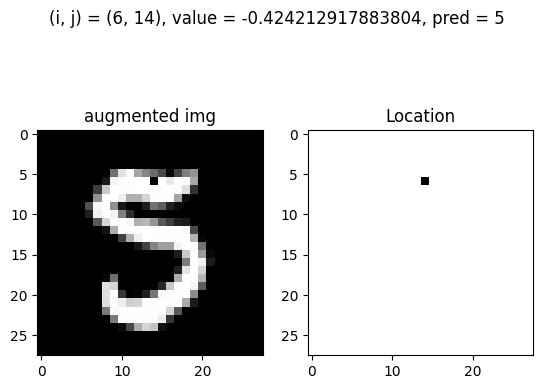

Train: At (i, j) = (6, 14) and value = -0.06357964585812692, pred = 5, before_pred = 3, gt = 5


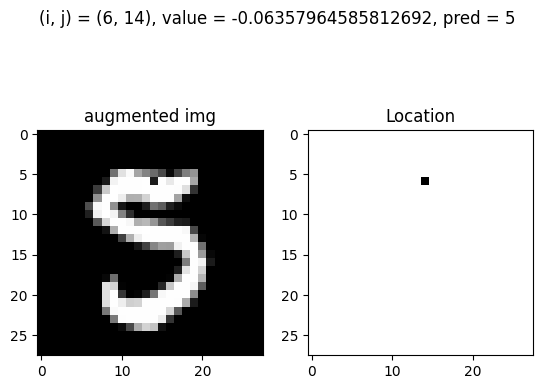

Train: At (i, j) = (6, 23) and value = 2.4608532583216127, pred = 5, before_pred = 3, gt = 5


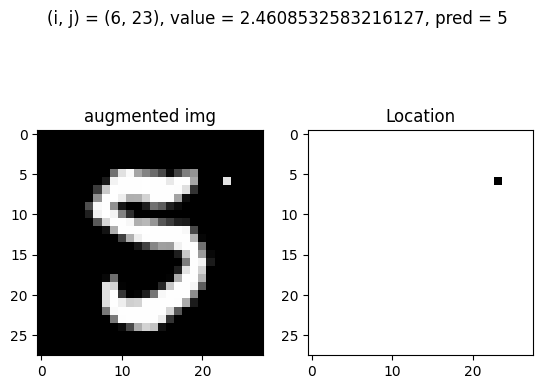

Train: At (i, j) = (6, 23) and value = 2.82148653034729, pred = 5, before_pred = 3, gt = 5


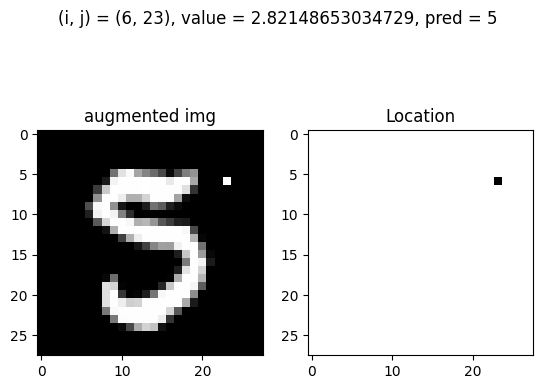

Train: At (i, j) = (6, 24) and value = 1.7395867142702586, pred = 5, before_pred = 3, gt = 5


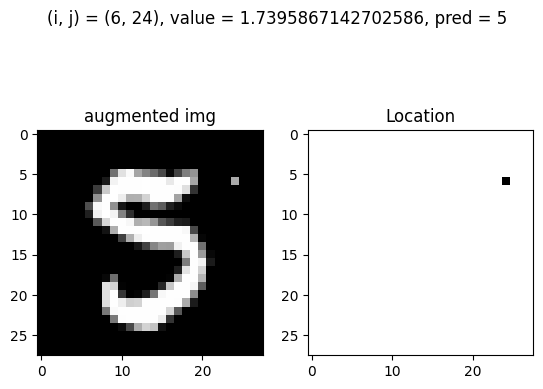

Train: At (i, j) = (6, 24) and value = 2.1002199862959356, pred = 5, before_pred = 3, gt = 5


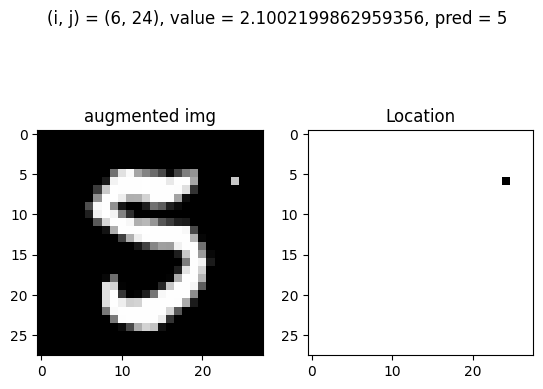

Train: At (i, j) = (6, 24) and value = 2.4608532583216127, pred = 5, before_pred = 3, gt = 5


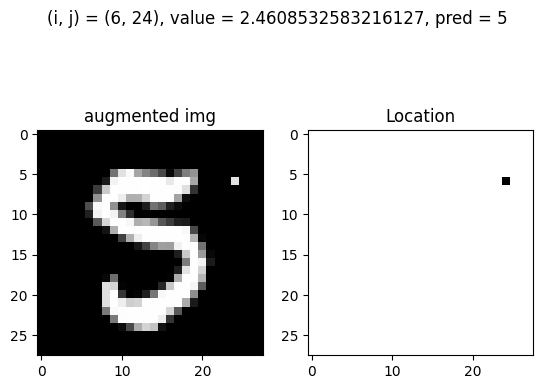

Train: At (i, j) = (6, 24) and value = 2.82148653034729, pred = 5, before_pred = 3, gt = 5


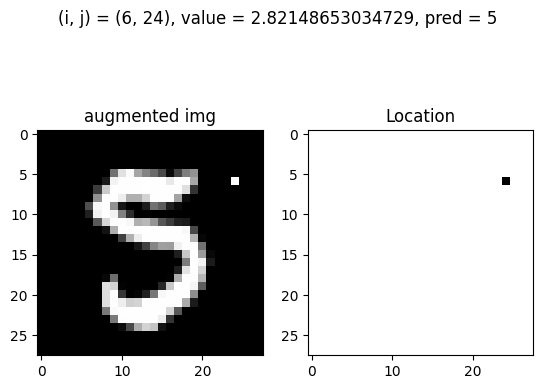

Train: At (i, j) = (7, 8) and value = -0.424212917883804, pred = 5, before_pred = 3, gt = 5


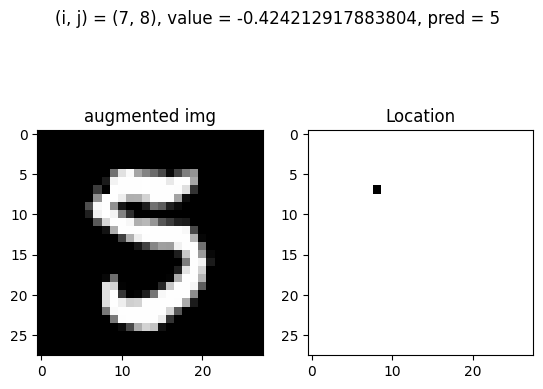

Train: At (i, j) = (7, 8) and value = -0.06357964585812692, pred = 5, before_pred = 3, gt = 5


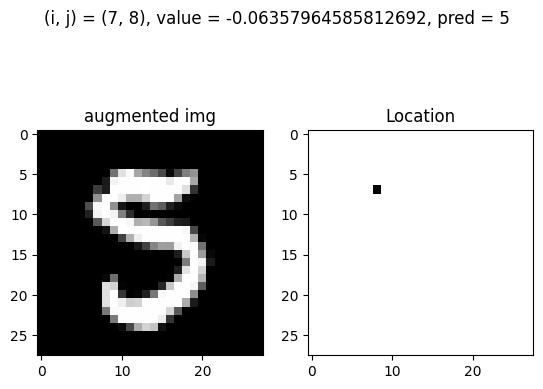

Train: At (i, j) = (7, 9) and value = -0.424212917883804, pred = 5, before_pred = 3, gt = 5


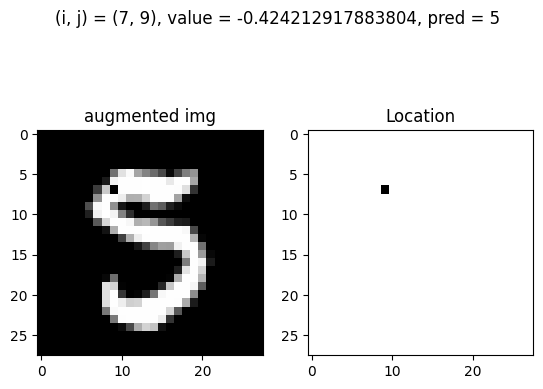

Train: At (i, j) = (7, 10) and value = -0.424212917883804, pred = 5, before_pred = 3, gt = 5


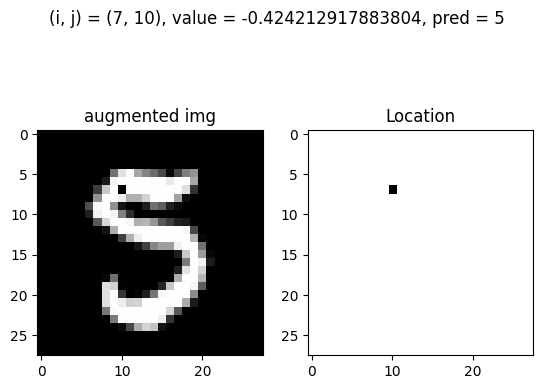

Train: At (i, j) = (7, 23) and value = 2.1002199862959356, pred = 5, before_pred = 3, gt = 5


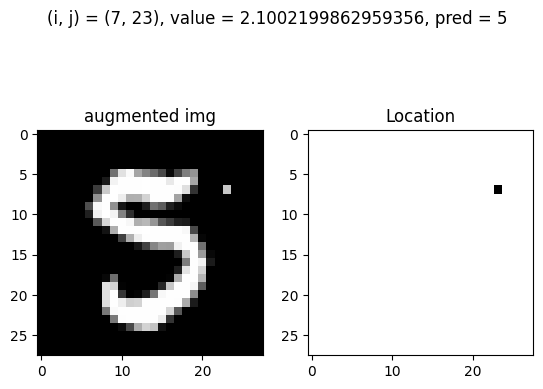

Train: At (i, j) = (7, 23) and value = 2.4608532583216127, pred = 5, before_pred = 3, gt = 5


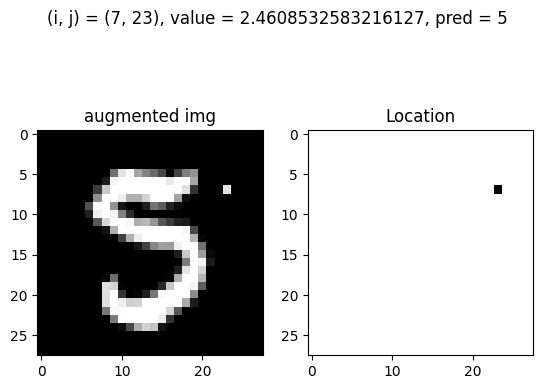

Train: At (i, j) = (7, 23) and value = 2.82148653034729, pred = 5, before_pred = 3, gt = 5


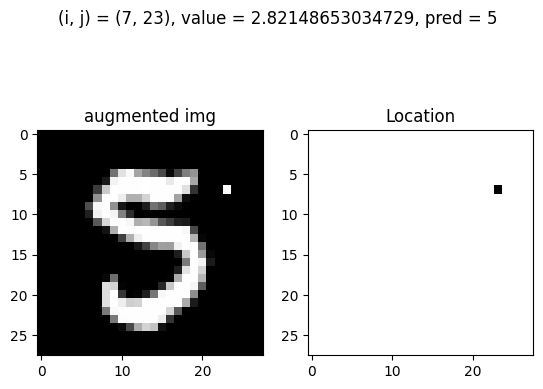

Train: At (i, j) = (8, 14) and value = -0.424212917883804, pred = 5, before_pred = 3, gt = 5


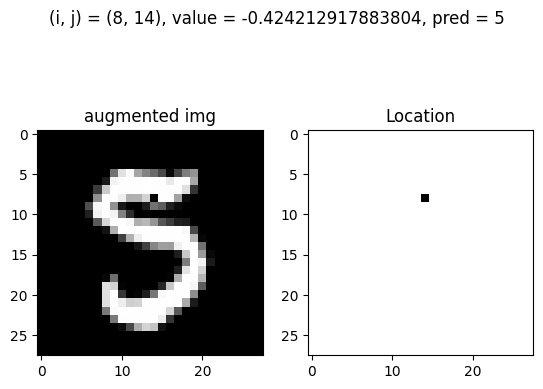

Train: At (i, j) = (8, 16) and value = -0.424212917883804, pred = 5, before_pred = 3, gt = 5


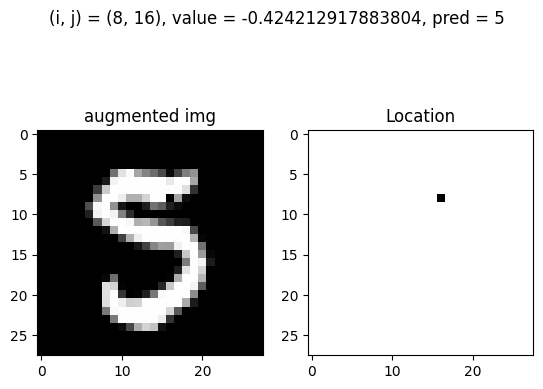

Train: At (i, j) = (8, 23) and value = 2.4608532583216127, pred = 5, before_pred = 3, gt = 5


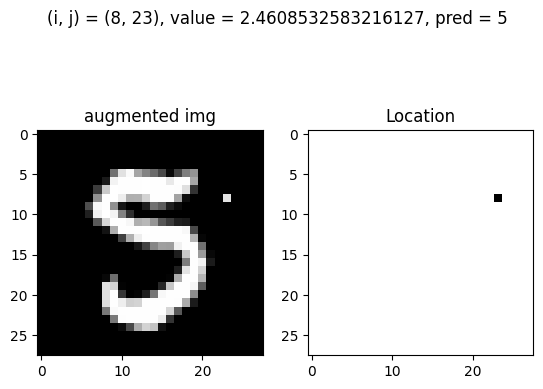

Train: At (i, j) = (8, 23) and value = 2.82148653034729, pred = 5, before_pred = 3, gt = 5


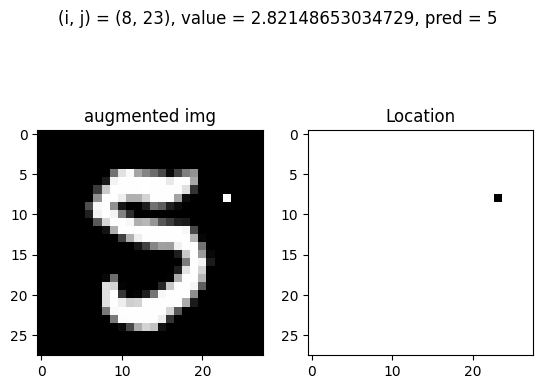

Train: At (i, j) = (9, 10) and value = 2.82148653034729, pred = 5, before_pred = 3, gt = 5


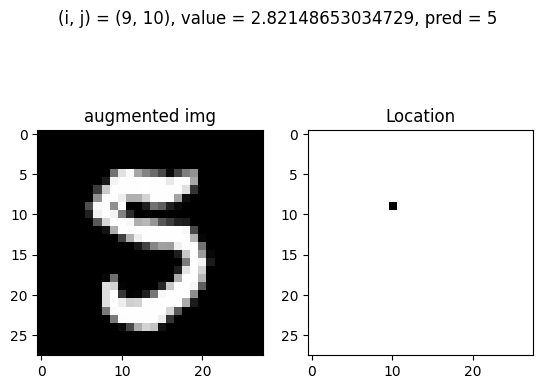

Train: At (i, j) = (9, 11) and value = 1.7395867142702586, pred = 5, before_pred = 3, gt = 5


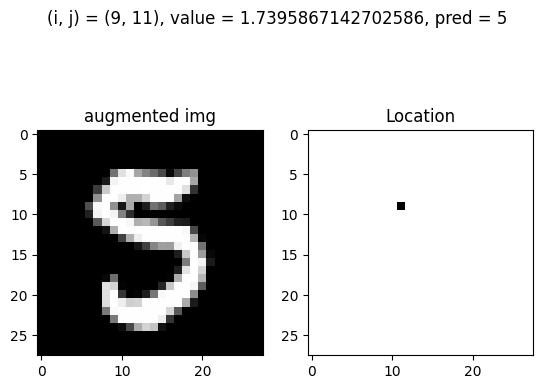

Train: At (i, j) = (9, 11) and value = 2.1002199862959356, pred = 5, before_pred = 3, gt = 5


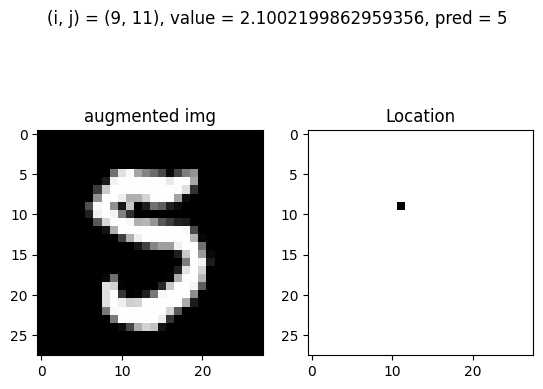

Train: At (i, j) = (9, 11) and value = 2.4608532583216127, pred = 5, before_pred = 3, gt = 5


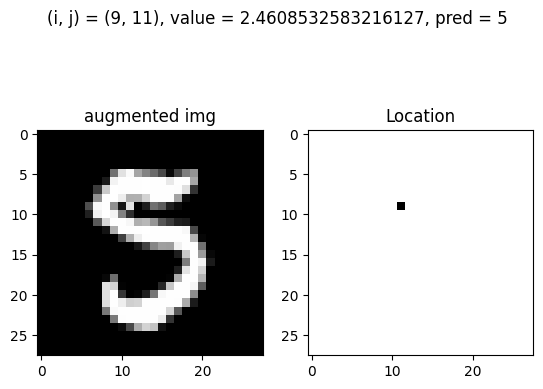

Train: At (i, j) = (9, 11) and value = 2.82148653034729, pred = 5, before_pred = 3, gt = 5


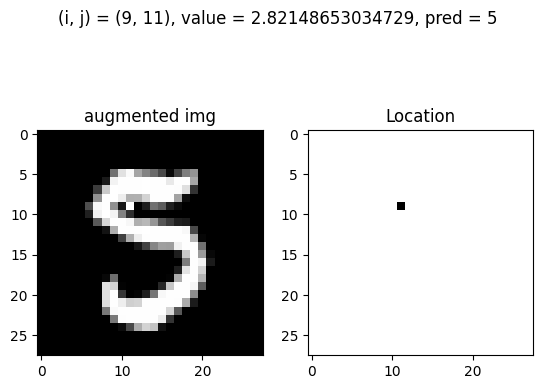

Train: At (i, j) = (10, 10) and value = 2.4608532583216127, pred = 5, before_pred = 3, gt = 5


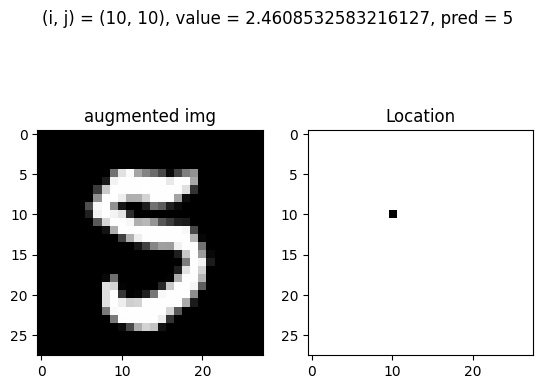

Train: At (i, j) = (10, 10) and value = 2.82148653034729, pred = 5, before_pred = 3, gt = 5


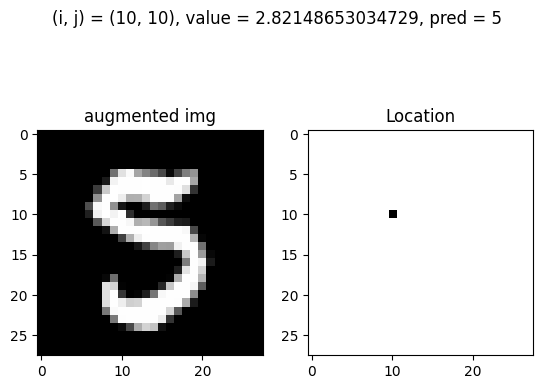

Train: At (i, j) = (10, 11) and value = 1.3789534422445815, pred = 5, before_pred = 3, gt = 5


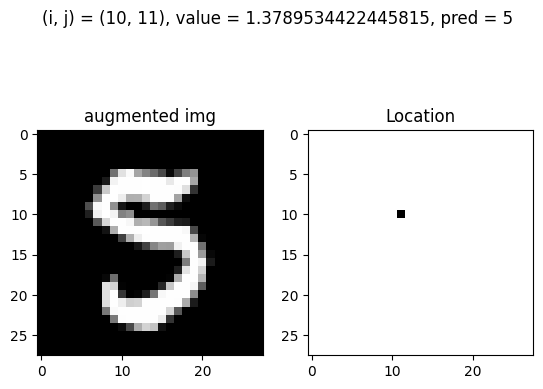

Train: At (i, j) = (10, 11) and value = 1.7395867142702586, pred = 5, before_pred = 3, gt = 5


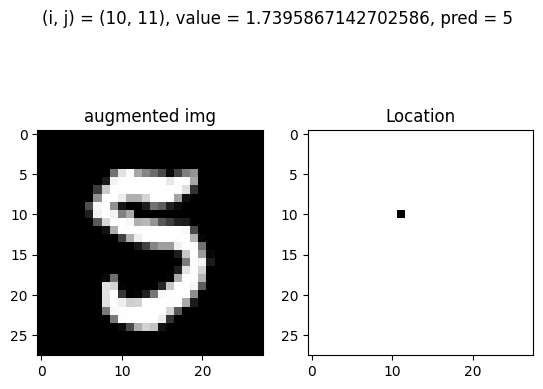

Train: At (i, j) = (10, 11) and value = 2.1002199862959356, pred = 5, before_pred = 3, gt = 5


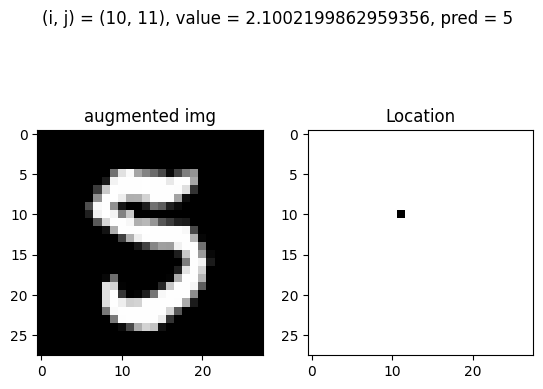

Train: At (i, j) = (10, 11) and value = 2.4608532583216127, pred = 5, before_pred = 3, gt = 5


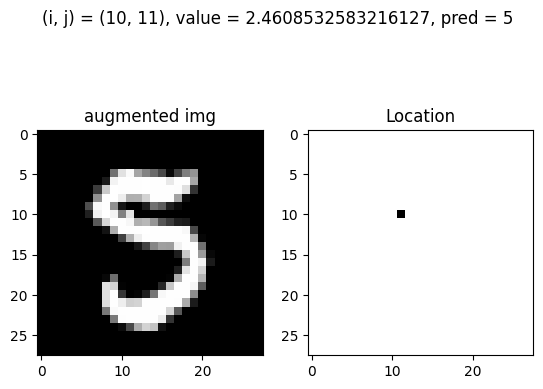

Train: At (i, j) = (10, 11) and value = 2.82148653034729, pred = 5, before_pred = 3, gt = 5


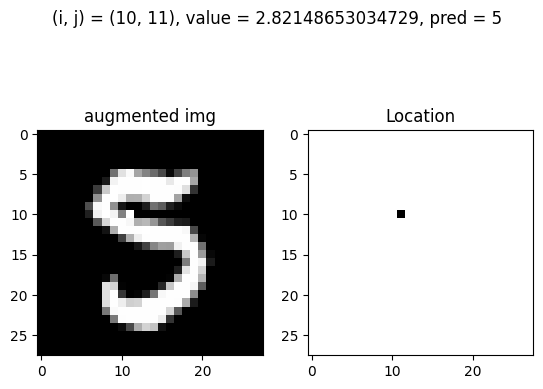

Train: At (i, j) = (10, 12) and value = 1.3789534422445815, pred = 5, before_pred = 3, gt = 5


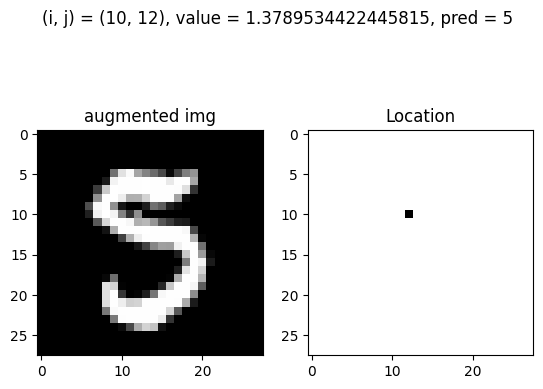

Train: At (i, j) = (10, 12) and value = 1.7395867142702586, pred = 5, before_pred = 3, gt = 5


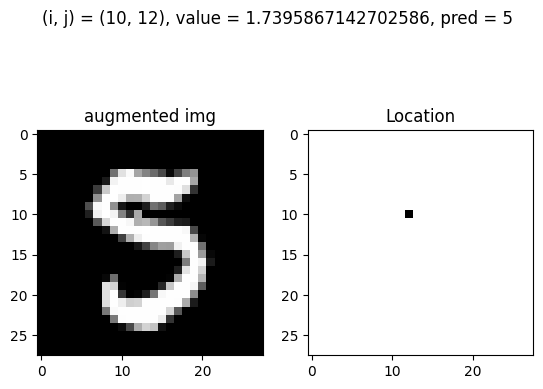

Train: At (i, j) = (10, 12) and value = 2.1002199862959356, pred = 5, before_pred = 3, gt = 5


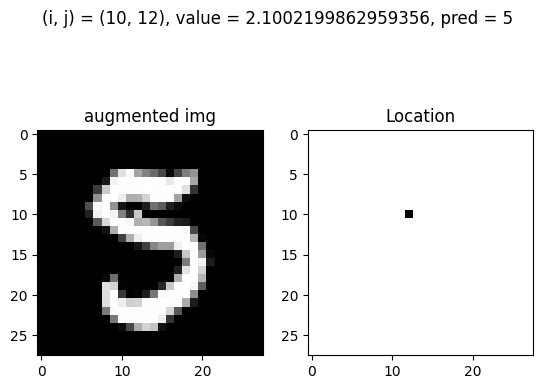

Train: At (i, j) = (10, 12) and value = 2.4608532583216127, pred = 5, before_pred = 3, gt = 5


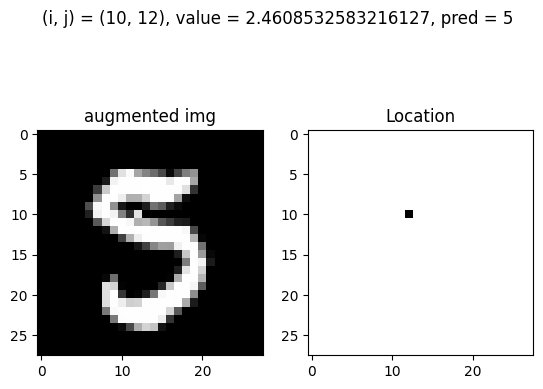

Train: At (i, j) = (10, 12) and value = 2.82148653034729, pred = 5, before_pred = 3, gt = 5


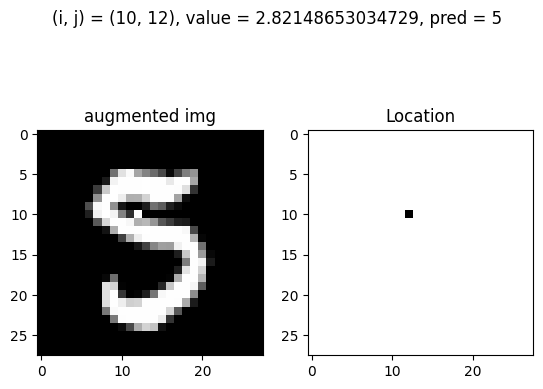

Train: At (i, j) = (10, 22) and value = 2.1002199862959356, pred = 5, before_pred = 3, gt = 5


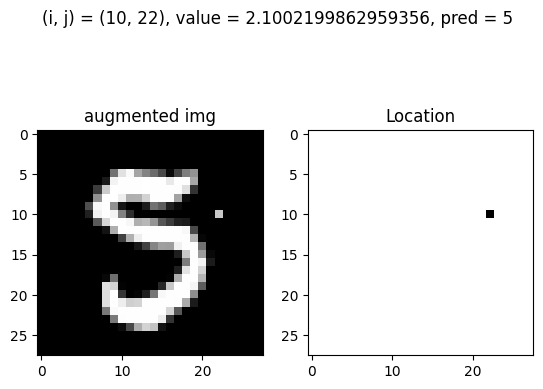

Train: At (i, j) = (10, 22) and value = 2.4608532583216127, pred = 5, before_pred = 3, gt = 5


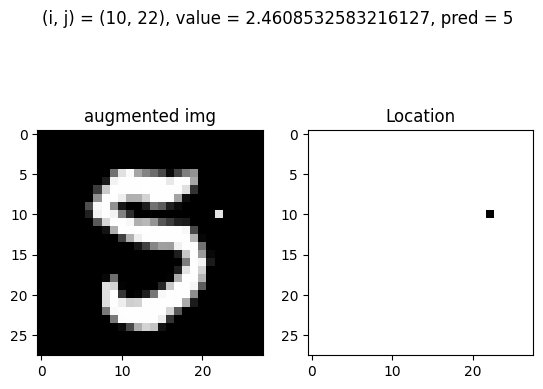

Train: At (i, j) = (10, 22) and value = 2.82148653034729, pred = 5, before_pred = 3, gt = 5


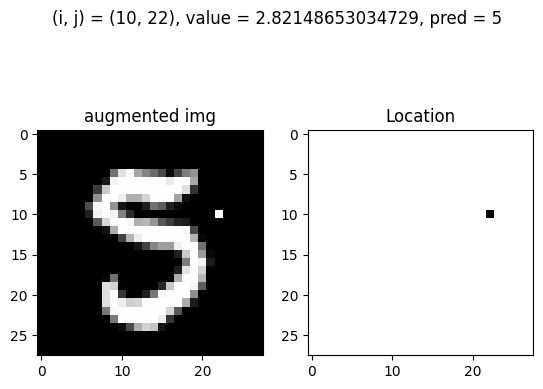

Train: At (i, j) = (11, 6) and value = 2.4608532583216127, pred = 5, before_pred = 3, gt = 5


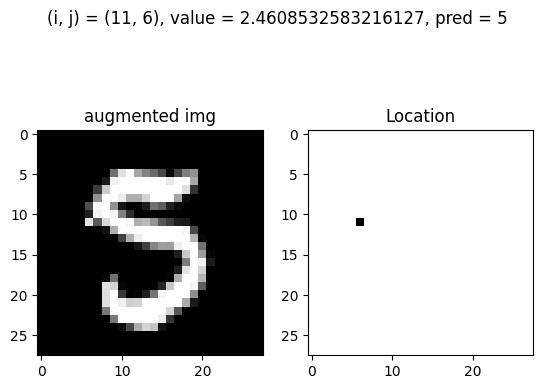

Train: At (i, j) = (11, 6) and value = 2.82148653034729, pred = 5, before_pred = 3, gt = 5


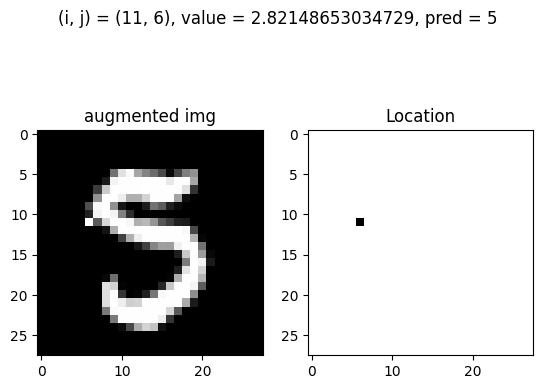

Train: At (i, j) = (11, 7) and value = 2.82148653034729, pred = 5, before_pred = 3, gt = 5


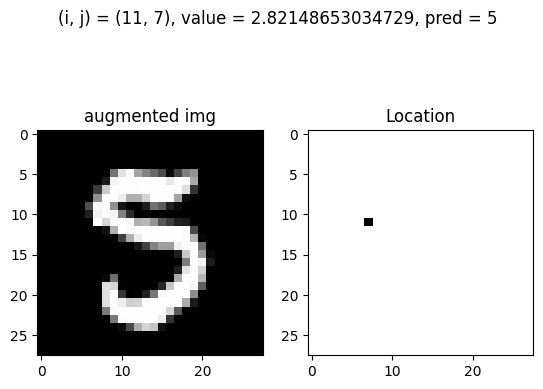

Train: At (i, j) = (11, 21) and value = 2.4608532583216127, pred = 5, before_pred = 3, gt = 5


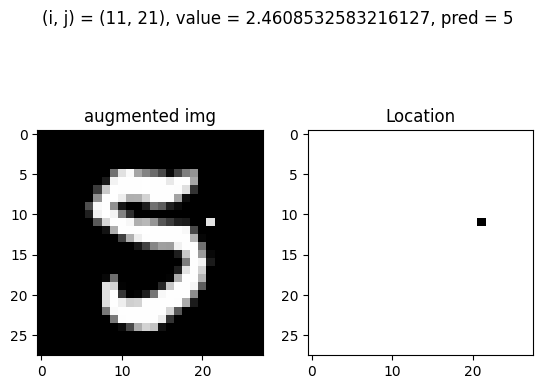

Train: At (i, j) = (11, 21) and value = 2.82148653034729, pred = 5, before_pred = 3, gt = 5


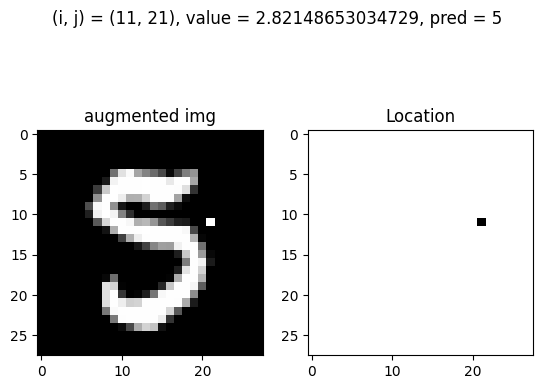

Train: At (i, j) = (12, 6) and value = 2.82148653034729, pred = 5, before_pred = 3, gt = 5


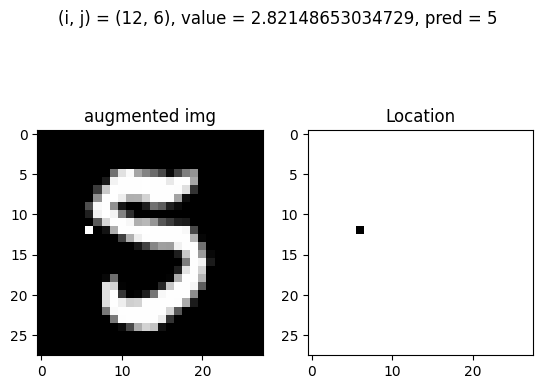

Train: At (i, j) = (12, 7) and value = 1.0183201702189044, pred = 5, before_pred = 3, gt = 5


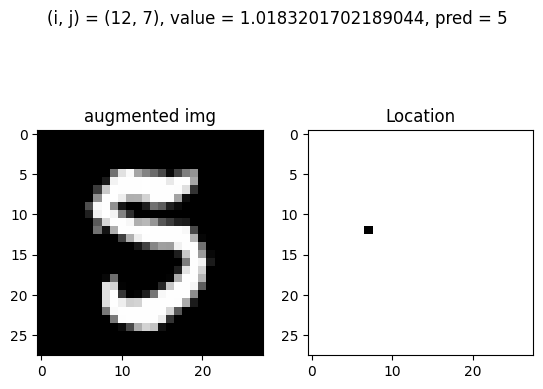

Train: At (i, j) = (12, 7) and value = 1.3789534422445815, pred = 5, before_pred = 3, gt = 5


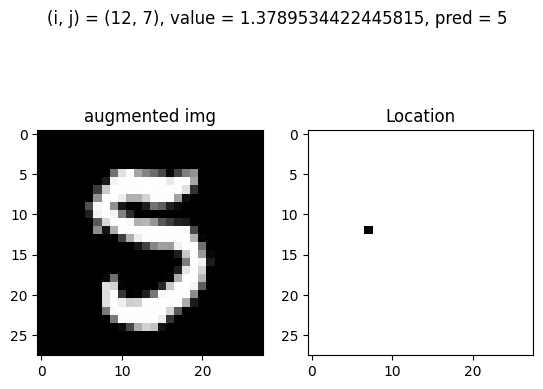

Train: At (i, j) = (12, 7) and value = 1.7395867142702586, pred = 5, before_pred = 3, gt = 5


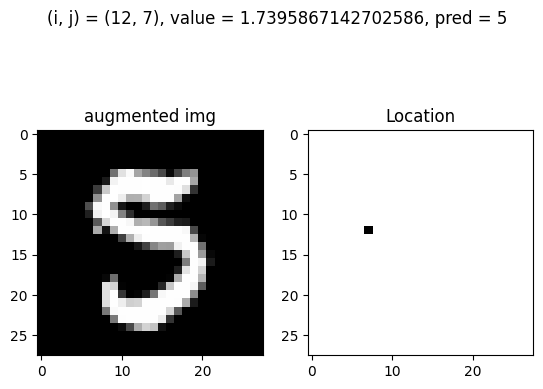

Train: At (i, j) = (12, 7) and value = 2.1002199862959356, pred = 5, before_pred = 3, gt = 5


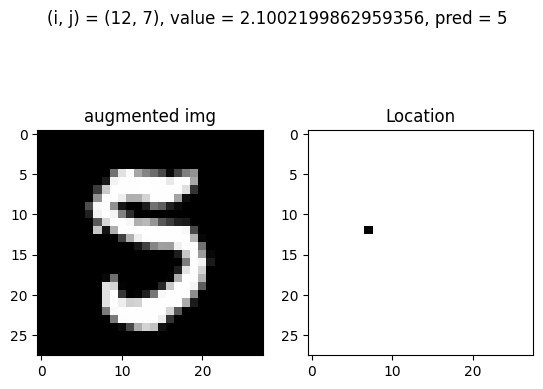

Train: At (i, j) = (12, 7) and value = 2.4608532583216127, pred = 5, before_pred = 3, gt = 5


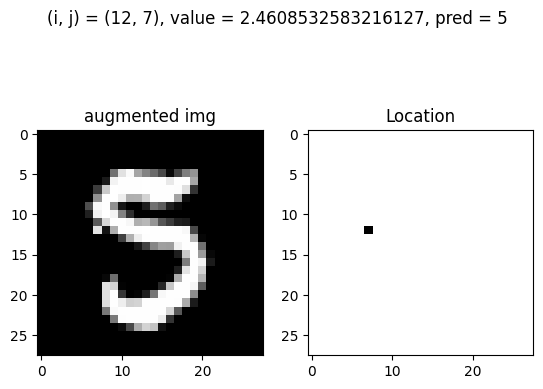

Train: At (i, j) = (12, 7) and value = 2.82148653034729, pred = 5, before_pred = 3, gt = 5


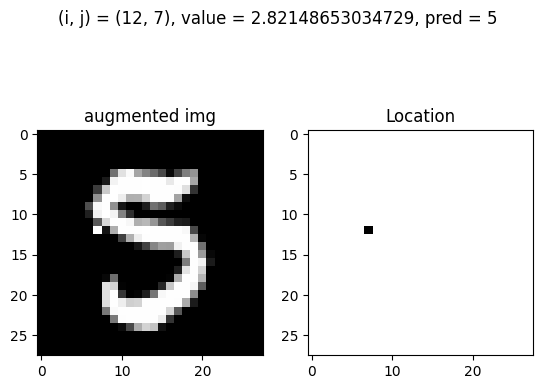

Train: At (i, j) = (12, 8) and value = 1.0183201702189044, pred = 5, before_pred = 3, gt = 5


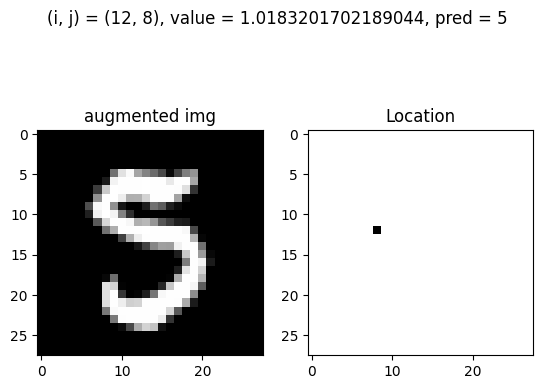

Train: At (i, j) = (12, 8) and value = 1.3789534422445815, pred = 5, before_pred = 3, gt = 5


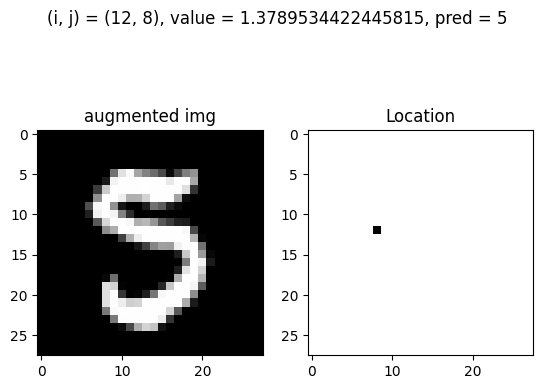

Train: At (i, j) = (12, 8) and value = 1.7395867142702586, pred = 5, before_pred = 3, gt = 5


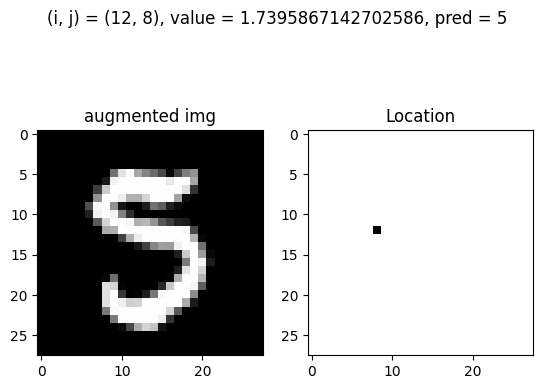

Train: At (i, j) = (12, 8) and value = 2.1002199862959356, pred = 5, before_pred = 3, gt = 5


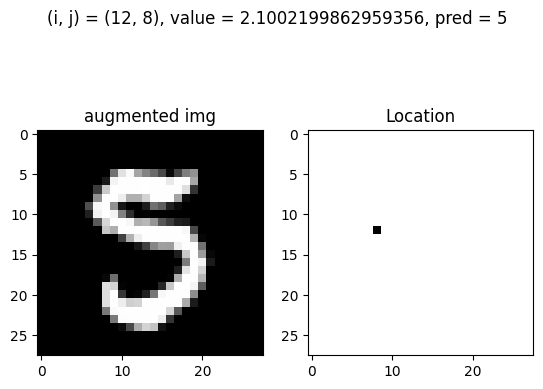

Train: At (i, j) = (12, 8) and value = 2.4608532583216127, pred = 5, before_pred = 3, gt = 5


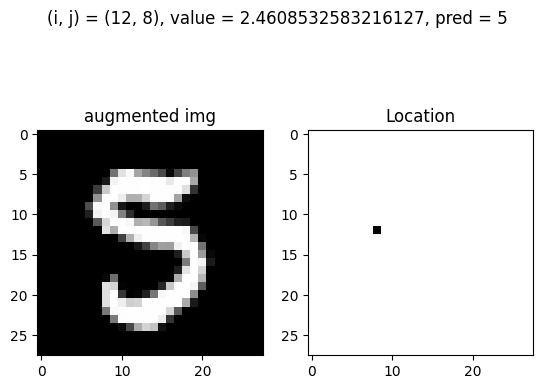

Train: At (i, j) = (12, 8) and value = 2.82148653034729, pred = 5, before_pred = 3, gt = 5


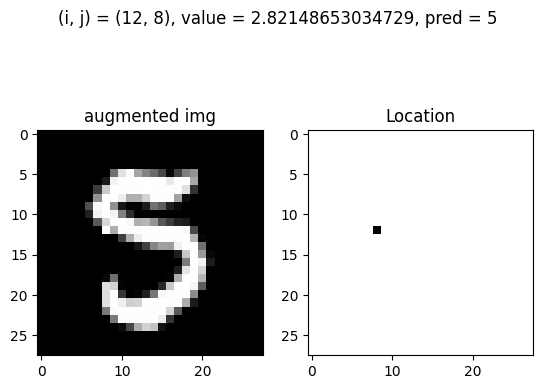

Train: At (i, j) = (12, 14) and value = -0.424212917883804, pred = 5, before_pred = 3, gt = 5


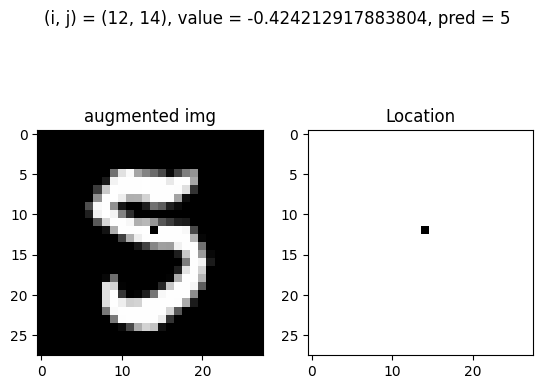

Train: At (i, j) = (12, 14) and value = -0.06357964585812692, pred = 5, before_pred = 3, gt = 5


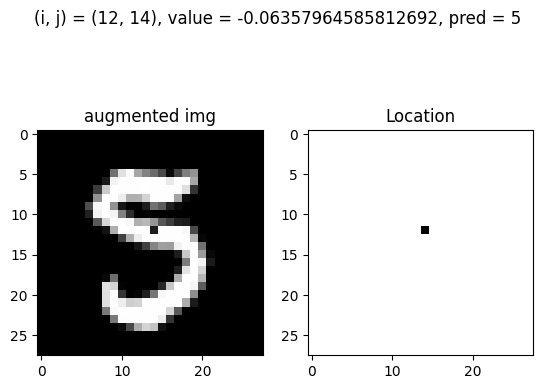

Train: At (i, j) = (12, 14) and value = 0.29705362616755016, pred = 5, before_pred = 3, gt = 5


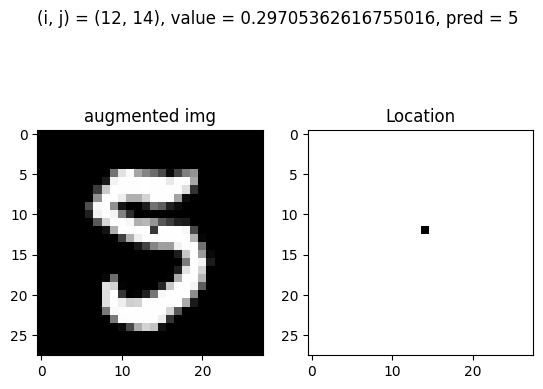

Train: At (i, j) = (12, 14) and value = 0.6576868981932272, pred = 5, before_pred = 3, gt = 5


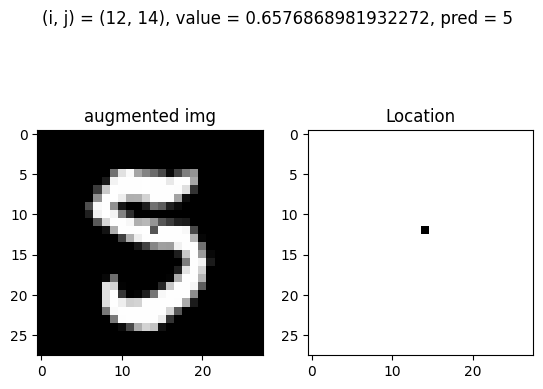

Train: At (i, j) = (12, 15) and value = -0.424212917883804, pred = 5, before_pred = 3, gt = 5


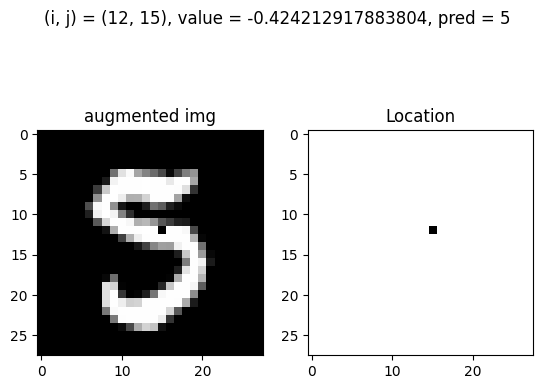

Train: At (i, j) = (12, 15) and value = -0.06357964585812692, pred = 5, before_pred = 3, gt = 5


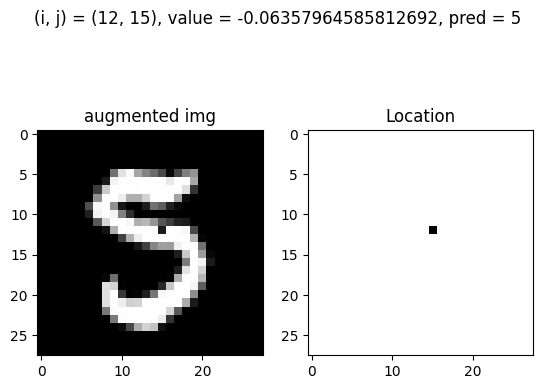

Train: At (i, j) = (12, 15) and value = 0.29705362616755016, pred = 5, before_pred = 3, gt = 5


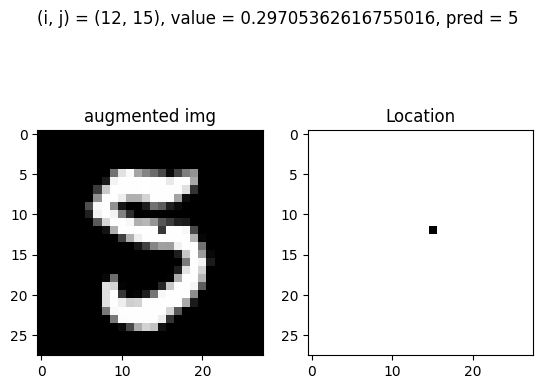

Train: At (i, j) = (12, 15) and value = 0.6576868981932272, pred = 5, before_pred = 3, gt = 5


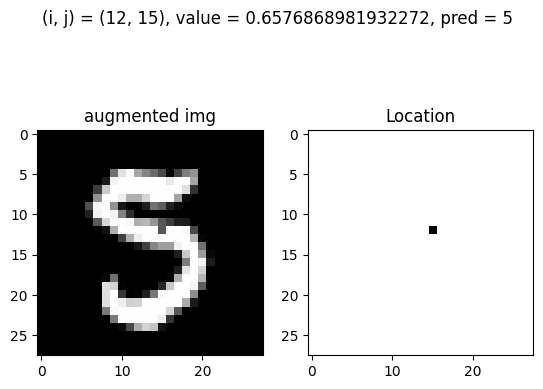

Train: At (i, j) = (12, 15) and value = 1.0183201702189044, pred = 5, before_pred = 3, gt = 5


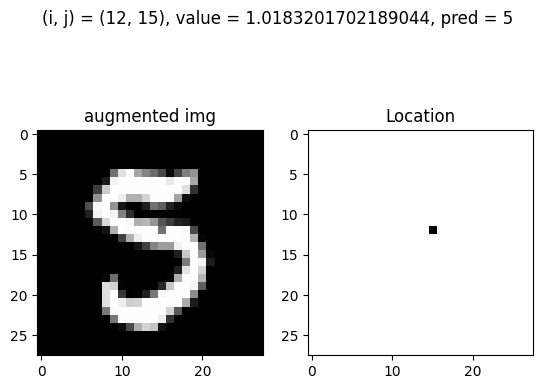

Train: At (i, j) = (12, 16) and value = -0.424212917883804, pred = 5, before_pred = 3, gt = 5


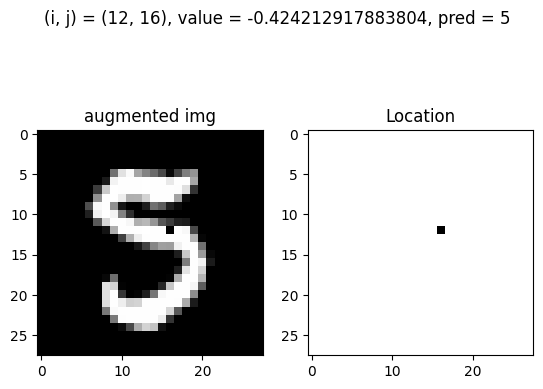

Train: At (i, j) = (12, 16) and value = -0.06357964585812692, pred = 5, before_pred = 3, gt = 5


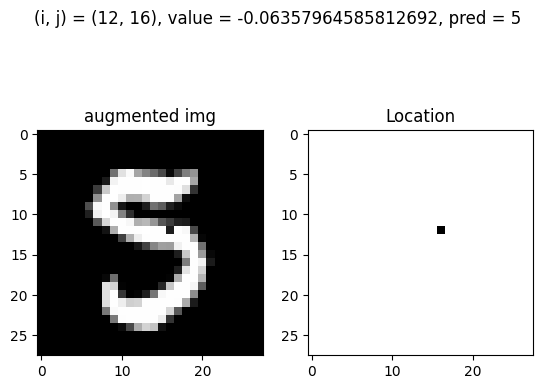

Train: At (i, j) = (12, 17) and value = -0.424212917883804, pred = 5, before_pred = 3, gt = 5


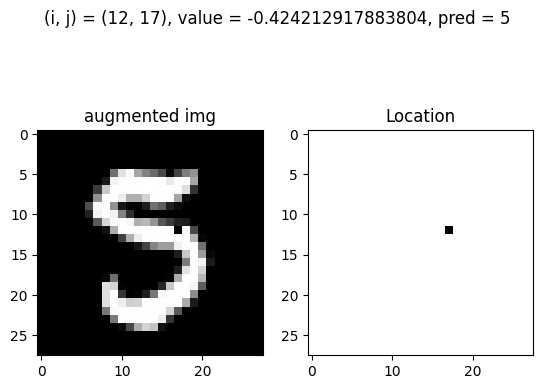

Train: At (i, j) = (12, 17) and value = -0.06357964585812692, pred = 5, before_pred = 3, gt = 5


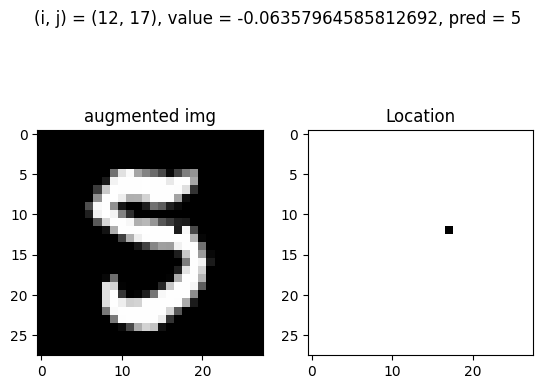

Train: At (i, j) = (12, 17) and value = 0.29705362616755016, pred = 5, before_pred = 3, gt = 5


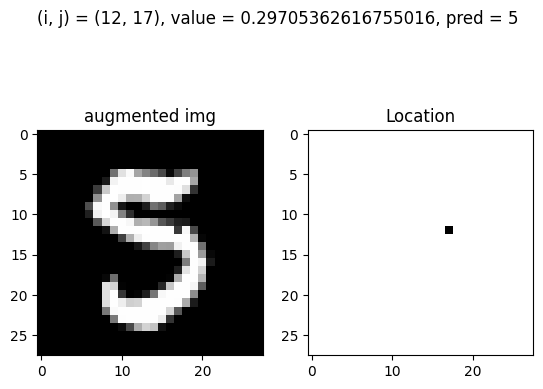

Train: At (i, j) = (12, 17) and value = 0.6576868981932272, pred = 5, before_pred = 3, gt = 5


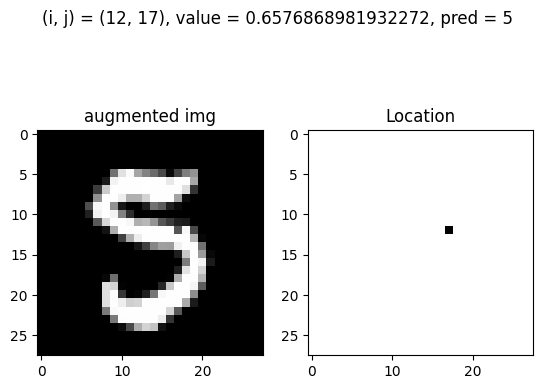

Train: At (i, j) = (13, 6) and value = 1.3789534422445815, pred = 5, before_pred = 3, gt = 5


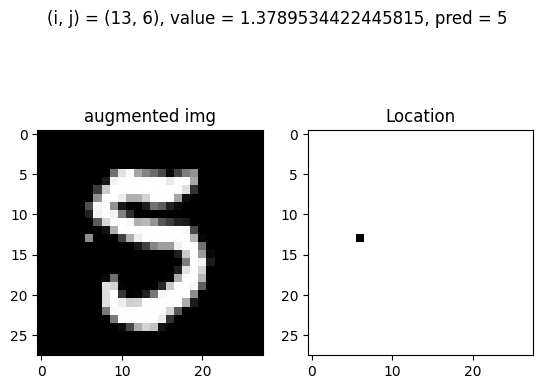

Train: At (i, j) = (13, 6) and value = 1.7395867142702586, pred = 5, before_pred = 3, gt = 5


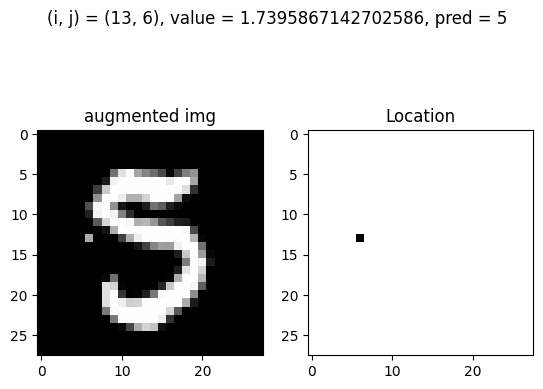

Train: At (i, j) = (13, 6) and value = 2.1002199862959356, pred = 5, before_pred = 3, gt = 5


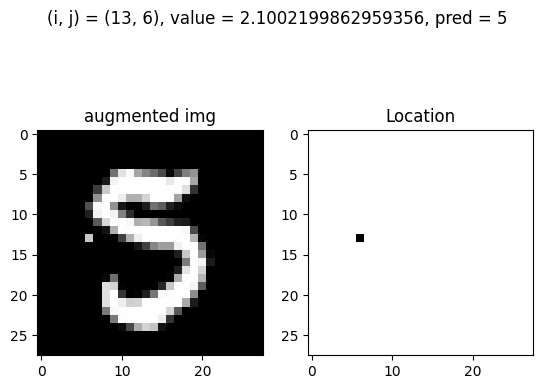

Train: At (i, j) = (13, 6) and value = 2.4608532583216127, pred = 5, before_pred = 3, gt = 5


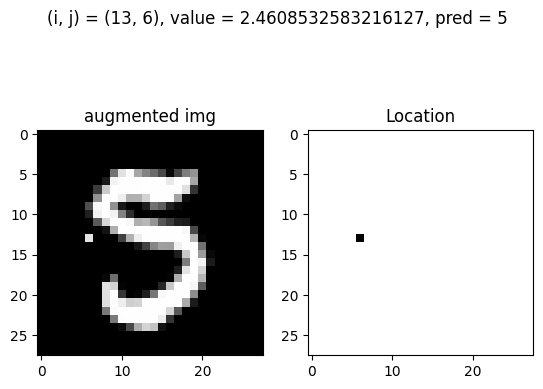

Train: At (i, j) = (13, 6) and value = 2.82148653034729, pred = 5, before_pred = 3, gt = 5


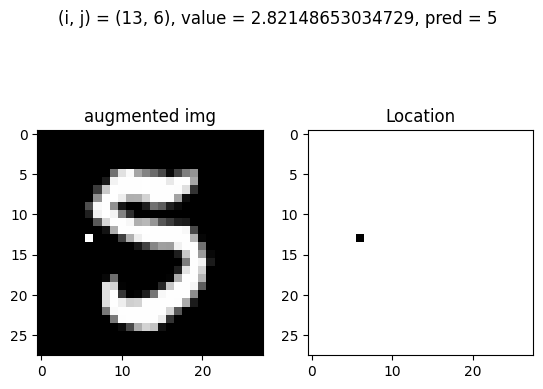

Train: At (i, j) = (13, 7) and value = 1.0183201702189044, pred = 5, before_pred = 3, gt = 5


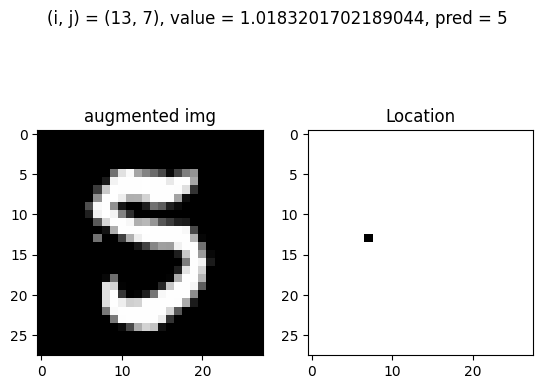

Train: At (i, j) = (13, 7) and value = 1.3789534422445815, pred = 5, before_pred = 3, gt = 5


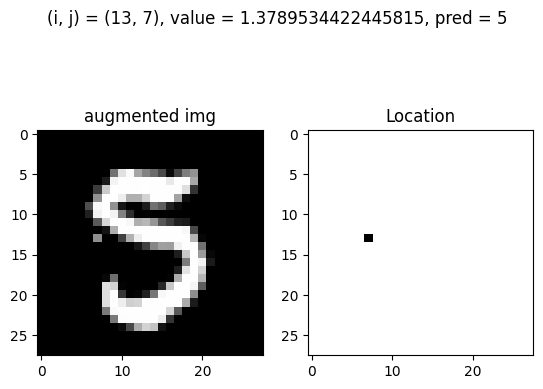

Train: At (i, j) = (13, 7) and value = 1.7395867142702586, pred = 5, before_pred = 3, gt = 5


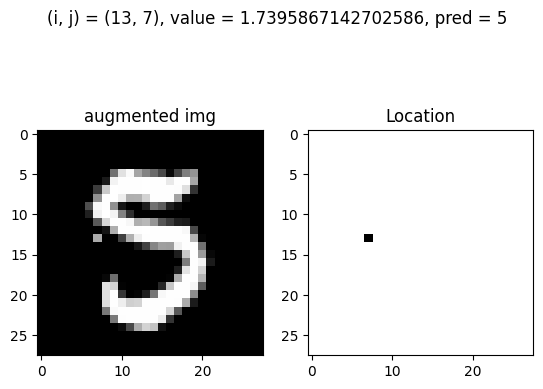

Train: At (i, j) = (13, 7) and value = 2.1002199862959356, pred = 5, before_pred = 3, gt = 5


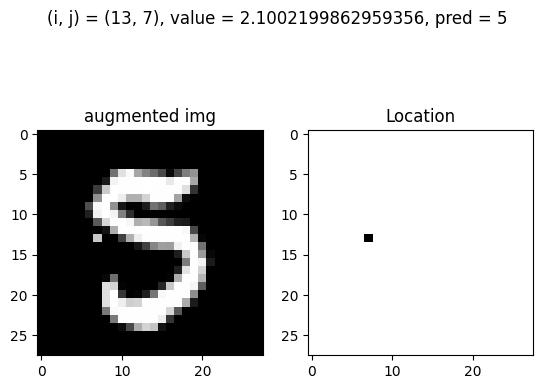

Train: At (i, j) = (13, 7) and value = 2.4608532583216127, pred = 5, before_pred = 3, gt = 5


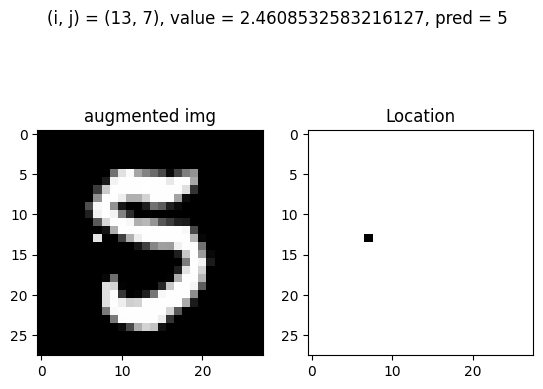

Train: At (i, j) = (13, 7) and value = 2.82148653034729, pred = 5, before_pred = 3, gt = 5


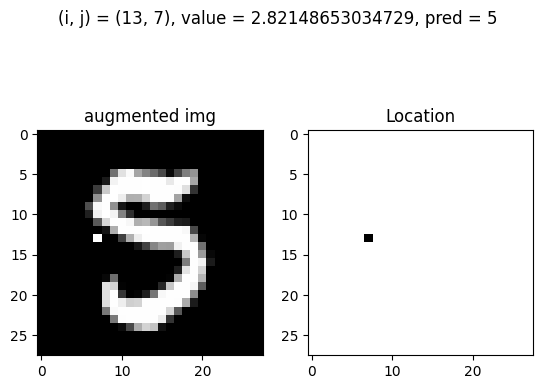

Train: At (i, j) = (13, 8) and value = 0.6576868981932272, pred = 5, before_pred = 3, gt = 5


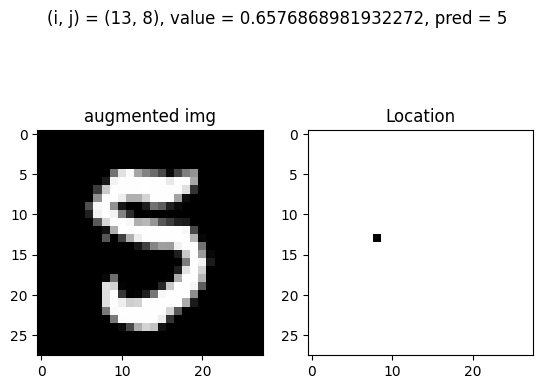

Train: At (i, j) = (13, 8) and value = 1.0183201702189044, pred = 5, before_pred = 3, gt = 5


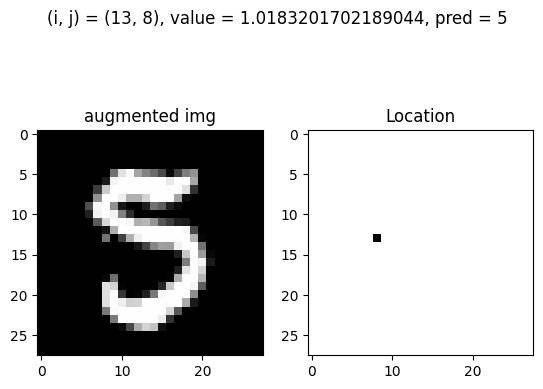

Train: At (i, j) = (13, 8) and value = 1.3789534422445815, pred = 5, before_pred = 3, gt = 5


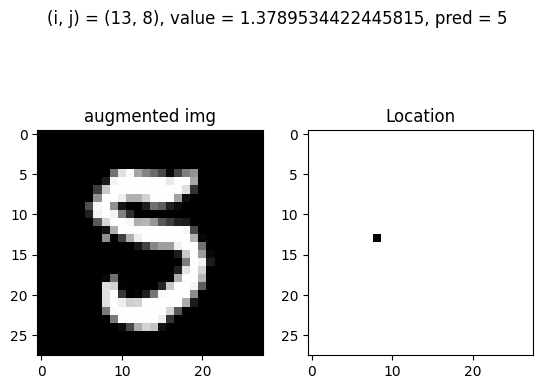

Train: At (i, j) = (13, 8) and value = 1.7395867142702586, pred = 5, before_pred = 3, gt = 5


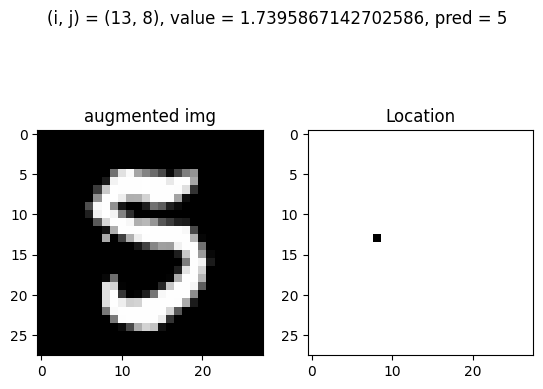

Train: At (i, j) = (13, 8) and value = 2.1002199862959356, pred = 5, before_pred = 3, gt = 5


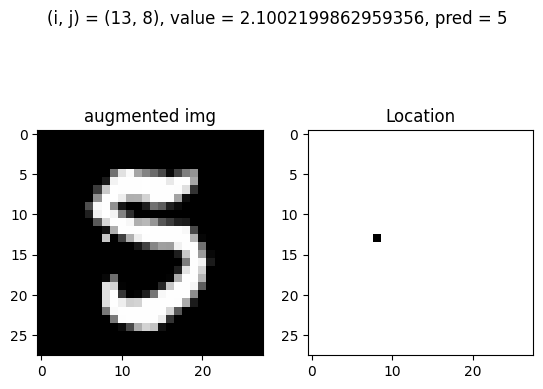

Train: At (i, j) = (13, 8) and value = 2.4608532583216127, pred = 5, before_pred = 3, gt = 5


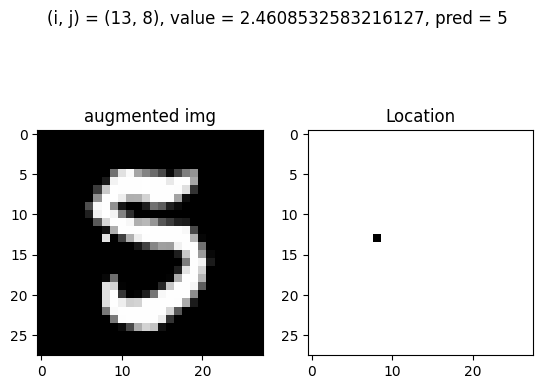

Train: At (i, j) = (13, 8) and value = 2.82148653034729, pred = 5, before_pred = 3, gt = 5


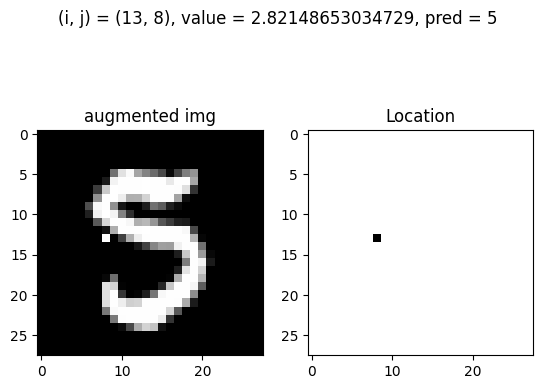

Train: At (i, j) = (13, 9) and value = 1.0183201702189044, pred = 5, before_pred = 3, gt = 5


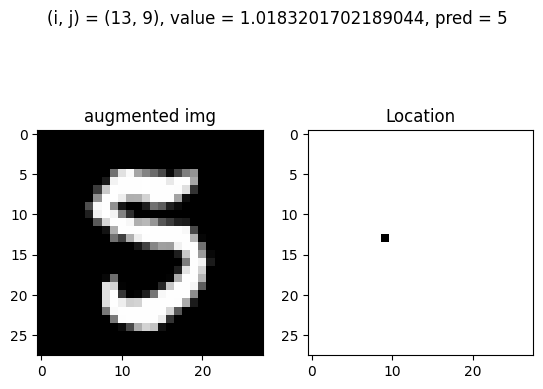

Train: At (i, j) = (13, 9) and value = 1.3789534422445815, pred = 5, before_pred = 3, gt = 5


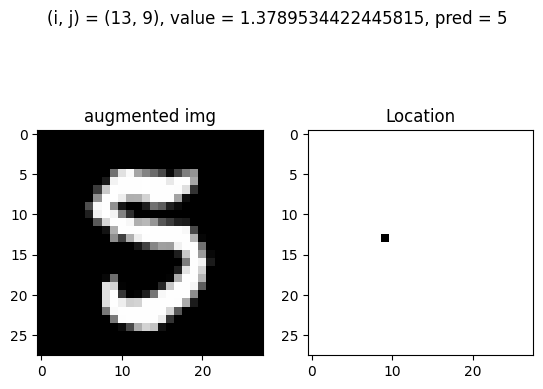

Train: At (i, j) = (13, 9) and value = 1.7395867142702586, pred = 5, before_pred = 3, gt = 5


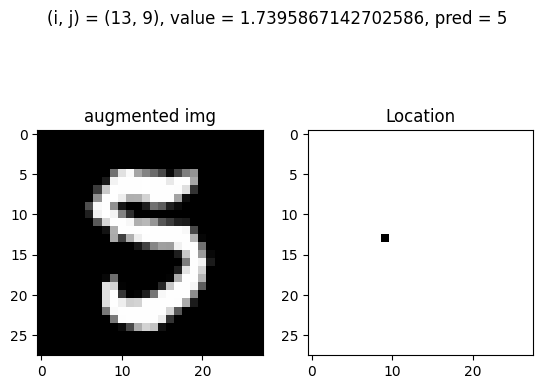

Train: At (i, j) = (13, 9) and value = 2.1002199862959356, pred = 5, before_pred = 3, gt = 5


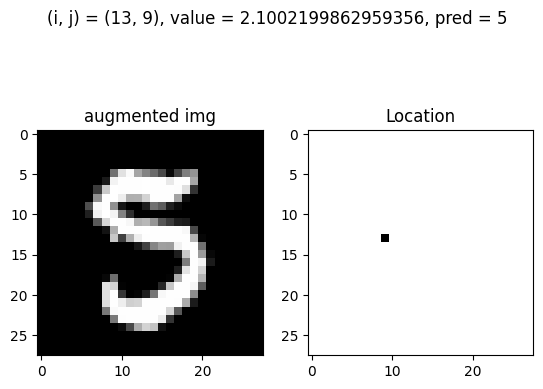

Train: At (i, j) = (13, 9) and value = 2.4608532583216127, pred = 5, before_pred = 3, gt = 5


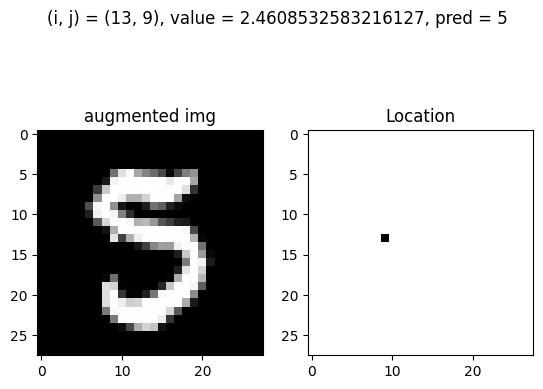

Train: At (i, j) = (13, 9) and value = 2.82148653034729, pred = 5, before_pred = 3, gt = 5


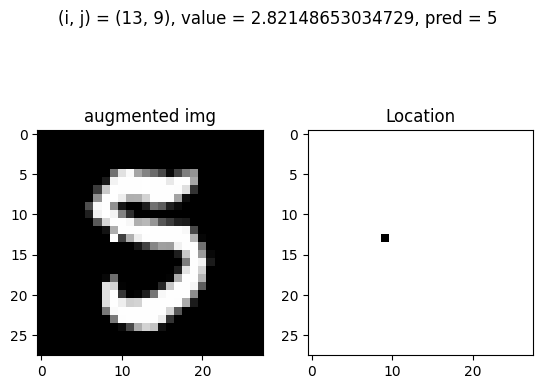

Train: At (i, j) = (13, 10) and value = 1.7395867142702586, pred = 5, before_pred = 3, gt = 5


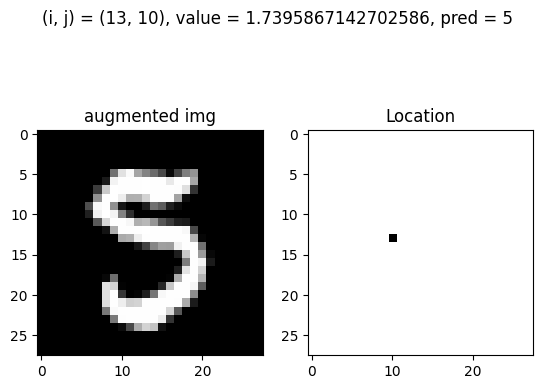

Train: At (i, j) = (13, 10) and value = 2.1002199862959356, pred = 5, before_pred = 3, gt = 5


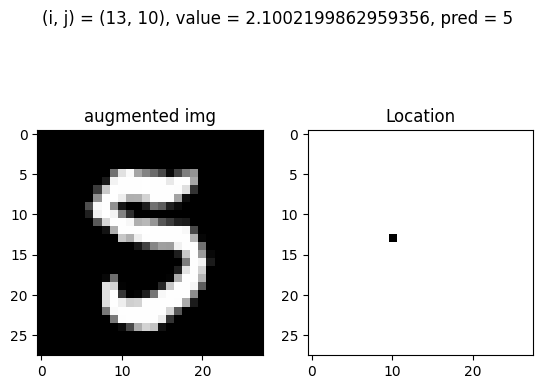

Train: At (i, j) = (13, 10) and value = 2.4608532583216127, pred = 5, before_pred = 3, gt = 5


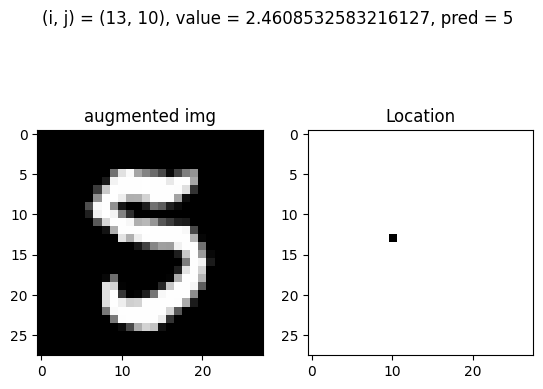

Train: At (i, j) = (13, 10) and value = 2.82148653034729, pred = 5, before_pred = 3, gt = 5


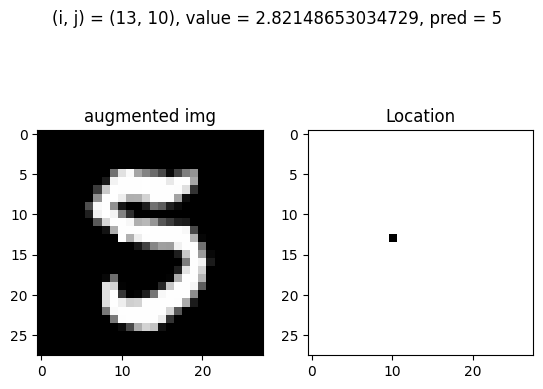

Train: At (i, j) = (13, 14) and value = -0.424212917883804, pred = 5, before_pred = 3, gt = 5


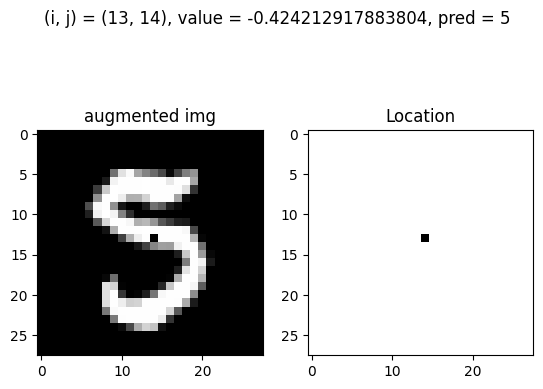

Train: At (i, j) = (13, 14) and value = -0.06357964585812692, pred = 5, before_pred = 3, gt = 5


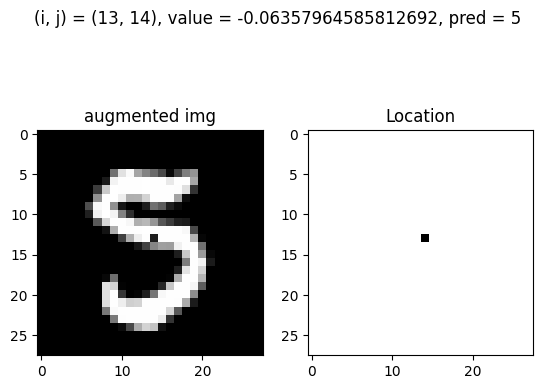

Train: At (i, j) = (13, 16) and value = -0.424212917883804, pred = 5, before_pred = 3, gt = 5


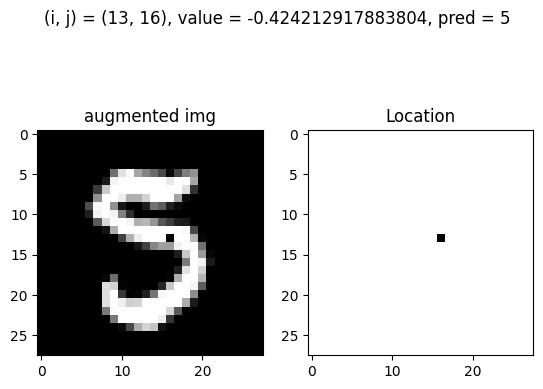

Train: At (i, j) = (13, 22) and value = 2.4608532583216127, pred = 5, before_pred = 3, gt = 5


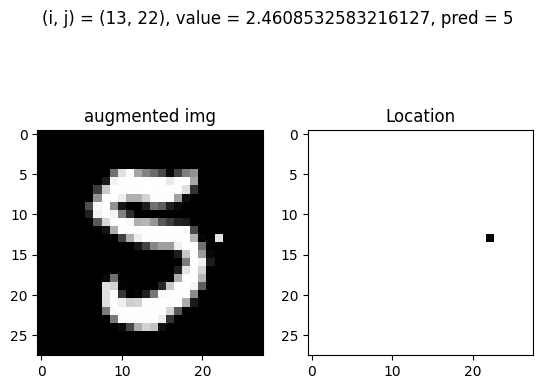

Train: At (i, j) = (13, 22) and value = 2.82148653034729, pred = 5, before_pred = 3, gt = 5


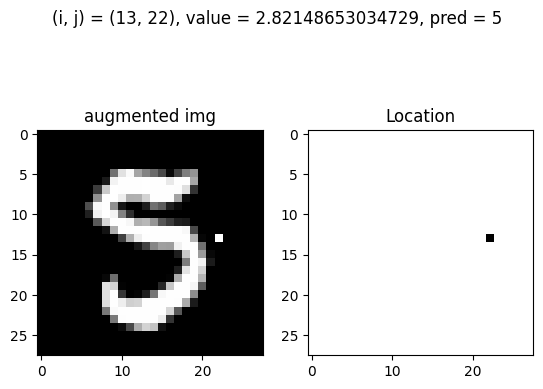

Train: At (i, j) = (13, 23) and value = 2.1002199862959356, pred = 5, before_pred = 3, gt = 5


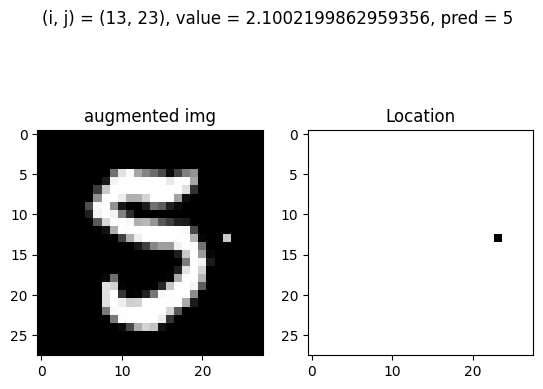

Train: At (i, j) = (13, 23) and value = 2.4608532583216127, pred = 5, before_pred = 3, gt = 5


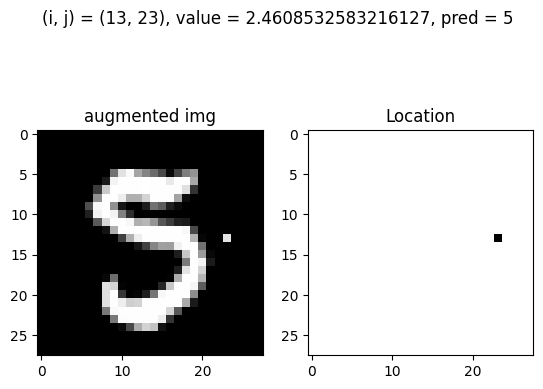

Train: At (i, j) = (13, 23) and value = 2.82148653034729, pred = 5, before_pred = 3, gt = 5


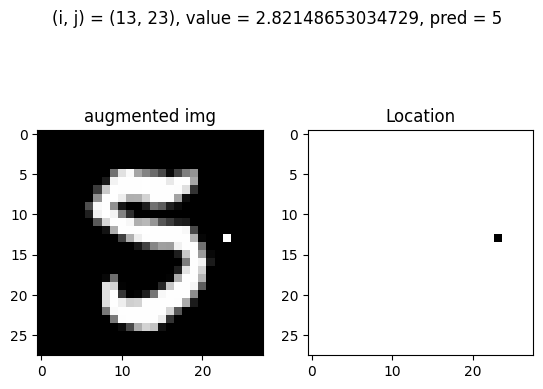

Train: At (i, j) = (14, 4) and value = 2.4608532583216127, pred = 5, before_pred = 3, gt = 5


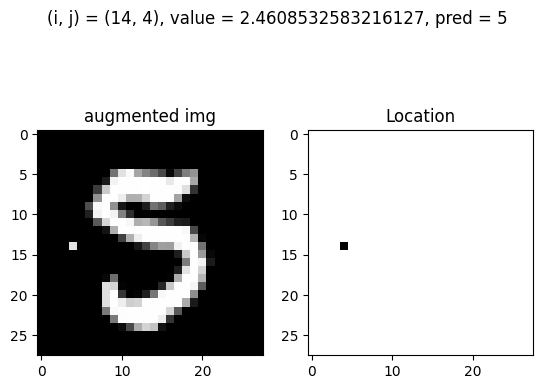

Train: At (i, j) = (14, 4) and value = 2.82148653034729, pred = 5, before_pred = 3, gt = 5


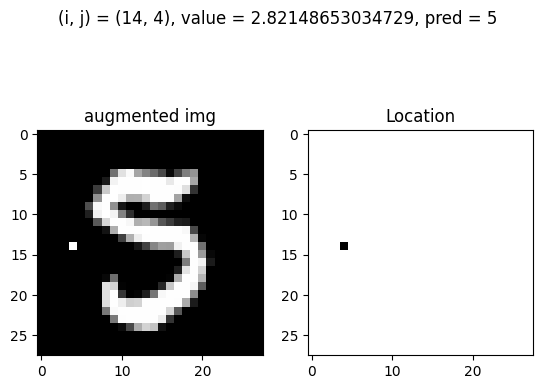

Train: At (i, j) = (14, 6) and value = 1.7395867142702586, pred = 5, before_pred = 3, gt = 5


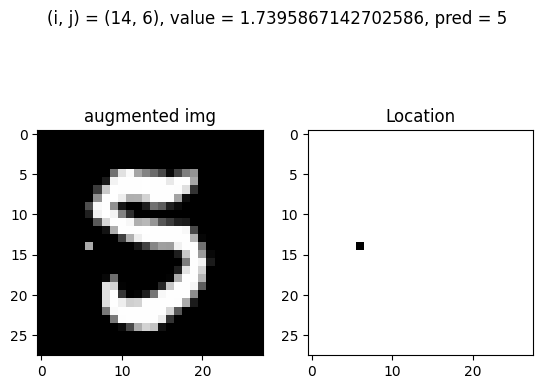

Train: At (i, j) = (14, 6) and value = 2.1002199862959356, pred = 5, before_pred = 3, gt = 5


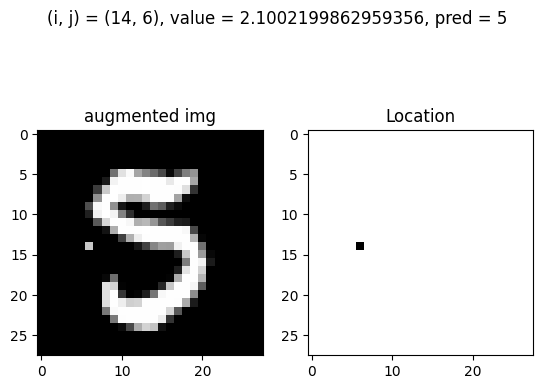

Train: At (i, j) = (14, 6) and value = 2.4608532583216127, pred = 5, before_pred = 3, gt = 5


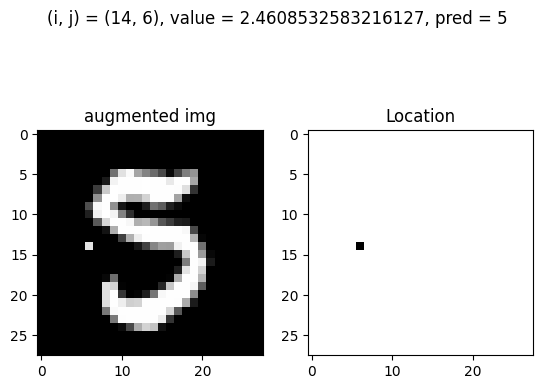

Train: At (i, j) = (14, 6) and value = 2.82148653034729, pred = 5, before_pred = 3, gt = 5


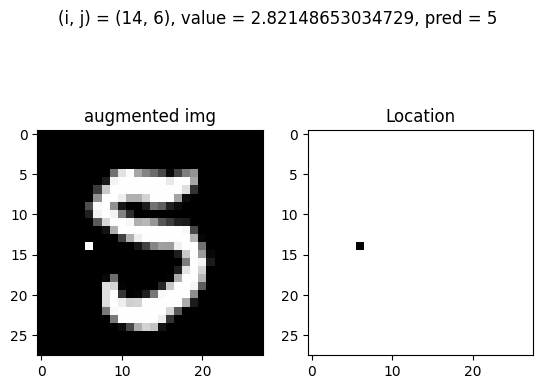

Train: At (i, j) = (14, 7) and value = 1.3789534422445815, pred = 5, before_pred = 3, gt = 5


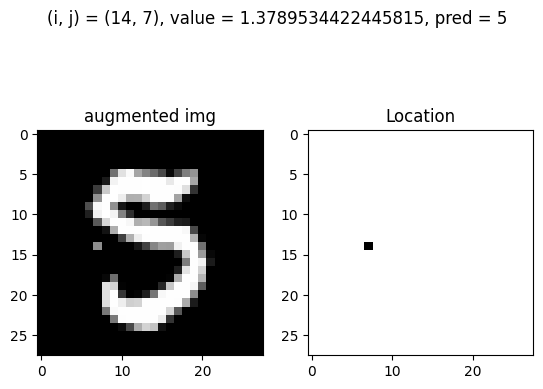

Train: At (i, j) = (14, 7) and value = 1.7395867142702586, pred = 5, before_pred = 3, gt = 5


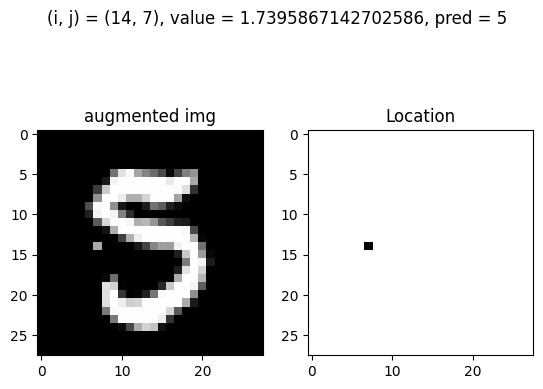

Train: At (i, j) = (14, 7) and value = 2.1002199862959356, pred = 5, before_pred = 3, gt = 5


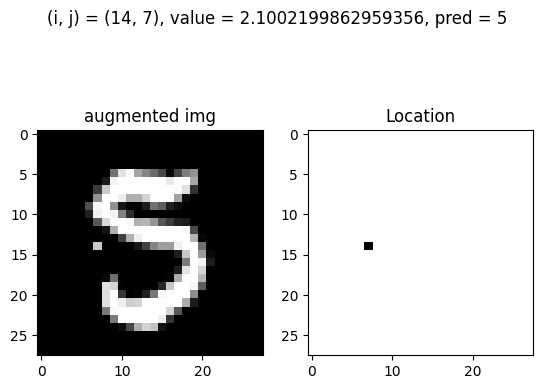

Train: At (i, j) = (14, 7) and value = 2.4608532583216127, pred = 5, before_pred = 3, gt = 5


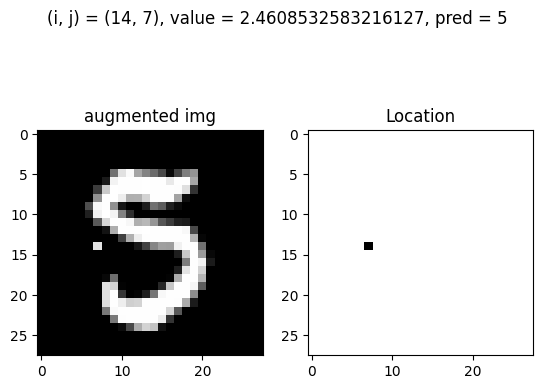

Train: At (i, j) = (14, 7) and value = 2.82148653034729, pred = 5, before_pred = 3, gt = 5


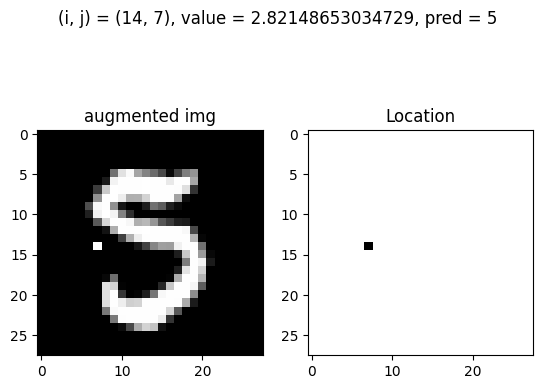

Train: At (i, j) = (14, 8) and value = 1.3789534422445815, pred = 5, before_pred = 3, gt = 5


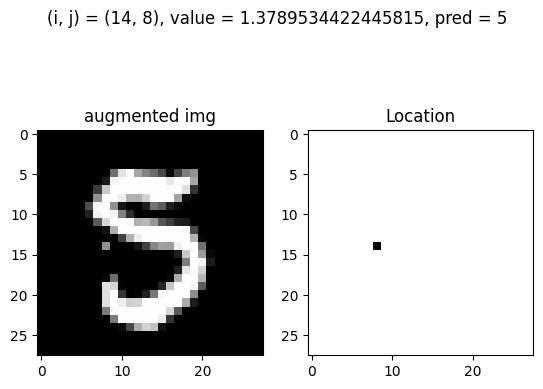

Train: At (i, j) = (14, 8) and value = 1.7395867142702586, pred = 5, before_pred = 3, gt = 5


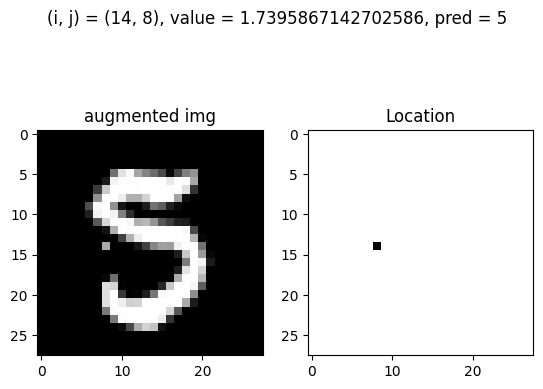

Train: At (i, j) = (14, 8) and value = 2.1002199862959356, pred = 5, before_pred = 3, gt = 5


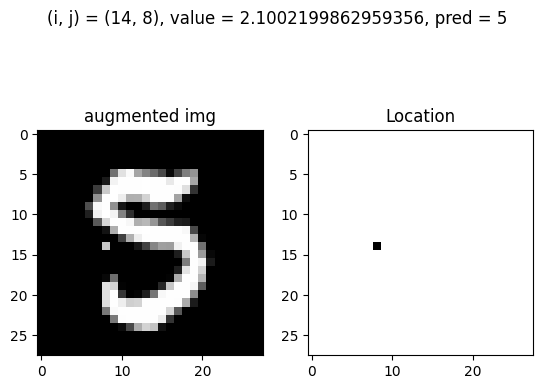

Train: At (i, j) = (14, 8) and value = 2.4608532583216127, pred = 5, before_pred = 3, gt = 5


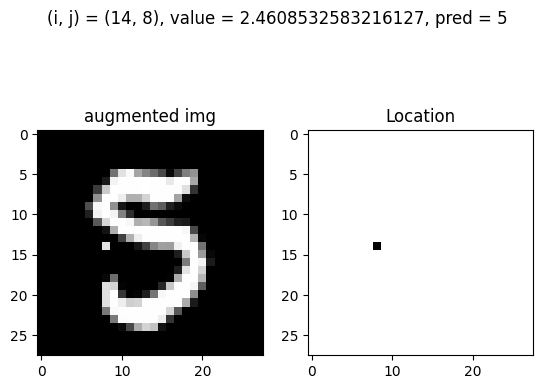

Train: At (i, j) = (14, 8) and value = 2.82148653034729, pred = 5, before_pred = 3, gt = 5


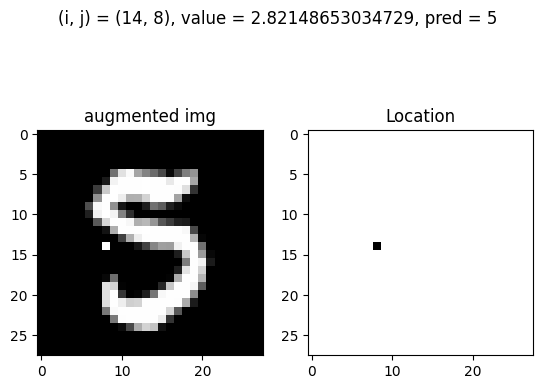

Train: At (i, j) = (14, 9) and value = 1.0183201702189044, pred = 5, before_pred = 3, gt = 5


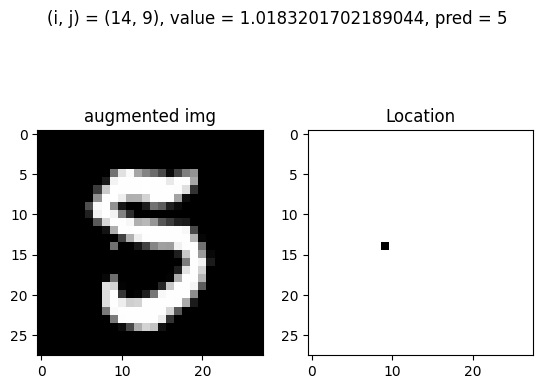

Train: At (i, j) = (14, 9) and value = 1.3789534422445815, pred = 5, before_pred = 3, gt = 5


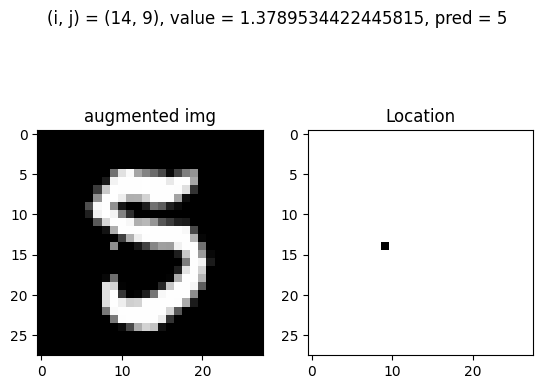

Train: At (i, j) = (14, 9) and value = 1.7395867142702586, pred = 5, before_pred = 3, gt = 5


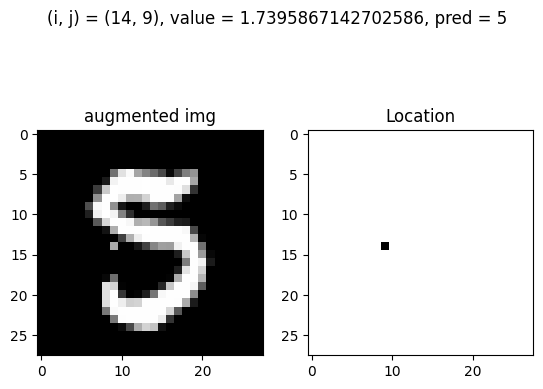

Train: At (i, j) = (14, 9) and value = 2.1002199862959356, pred = 5, before_pred = 3, gt = 5


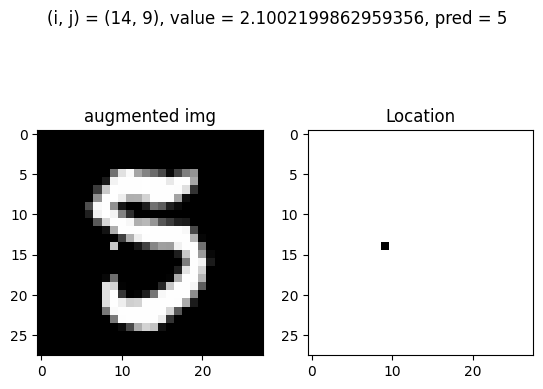

Train: At (i, j) = (14, 9) and value = 2.4608532583216127, pred = 5, before_pred = 3, gt = 5


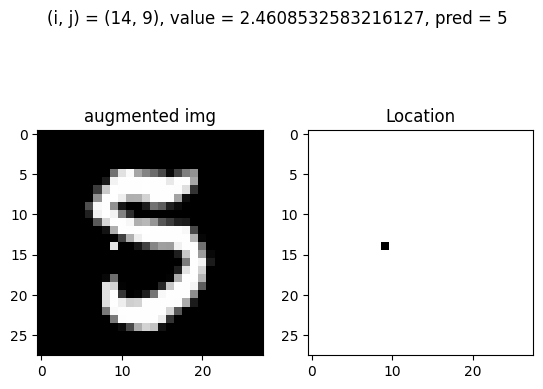

Train: At (i, j) = (14, 9) and value = 2.82148653034729, pred = 5, before_pred = 3, gt = 5


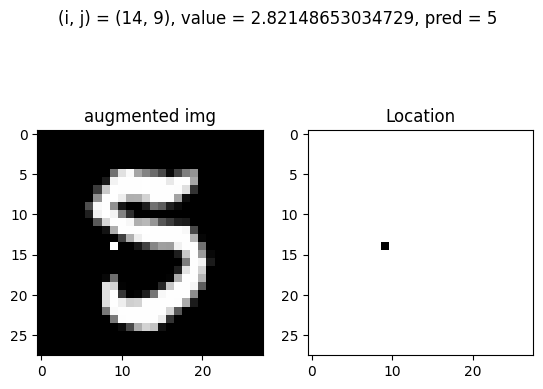

Train: At (i, j) = (14, 10) and value = 1.7395867142702586, pred = 5, before_pred = 3, gt = 5


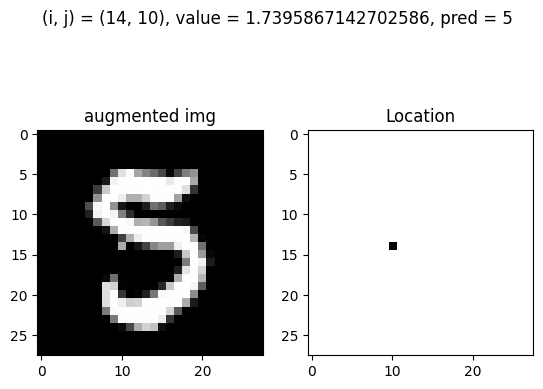

Train: At (i, j) = (14, 10) and value = 2.1002199862959356, pred = 5, before_pred = 3, gt = 5


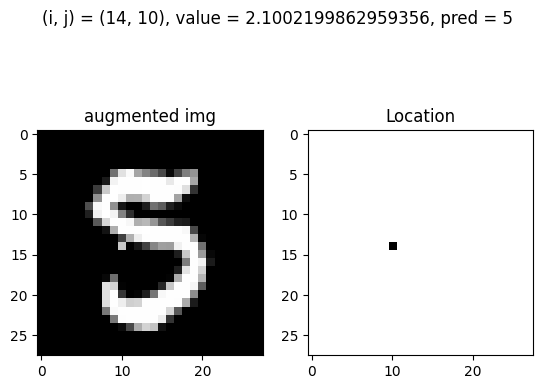

Train: At (i, j) = (14, 10) and value = 2.4608532583216127, pred = 5, before_pred = 3, gt = 5


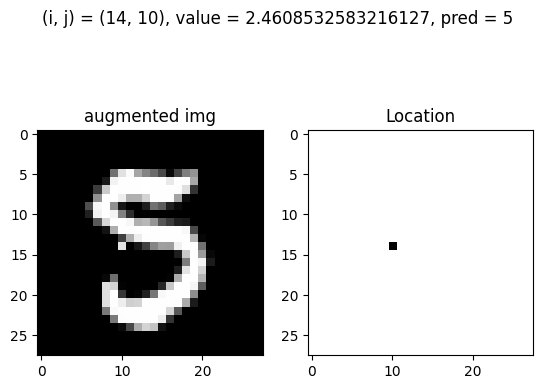

Train: At (i, j) = (14, 10) and value = 2.82148653034729, pred = 5, before_pred = 3, gt = 5


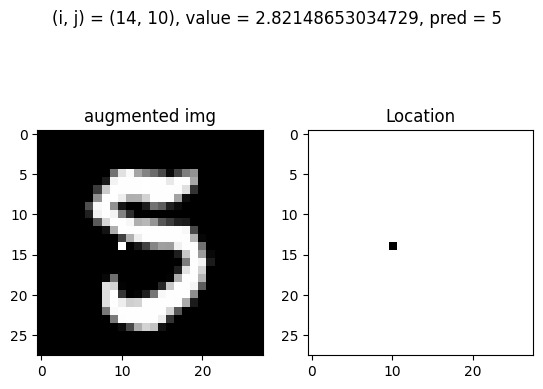

Train: At (i, j) = (14, 11) and value = 1.0183201702189044, pred = 5, before_pred = 3, gt = 5


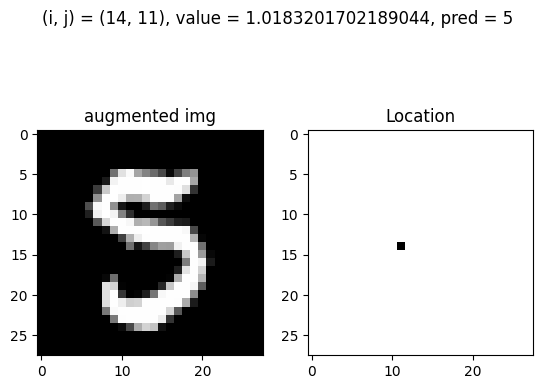

Train: At (i, j) = (14, 11) and value = 1.3789534422445815, pred = 5, before_pred = 3, gt = 5


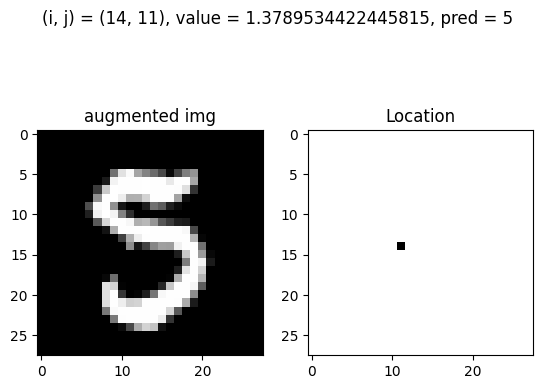

Train: At (i, j) = (14, 11) and value = 1.7395867142702586, pred = 5, before_pred = 3, gt = 5


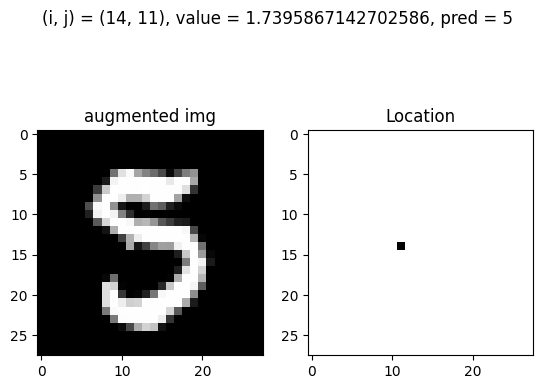

Train: At (i, j) = (14, 11) and value = 2.1002199862959356, pred = 5, before_pred = 3, gt = 5


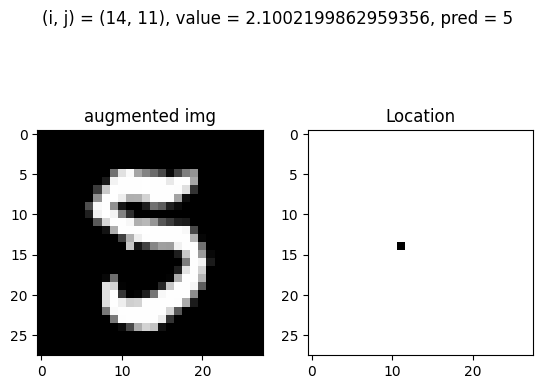

Train: At (i, j) = (14, 11) and value = 2.4608532583216127, pred = 5, before_pred = 3, gt = 5


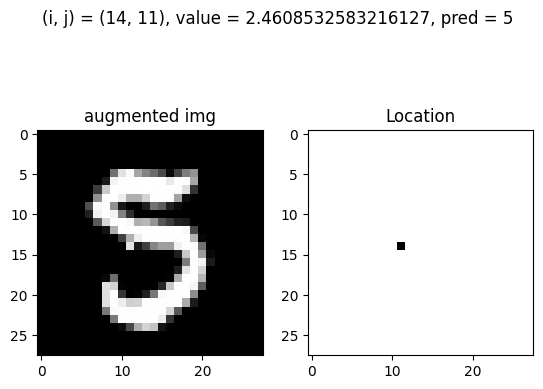

Train: At (i, j) = (14, 11) and value = 2.82148653034729, pred = 5, before_pred = 3, gt = 5


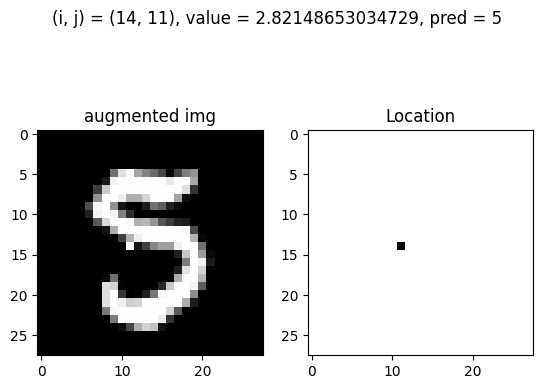

Train: At (i, j) = (14, 19) and value = -0.424212917883804, pred = 5, before_pred = 3, gt = 5


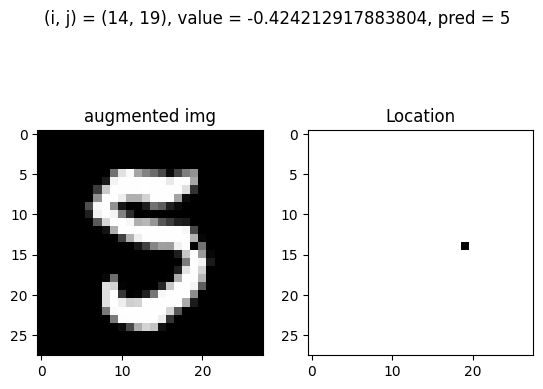

Train: At (i, j) = (14, 19) and value = -0.06357964585812692, pred = 5, before_pred = 3, gt = 5


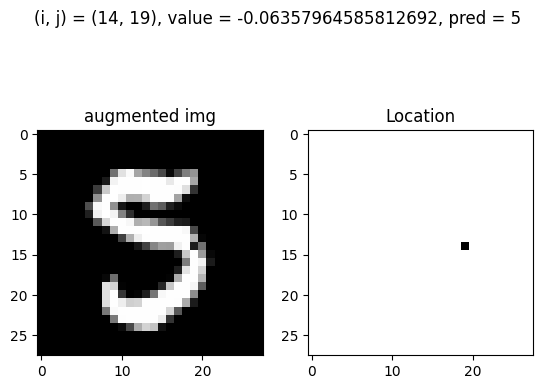

Train: At (i, j) = (14, 22) and value = 2.4608532583216127, pred = 5, before_pred = 3, gt = 5


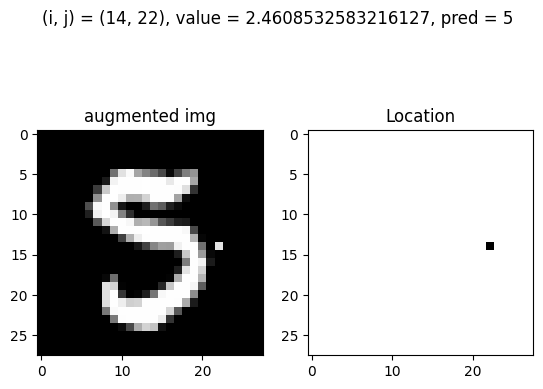

Train: At (i, j) = (14, 22) and value = 2.82148653034729, pred = 5, before_pred = 3, gt = 5


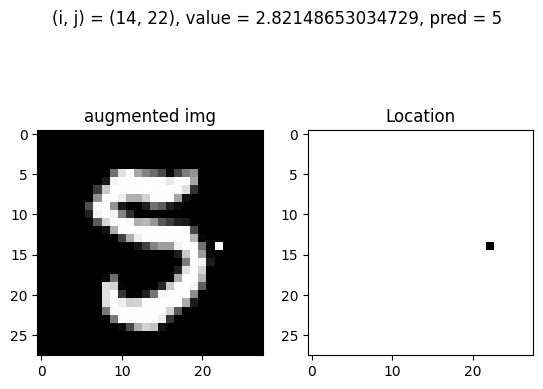

Train: At (i, j) = (15, 7) and value = 2.1002199862959356, pred = 5, before_pred = 3, gt = 5


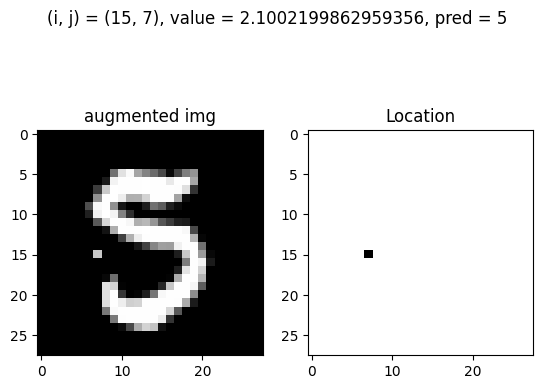

Train: At (i, j) = (15, 7) and value = 2.4608532583216127, pred = 5, before_pred = 3, gt = 5


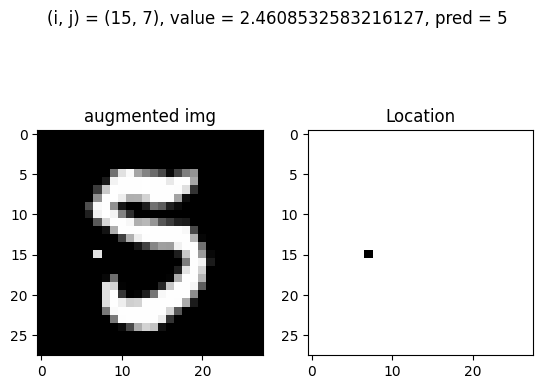

Train: At (i, j) = (15, 7) and value = 2.82148653034729, pred = 5, before_pred = 3, gt = 5


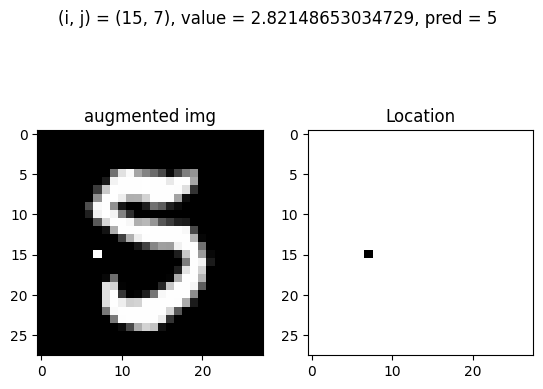

Train: At (i, j) = (15, 10) and value = 2.82148653034729, pred = 5, before_pred = 3, gt = 5


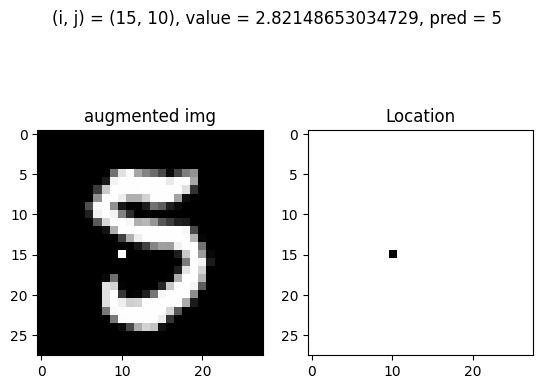

Train: At (i, j) = (15, 11) and value = 2.1002199862959356, pred = 5, before_pred = 3, gt = 5


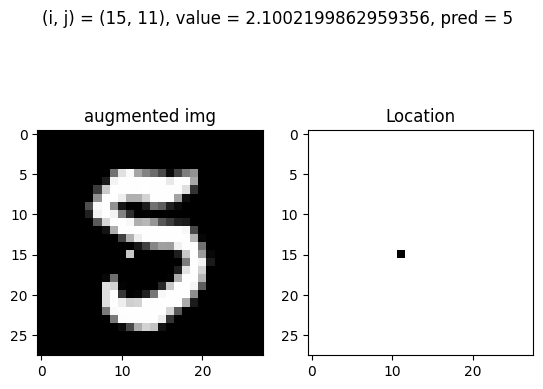

Train: At (i, j) = (15, 11) and value = 2.4608532583216127, pred = 5, before_pred = 3, gt = 5


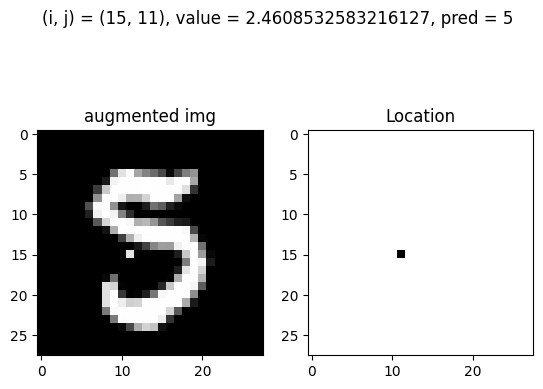

Train: At (i, j) = (15, 11) and value = 2.82148653034729, pred = 5, before_pred = 3, gt = 5


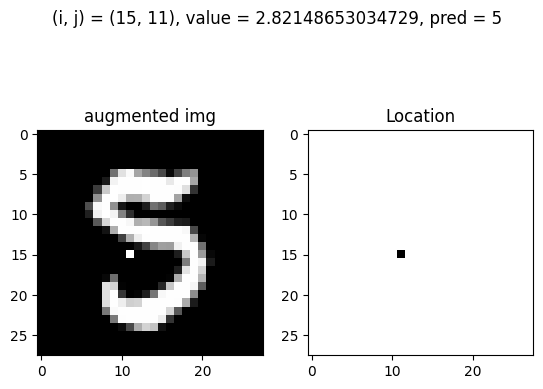

Train: At (i, j) = (15, 18) and value = -0.424212917883804, pred = 5, before_pred = 3, gt = 5


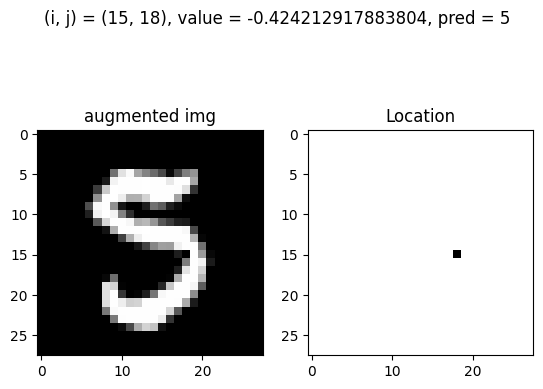

Train: At (i, j) = (15, 18) and value = -0.06357964585812692, pred = 5, before_pred = 3, gt = 5


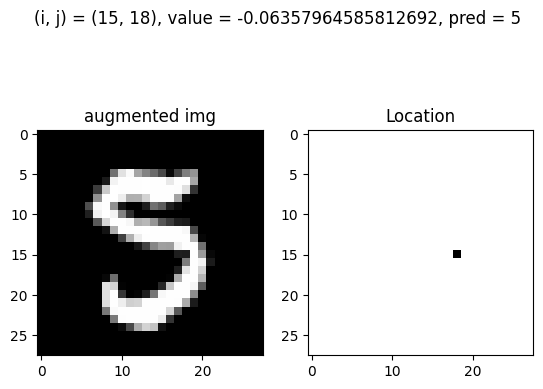

Train: At (i, j) = (15, 18) and value = 0.29705362616755016, pred = 5, before_pred = 3, gt = 5


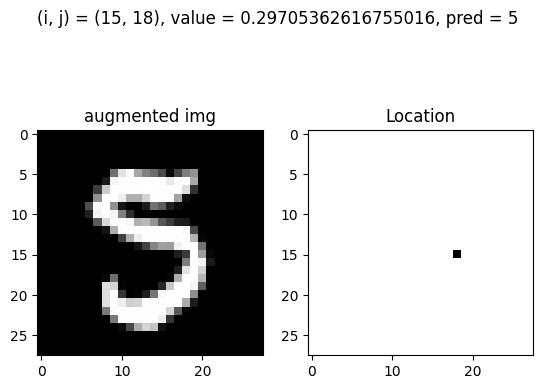

Train: At (i, j) = (15, 23) and value = 2.82148653034729, pred = 5, before_pred = 3, gt = 5


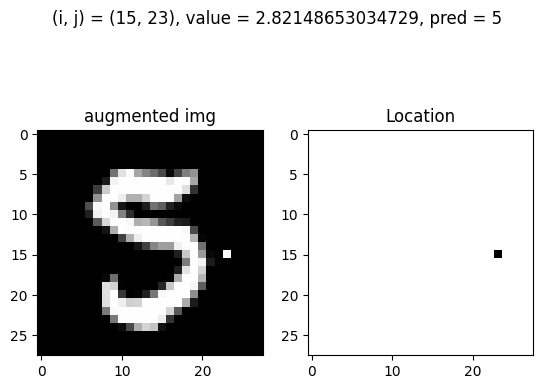

Train: At (i, j) = (16, 8) and value = 1.7395867142702586, pred = 5, before_pred = 3, gt = 5


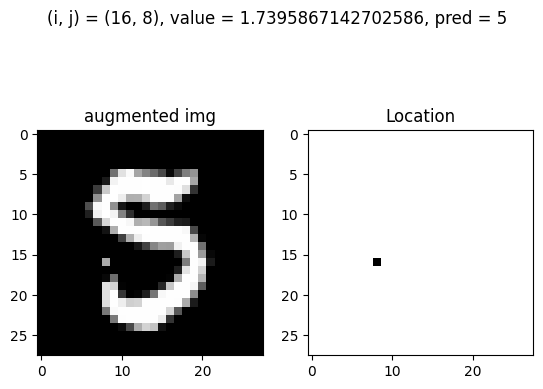

Train: At (i, j) = (16, 8) and value = 2.1002199862959356, pred = 5, before_pred = 3, gt = 5


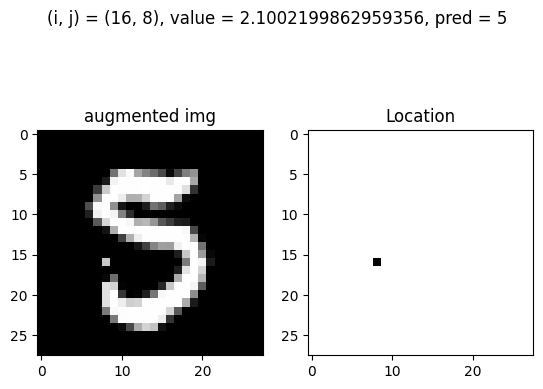

Train: At (i, j) = (16, 8) and value = 2.4608532583216127, pred = 5, before_pred = 3, gt = 5


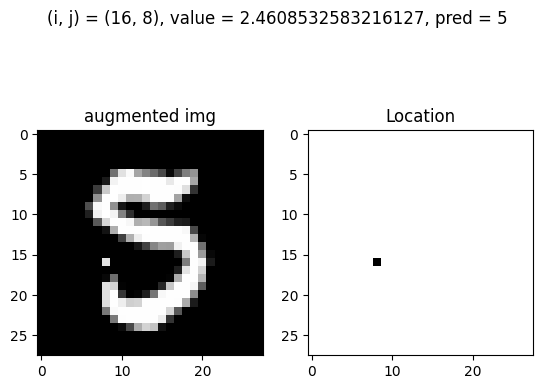

Train: At (i, j) = (16, 8) and value = 2.82148653034729, pred = 5, before_pred = 3, gt = 5


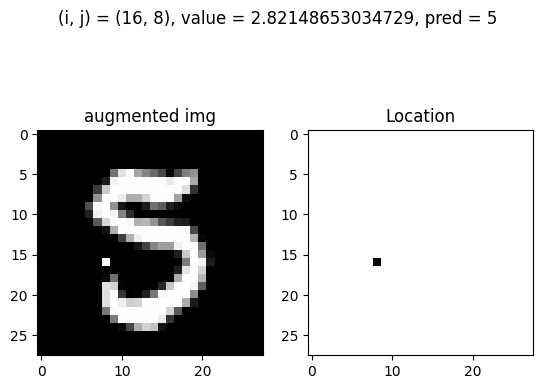

Train: At (i, j) = (16, 9) and value = 2.4608532583216127, pred = 5, before_pred = 3, gt = 5


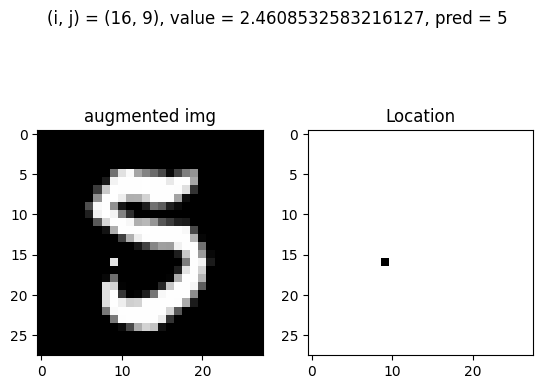

Train: At (i, j) = (16, 9) and value = 2.82148653034729, pred = 5, before_pred = 3, gt = 5


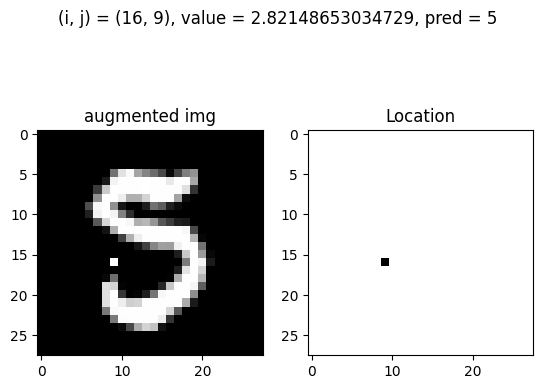

Train: At (i, j) = (16, 10) and value = 2.4608532583216127, pred = 5, before_pred = 3, gt = 5


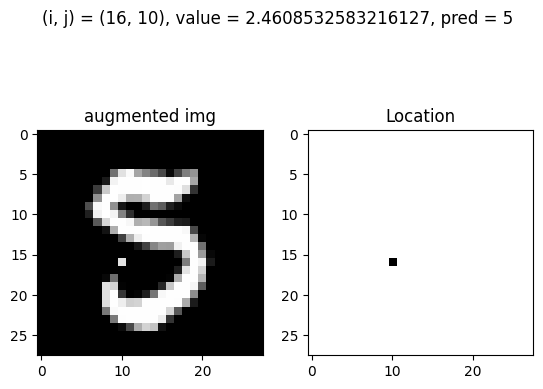

Train: At (i, j) = (16, 10) and value = 2.82148653034729, pred = 5, before_pred = 3, gt = 5


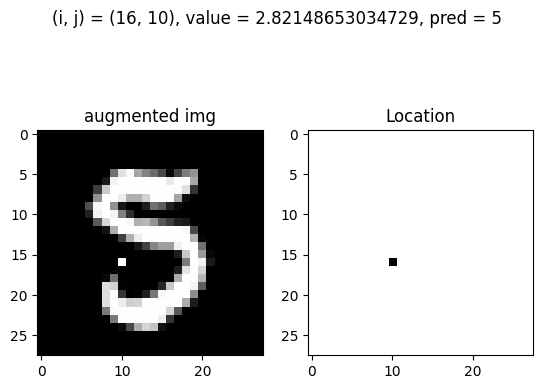

Train: At (i, j) = (16, 19) and value = -0.424212917883804, pred = 5, before_pred = 3, gt = 5


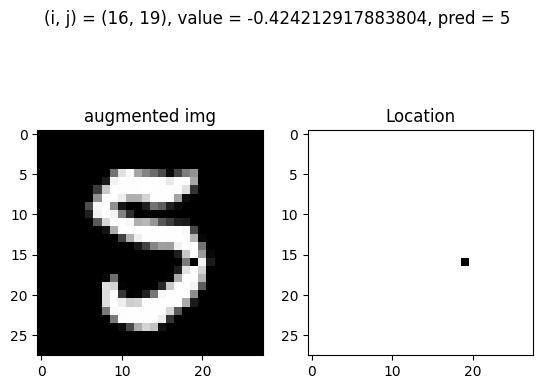

Train: At (i, j) = (16, 19) and value = -0.06357964585812692, pred = 5, before_pred = 3, gt = 5


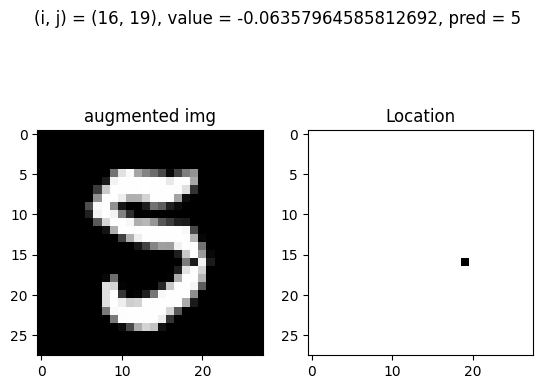

Train: At (i, j) = (16, 19) and value = 0.29705362616755016, pred = 5, before_pred = 3, gt = 5


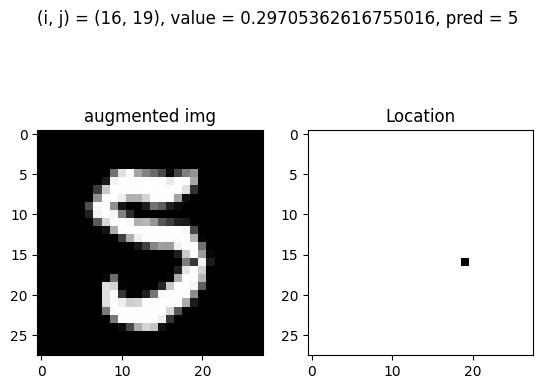

Train: At (i, j) = (17, 8) and value = 2.4608532583216127, pred = 5, before_pred = 3, gt = 5


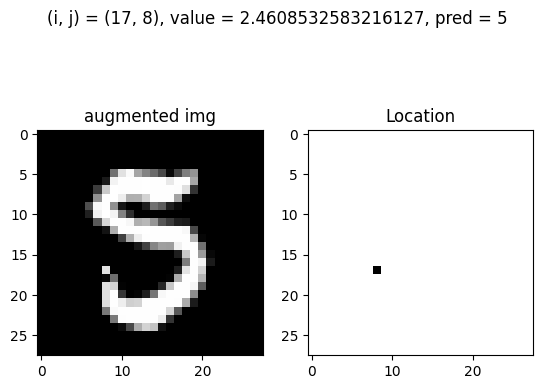

Train: At (i, j) = (17, 8) and value = 2.82148653034729, pred = 5, before_pred = 3, gt = 5


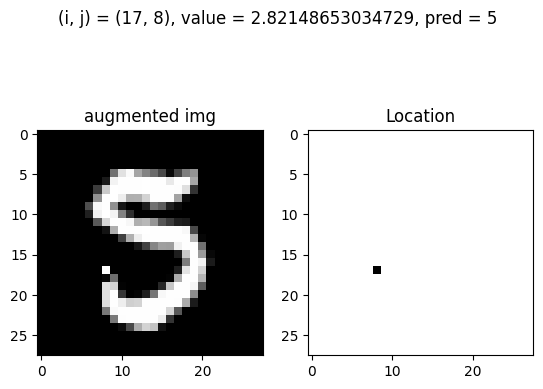

Train: At (i, j) = (17, 9) and value = 2.1002199862959356, pred = 5, before_pred = 3, gt = 5


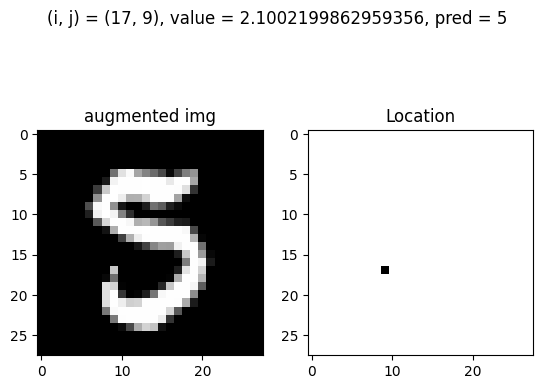

Train: At (i, j) = (17, 9) and value = 2.4608532583216127, pred = 5, before_pred = 3, gt = 5


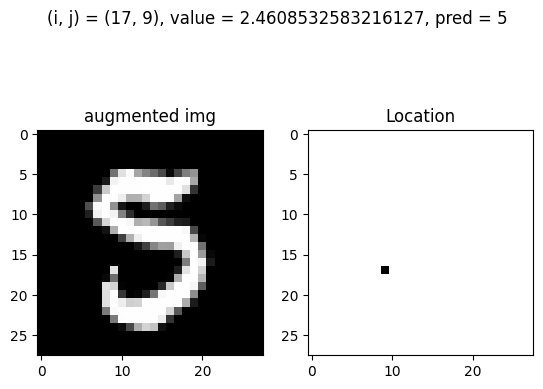

Train: At (i, j) = (17, 9) and value = 2.82148653034729, pred = 5, before_pred = 3, gt = 5


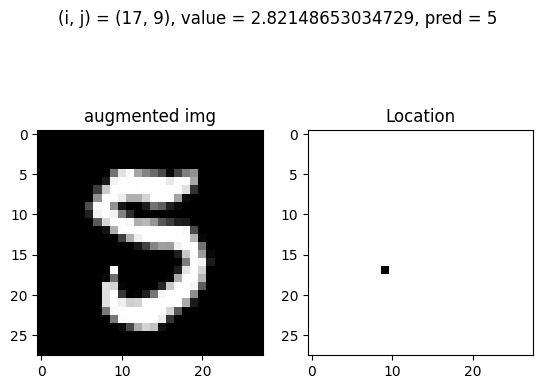

Train: At (i, j) = (17, 10) and value = 2.4608532583216127, pred = 5, before_pred = 3, gt = 5


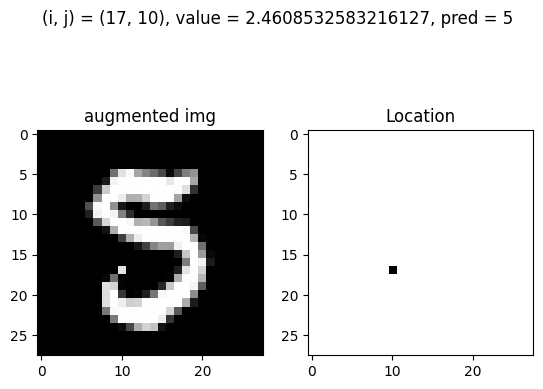

Train: At (i, j) = (17, 10) and value = 2.82148653034729, pred = 5, before_pred = 3, gt = 5


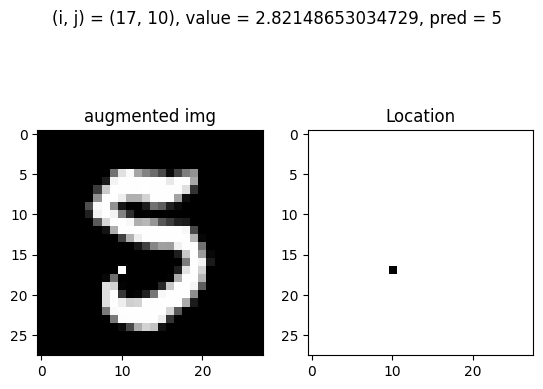

Train: At (i, j) = (19, 19) and value = -0.424212917883804, pred = 5, before_pred = 3, gt = 5


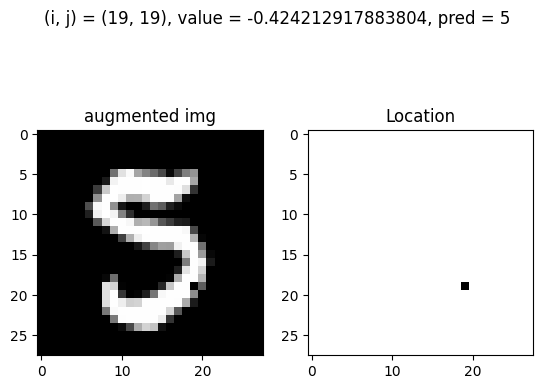

Train: At (i, j) = (24, 20) and value = 2.82148653034729, pred = 5, before_pred = 3, gt = 5


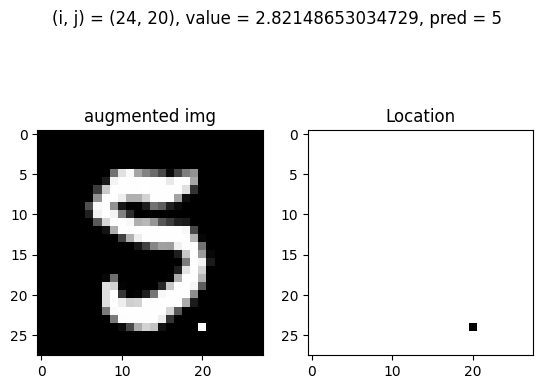

Train: At (i, j) = (25, 16) and value = 2.82148653034729, pred = 5, before_pred = 3, gt = 5


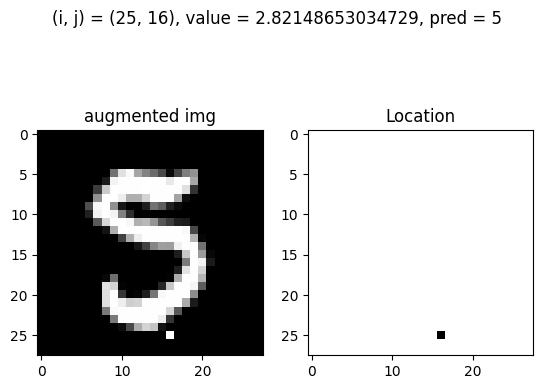

7840 done
7840 done
7840 done
7840 done
7840 done
7840 done
7840 done
7840 done
7840 done
7840 done
Train: At (i, j) = (3, 4) and value = 2.82148653034729, pred = 8, before_pred = 5, gt = 0


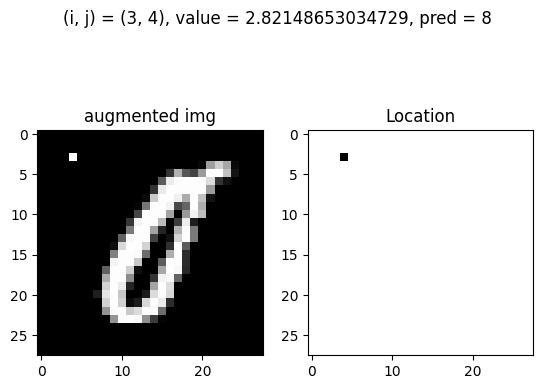

Train: At (i, j) = (5, 14) and value = 2.82148653034729, pred = 8, before_pred = 5, gt = 0


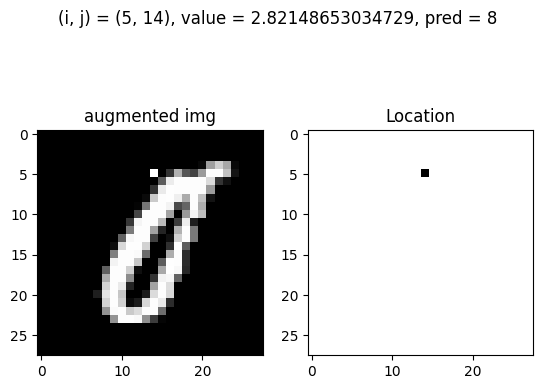

Train: At (i, j) = (11, 12) and value = -0.424212917883804, pred = 8, before_pred = 5, gt = 0


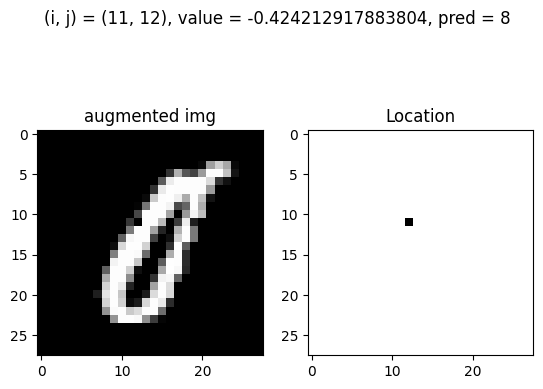

Train: At (i, j) = (11, 20) and value = 2.82148653034729, pred = 8, before_pred = 5, gt = 0


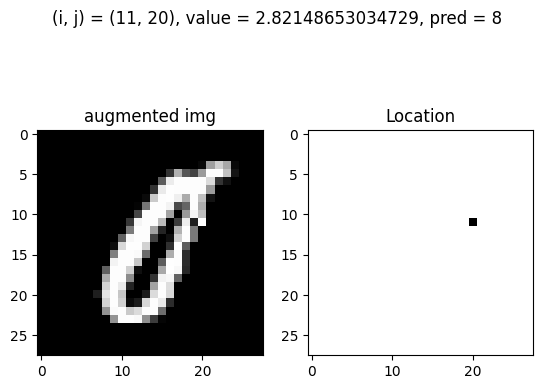

Train: At (i, j) = (12, 12) and value = -0.424212917883804, pred = 8, before_pred = 5, gt = 0


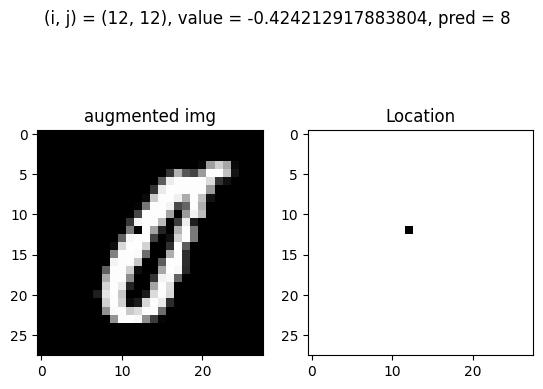

Train: At (i, j) = (12, 20) and value = 2.82148653034729, pred = 8, before_pred = 5, gt = 0


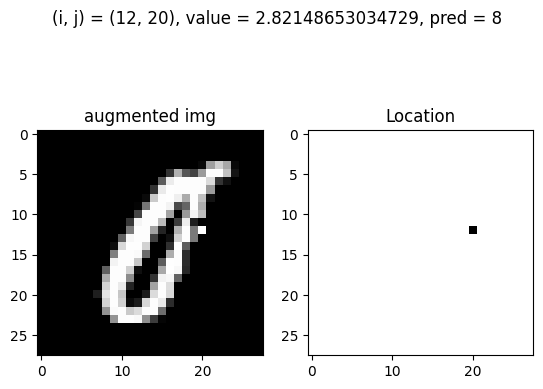

Train: At (i, j) = (13, 11) and value = -0.424212917883804, pred = 8, before_pred = 5, gt = 0


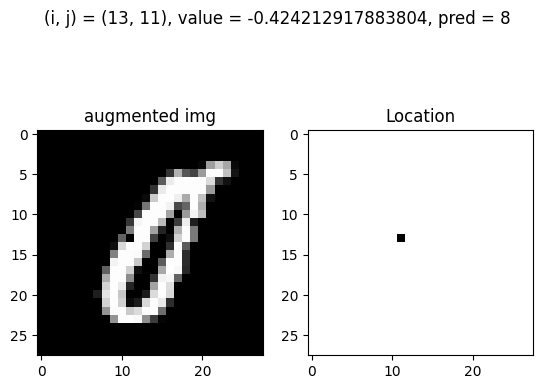

Train: At (i, j) = (13, 11) and value = -0.06357964585812692, pred = 8, before_pred = 5, gt = 0


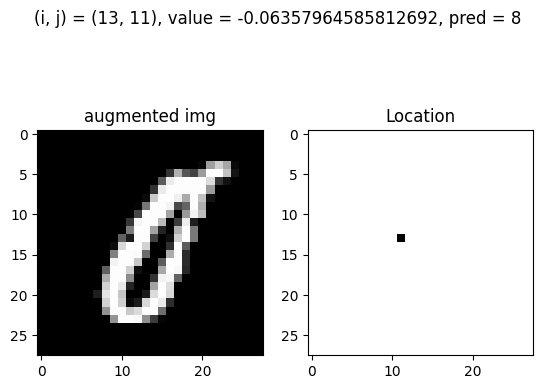

Train: At (i, j) = (13, 11) and value = 0.29705362616755016, pred = 8, before_pred = 5, gt = 0


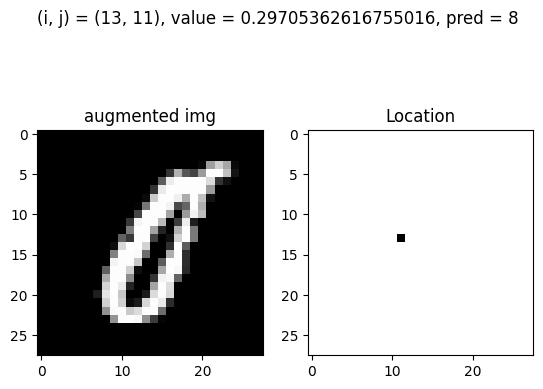

Train: At (i, j) = (13, 26) and value = 2.82148653034729, pred = 8, before_pred = 5, gt = 0


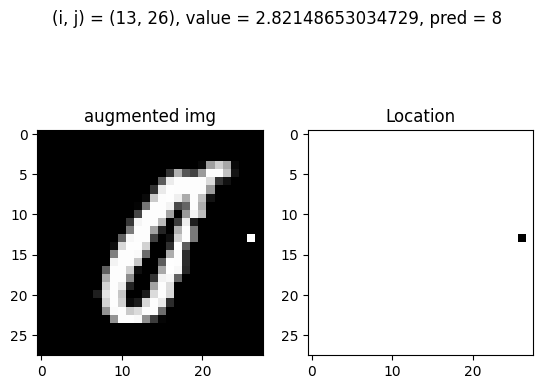

Train: At (i, j) = (14, 14) and value = 1.3789534422445815, pred = 8, before_pred = 5, gt = 0


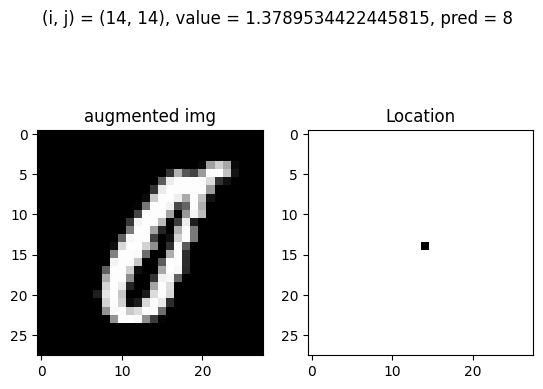

Train: At (i, j) = (14, 14) and value = 1.7395867142702586, pred = 8, before_pred = 5, gt = 0


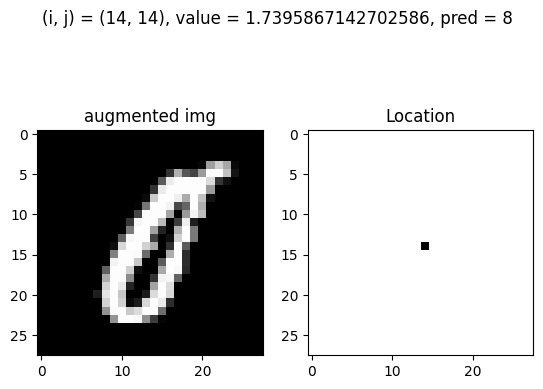

Train: At (i, j) = (14, 14) and value = 2.1002199862959356, pred = 8, before_pred = 5, gt = 0


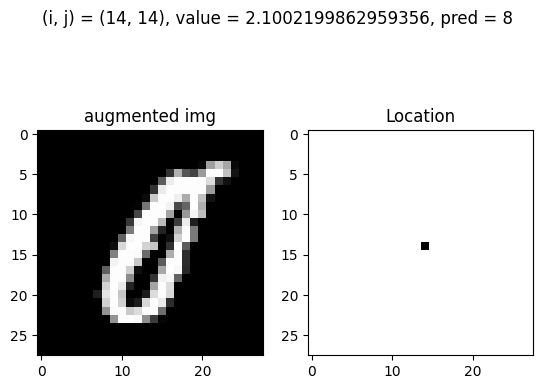

Train: At (i, j) = (14, 14) and value = 2.4608532583216127, pred = 8, before_pred = 5, gt = 0


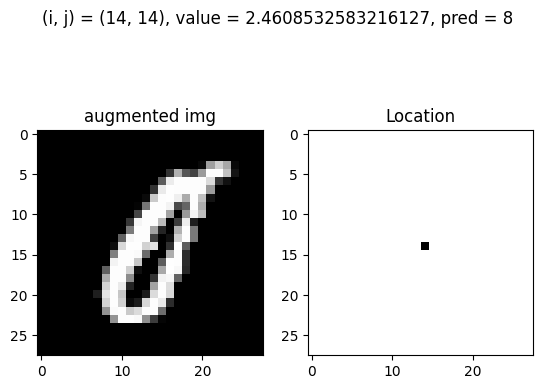

Train: At (i, j) = (14, 14) and value = 2.82148653034729, pred = 8, before_pred = 5, gt = 0


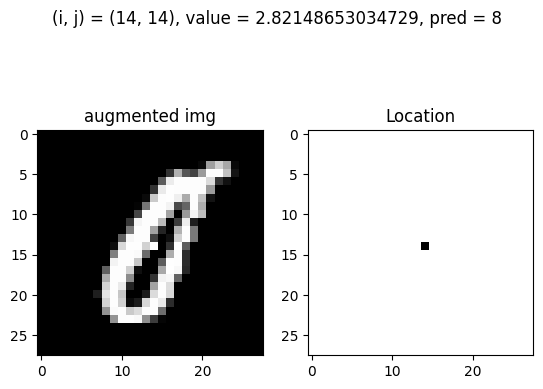

Train: At (i, j) = (15, 13) and value = 2.82148653034729, pred = 8, before_pred = 5, gt = 0


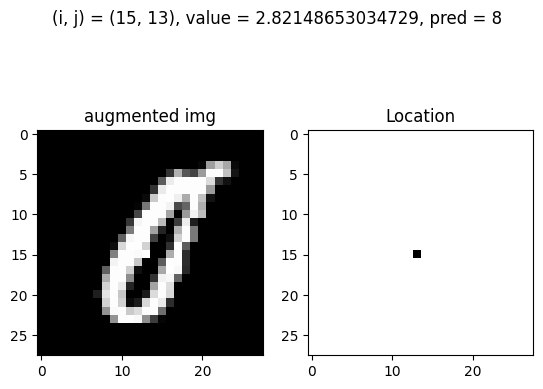

Train: At (i, j) = (15, 14) and value = 1.3789534422445815, pred = 8, before_pred = 5, gt = 0


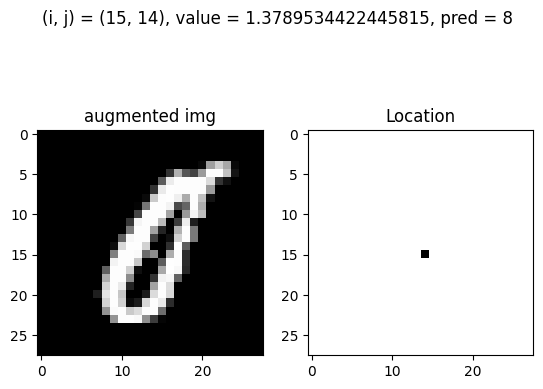

Train: At (i, j) = (15, 14) and value = 1.7395867142702586, pred = 8, before_pred = 5, gt = 0


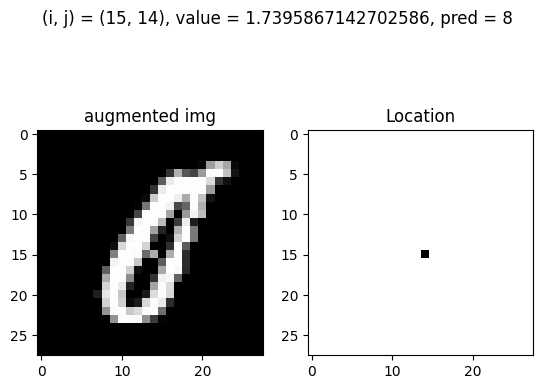

Train: At (i, j) = (15, 14) and value = 2.1002199862959356, pred = 8, before_pred = 5, gt = 0


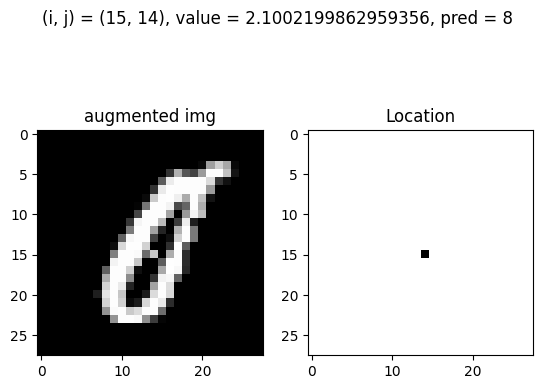

Train: At (i, j) = (15, 14) and value = 2.4608532583216127, pred = 8, before_pred = 5, gt = 0


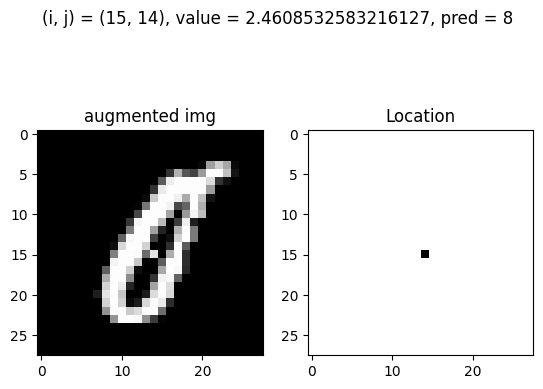

Train: At (i, j) = (15, 14) and value = 2.82148653034729, pred = 8, before_pred = 5, gt = 0


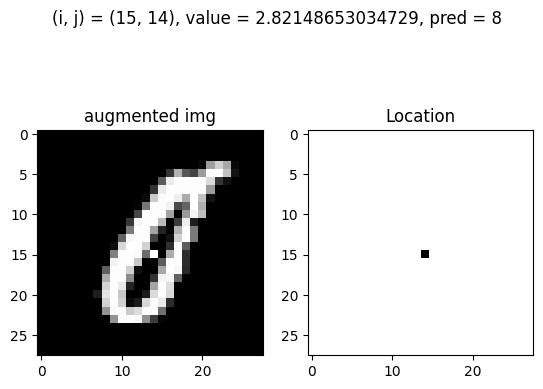

Train: At (i, j) = (15, 15) and value = 2.1002199862959356, pred = 8, before_pred = 5, gt = 0


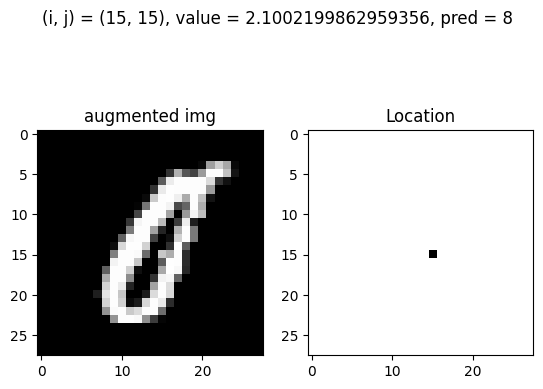

Train: At (i, j) = (15, 15) and value = 2.4608532583216127, pred = 8, before_pred = 5, gt = 0


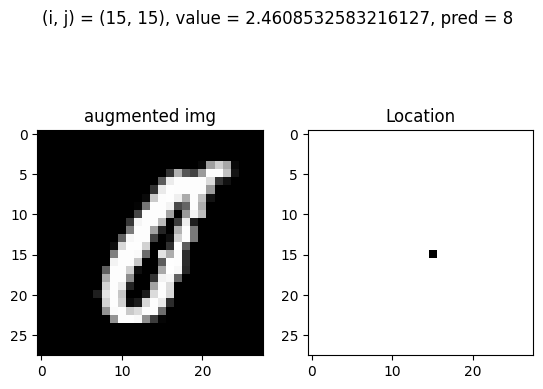

Train: At (i, j) = (15, 15) and value = 2.82148653034729, pred = 8, before_pred = 5, gt = 0


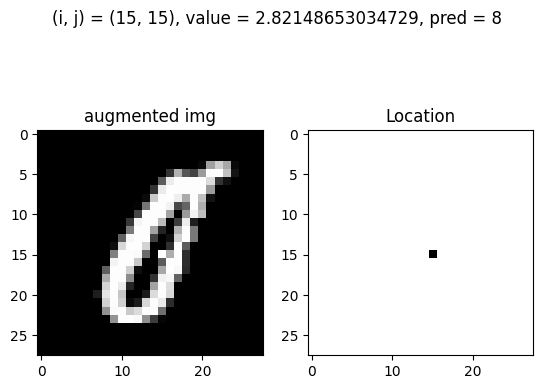

Train: At (i, j) = (16, 13) and value = 1.7395867142702586, pred = 8, before_pred = 5, gt = 0


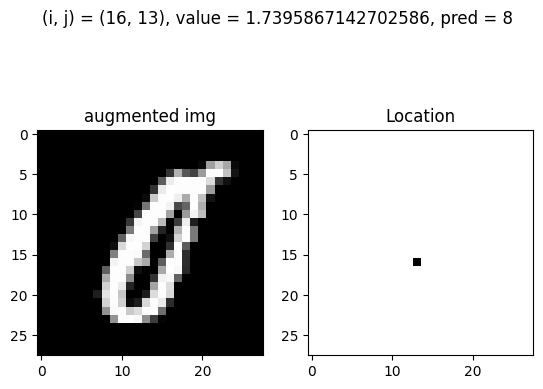

Train: At (i, j) = (16, 13) and value = 2.1002199862959356, pred = 8, before_pred = 5, gt = 0


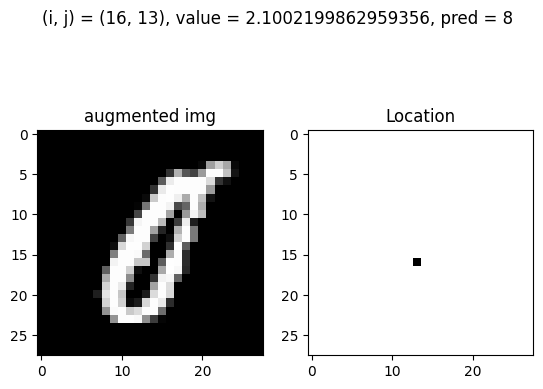

Train: At (i, j) = (16, 13) and value = 2.4608532583216127, pred = 8, before_pred = 5, gt = 0


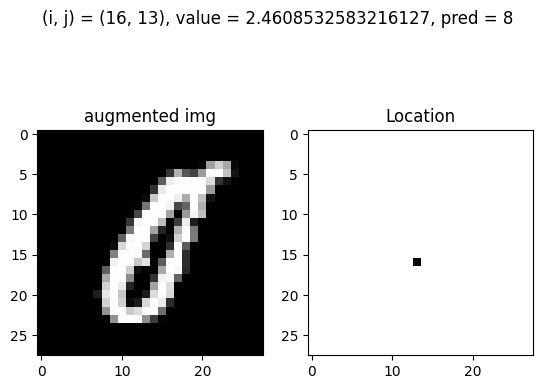

Train: At (i, j) = (16, 13) and value = 2.82148653034729, pred = 8, before_pred = 5, gt = 0


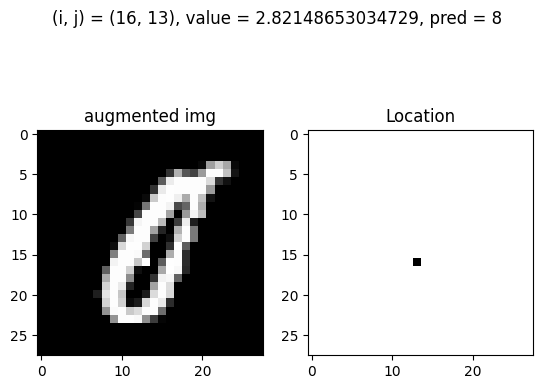

Train: At (i, j) = (16, 14) and value = 1.7395867142702586, pred = 8, before_pred = 5, gt = 0


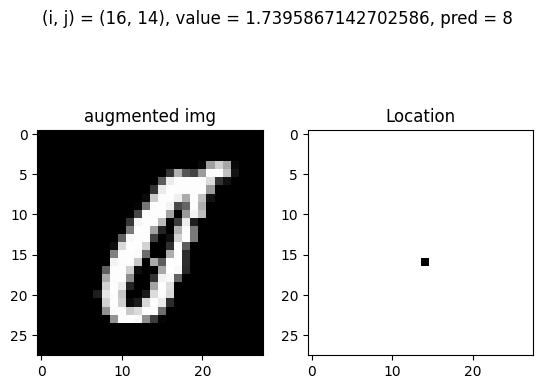

Train: At (i, j) = (16, 14) and value = 2.1002199862959356, pred = 8, before_pred = 5, gt = 0


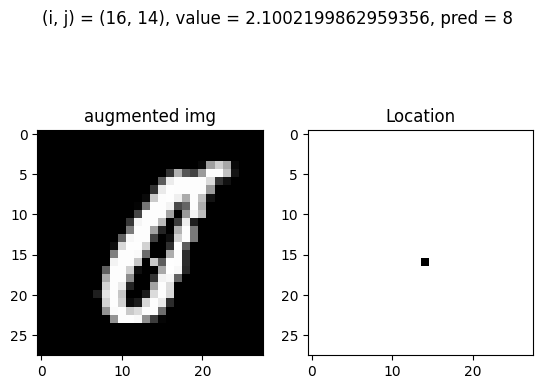

Train: At (i, j) = (16, 14) and value = 2.4608532583216127, pred = 8, before_pred = 5, gt = 0


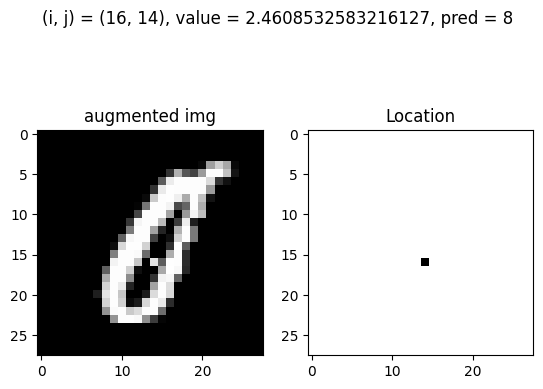

Train: At (i, j) = (16, 14) and value = 2.82148653034729, pred = 8, before_pred = 5, gt = 0


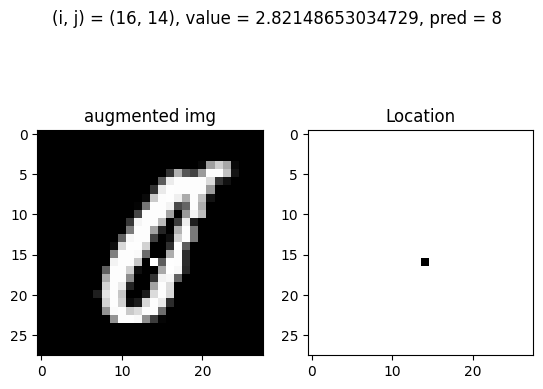

Train: At (i, j) = (17, 12) and value = 1.3789534422445815, pred = 8, before_pred = 5, gt = 0


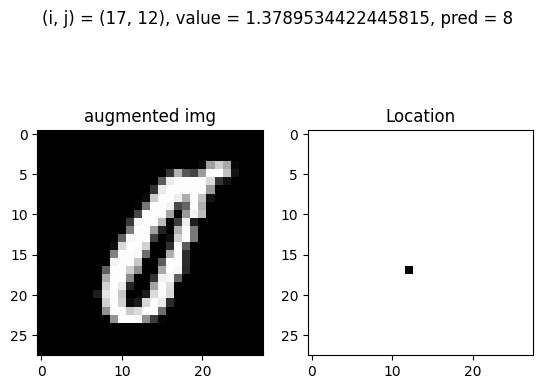

Train: At (i, j) = (17, 12) and value = 1.7395867142702586, pred = 8, before_pred = 5, gt = 0


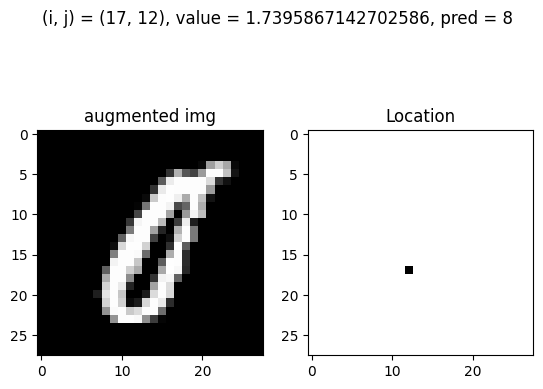

Train: At (i, j) = (17, 12) and value = 2.1002199862959356, pred = 8, before_pred = 5, gt = 0


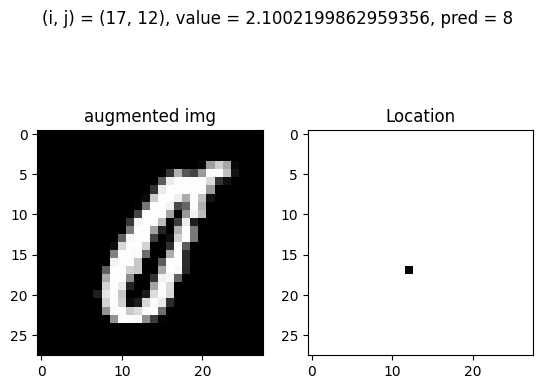

Train: At (i, j) = (17, 12) and value = 2.4608532583216127, pred = 8, before_pred = 5, gt = 0


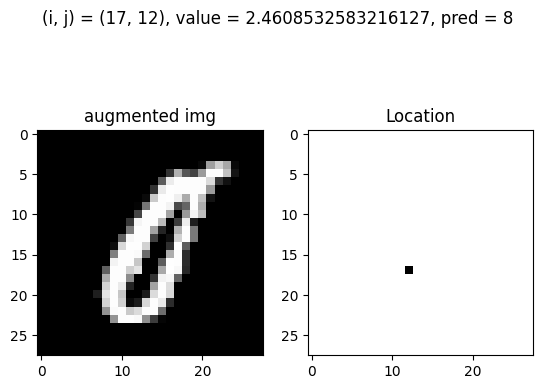

Train: At (i, j) = (17, 12) and value = 2.82148653034729, pred = 8, before_pred = 5, gt = 0


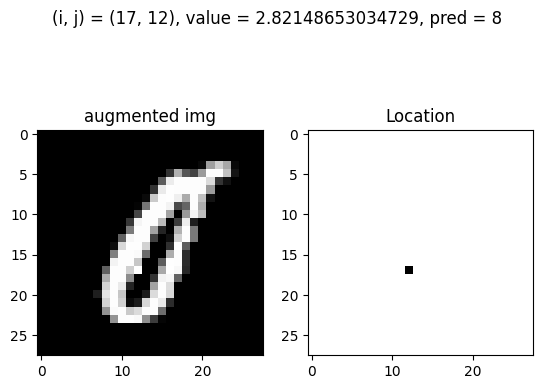

Train: At (i, j) = (17, 13) and value = 1.0183201702189044, pred = 8, before_pred = 5, gt = 0


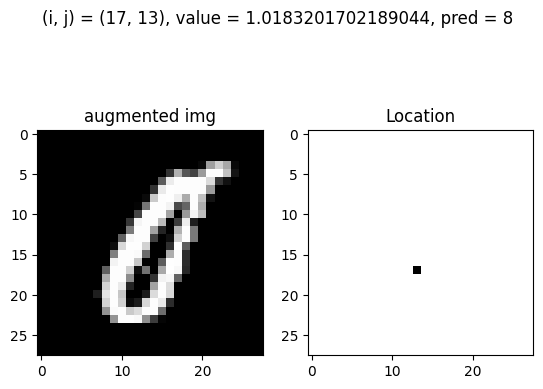

Train: At (i, j) = (17, 13) and value = 1.3789534422445815, pred = 8, before_pred = 5, gt = 0


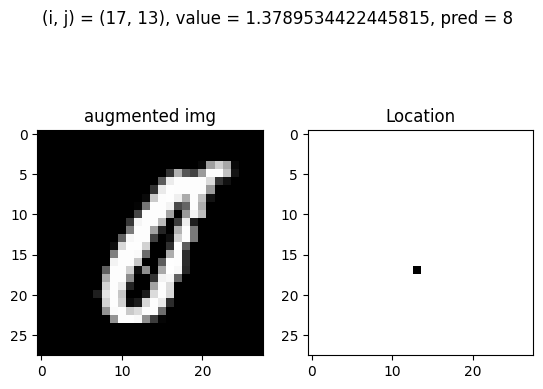

Train: At (i, j) = (17, 13) and value = 1.7395867142702586, pred = 8, before_pred = 5, gt = 0


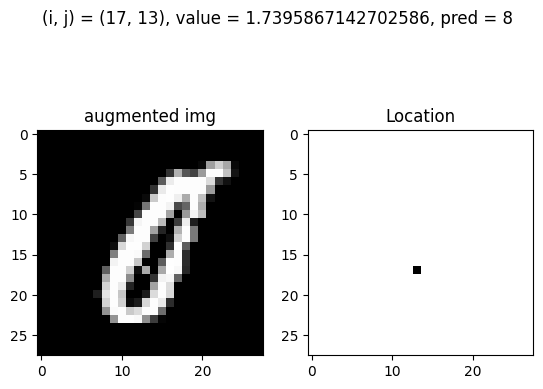

Train: At (i, j) = (17, 13) and value = 2.1002199862959356, pred = 8, before_pred = 5, gt = 0


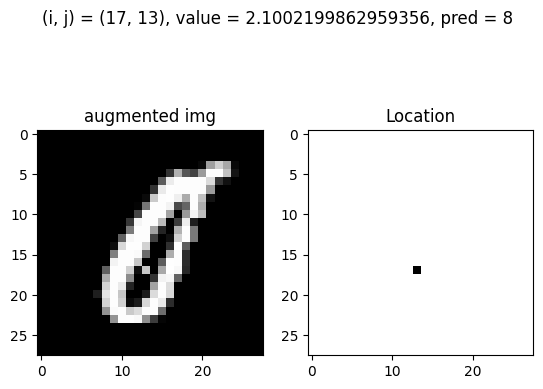

Train: At (i, j) = (17, 13) and value = 2.4608532583216127, pred = 8, before_pred = 5, gt = 0


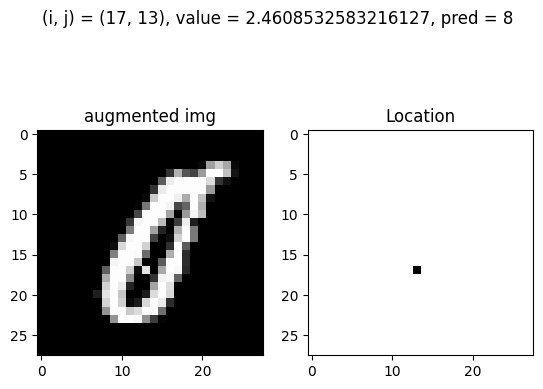

Train: At (i, j) = (17, 13) and value = 2.82148653034729, pred = 8, before_pred = 5, gt = 0


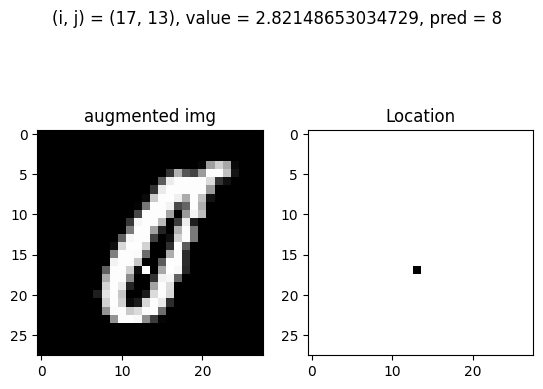

Train: At (i, j) = (17, 14) and value = 1.7395867142702586, pred = 8, before_pred = 5, gt = 0


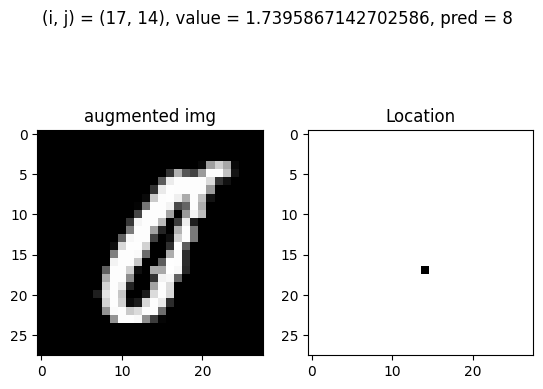

Train: At (i, j) = (17, 14) and value = 2.1002199862959356, pred = 8, before_pred = 5, gt = 0


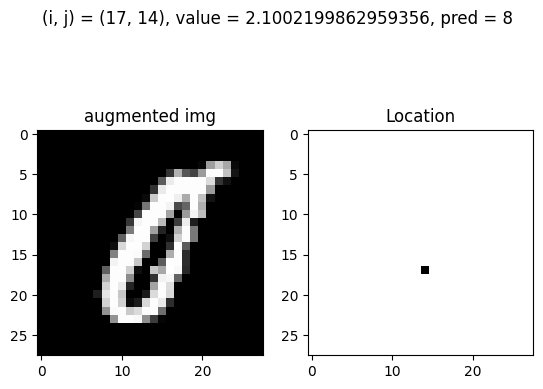

Train: At (i, j) = (17, 14) and value = 2.4608532583216127, pred = 8, before_pred = 5, gt = 0


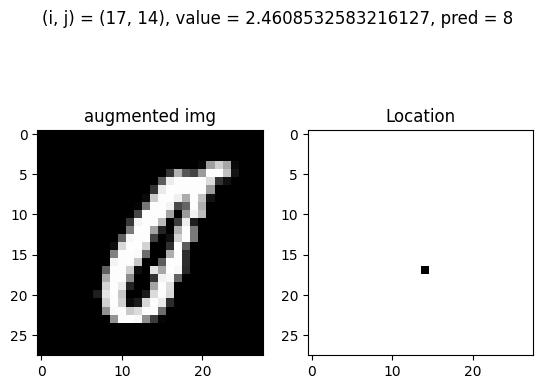

Train: At (i, j) = (17, 14) and value = 2.82148653034729, pred = 8, before_pred = 5, gt = 0


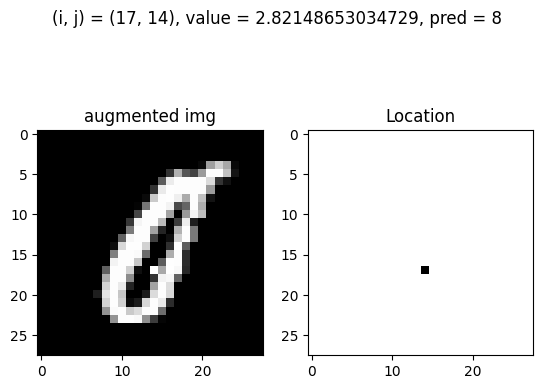

Train: At (i, j) = (18, 12) and value = 1.3789534422445815, pred = 8, before_pred = 5, gt = 0


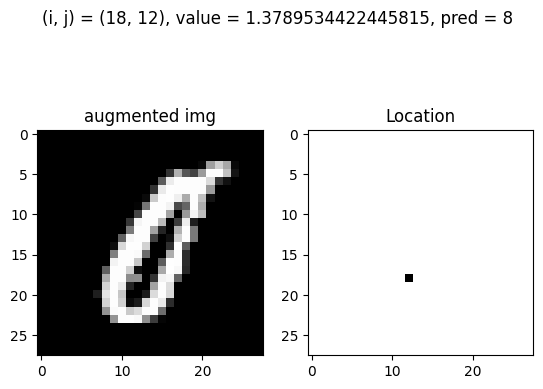

Train: At (i, j) = (18, 12) and value = 1.7395867142702586, pred = 8, before_pred = 5, gt = 0


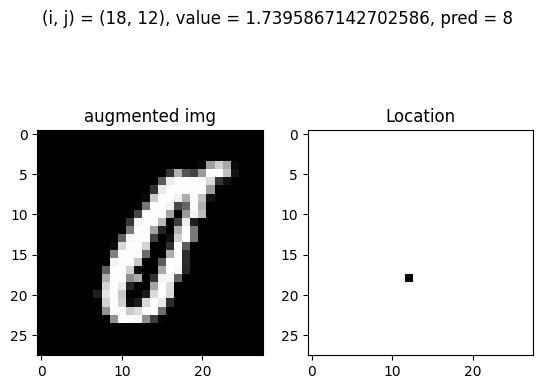

Train: At (i, j) = (18, 12) and value = 2.1002199862959356, pred = 8, before_pred = 5, gt = 0


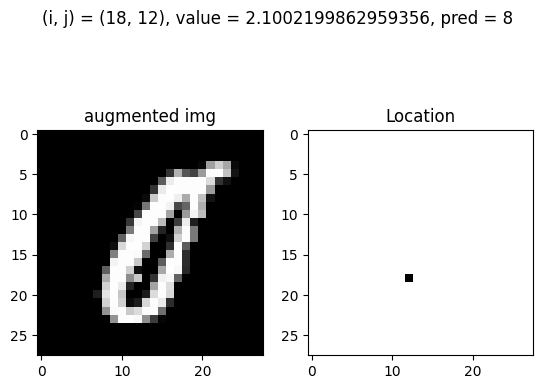

Train: At (i, j) = (18, 12) and value = 2.4608532583216127, pred = 8, before_pred = 5, gt = 0


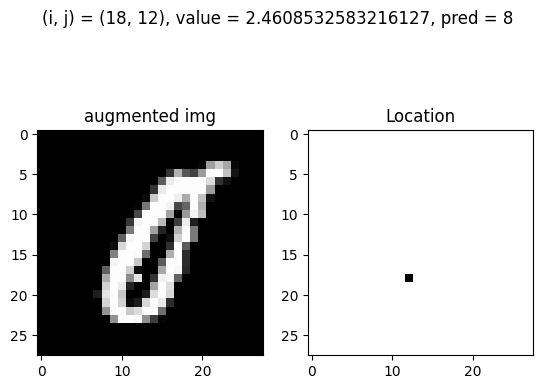

Train: At (i, j) = (18, 12) and value = 2.82148653034729, pred = 8, before_pred = 5, gt = 0


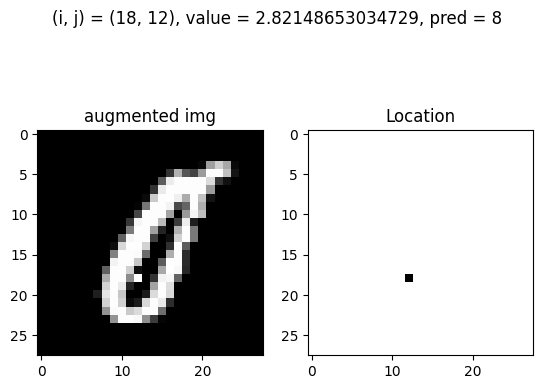

Train: At (i, j) = (18, 13) and value = 2.4608532583216127, pred = 8, before_pred = 5, gt = 0


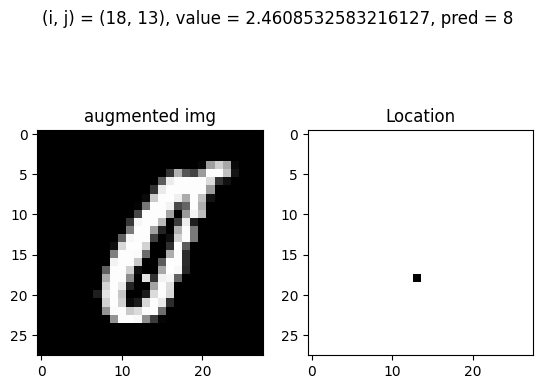

Train: At (i, j) = (18, 13) and value = 2.82148653034729, pred = 8, before_pred = 5, gt = 0


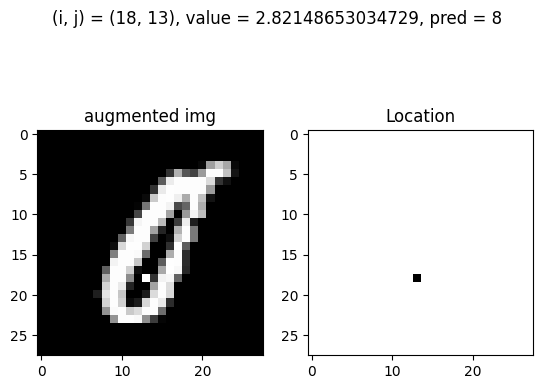

Train: At (i, j) = (19, 2) and value = 2.82148653034729, pred = 8, before_pred = 5, gt = 0


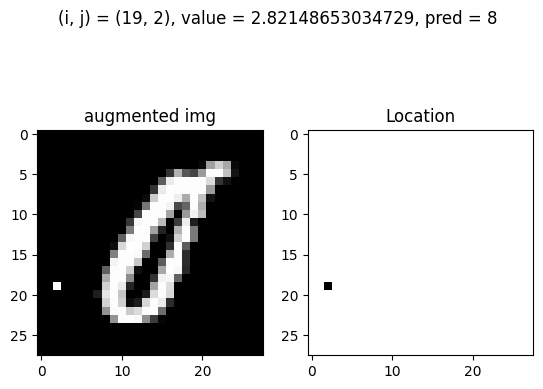

7840 done
7840 done
7840 done
7840 done
7840 done
7840 done
7840 done
7840 done
7840 done
7840 done
7840 done
7840 done
7840 done
7840 done
7840 done
7840 done
7840 done
7840 done
7840 done
7840 done
7840 done
7840 done
7840 done
7840 done
7840 done
7840 done
7840 done
7840 done
7840 done
7840 done
7840 done
7840 done
7840 done
7840 done
7840 done
7840 done
7840 done
Train: At (i, j) = (5, 26) and value = 2.4608532583216127, pred = 8, before_pred = 6, gt = 8


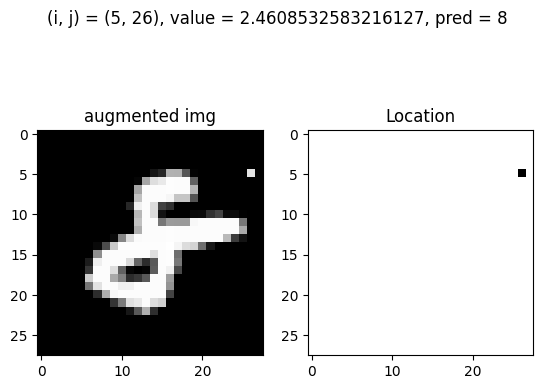

Train: At (i, j) = (5, 26) and value = 2.82148653034729, pred = 8, before_pred = 6, gt = 8


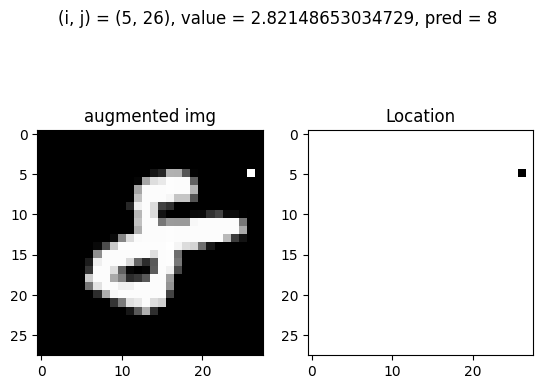

Train: At (i, j) = (7, 21) and value = 2.4608532583216127, pred = 8, before_pred = 6, gt = 8


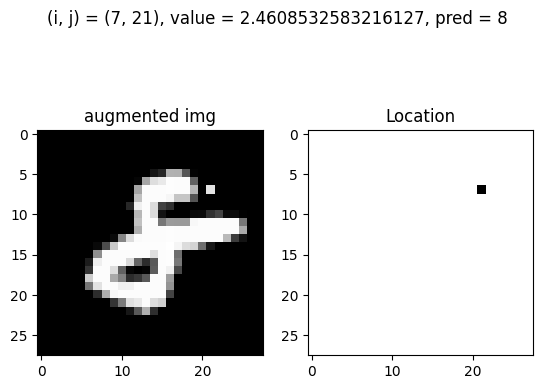

Train: At (i, j) = (7, 21) and value = 2.82148653034729, pred = 8, before_pred = 6, gt = 8


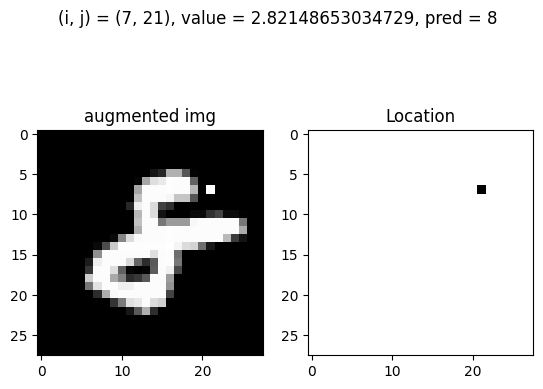

Train: At (i, j) = (8, 20) and value = 2.4608532583216127, pred = 8, before_pred = 6, gt = 8


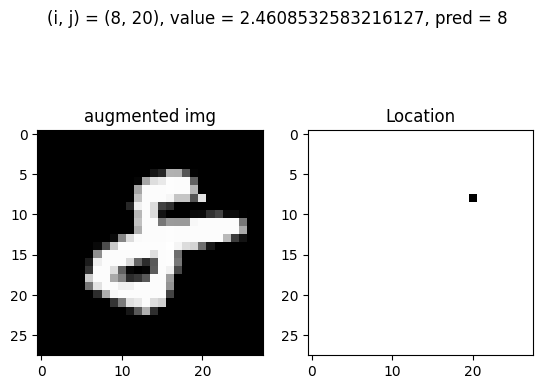

Train: At (i, j) = (8, 20) and value = 2.82148653034729, pred = 8, before_pred = 6, gt = 8


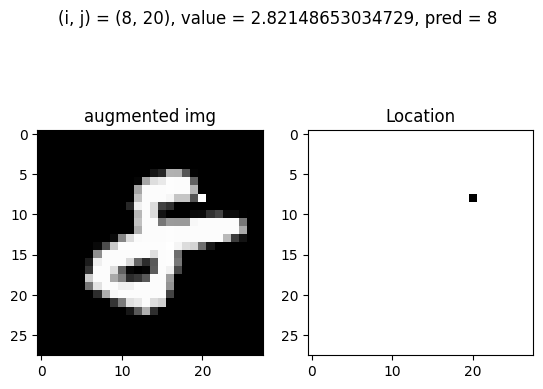

Train: At (i, j) = (8, 21) and value = 2.1002199862959356, pred = 8, before_pred = 6, gt = 8


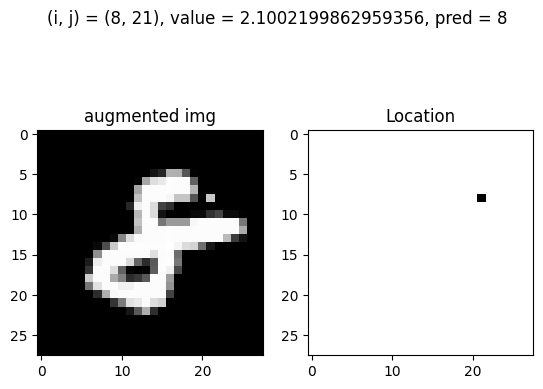

Train: At (i, j) = (8, 21) and value = 2.4608532583216127, pred = 8, before_pred = 6, gt = 8


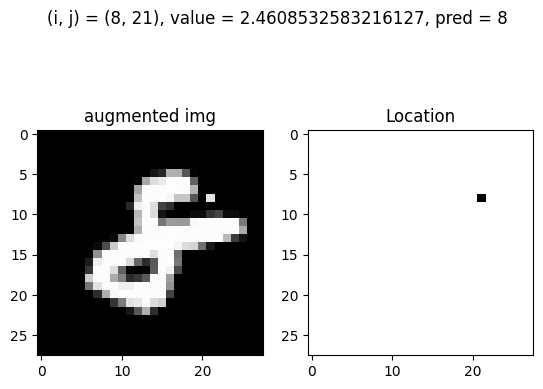

Train: At (i, j) = (8, 21) and value = 2.82148653034729, pred = 8, before_pred = 6, gt = 8


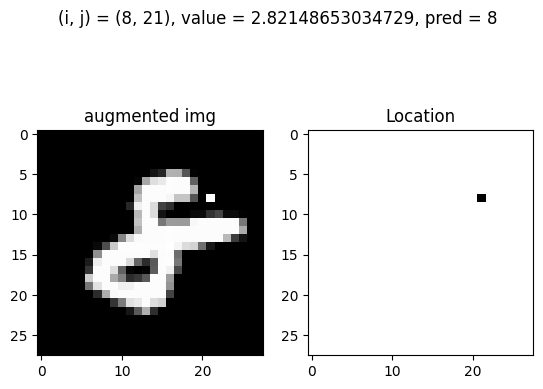

Train: At (i, j) = (8, 22) and value = 2.1002199862959356, pred = 8, before_pred = 6, gt = 8


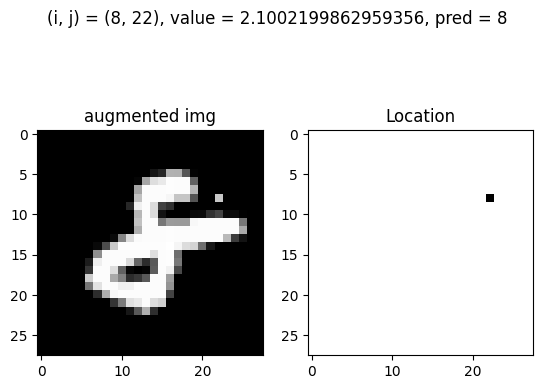

Train: At (i, j) = (8, 22) and value = 2.4608532583216127, pred = 8, before_pred = 6, gt = 8


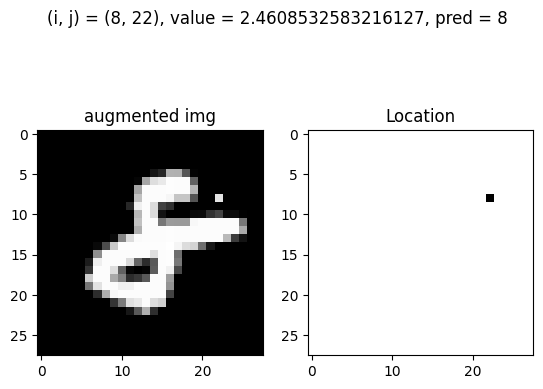

Train: At (i, j) = (8, 22) and value = 2.82148653034729, pred = 8, before_pred = 6, gt = 8


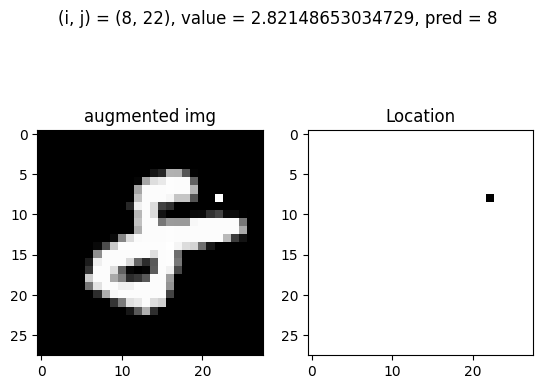

Train: At (i, j) = (8, 24) and value = 2.82148653034729, pred = 8, before_pred = 6, gt = 8


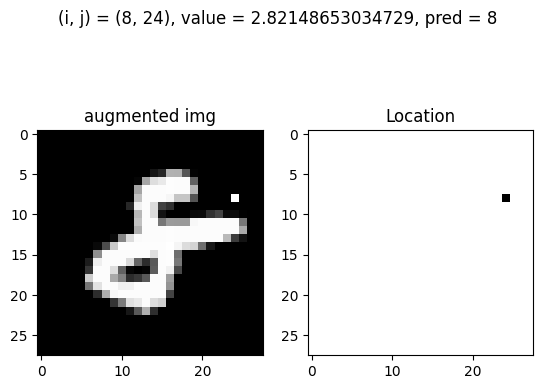

Train: At (i, j) = (9, 18) and value = 2.4608532583216127, pred = 8, before_pred = 6, gt = 8


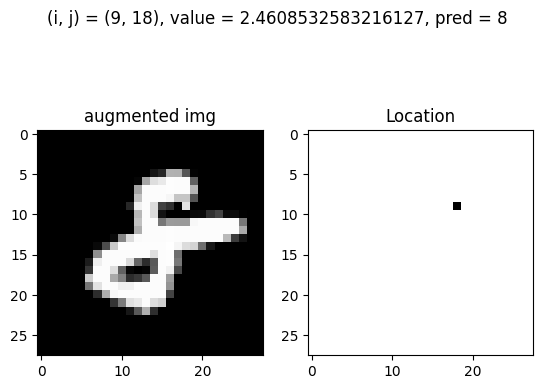

Train: At (i, j) = (9, 18) and value = 2.82148653034729, pred = 8, before_pred = 6, gt = 8


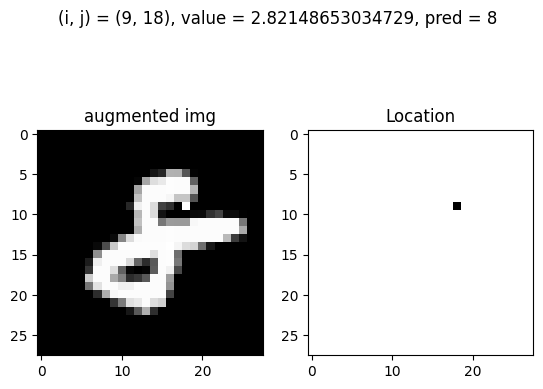

Train: At (i, j) = (9, 19) and value = 1.7395867142702586, pred = 8, before_pred = 6, gt = 8


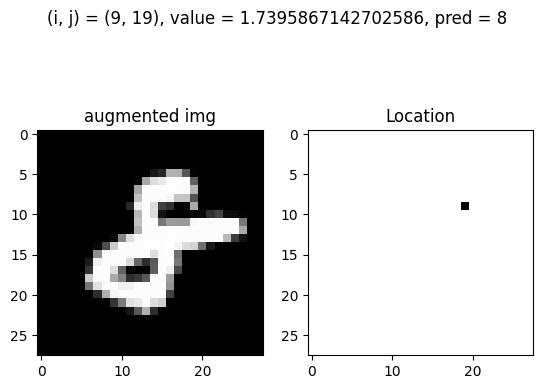

Train: At (i, j) = (9, 19) and value = 2.1002199862959356, pred = 8, before_pred = 6, gt = 8


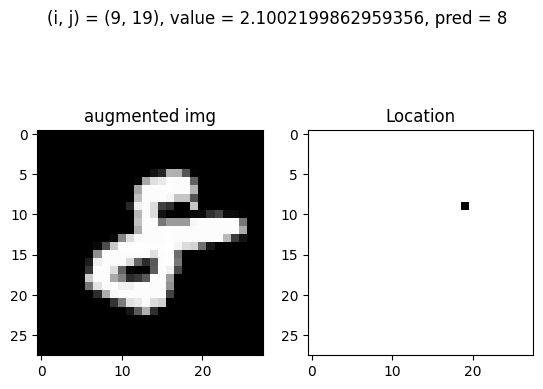

Train: At (i, j) = (9, 19) and value = 2.4608532583216127, pred = 8, before_pred = 6, gt = 8


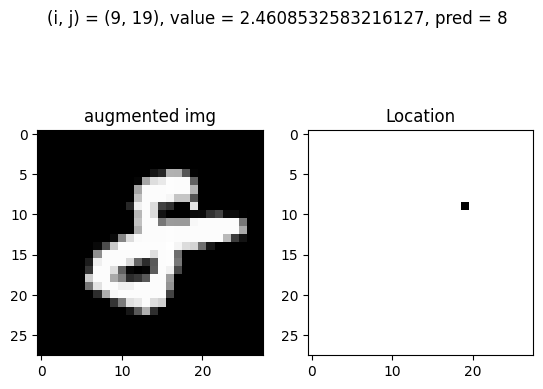

Train: At (i, j) = (9, 19) and value = 2.82148653034729, pred = 8, before_pred = 6, gt = 8


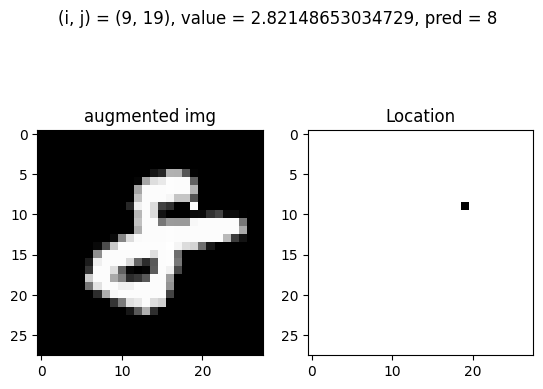

Train: At (i, j) = (9, 20) and value = 1.0183201702189044, pred = 8, before_pred = 6, gt = 8


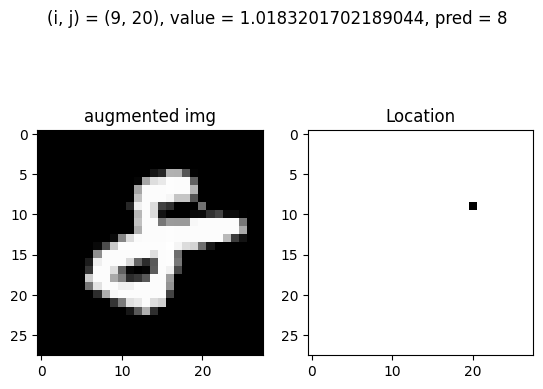

Train: At (i, j) = (9, 20) and value = 1.3789534422445815, pred = 8, before_pred = 6, gt = 8


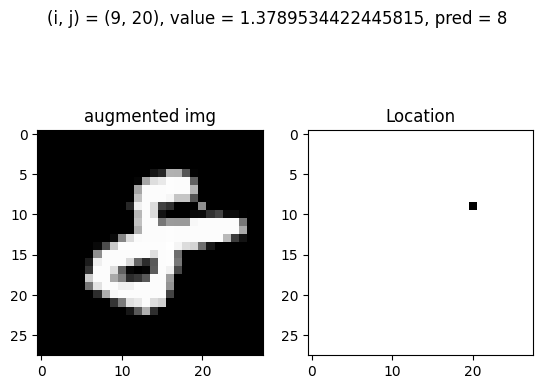

Train: At (i, j) = (9, 20) and value = 1.7395867142702586, pred = 8, before_pred = 6, gt = 8


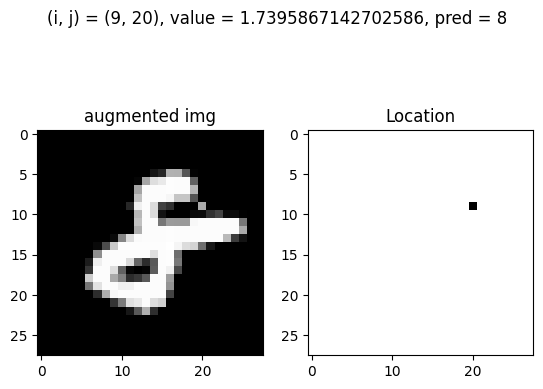

Train: At (i, j) = (9, 20) and value = 2.1002199862959356, pred = 8, before_pred = 6, gt = 8


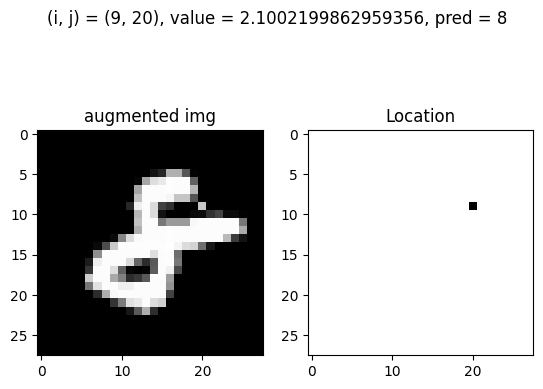

Train: At (i, j) = (9, 20) and value = 2.4608532583216127, pred = 8, before_pred = 6, gt = 8


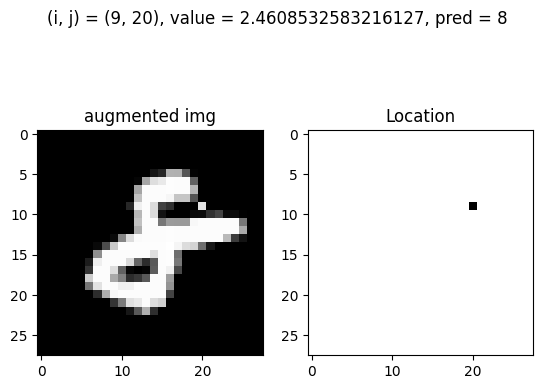

Train: At (i, j) = (9, 20) and value = 2.82148653034729, pred = 8, before_pred = 6, gt = 8


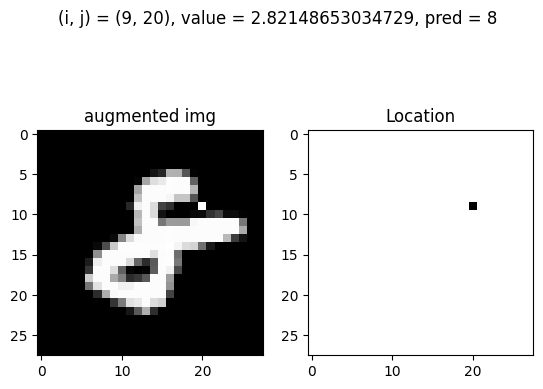

Train: At (i, j) = (9, 22) and value = 1.3789534422445815, pred = 8, before_pred = 6, gt = 8


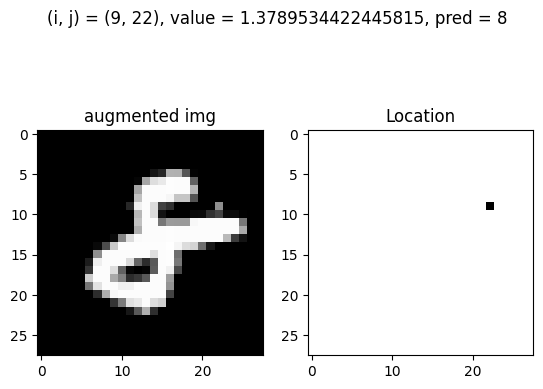

Train: At (i, j) = (9, 22) and value = 1.7395867142702586, pred = 8, before_pred = 6, gt = 8


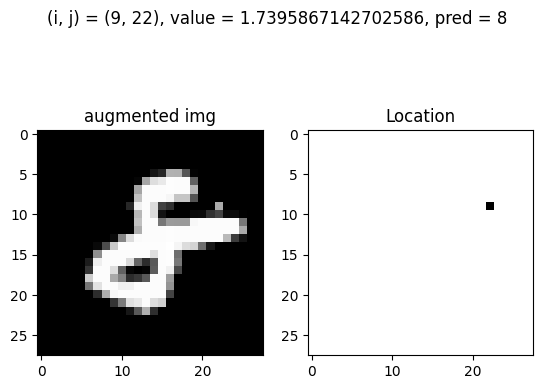

Train: At (i, j) = (9, 22) and value = 2.1002199862959356, pred = 8, before_pred = 6, gt = 8


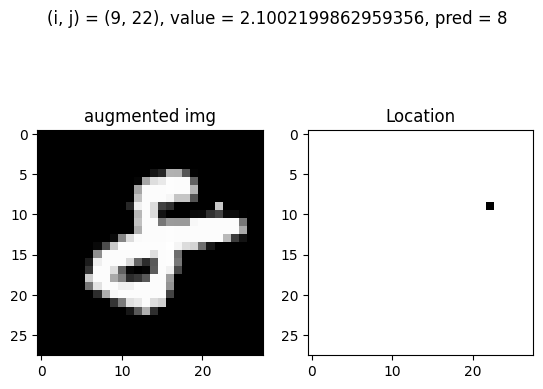

Train: At (i, j) = (9, 22) and value = 2.4608532583216127, pred = 8, before_pred = 6, gt = 8


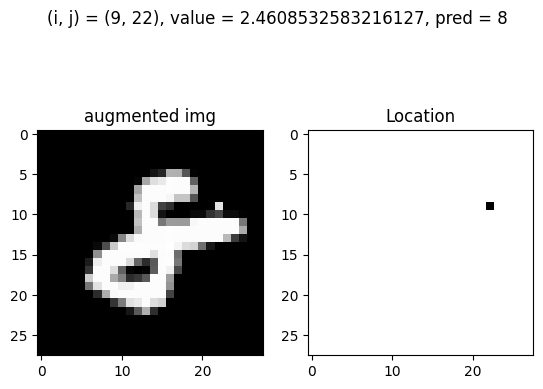

Train: At (i, j) = (9, 22) and value = 2.82148653034729, pred = 8, before_pred = 6, gt = 8


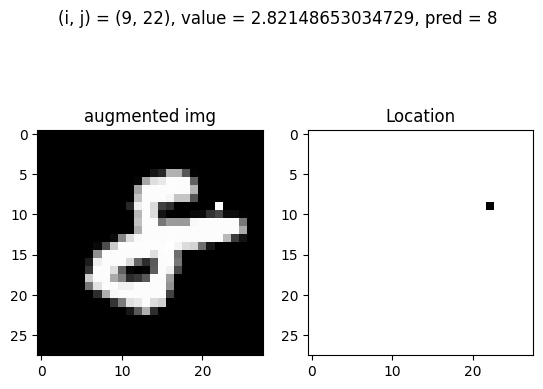

Train: At (i, j) = (10, 17) and value = 2.82148653034729, pred = 8, before_pred = 6, gt = 8


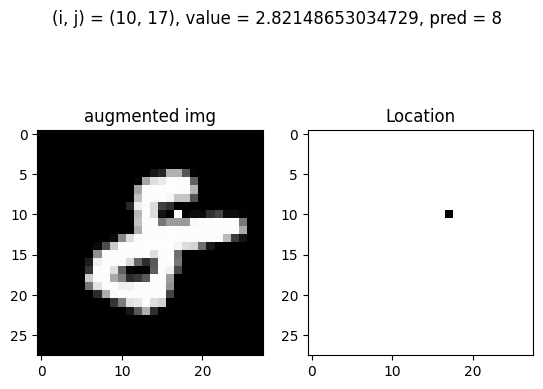

Train: At (i, j) = (10, 18) and value = 1.3789534422445815, pred = 8, before_pred = 6, gt = 8


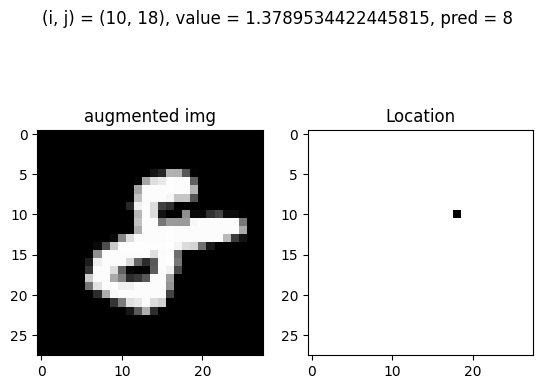

Train: At (i, j) = (10, 18) and value = 1.7395867142702586, pred = 8, before_pred = 6, gt = 8


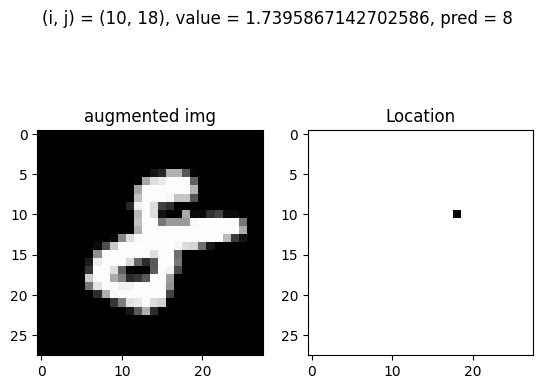

Train: At (i, j) = (10, 18) and value = 2.1002199862959356, pred = 8, before_pred = 6, gt = 8


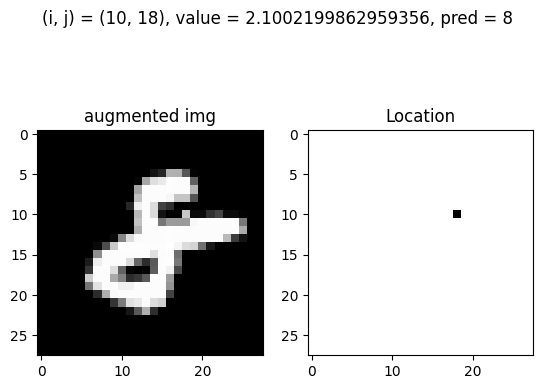

Train: At (i, j) = (10, 18) and value = 2.4608532583216127, pred = 8, before_pred = 6, gt = 8


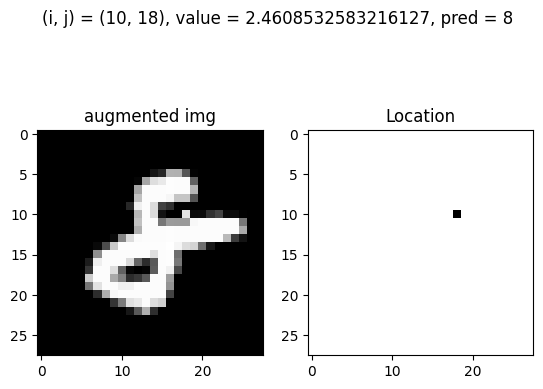

Train: At (i, j) = (10, 18) and value = 2.82148653034729, pred = 8, before_pred = 6, gt = 8


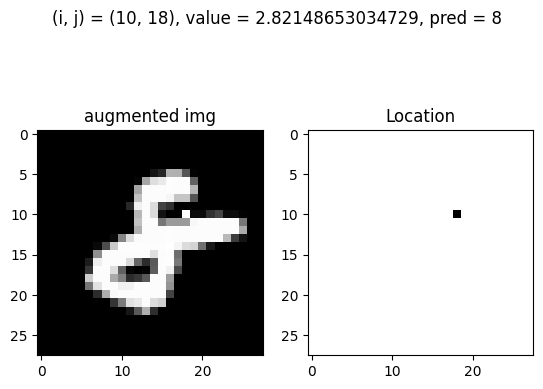

Train: At (i, j) = (10, 19) and value = 1.7395867142702586, pred = 8, before_pred = 6, gt = 8


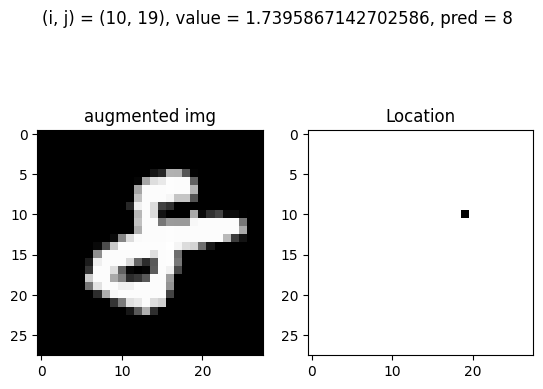

Train: At (i, j) = (10, 19) and value = 2.1002199862959356, pred = 8, before_pred = 6, gt = 8


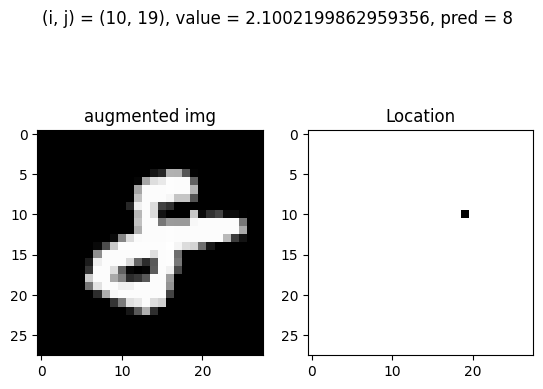

Train: At (i, j) = (10, 19) and value = 2.4608532583216127, pred = 8, before_pred = 6, gt = 8


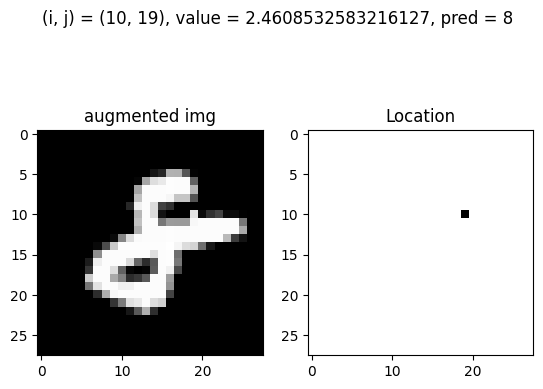

Train: At (i, j) = (10, 19) and value = 2.82148653034729, pred = 8, before_pred = 6, gt = 8


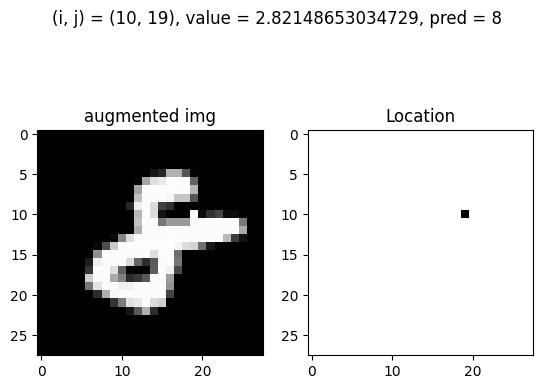

Train: At (i, j) = (13, 22) and value = -0.424212917883804, pred = 8, before_pred = 6, gt = 8


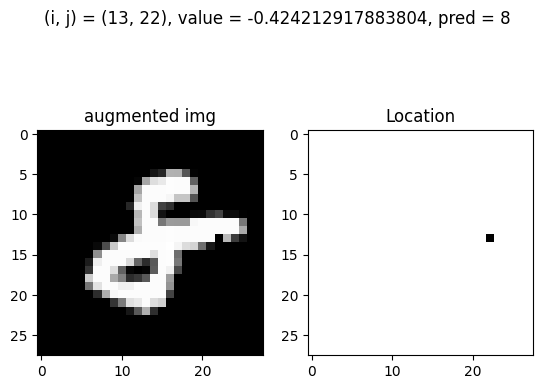

Train: At (i, j) = (14, 9) and value = -0.424212917883804, pred = 8, before_pred = 6, gt = 8


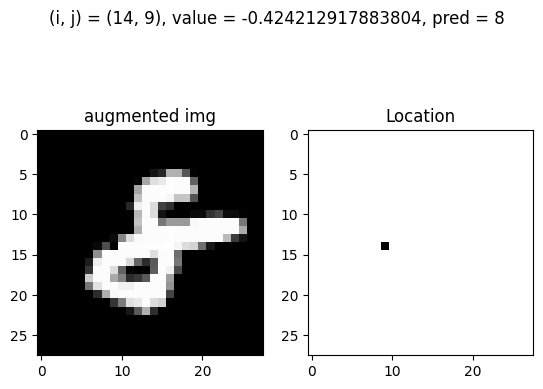

Train: At (i, j) = (14, 10) and value = -0.424212917883804, pred = 8, before_pred = 6, gt = 8


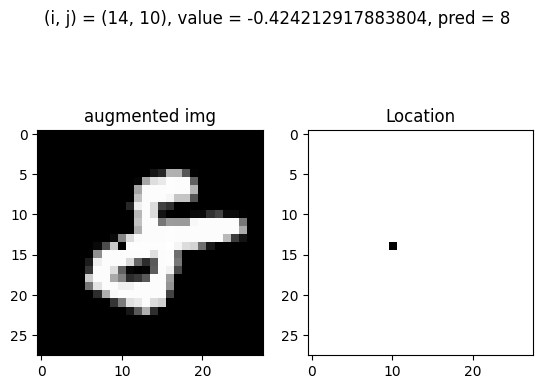

Train: At (i, j) = (14, 10) and value = -0.06357964585812692, pred = 8, before_pred = 6, gt = 8


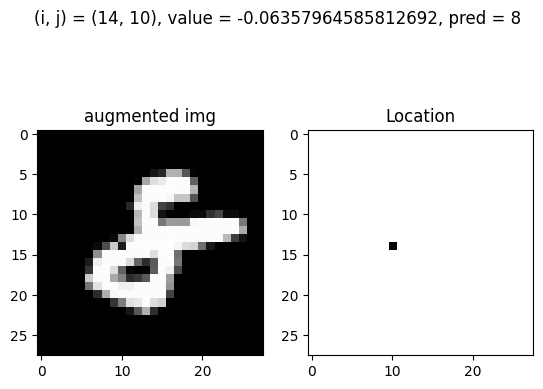

Train: At (i, j) = (15, 9) and value = -0.424212917883804, pred = 8, before_pred = 6, gt = 8


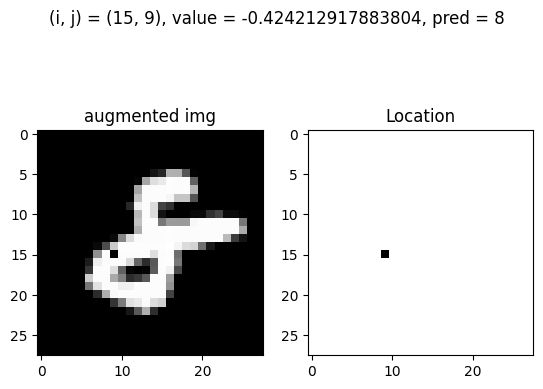

Train: At (i, j) = (15, 9) and value = -0.06357964585812692, pred = 8, before_pred = 6, gt = 8


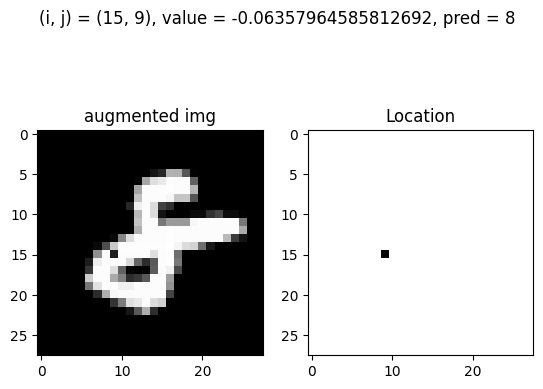

Train: At (i, j) = (15, 9) and value = 0.29705362616755016, pred = 8, before_pred = 6, gt = 8


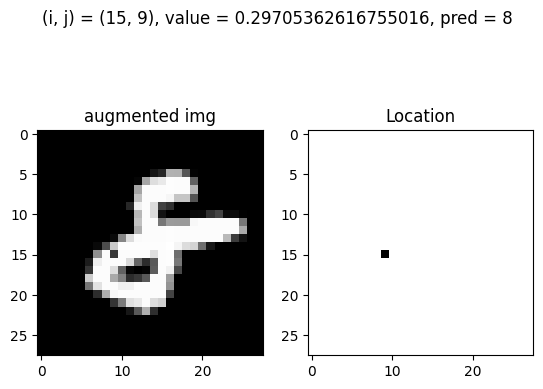

Train: At (i, j) = (15, 9) and value = 0.6576868981932272, pred = 8, before_pred = 6, gt = 8


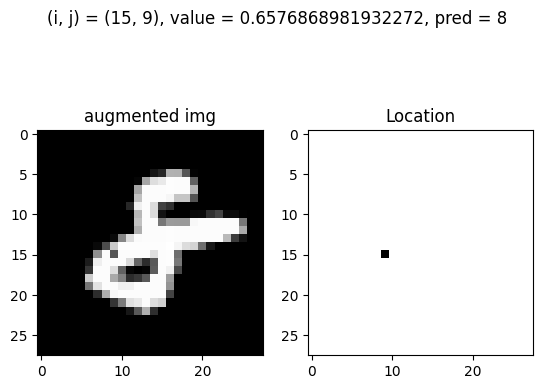

Train: At (i, j) = (16, 8) and value = -0.424212917883804, pred = 8, before_pred = 6, gt = 8


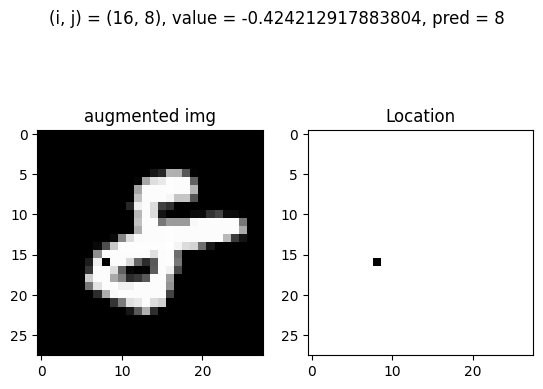

Train: At (i, j) = (16, 8) and value = -0.06357964585812692, pred = 8, before_pred = 6, gt = 8


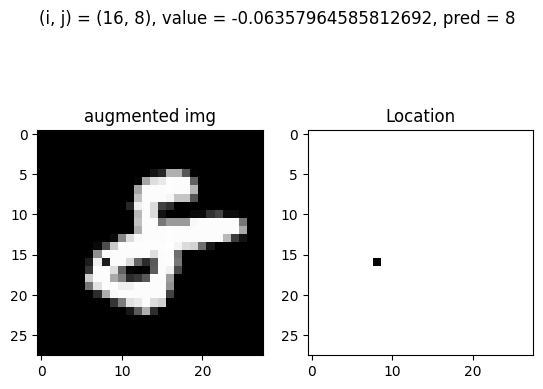

Train: At (i, j) = (16, 9) and value = -0.424212917883804, pred = 8, before_pred = 6, gt = 8


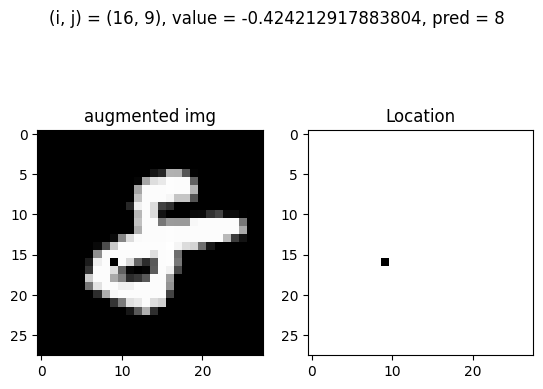

Train: At (i, j) = (16, 9) and value = -0.06357964585812692, pred = 8, before_pred = 6, gt = 8


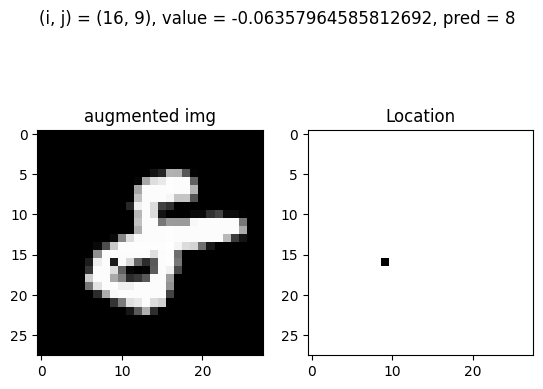

Train: At (i, j) = (19, 12) and value = -0.424212917883804, pred = 8, before_pred = 6, gt = 8


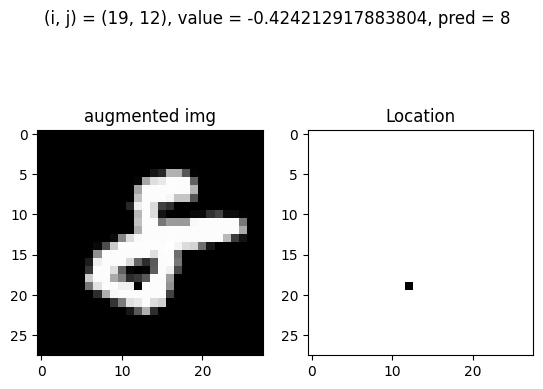

Train: At (i, j) = (19, 12) and value = -0.06357964585812692, pred = 8, before_pred = 6, gt = 8


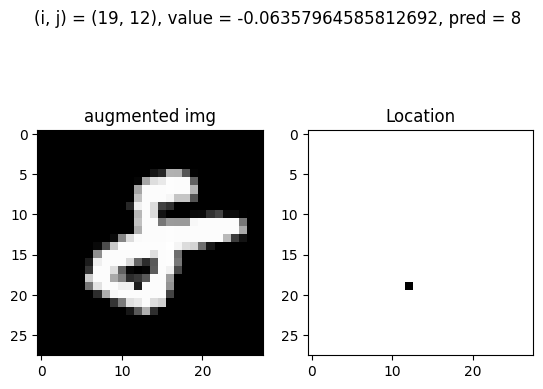

Train: At (i, j) = (19, 12) and value = 0.29705362616755016, pred = 8, before_pred = 6, gt = 8


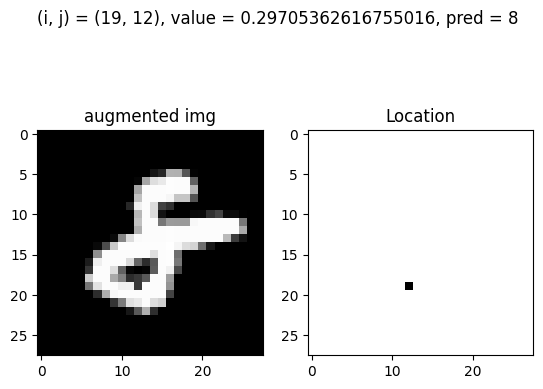

Train: At (i, j) = (19, 12) and value = 0.6576868981932272, pred = 8, before_pred = 6, gt = 8


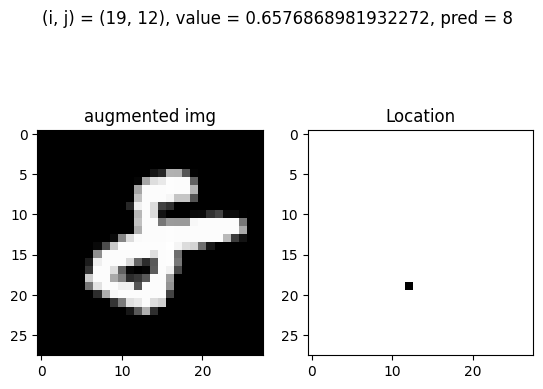

Train: At (i, j) = (20, 10) and value = -0.424212917883804, pred = 8, before_pred = 6, gt = 8


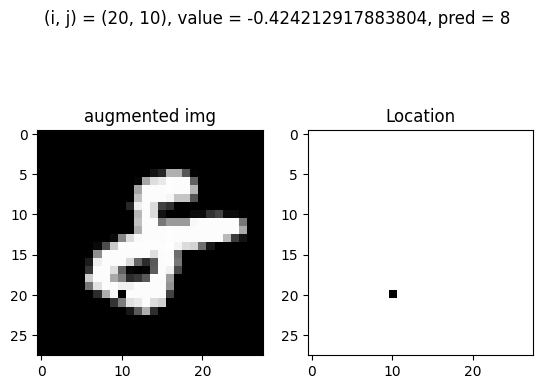

Train: At (i, j) = (20, 11) and value = -0.424212917883804, pred = 8, before_pred = 6, gt = 8


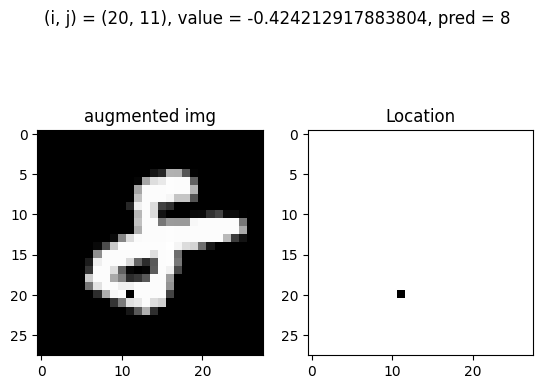

Train: At (i, j) = (20, 11) and value = -0.06357964585812692, pred = 8, before_pred = 6, gt = 8


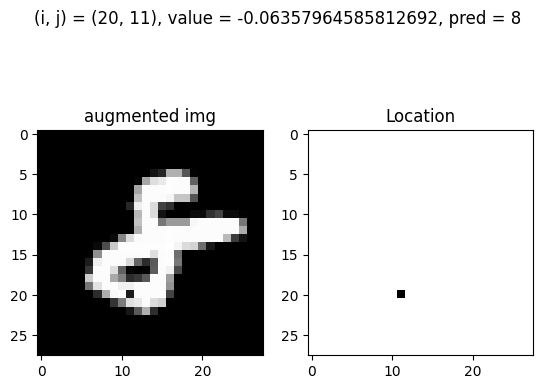

Train: At (i, j) = (20, 11) and value = 0.29705362616755016, pred = 8, before_pred = 6, gt = 8


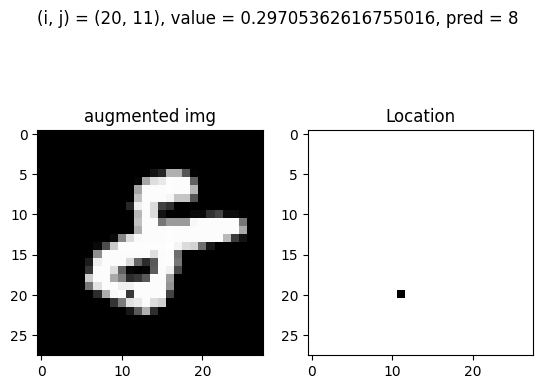

Train: At (i, j) = (20, 12) and value = -0.424212917883804, pred = 8, before_pred = 6, gt = 8


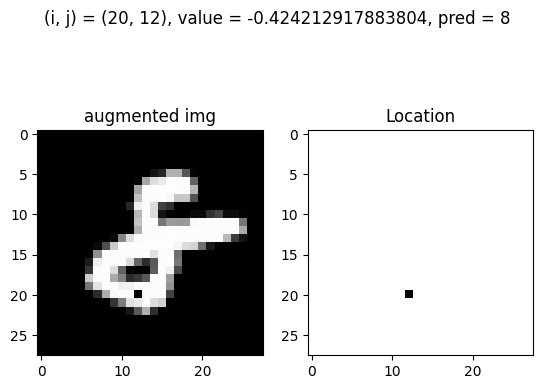

Train: At (i, j) = (20, 12) and value = -0.06357964585812692, pred = 8, before_pred = 6, gt = 8


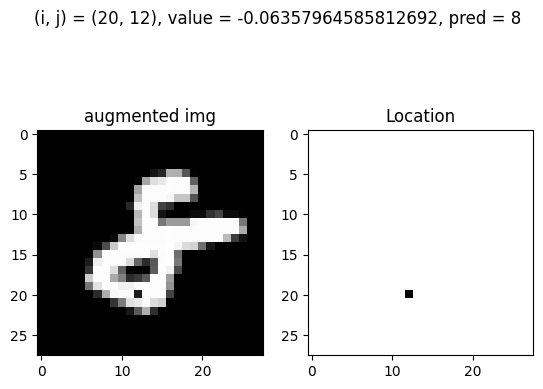

Train: At (i, j) = (20, 12) and value = 0.29705362616755016, pred = 8, before_pred = 6, gt = 8


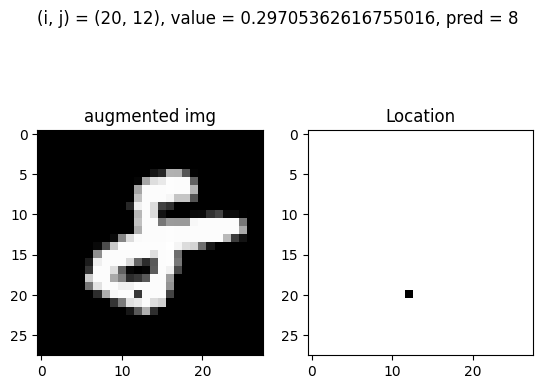

Train: At (i, j) = (20, 13) and value = -0.424212917883804, pred = 8, before_pred = 6, gt = 8


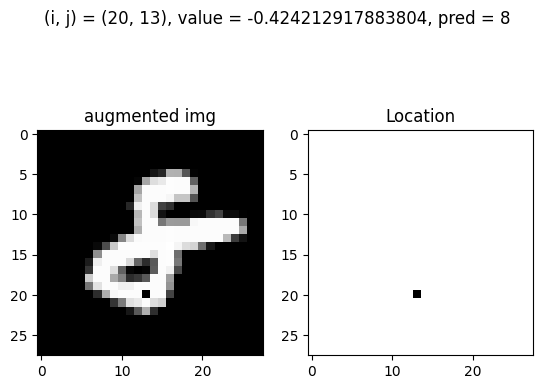

Train: At (i, j) = (20, 13) and value = -0.06357964585812692, pred = 8, before_pred = 6, gt = 8


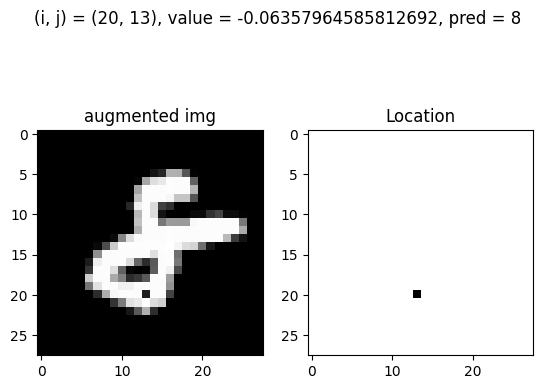

Train: At (i, j) = (20, 13) and value = 0.29705362616755016, pred = 8, before_pred = 6, gt = 8


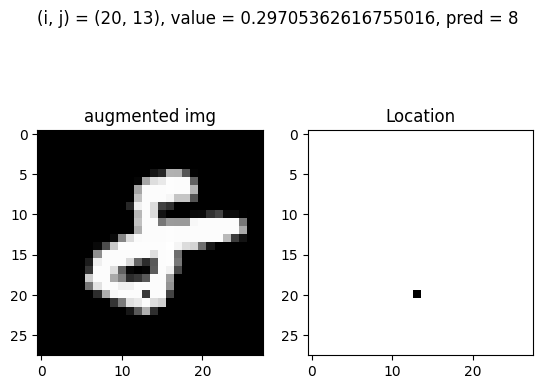

Train: At (i, j) = (20, 13) and value = 0.6576868981932272, pred = 8, before_pred = 6, gt = 8


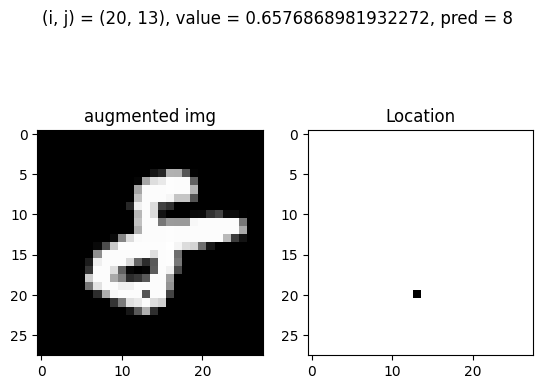

Train: At (i, j) = (20, 14) and value = -0.424212917883804, pred = 8, before_pred = 6, gt = 8


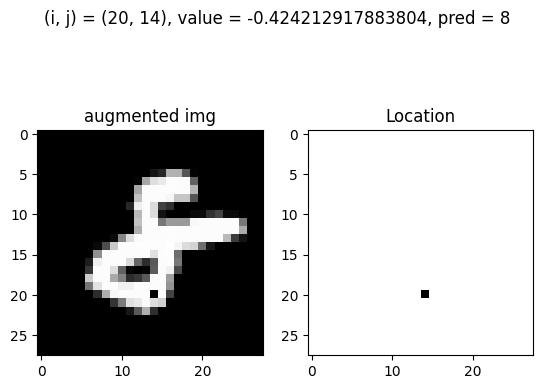

Train: At (i, j) = (20, 14) and value = -0.06357964585812692, pred = 8, before_pred = 6, gt = 8


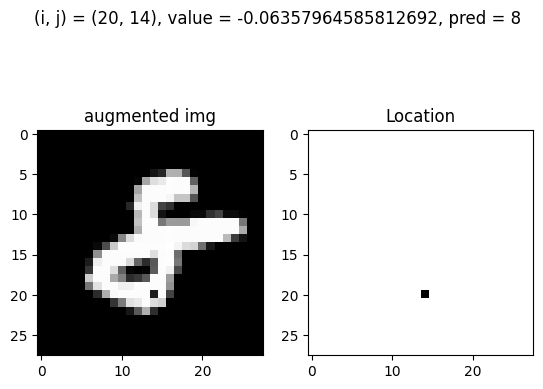

Train: At (i, j) = (20, 14) and value = 0.29705362616755016, pred = 8, before_pred = 6, gt = 8


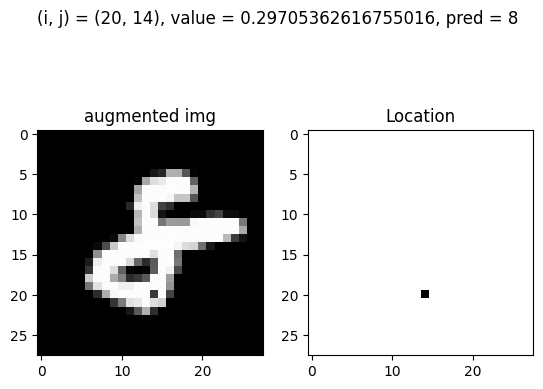

Train: At (i, j) = (20, 14) and value = 0.6576868981932272, pred = 8, before_pred = 6, gt = 8


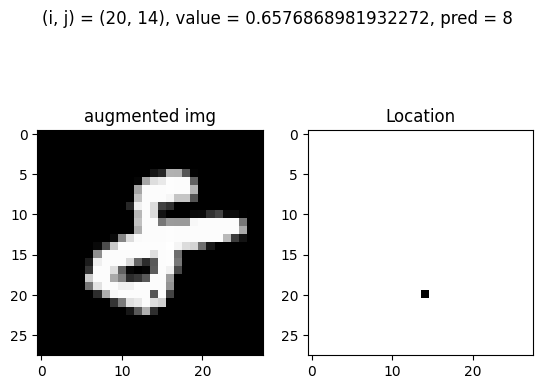

Train: At (i, j) = (20, 15) and value = -0.424212917883804, pred = 8, before_pred = 6, gt = 8


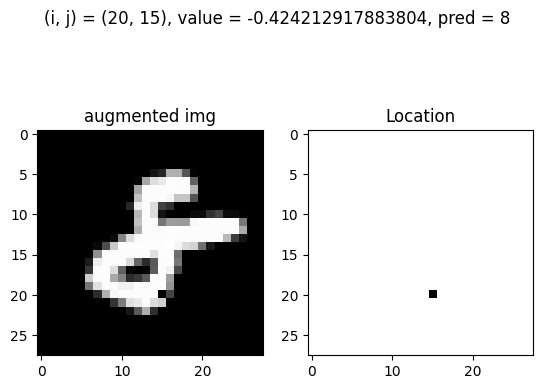

Train: At (i, j) = (20, 15) and value = -0.06357964585812692, pred = 8, before_pred = 6, gt = 8


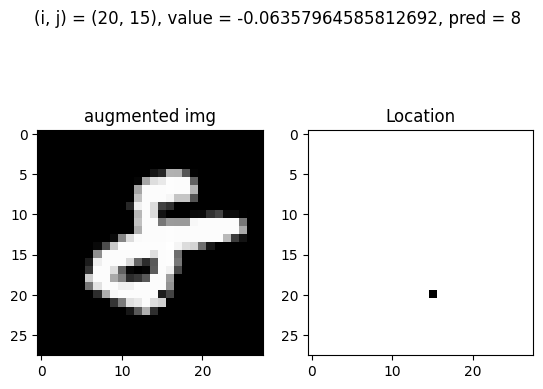

Train: At (i, j) = (20, 15) and value = 0.29705362616755016, pred = 8, before_pred = 6, gt = 8


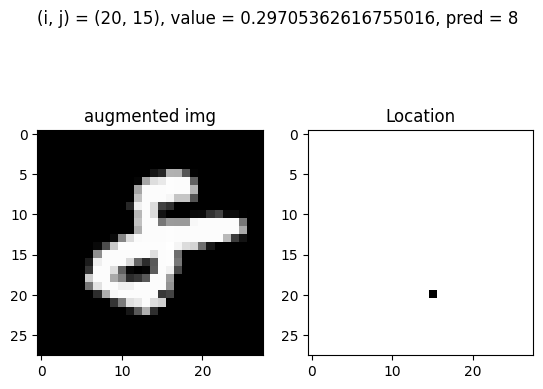

Train: At (i, j) = (20, 15) and value = 0.6576868981932272, pred = 8, before_pred = 6, gt = 8


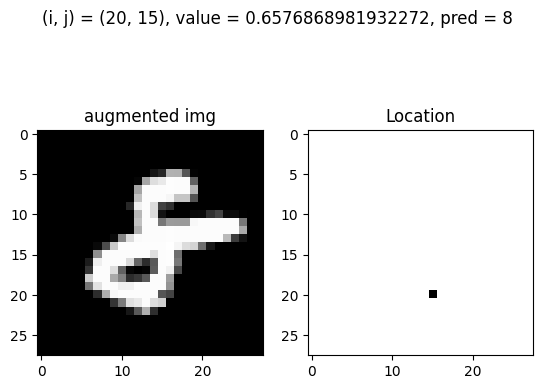

Train: At (i, j) = (21, 6) and value = 2.4608532583216127, pred = 8, before_pred = 6, gt = 8


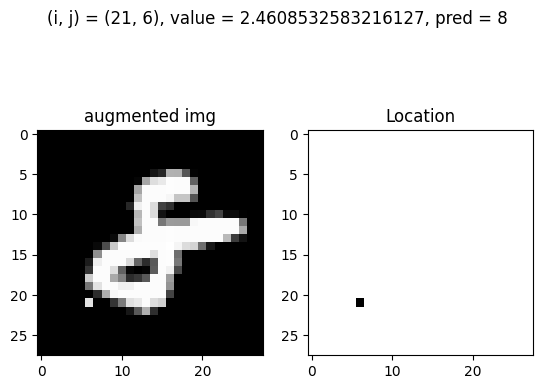

Train: At (i, j) = (21, 6) and value = 2.82148653034729, pred = 8, before_pred = 6, gt = 8


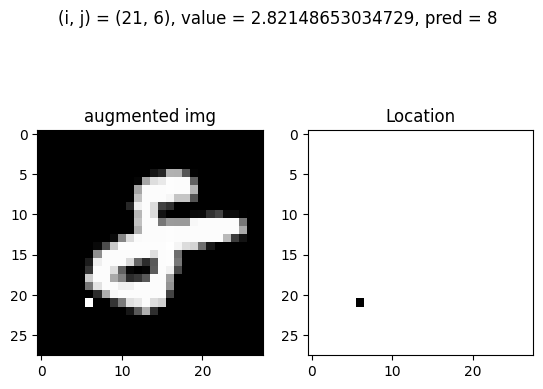

Train: At (i, j) = (21, 7) and value = 2.82148653034729, pred = 8, before_pred = 6, gt = 8


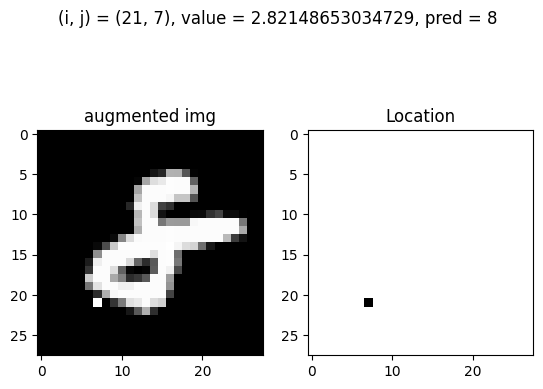

Train: At (i, j) = (21, 12) and value = -0.424212917883804, pred = 8, before_pred = 6, gt = 8


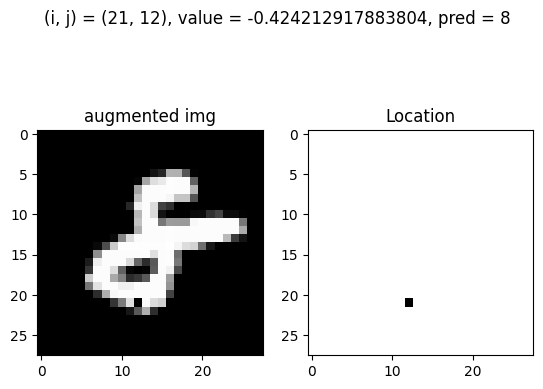

Train: At (i, j) = (21, 12) and value = -0.06357964585812692, pred = 8, before_pred = 6, gt = 8


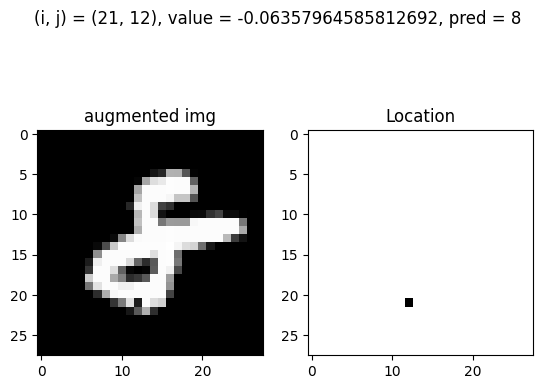

Train: At (i, j) = (21, 12) and value = 0.29705362616755016, pred = 8, before_pred = 6, gt = 8


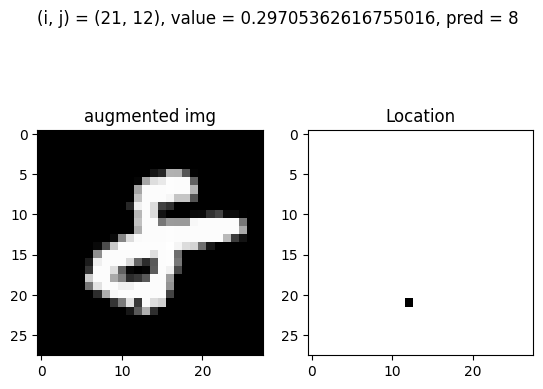

Train: At (i, j) = (22, 10) and value = 2.1002199862959356, pred = 8, before_pred = 6, gt = 8


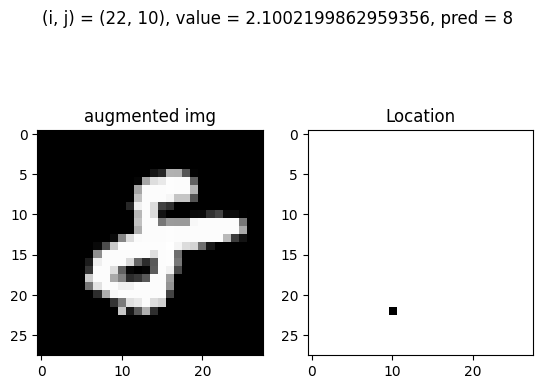

Train: At (i, j) = (22, 10) and value = 2.4608532583216127, pred = 8, before_pred = 6, gt = 8


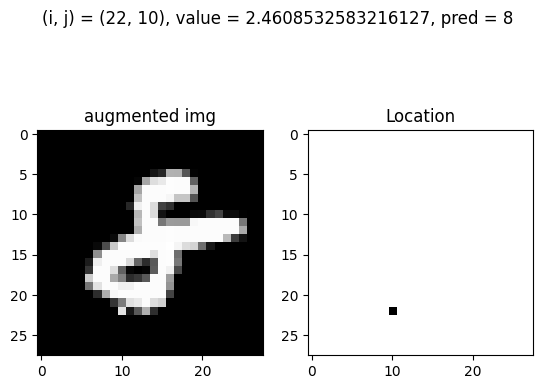

Train: At (i, j) = (22, 10) and value = 2.82148653034729, pred = 8, before_pred = 6, gt = 8


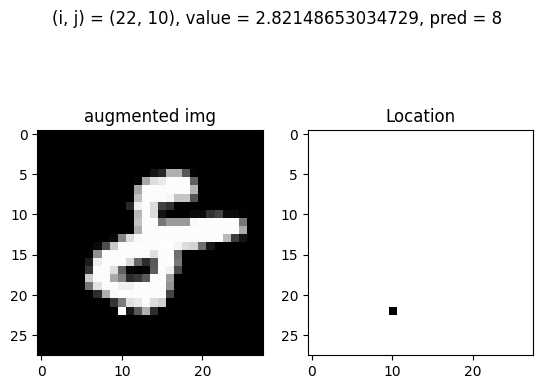

Train: At (i, j) = (22, 11) and value = 2.82148653034729, pred = 8, before_pred = 6, gt = 8


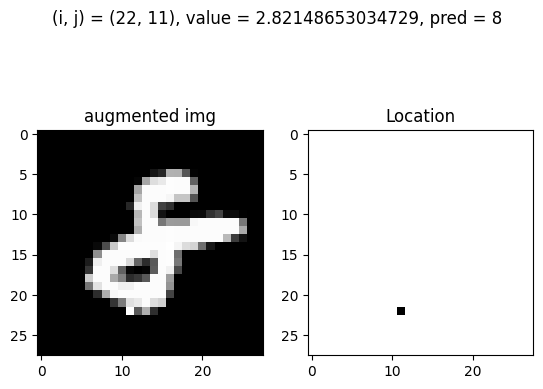

Train: At (i, j) = (22, 17) and value = 2.1002199862959356, pred = 8, before_pred = 6, gt = 8


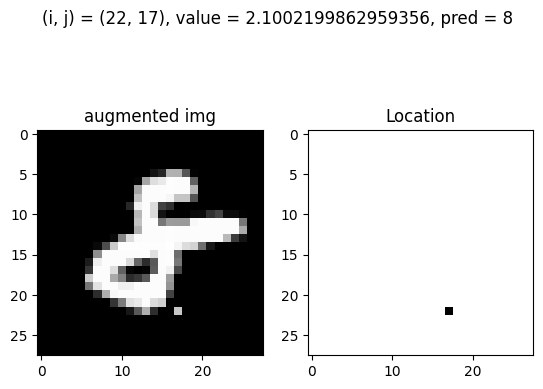

Train: At (i, j) = (22, 17) and value = 2.4608532583216127, pred = 8, before_pred = 6, gt = 8


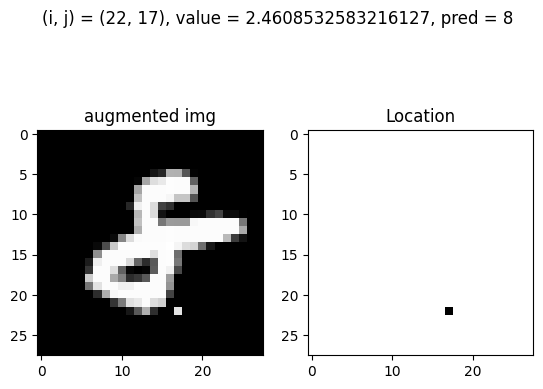

Train: At (i, j) = (22, 17) and value = 2.82148653034729, pred = 8, before_pred = 6, gt = 8


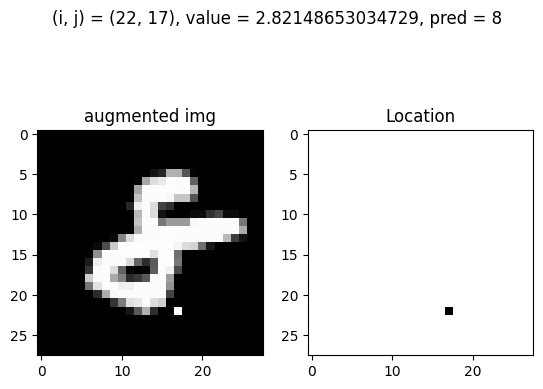

Train: At (i, j) = (23, 10) and value = 2.82148653034729, pred = 8, before_pred = 6, gt = 8


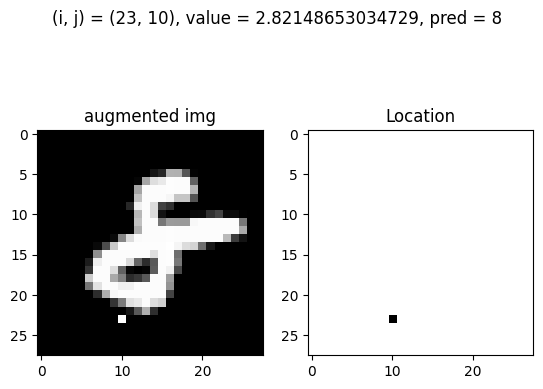

Train: At (i, j) = (23, 11) and value = 2.1002199862959356, pred = 8, before_pred = 6, gt = 8


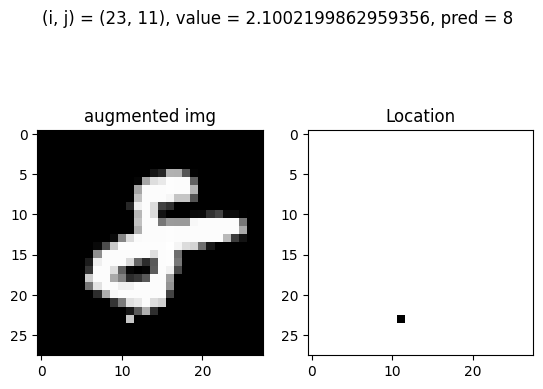

Train: At (i, j) = (23, 11) and value = 2.4608532583216127, pred = 8, before_pred = 6, gt = 8


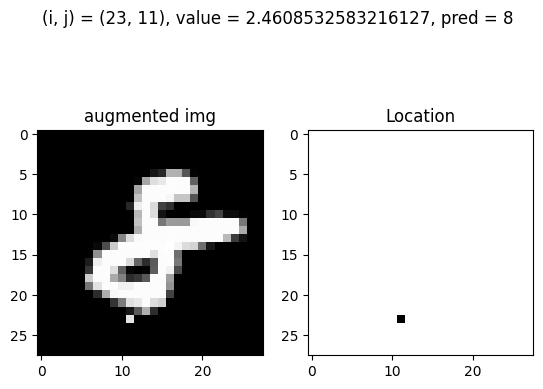

Train: At (i, j) = (23, 11) and value = 2.82148653034729, pred = 8, before_pred = 6, gt = 8


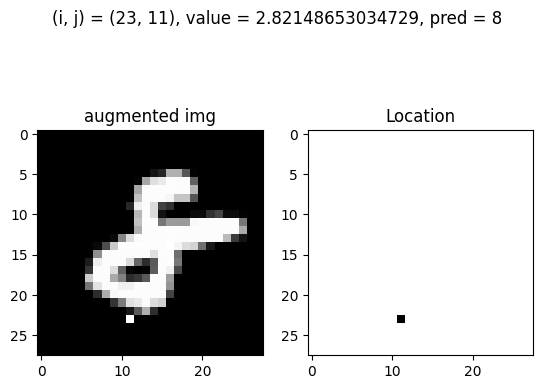

Train: At (i, j) = (23, 12) and value = 1.3789534422445815, pred = 8, before_pred = 6, gt = 8


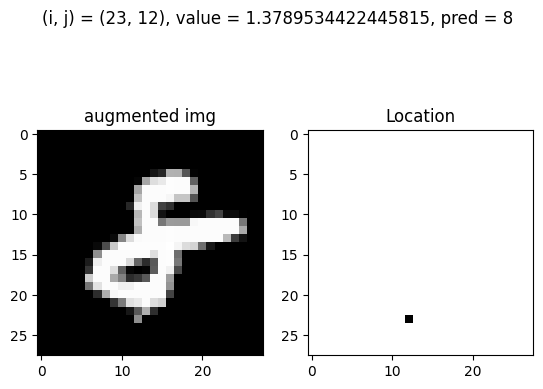

Train: At (i, j) = (23, 12) and value = 1.7395867142702586, pred = 8, before_pred = 6, gt = 8


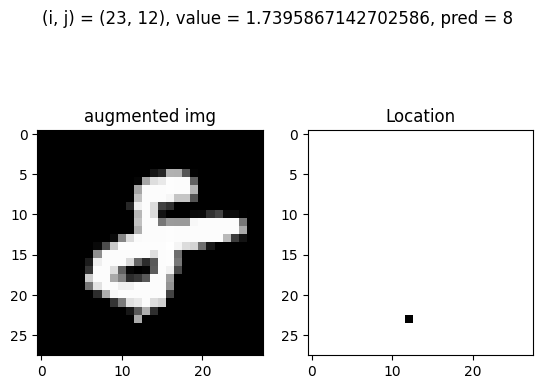

Train: At (i, j) = (23, 12) and value = 2.1002199862959356, pred = 8, before_pred = 6, gt = 8


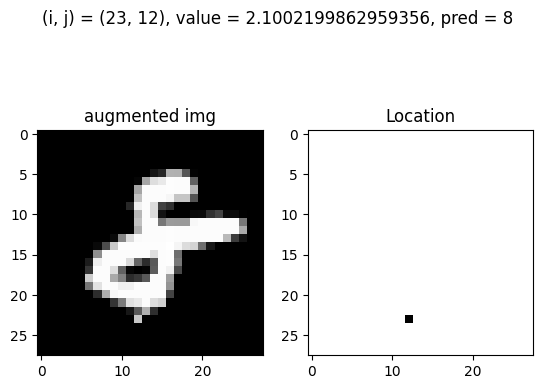

Train: At (i, j) = (23, 12) and value = 2.4608532583216127, pred = 8, before_pred = 6, gt = 8


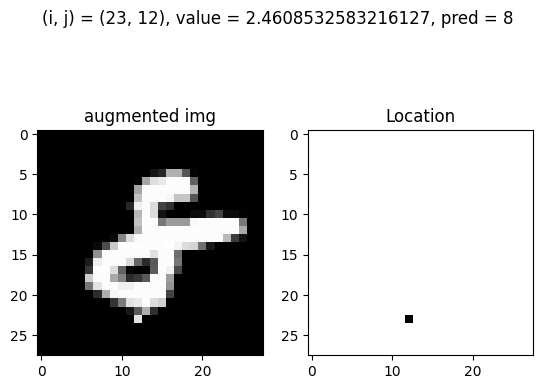

Train: At (i, j) = (23, 12) and value = 2.82148653034729, pred = 8, before_pred = 6, gt = 8


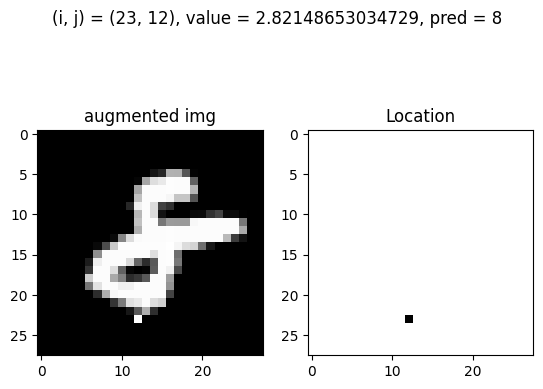

Train: At (i, j) = (23, 13) and value = 1.0183201702189044, pred = 8, before_pred = 6, gt = 8


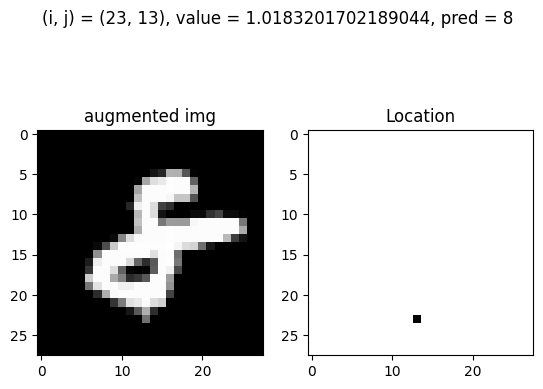

Train: At (i, j) = (23, 13) and value = 1.3789534422445815, pred = 8, before_pred = 6, gt = 8


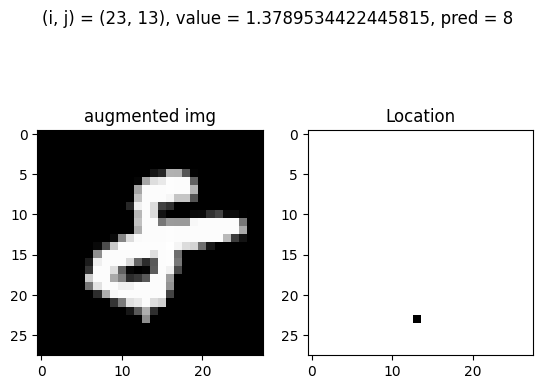

Train: At (i, j) = (23, 13) and value = 1.7395867142702586, pred = 8, before_pred = 6, gt = 8


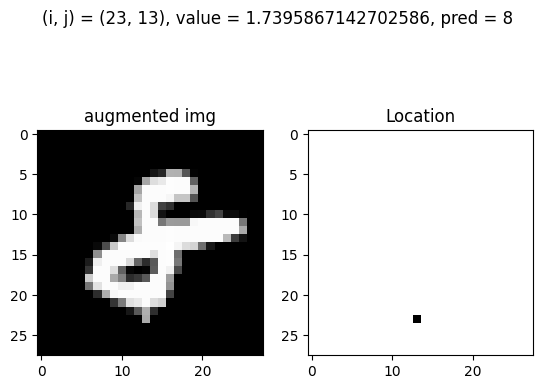

Train: At (i, j) = (23, 13) and value = 2.1002199862959356, pred = 8, before_pred = 6, gt = 8


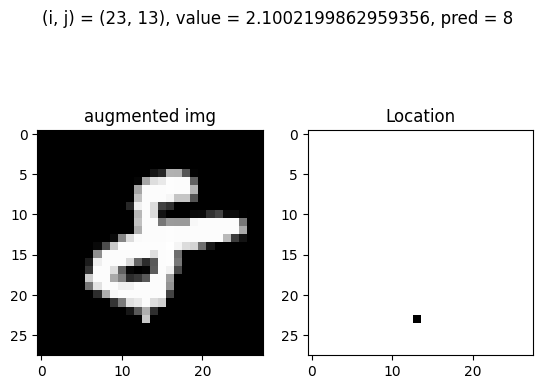

Train: At (i, j) = (23, 13) and value = 2.4608532583216127, pred = 8, before_pred = 6, gt = 8


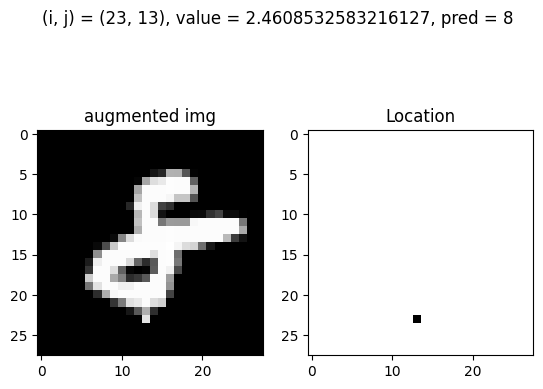

Train: At (i, j) = (23, 13) and value = 2.82148653034729, pred = 8, before_pred = 6, gt = 8


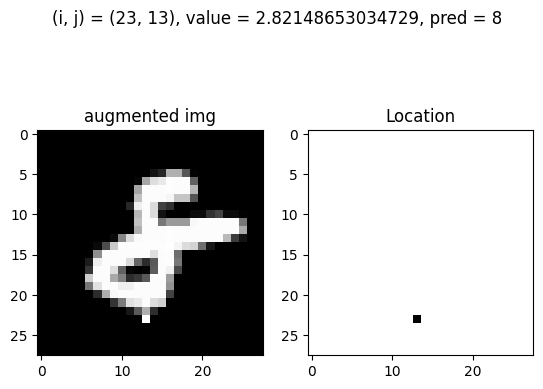

Train: At (i, j) = (23, 14) and value = 1.7395867142702586, pred = 8, before_pred = 6, gt = 8


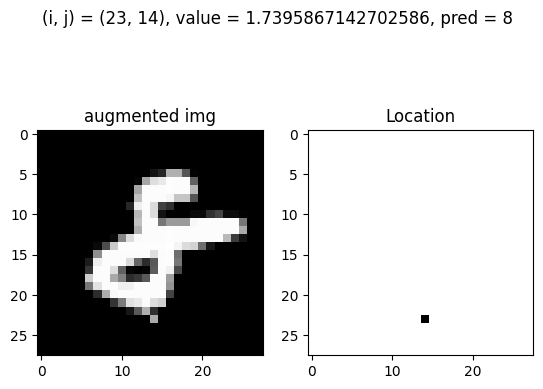

Train: At (i, j) = (23, 14) and value = 2.1002199862959356, pred = 8, before_pred = 6, gt = 8


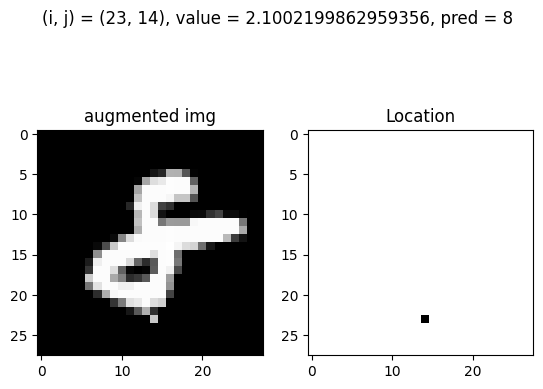

Train: At (i, j) = (23, 14) and value = 2.4608532583216127, pred = 8, before_pred = 6, gt = 8


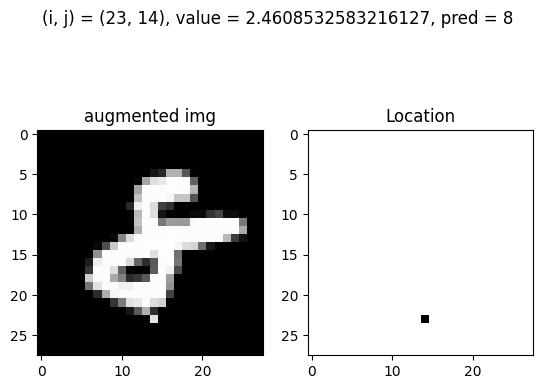

Train: At (i, j) = (23, 14) and value = 2.82148653034729, pred = 8, before_pred = 6, gt = 8


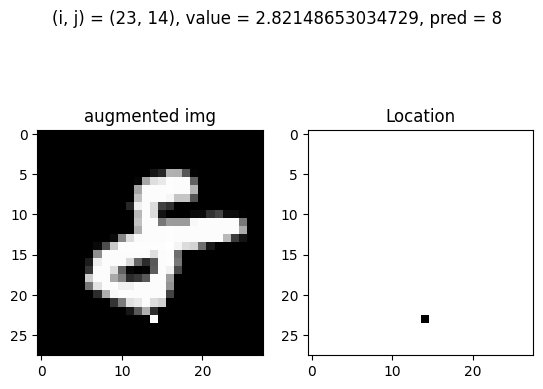

Train: At (i, j) = (23, 15) and value = 2.82148653034729, pred = 8, before_pred = 6, gt = 8


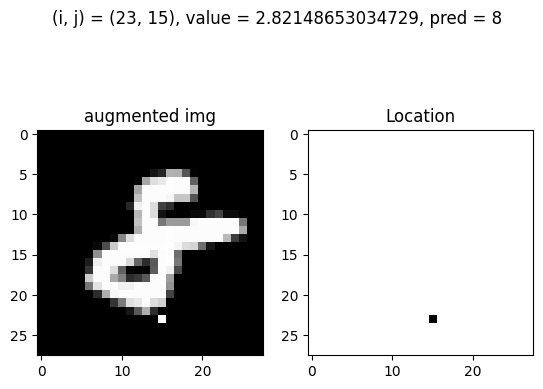

Train: At (i, j) = (23, 16) and value = 1.7395867142702586, pred = 8, before_pred = 6, gt = 8


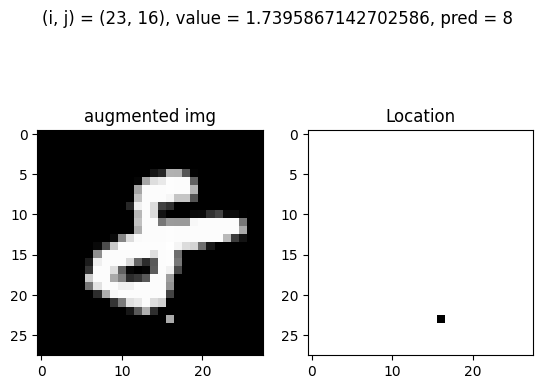

Train: At (i, j) = (23, 16) and value = 2.1002199862959356, pred = 8, before_pred = 6, gt = 8


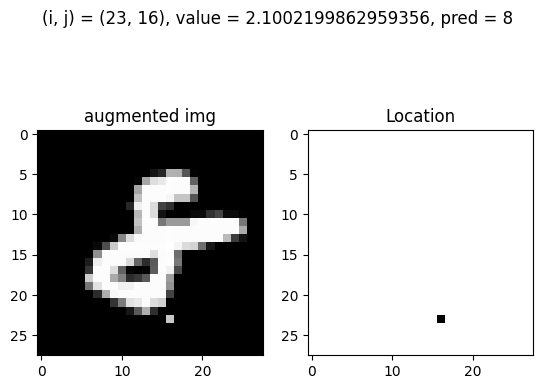

Train: At (i, j) = (23, 16) and value = 2.4608532583216127, pred = 8, before_pred = 6, gt = 8


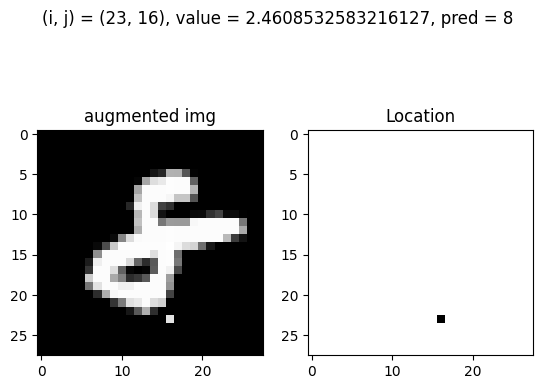

Train: At (i, j) = (23, 16) and value = 2.82148653034729, pred = 8, before_pred = 6, gt = 8


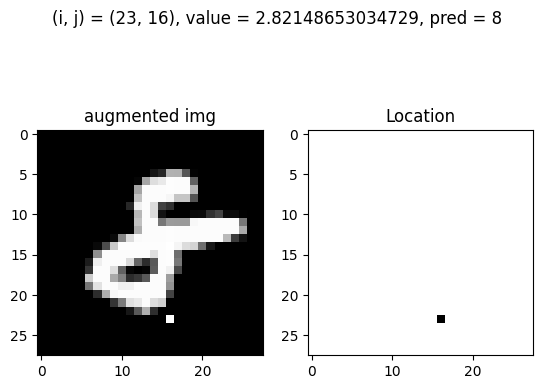

Train: At (i, j) = (23, 17) and value = 1.7395867142702586, pred = 8, before_pred = 6, gt = 8


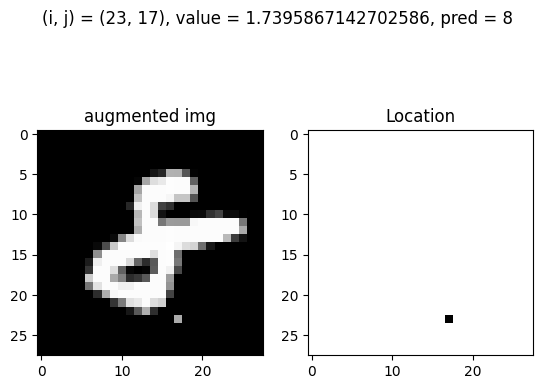

Train: At (i, j) = (23, 17) and value = 2.1002199862959356, pred = 8, before_pred = 6, gt = 8


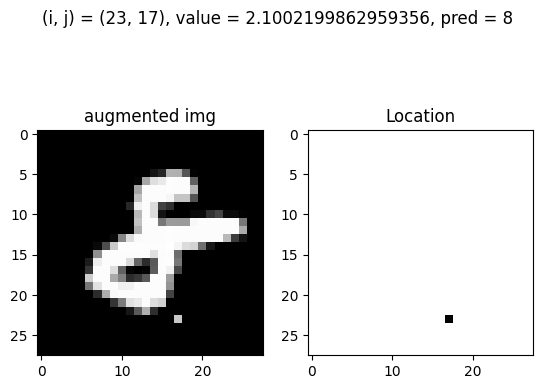

Train: At (i, j) = (23, 17) and value = 2.4608532583216127, pred = 8, before_pred = 6, gt = 8


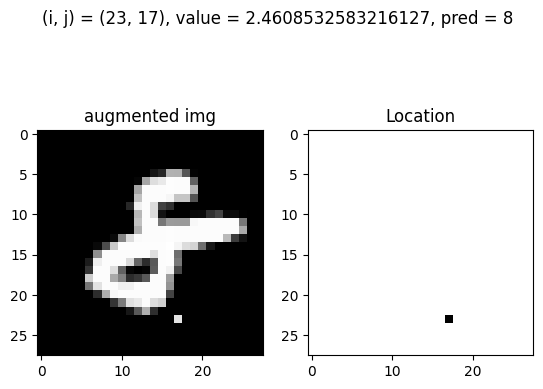

Train: At (i, j) = (23, 17) and value = 2.82148653034729, pred = 8, before_pred = 6, gt = 8


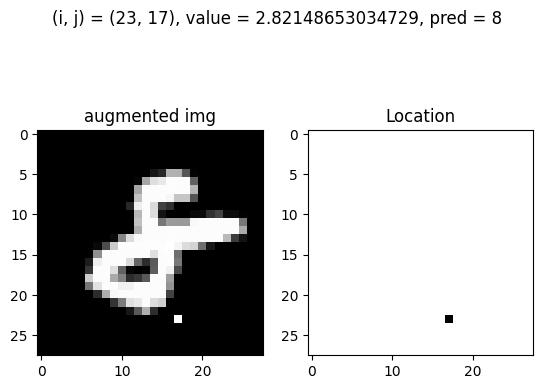

Train: At (i, j) = (24, 11) and value = 2.4608532583216127, pred = 8, before_pred = 6, gt = 8


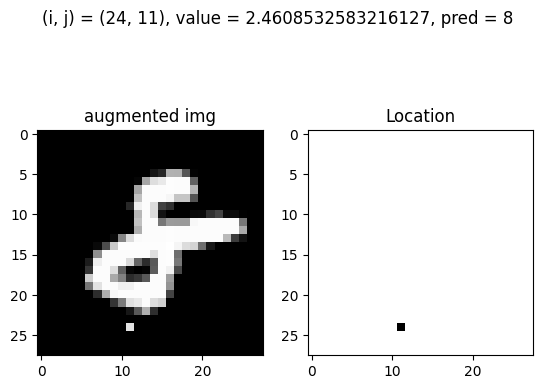

Train: At (i, j) = (24, 11) and value = 2.82148653034729, pred = 8, before_pred = 6, gt = 8


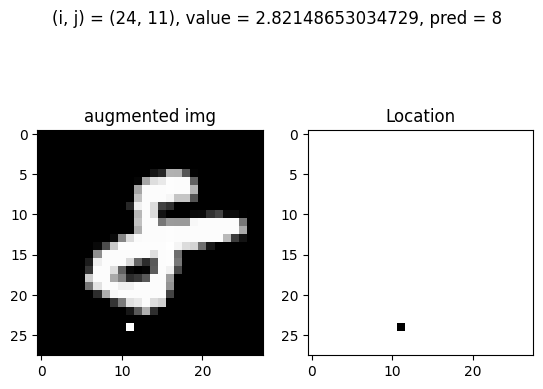

Train: At (i, j) = (24, 12) and value = 1.3789534422445815, pred = 8, before_pred = 6, gt = 8


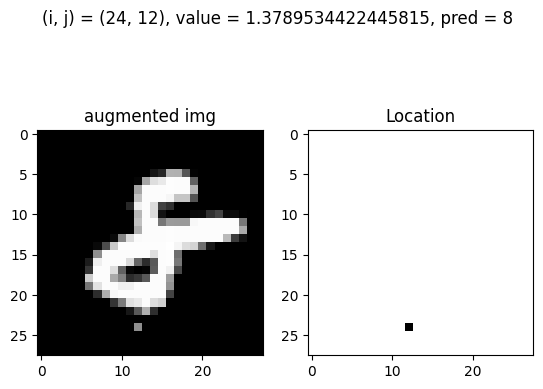

Train: At (i, j) = (24, 12) and value = 1.7395867142702586, pred = 8, before_pred = 6, gt = 8


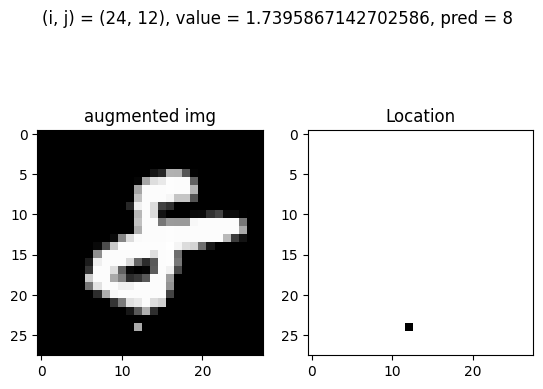

Train: At (i, j) = (24, 12) and value = 2.1002199862959356, pred = 8, before_pred = 6, gt = 8


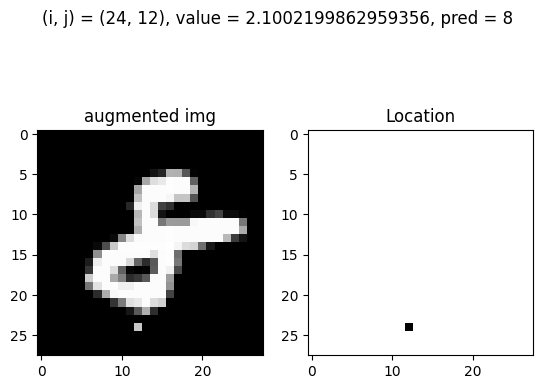

Train: At (i, j) = (24, 12) and value = 2.4608532583216127, pred = 8, before_pred = 6, gt = 8


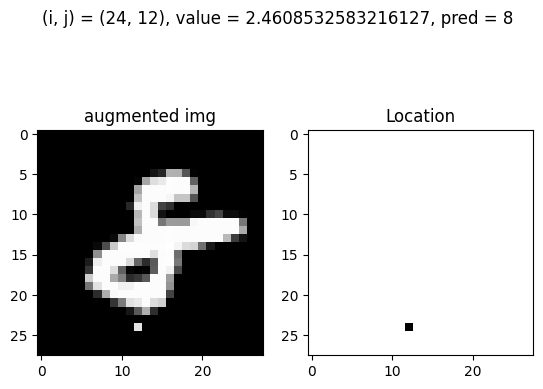

Train: At (i, j) = (24, 12) and value = 2.82148653034729, pred = 8, before_pred = 6, gt = 8


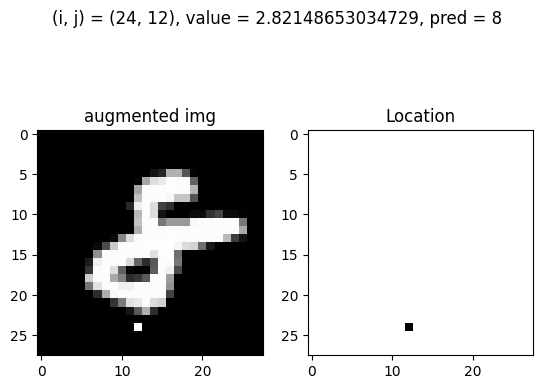

Train: At (i, j) = (24, 13) and value = 1.3789534422445815, pred = 8, before_pred = 6, gt = 8


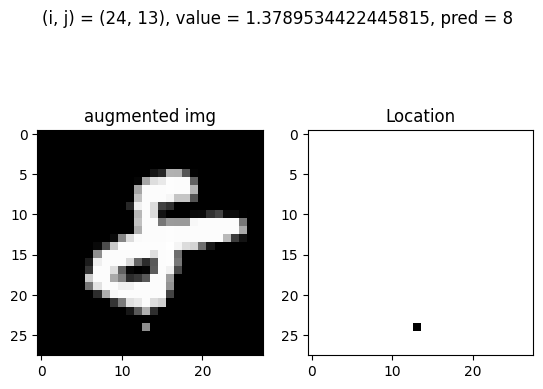

Train: At (i, j) = (24, 13) and value = 1.7395867142702586, pred = 8, before_pred = 6, gt = 8


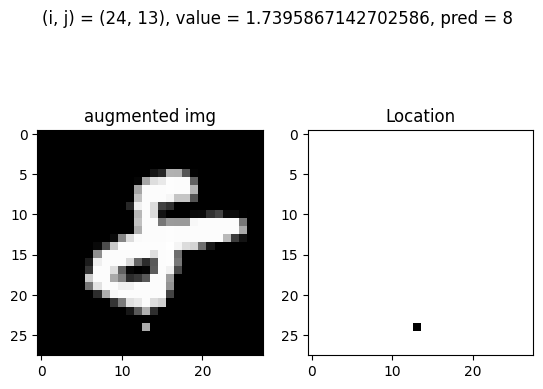

Train: At (i, j) = (24, 13) and value = 2.1002199862959356, pred = 8, before_pred = 6, gt = 8


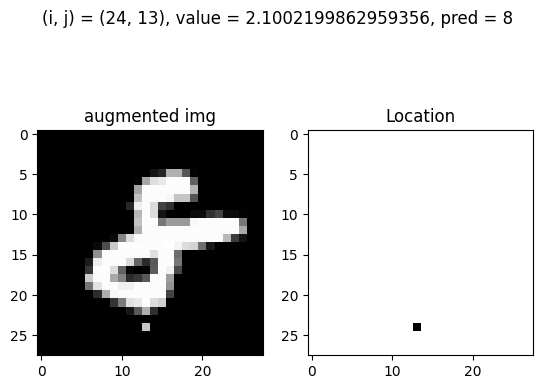

Train: At (i, j) = (24, 13) and value = 2.4608532583216127, pred = 8, before_pred = 6, gt = 8


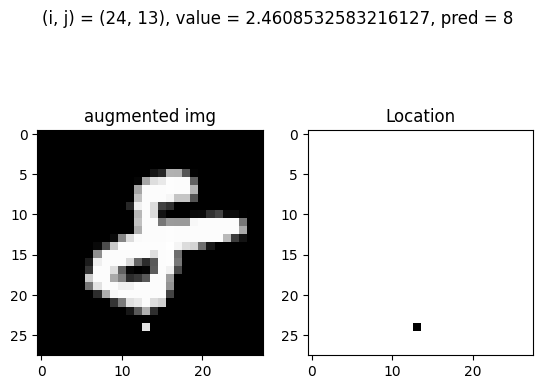

Train: At (i, j) = (24, 13) and value = 2.82148653034729, pred = 8, before_pred = 6, gt = 8


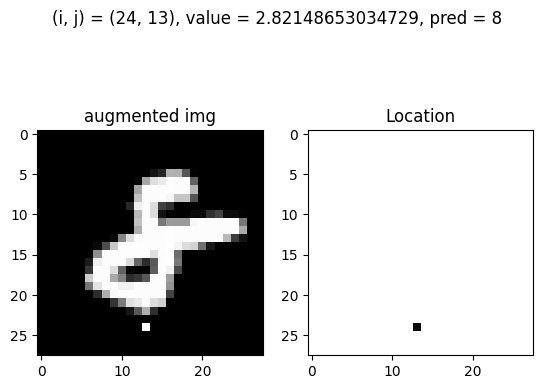

Train: At (i, j) = (24, 15) and value = 2.4608532583216127, pred = 8, before_pred = 6, gt = 8


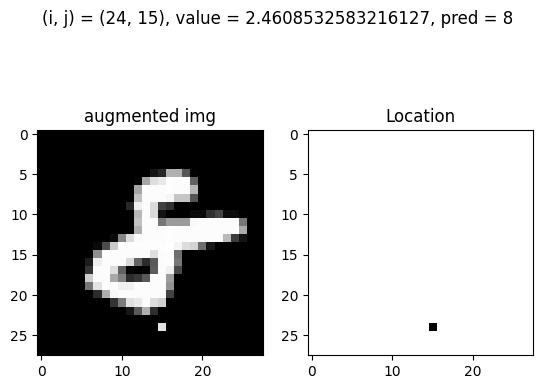

Train: At (i, j) = (24, 15) and value = 2.82148653034729, pred = 8, before_pred = 6, gt = 8


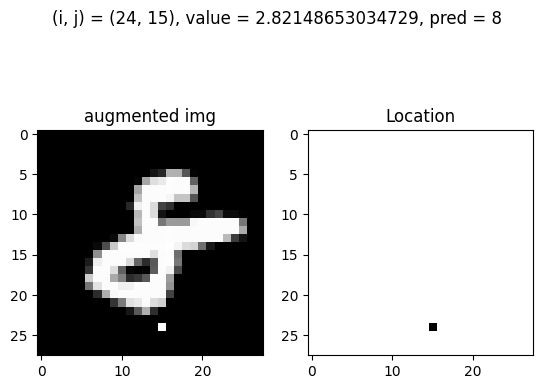

7840 done
7840 done
7840 done
7840 done
7840 done
7840 done
7840 done
7840 done
Train: At (i, j) = (6, 14) and value = 2.82148653034729, pred = 9, before_pred = 4, gt = 4


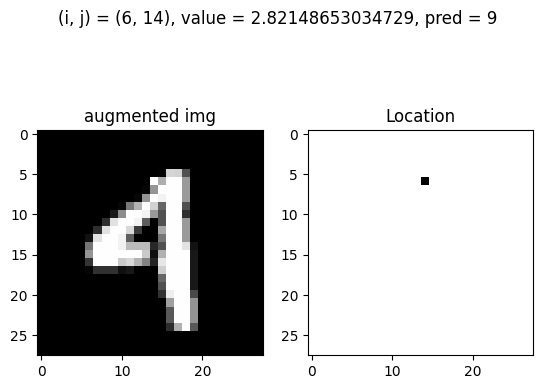

Train: At (i, j) = (7, 12) and value = 2.4608532583216127, pred = 9, before_pred = 4, gt = 4


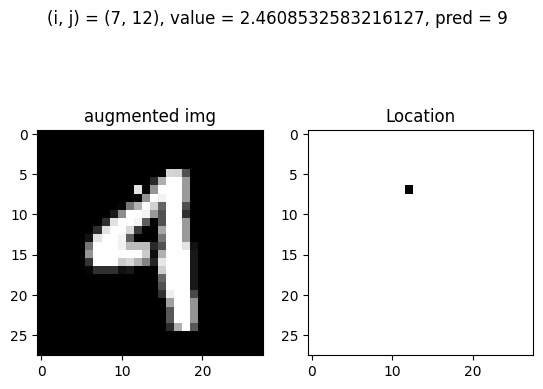

Train: At (i, j) = (7, 12) and value = 2.82148653034729, pred = 9, before_pred = 4, gt = 4


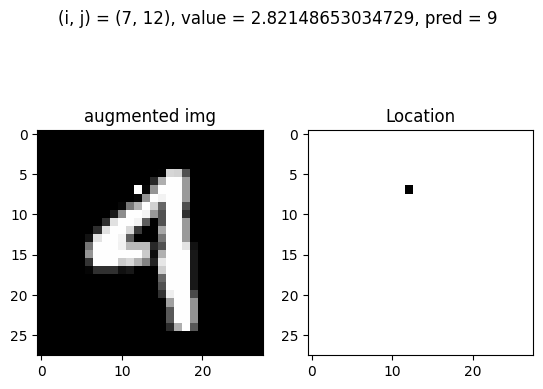

Train: At (i, j) = (7, 13) and value = 2.1002199862959356, pred = 9, before_pred = 4, gt = 4


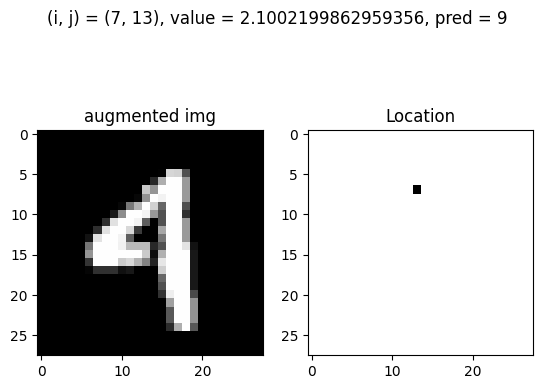

Train: At (i, j) = (7, 13) and value = 2.4608532583216127, pred = 9, before_pred = 4, gt = 4


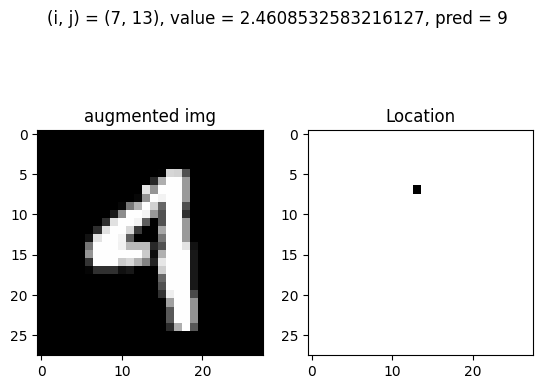

Train: At (i, j) = (7, 13) and value = 2.82148653034729, pred = 9, before_pred = 4, gt = 4


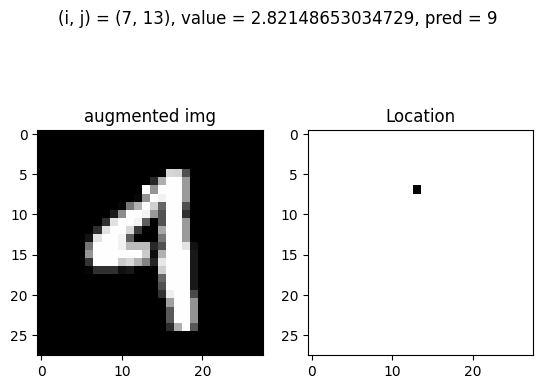

Train: At (i, j) = (8, 12) and value = 2.1002199862959356, pred = 9, before_pred = 4, gt = 4


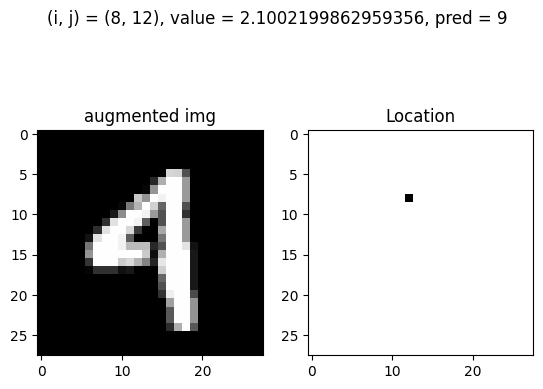

Train: At (i, j) = (8, 12) and value = 2.4608532583216127, pred = 9, before_pred = 4, gt = 4


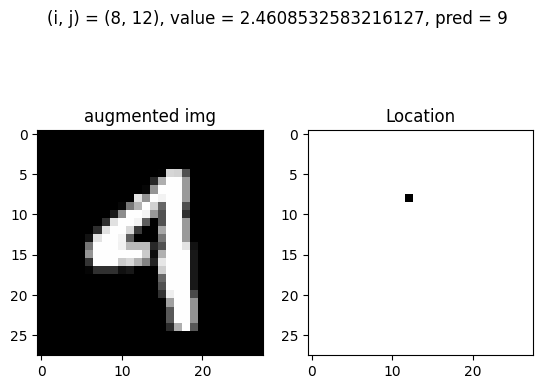

Train: At (i, j) = (8, 12) and value = 2.82148653034729, pred = 9, before_pred = 4, gt = 4


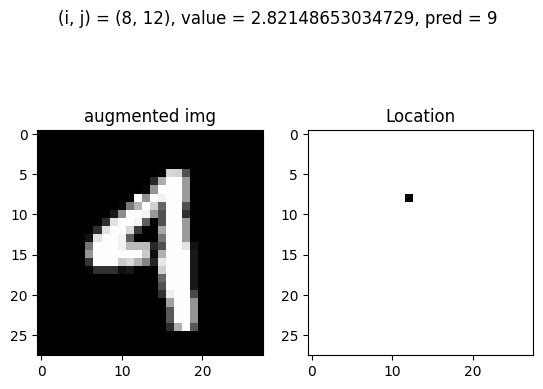

Train: At (i, j) = (9, 15) and value = 2.82148653034729, pred = 9, before_pred = 4, gt = 4


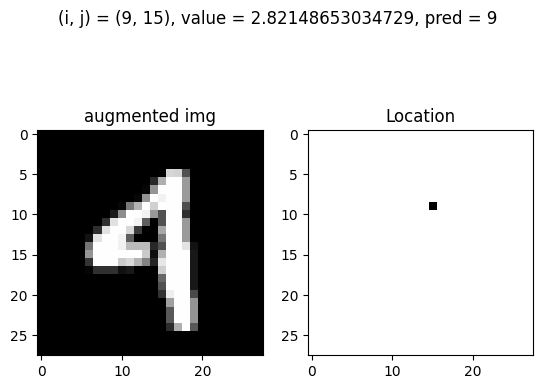

Train: At (i, j) = (15, 11) and value = -0.424212917883804, pred = 9, before_pred = 4, gt = 4


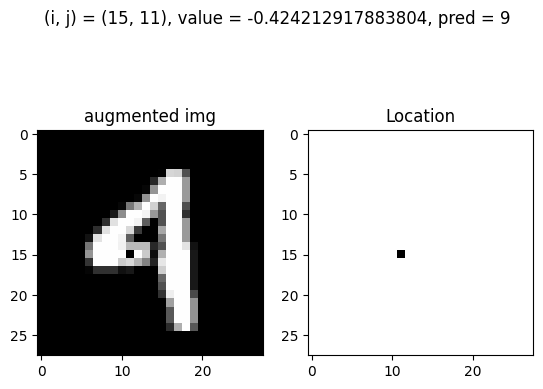

Train: At (i, j) = (15, 11) and value = -0.06357964585812692, pred = 9, before_pred = 4, gt = 4


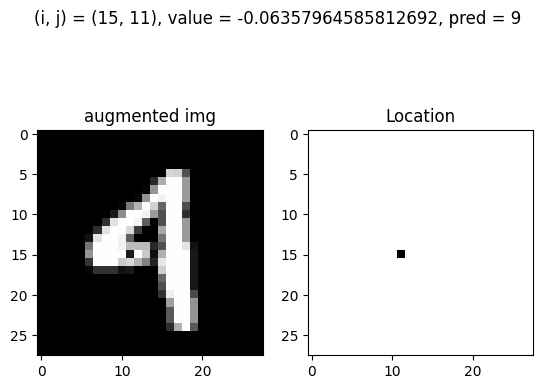

Train: At (i, j) = (15, 12) and value = -0.424212917883804, pred = 9, before_pred = 4, gt = 4


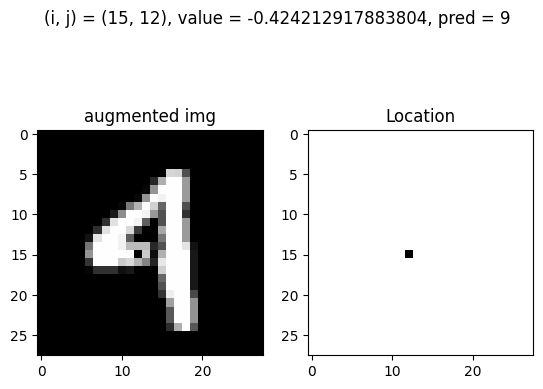

7840 done
7840 done
7840 done
7840 done
7840 done
7840 done
Train: At (i, j) = (7, 14) and value = 2.1002199862959356, pred = 9, before_pred = 4, gt = 7


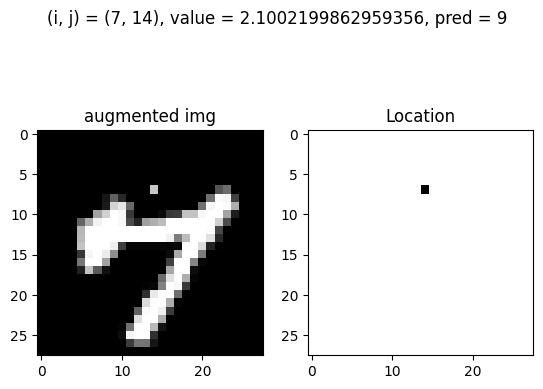

Train: At (i, j) = (7, 14) and value = 2.4608532583216127, pred = 9, before_pred = 4, gt = 7


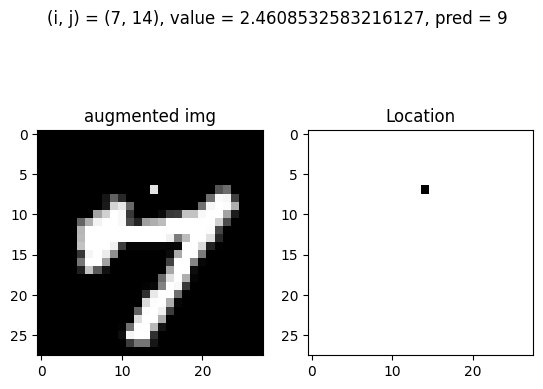

Train: At (i, j) = (7, 14) and value = 2.82148653034729, pred = 9, before_pred = 4, gt = 7


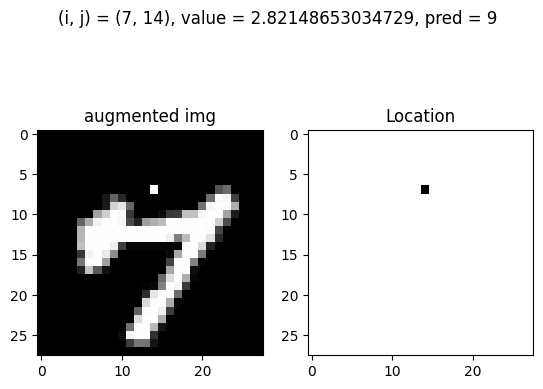

Train: At (i, j) = (7, 15) and value = 2.1002199862959356, pred = 9, before_pred = 4, gt = 7


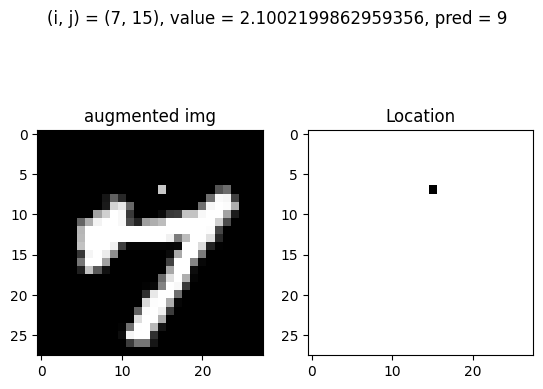

Train: At (i, j) = (7, 15) and value = 2.4608532583216127, pred = 9, before_pred = 4, gt = 7


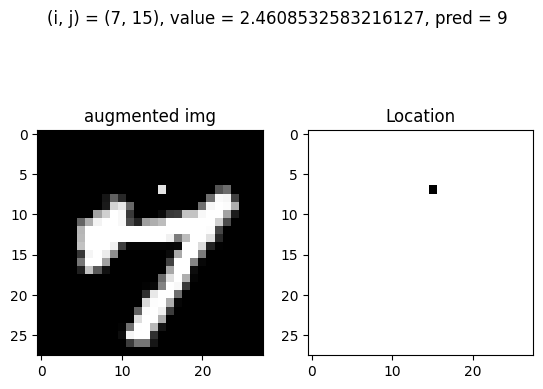

Train: At (i, j) = (7, 15) and value = 2.82148653034729, pred = 9, before_pred = 4, gt = 7


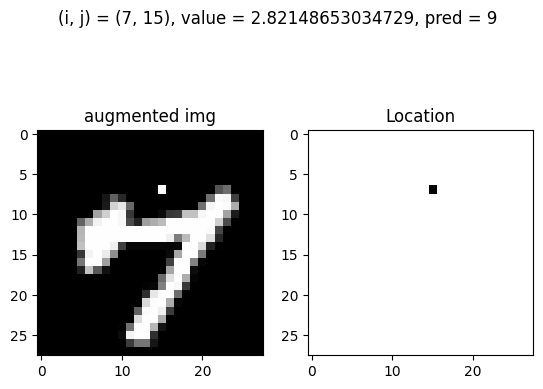

Train: At (i, j) = (7, 16) and value = 2.1002199862959356, pred = 9, before_pred = 4, gt = 7


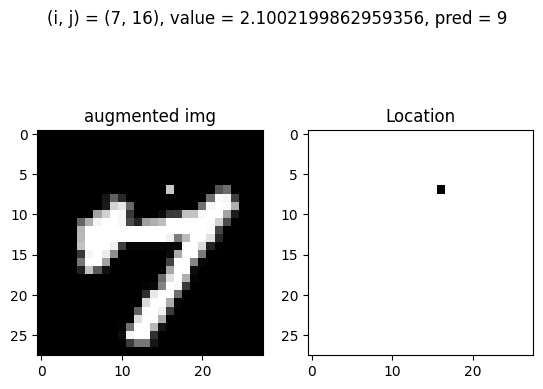

Train: At (i, j) = (7, 16) and value = 2.4608532583216127, pred = 9, before_pred = 4, gt = 7


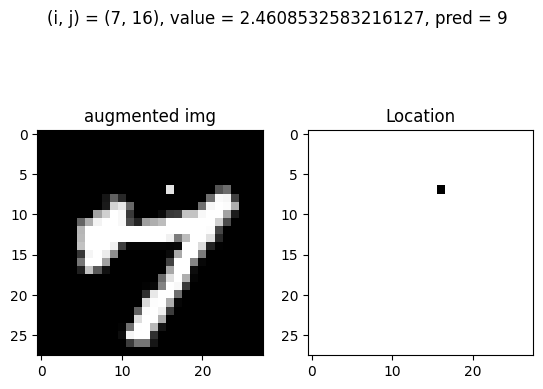

Train: At (i, j) = (7, 16) and value = 2.82148653034729, pred = 9, before_pred = 4, gt = 7


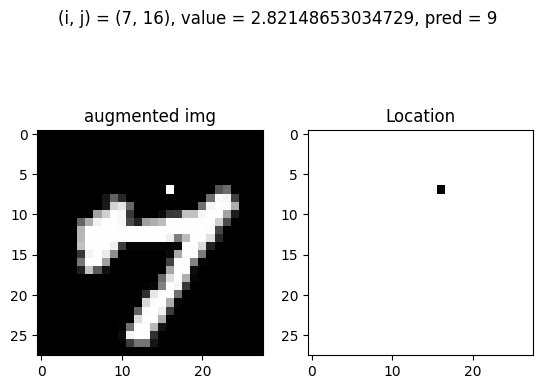

Train: At (i, j) = (7, 17) and value = 2.4608532583216127, pred = 9, before_pred = 4, gt = 7


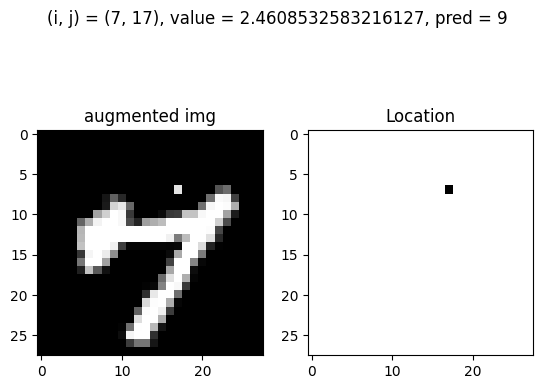

Train: At (i, j) = (7, 17) and value = 2.82148653034729, pred = 9, before_pred = 4, gt = 7


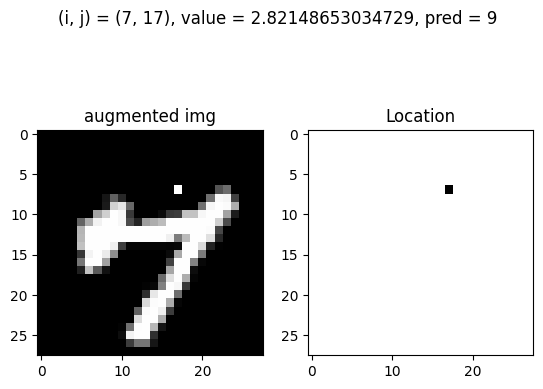

Train: At (i, j) = (8, 12) and value = 2.82148653034729, pred = 9, before_pred = 4, gt = 7


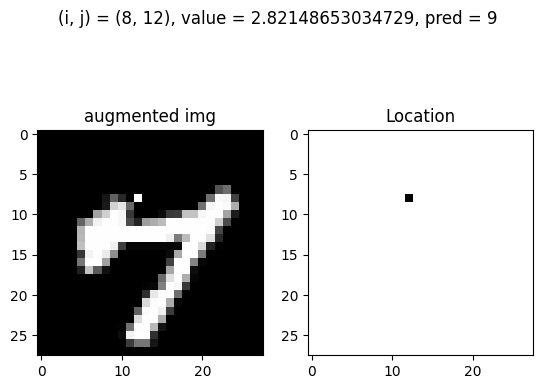

Train: At (i, j) = (8, 13) and value = 2.4608532583216127, pred = 9, before_pred = 4, gt = 7


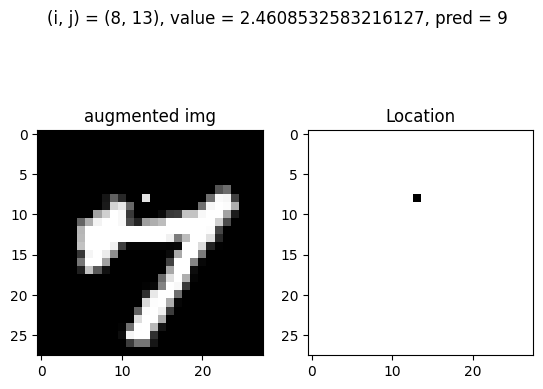

Train: At (i, j) = (8, 13) and value = 2.82148653034729, pred = 9, before_pred = 4, gt = 7


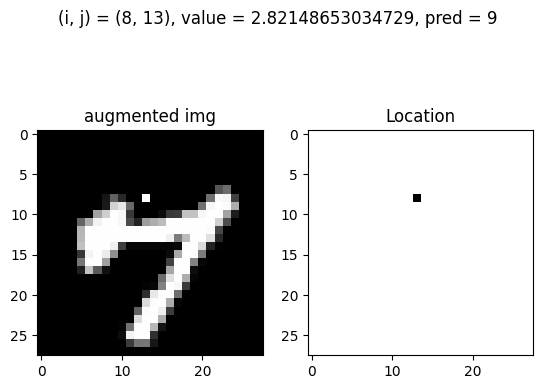

Train: At (i, j) = (8, 14) and value = 2.82148653034729, pred = 9, before_pred = 4, gt = 7


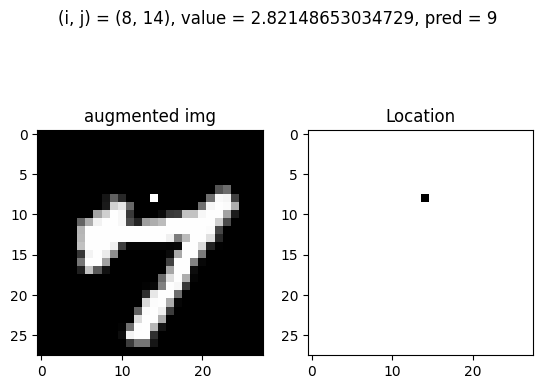

Train: At (i, j) = (8, 15) and value = 2.4608532583216127, pred = 9, before_pred = 4, gt = 7


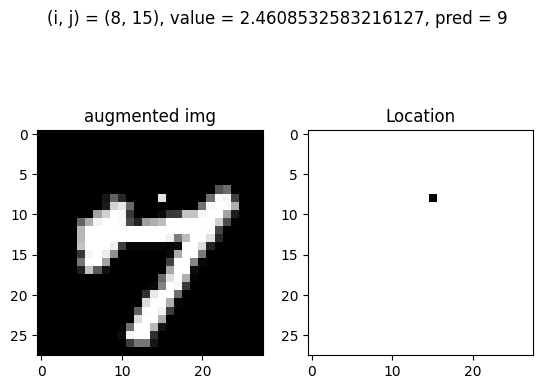

Train: At (i, j) = (8, 15) and value = 2.82148653034729, pred = 9, before_pred = 4, gt = 7


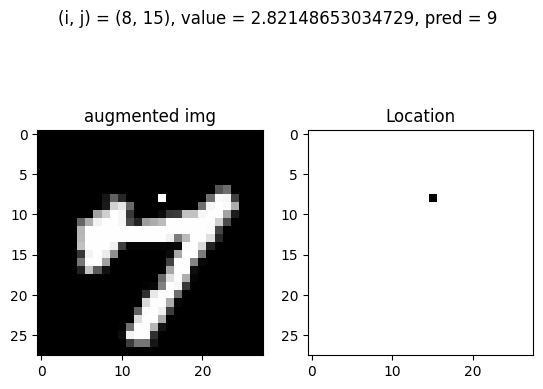

Train: At (i, j) = (8, 16) and value = 2.4608532583216127, pred = 9, before_pred = 4, gt = 7


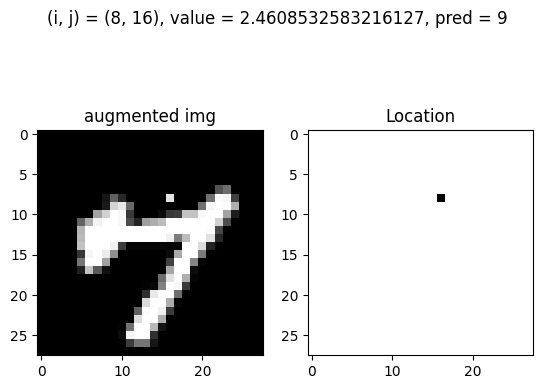

Train: At (i, j) = (8, 16) and value = 2.82148653034729, pred = 9, before_pred = 4, gt = 7


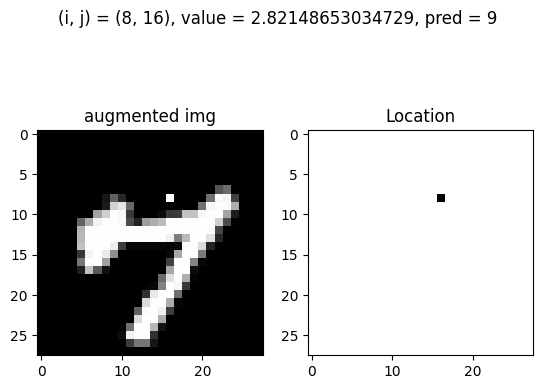

Train: At (i, j) = (8, 17) and value = 2.82148653034729, pred = 9, before_pred = 4, gt = 7


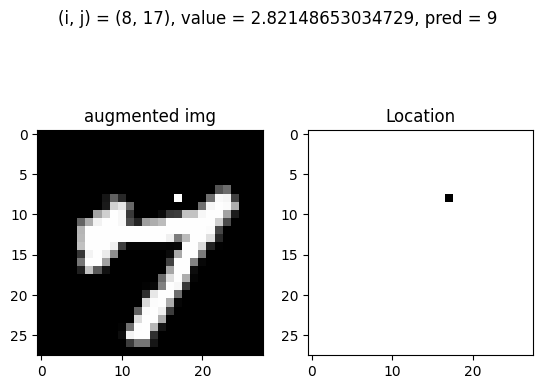

Train: At (i, j) = (8, 18) and value = 2.82148653034729, pred = 9, before_pred = 4, gt = 7


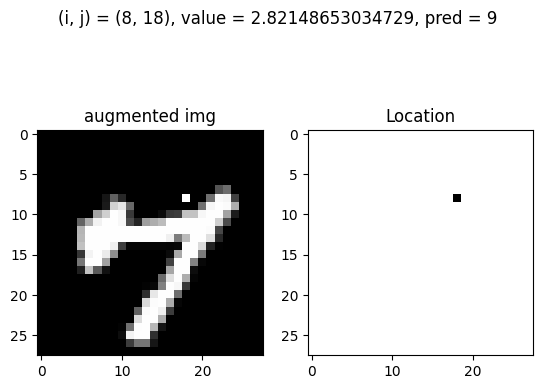

Train: At (i, j) = (9, 15) and value = 2.4608532583216127, pred = 9, before_pred = 4, gt = 7


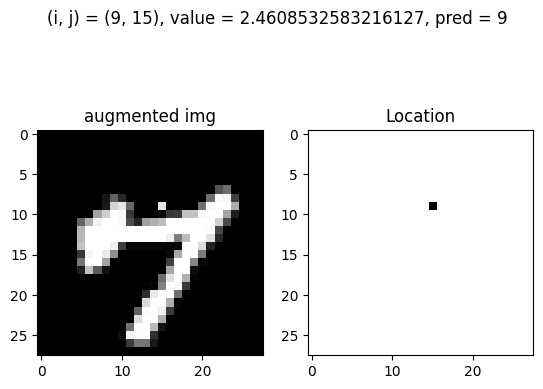

Train: At (i, j) = (9, 15) and value = 2.82148653034729, pred = 9, before_pred = 4, gt = 7


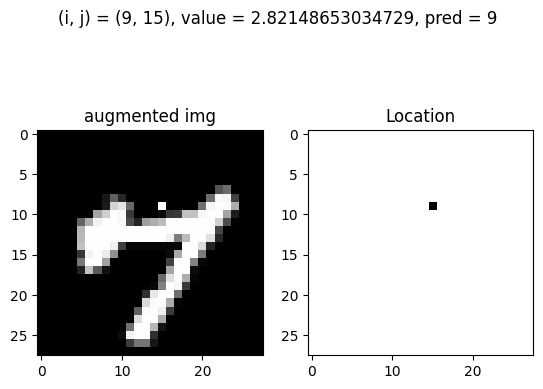

7840 done
7840 done
7840 done
Train: At (i, j) = (10, 8) and value = 2.82148653034729, pred = 7, before_pred = 2, gt = 2


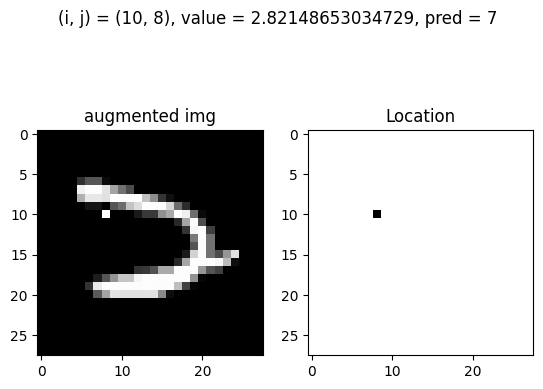

Train: At (i, j) = (11, 11) and value = 2.82148653034729, pred = 7, before_pred = 2, gt = 2


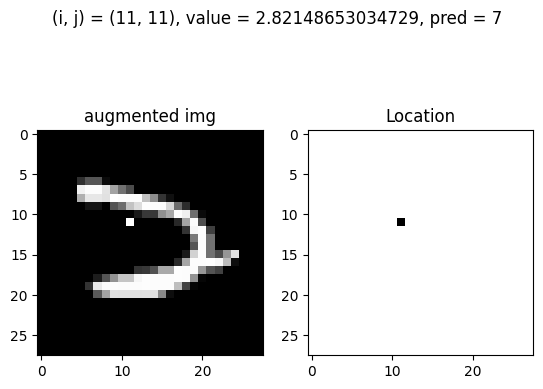

Train: At (i, j) = (11, 12) and value = 2.4608532583216127, pred = 7, before_pred = 2, gt = 2


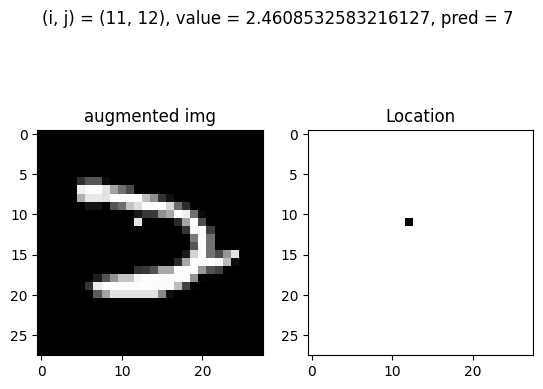

Train: At (i, j) = (11, 12) and value = 2.82148653034729, pred = 7, before_pred = 2, gt = 2


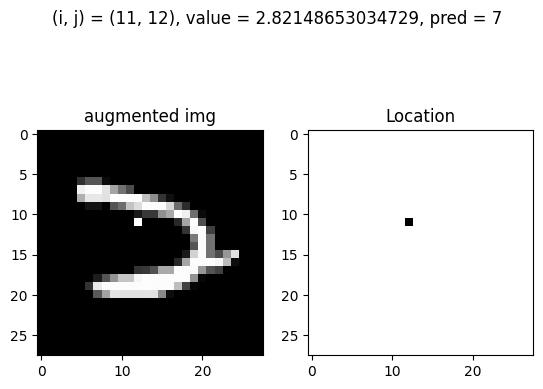

Train: At (i, j) = (12, 8) and value = 2.82148653034729, pred = 7, before_pred = 2, gt = 2


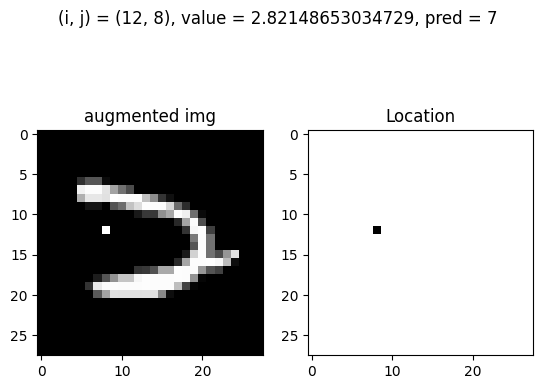

Train: At (i, j) = (15, 17) and value = 2.4608532583216127, pred = 7, before_pred = 2, gt = 2


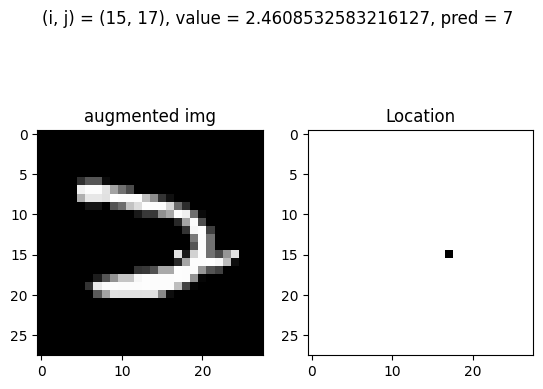

Train: At (i, j) = (15, 17) and value = 2.82148653034729, pred = 7, before_pred = 2, gt = 2


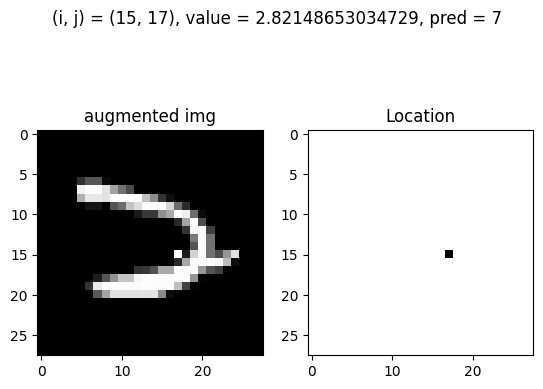

Train: At (i, j) = (19, 9) and value = -0.424212917883804, pred = 7, before_pred = 2, gt = 2


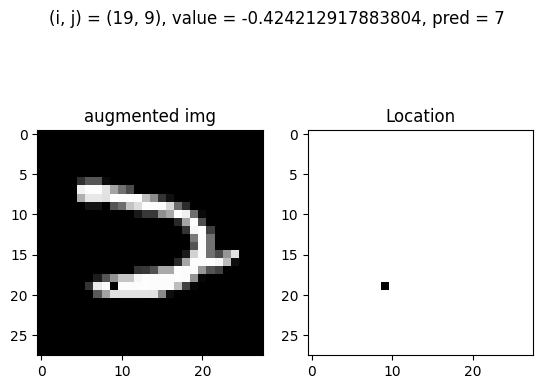

Train: At (i, j) = (19, 9) and value = -0.06357964585812692, pred = 7, before_pred = 2, gt = 2


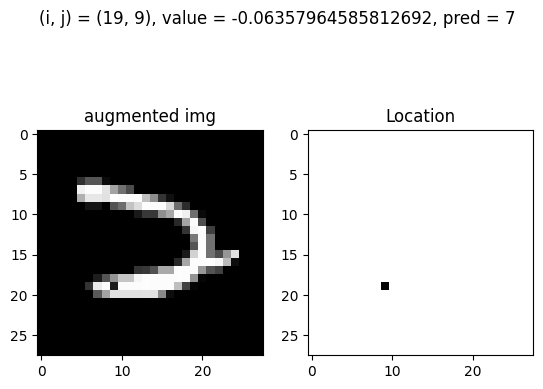

Train: At (i, j) = (19, 10) and value = -0.424212917883804, pred = 7, before_pred = 2, gt = 2


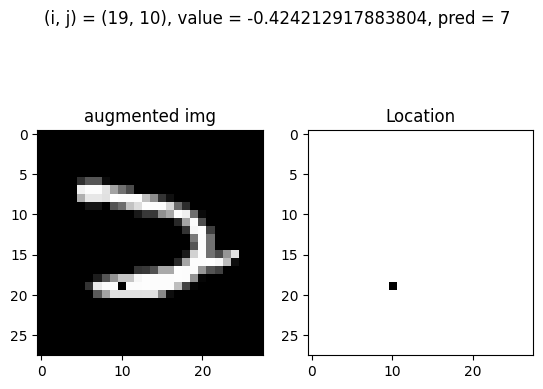

Train: At (i, j) = (19, 10) and value = -0.06357964585812692, pred = 7, before_pred = 2, gt = 2


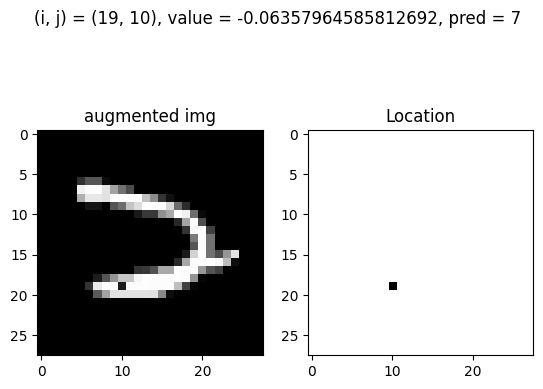

Train: At (i, j) = (19, 11) and value = -0.424212917883804, pred = 7, before_pred = 2, gt = 2


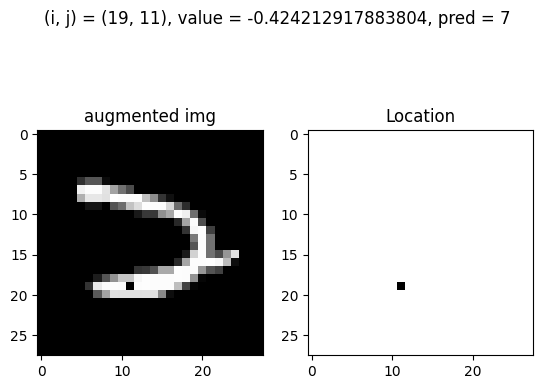

Train: At (i, j) = (19, 11) and value = -0.06357964585812692, pred = 7, before_pred = 2, gt = 2


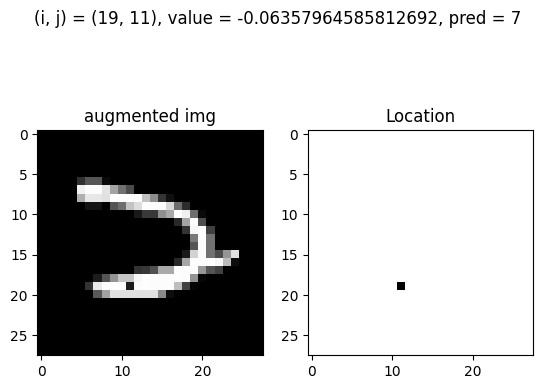

Train: At (i, j) = (20, 9) and value = -0.424212917883804, pred = 7, before_pred = 2, gt = 2


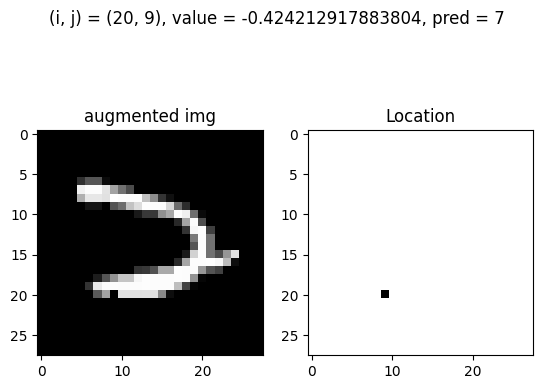

Train: At (i, j) = (25, 14) and value = 2.82148653034729, pred = 7, before_pred = 2, gt = 2


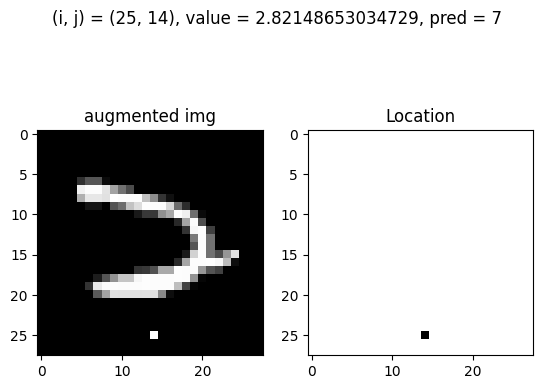

7840 done
7840 done
7840 done
7840 done
7840 done
7840 done
7840 done
7840 done
7840 done
7840 done
7840 done
7840 done
7840 done
7840 done
7840 done
{2338, 46596, 41478, 22543, 34677, 48408, 24990}
Train: totally 7 (out of 100 randomly picked) images changed prediction.
 The indices of these images are 
 {2338, 46596, 41478, 22543, 34677, 48408, 24990}



In [11]:


num_sample  = 10
check_values =  np.linspace(pixel_min, pixel_max, num_sample)
print(f"Check Values = {check_values}")

# series_model_name = "FFN19-44-07"
series_model_name = "FFN15-58-32"
ep=25
model_file_name = series_model_name +f"-ep{ep}"

new_model = FeedforwardNeuralNetModel(28*28, 128, 10).to(device)
new_model.load_state_dict(torch.load(model_file_name, map_location=device))

train_problem_idx = []

num_checking = 100

for _ in range(num_checking):
    # Get the image

    random_train_idx = random.randint(0, len(train_target)-1)

    random_train_img = train_data[random_train_idx]
    random_train_label = train_target[random_train_idx]
    
    with torch.no_grad():
        random_train_pred = new_model(random_train_img[None, :]).argmax(dim=1).item()
    
    c = 0
    for i in range(28):
        for j in range(28):
            mask = torch.ones(random_train_img.shape)
            mask[..., i, j] = 0
            augmented_train_img = random_train_img * mask
            for v in check_values:
                c+=1
                augmented_train_img[..., i, j] = v
                with torch.no_grad():
                    train_output = new_model(augmented_train_img[None, :]).argmax(dim=1).item()

                if train_output != random_train_pred:
                    train_problem_idx.append(random_train_idx)
                    print(f"Train: At (i, j) = ({i}, {j}) and value = {v}, pred = {train_output}, before_pred = {random_train_pred}, gt = {random_train_label}")


                    plt.style.use('default')
                    f, axarr = plt.subplots(1, 2)
                    axarr[0].imshow(augmented_train_img.cpu().detach().numpy().reshape(28, 28), cmap="gray")
                    axarr[0].title.set_text(f'augmented img')
                    axarr[1].imshow(mask.cpu().detach().numpy().reshape(28, 28), cmap="gray")
                    axarr[1].title.set_text('Location')
                    plt.suptitle(f"(i, j) = ({i}, {j}), value = {v}, pred = {train_output}")
                    plt.show()
                    plt.close(f)

    print(c, "done")
    
print(set(train_problem_idx))
print(f"Train: totally {len(set(train_problem_idx))} (out of {num_checking} randomly picked) images changed prediction.\n The indices of these images are \n {set(train_problem_idx)}\n" )


### From test

Check Values = [-0.42421292 -0.06357965  0.29705363  0.6576869   1.01832017  1.37895344
  1.73958671  2.10021999  2.46085326  2.82148653]
7840 done
Test: At (i, j) = (2, 2) and value = 2.82148653034729, pred = 4, before_pred = 9, gt = 4


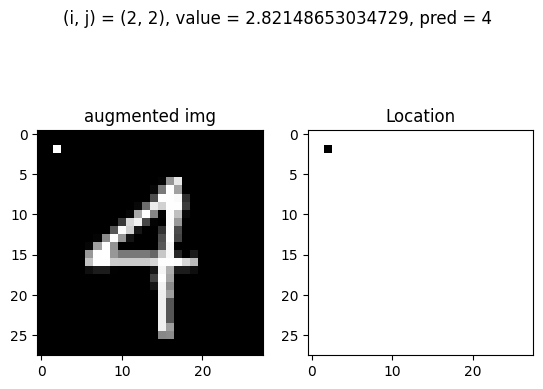

Test: At (i, j) = (3, 16) and value = 2.82148653034729, pred = 4, before_pred = 9, gt = 4


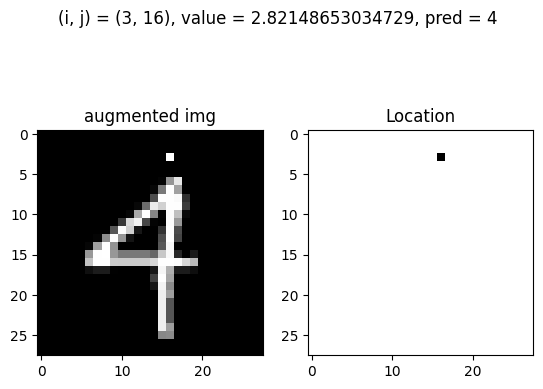

Test: At (i, j) = (5, 16) and value = 2.82148653034729, pred = 4, before_pred = 9, gt = 4


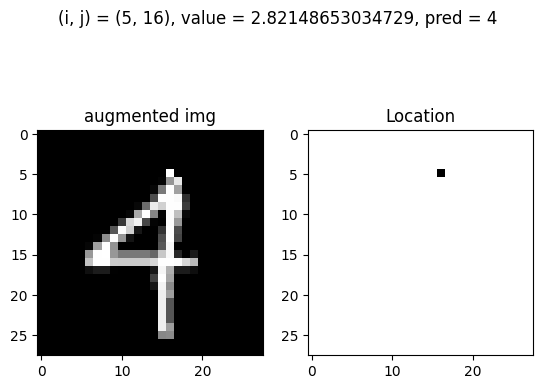

Test: At (i, j) = (7, 15) and value = -0.424212917883804, pred = 4, before_pred = 9, gt = 4


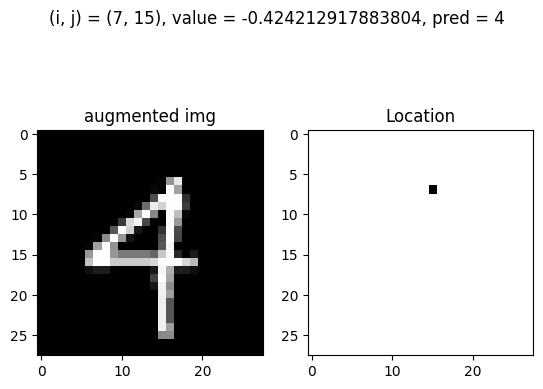

Test: At (i, j) = (7, 16) and value = -0.424212917883804, pred = 4, before_pred = 9, gt = 4


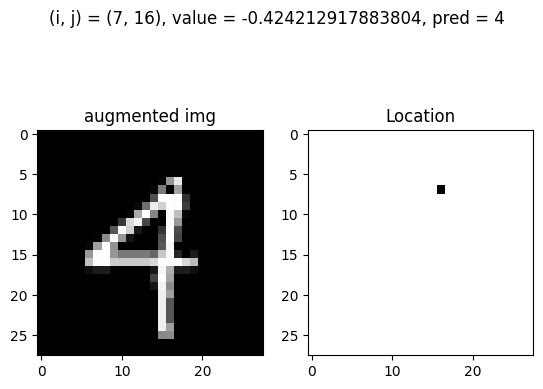

Test: At (i, j) = (7, 16) and value = -0.06357964585812692, pred = 4, before_pred = 9, gt = 4


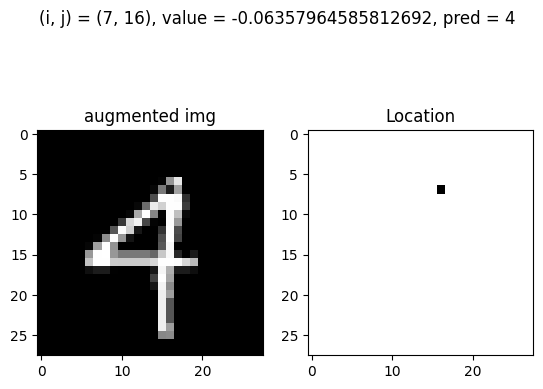

Test: At (i, j) = (7, 16) and value = 0.29705362616755016, pred = 4, before_pred = 9, gt = 4


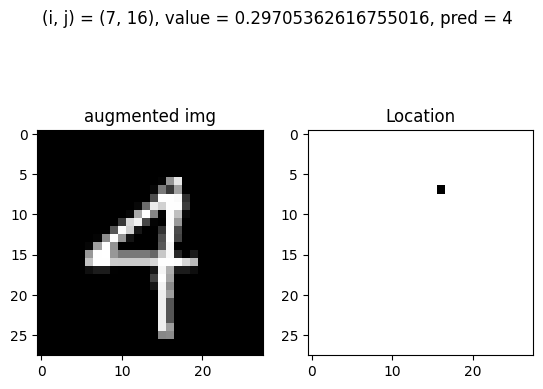

Test: At (i, j) = (7, 16) and value = 0.6576868981932272, pred = 4, before_pred = 9, gt = 4


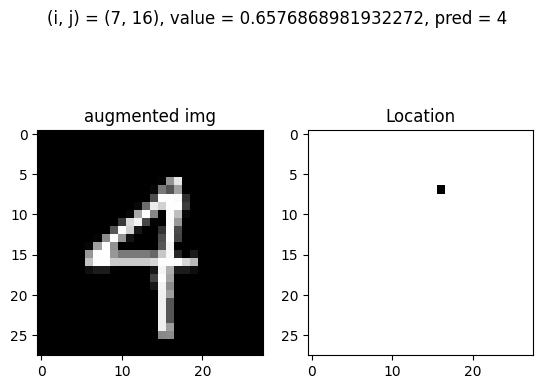

Test: At (i, j) = (7, 16) and value = 1.0183201702189044, pred = 4, before_pred = 9, gt = 4


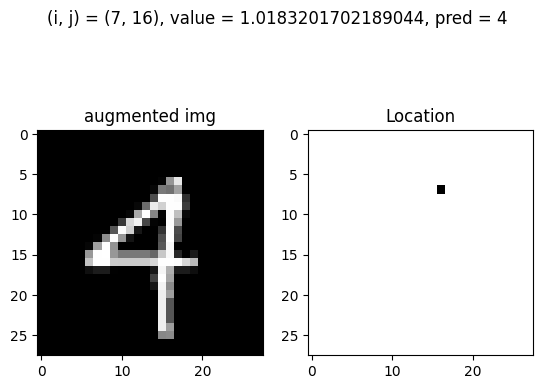

Test: At (i, j) = (7, 16) and value = 1.3789534422445815, pred = 4, before_pred = 9, gt = 4


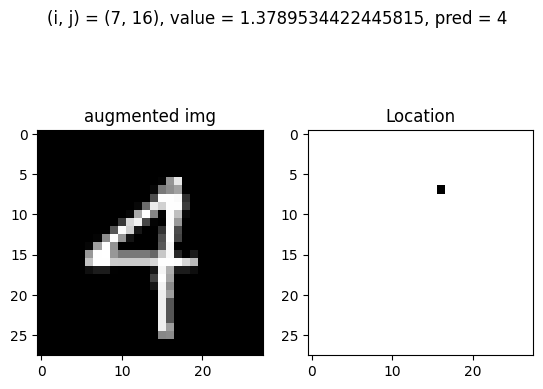

Test: At (i, j) = (7, 17) and value = -0.424212917883804, pred = 4, before_pred = 9, gt = 4


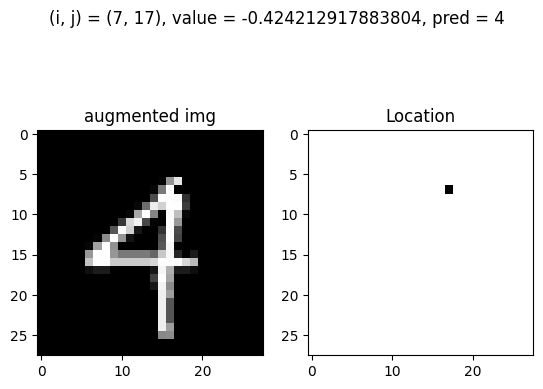

Test: At (i, j) = (7, 17) and value = -0.06357964585812692, pred = 4, before_pred = 9, gt = 4


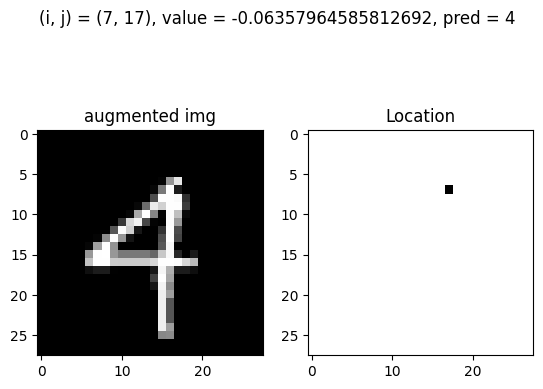

Test: At (i, j) = (8, 15) and value = -0.424212917883804, pred = 4, before_pred = 9, gt = 4


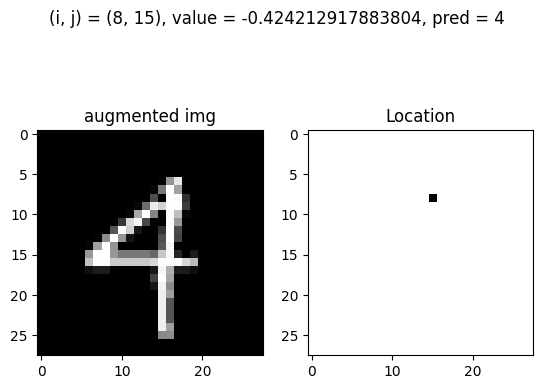

Test: At (i, j) = (8, 15) and value = -0.06357964585812692, pred = 4, before_pred = 9, gt = 4


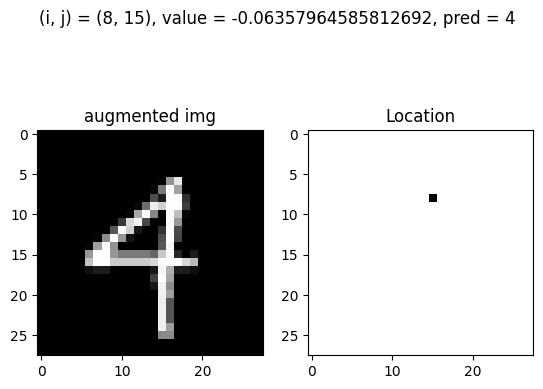

Test: At (i, j) = (8, 15) and value = 0.29705362616755016, pred = 4, before_pred = 9, gt = 4


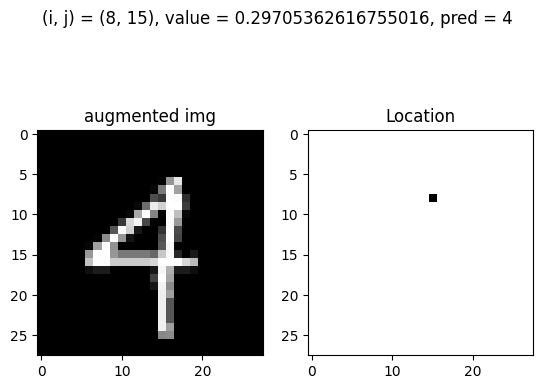

Test: At (i, j) = (8, 15) and value = 0.6576868981932272, pred = 4, before_pred = 9, gt = 4


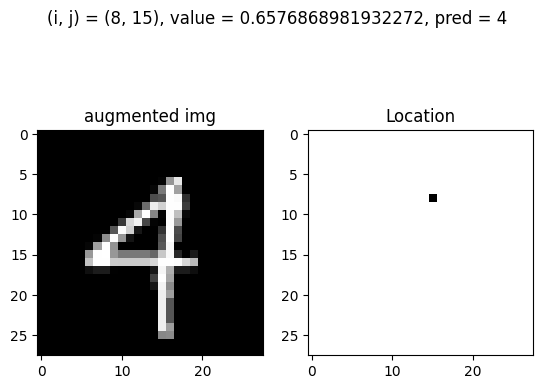

Test: At (i, j) = (8, 15) and value = 1.0183201702189044, pred = 4, before_pred = 9, gt = 4


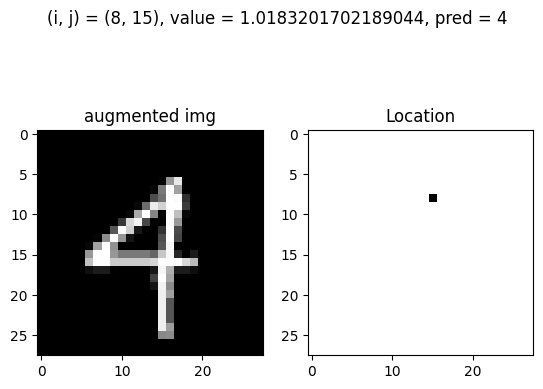

Test: At (i, j) = (8, 15) and value = 1.3789534422445815, pred = 4, before_pred = 9, gt = 4


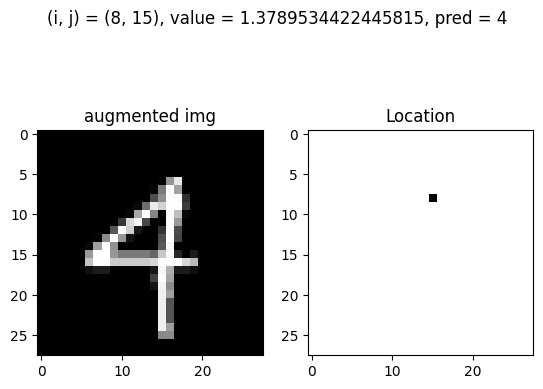

Test: At (i, j) = (8, 16) and value = -0.424212917883804, pred = 4, before_pred = 9, gt = 4


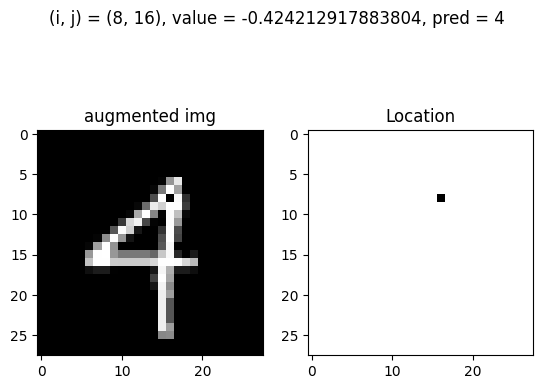

Test: At (i, j) = (8, 16) and value = -0.06357964585812692, pred = 4, before_pred = 9, gt = 4


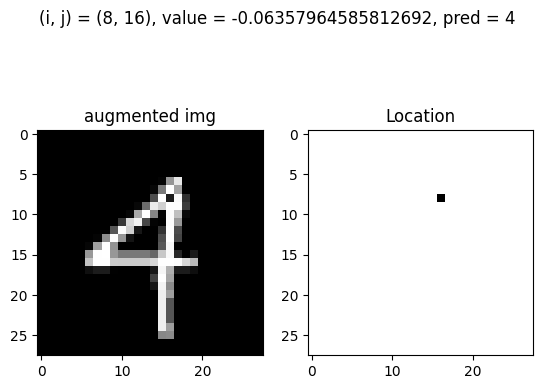

Test: At (i, j) = (8, 16) and value = 0.29705362616755016, pred = 4, before_pred = 9, gt = 4


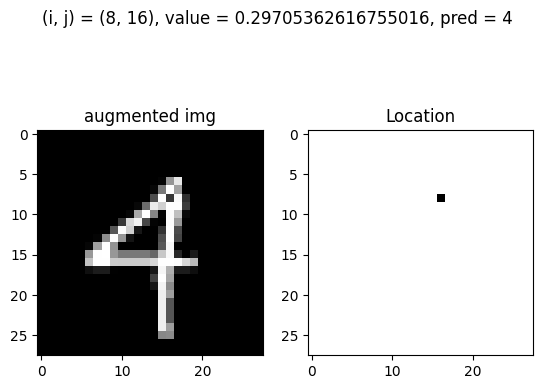

Test: At (i, j) = (8, 16) and value = 0.6576868981932272, pred = 4, before_pred = 9, gt = 4


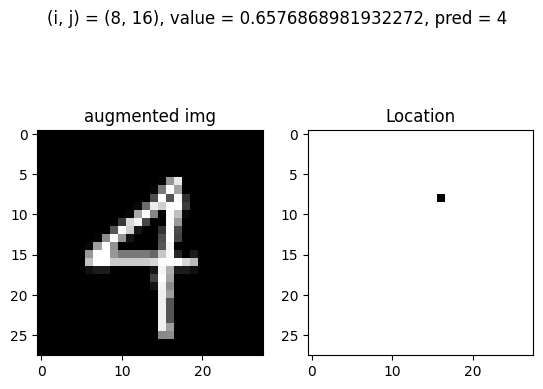

Test: At (i, j) = (8, 16) and value = 1.0183201702189044, pred = 4, before_pred = 9, gt = 4


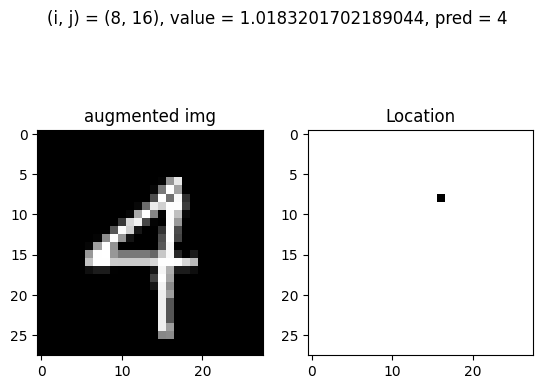

Test: At (i, j) = (8, 17) and value = -0.424212917883804, pred = 4, before_pred = 9, gt = 4


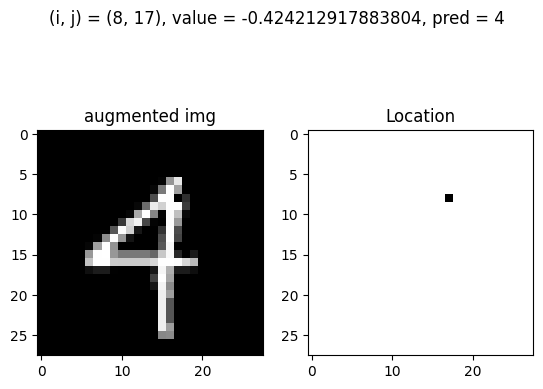

Test: At (i, j) = (8, 17) and value = -0.06357964585812692, pred = 4, before_pred = 9, gt = 4


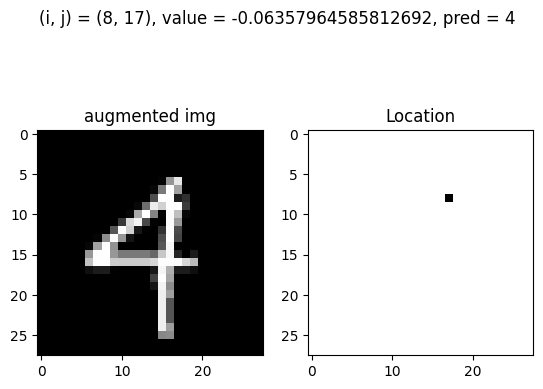

Test: At (i, j) = (8, 17) and value = 0.29705362616755016, pred = 4, before_pred = 9, gt = 4


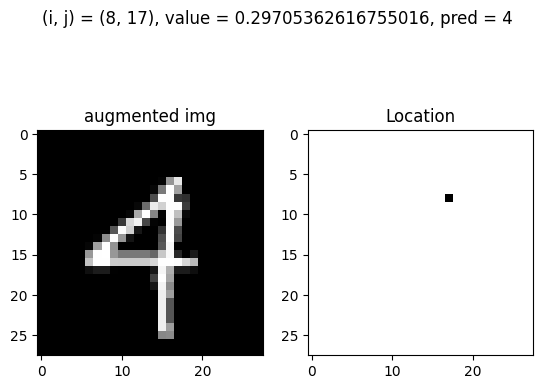

Test: At (i, j) = (8, 17) and value = 0.6576868981932272, pred = 4, before_pred = 9, gt = 4


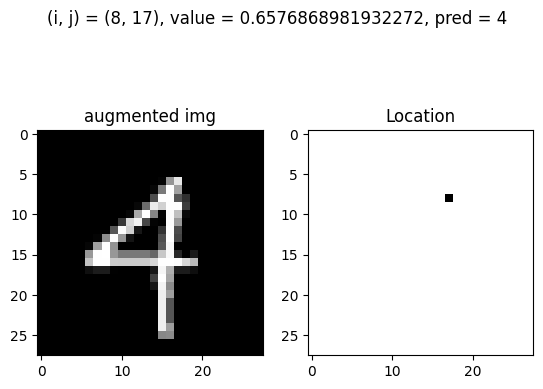

Test: At (i, j) = (8, 17) and value = 1.0183201702189044, pred = 4, before_pred = 9, gt = 4


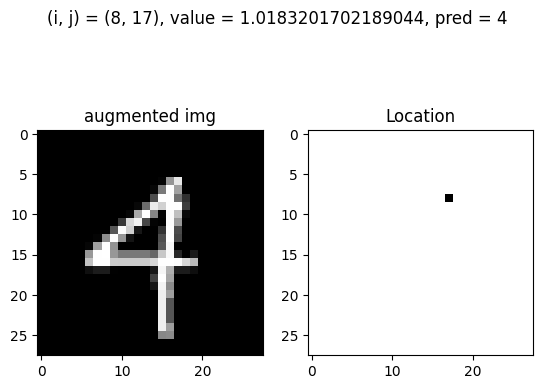

Test: At (i, j) = (9, 14) and value = -0.424212917883804, pred = 4, before_pred = 9, gt = 4


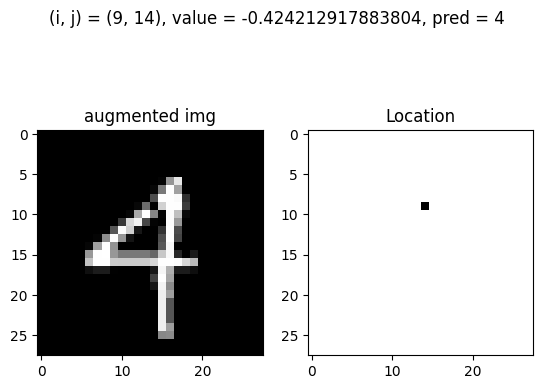

Test: At (i, j) = (9, 14) and value = -0.06357964585812692, pred = 4, before_pred = 9, gt = 4


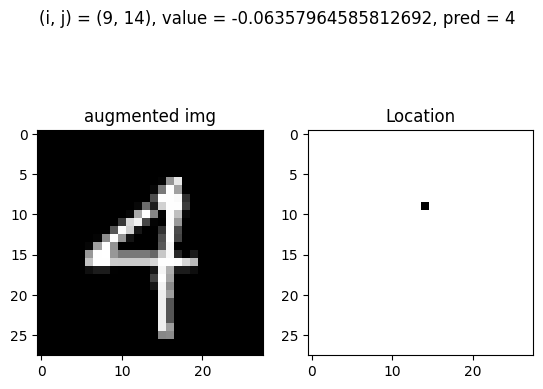

Test: At (i, j) = (9, 14) and value = 0.29705362616755016, pred = 4, before_pred = 9, gt = 4


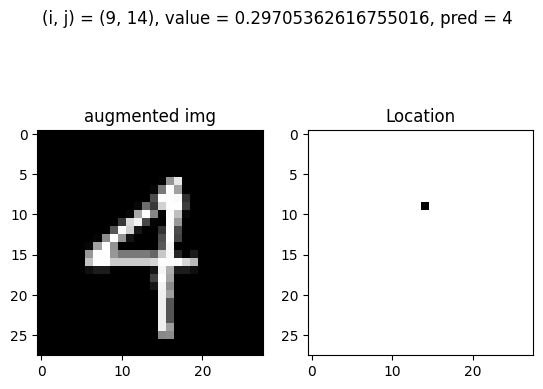

Test: At (i, j) = (9, 14) and value = 0.6576868981932272, pred = 4, before_pred = 9, gt = 4


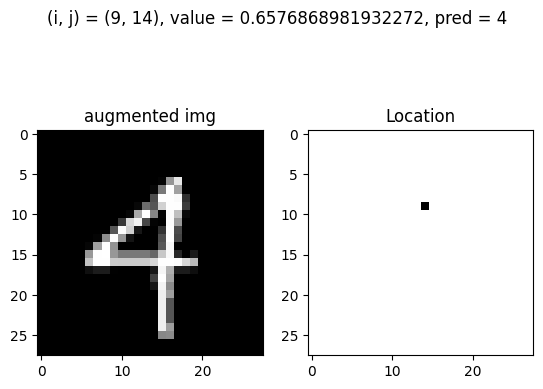

Test: At (i, j) = (9, 15) and value = -0.424212917883804, pred = 4, before_pred = 9, gt = 4


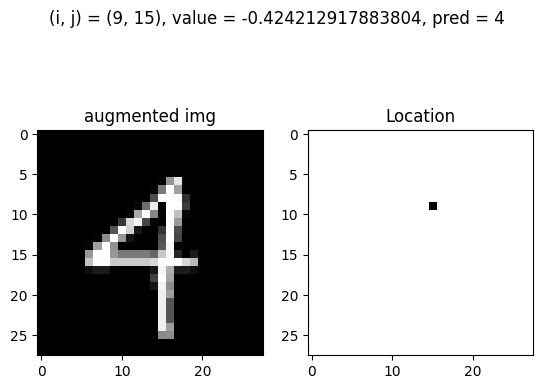

Test: At (i, j) = (9, 15) and value = -0.06357964585812692, pred = 4, before_pred = 9, gt = 4


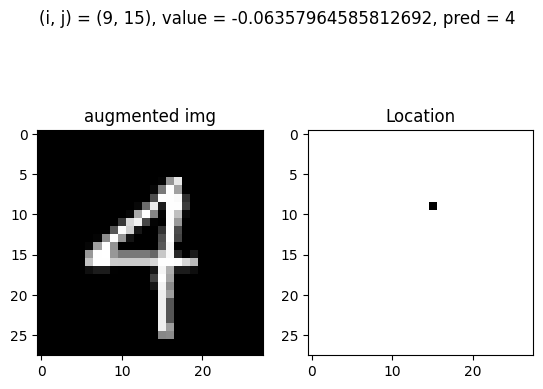

Test: At (i, j) = (9, 15) and value = 0.29705362616755016, pred = 4, before_pred = 9, gt = 4


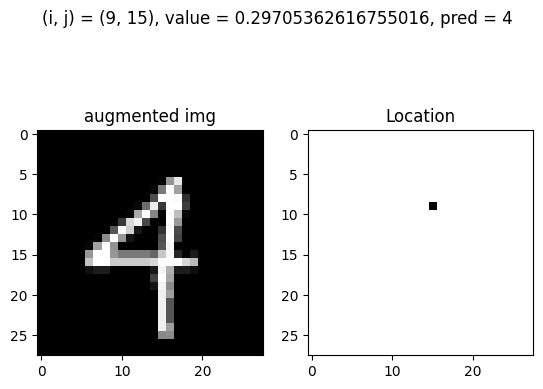

Test: At (i, j) = (9, 15) and value = 0.6576868981932272, pred = 4, before_pred = 9, gt = 4


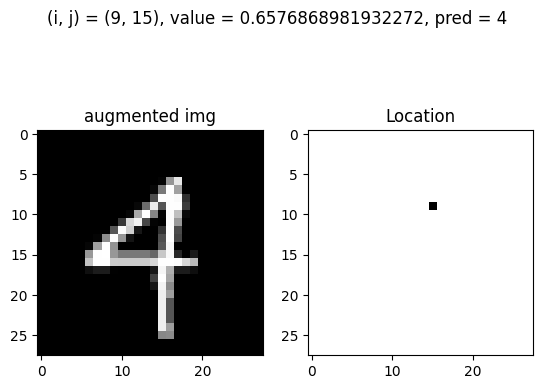

Test: At (i, j) = (9, 16) and value = -0.424212917883804, pred = 4, before_pred = 9, gt = 4


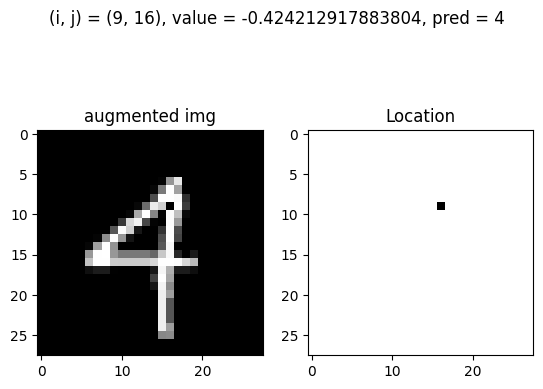

Test: At (i, j) = (9, 16) and value = -0.06357964585812692, pred = 4, before_pred = 9, gt = 4


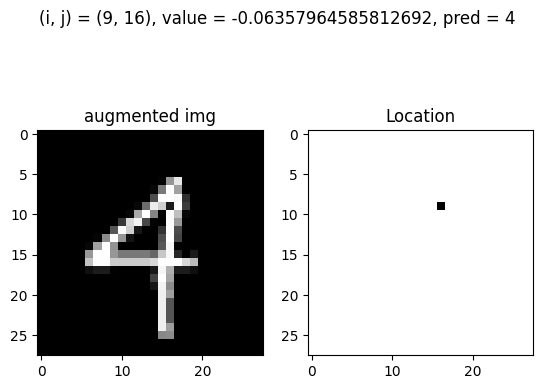

Test: At (i, j) = (9, 16) and value = 0.29705362616755016, pred = 4, before_pred = 9, gt = 4


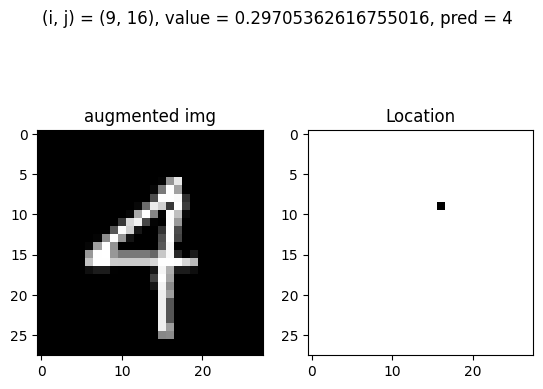

Test: At (i, j) = (9, 16) and value = 0.6576868981932272, pred = 4, before_pred = 9, gt = 4


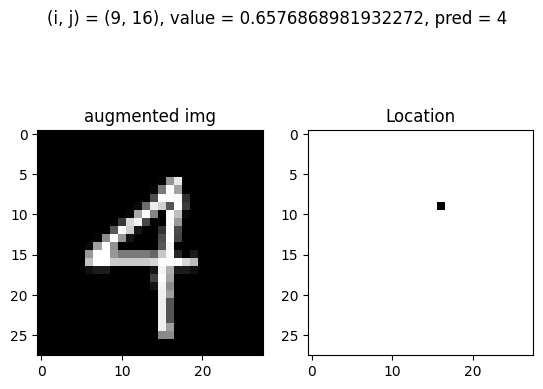

Test: At (i, j) = (9, 17) and value = -0.424212917883804, pred = 4, before_pred = 9, gt = 4


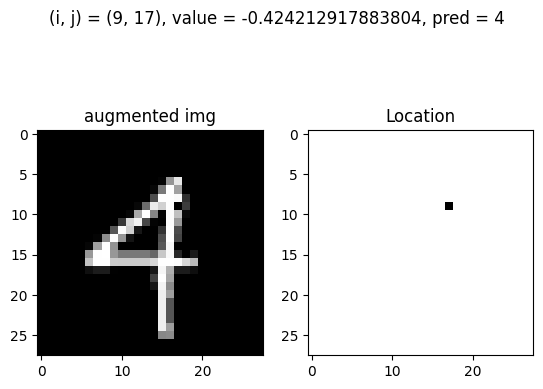

Test: At (i, j) = (10, 16) and value = -0.424212917883804, pred = 4, before_pred = 9, gt = 4


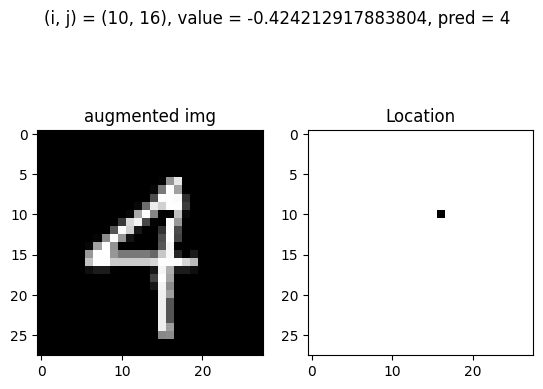

Test: At (i, j) = (10, 16) and value = -0.06357964585812692, pred = 4, before_pred = 9, gt = 4


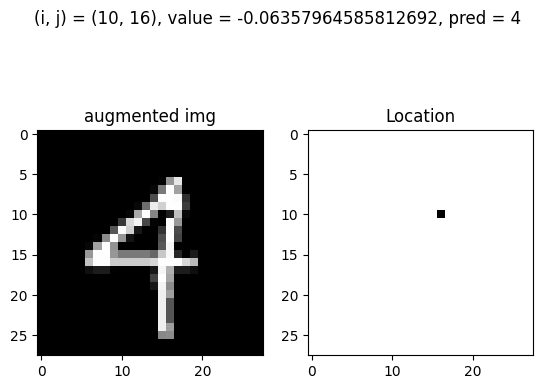

Test: At (i, j) = (10, 16) and value = 0.29705362616755016, pred = 4, before_pred = 9, gt = 4


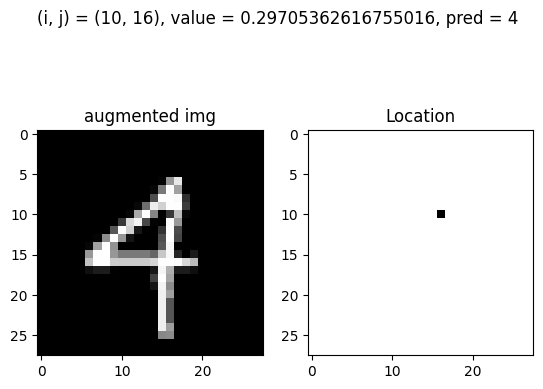

Test: At (i, j) = (13, 11) and value = 1.7395867142702586, pred = 4, before_pred = 9, gt = 4


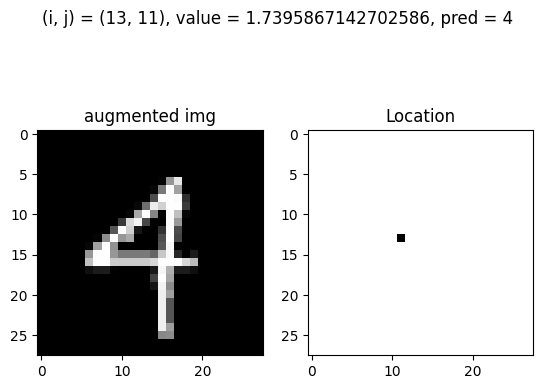

Test: At (i, j) = (13, 11) and value = 2.1002199862959356, pred = 4, before_pred = 9, gt = 4


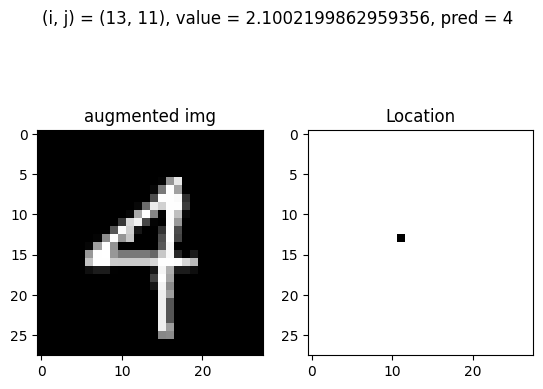

Test: At (i, j) = (13, 11) and value = 2.4608532583216127, pred = 4, before_pred = 9, gt = 4


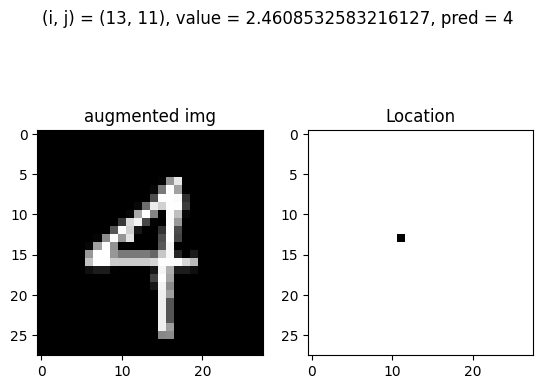

Test: At (i, j) = (13, 11) and value = 2.82148653034729, pred = 4, before_pred = 9, gt = 4


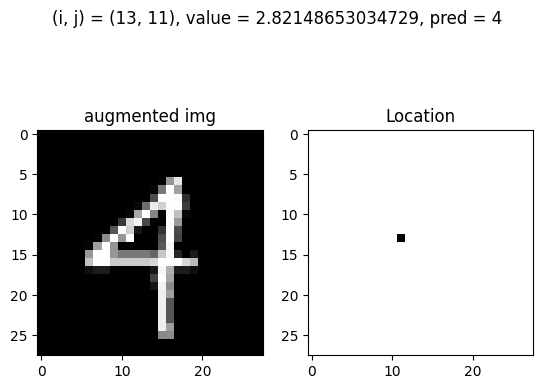

Test: At (i, j) = (13, 12) and value = 2.4608532583216127, pred = 4, before_pred = 9, gt = 4


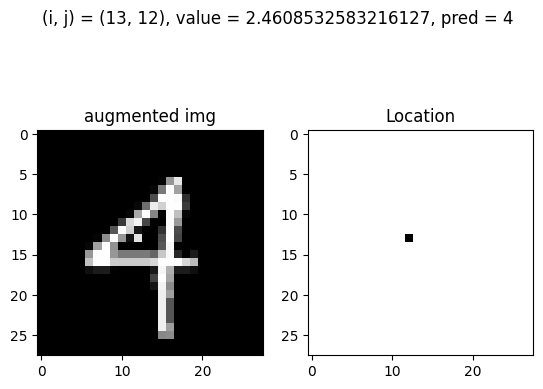

Test: At (i, j) = (13, 12) and value = 2.82148653034729, pred = 4, before_pred = 9, gt = 4


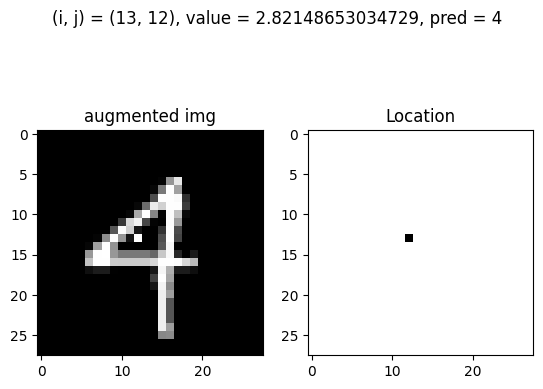

Test: At (i, j) = (14, 10) and value = 2.1002199862959356, pred = 4, before_pred = 9, gt = 4


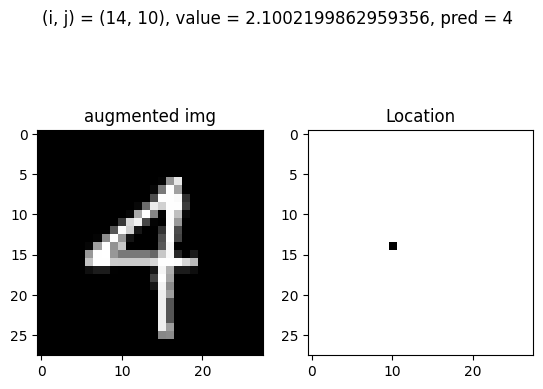

Test: At (i, j) = (14, 10) and value = 2.4608532583216127, pred = 4, before_pred = 9, gt = 4


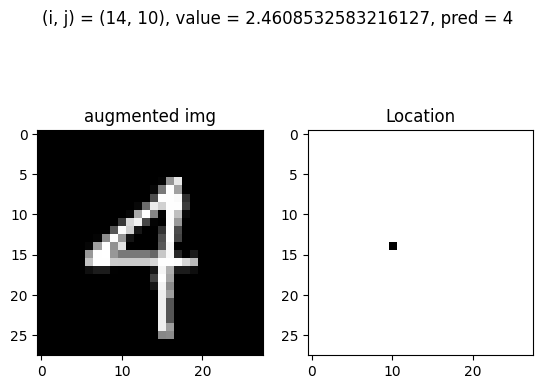

Test: At (i, j) = (14, 10) and value = 2.82148653034729, pred = 4, before_pred = 9, gt = 4


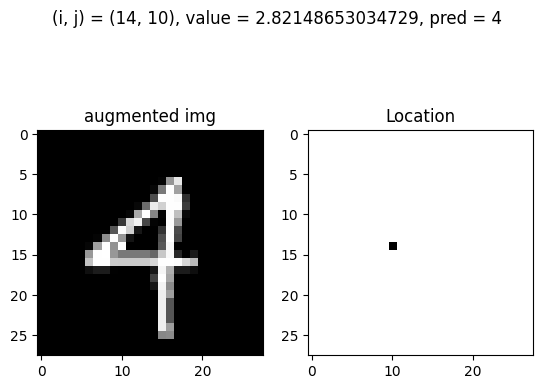

Test: At (i, j) = (14, 11) and value = 2.1002199862959356, pred = 4, before_pred = 9, gt = 4


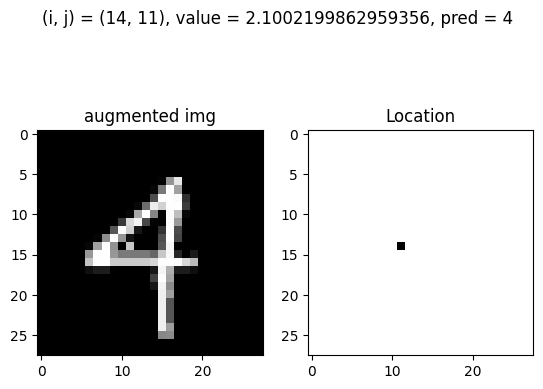

Test: At (i, j) = (14, 11) and value = 2.4608532583216127, pred = 4, before_pred = 9, gt = 4


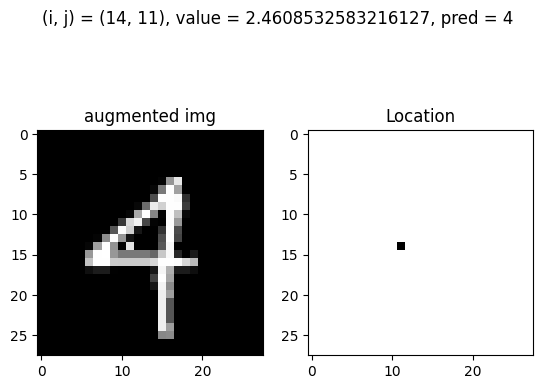

Test: At (i, j) = (14, 11) and value = 2.82148653034729, pred = 4, before_pred = 9, gt = 4


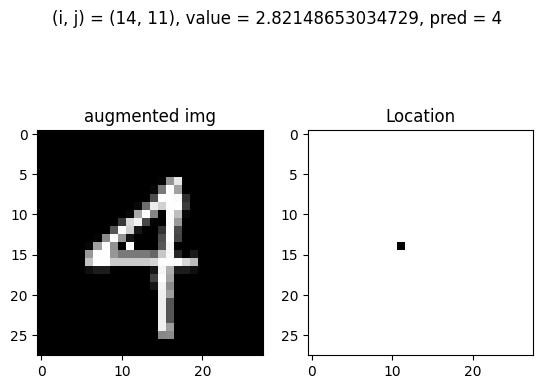

Test: At (i, j) = (14, 12) and value = 2.4608532583216127, pred = 4, before_pred = 9, gt = 4


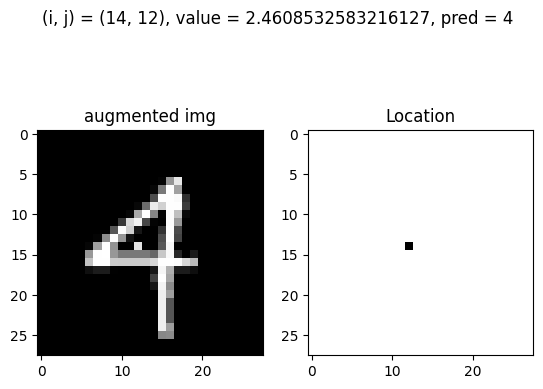

Test: At (i, j) = (14, 12) and value = 2.82148653034729, pred = 4, before_pred = 9, gt = 4


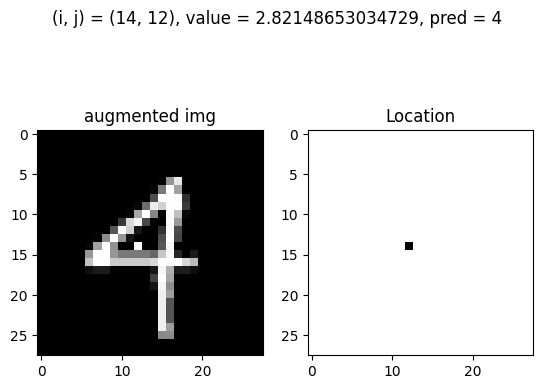

Test: At (i, j) = (14, 14) and value = 2.4608532583216127, pred = 4, before_pred = 9, gt = 4


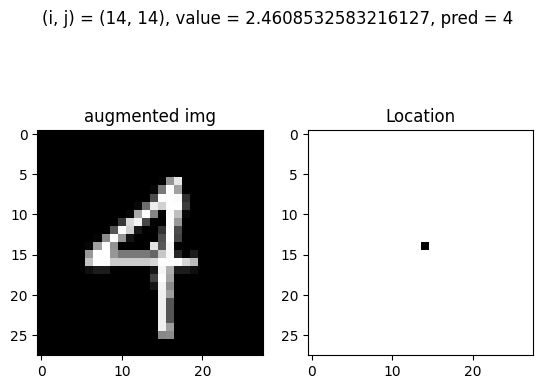

Test: At (i, j) = (14, 14) and value = 2.82148653034729, pred = 4, before_pred = 9, gt = 4


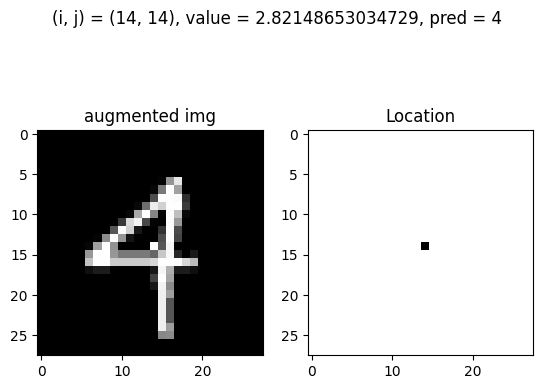

Test: At (i, j) = (17, 9) and value = 2.82148653034729, pred = 4, before_pred = 9, gt = 4


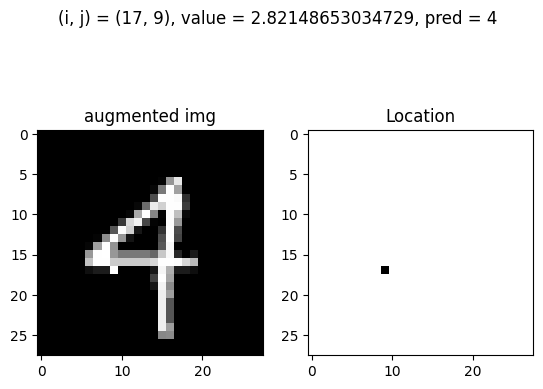

Test: At (i, j) = (17, 12) and value = 2.4608532583216127, pred = 4, before_pred = 9, gt = 4


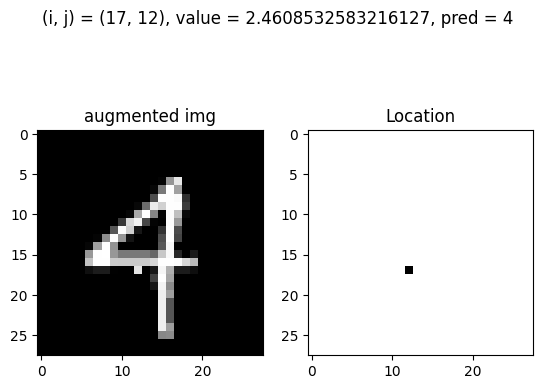

Test: At (i, j) = (17, 12) and value = 2.82148653034729, pred = 4, before_pred = 9, gt = 4


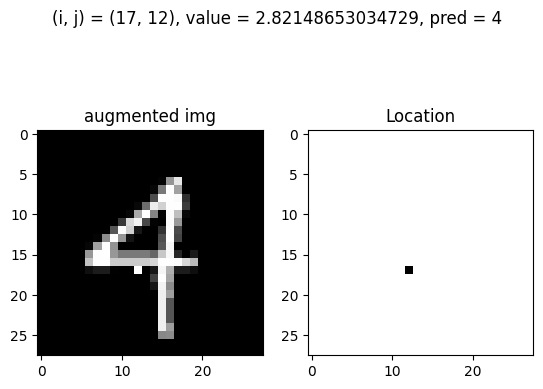

Test: At (i, j) = (17, 13) and value = 2.4608532583216127, pred = 4, before_pred = 9, gt = 4


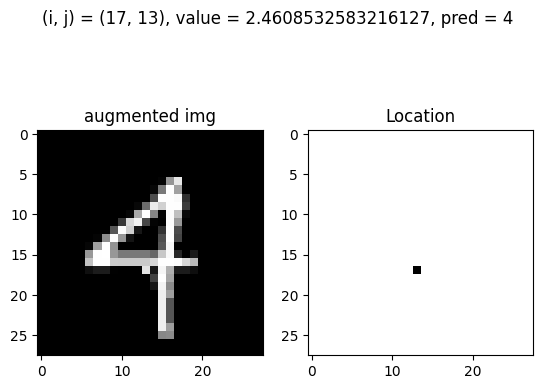

Test: At (i, j) = (17, 13) and value = 2.82148653034729, pred = 4, before_pred = 9, gt = 4


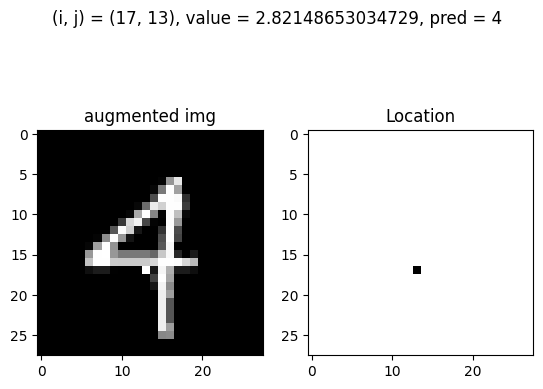

Test: At (i, j) = (17, 14) and value = 1.7395867142702586, pred = 4, before_pred = 9, gt = 4


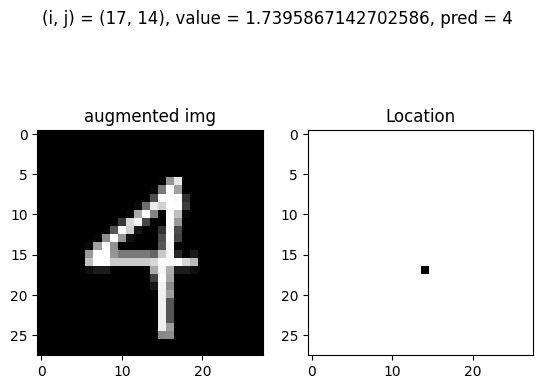

Test: At (i, j) = (17, 14) and value = 2.1002199862959356, pred = 4, before_pred = 9, gt = 4


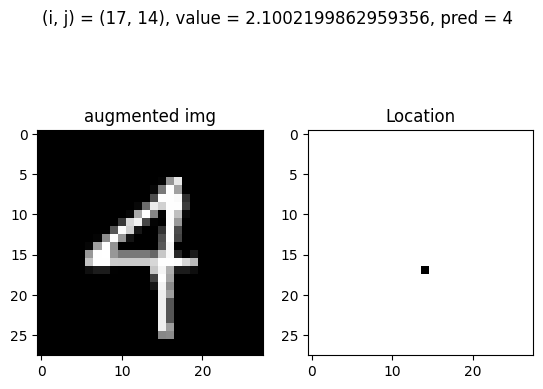

Test: At (i, j) = (17, 14) and value = 2.4608532583216127, pred = 4, before_pred = 9, gt = 4


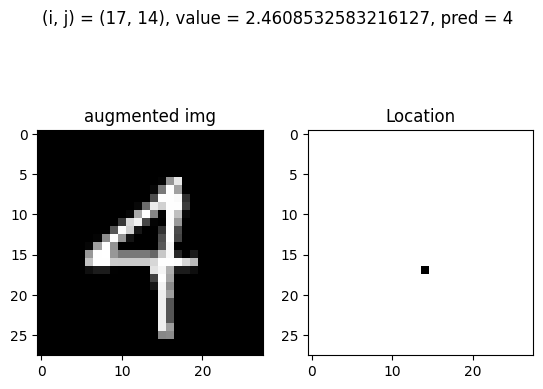

Test: At (i, j) = (17, 14) and value = 2.82148653034729, pred = 4, before_pred = 9, gt = 4


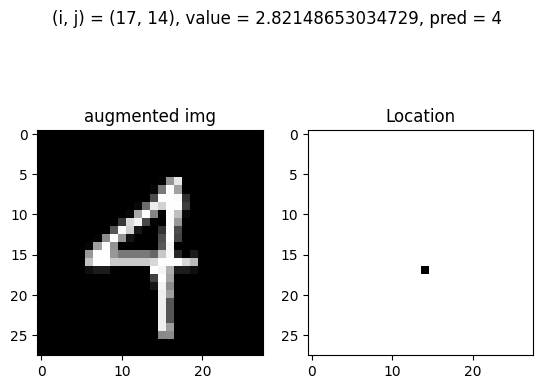

Test: At (i, j) = (18, 11) and value = 2.1002199862959356, pred = 4, before_pred = 9, gt = 4


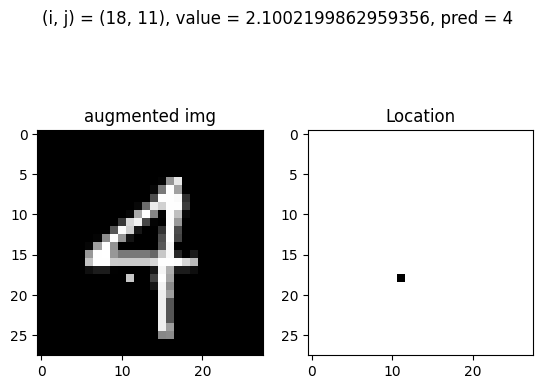

Test: At (i, j) = (18, 11) and value = 2.4608532583216127, pred = 4, before_pred = 9, gt = 4


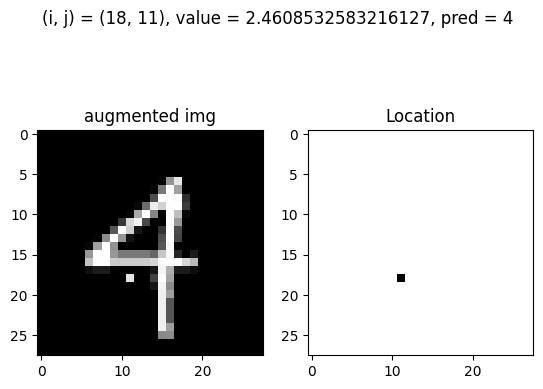

Test: At (i, j) = (18, 11) and value = 2.82148653034729, pred = 4, before_pred = 9, gt = 4


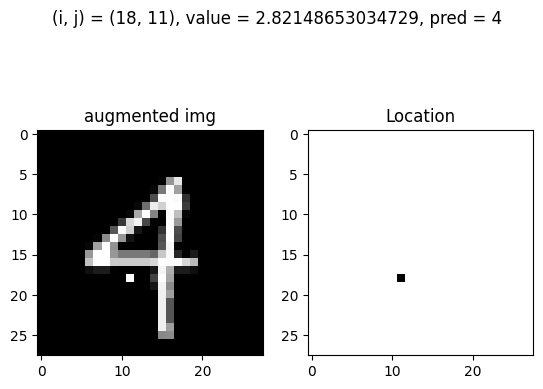

Test: At (i, j) = (18, 12) and value = 2.4608532583216127, pred = 4, before_pred = 9, gt = 4


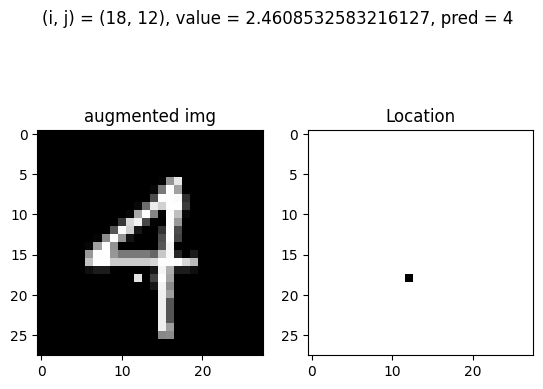

Test: At (i, j) = (18, 12) and value = 2.82148653034729, pred = 4, before_pred = 9, gt = 4


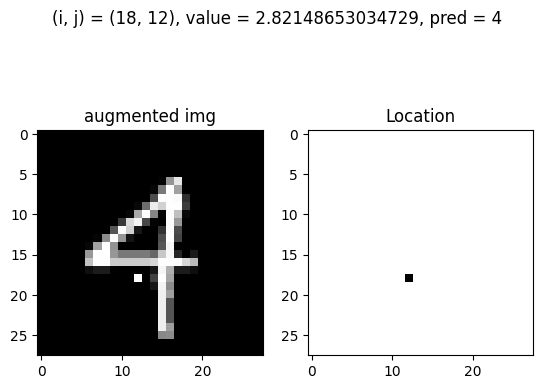

Test: At (i, j) = (20, 22) and value = 2.4608532583216127, pred = 4, before_pred = 9, gt = 4


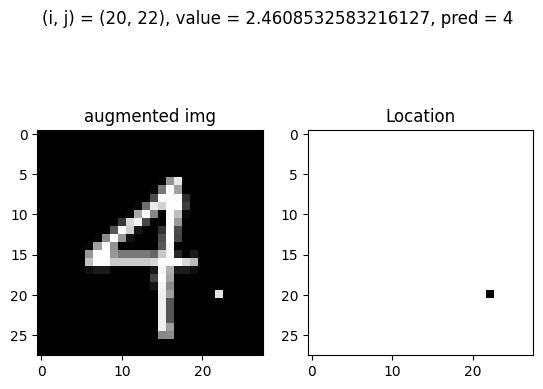

Test: At (i, j) = (20, 22) and value = 2.82148653034729, pred = 4, before_pred = 9, gt = 4


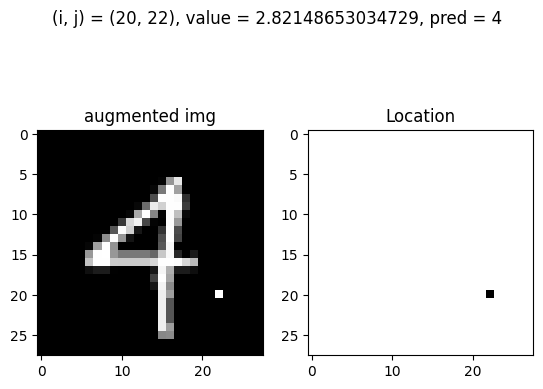

7840 done
7840 done
7840 done
7840 done
7840 done
7840 done
7840 done
7840 done
Test: At (i, j) = (17, 9) and value = 2.4608532583216127, pred = 8, before_pred = 3, gt = 8


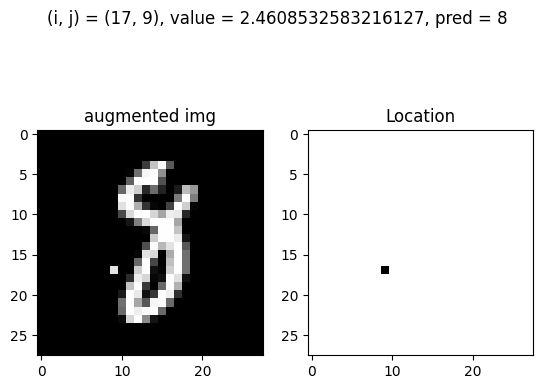

Test: At (i, j) = (17, 9) and value = 2.82148653034729, pred = 8, before_pred = 3, gt = 8


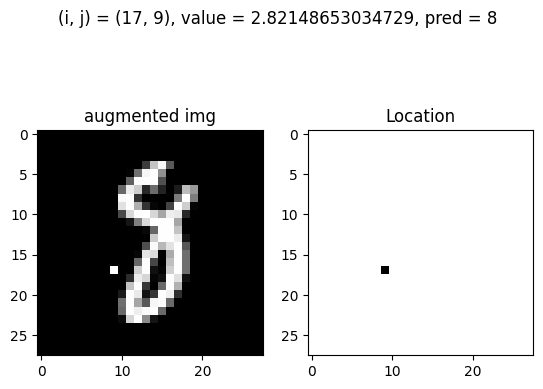

Test: At (i, j) = (17, 11) and value = 2.82148653034729, pred = 8, before_pred = 3, gt = 8


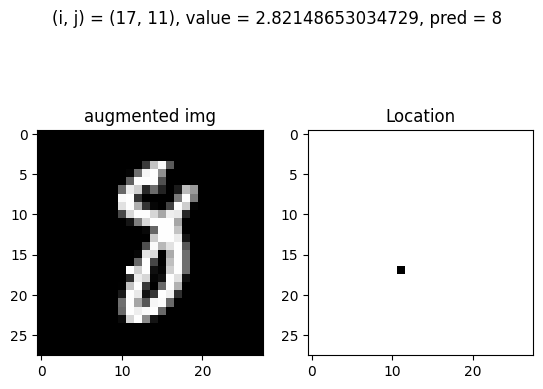

7840 done
7840 done
7840 done
7840 done
7840 done
7840 done
7840 done
7840 done
Test: At (i, j) = (1, 9) and value = 2.82148653034729, pred = 4, before_pred = 9, gt = 4


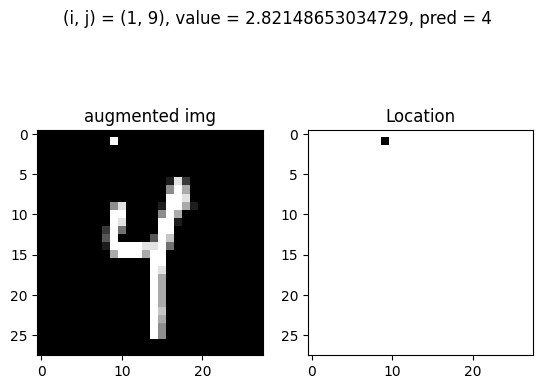

Test: At (i, j) = (2, 2) and value = 1.7395867142702586, pred = 4, before_pred = 9, gt = 4


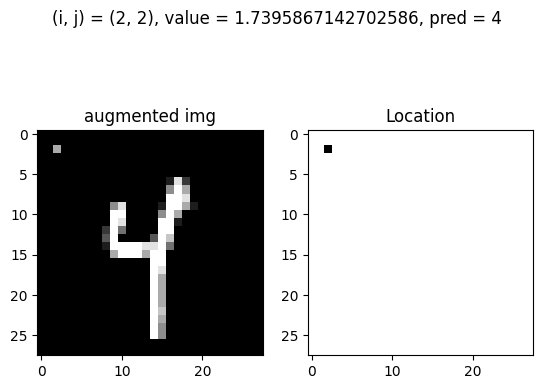

Test: At (i, j) = (2, 2) and value = 2.1002199862959356, pred = 4, before_pred = 9, gt = 4


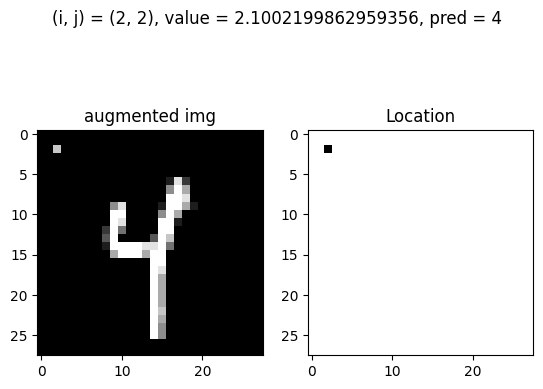

Test: At (i, j) = (2, 2) and value = 2.4608532583216127, pred = 4, before_pred = 9, gt = 4


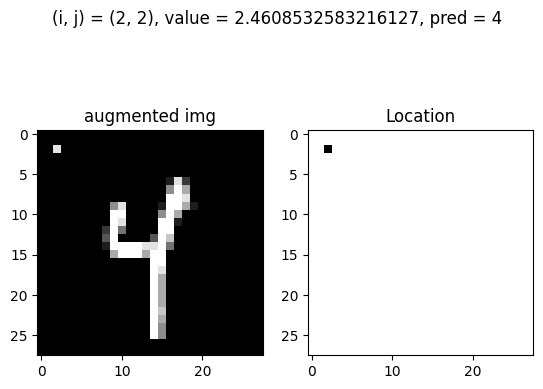

Test: At (i, j) = (2, 2) and value = 2.82148653034729, pred = 4, before_pred = 9, gt = 4


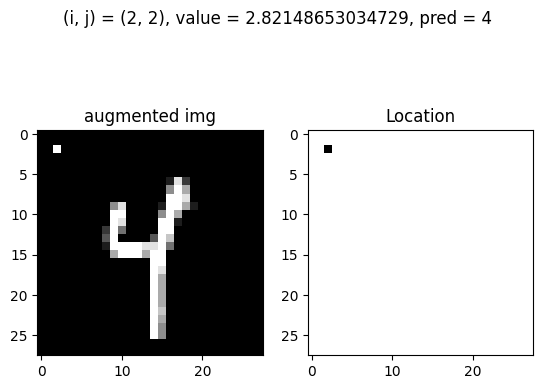

Test: At (i, j) = (2, 14) and value = 2.4608532583216127, pred = 4, before_pred = 9, gt = 4


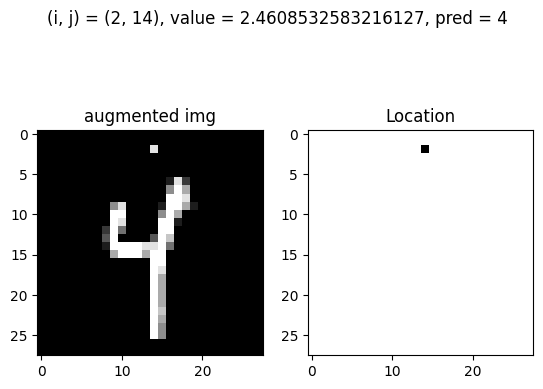

Test: At (i, j) = (2, 14) and value = 2.82148653034729, pred = 4, before_pred = 9, gt = 4


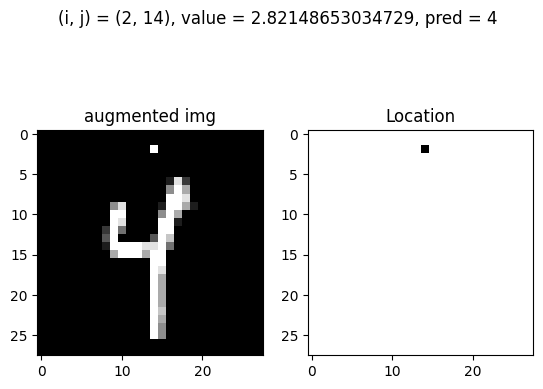

Test: At (i, j) = (3, 16) and value = 1.3789534422445815, pred = 4, before_pred = 9, gt = 4


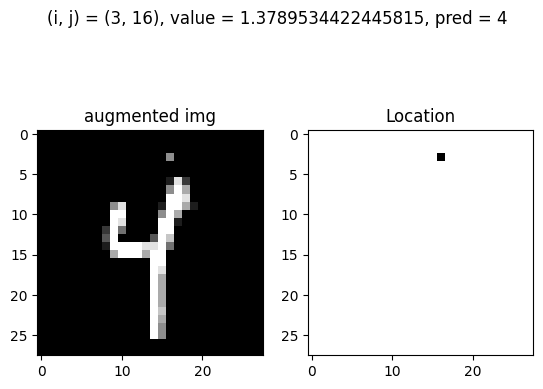

Test: At (i, j) = (3, 16) and value = 1.7395867142702586, pred = 4, before_pred = 9, gt = 4


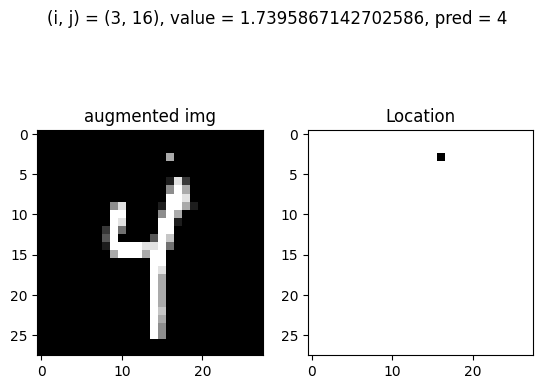

Test: At (i, j) = (3, 16) and value = 2.1002199862959356, pred = 4, before_pred = 9, gt = 4


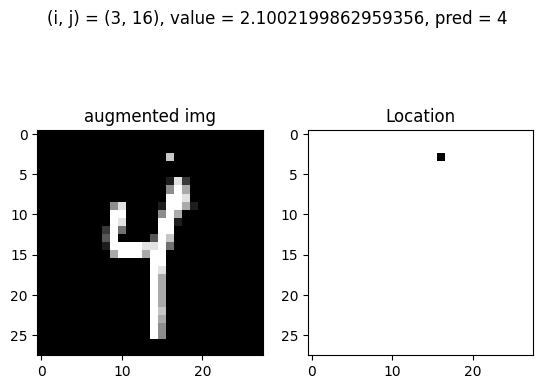

Test: At (i, j) = (3, 16) and value = 2.4608532583216127, pred = 4, before_pred = 9, gt = 4


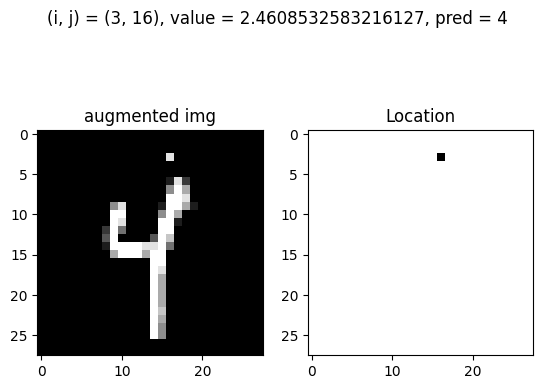

Test: At (i, j) = (3, 16) and value = 2.82148653034729, pred = 4, before_pred = 9, gt = 4


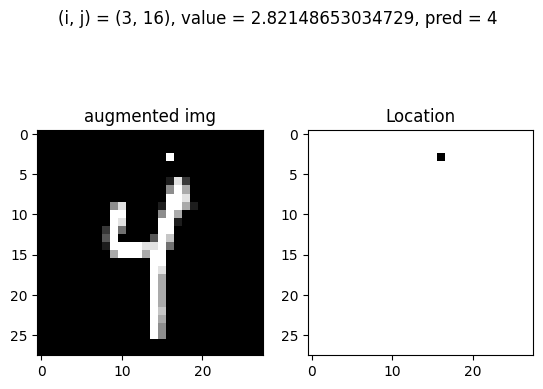

Test: At (i, j) = (3, 19) and value = 2.4608532583216127, pred = 4, before_pred = 9, gt = 4


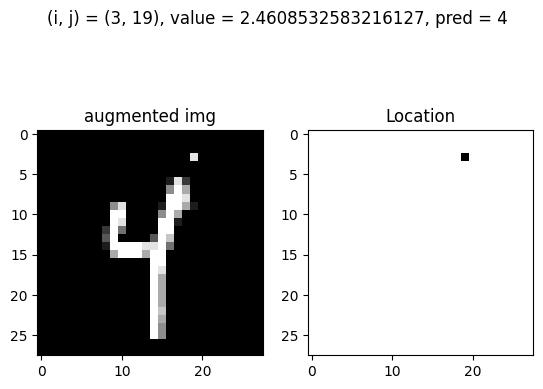

Test: At (i, j) = (3, 19) and value = 2.82148653034729, pred = 4, before_pred = 9, gt = 4


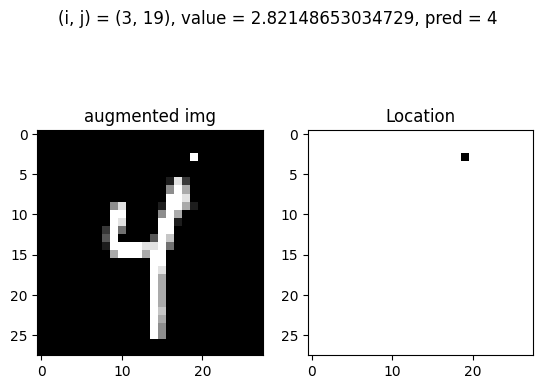

Test: At (i, j) = (4, 10) and value = 2.82148653034729, pred = 4, before_pred = 9, gt = 4


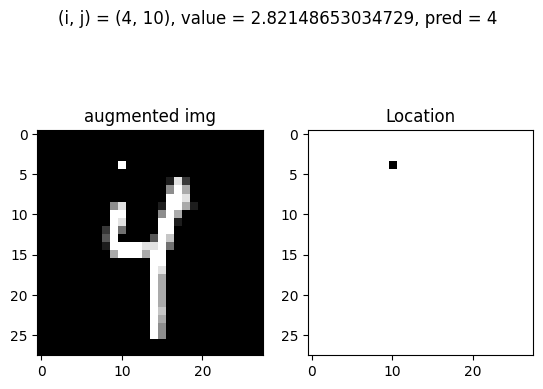

Test: At (i, j) = (4, 18) and value = 2.82148653034729, pred = 4, before_pred = 9, gt = 4


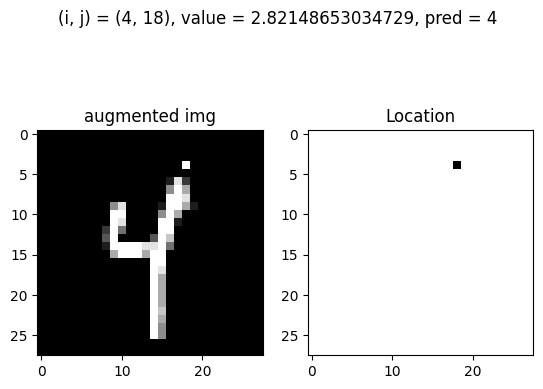

Test: At (i, j) = (4, 19) and value = 2.4608532583216127, pred = 4, before_pred = 9, gt = 4


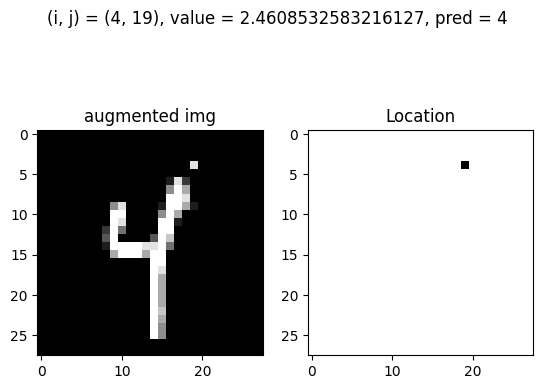

Test: At (i, j) = (4, 19) and value = 2.82148653034729, pred = 4, before_pred = 9, gt = 4


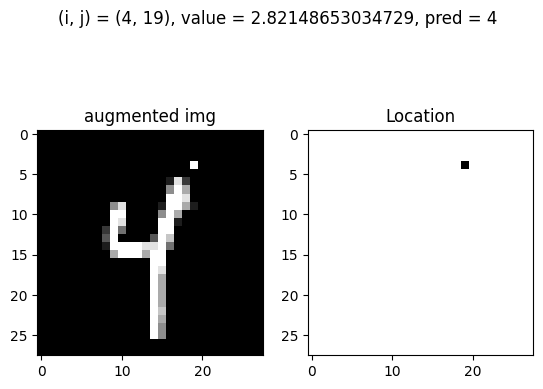

Test: At (i, j) = (4, 23) and value = 2.82148653034729, pred = 4, before_pred = 9, gt = 4


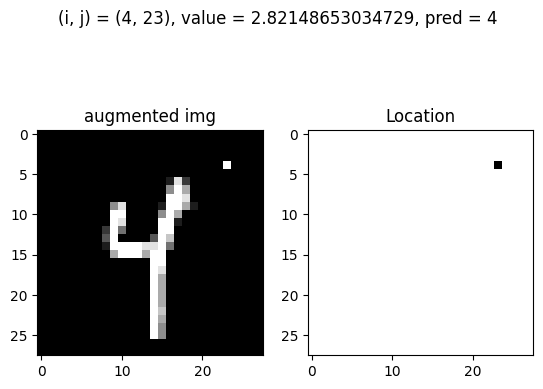

Test: At (i, j) = (5, 10) and value = 2.4608532583216127, pred = 4, before_pred = 9, gt = 4


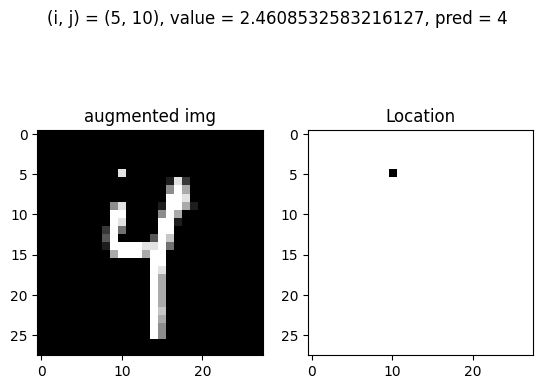

Test: At (i, j) = (5, 10) and value = 2.82148653034729, pred = 4, before_pred = 9, gt = 4


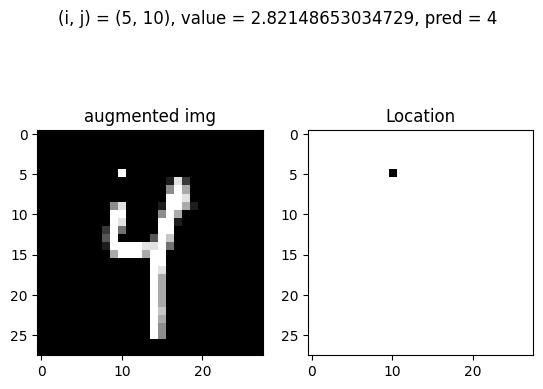

Test: At (i, j) = (5, 11) and value = 2.82148653034729, pred = 4, before_pred = 9, gt = 4


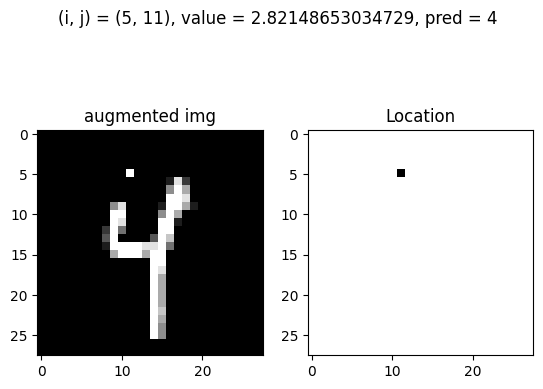

Test: At (i, j) = (5, 16) and value = 1.7395867142702586, pred = 4, before_pred = 9, gt = 4


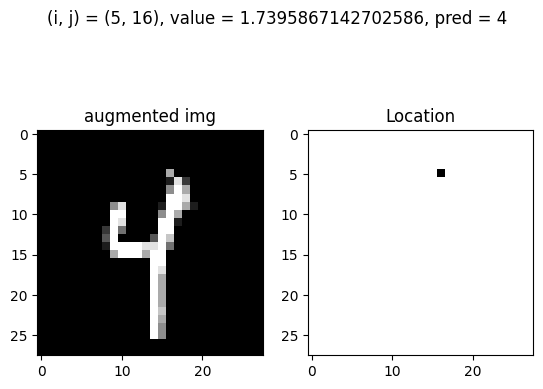

Test: At (i, j) = (5, 16) and value = 2.1002199862959356, pred = 4, before_pred = 9, gt = 4


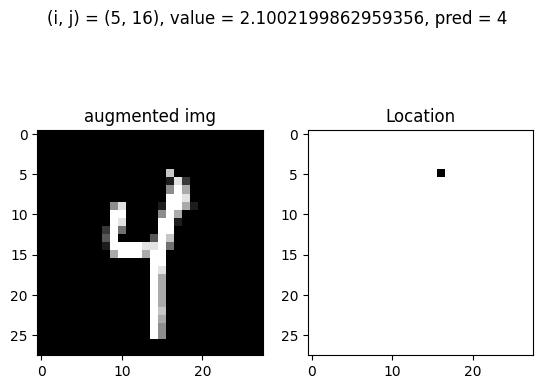

Test: At (i, j) = (5, 16) and value = 2.4608532583216127, pred = 4, before_pred = 9, gt = 4


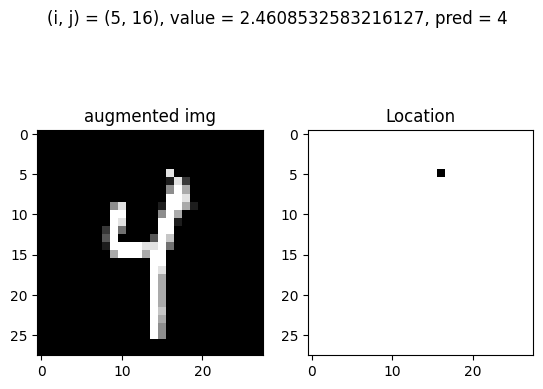

Test: At (i, j) = (5, 16) and value = 2.82148653034729, pred = 4, before_pred = 9, gt = 4


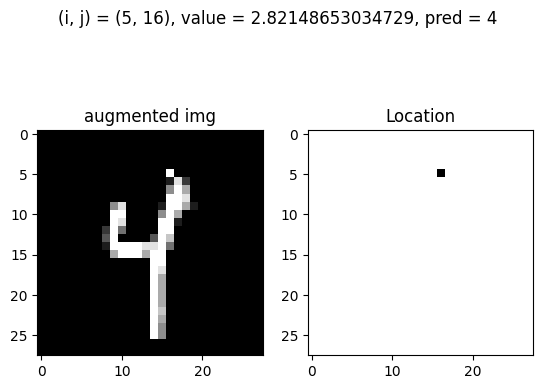

Test: At (i, j) = (5, 17) and value = 2.4608532583216127, pred = 4, before_pred = 9, gt = 4


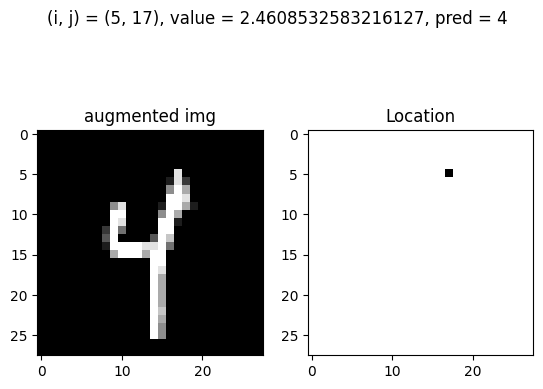

Test: At (i, j) = (5, 17) and value = 2.82148653034729, pred = 4, before_pred = 9, gt = 4


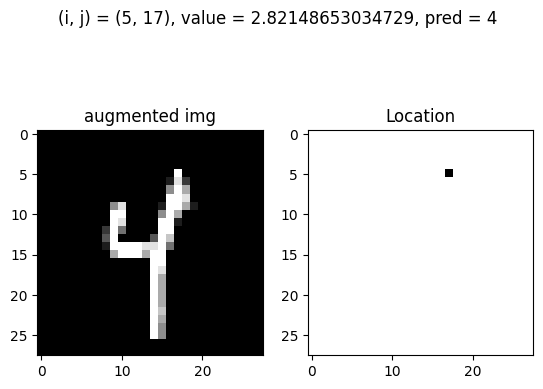

Test: At (i, j) = (5, 20) and value = 2.82148653034729, pred = 4, before_pred = 9, gt = 4


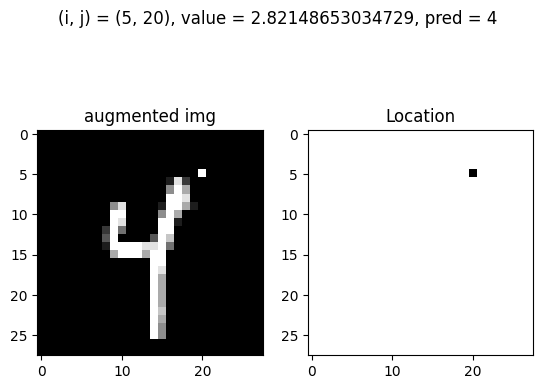

Test: At (i, j) = (6, 8) and value = 2.82148653034729, pred = 4, before_pred = 9, gt = 4


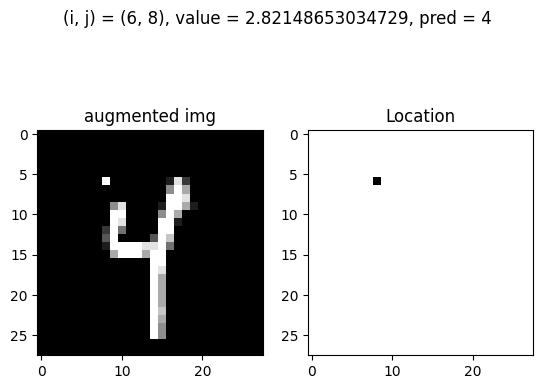

Test: At (i, j) = (7, 2) and value = 2.4608532583216127, pred = 4, before_pred = 9, gt = 4


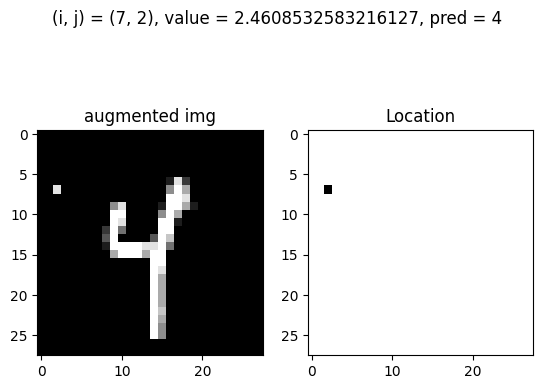

Test: At (i, j) = (7, 2) and value = 2.82148653034729, pred = 4, before_pred = 9, gt = 4


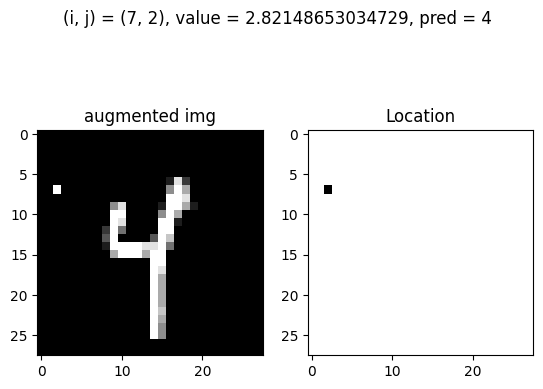

Test: At (i, j) = (7, 4) and value = 2.1002199862959356, pred = 4, before_pred = 9, gt = 4


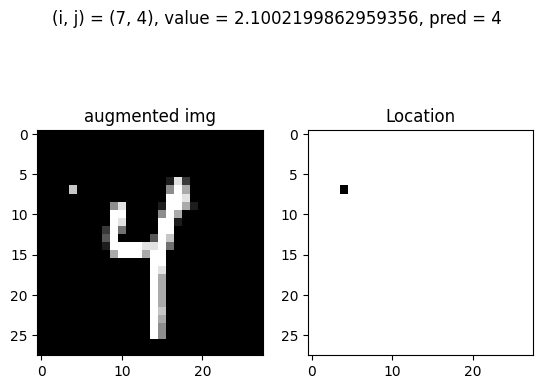

Test: At (i, j) = (7, 4) and value = 2.4608532583216127, pred = 4, before_pred = 9, gt = 4


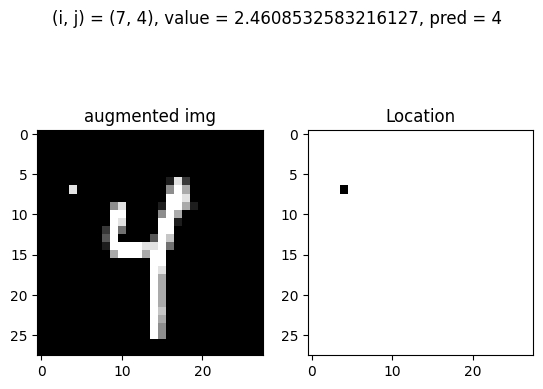

Test: At (i, j) = (7, 4) and value = 2.82148653034729, pred = 4, before_pred = 9, gt = 4


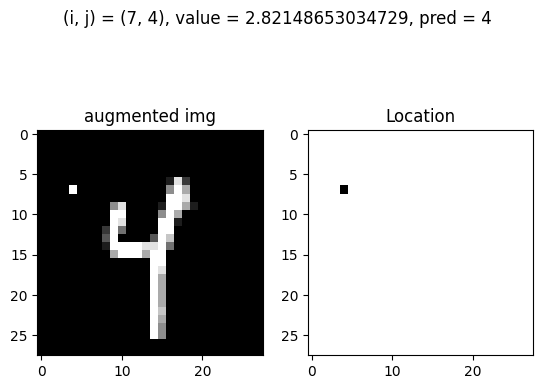

Test: At (i, j) = (7, 16) and value = -0.424212917883804, pred = 4, before_pred = 9, gt = 4


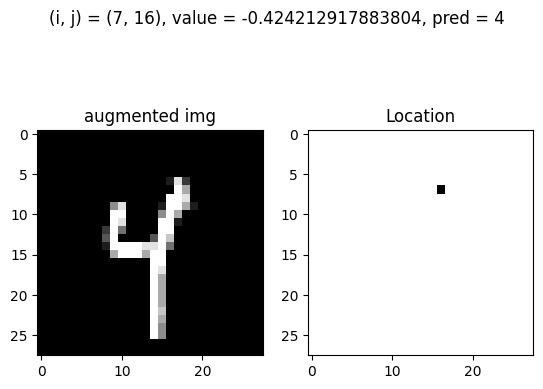

Test: At (i, j) = (7, 16) and value = -0.06357964585812692, pred = 4, before_pred = 9, gt = 4


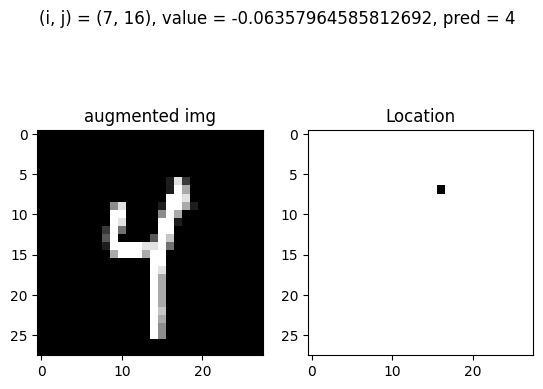

Test: At (i, j) = (7, 16) and value = 0.29705362616755016, pred = 4, before_pred = 9, gt = 4


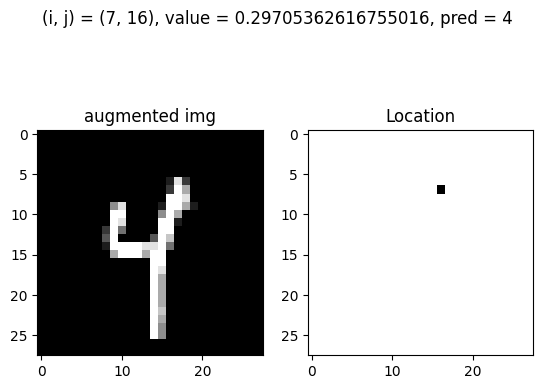

Test: At (i, j) = (7, 17) and value = -0.424212917883804, pred = 4, before_pred = 9, gt = 4


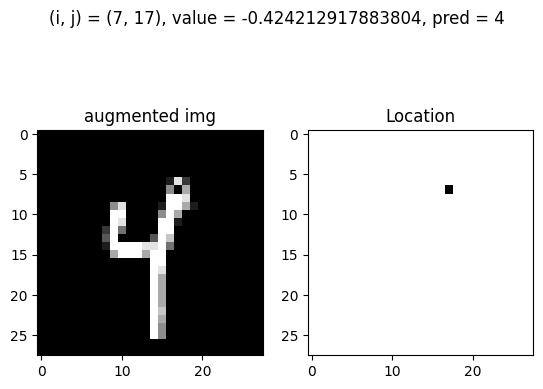

Test: At (i, j) = (7, 17) and value = -0.06357964585812692, pred = 4, before_pred = 9, gt = 4


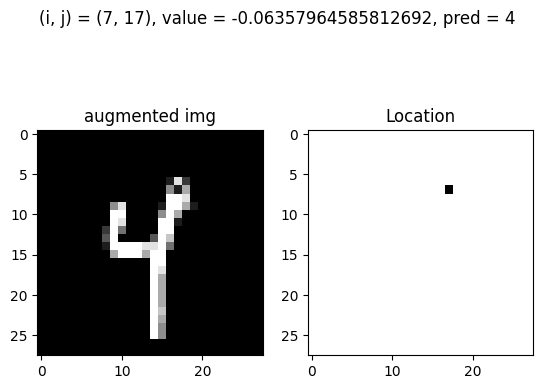

Test: At (i, j) = (7, 17) and value = 0.29705362616755016, pred = 4, before_pred = 9, gt = 4


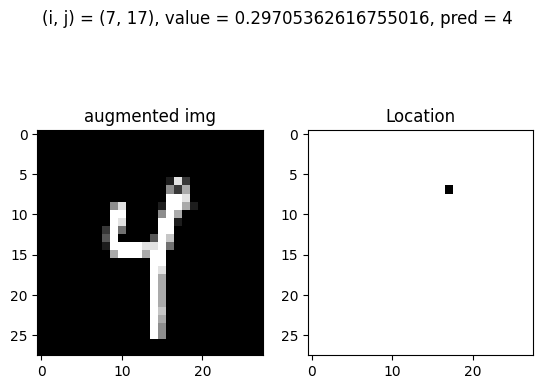

Test: At (i, j) = (7, 17) and value = 0.6576868981932272, pred = 4, before_pred = 9, gt = 4


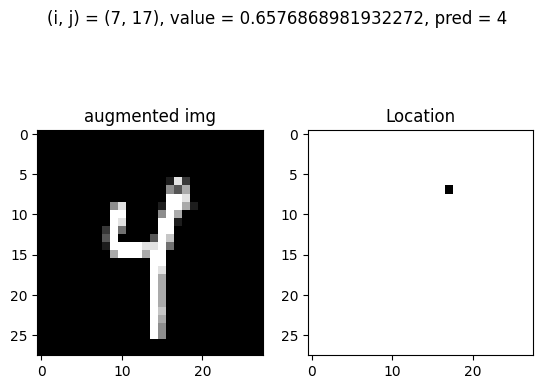

Test: At (i, j) = (7, 17) and value = 1.0183201702189044, pred = 4, before_pred = 9, gt = 4


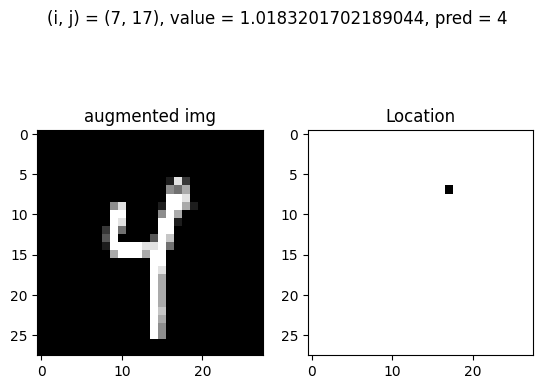

Test: At (i, j) = (7, 17) and value = 1.3789534422445815, pred = 4, before_pred = 9, gt = 4


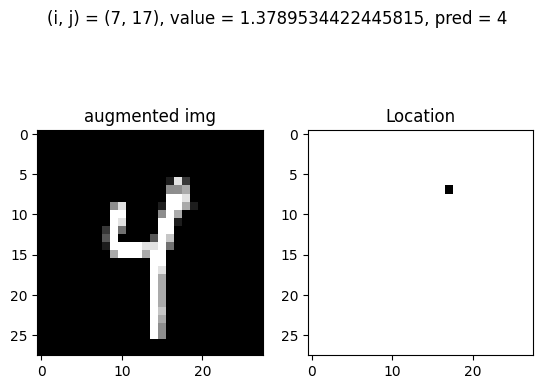

Test: At (i, j) = (7, 17) and value = 1.7395867142702586, pred = 4, before_pred = 9, gt = 4


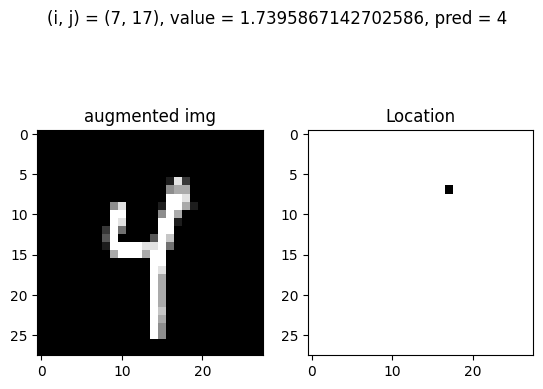

Test: At (i, j) = (8, 16) and value = -0.424212917883804, pred = 4, before_pred = 9, gt = 4


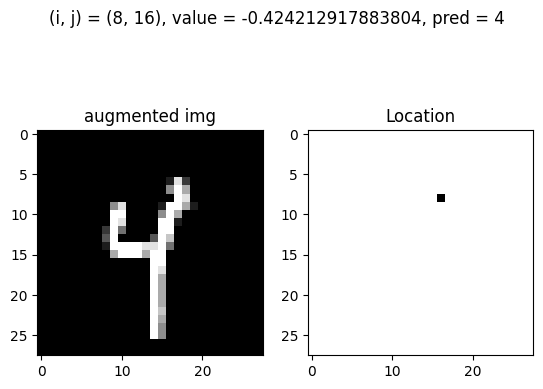

Test: At (i, j) = (8, 16) and value = -0.06357964585812692, pred = 4, before_pred = 9, gt = 4


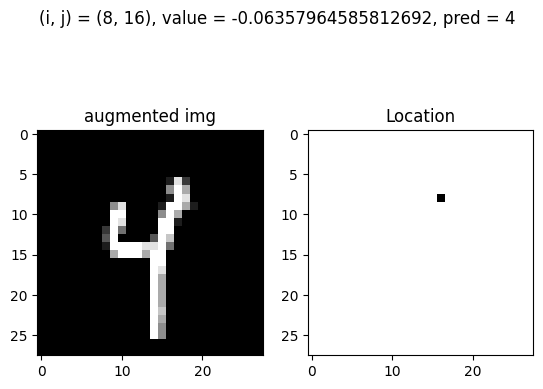

Test: At (i, j) = (8, 16) and value = 0.29705362616755016, pred = 4, before_pred = 9, gt = 4


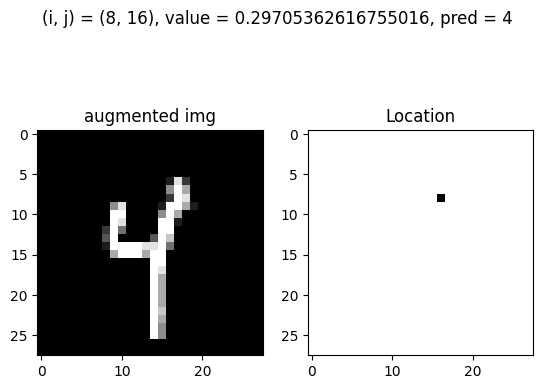

Test: At (i, j) = (8, 16) and value = 0.6576868981932272, pred = 4, before_pred = 9, gt = 4


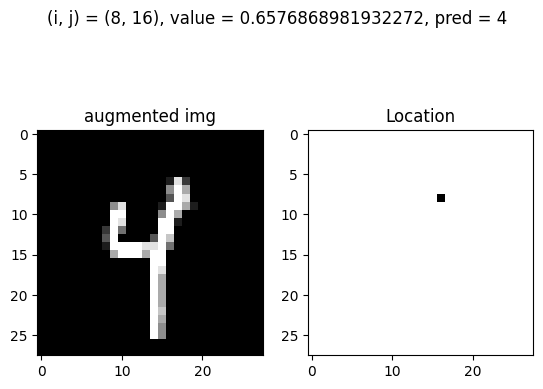

Test: At (i, j) = (8, 16) and value = 1.0183201702189044, pred = 4, before_pred = 9, gt = 4


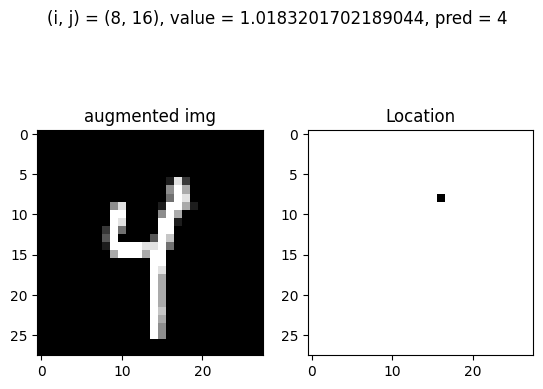

Test: At (i, j) = (8, 16) and value = 1.3789534422445815, pred = 4, before_pred = 9, gt = 4


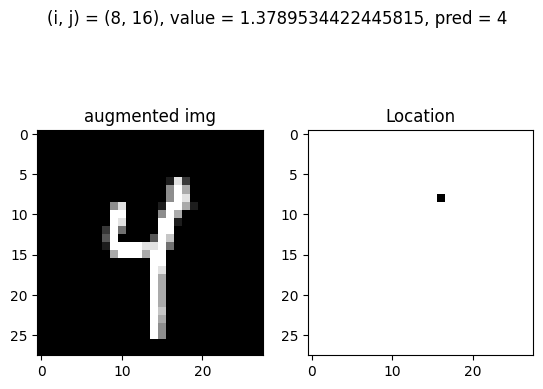

Test: At (i, j) = (8, 16) and value = 1.7395867142702586, pred = 4, before_pred = 9, gt = 4


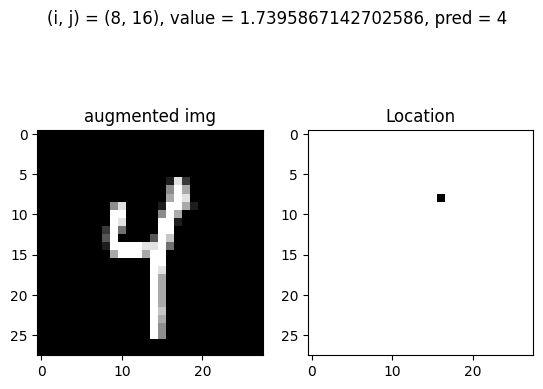

Test: At (i, j) = (8, 17) and value = -0.424212917883804, pred = 4, before_pred = 9, gt = 4


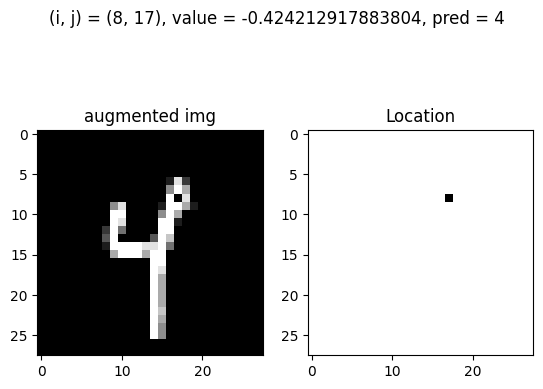

Test: At (i, j) = (8, 17) and value = -0.06357964585812692, pred = 4, before_pred = 9, gt = 4


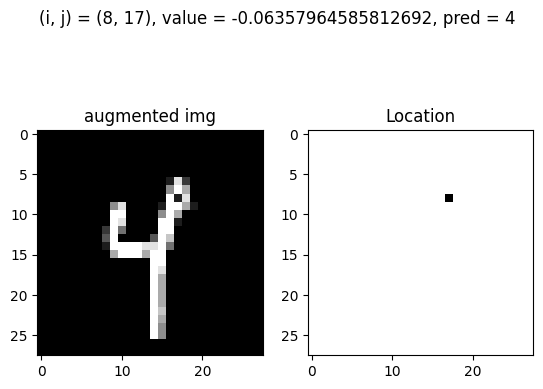

Test: At (i, j) = (8, 17) and value = 0.29705362616755016, pred = 4, before_pred = 9, gt = 4


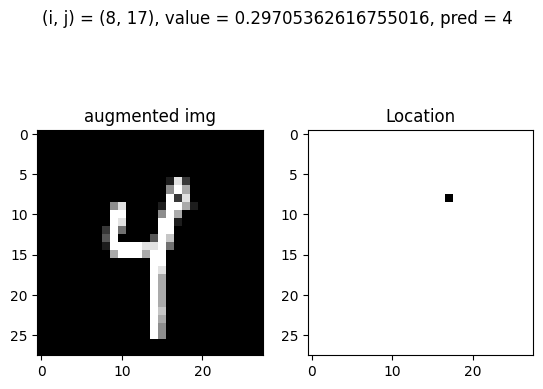

Test: At (i, j) = (8, 17) and value = 0.6576868981932272, pred = 4, before_pred = 9, gt = 4


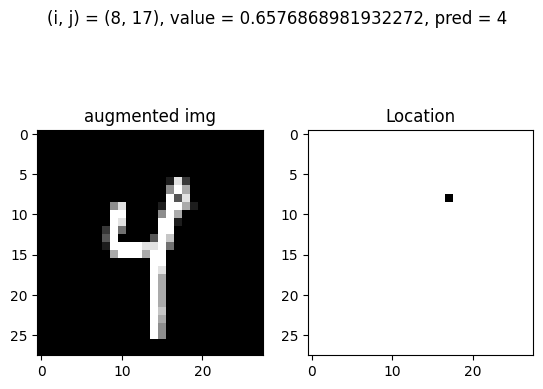

Test: At (i, j) = (8, 17) and value = 1.0183201702189044, pred = 4, before_pred = 9, gt = 4


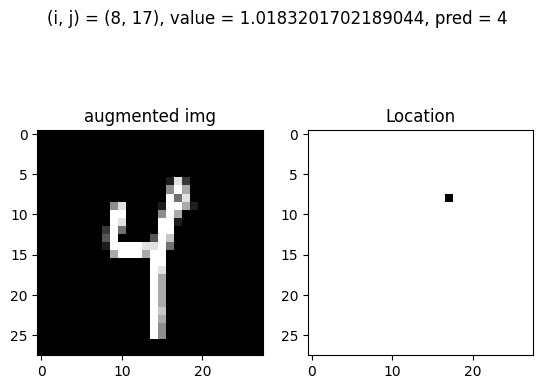

Test: At (i, j) = (8, 17) and value = 1.3789534422445815, pred = 4, before_pred = 9, gt = 4


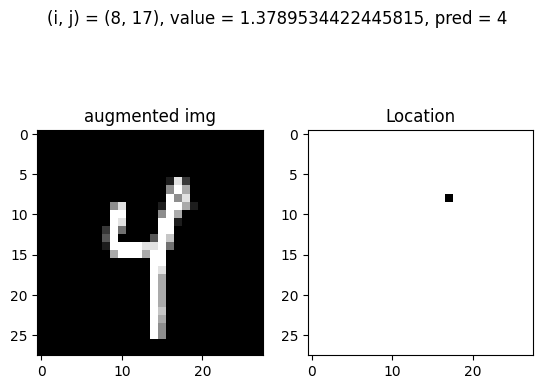

Test: At (i, j) = (8, 17) and value = 1.7395867142702586, pred = 4, before_pred = 9, gt = 4


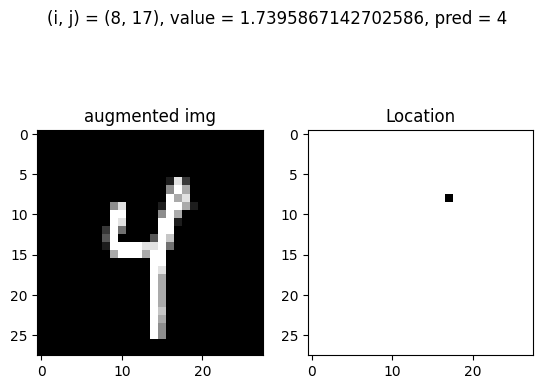

Test: At (i, j) = (8, 18) and value = -0.424212917883804, pred = 4, before_pred = 9, gt = 4


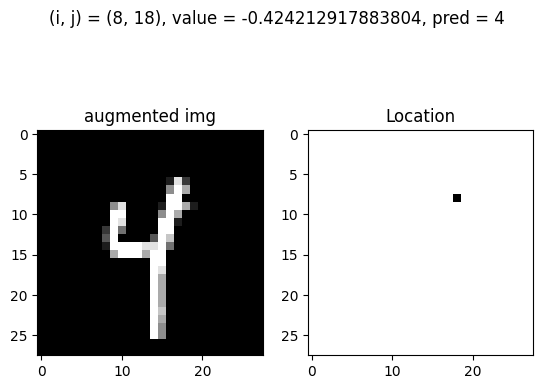

Test: At (i, j) = (8, 18) and value = -0.06357964585812692, pred = 4, before_pred = 9, gt = 4


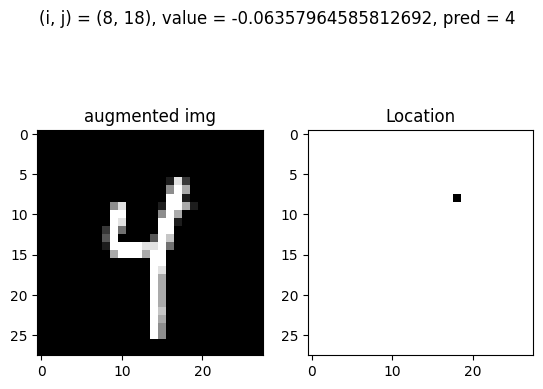

Test: At (i, j) = (8, 18) and value = 0.29705362616755016, pred = 4, before_pred = 9, gt = 4


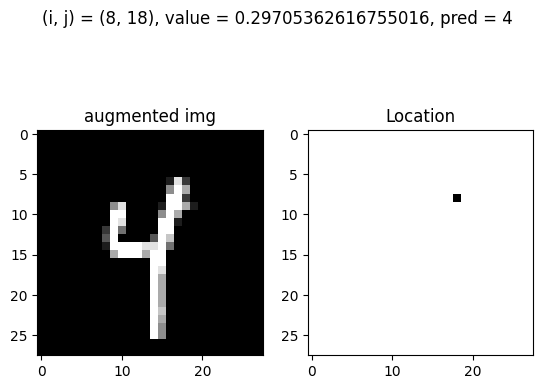

Test: At (i, j) = (8, 18) and value = 0.6576868981932272, pred = 4, before_pred = 9, gt = 4


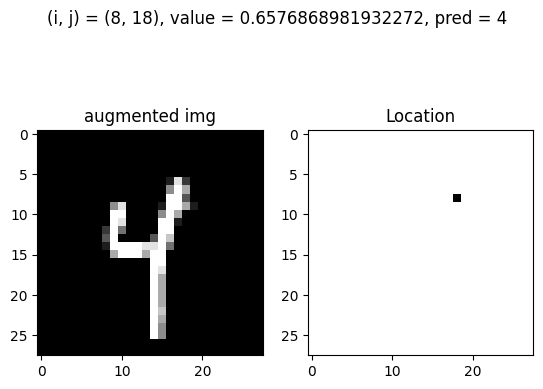

Test: At (i, j) = (8, 18) and value = 1.0183201702189044, pred = 4, before_pred = 9, gt = 4


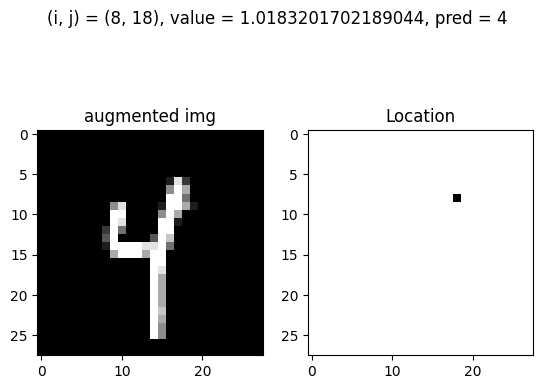

Test: At (i, j) = (9, 10) and value = -0.424212917883804, pred = 4, before_pred = 9, gt = 4


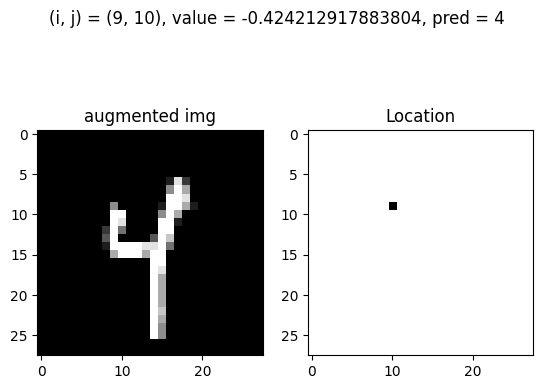

Test: At (i, j) = (9, 10) and value = -0.06357964585812692, pred = 4, before_pred = 9, gt = 4


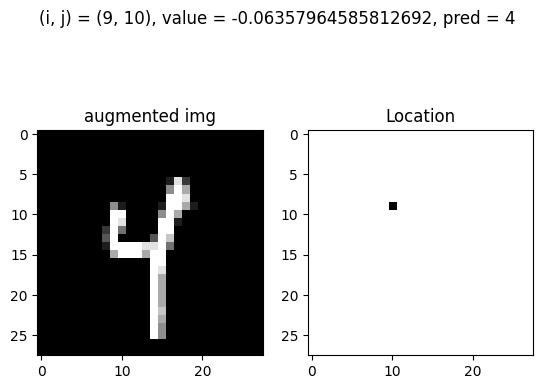

Test: At (i, j) = (9, 10) and value = 0.29705362616755016, pred = 4, before_pred = 9, gt = 4


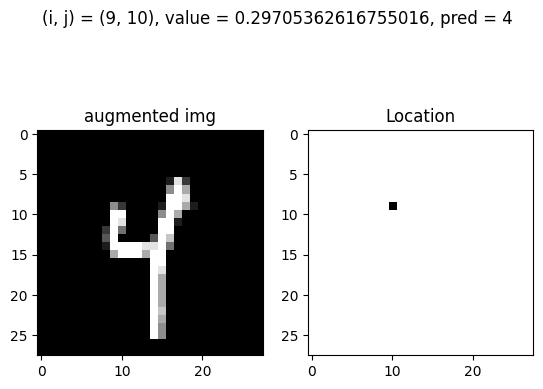

Test: At (i, j) = (9, 16) and value = -0.424212917883804, pred = 4, before_pred = 9, gt = 4


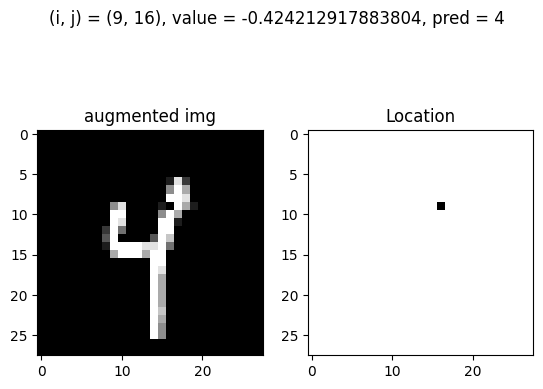

Test: At (i, j) = (9, 16) and value = -0.06357964585812692, pred = 4, before_pred = 9, gt = 4


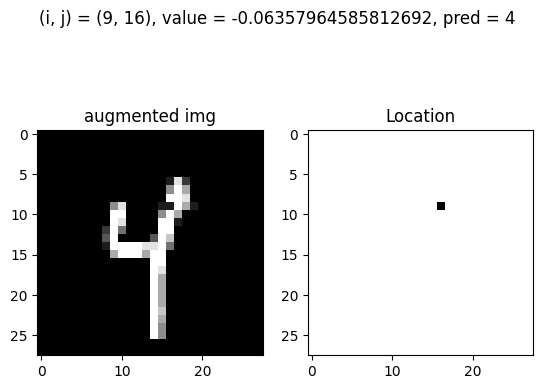

Test: At (i, j) = (9, 16) and value = 0.29705362616755016, pred = 4, before_pred = 9, gt = 4


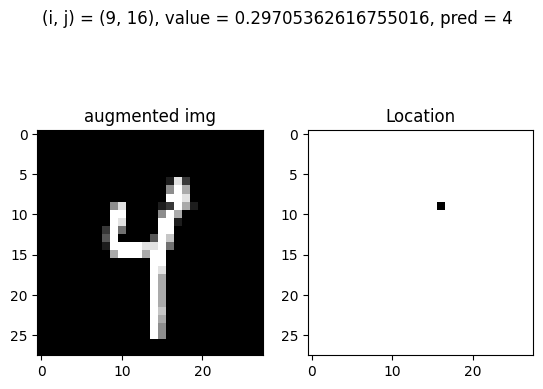

Test: At (i, j) = (9, 16) and value = 0.6576868981932272, pred = 4, before_pred = 9, gt = 4


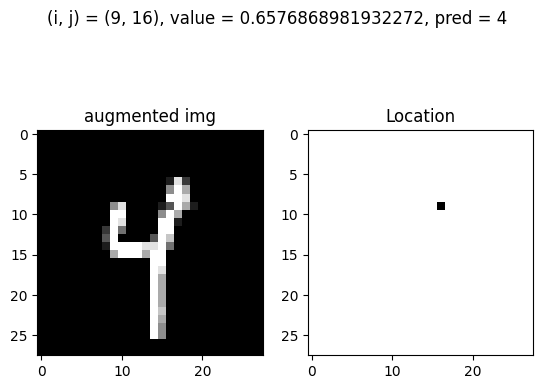

Test: At (i, j) = (9, 16) and value = 1.0183201702189044, pred = 4, before_pred = 9, gt = 4


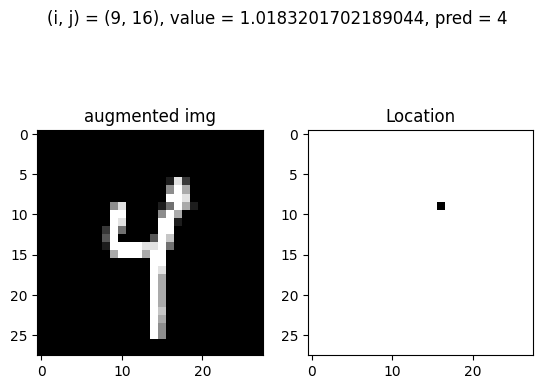

Test: At (i, j) = (9, 17) and value = -0.424212917883804, pred = 4, before_pred = 9, gt = 4


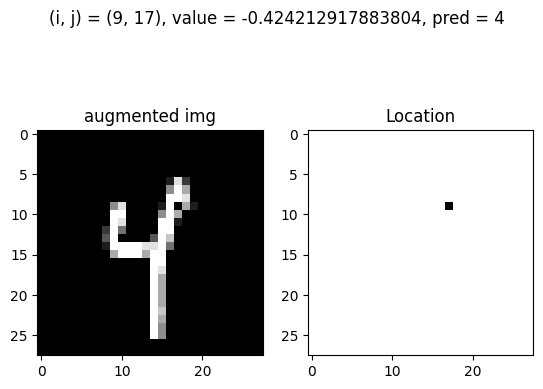

Test: At (i, j) = (9, 17) and value = -0.06357964585812692, pred = 4, before_pred = 9, gt = 4


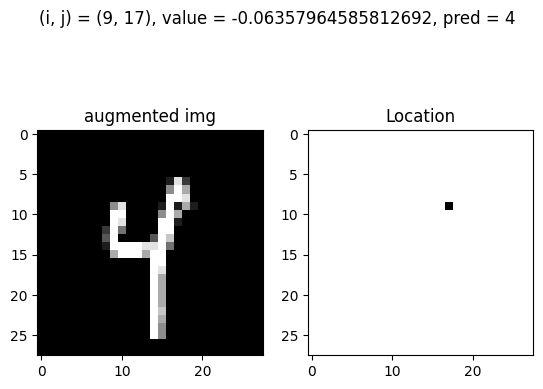

Test: At (i, j) = (9, 17) and value = 0.29705362616755016, pred = 4, before_pred = 9, gt = 4


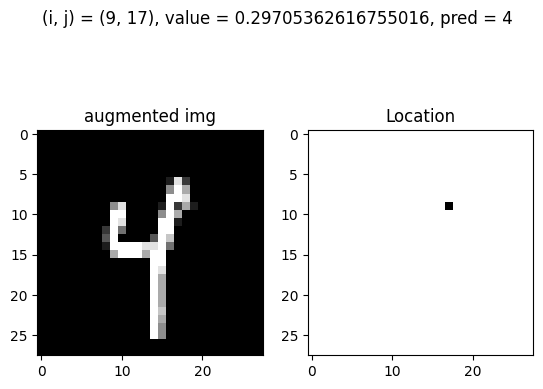

Test: At (i, j) = (10, 15) and value = -0.424212917883804, pred = 4, before_pred = 9, gt = 4


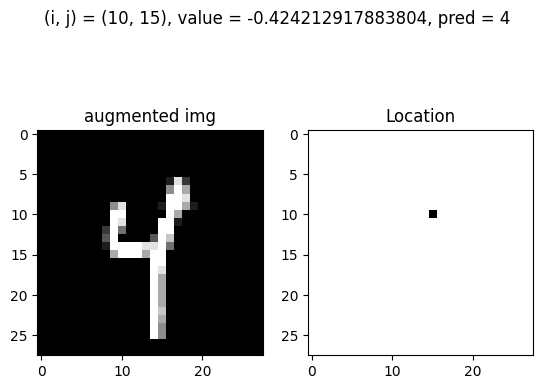

Test: At (i, j) = (10, 16) and value = -0.424212917883804, pred = 4, before_pred = 9, gt = 4


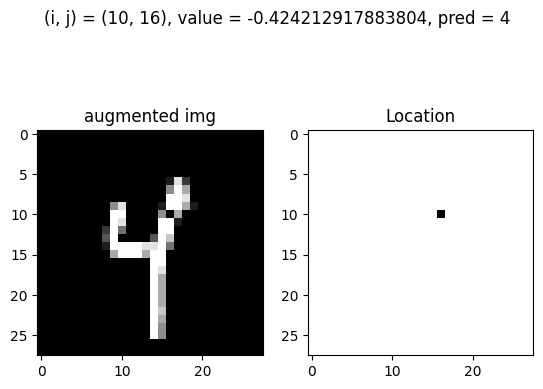

Test: At (i, j) = (10, 16) and value = -0.06357964585812692, pred = 4, before_pred = 9, gt = 4


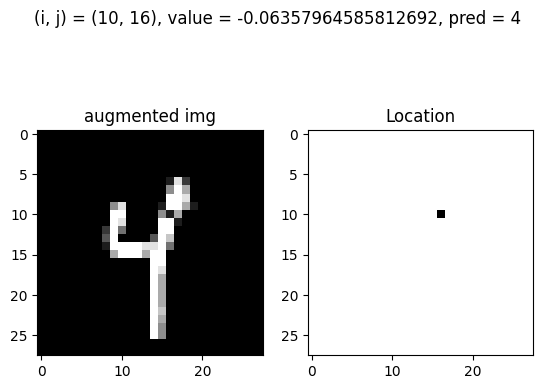

Test: At (i, j) = (10, 16) and value = 0.29705362616755016, pred = 4, before_pred = 9, gt = 4


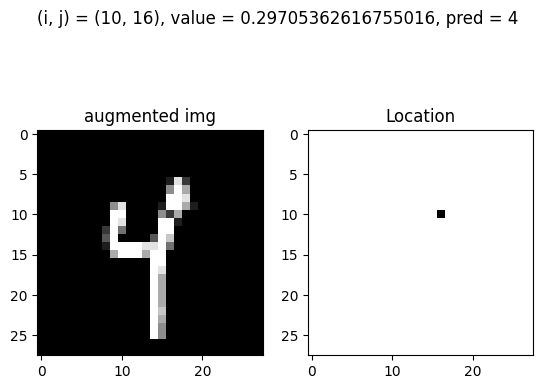

Test: At (i, j) = (10, 16) and value = 0.6576868981932272, pred = 4, before_pred = 9, gt = 4


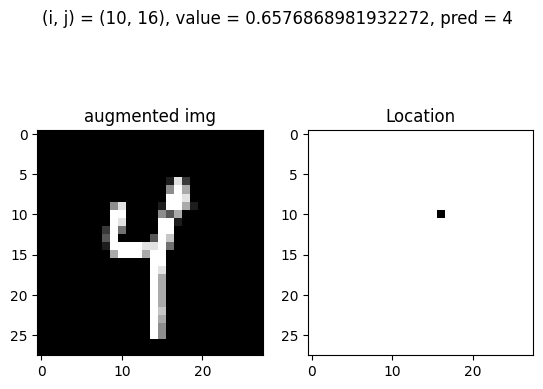

Test: At (i, j) = (11, 15) and value = -0.424212917883804, pred = 4, before_pred = 9, gt = 4


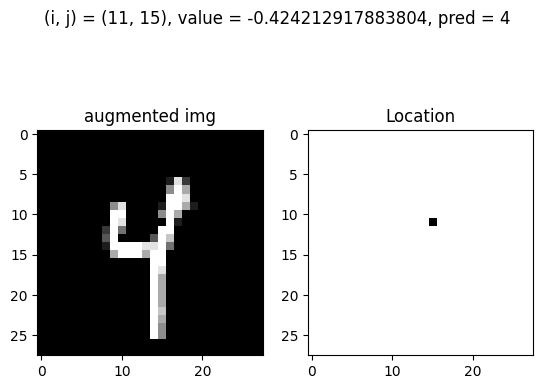

Test: At (i, j) = (11, 15) and value = -0.06357964585812692, pred = 4, before_pred = 9, gt = 4


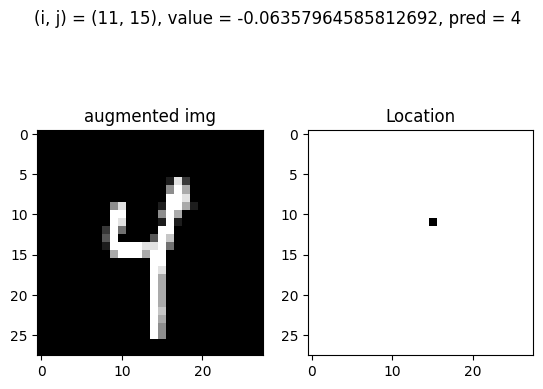

Test: At (i, j) = (11, 15) and value = 0.29705362616755016, pred = 4, before_pred = 9, gt = 4


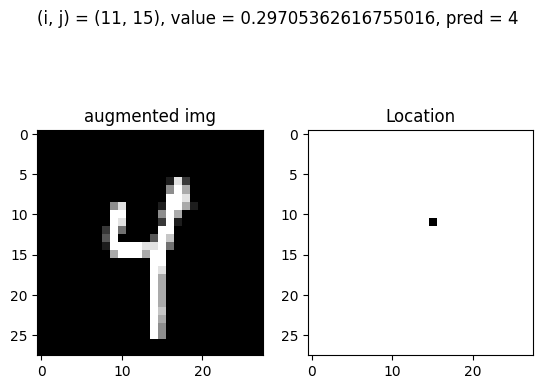

Test: At (i, j) = (11, 15) and value = 0.6576868981932272, pred = 4, before_pred = 9, gt = 4


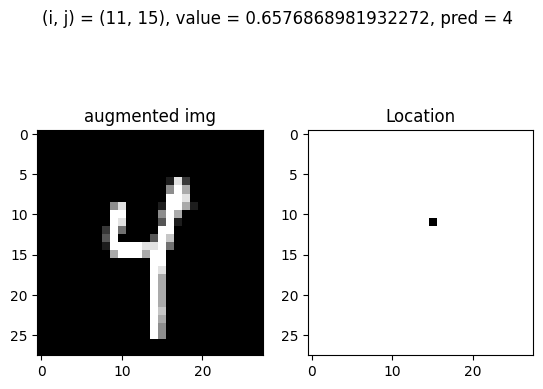

Test: At (i, j) = (11, 15) and value = 1.0183201702189044, pred = 4, before_pred = 9, gt = 4


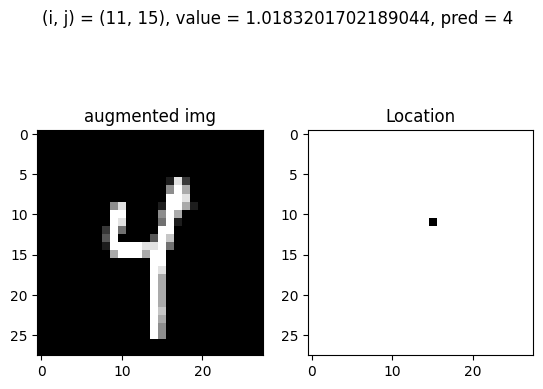

Test: At (i, j) = (12, 2) and value = 2.82148653034729, pred = 4, before_pred = 9, gt = 4


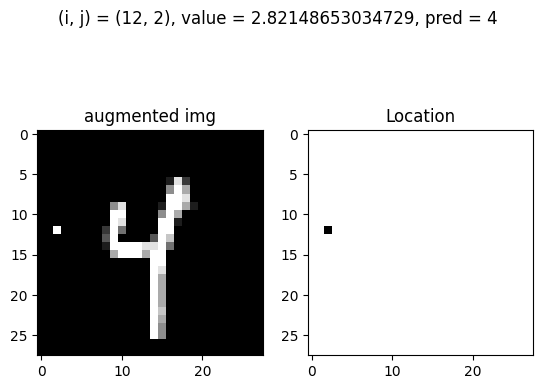

Test: At (i, j) = (12, 11) and value = 2.1002199862959356, pred = 4, before_pred = 9, gt = 4


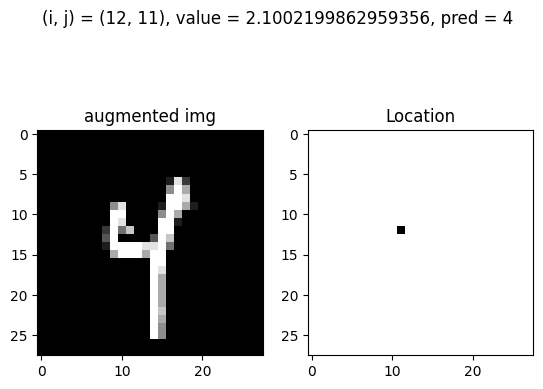

Test: At (i, j) = (12, 11) and value = 2.4608532583216127, pred = 4, before_pred = 9, gt = 4


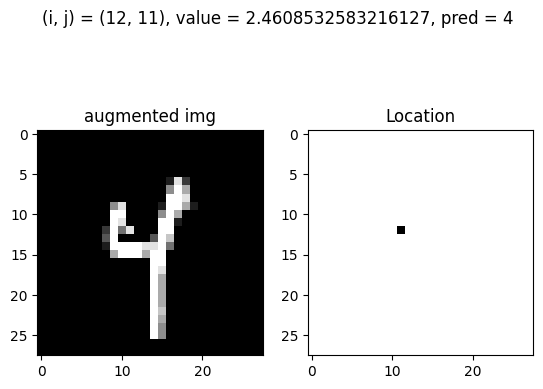

Test: At (i, j) = (12, 11) and value = 2.82148653034729, pred = 4, before_pred = 9, gt = 4


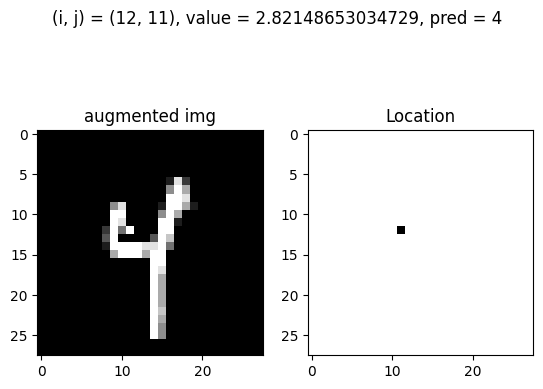

Test: At (i, j) = (12, 12) and value = 1.7395867142702586, pred = 4, before_pred = 9, gt = 4


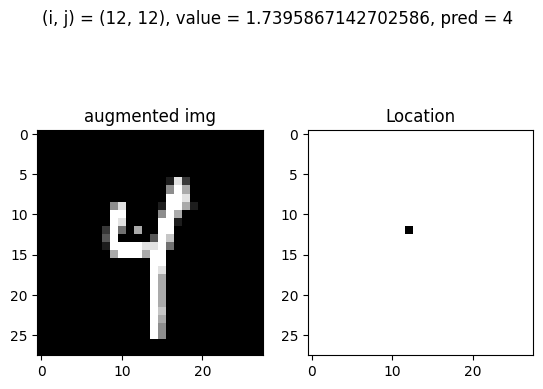

Test: At (i, j) = (12, 12) and value = 2.1002199862959356, pred = 4, before_pred = 9, gt = 4


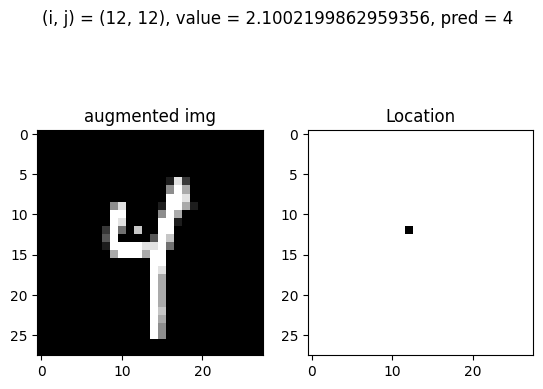

Test: At (i, j) = (12, 12) and value = 2.4608532583216127, pred = 4, before_pred = 9, gt = 4


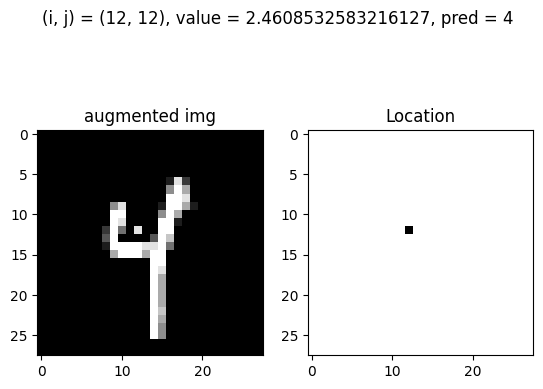

Test: At (i, j) = (12, 12) and value = 2.82148653034729, pred = 4, before_pred = 9, gt = 4


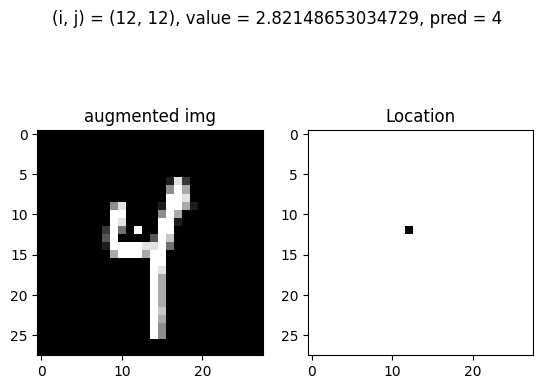

Test: At (i, j) = (12, 13) and value = 2.82148653034729, pred = 4, before_pred = 9, gt = 4


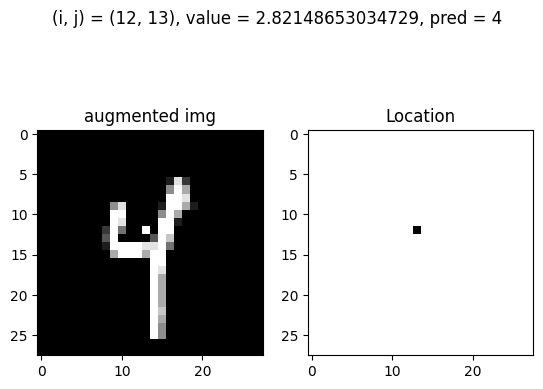

Test: At (i, j) = (13, 10) and value = 1.7395867142702586, pred = 4, before_pred = 9, gt = 4


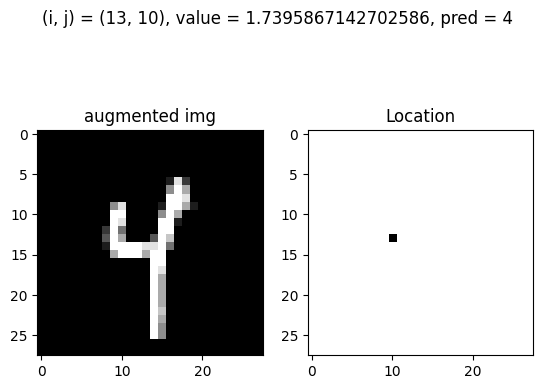

Test: At (i, j) = (13, 10) and value = 2.1002199862959356, pred = 4, before_pred = 9, gt = 4


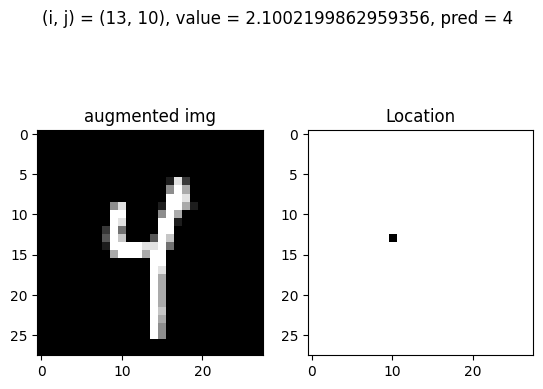

Test: At (i, j) = (13, 10) and value = 2.4608532583216127, pred = 4, before_pred = 9, gt = 4


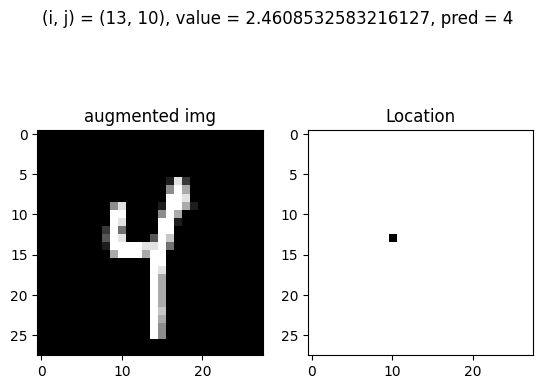

Test: At (i, j) = (13, 10) and value = 2.82148653034729, pred = 4, before_pred = 9, gt = 4


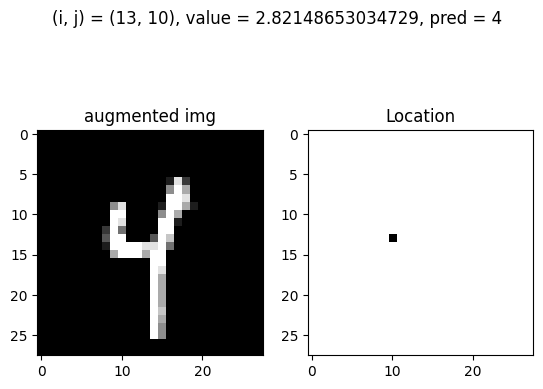

Test: At (i, j) = (13, 11) and value = 1.0183201702189044, pred = 4, before_pred = 9, gt = 4


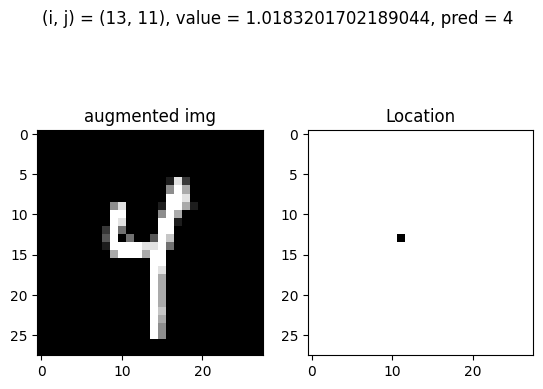

Test: At (i, j) = (13, 11) and value = 1.3789534422445815, pred = 4, before_pred = 9, gt = 4


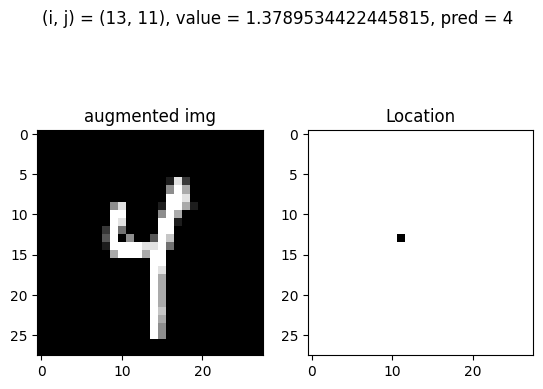

Test: At (i, j) = (13, 11) and value = 1.7395867142702586, pred = 4, before_pred = 9, gt = 4


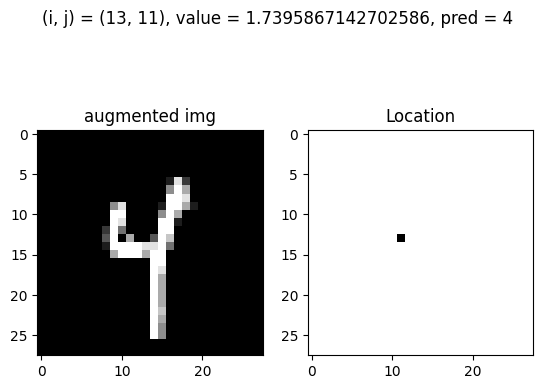

Test: At (i, j) = (13, 11) and value = 2.1002199862959356, pred = 4, before_pred = 9, gt = 4


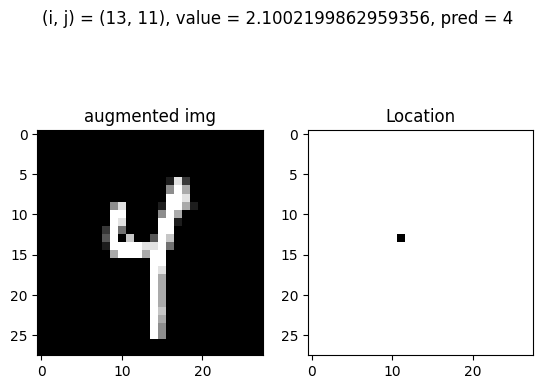

Test: At (i, j) = (13, 11) and value = 2.4608532583216127, pred = 4, before_pred = 9, gt = 4


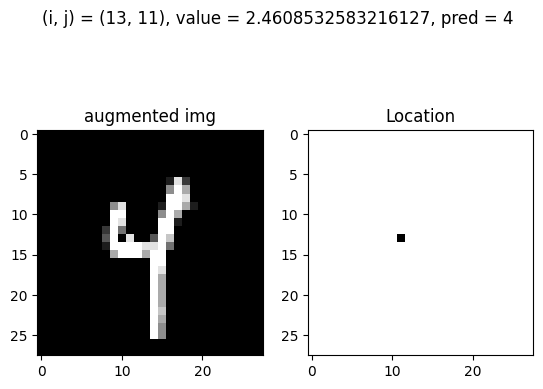

Test: At (i, j) = (13, 11) and value = 2.82148653034729, pred = 4, before_pred = 9, gt = 4


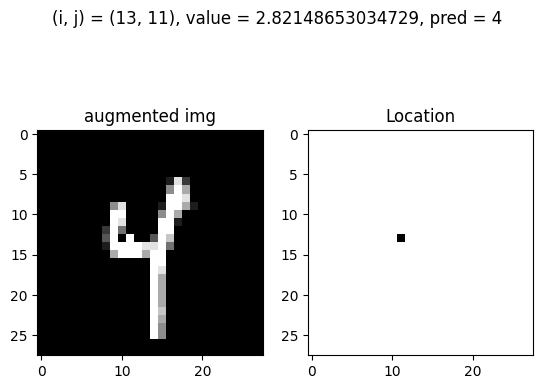

Test: At (i, j) = (13, 12) and value = 2.1002199862959356, pred = 4, before_pred = 9, gt = 4


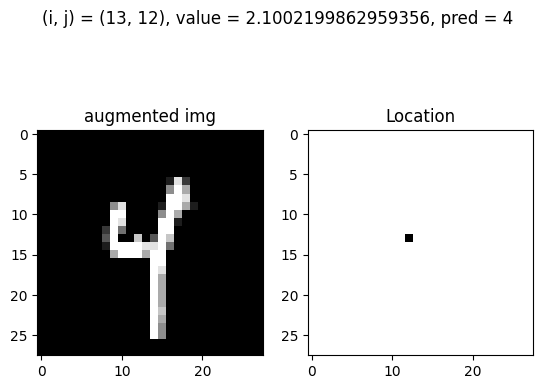

Test: At (i, j) = (13, 12) and value = 2.4608532583216127, pred = 4, before_pred = 9, gt = 4


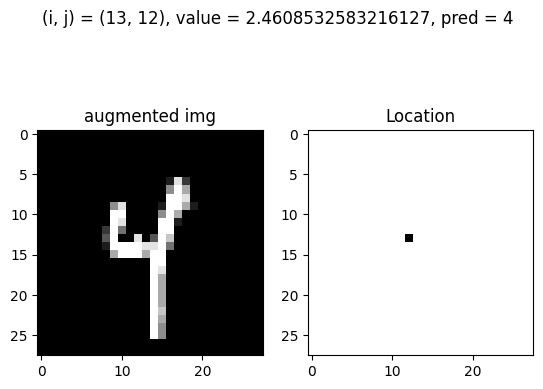

Test: At (i, j) = (13, 12) and value = 2.82148653034729, pred = 4, before_pred = 9, gt = 4


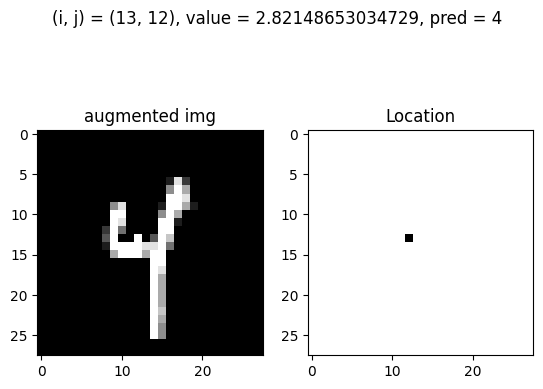

Test: At (i, j) = (14, 7) and value = 2.82148653034729, pred = 4, before_pred = 9, gt = 4


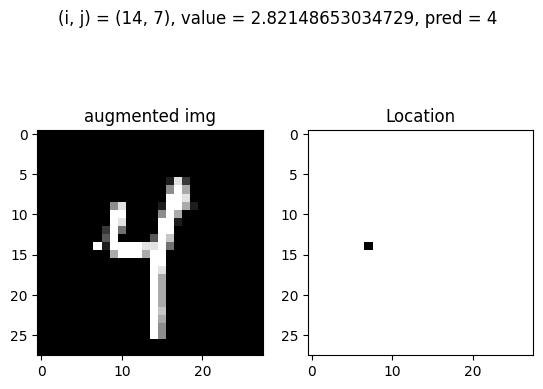

Test: At (i, j) = (14, 17) and value = 2.4608532583216127, pred = 4, before_pred = 9, gt = 4


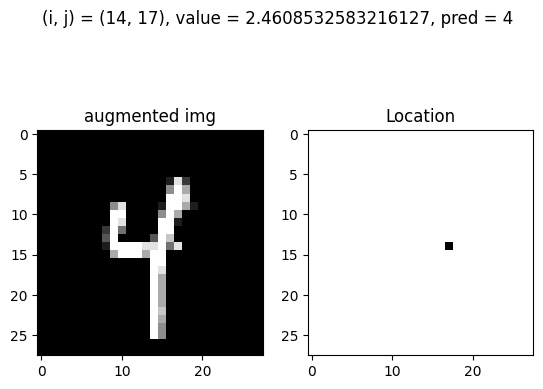

Test: At (i, j) = (14, 17) and value = 2.82148653034729, pred = 4, before_pred = 9, gt = 4


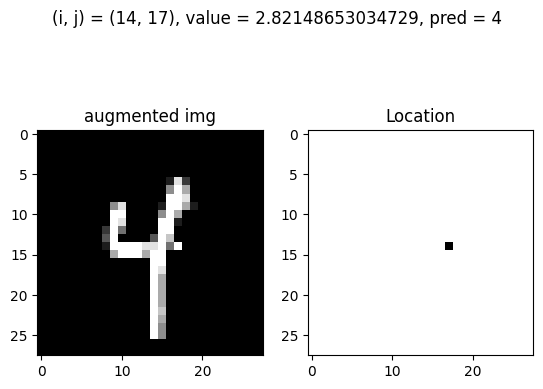

Test: At (i, j) = (15, 7) and value = 2.4608532583216127, pred = 4, before_pred = 9, gt = 4


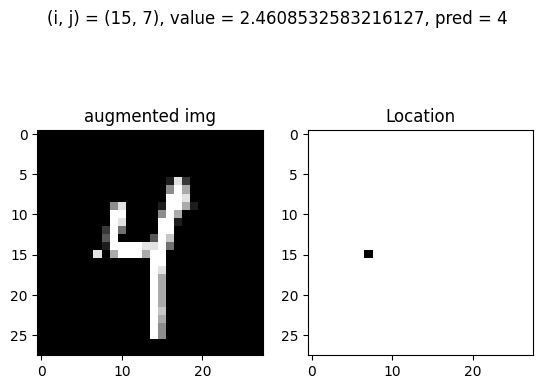

Test: At (i, j) = (15, 7) and value = 2.82148653034729, pred = 4, before_pred = 9, gt = 4


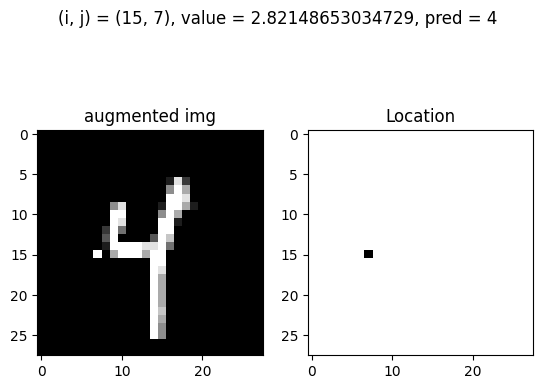

Test: At (i, j) = (15, 8) and value = 2.1002199862959356, pred = 4, before_pred = 9, gt = 4


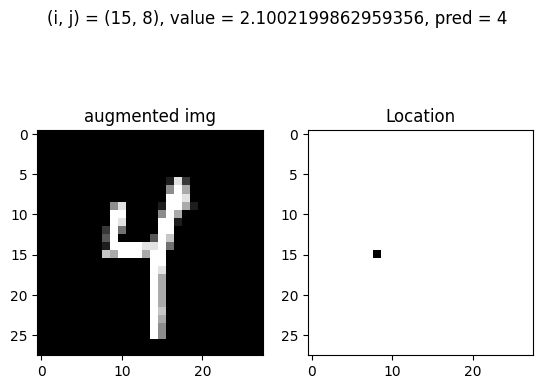

Test: At (i, j) = (15, 8) and value = 2.4608532583216127, pred = 4, before_pred = 9, gt = 4


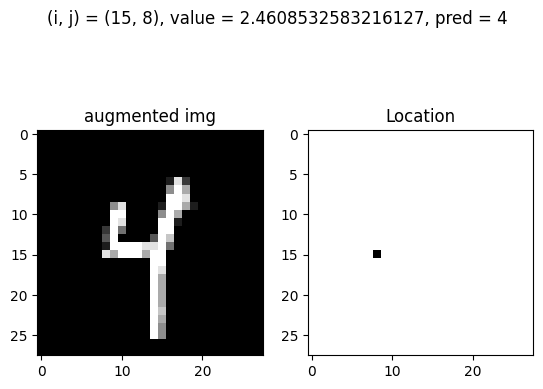

Test: At (i, j) = (15, 8) and value = 2.82148653034729, pred = 4, before_pred = 9, gt = 4


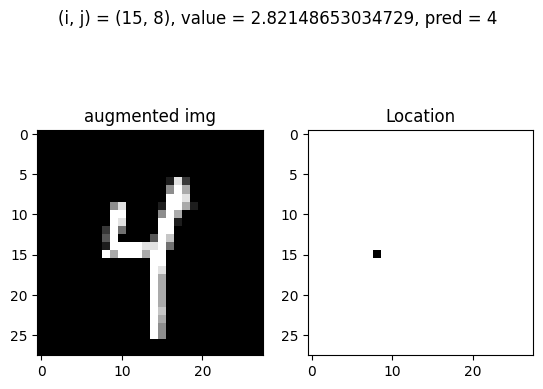

Test: At (i, j) = (15, 16) and value = 1.7395867142702586, pred = 4, before_pred = 9, gt = 4


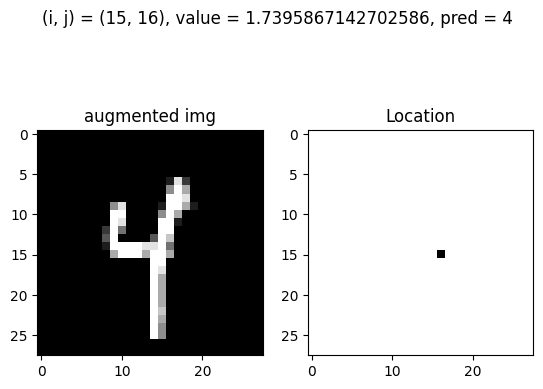

Test: At (i, j) = (15, 16) and value = 2.1002199862959356, pred = 4, before_pred = 9, gt = 4


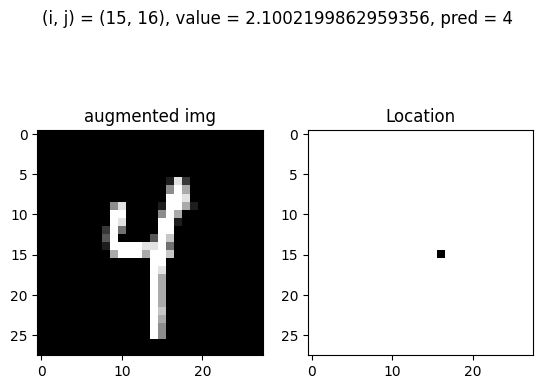

Test: At (i, j) = (15, 16) and value = 2.4608532583216127, pred = 4, before_pred = 9, gt = 4


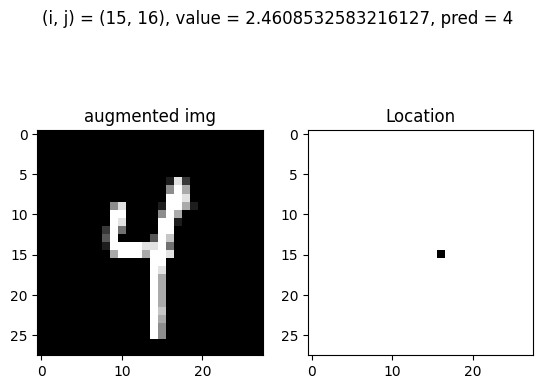

Test: At (i, j) = (15, 16) and value = 2.82148653034729, pred = 4, before_pred = 9, gt = 4


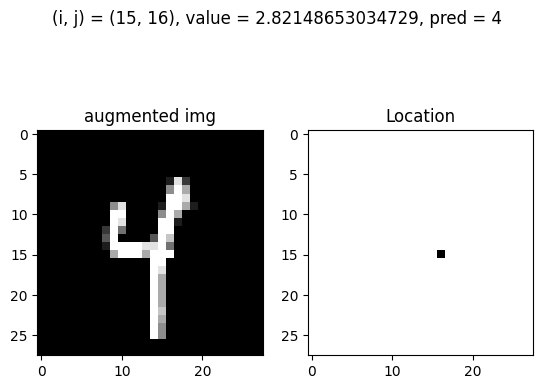

Test: At (i, j) = (15, 17) and value = 2.4608532583216127, pred = 4, before_pred = 9, gt = 4


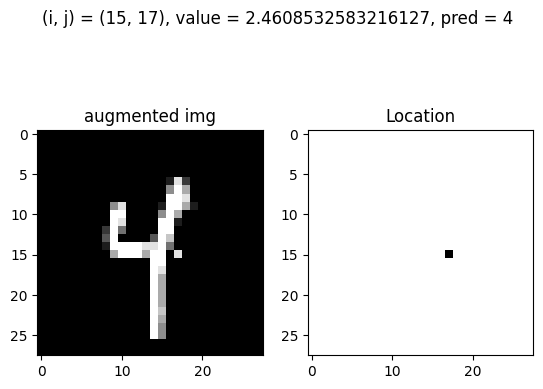

Test: At (i, j) = (15, 17) and value = 2.82148653034729, pred = 4, before_pred = 9, gt = 4


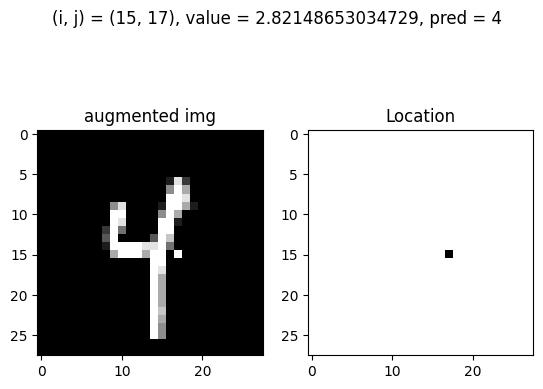

Test: At (i, j) = (15, 18) and value = 2.82148653034729, pred = 4, before_pred = 9, gt = 4


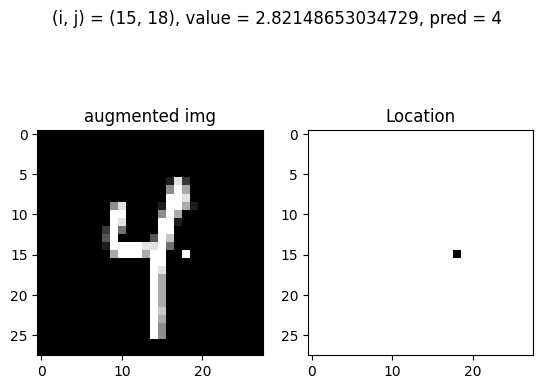

Test: At (i, j) = (15, 20) and value = 2.82148653034729, pred = 4, before_pred = 9, gt = 4


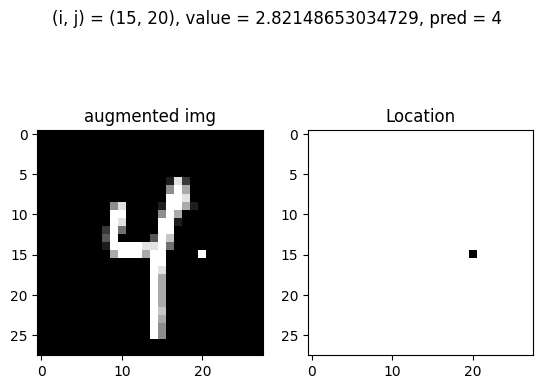

Test: At (i, j) = (16, 6) and value = 2.4608532583216127, pred = 4, before_pred = 9, gt = 4


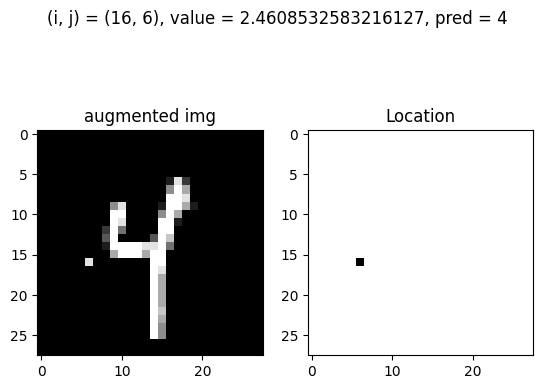

Test: At (i, j) = (16, 6) and value = 2.82148653034729, pred = 4, before_pred = 9, gt = 4


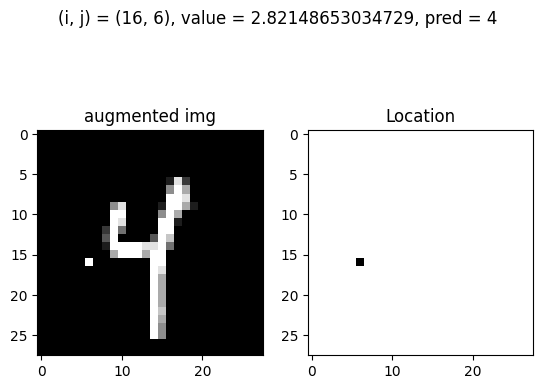

Test: At (i, j) = (16, 7) and value = 1.3789534422445815, pred = 4, before_pred = 9, gt = 4


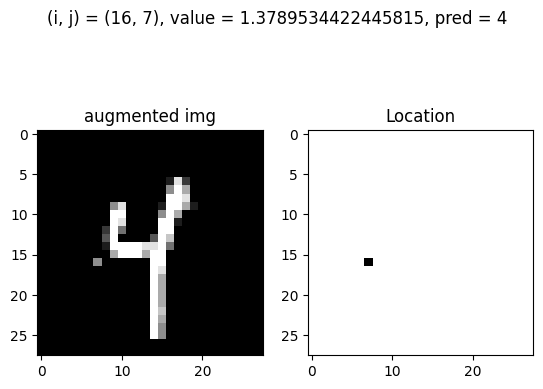

Test: At (i, j) = (16, 7) and value = 1.7395867142702586, pred = 4, before_pred = 9, gt = 4


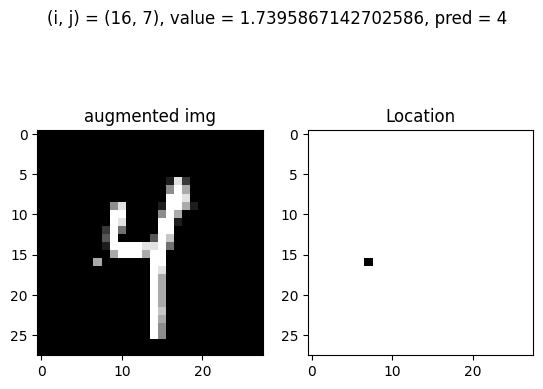

Test: At (i, j) = (16, 7) and value = 2.1002199862959356, pred = 4, before_pred = 9, gt = 4


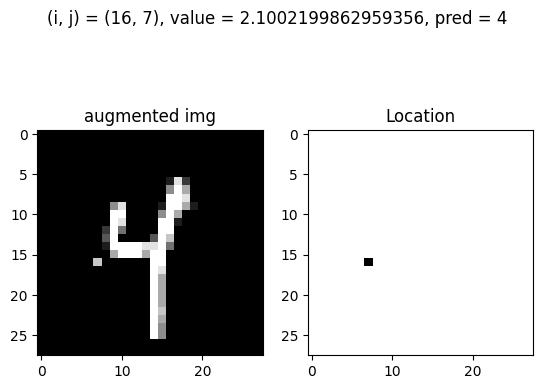

Test: At (i, j) = (16, 7) and value = 2.4608532583216127, pred = 4, before_pred = 9, gt = 4


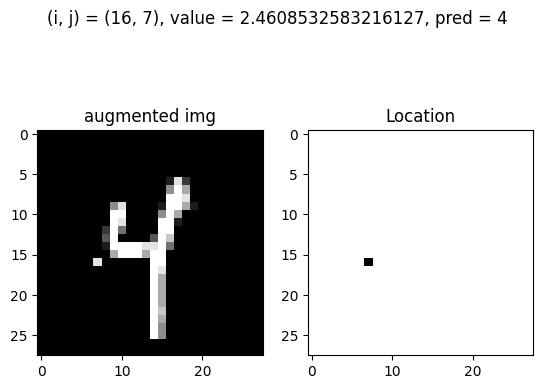

Test: At (i, j) = (16, 7) and value = 2.82148653034729, pred = 4, before_pred = 9, gt = 4


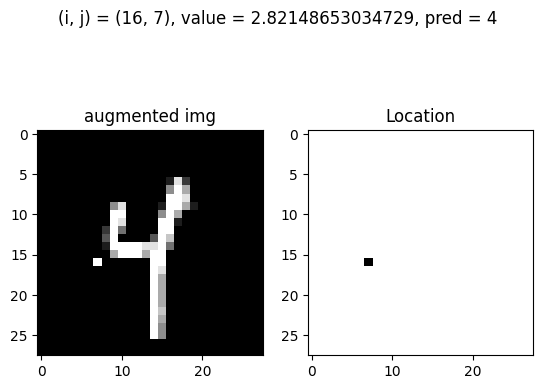

Test: At (i, j) = (16, 9) and value = 2.1002199862959356, pred = 4, before_pred = 9, gt = 4


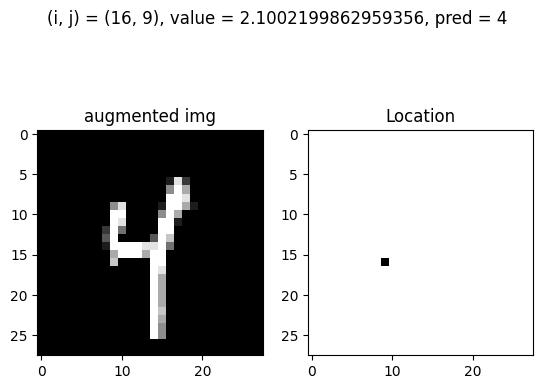

Test: At (i, j) = (16, 9) and value = 2.4608532583216127, pred = 4, before_pred = 9, gt = 4


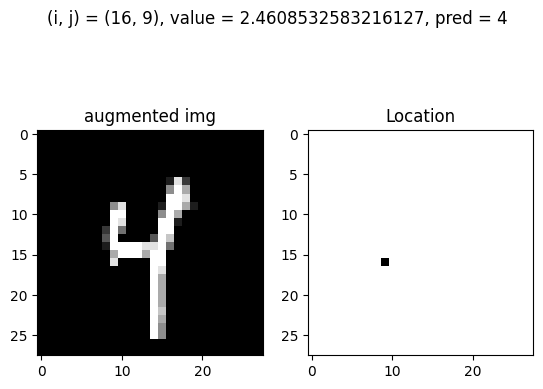

Test: At (i, j) = (16, 9) and value = 2.82148653034729, pred = 4, before_pred = 9, gt = 4


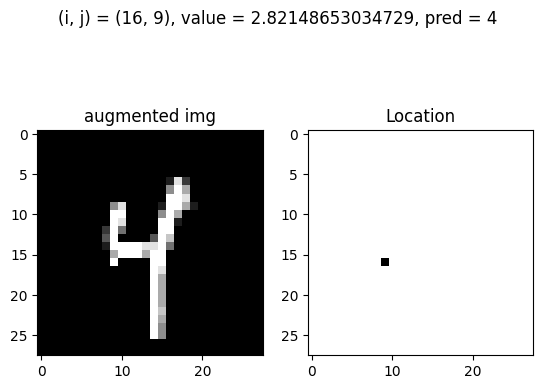

Test: At (i, j) = (16, 11) and value = 1.3789534422445815, pred = 4, before_pred = 9, gt = 4


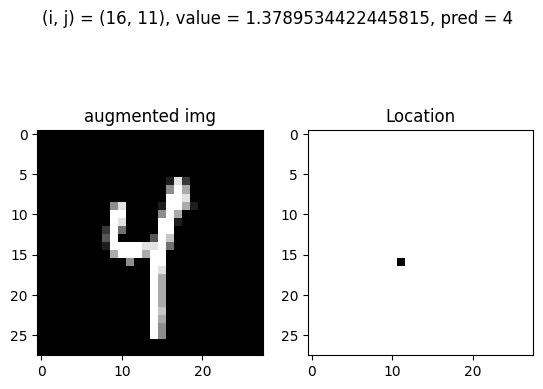

Test: At (i, j) = (16, 11) and value = 1.7395867142702586, pred = 4, before_pred = 9, gt = 4


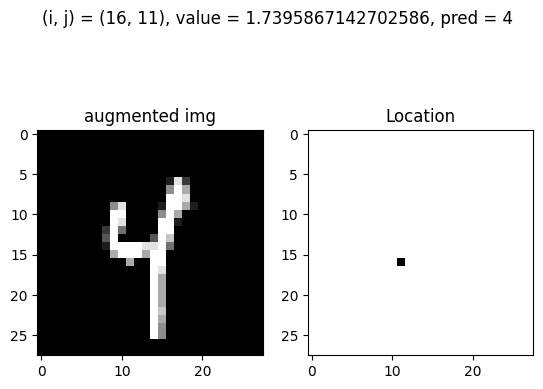

Test: At (i, j) = (16, 11) and value = 2.1002199862959356, pred = 4, before_pred = 9, gt = 4


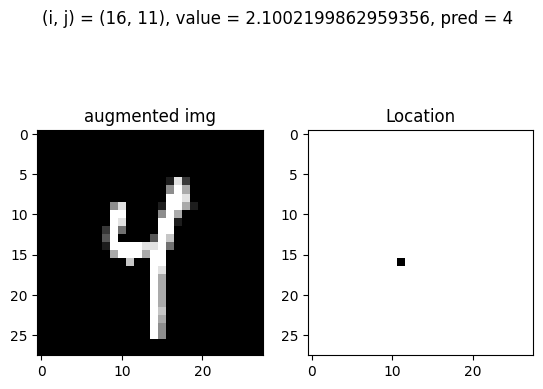

Test: At (i, j) = (16, 11) and value = 2.4608532583216127, pred = 4, before_pred = 9, gt = 4


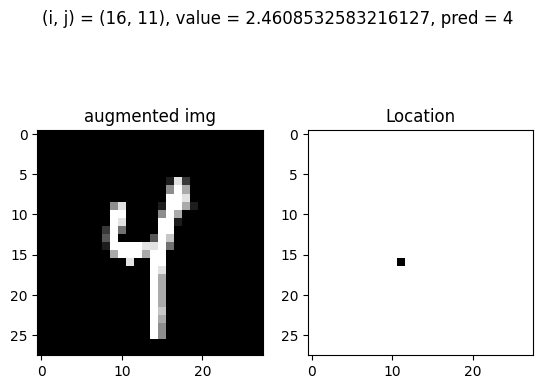

Test: At (i, j) = (16, 11) and value = 2.82148653034729, pred = 4, before_pred = 9, gt = 4


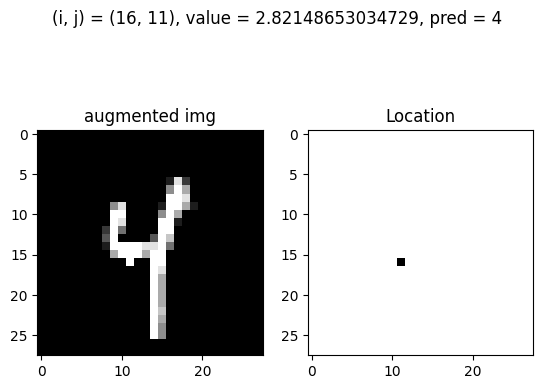

Test: At (i, j) = (16, 12) and value = 2.1002199862959356, pred = 4, before_pred = 9, gt = 4


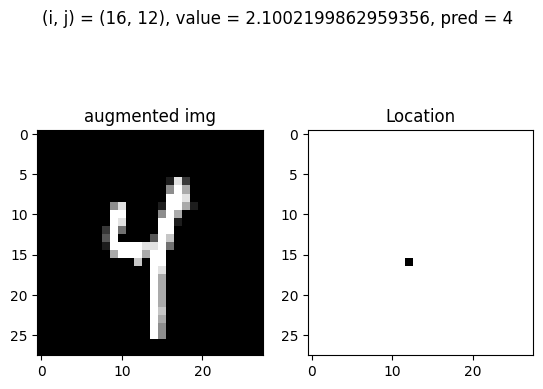

Test: At (i, j) = (16, 12) and value = 2.4608532583216127, pred = 4, before_pred = 9, gt = 4


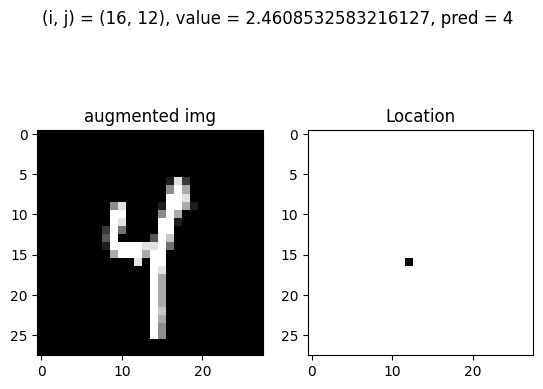

Test: At (i, j) = (16, 12) and value = 2.82148653034729, pred = 4, before_pred = 9, gt = 4


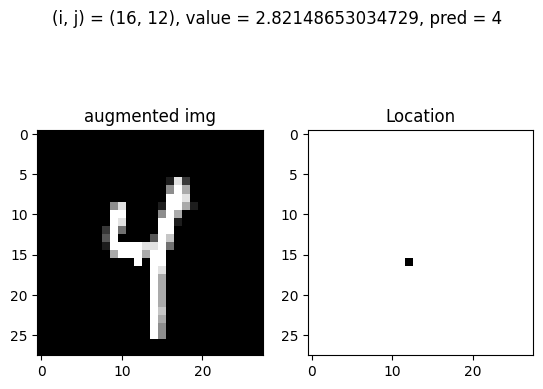

Test: At (i, j) = (16, 13) and value = 2.1002199862959356, pred = 4, before_pred = 9, gt = 4


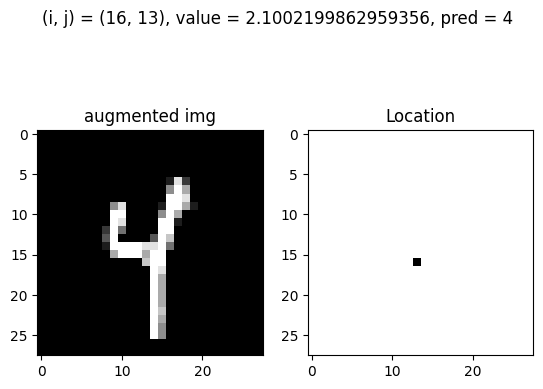

Test: At (i, j) = (16, 13) and value = 2.4608532583216127, pred = 4, before_pred = 9, gt = 4


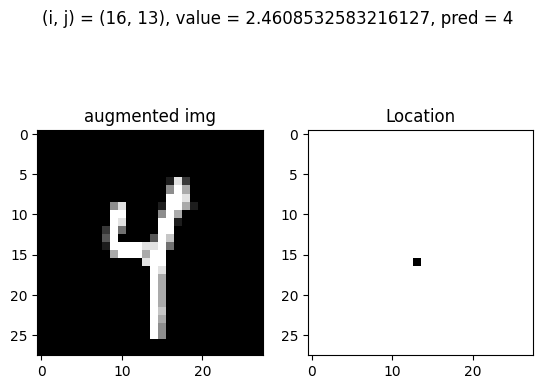

Test: At (i, j) = (16, 13) and value = 2.82148653034729, pred = 4, before_pred = 9, gt = 4


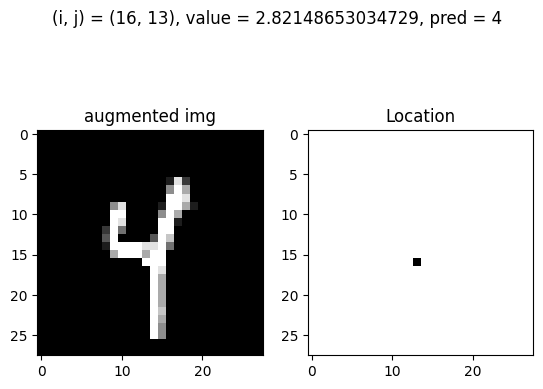

Test: At (i, j) = (16, 16) and value = 2.1002199862959356, pred = 4, before_pred = 9, gt = 4


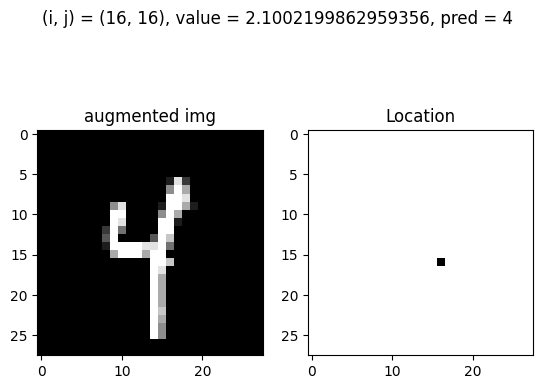

Test: At (i, j) = (16, 16) and value = 2.4608532583216127, pred = 4, before_pred = 9, gt = 4


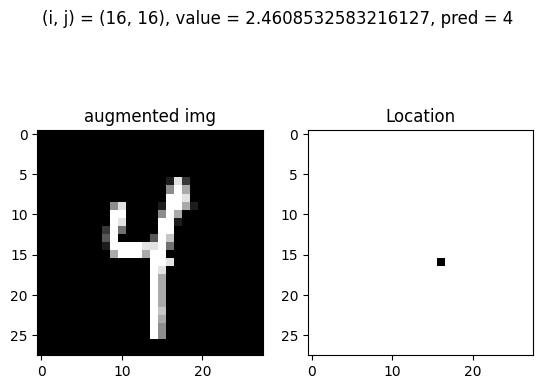

Test: At (i, j) = (16, 16) and value = 2.82148653034729, pred = 4, before_pred = 9, gt = 4


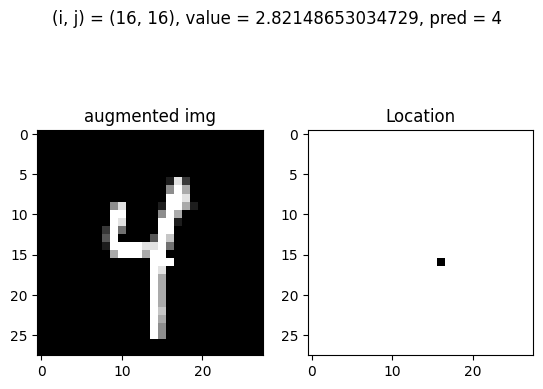

Test: At (i, j) = (16, 20) and value = 2.4608532583216127, pred = 4, before_pred = 9, gt = 4


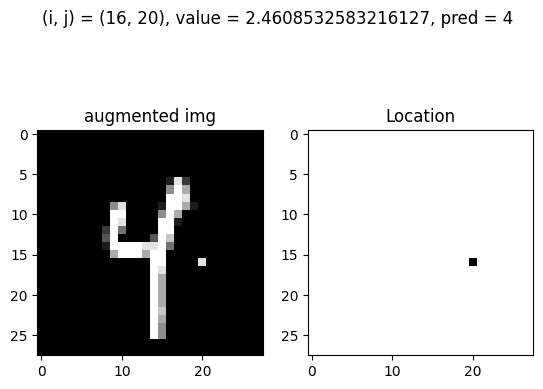

Test: At (i, j) = (16, 20) and value = 2.82148653034729, pred = 4, before_pred = 9, gt = 4


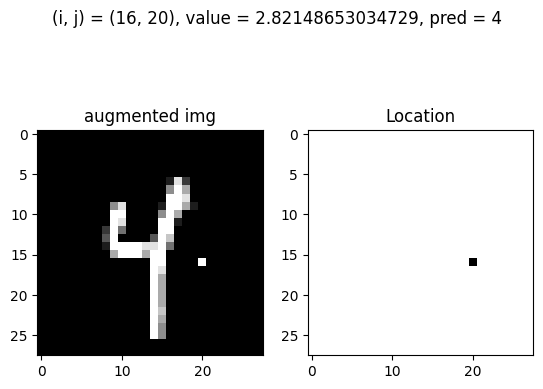

Test: At (i, j) = (17, 7) and value = 2.1002199862959356, pred = 4, before_pred = 9, gt = 4


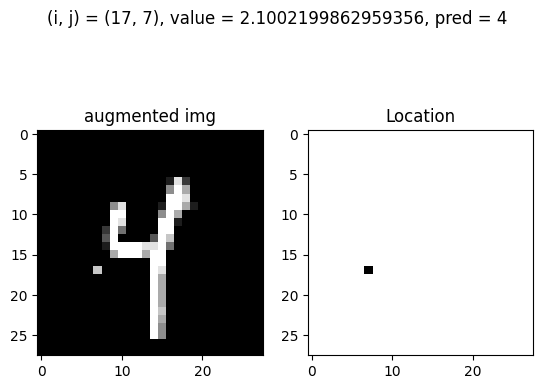

Test: At (i, j) = (17, 7) and value = 2.4608532583216127, pred = 4, before_pred = 9, gt = 4


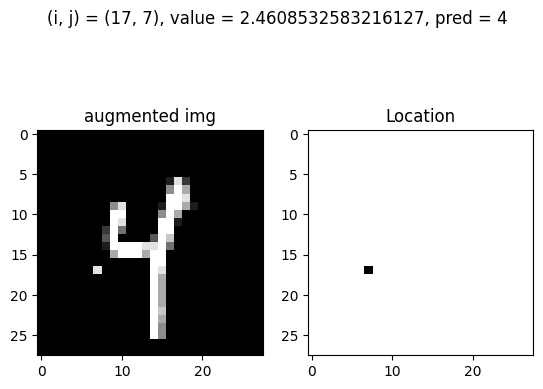

Test: At (i, j) = (17, 7) and value = 2.82148653034729, pred = 4, before_pred = 9, gt = 4


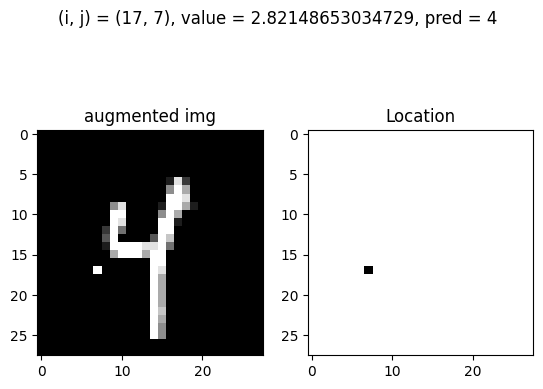

Test: At (i, j) = (17, 9) and value = 1.7395867142702586, pred = 4, before_pred = 9, gt = 4


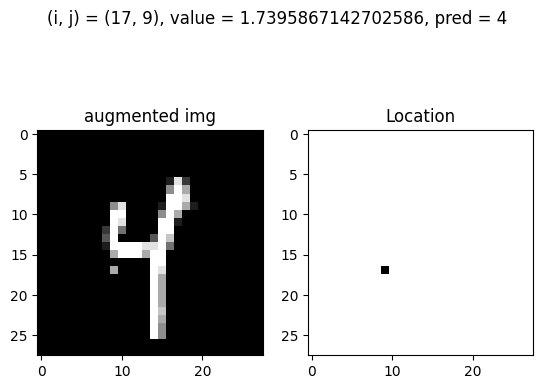

Test: At (i, j) = (17, 9) and value = 2.1002199862959356, pred = 4, before_pred = 9, gt = 4


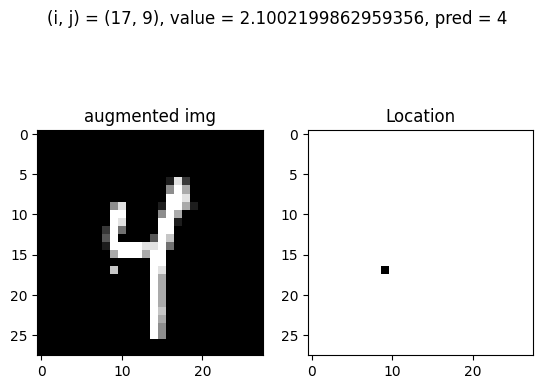

Test: At (i, j) = (17, 9) and value = 2.4608532583216127, pred = 4, before_pred = 9, gt = 4


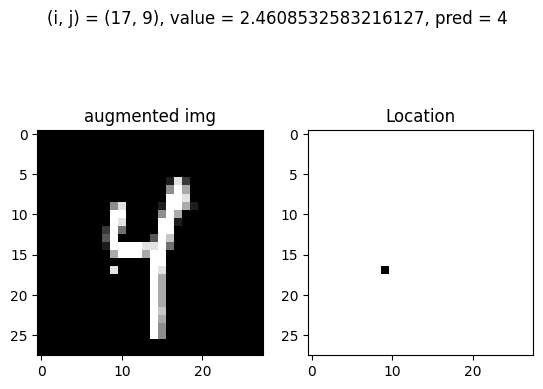

Test: At (i, j) = (17, 9) and value = 2.82148653034729, pred = 4, before_pred = 9, gt = 4


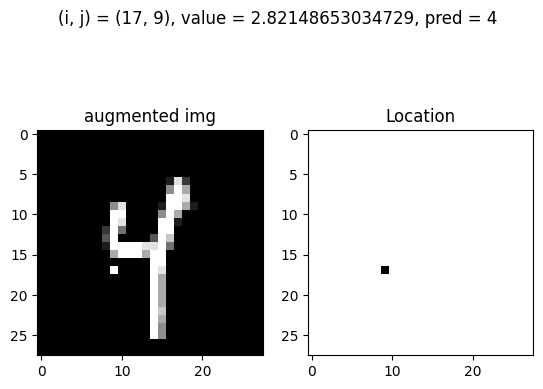

Test: At (i, j) = (17, 11) and value = 2.4608532583216127, pred = 4, before_pred = 9, gt = 4


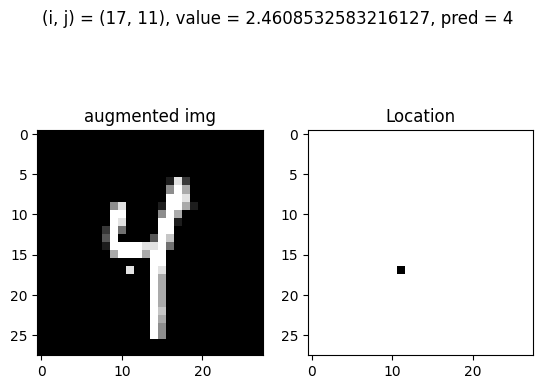

Test: At (i, j) = (17, 11) and value = 2.82148653034729, pred = 4, before_pred = 9, gt = 4


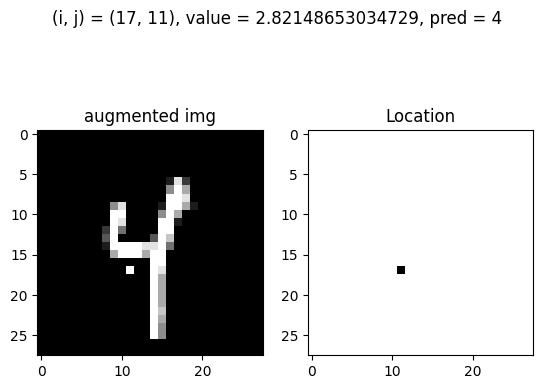

Test: At (i, j) = (17, 12) and value = 1.7395867142702586, pred = 4, before_pred = 9, gt = 4


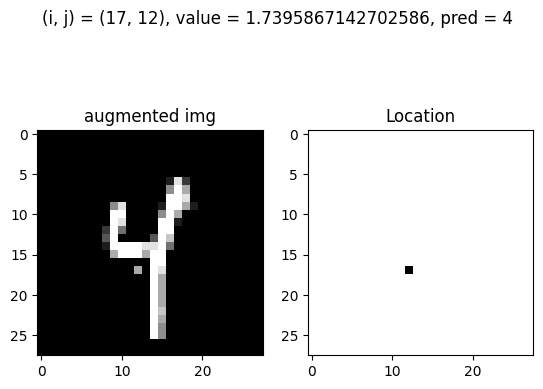

Test: At (i, j) = (17, 12) and value = 2.1002199862959356, pred = 4, before_pred = 9, gt = 4


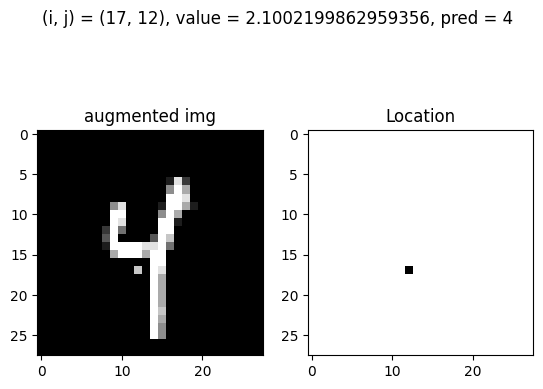

Test: At (i, j) = (17, 12) and value = 2.4608532583216127, pred = 4, before_pred = 9, gt = 4


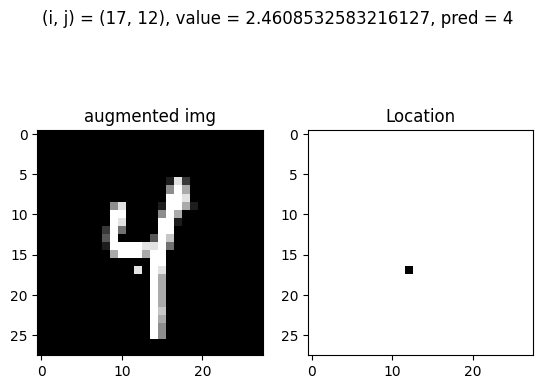

Test: At (i, j) = (17, 12) and value = 2.82148653034729, pred = 4, before_pred = 9, gt = 4


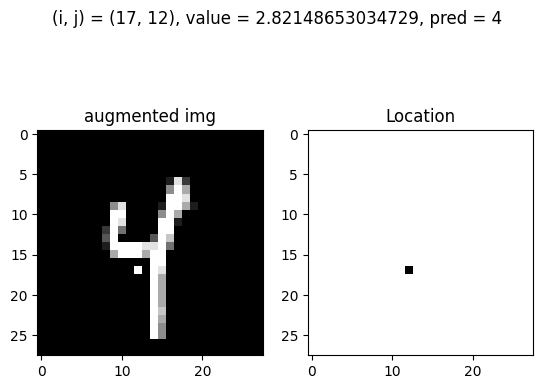

Test: At (i, j) = (17, 13) and value = 1.7395867142702586, pred = 4, before_pred = 9, gt = 4


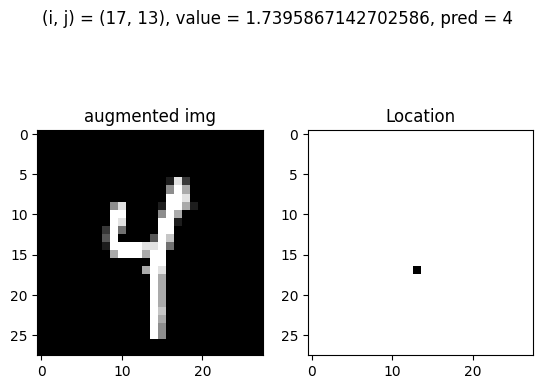

Test: At (i, j) = (17, 13) and value = 2.1002199862959356, pred = 4, before_pred = 9, gt = 4


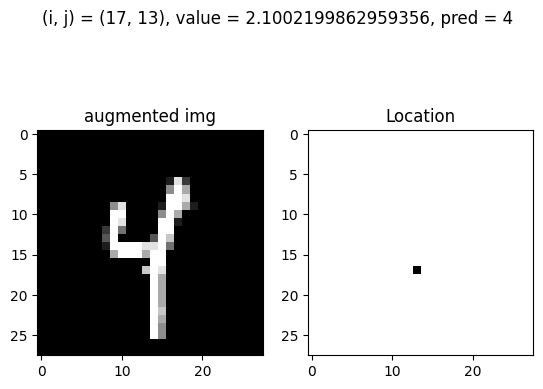

Test: At (i, j) = (17, 13) and value = 2.4608532583216127, pred = 4, before_pred = 9, gt = 4


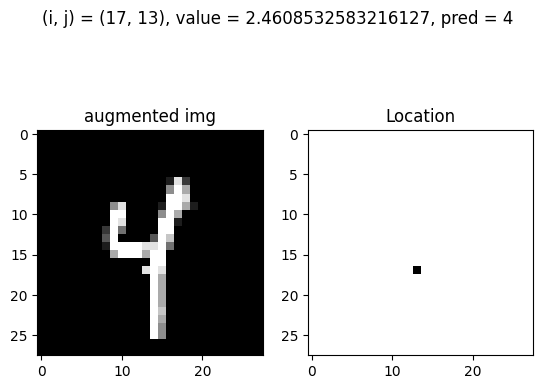

Test: At (i, j) = (17, 13) and value = 2.82148653034729, pred = 4, before_pred = 9, gt = 4


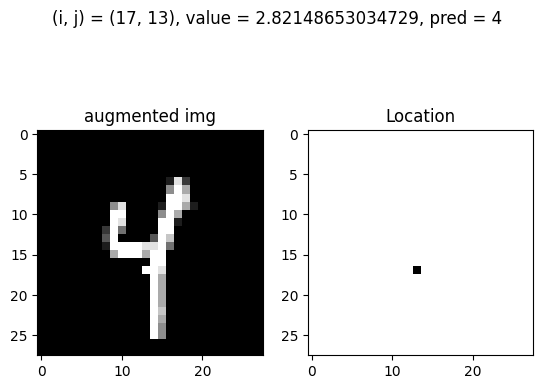

Test: At (i, j) = (18, 10) and value = 1.7395867142702586, pred = 4, before_pred = 9, gt = 4


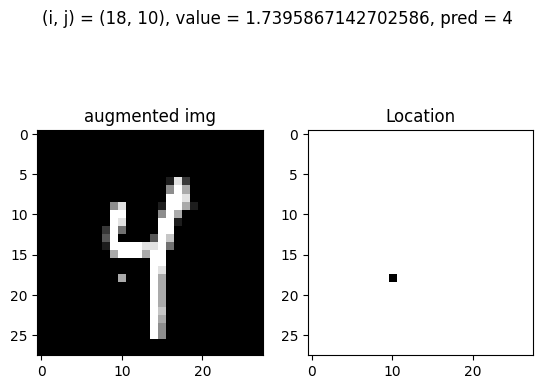

Test: At (i, j) = (18, 10) and value = 2.1002199862959356, pred = 4, before_pred = 9, gt = 4


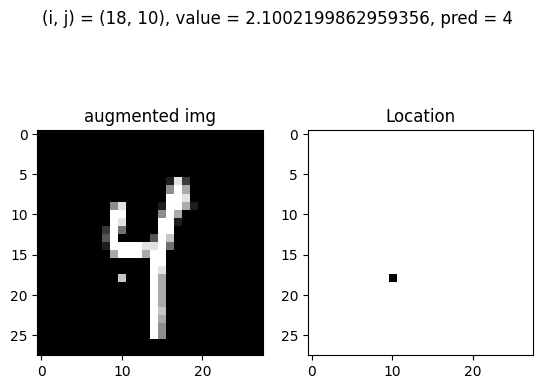

Test: At (i, j) = (18, 10) and value = 2.4608532583216127, pred = 4, before_pred = 9, gt = 4


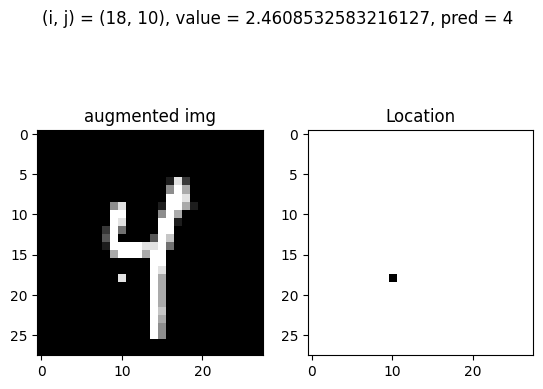

Test: At (i, j) = (18, 10) and value = 2.82148653034729, pred = 4, before_pred = 9, gt = 4


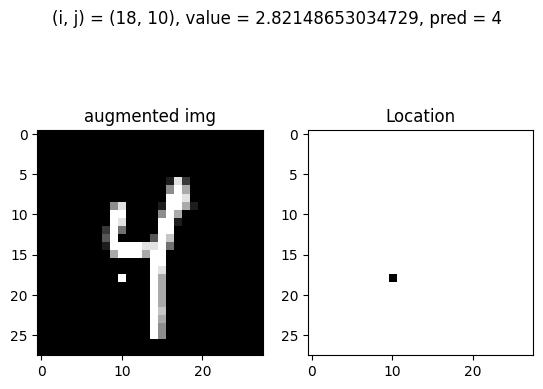

Test: At (i, j) = (18, 11) and value = 1.3789534422445815, pred = 4, before_pred = 9, gt = 4


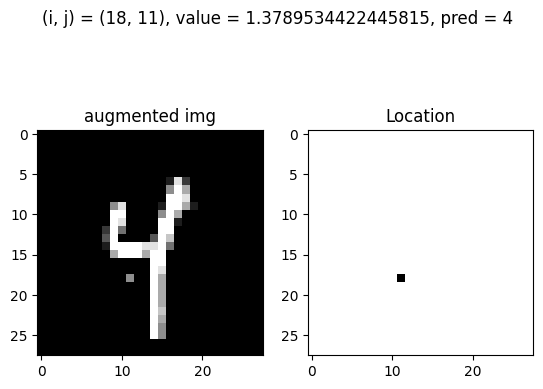

Test: At (i, j) = (18, 11) and value = 1.7395867142702586, pred = 4, before_pred = 9, gt = 4


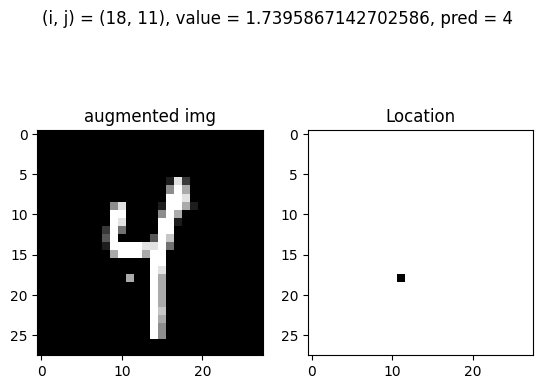

Test: At (i, j) = (18, 11) and value = 2.1002199862959356, pred = 4, before_pred = 9, gt = 4


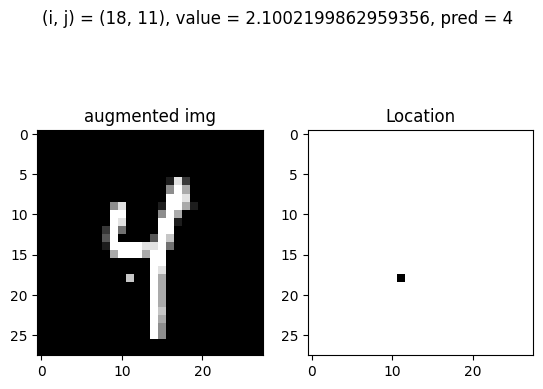

Test: At (i, j) = (18, 11) and value = 2.4608532583216127, pred = 4, before_pred = 9, gt = 4


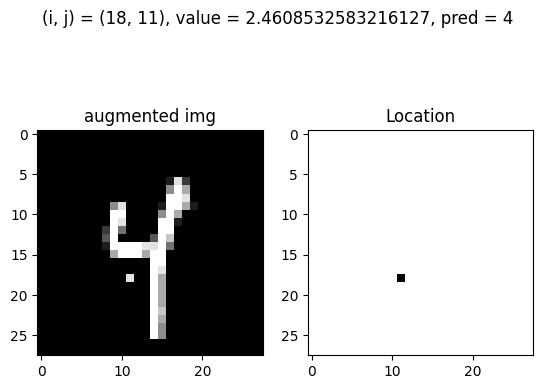

Test: At (i, j) = (18, 11) and value = 2.82148653034729, pred = 4, before_pred = 9, gt = 4


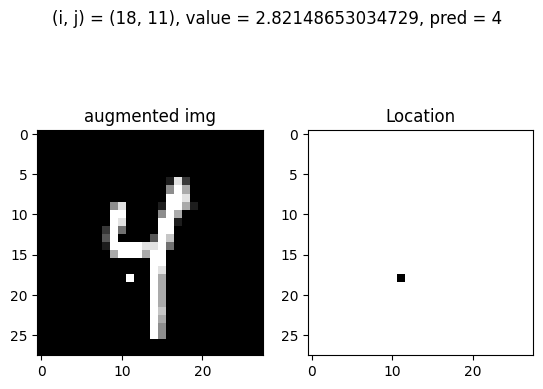

Test: At (i, j) = (18, 12) and value = 1.7395867142702586, pred = 4, before_pred = 9, gt = 4


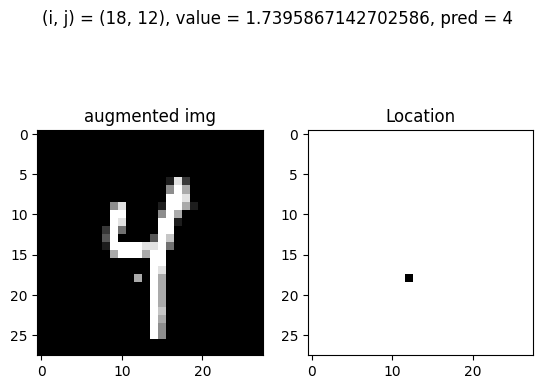

Test: At (i, j) = (18, 12) and value = 2.1002199862959356, pred = 4, before_pred = 9, gt = 4


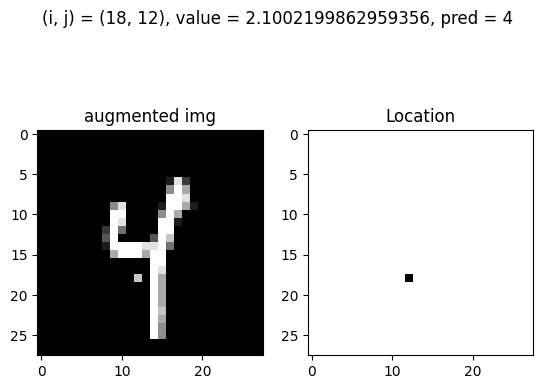

Test: At (i, j) = (18, 12) and value = 2.4608532583216127, pred = 4, before_pred = 9, gt = 4


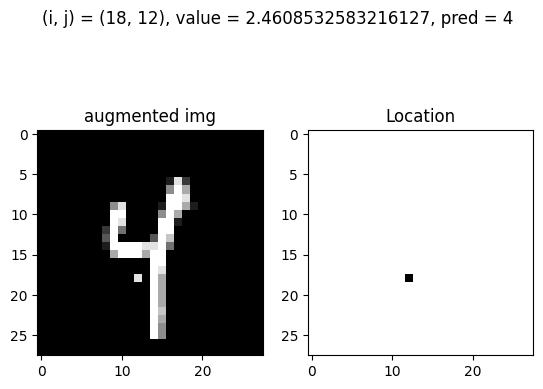

Test: At (i, j) = (18, 12) and value = 2.82148653034729, pred = 4, before_pred = 9, gt = 4


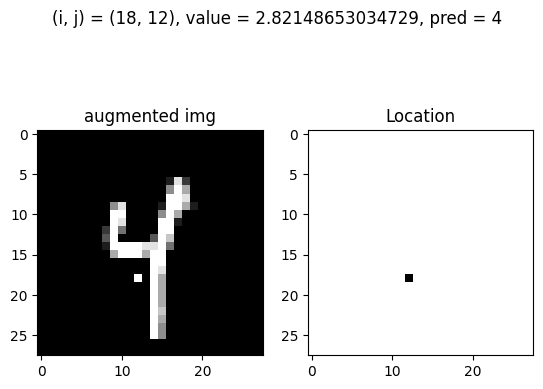

Test: At (i, j) = (19, 10) and value = 2.4608532583216127, pred = 4, before_pred = 9, gt = 4


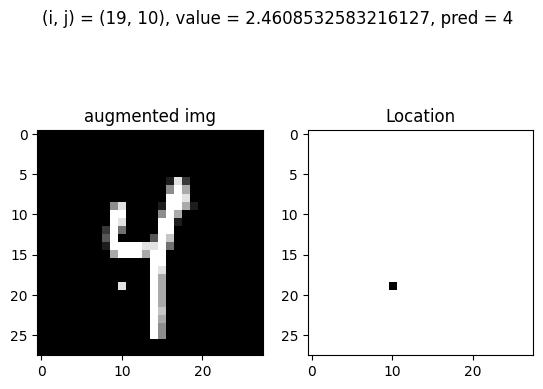

Test: At (i, j) = (19, 10) and value = 2.82148653034729, pred = 4, before_pred = 9, gt = 4


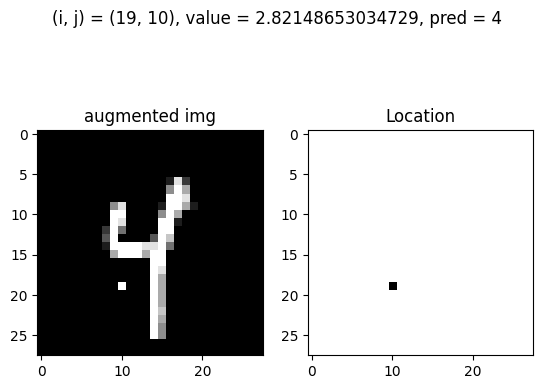

Test: At (i, j) = (19, 12) and value = 2.1002199862959356, pred = 4, before_pred = 9, gt = 4


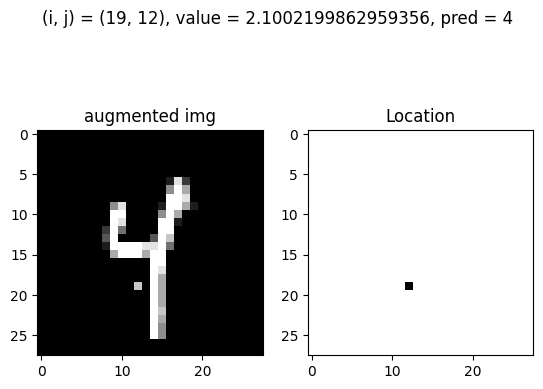

Test: At (i, j) = (19, 12) and value = 2.4608532583216127, pred = 4, before_pred = 9, gt = 4


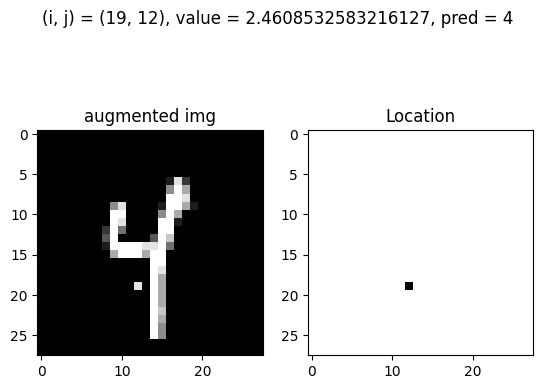

Test: At (i, j) = (19, 12) and value = 2.82148653034729, pred = 4, before_pred = 9, gt = 4


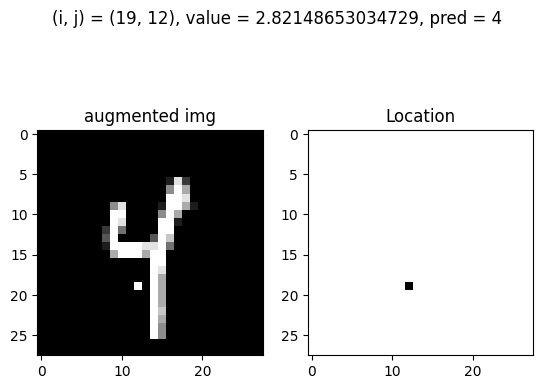

Test: At (i, j) = (19, 16) and value = 2.4608532583216127, pred = 4, before_pred = 9, gt = 4


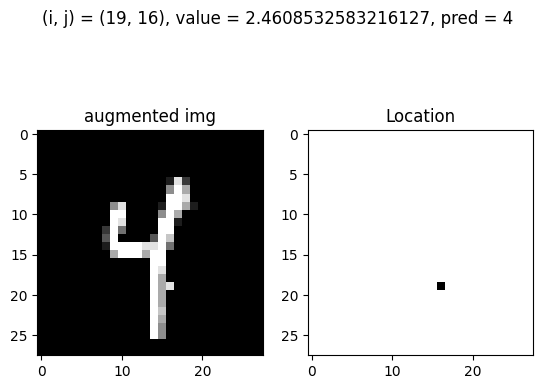

Test: At (i, j) = (19, 16) and value = 2.82148653034729, pred = 4, before_pred = 9, gt = 4


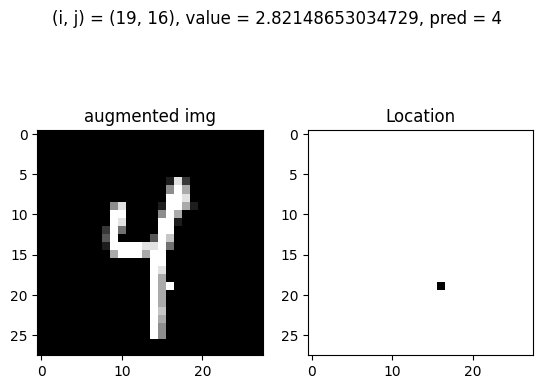

Test: At (i, j) = (19, 17) and value = 1.7395867142702586, pred = 4, before_pred = 9, gt = 4


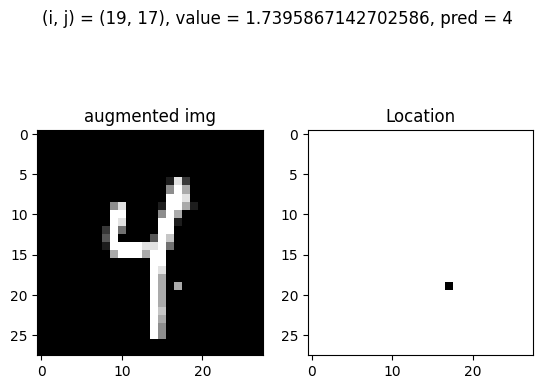

Test: At (i, j) = (19, 17) and value = 2.1002199862959356, pred = 4, before_pred = 9, gt = 4


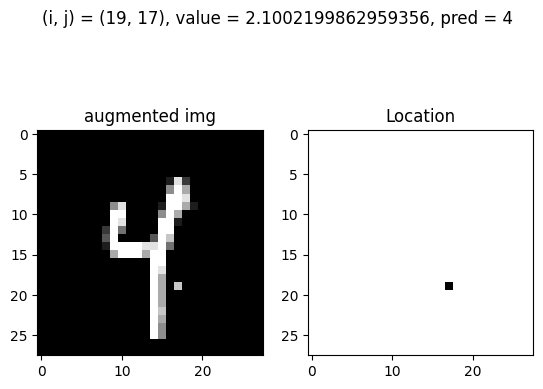

Test: At (i, j) = (19, 17) and value = 2.4608532583216127, pred = 4, before_pred = 9, gt = 4


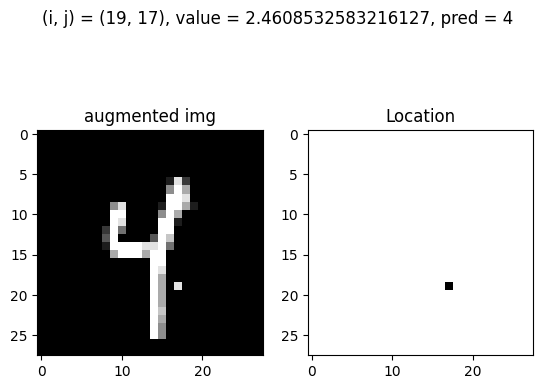

Test: At (i, j) = (19, 17) and value = 2.82148653034729, pred = 4, before_pred = 9, gt = 4


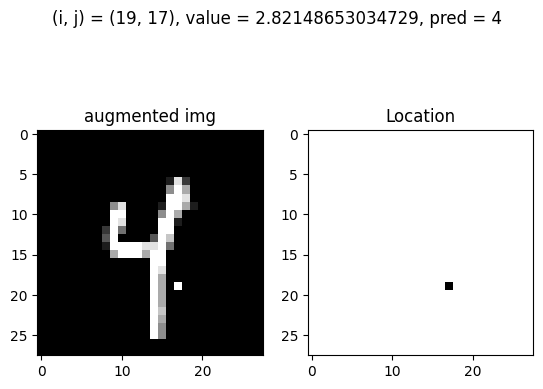

Test: At (i, j) = (19, 18) and value = 2.1002199862959356, pred = 4, before_pred = 9, gt = 4


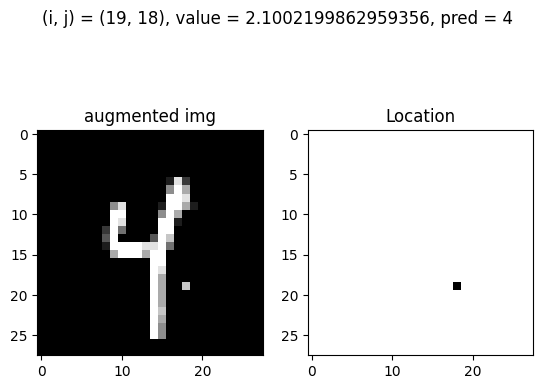

Test: At (i, j) = (19, 18) and value = 2.4608532583216127, pred = 4, before_pred = 9, gt = 4


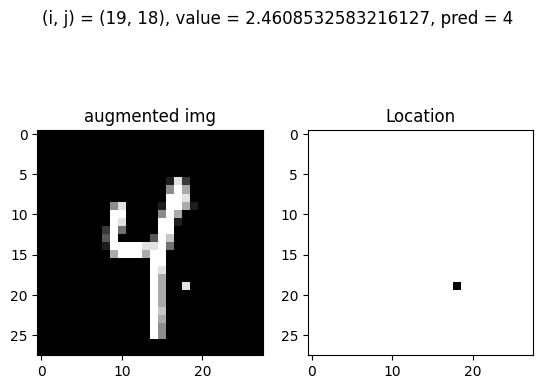

Test: At (i, j) = (19, 18) and value = 2.82148653034729, pred = 4, before_pred = 9, gt = 4


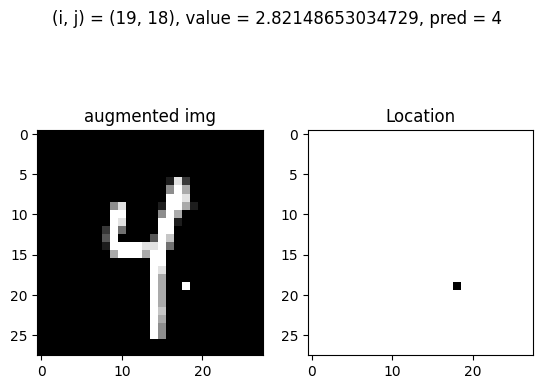

Test: At (i, j) = (20, 11) and value = 2.1002199862959356, pred = 4, before_pred = 9, gt = 4


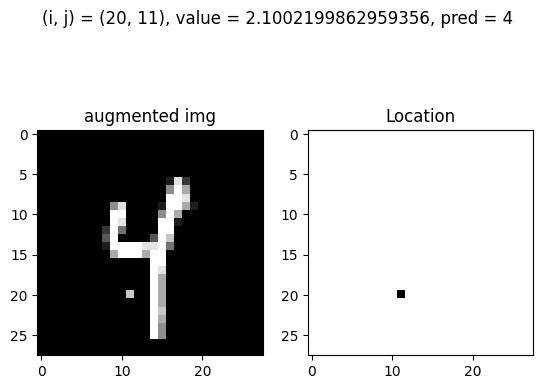

Test: At (i, j) = (20, 11) and value = 2.4608532583216127, pred = 4, before_pred = 9, gt = 4


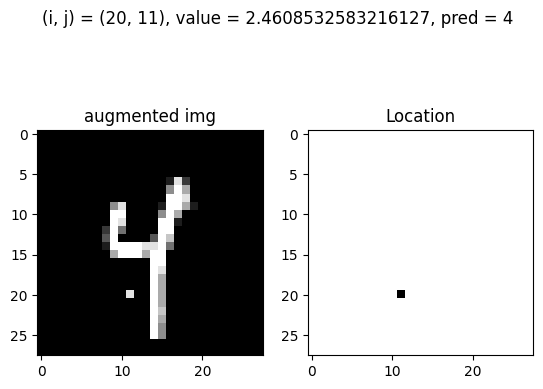

Test: At (i, j) = (20, 11) and value = 2.82148653034729, pred = 4, before_pred = 9, gt = 4


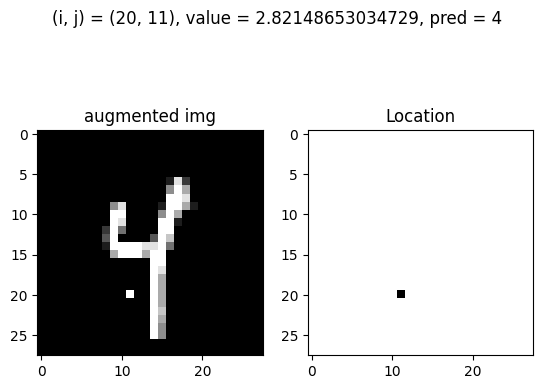

Test: At (i, j) = (20, 18) and value = 2.4608532583216127, pred = 4, before_pred = 9, gt = 4


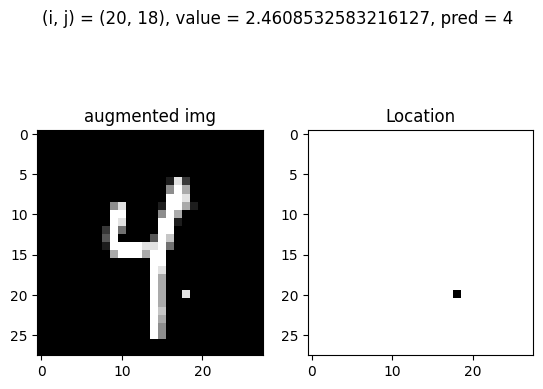

Test: At (i, j) = (20, 18) and value = 2.82148653034729, pred = 4, before_pred = 9, gt = 4


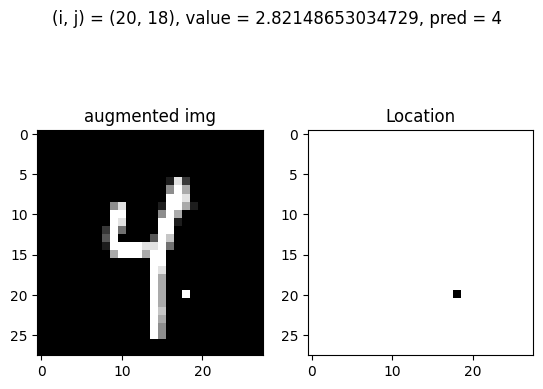

Test: At (i, j) = (20, 22) and value = 1.7395867142702586, pred = 4, before_pred = 9, gt = 4


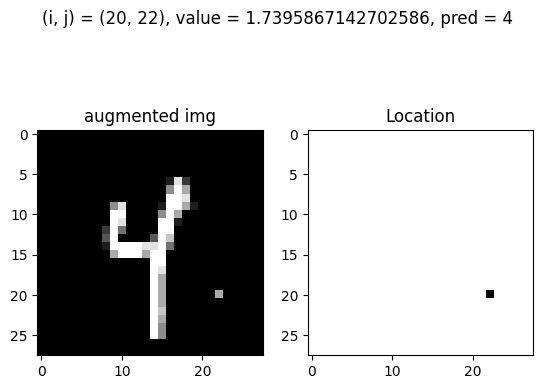

Test: At (i, j) = (20, 22) and value = 2.1002199862959356, pred = 4, before_pred = 9, gt = 4


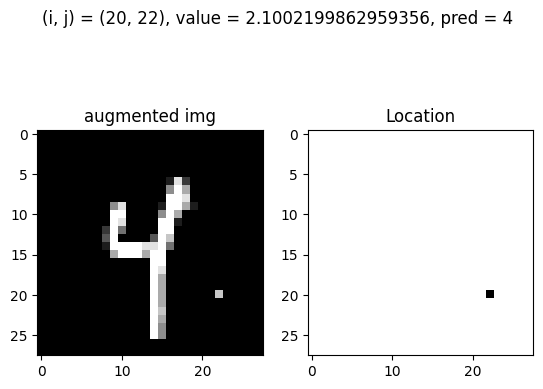

Test: At (i, j) = (20, 22) and value = 2.4608532583216127, pred = 4, before_pred = 9, gt = 4


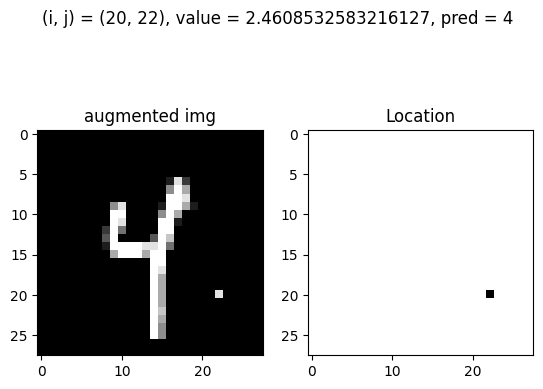

Test: At (i, j) = (20, 22) and value = 2.82148653034729, pred = 4, before_pred = 9, gt = 4


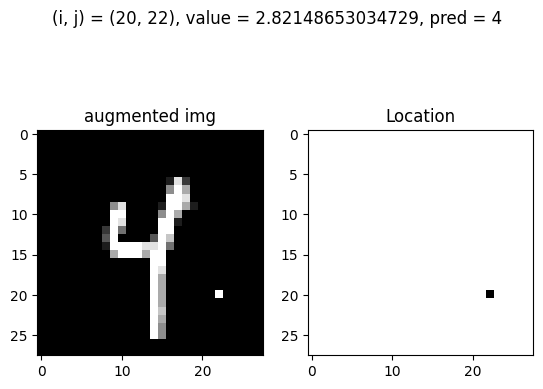

Test: At (i, j) = (20, 23) and value = 2.82148653034729, pred = 4, before_pred = 9, gt = 4


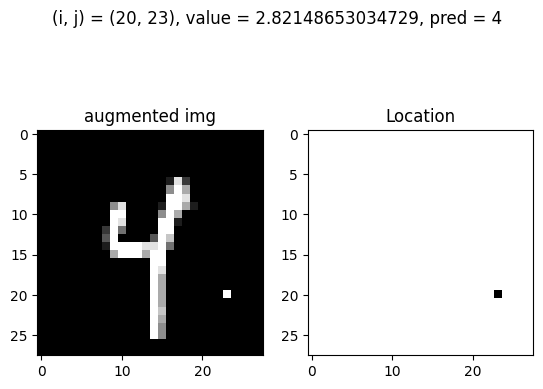

Test: At (i, j) = (21, 12) and value = 2.82148653034729, pred = 4, before_pred = 9, gt = 4


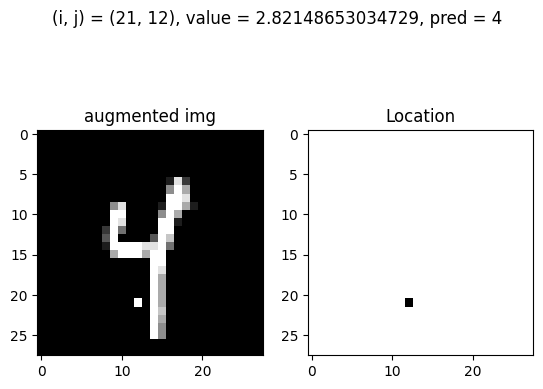

Test: At (i, j) = (22, 20) and value = 2.82148653034729, pred = 4, before_pred = 9, gt = 4


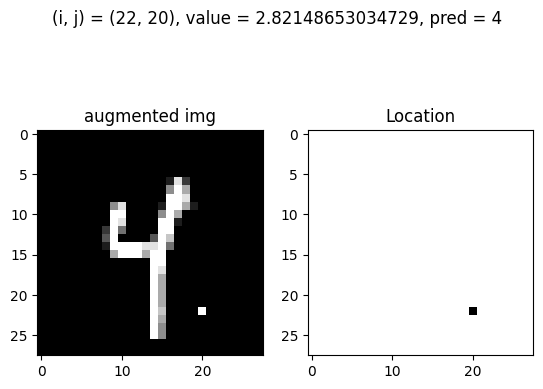

Test: At (i, j) = (22, 23) and value = 2.4608532583216127, pred = 4, before_pred = 9, gt = 4


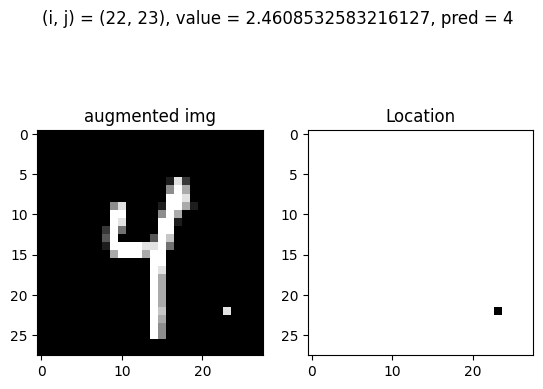

Test: At (i, j) = (22, 23) and value = 2.82148653034729, pred = 4, before_pred = 9, gt = 4


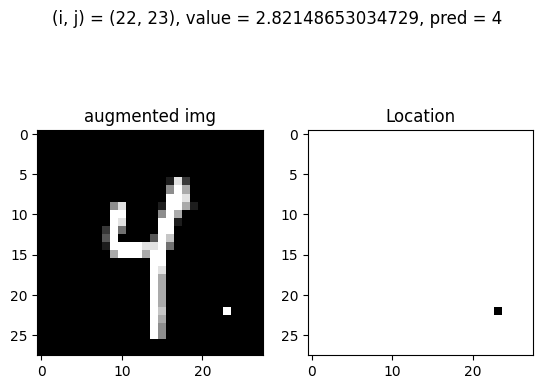

Test: At (i, j) = (25, 14) and value = -0.424212917883804, pred = 4, before_pred = 9, gt = 4


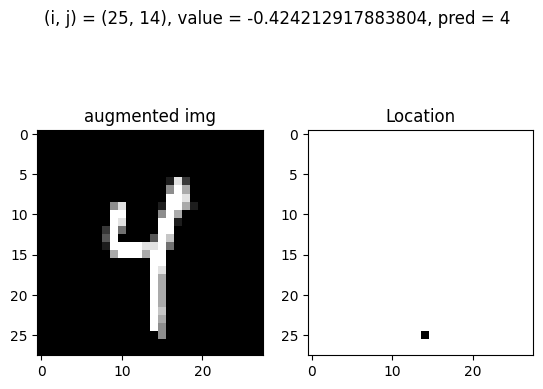

Test: At (i, j) = (25, 14) and value = -0.06357964585812692, pred = 4, before_pred = 9, gt = 4


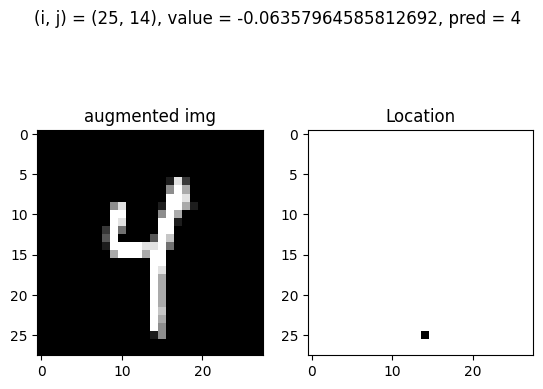

Test: At (i, j) = (25, 14) and value = 0.29705362616755016, pred = 4, before_pred = 9, gt = 4


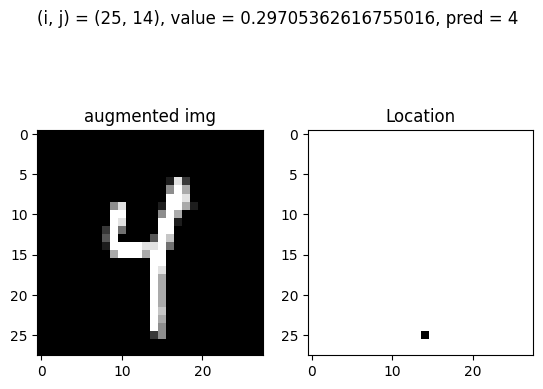

7840 done
Test: At (i, j) = (8, 16) and value = 2.82148653034729, pred = 3, before_pred = 8, gt = 8


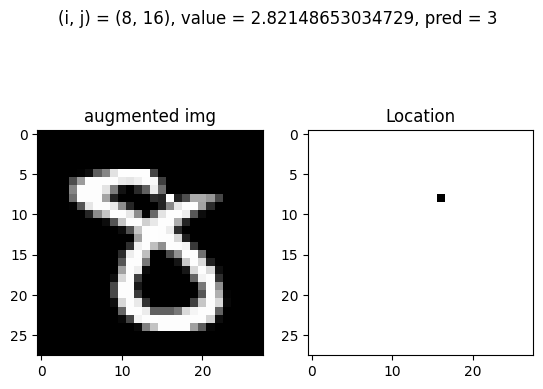

Test: At (i, j) = (9, 15) and value = 2.82148653034729, pred = 3, before_pred = 8, gt = 8


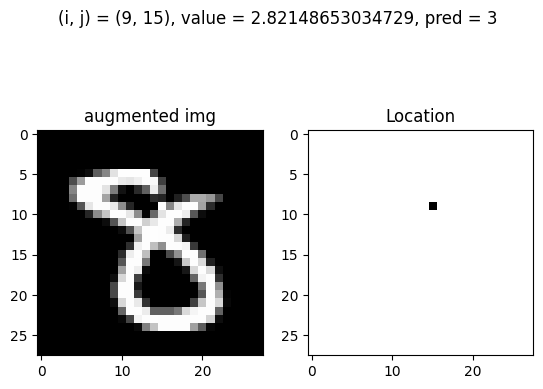

Test: At (i, j) = (10, 9) and value = -0.424212917883804, pred = 3, before_pred = 8, gt = 8


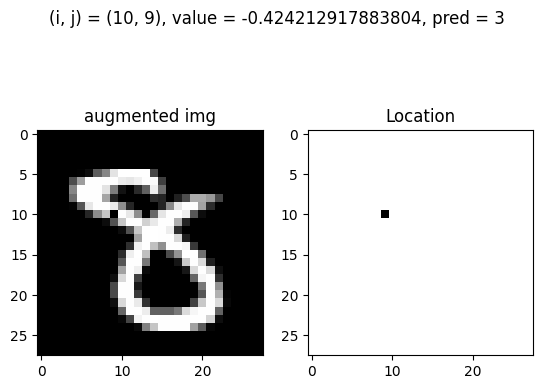

Test: At (i, j) = (10, 9) and value = -0.06357964585812692, pred = 3, before_pred = 8, gt = 8


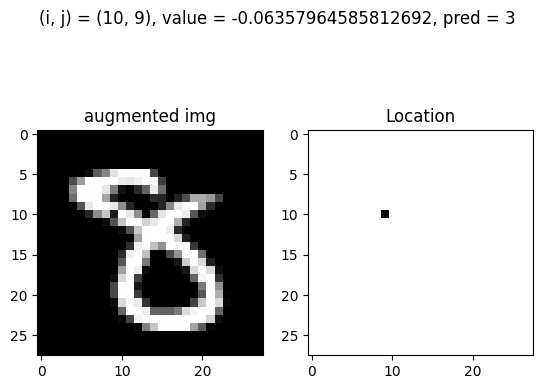

Test: At (i, j) = (10, 9) and value = 0.29705362616755016, pred = 3, before_pred = 8, gt = 8


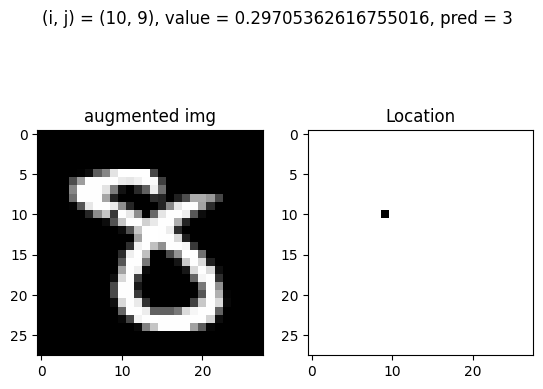

Test: At (i, j) = (10, 10) and value = -0.424212917883804, pred = 3, before_pred = 8, gt = 8


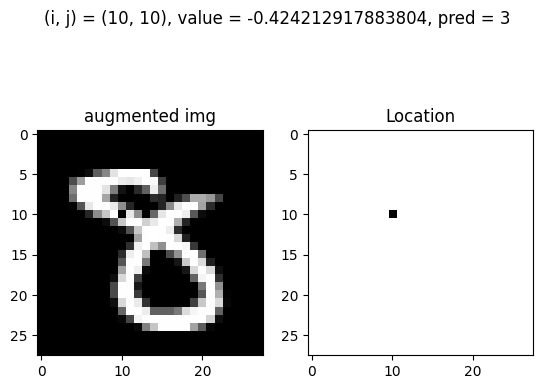

Test: At (i, j) = (10, 10) and value = -0.06357964585812692, pred = 3, before_pred = 8, gt = 8


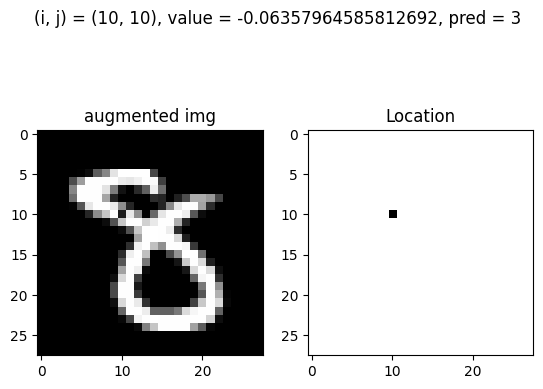

Test: At (i, j) = (10, 11) and value = -0.424212917883804, pred = 3, before_pred = 8, gt = 8


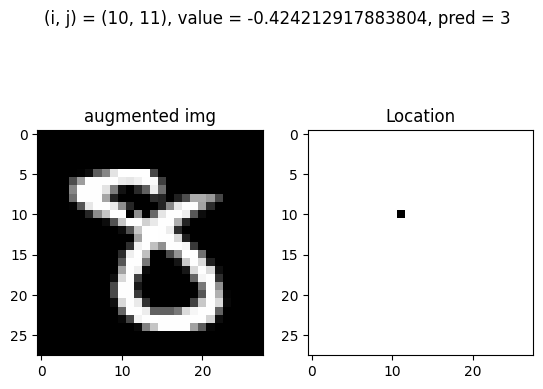

Test: At (i, j) = (10, 11) and value = -0.06357964585812692, pred = 3, before_pred = 8, gt = 8


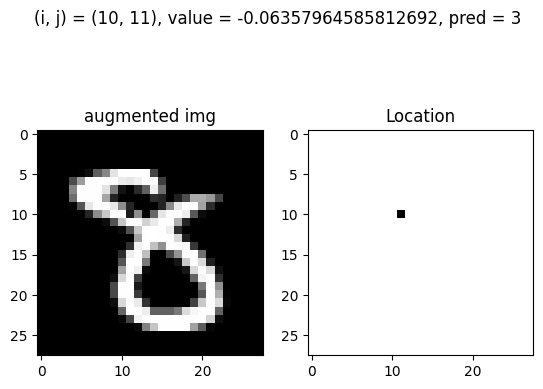

Test: At (i, j) = (10, 11) and value = 0.29705362616755016, pred = 3, before_pred = 8, gt = 8


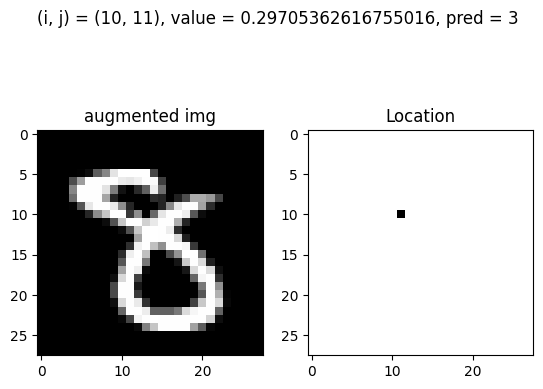

Test: At (i, j) = (11, 11) and value = -0.424212917883804, pred = 3, before_pred = 8, gt = 8


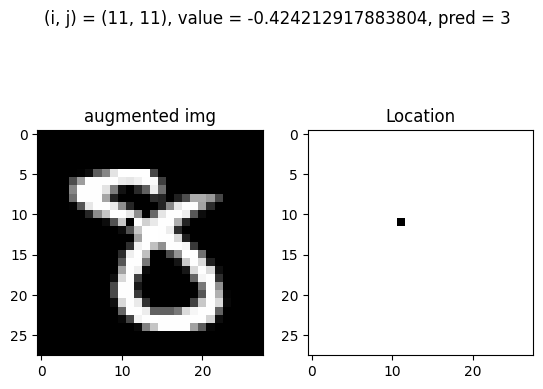

Test: At (i, j) = (16, 11) and value = -0.424212917883804, pred = 3, before_pred = 8, gt = 8


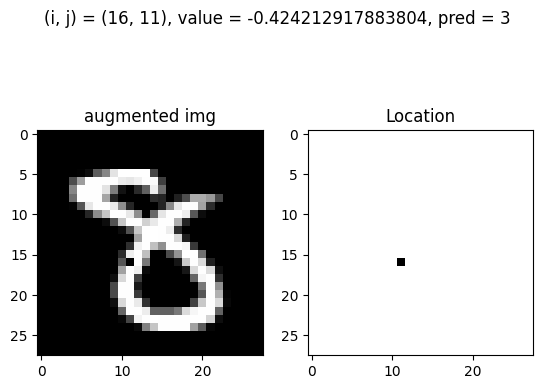

Test: At (i, j) = (16, 11) and value = -0.06357964585812692, pred = 3, before_pred = 8, gt = 8


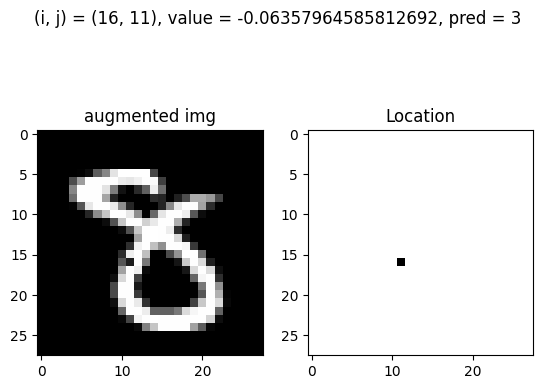

Test: At (i, j) = (16, 12) and value = -0.424212917883804, pred = 3, before_pred = 8, gt = 8


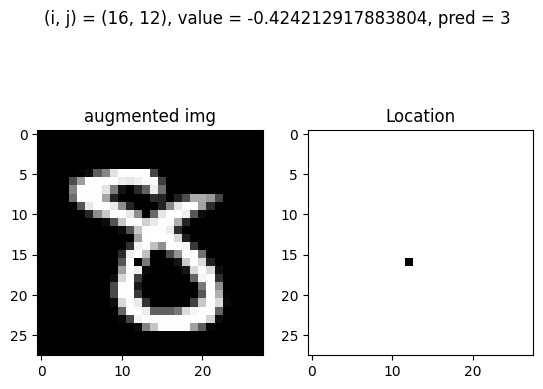

Test: At (i, j) = (16, 12) and value = -0.06357964585812692, pred = 3, before_pred = 8, gt = 8


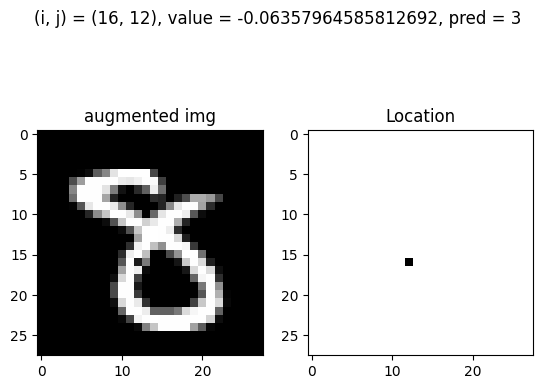

Test: At (i, j) = (16, 12) and value = 0.29705362616755016, pred = 3, before_pred = 8, gt = 8


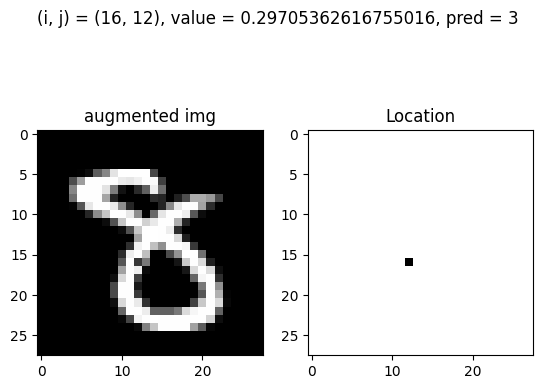

Test: At (i, j) = (17, 11) and value = -0.424212917883804, pred = 3, before_pred = 8, gt = 8


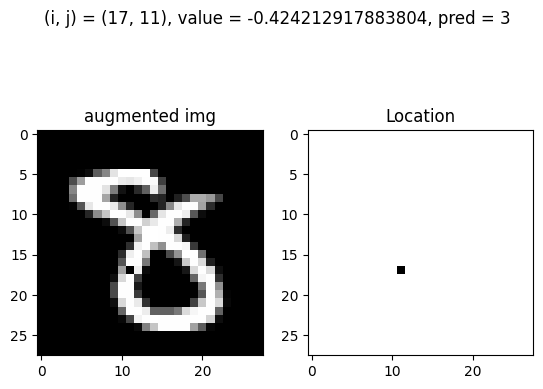

Test: At (i, j) = (17, 11) and value = -0.06357964585812692, pred = 3, before_pred = 8, gt = 8


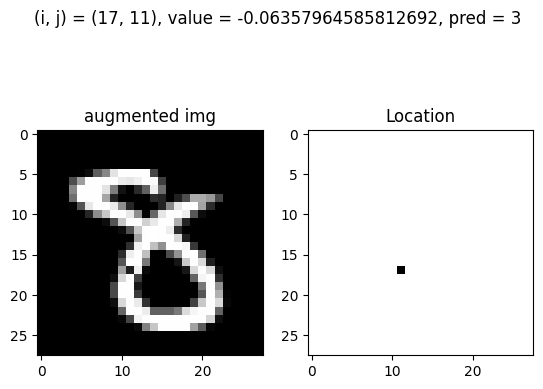

Test: At (i, j) = (17, 11) and value = 0.29705362616755016, pred = 3, before_pred = 8, gt = 8


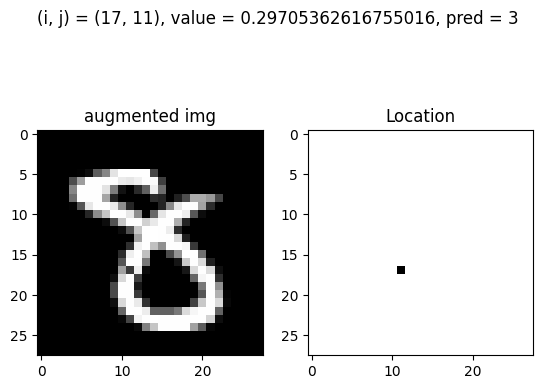

Test: At (i, j) = (17, 11) and value = 0.6576868981932272, pred = 3, before_pred = 8, gt = 8


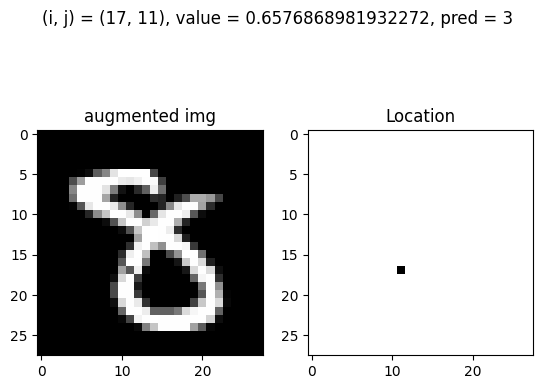

Test: At (i, j) = (17, 12) and value = -0.424212917883804, pred = 3, before_pred = 8, gt = 8


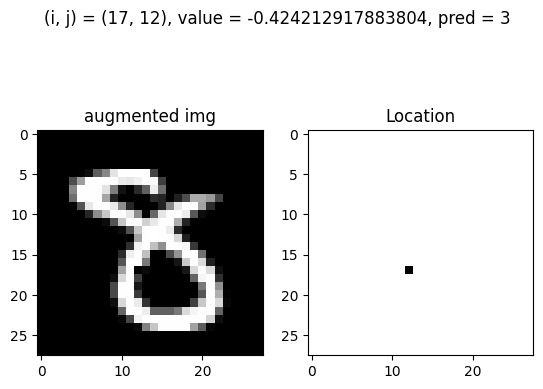

Test: At (i, j) = (17, 12) and value = -0.06357964585812692, pred = 3, before_pred = 8, gt = 8


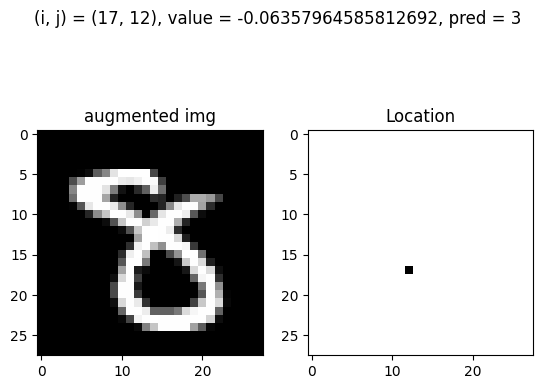

Test: At (i, j) = (17, 12) and value = 0.29705362616755016, pred = 3, before_pred = 8, gt = 8


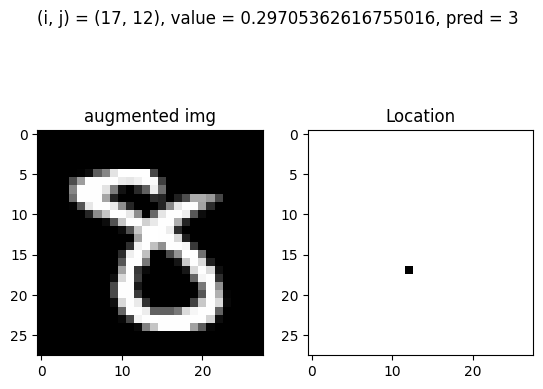

Test: At (i, j) = (18, 3) and value = 2.82148653034729, pred = 3, before_pred = 8, gt = 8


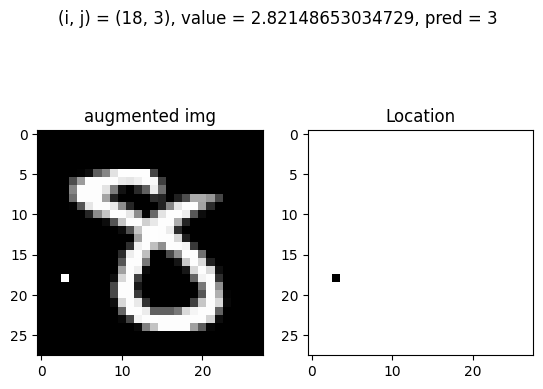

Test: At (i, j) = (18, 10) and value = -0.424212917883804, pred = 3, before_pred = 8, gt = 8


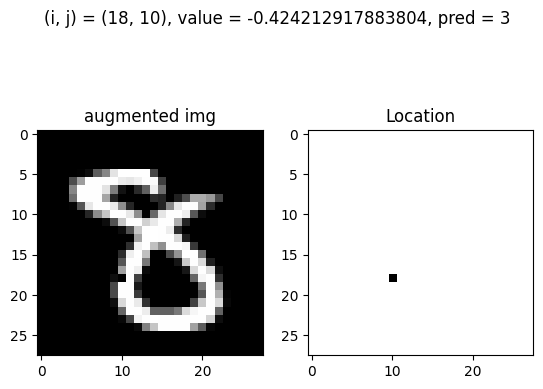

Test: At (i, j) = (18, 11) and value = -0.424212917883804, pred = 3, before_pred = 8, gt = 8


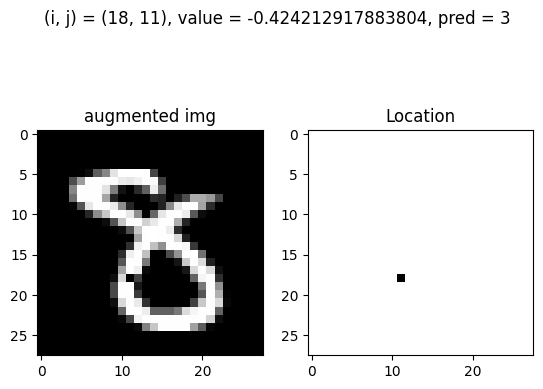

Test: At (i, j) = (18, 11) and value = -0.06357964585812692, pred = 3, before_pred = 8, gt = 8


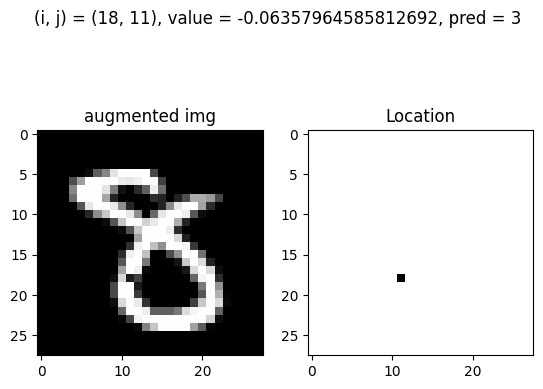

Test: At (i, j) = (18, 11) and value = 0.29705362616755016, pred = 3, before_pred = 8, gt = 8


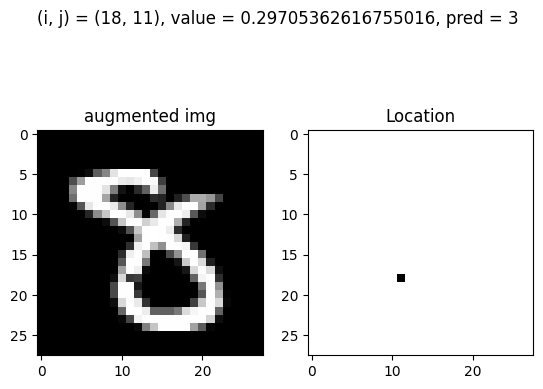

Test: At (i, j) = (18, 11) and value = 0.6576868981932272, pred = 3, before_pred = 8, gt = 8


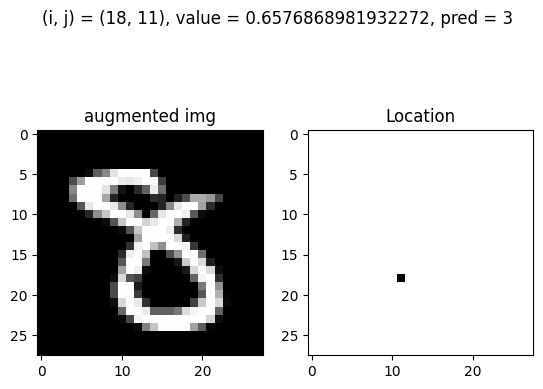

Test: At (i, j) = (18, 18) and value = 2.82148653034729, pred = 3, before_pred = 8, gt = 8


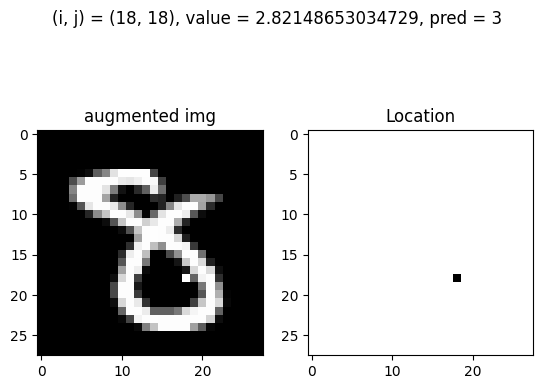

Test: At (i, j) = (19, 10) and value = -0.424212917883804, pred = 3, before_pred = 8, gt = 8


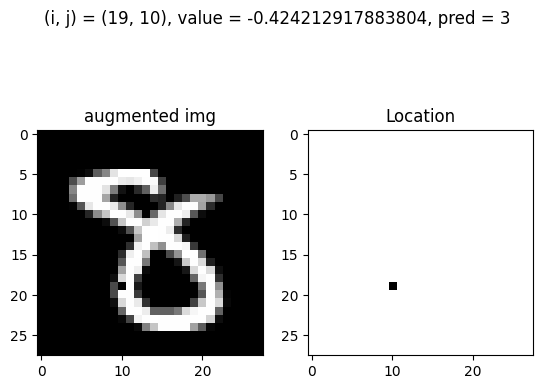

Test: At (i, j) = (23, 6) and value = 2.82148653034729, pred = 3, before_pred = 8, gt = 8


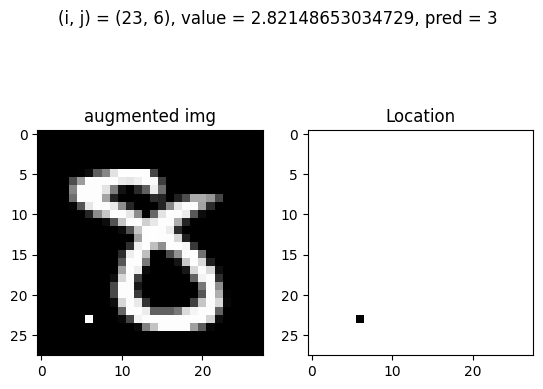

7840 done
7840 done
7840 done
7840 done
7840 done
7840 done
7840 done
7840 done
7840 done
7840 done
7840 done
7840 done
7840 done
7840 done
7840 done
7840 done
Test: At (i, j) = (7, 12) and value = 2.1002199862959356, pred = 9, before_pred = 4, gt = 4


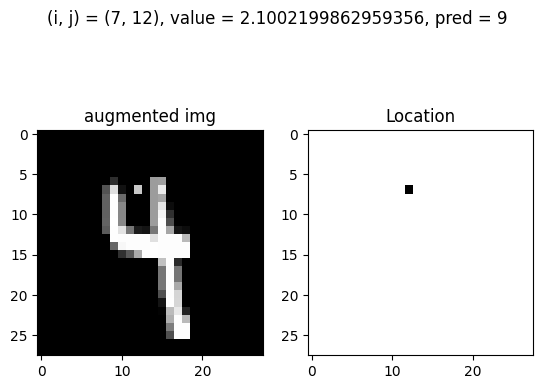

Test: At (i, j) = (7, 12) and value = 2.4608532583216127, pred = 9, before_pred = 4, gt = 4


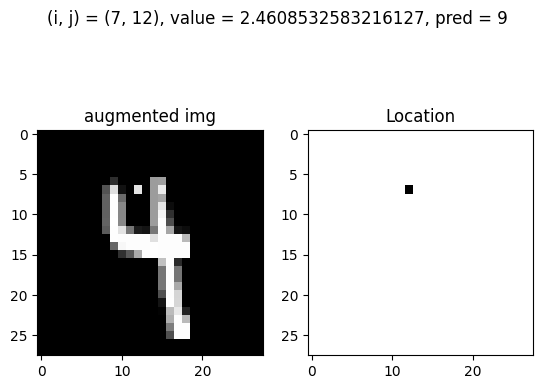

Test: At (i, j) = (7, 12) and value = 2.82148653034729, pred = 9, before_pred = 4, gt = 4


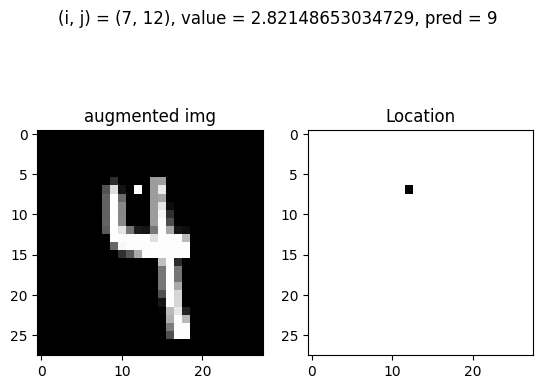

Test: At (i, j) = (7, 13) and value = 2.1002199862959356, pred = 9, before_pred = 4, gt = 4


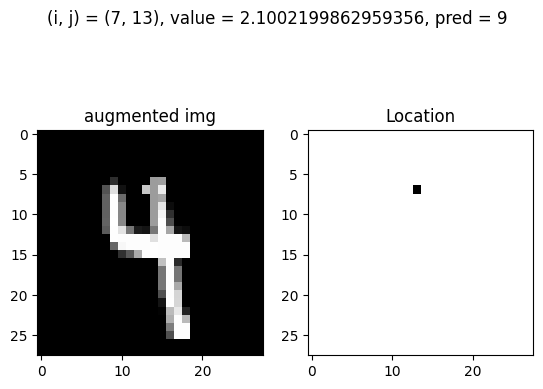

Test: At (i, j) = (7, 13) and value = 2.4608532583216127, pred = 9, before_pred = 4, gt = 4


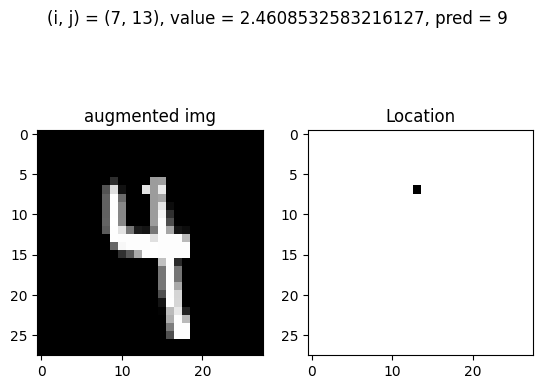

Test: At (i, j) = (7, 13) and value = 2.82148653034729, pred = 9, before_pred = 4, gt = 4


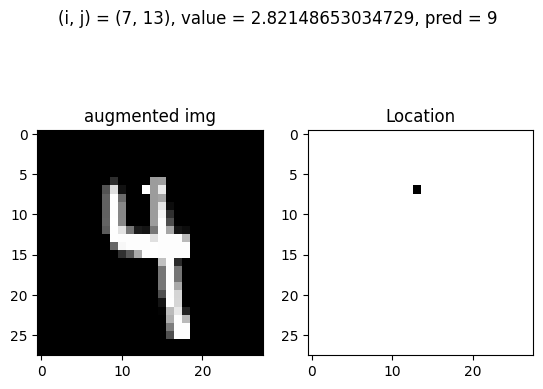

Test: At (i, j) = (7, 16) and value = 1.0183201702189044, pred = 9, before_pred = 4, gt = 4


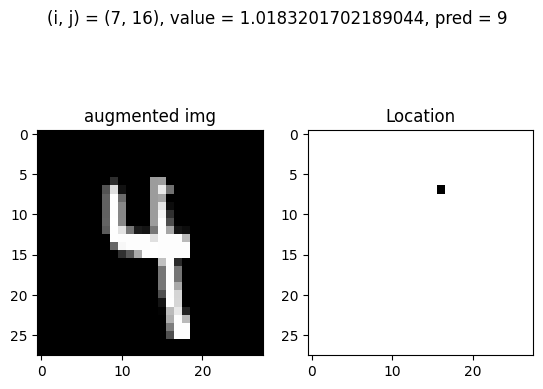

Test: At (i, j) = (7, 16) and value = 1.3789534422445815, pred = 9, before_pred = 4, gt = 4


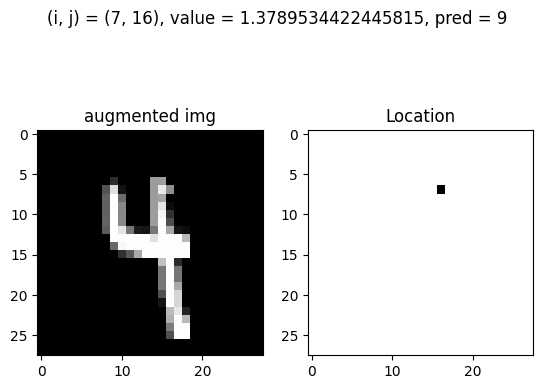

Test: At (i, j) = (7, 16) and value = 1.7395867142702586, pred = 9, before_pred = 4, gt = 4


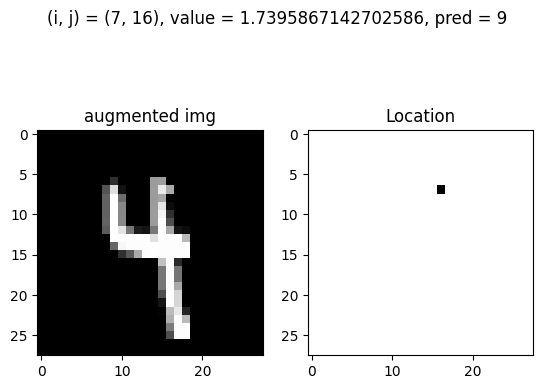

Test: At (i, j) = (7, 16) and value = 2.1002199862959356, pred = 9, before_pred = 4, gt = 4


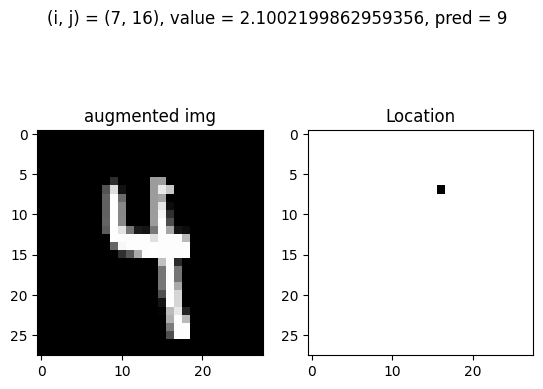

Test: At (i, j) = (7, 16) and value = 2.4608532583216127, pred = 9, before_pred = 4, gt = 4


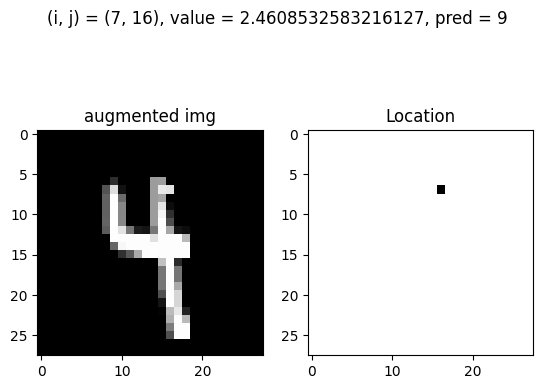

Test: At (i, j) = (7, 16) and value = 2.82148653034729, pred = 9, before_pred = 4, gt = 4


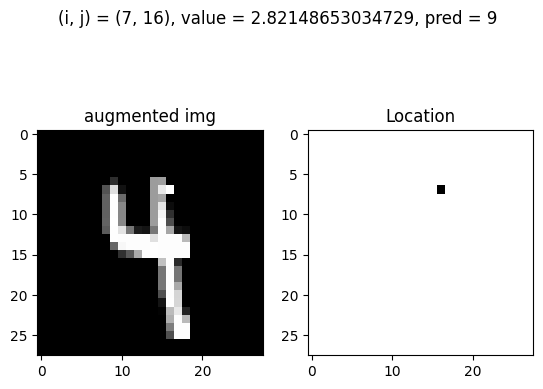

Test: At (i, j) = (7, 17) and value = 1.7395867142702586, pred = 9, before_pred = 4, gt = 4


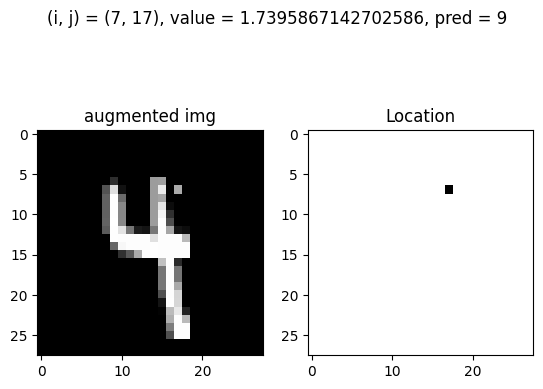

Test: At (i, j) = (7, 17) and value = 2.1002199862959356, pred = 9, before_pred = 4, gt = 4


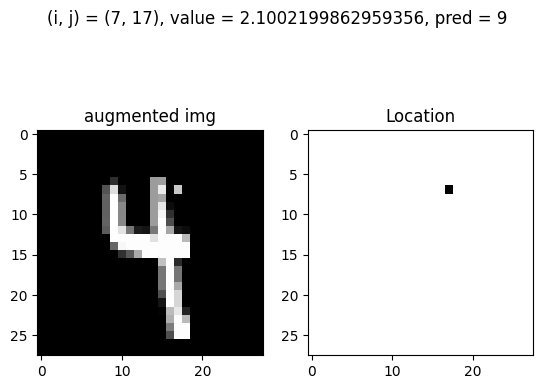

Test: At (i, j) = (7, 17) and value = 2.4608532583216127, pred = 9, before_pred = 4, gt = 4


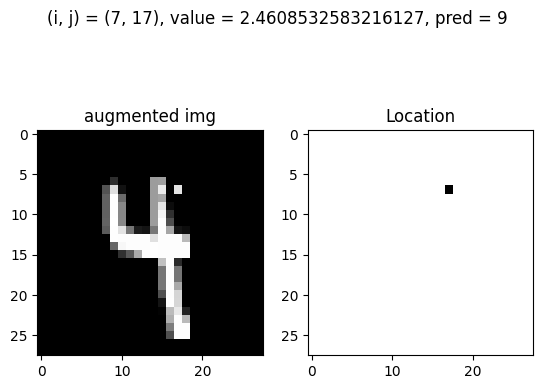

Test: At (i, j) = (7, 17) and value = 2.82148653034729, pred = 9, before_pred = 4, gt = 4


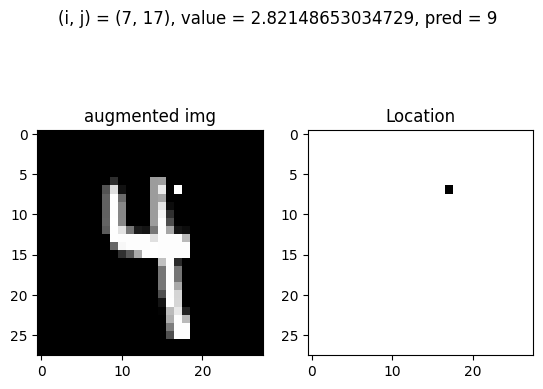

Test: At (i, j) = (8, 12) and value = 1.7395867142702586, pred = 9, before_pred = 4, gt = 4


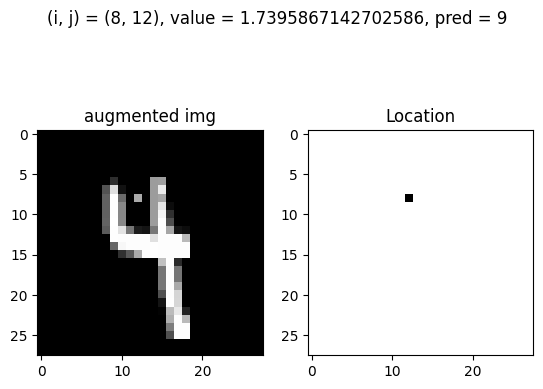

Test: At (i, j) = (8, 12) and value = 2.1002199862959356, pred = 9, before_pred = 4, gt = 4


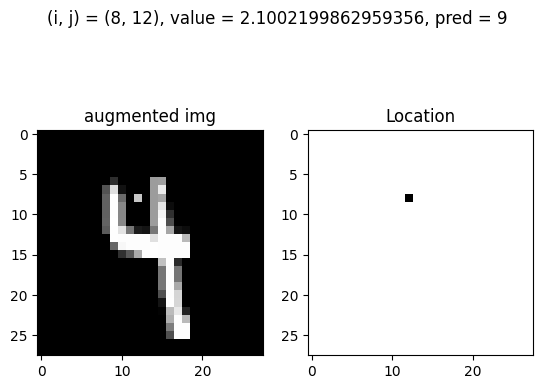

Test: At (i, j) = (8, 12) and value = 2.4608532583216127, pred = 9, before_pred = 4, gt = 4


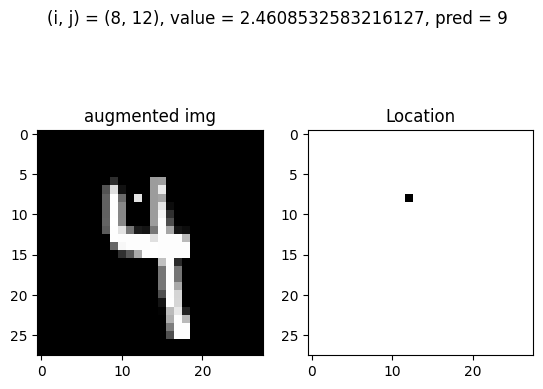

Test: At (i, j) = (8, 12) and value = 2.82148653034729, pred = 9, before_pred = 4, gt = 4


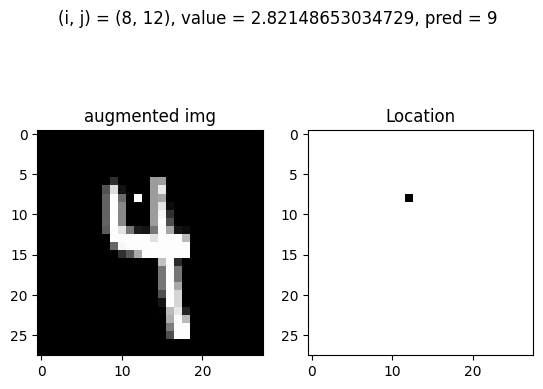

Test: At (i, j) = (8, 13) and value = 1.3789534422445815, pred = 9, before_pred = 4, gt = 4


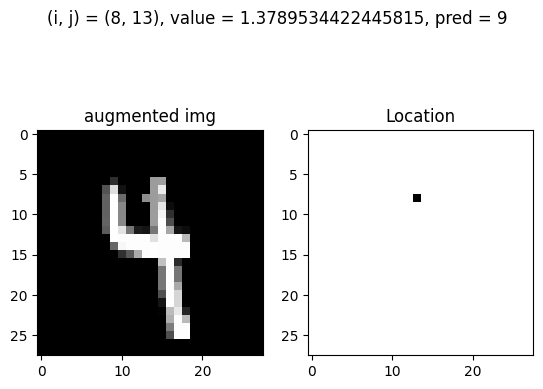

Test: At (i, j) = (8, 13) and value = 1.7395867142702586, pred = 9, before_pred = 4, gt = 4


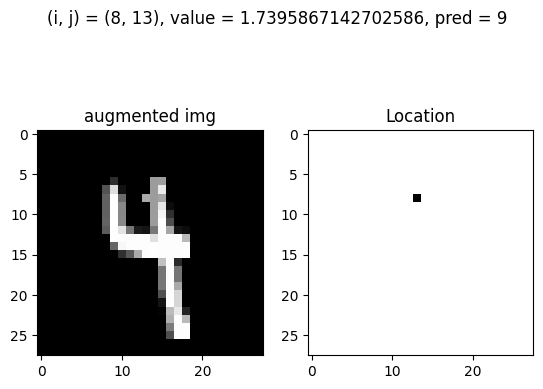

Test: At (i, j) = (8, 13) and value = 2.1002199862959356, pred = 9, before_pred = 4, gt = 4


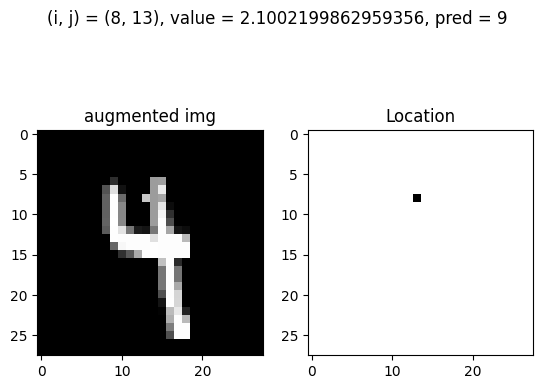

Test: At (i, j) = (8, 13) and value = 2.4608532583216127, pred = 9, before_pred = 4, gt = 4


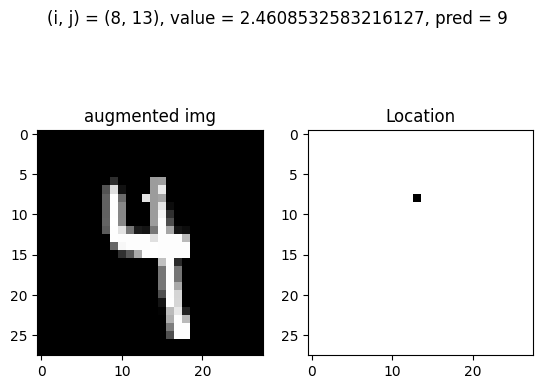

Test: At (i, j) = (8, 13) and value = 2.82148653034729, pred = 9, before_pred = 4, gt = 4


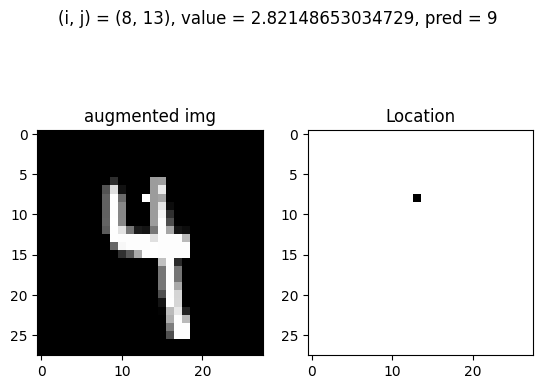

Test: At (i, j) = (8, 16) and value = 1.3789534422445815, pred = 9, before_pred = 4, gt = 4


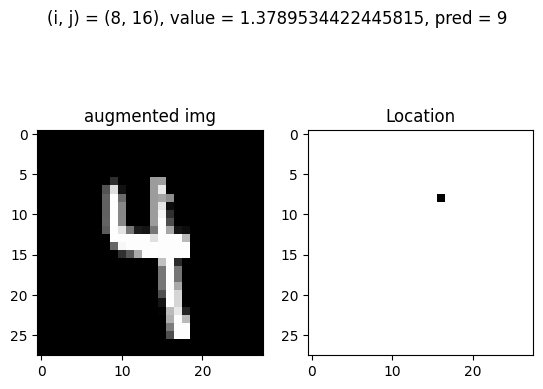

Test: At (i, j) = (8, 16) and value = 1.7395867142702586, pred = 9, before_pred = 4, gt = 4


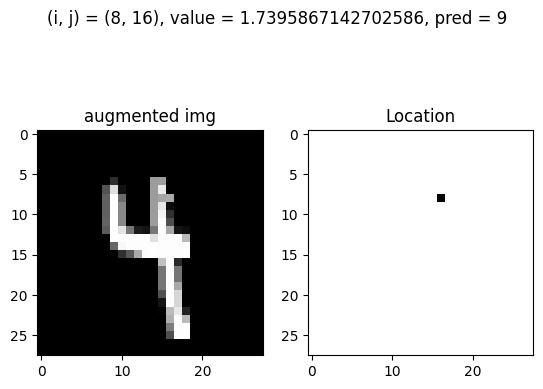

Test: At (i, j) = (8, 16) and value = 2.1002199862959356, pred = 9, before_pred = 4, gt = 4


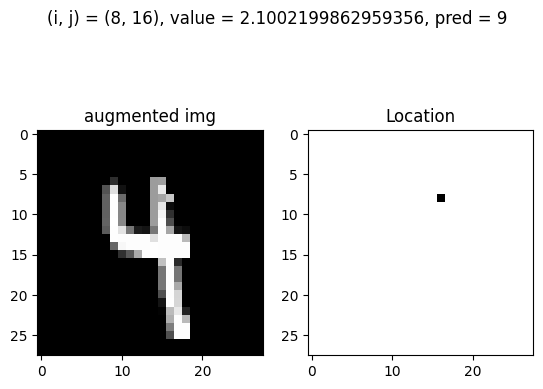

Test: At (i, j) = (8, 16) and value = 2.4608532583216127, pred = 9, before_pred = 4, gt = 4


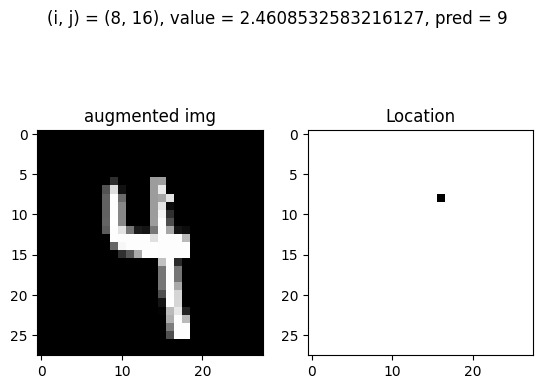

Test: At (i, j) = (8, 16) and value = 2.82148653034729, pred = 9, before_pred = 4, gt = 4


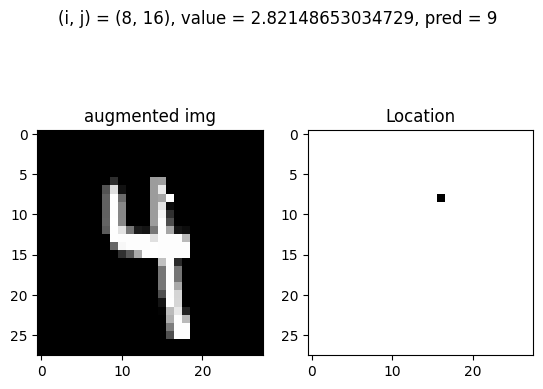

Test: At (i, j) = (8, 17) and value = 1.7395867142702586, pred = 9, before_pred = 4, gt = 4


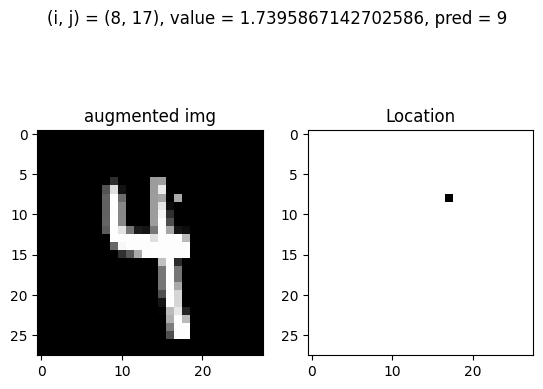

Test: At (i, j) = (8, 17) and value = 2.1002199862959356, pred = 9, before_pred = 4, gt = 4


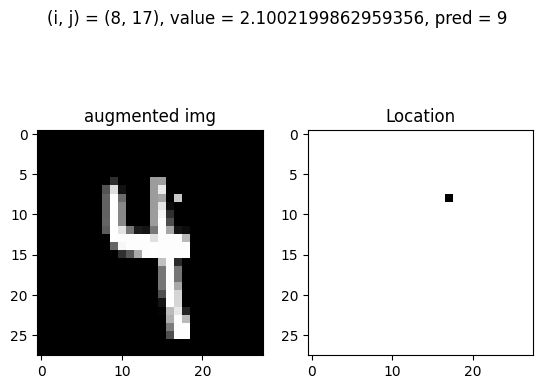

Test: At (i, j) = (8, 17) and value = 2.4608532583216127, pred = 9, before_pred = 4, gt = 4


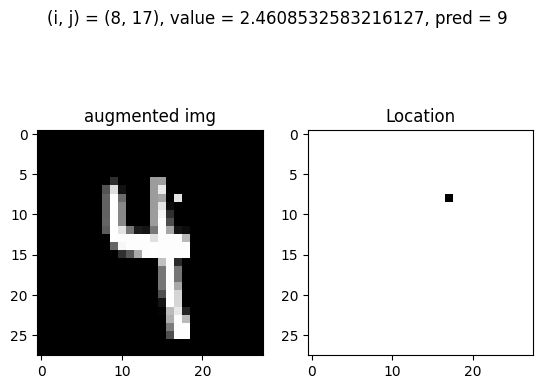

Test: At (i, j) = (8, 17) and value = 2.82148653034729, pred = 9, before_pred = 4, gt = 4


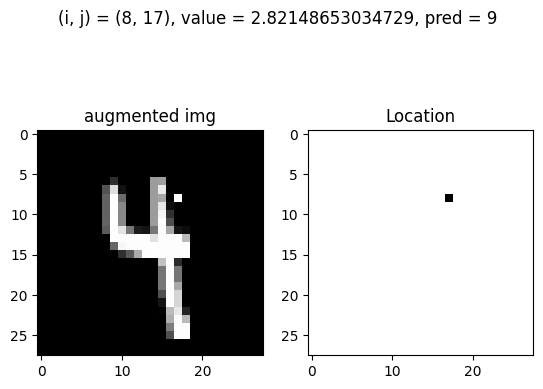

Test: At (i, j) = (8, 18) and value = 2.1002199862959356, pred = 9, before_pred = 4, gt = 4


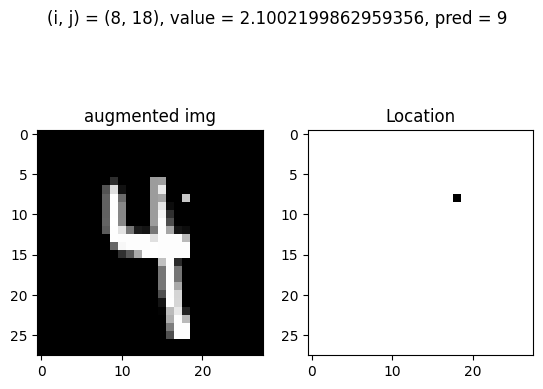

Test: At (i, j) = (8, 18) and value = 2.4608532583216127, pred = 9, before_pred = 4, gt = 4


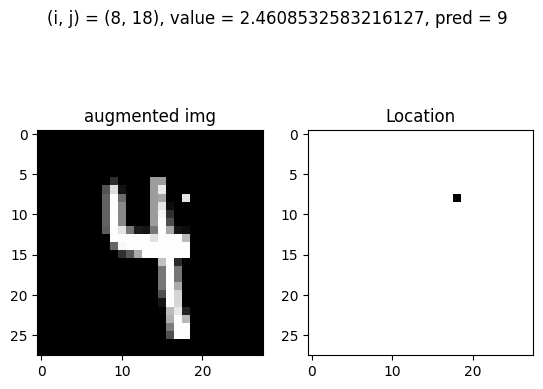

Test: At (i, j) = (8, 18) and value = 2.82148653034729, pred = 9, before_pred = 4, gt = 4


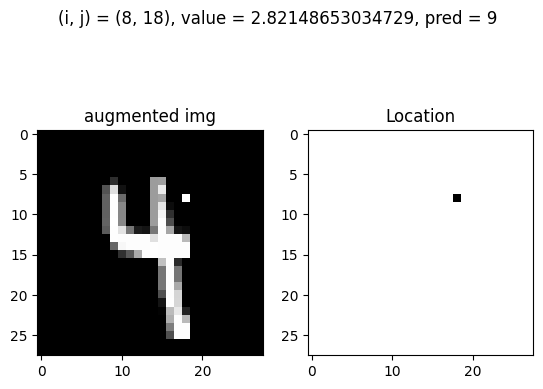

Test: At (i, j) = (9, 13) and value = 2.4608532583216127, pred = 9, before_pred = 4, gt = 4


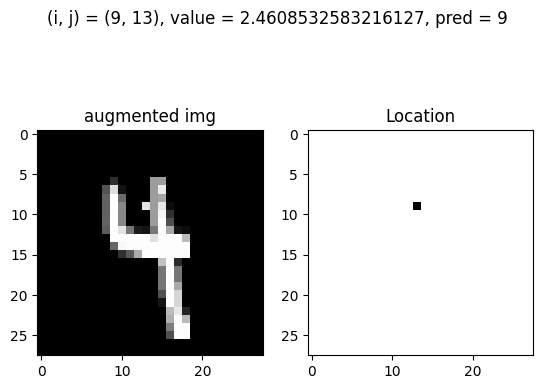

Test: At (i, j) = (9, 13) and value = 2.82148653034729, pred = 9, before_pred = 4, gt = 4


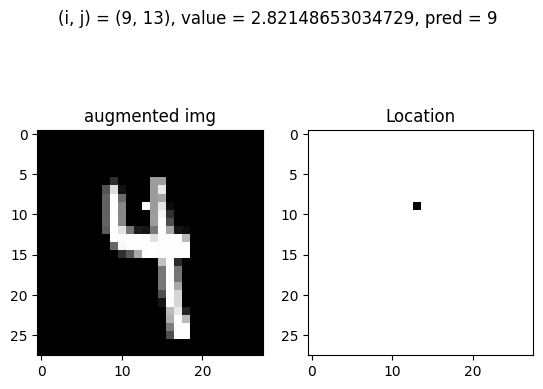

Test: At (i, j) = (9, 16) and value = 2.4608532583216127, pred = 9, before_pred = 4, gt = 4


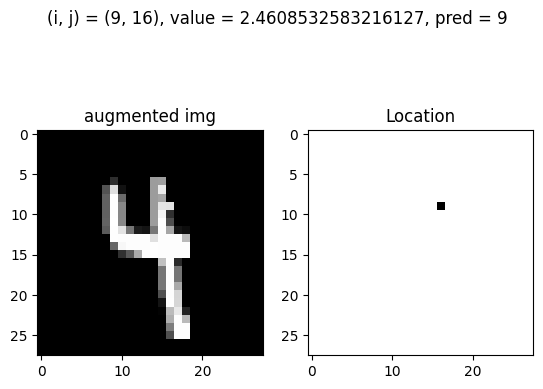

Test: At (i, j) = (9, 16) and value = 2.82148653034729, pred = 9, before_pred = 4, gt = 4


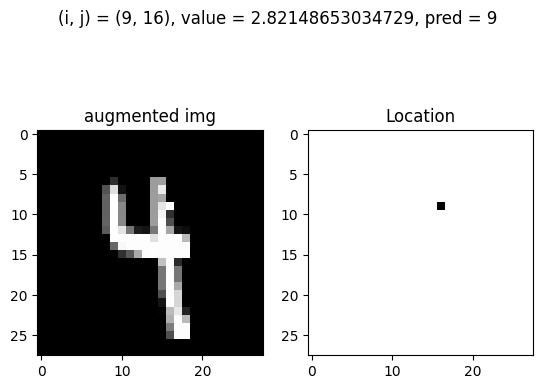

Test: At (i, j) = (10, 16) and value = 2.82148653034729, pred = 9, before_pred = 4, gt = 4


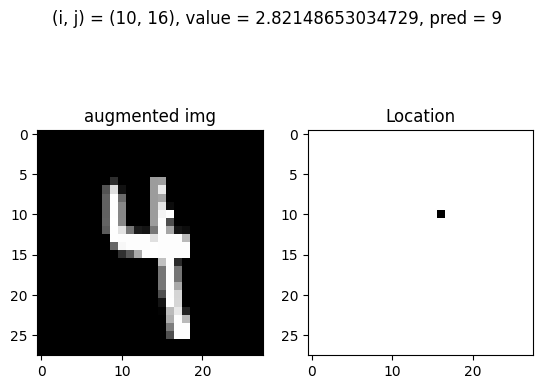

Test: At (i, j) = (13, 11) and value = -0.424212917883804, pred = 9, before_pred = 4, gt = 4


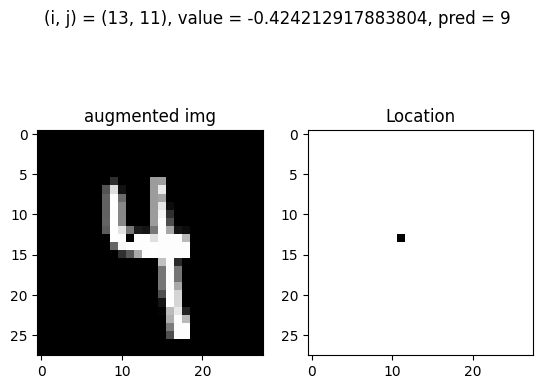

Test: At (i, j) = (13, 11) and value = -0.06357964585812692, pred = 9, before_pred = 4, gt = 4


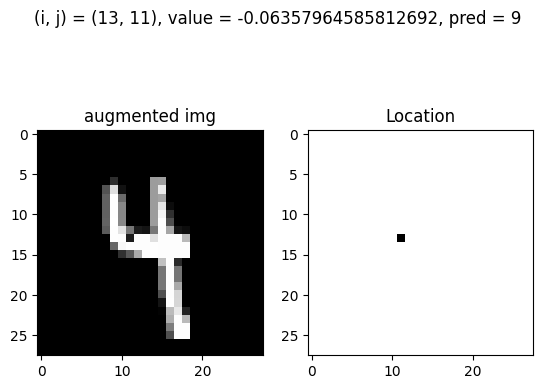

Test: At (i, j) = (13, 11) and value = 0.29705362616755016, pred = 9, before_pred = 4, gt = 4


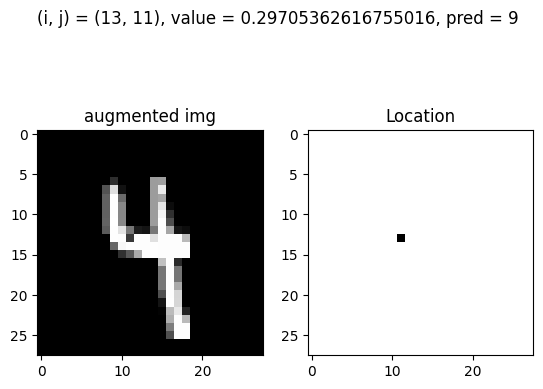

Test: At (i, j) = (14, 10) and value = -0.424212917883804, pred = 9, before_pred = 4, gt = 4


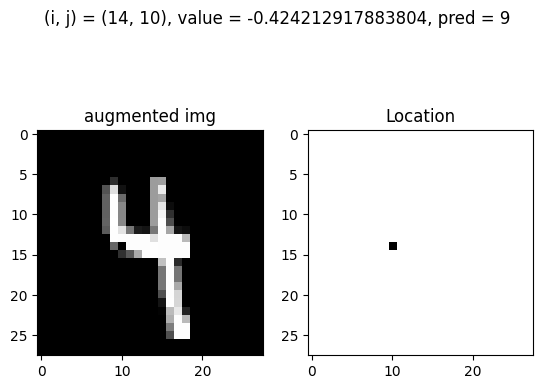

Test: At (i, j) = (14, 10) and value = -0.06357964585812692, pred = 9, before_pred = 4, gt = 4


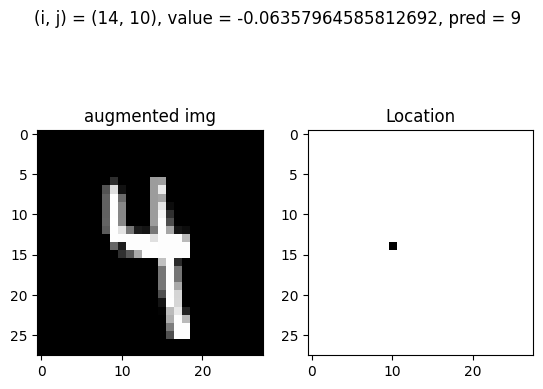

Test: At (i, j) = (14, 11) and value = -0.424212917883804, pred = 9, before_pred = 4, gt = 4


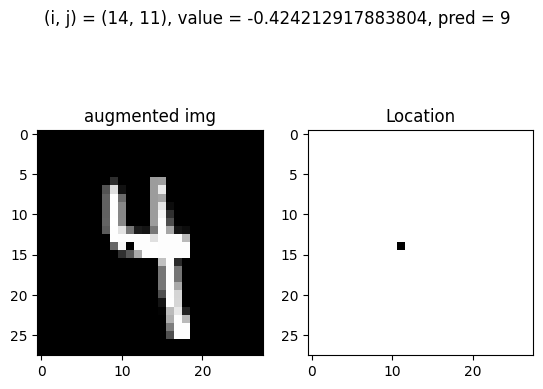

Test: At (i, j) = (14, 12) and value = -0.424212917883804, pred = 9, before_pred = 4, gt = 4


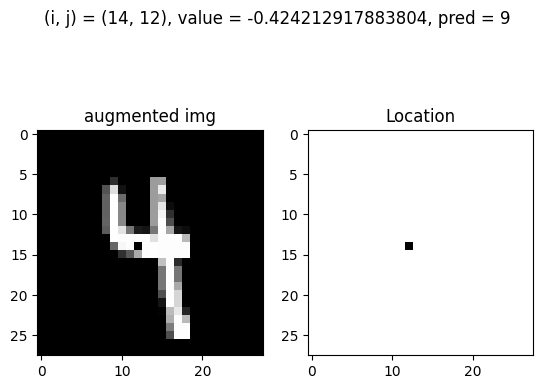

Test: At (i, j) = (14, 12) and value = -0.06357964585812692, pred = 9, before_pred = 4, gt = 4


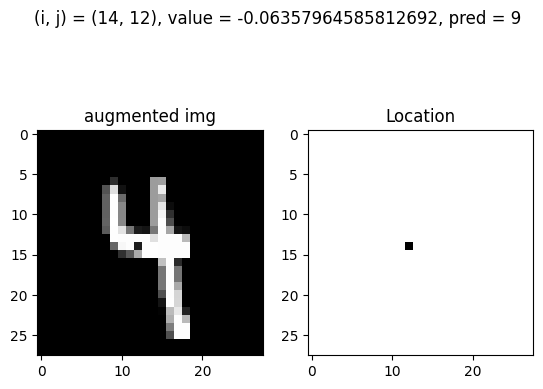

Test: At (i, j) = (15, 13) and value = -0.424212917883804, pred = 9, before_pred = 4, gt = 4


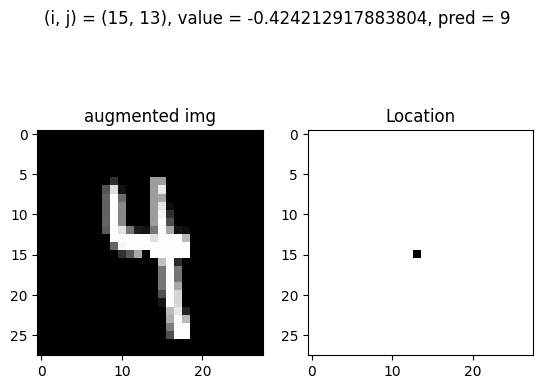

Test: At (i, j) = (15, 13) and value = -0.06357964585812692, pred = 9, before_pred = 4, gt = 4


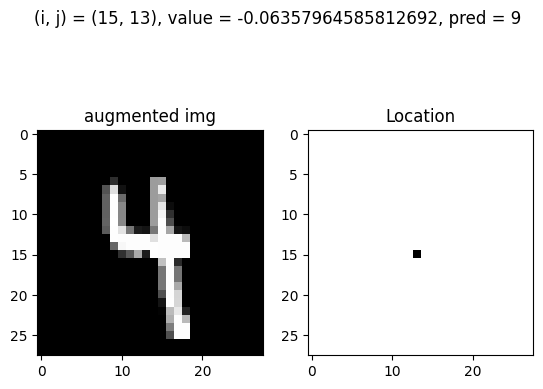

7840 done
7840 done
7840 done
7840 done
7840 done
7840 done
7840 done
7840 done
7840 done
7840 done
7840 done
7840 done
7840 done
7840 done
7840 done
7840 done
7840 done
7840 done
7840 done
7840 done
7840 done
7840 done
7840 done
7840 done
7840 done
7840 done
7840 done
7840 done
7840 done
7840 done
7840 done
7840 done
Test: At (i, j) = (11, 14) and value = -0.424212917883804, pred = 4, before_pred = 8, gt = 8


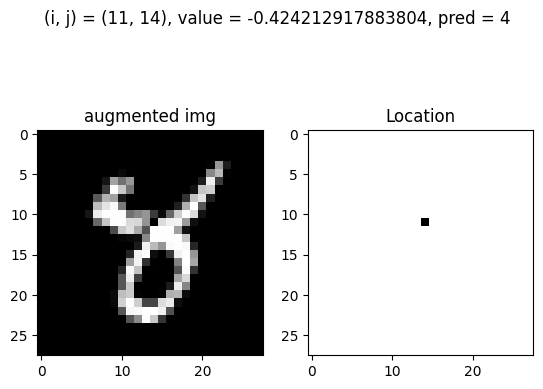

Test: At (i, j) = (11, 14) and value = -0.06357964585812692, pred = 4, before_pred = 8, gt = 8


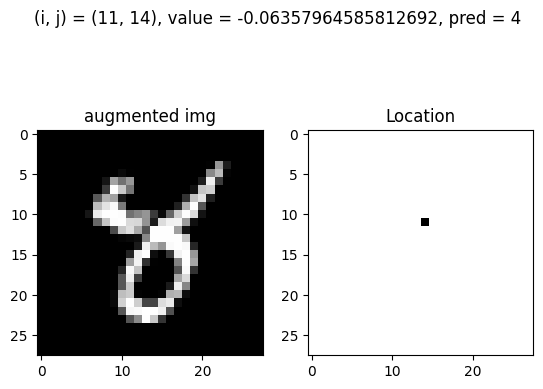

Test: At (i, j) = (11, 14) and value = 0.29705362616755016, pred = 4, before_pred = 8, gt = 8


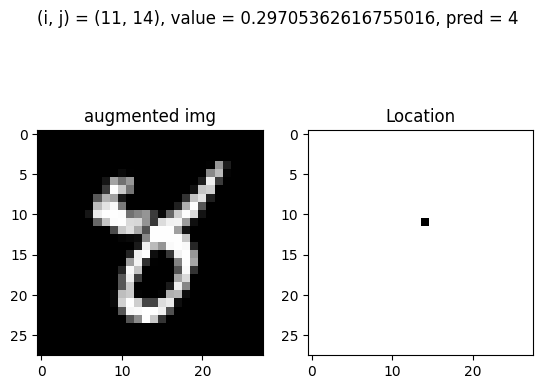

Test: At (i, j) = (11, 14) and value = 0.6576868981932272, pred = 4, before_pred = 8, gt = 8


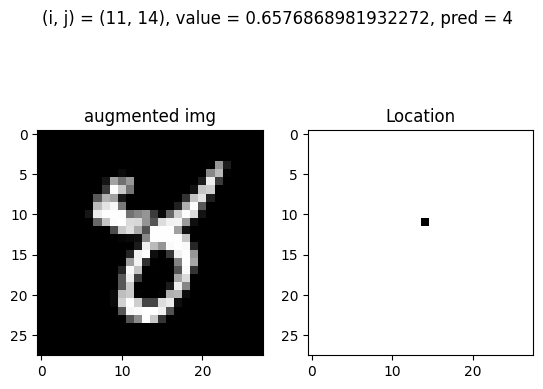

Test: At (i, j) = (12, 14) and value = -0.424212917883804, pred = 4, before_pred = 8, gt = 8


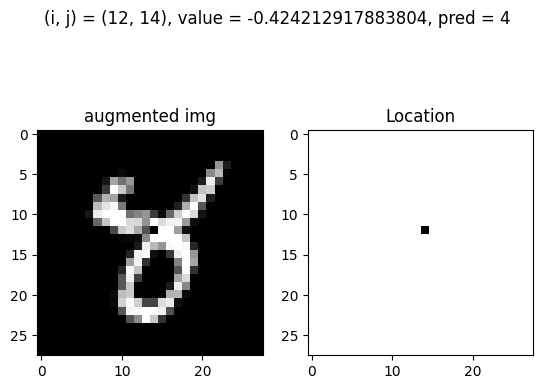

Test: At (i, j) = (12, 14) and value = -0.06357964585812692, pred = 4, before_pred = 8, gt = 8


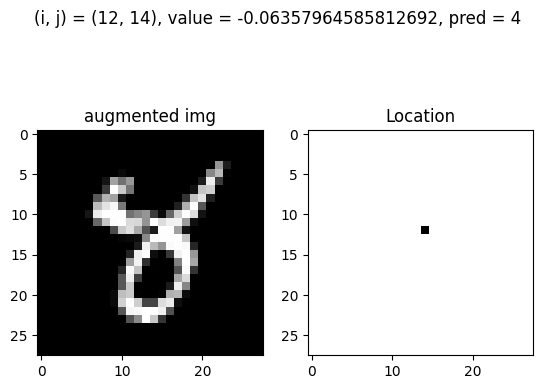

Test: At (i, j) = (12, 14) and value = 0.29705362616755016, pred = 4, before_pred = 8, gt = 8


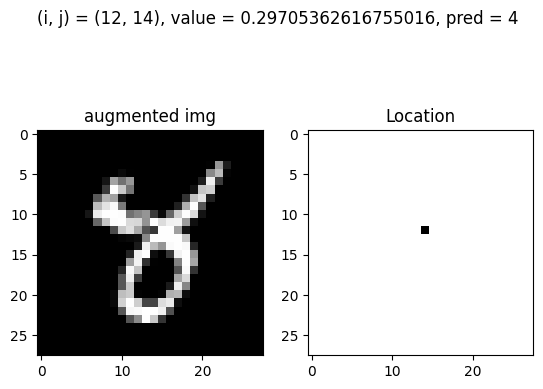

Test: At (i, j) = (12, 14) and value = 0.6576868981932272, pred = 4, before_pred = 8, gt = 8


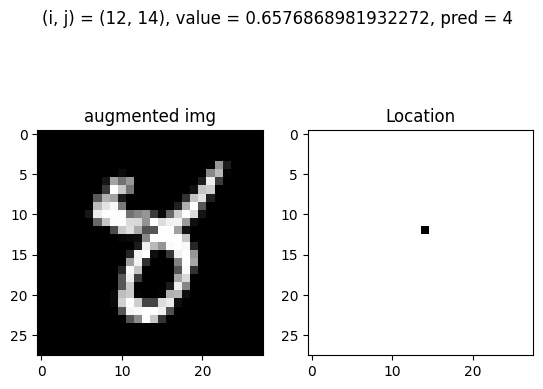

Test: At (i, j) = (12, 14) and value = 1.0183201702189044, pred = 4, before_pred = 8, gt = 8


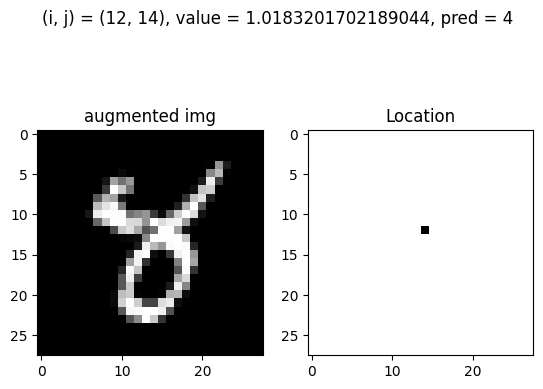

Test: At (i, j) = (13, 6) and value = 2.1002199862959356, pred = 4, before_pred = 8, gt = 8


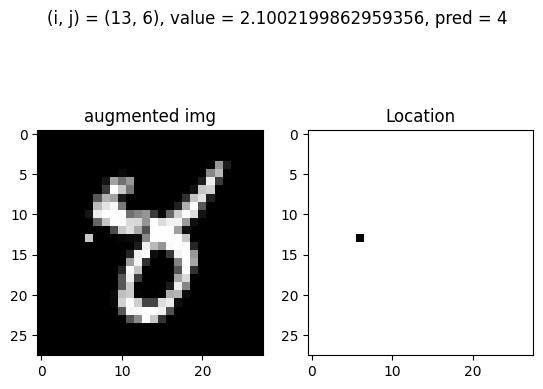

Test: At (i, j) = (13, 6) and value = 2.4608532583216127, pred = 4, before_pred = 8, gt = 8


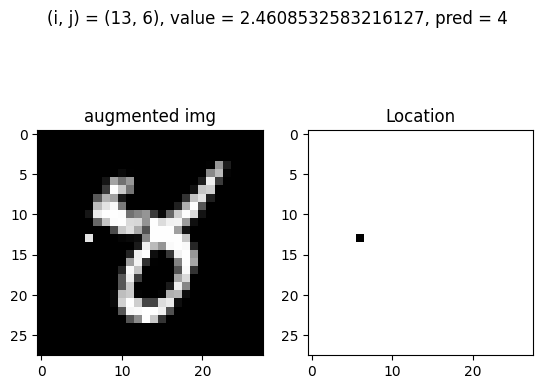

Test: At (i, j) = (13, 6) and value = 2.82148653034729, pred = 4, before_pred = 8, gt = 8


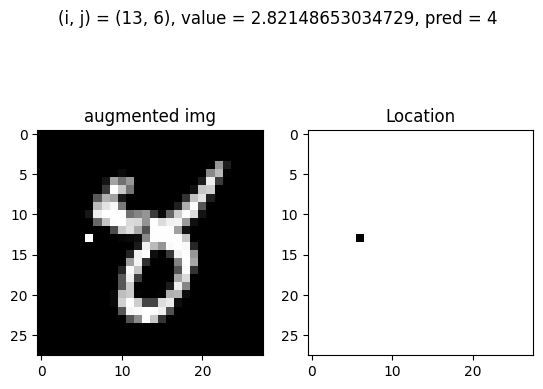

Test: At (i, j) = (13, 7) and value = 2.4608532583216127, pred = 4, before_pred = 8, gt = 8


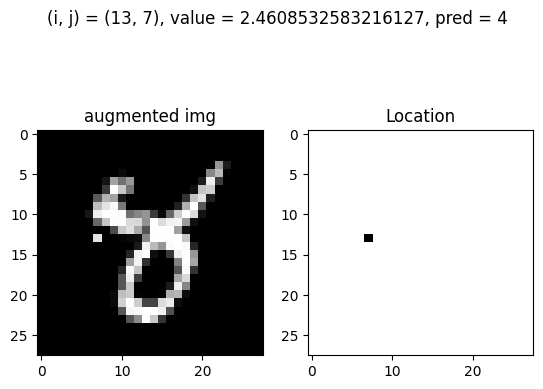

Test: At (i, j) = (13, 7) and value = 2.82148653034729, pred = 4, before_pred = 8, gt = 8


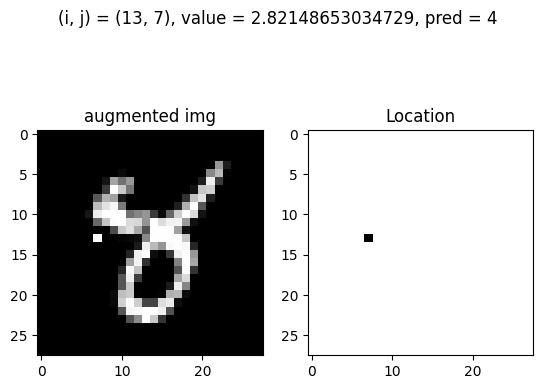

Test: At (i, j) = (13, 8) and value = 1.3789534422445815, pred = 4, before_pred = 8, gt = 8


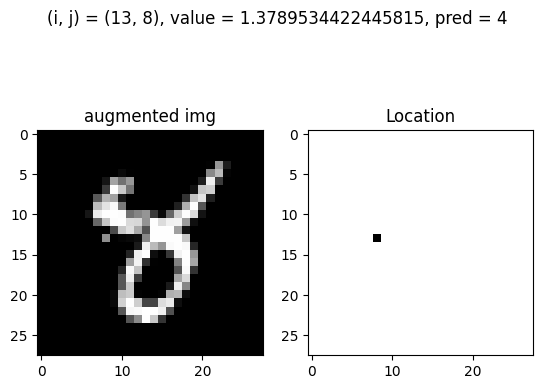

Test: At (i, j) = (13, 8) and value = 1.7395867142702586, pred = 4, before_pred = 8, gt = 8


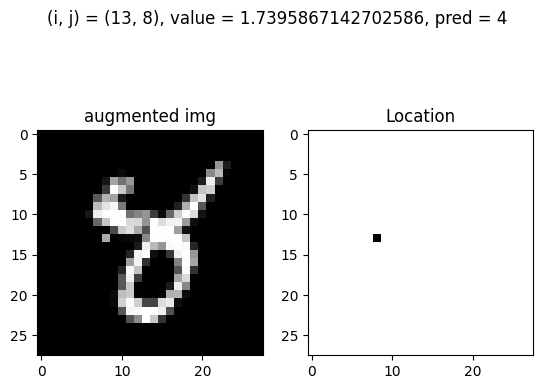

Test: At (i, j) = (13, 8) and value = 2.1002199862959356, pred = 4, before_pred = 8, gt = 8


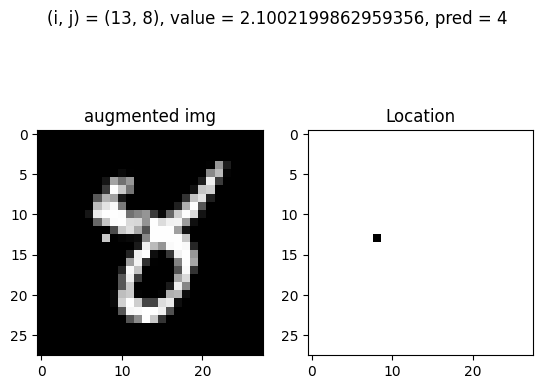

Test: At (i, j) = (13, 8) and value = 2.4608532583216127, pred = 4, before_pred = 8, gt = 8


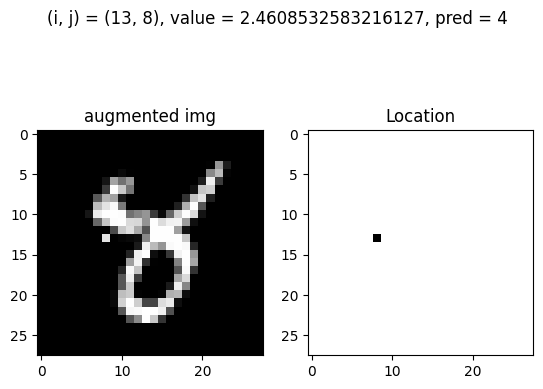

Test: At (i, j) = (13, 8) and value = 2.82148653034729, pred = 4, before_pred = 8, gt = 8


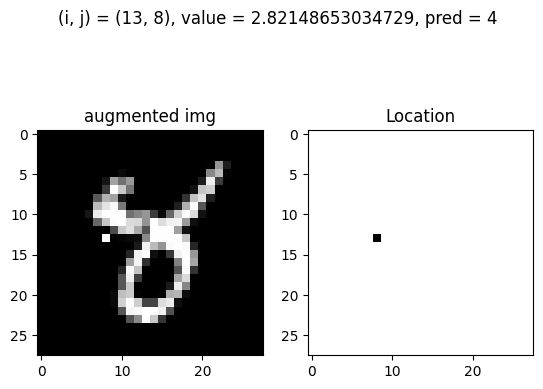

Test: At (i, j) = (13, 9) and value = 2.4608532583216127, pred = 4, before_pred = 8, gt = 8


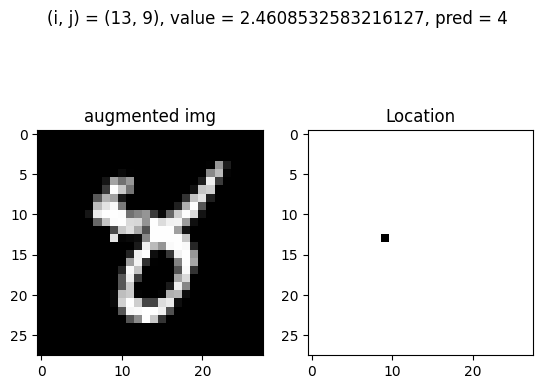

Test: At (i, j) = (13, 9) and value = 2.82148653034729, pred = 4, before_pred = 8, gt = 8


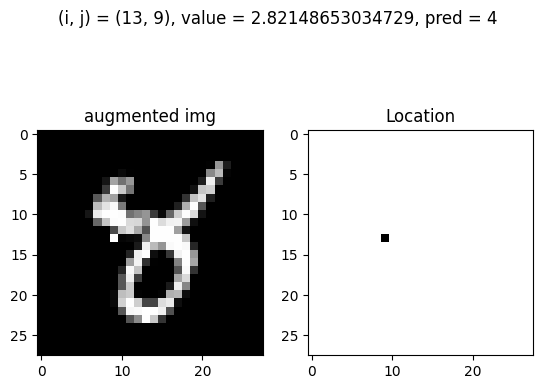

Test: At (i, j) = (13, 14) and value = -0.424212917883804, pred = 4, before_pred = 8, gt = 8


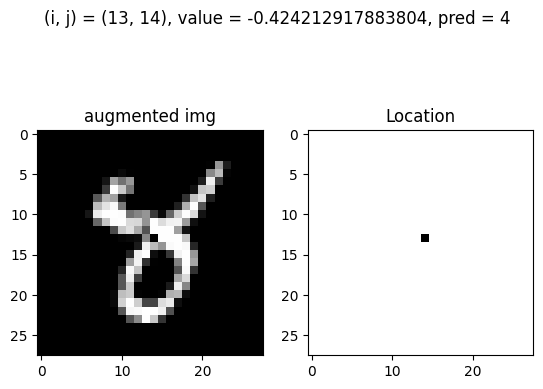

Test: At (i, j) = (14, 6) and value = 1.7395867142702586, pred = 4, before_pred = 8, gt = 8


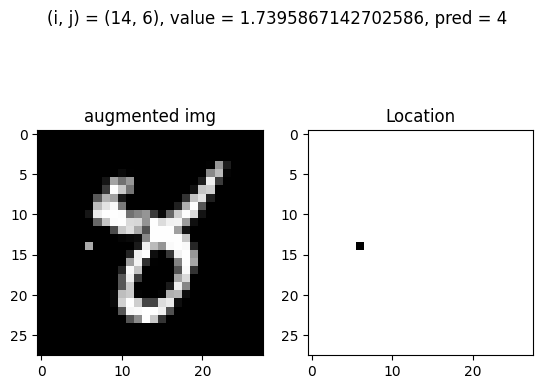

Test: At (i, j) = (14, 6) and value = 2.1002199862959356, pred = 4, before_pred = 8, gt = 8


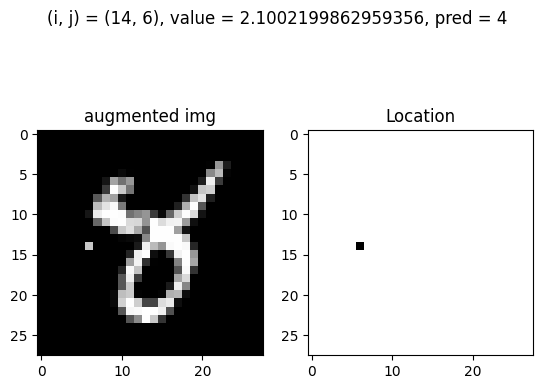

Test: At (i, j) = (14, 6) and value = 2.4608532583216127, pred = 4, before_pred = 8, gt = 8


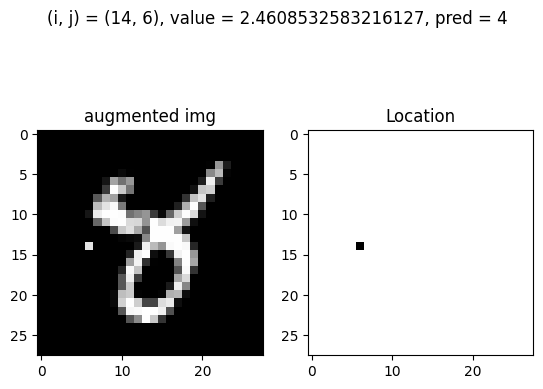

Test: At (i, j) = (14, 6) and value = 2.82148653034729, pred = 4, before_pred = 8, gt = 8


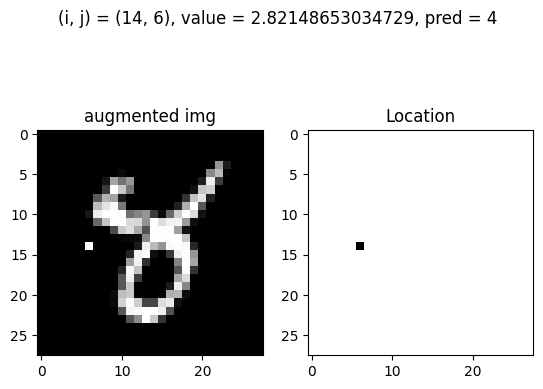

Test: At (i, j) = (14, 7) and value = 2.1002199862959356, pred = 4, before_pred = 8, gt = 8


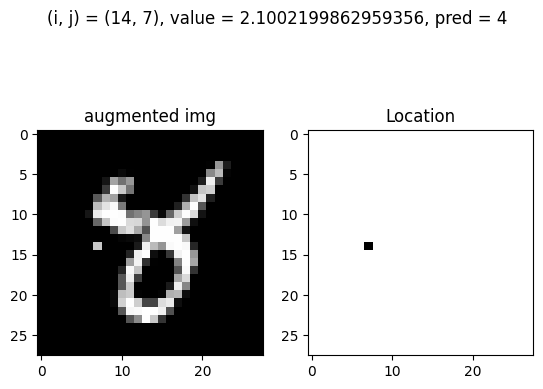

Test: At (i, j) = (14, 7) and value = 2.4608532583216127, pred = 4, before_pred = 8, gt = 8


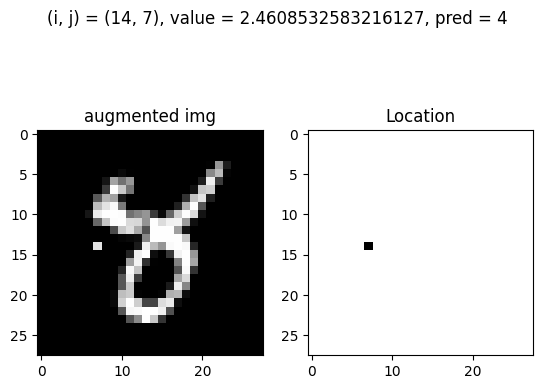

Test: At (i, j) = (14, 7) and value = 2.82148653034729, pred = 4, before_pred = 8, gt = 8


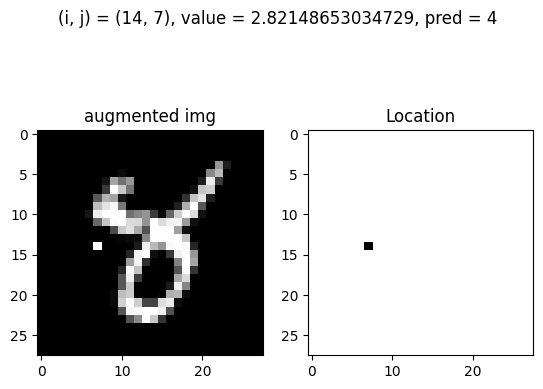

Test: At (i, j) = (14, 8) and value = 1.7395867142702586, pred = 4, before_pred = 8, gt = 8


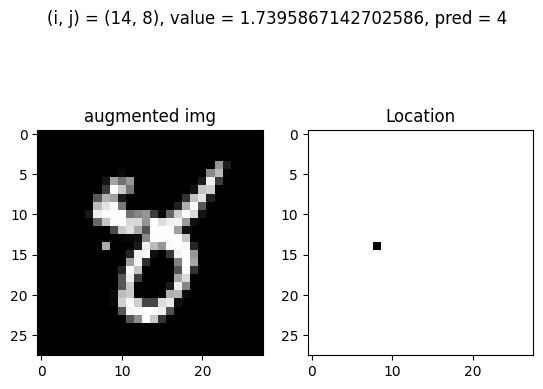

Test: At (i, j) = (14, 8) and value = 2.1002199862959356, pred = 4, before_pred = 8, gt = 8


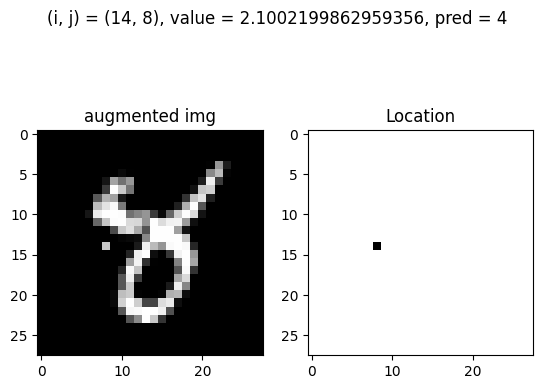

Test: At (i, j) = (14, 8) and value = 2.4608532583216127, pred = 4, before_pred = 8, gt = 8


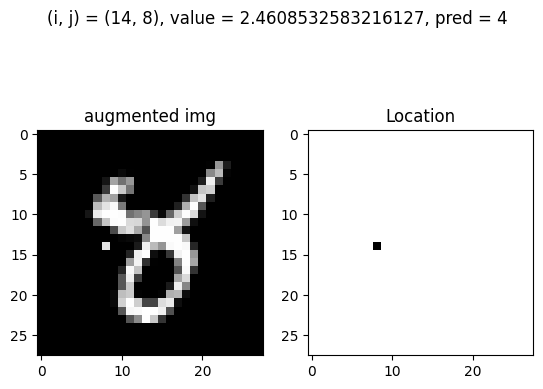

Test: At (i, j) = (14, 8) and value = 2.82148653034729, pred = 4, before_pred = 8, gt = 8


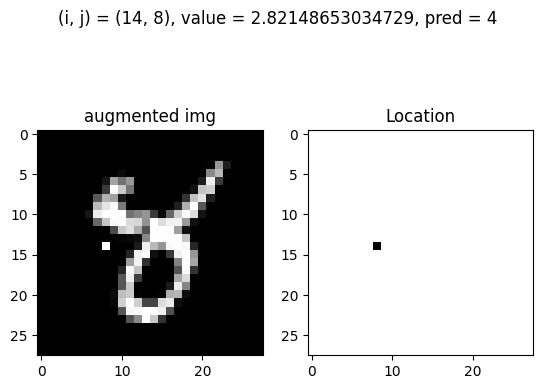

Test: At (i, j) = (14, 9) and value = 1.7395867142702586, pred = 4, before_pred = 8, gt = 8


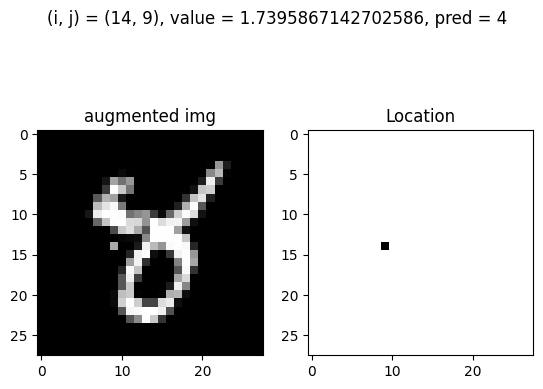

Test: At (i, j) = (14, 9) and value = 2.1002199862959356, pred = 4, before_pred = 8, gt = 8


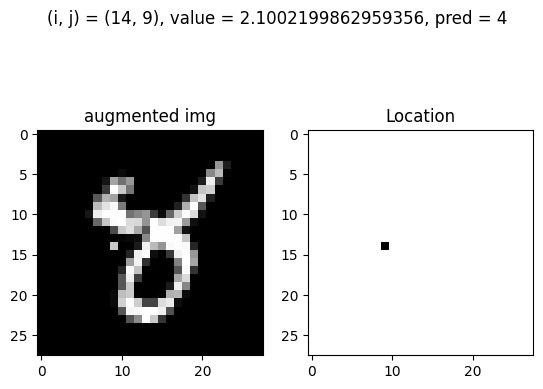

Test: At (i, j) = (14, 9) and value = 2.4608532583216127, pred = 4, before_pred = 8, gt = 8


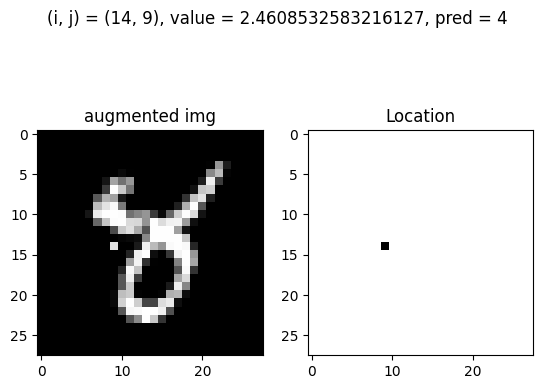

Test: At (i, j) = (14, 9) and value = 2.82148653034729, pred = 4, before_pred = 8, gt = 8


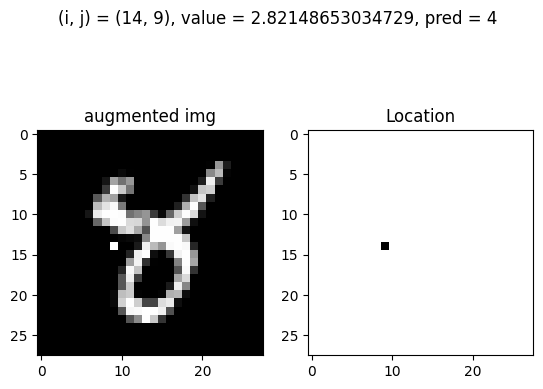

Test: At (i, j) = (14, 10) and value = 2.1002199862959356, pred = 4, before_pred = 8, gt = 8


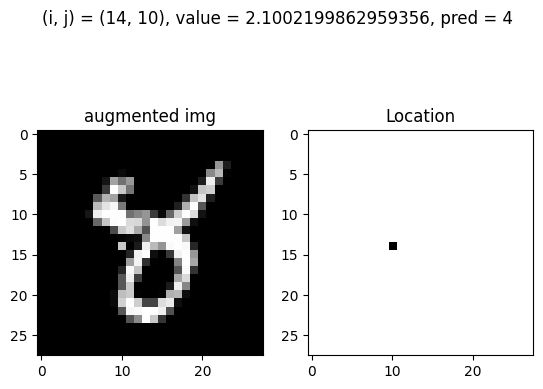

Test: At (i, j) = (14, 10) and value = 2.4608532583216127, pred = 4, before_pred = 8, gt = 8


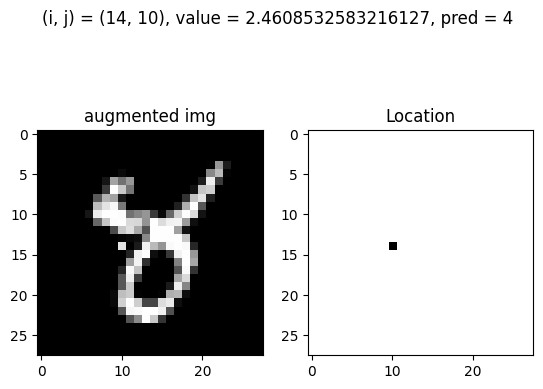

Test: At (i, j) = (14, 10) and value = 2.82148653034729, pred = 4, before_pred = 8, gt = 8


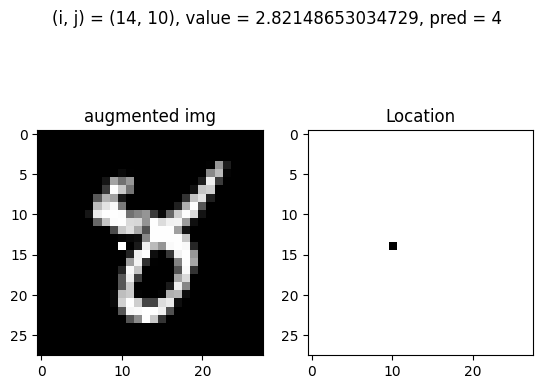

Test: At (i, j) = (14, 13) and value = -0.424212917883804, pred = 4, before_pred = 8, gt = 8


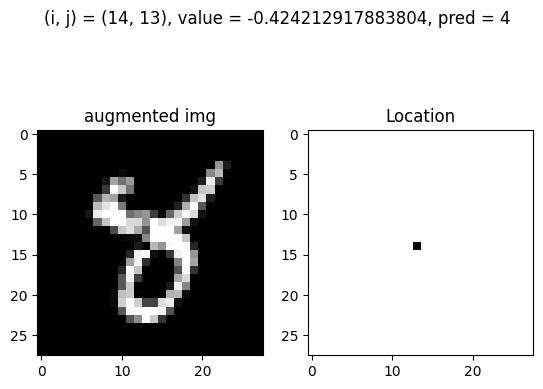

Test: At (i, j) = (14, 13) and value = -0.06357964585812692, pred = 4, before_pred = 8, gt = 8


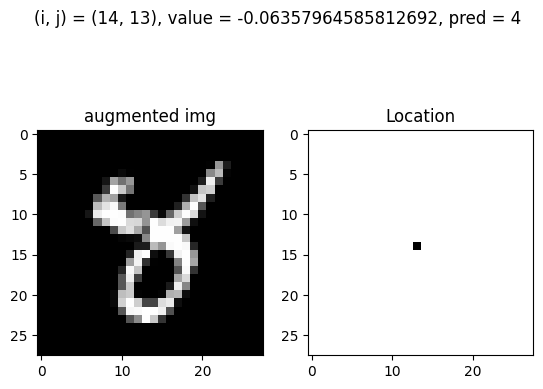

Test: At (i, j) = (14, 13) and value = 0.29705362616755016, pred = 4, before_pred = 8, gt = 8


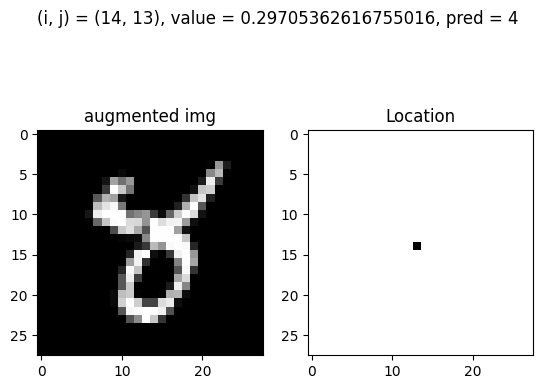

Test: At (i, j) = (14, 13) and value = 0.6576868981932272, pred = 4, before_pred = 8, gt = 8


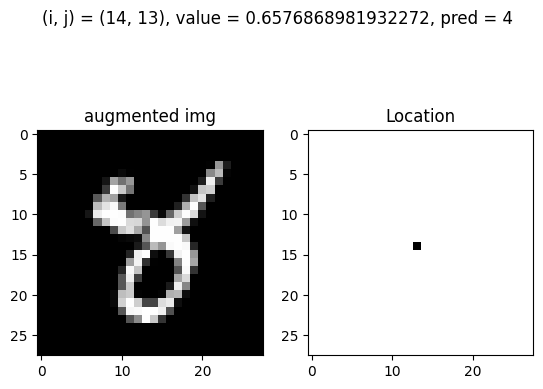

Test: At (i, j) = (14, 22) and value = 2.1002199862959356, pred = 4, before_pred = 8, gt = 8


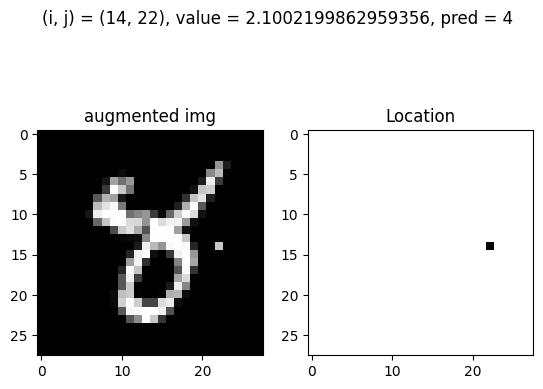

Test: At (i, j) = (14, 22) and value = 2.4608532583216127, pred = 4, before_pred = 8, gt = 8


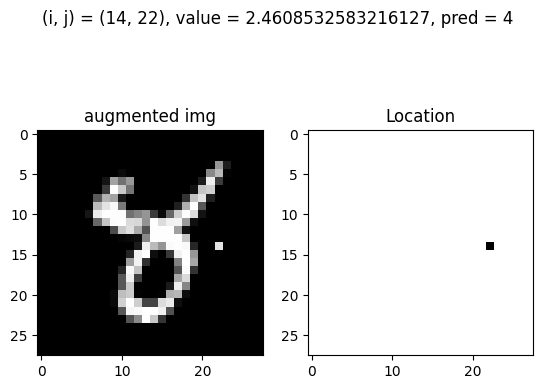

Test: At (i, j) = (14, 22) and value = 2.82148653034729, pred = 4, before_pred = 8, gt = 8


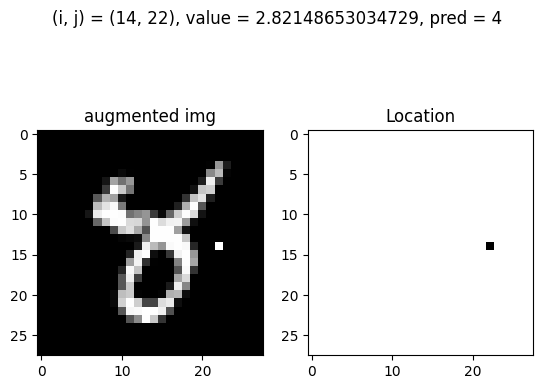

Test: At (i, j) = (15, 7) and value = 2.1002199862959356, pred = 4, before_pred = 8, gt = 8


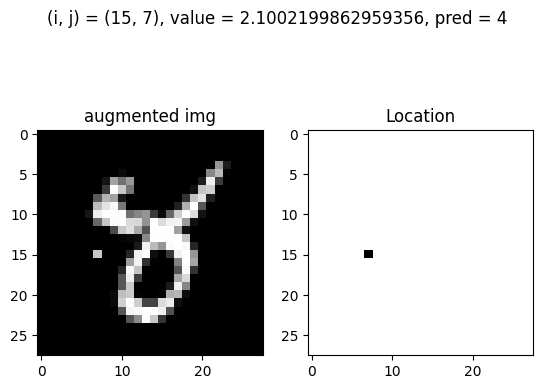

Test: At (i, j) = (15, 7) and value = 2.4608532583216127, pred = 4, before_pred = 8, gt = 8


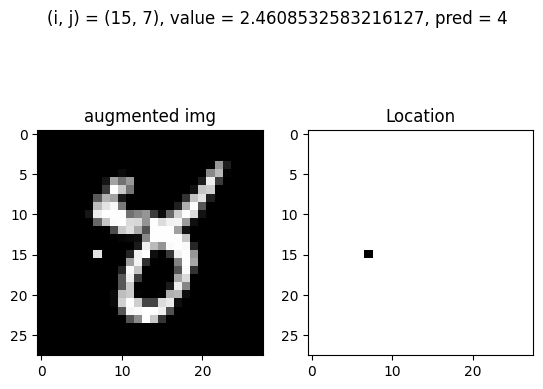

Test: At (i, j) = (15, 7) and value = 2.82148653034729, pred = 4, before_pred = 8, gt = 8


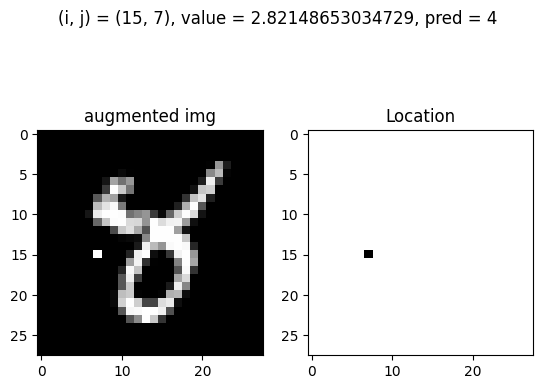

Test: At (i, j) = (15, 8) and value = 1.7395867142702586, pred = 4, before_pred = 8, gt = 8


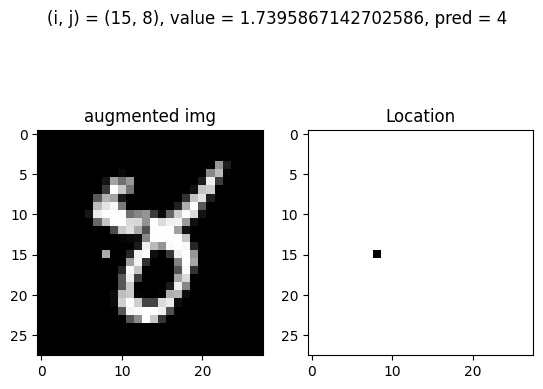

Test: At (i, j) = (15, 8) and value = 2.1002199862959356, pred = 4, before_pred = 8, gt = 8


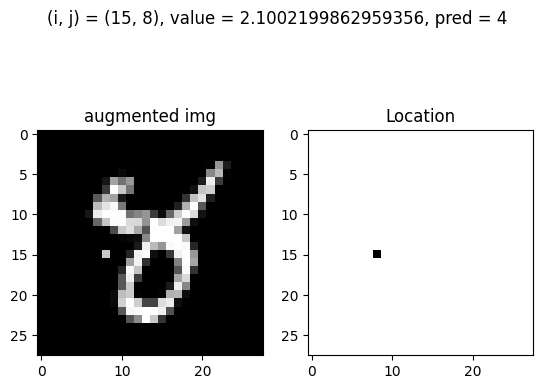

Test: At (i, j) = (15, 8) and value = 2.4608532583216127, pred = 4, before_pred = 8, gt = 8


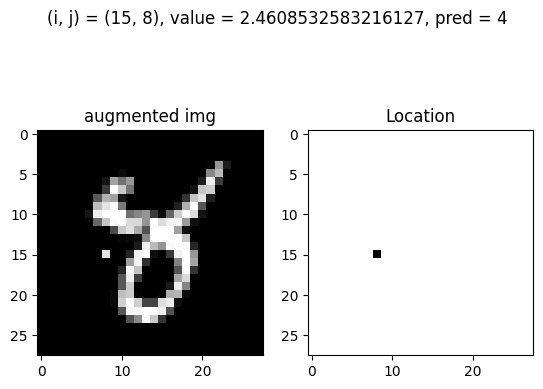

Test: At (i, j) = (15, 8) and value = 2.82148653034729, pred = 4, before_pred = 8, gt = 8


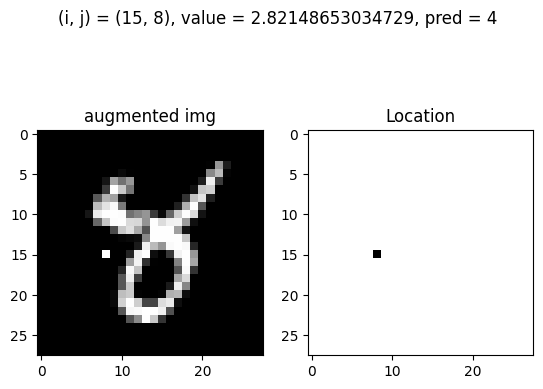

Test: At (i, j) = (15, 9) and value = 2.1002199862959356, pred = 4, before_pred = 8, gt = 8


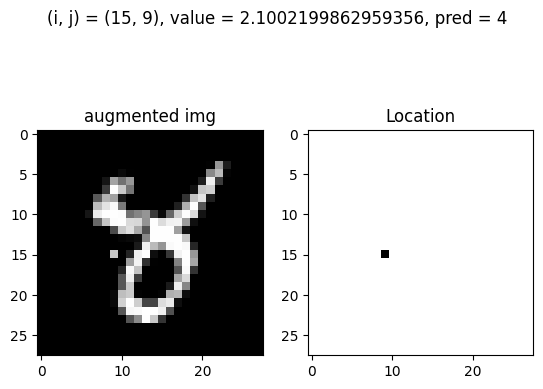

Test: At (i, j) = (15, 9) and value = 2.4608532583216127, pred = 4, before_pred = 8, gt = 8


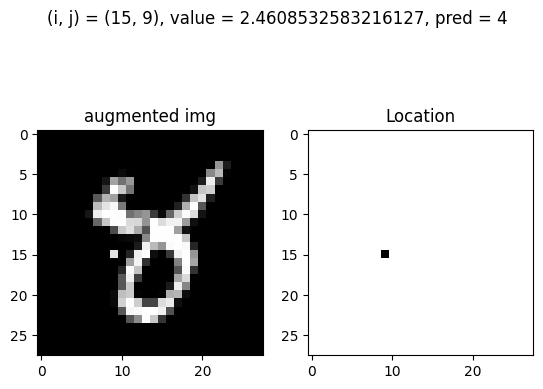

Test: At (i, j) = (15, 9) and value = 2.82148653034729, pred = 4, before_pred = 8, gt = 8


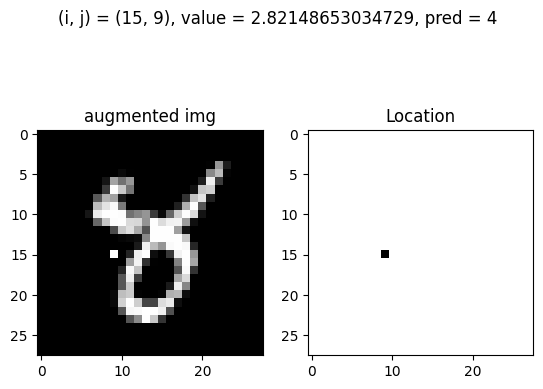

Test: At (i, j) = (15, 13) and value = -0.424212917883804, pred = 4, before_pred = 8, gt = 8


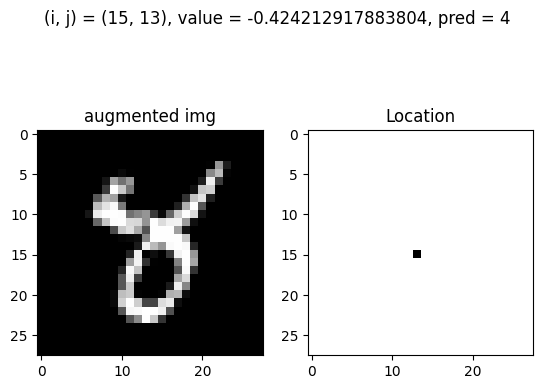

Test: At (i, j) = (15, 13) and value = -0.06357964585812692, pred = 4, before_pred = 8, gt = 8


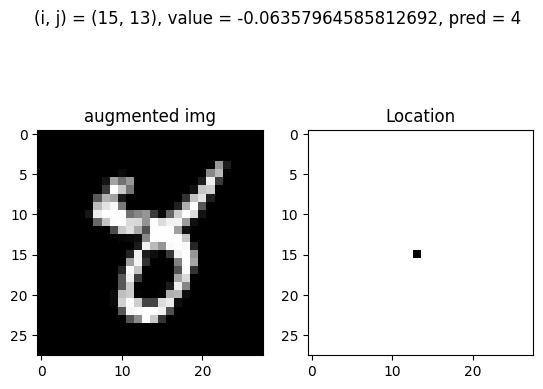

Test: At (i, j) = (15, 16) and value = 2.1002199862959356, pred = 4, before_pred = 8, gt = 8


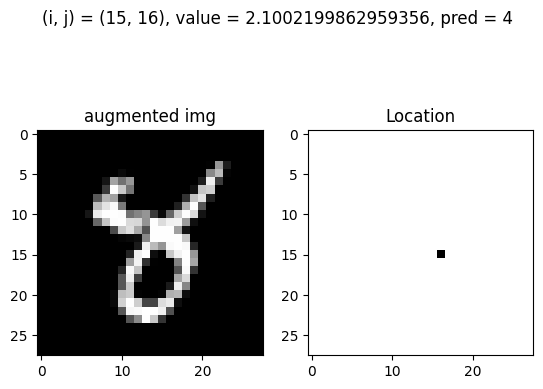

Test: At (i, j) = (15, 16) and value = 2.4608532583216127, pred = 4, before_pred = 8, gt = 8


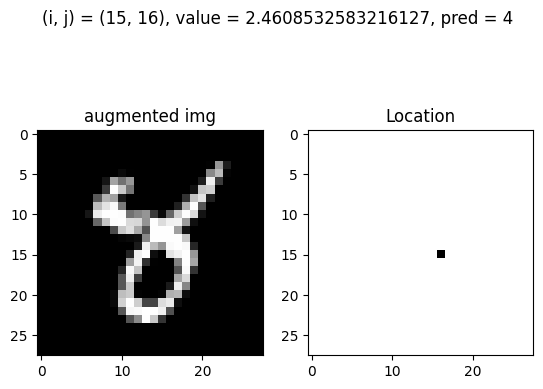

Test: At (i, j) = (15, 16) and value = 2.82148653034729, pred = 4, before_pred = 8, gt = 8


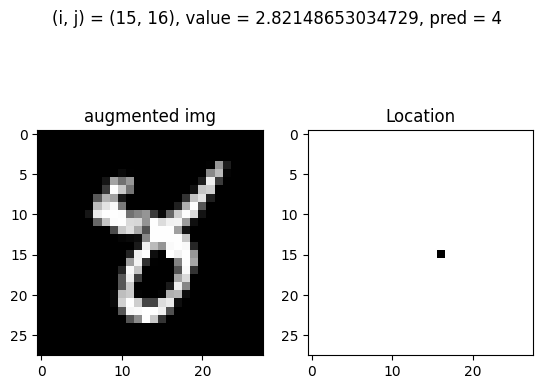

Test: At (i, j) = (15, 20) and value = 2.82148653034729, pred = 4, before_pred = 8, gt = 8


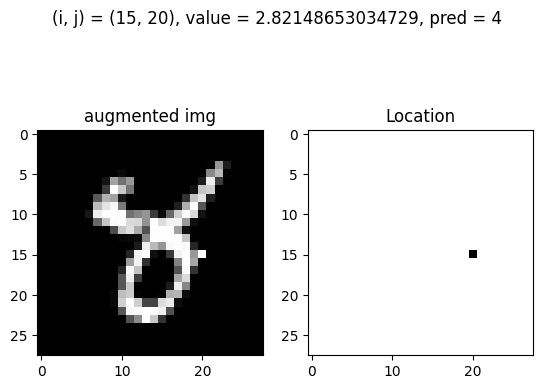

Test: At (i, j) = (16, 6) and value = 2.82148653034729, pred = 4, before_pred = 8, gt = 8


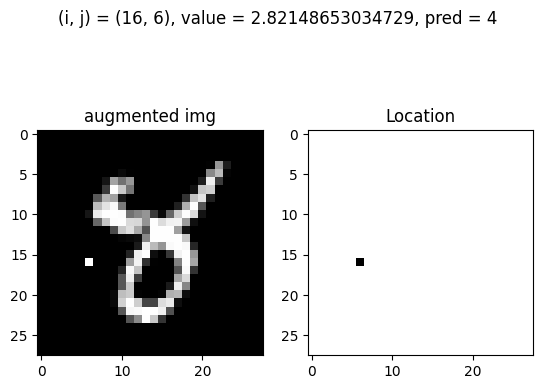

Test: At (i, j) = (16, 7) and value = 1.7395867142702586, pred = 4, before_pred = 8, gt = 8


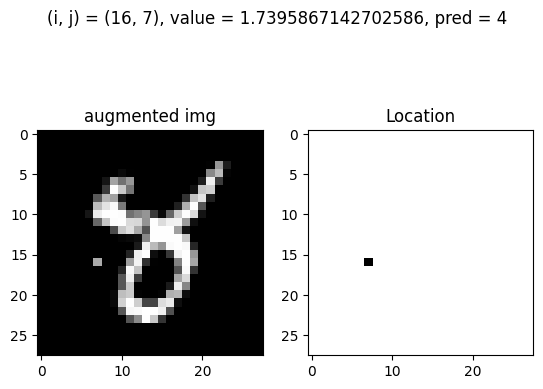

Test: At (i, j) = (16, 7) and value = 2.1002199862959356, pred = 4, before_pred = 8, gt = 8


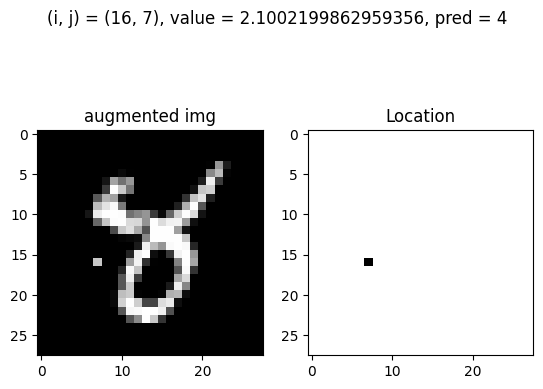

Test: At (i, j) = (16, 7) and value = 2.4608532583216127, pred = 4, before_pred = 8, gt = 8


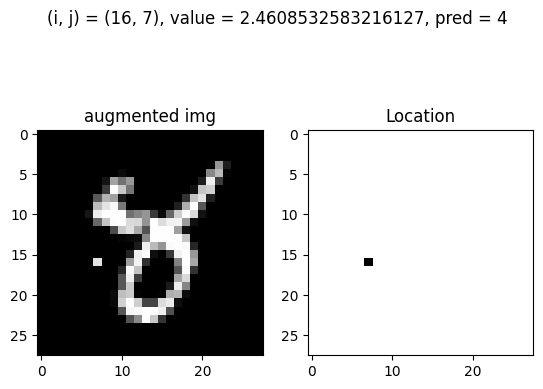

Test: At (i, j) = (16, 7) and value = 2.82148653034729, pred = 4, before_pred = 8, gt = 8


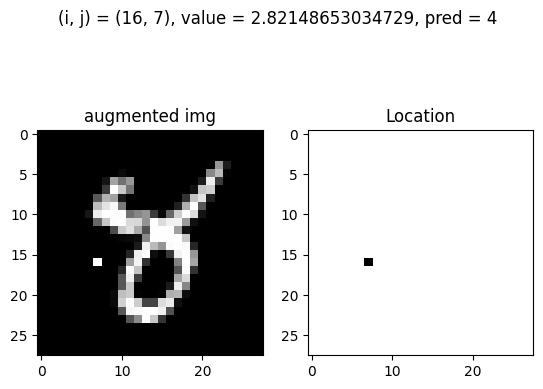

Test: At (i, j) = (16, 8) and value = 1.7395867142702586, pred = 4, before_pred = 8, gt = 8


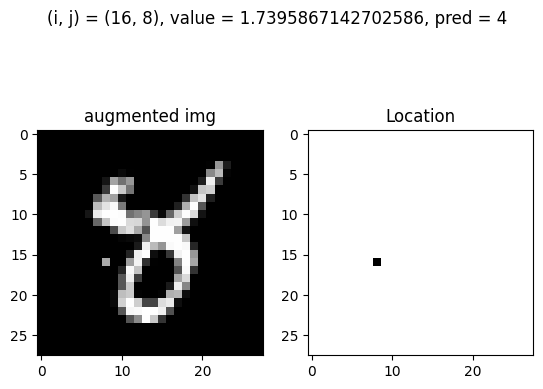

Test: At (i, j) = (16, 8) and value = 2.1002199862959356, pred = 4, before_pred = 8, gt = 8


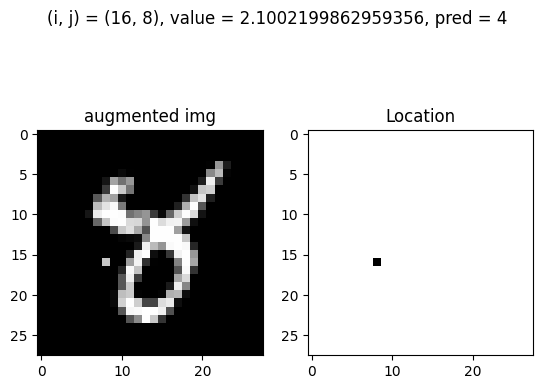

Test: At (i, j) = (16, 8) and value = 2.4608532583216127, pred = 4, before_pred = 8, gt = 8


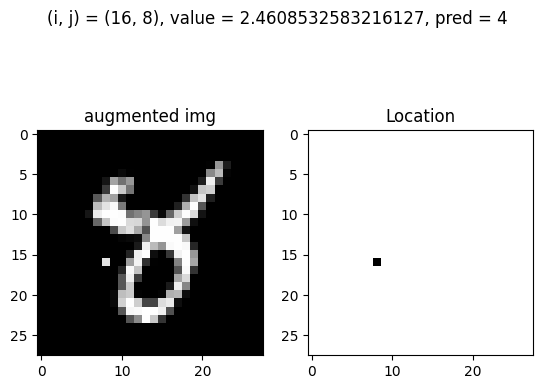

Test: At (i, j) = (16, 8) and value = 2.82148653034729, pred = 4, before_pred = 8, gt = 8


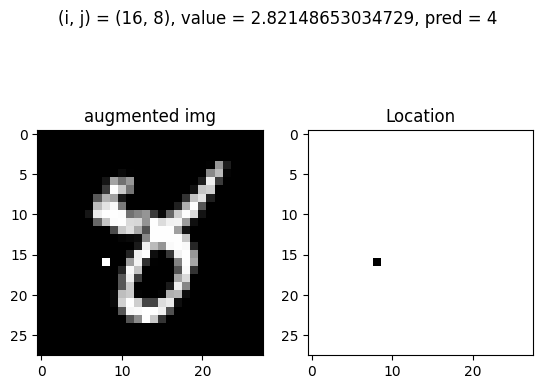

Test: At (i, j) = (16, 16) and value = 1.3789534422445815, pred = 4, before_pred = 8, gt = 8


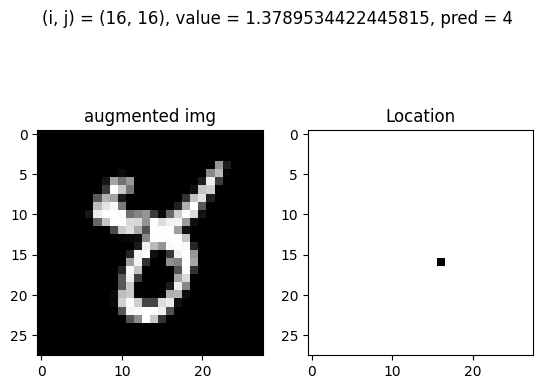

Test: At (i, j) = (16, 16) and value = 1.7395867142702586, pred = 4, before_pred = 8, gt = 8


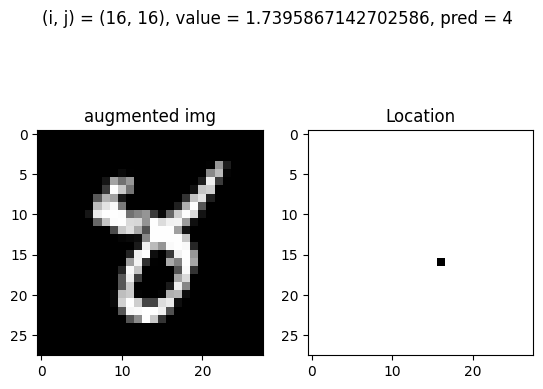

Test: At (i, j) = (16, 16) and value = 2.1002199862959356, pred = 4, before_pred = 8, gt = 8


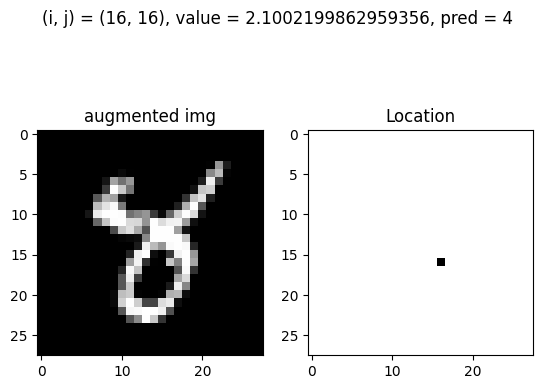

Test: At (i, j) = (16, 16) and value = 2.4608532583216127, pred = 4, before_pred = 8, gt = 8


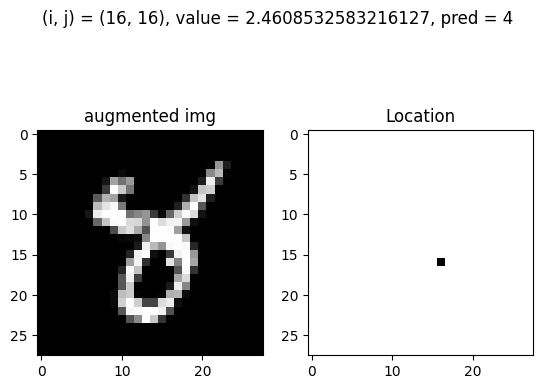

Test: At (i, j) = (16, 16) and value = 2.82148653034729, pred = 4, before_pred = 8, gt = 8


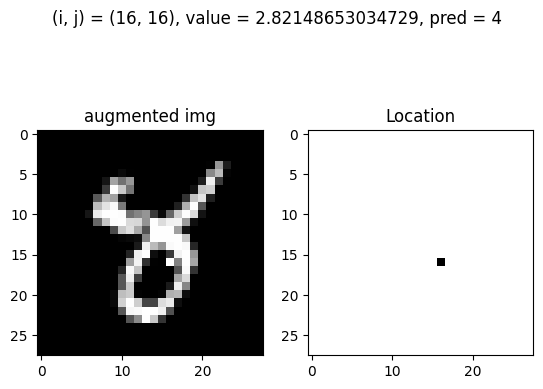

Test: At (i, j) = (17, 7) and value = 2.82148653034729, pred = 4, before_pred = 8, gt = 8


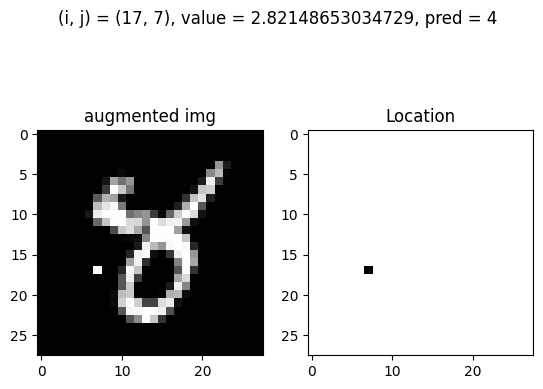

Test: At (i, j) = (17, 14) and value = 2.82148653034729, pred = 4, before_pred = 8, gt = 8


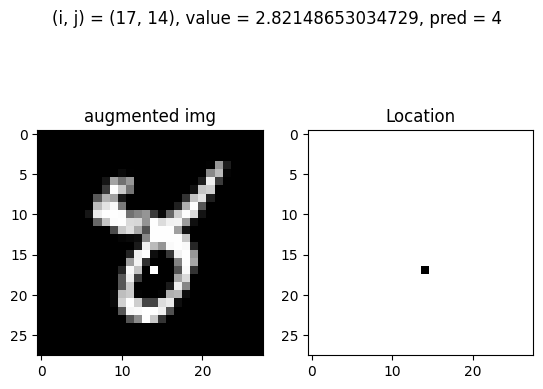

Test: At (i, j) = (17, 15) and value = 2.82148653034729, pred = 4, before_pred = 8, gt = 8


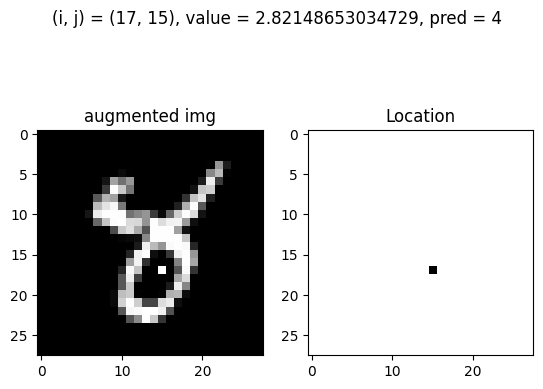

Test: At (i, j) = (22, 11) and value = -0.424212917883804, pred = 4, before_pred = 8, gt = 8


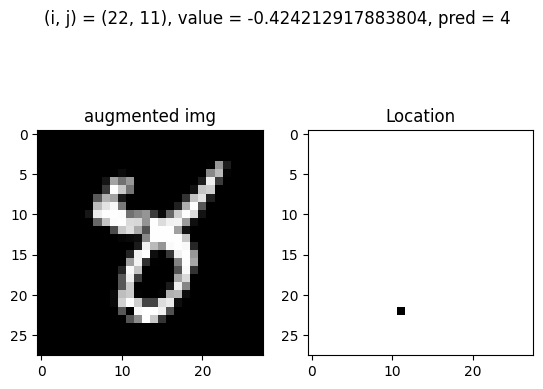

Test: At (i, j) = (22, 11) and value = -0.06357964585812692, pred = 4, before_pred = 8, gt = 8


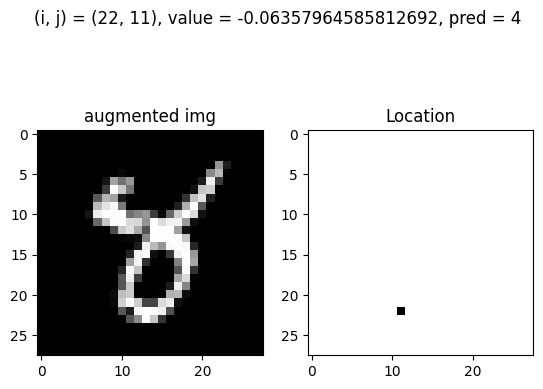

Test: At (i, j) = (22, 12) and value = -0.424212917883804, pred = 4, before_pred = 8, gt = 8


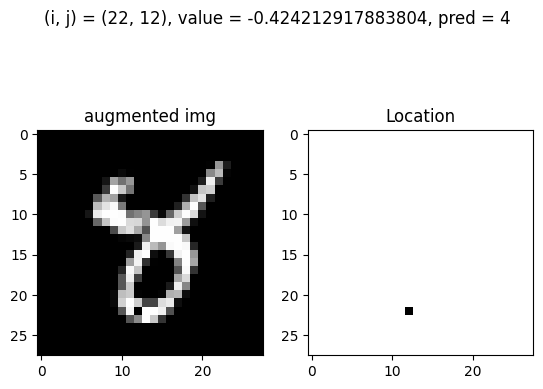

Test: At (i, j) = (22, 12) and value = -0.06357964585812692, pred = 4, before_pred = 8, gt = 8


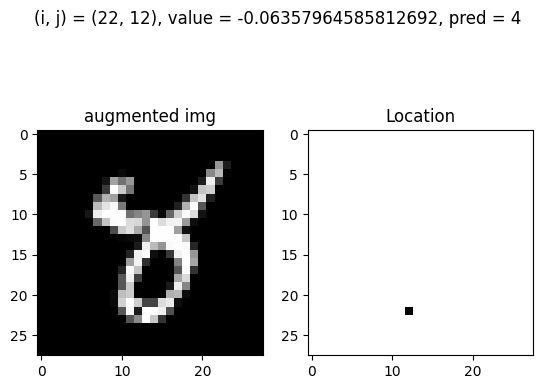

Test: At (i, j) = (22, 12) and value = 0.29705362616755016, pred = 4, before_pred = 8, gt = 8


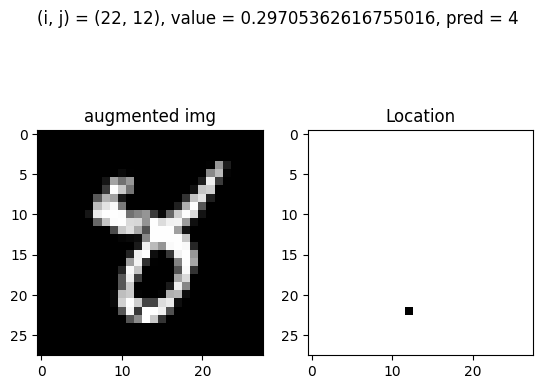

Test: At (i, j) = (22, 13) and value = -0.424212917883804, pred = 4, before_pred = 8, gt = 8


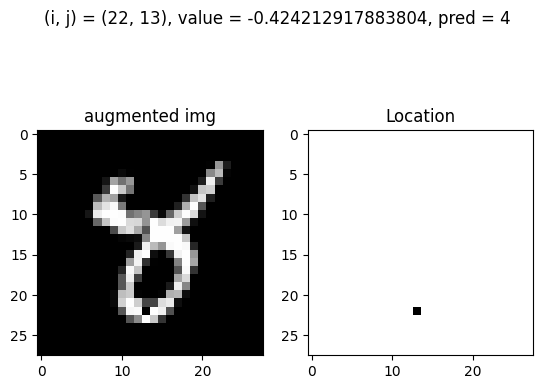

Test: At (i, j) = (22, 14) and value = -0.424212917883804, pred = 4, before_pred = 8, gt = 8


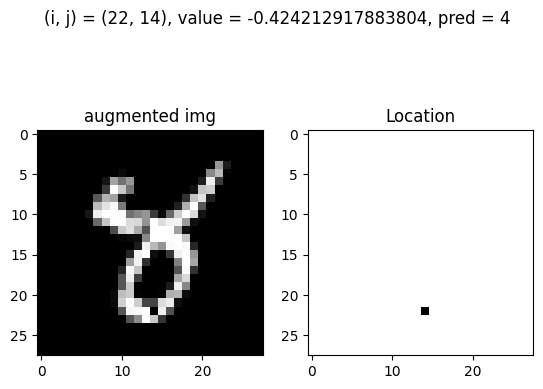

Test: At (i, j) = (23, 13) and value = -0.424212917883804, pred = 4, before_pred = 8, gt = 8


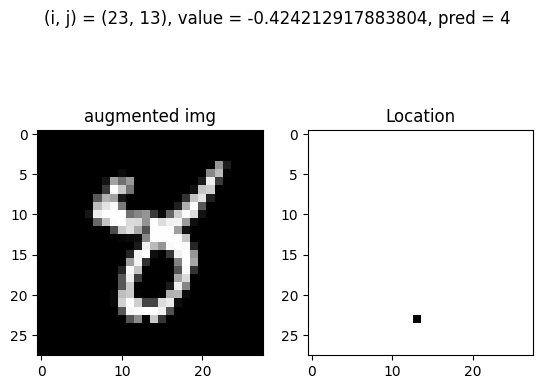

Test: At (i, j) = (23, 13) and value = -0.06357964585812692, pred = 4, before_pred = 8, gt = 8


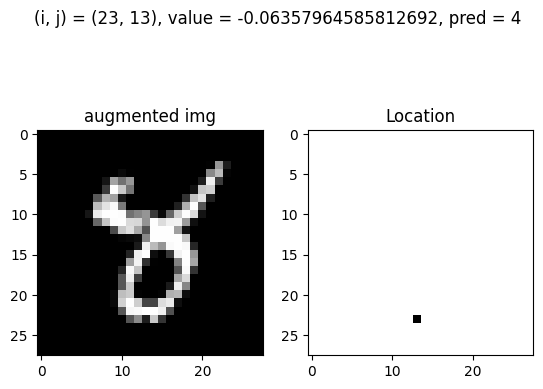

Test: At (i, j) = (23, 13) and value = 0.29705362616755016, pred = 4, before_pred = 8, gt = 8


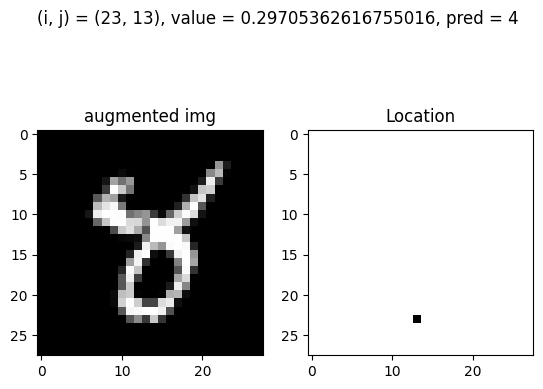

Test: At (i, j) = (23, 13) and value = 0.6576868981932272, pred = 4, before_pred = 8, gt = 8


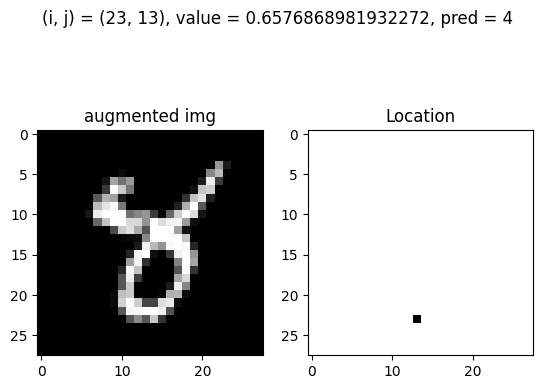

Test: At (i, j) = (25, 6) and value = 2.82148653034729, pred = 4, before_pred = 8, gt = 8


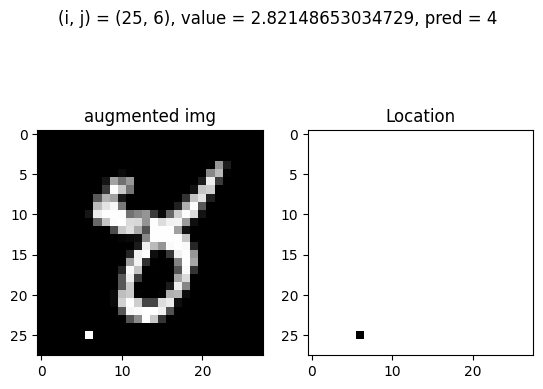

Test: At (i, j) = (26, 12) and value = 2.82148653034729, pred = 4, before_pred = 8, gt = 8


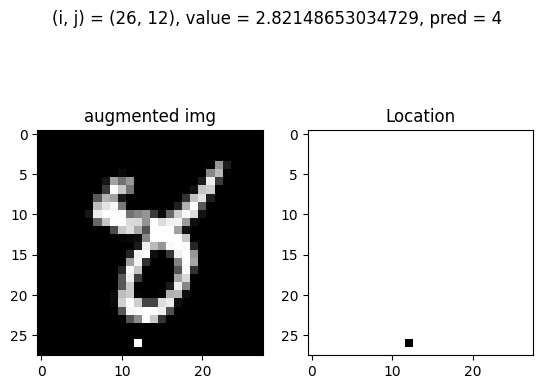

7840 done
Test: At (i, j) = (1, 3) and value = 2.4608532583216127, pred = 9, before_pred = 4, gt = 4


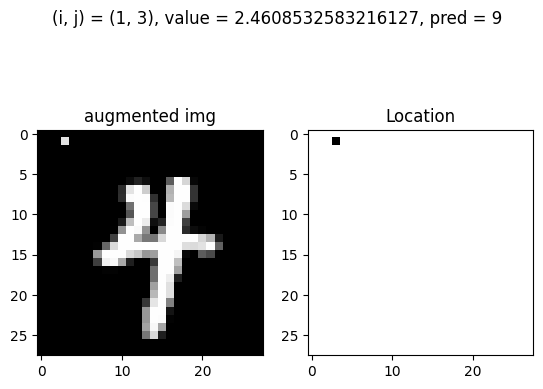

Test: At (i, j) = (1, 3) and value = 2.82148653034729, pred = 9, before_pred = 4, gt = 4


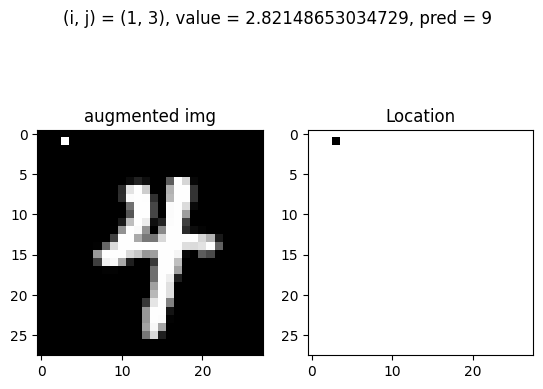

Test: At (i, j) = (1, 4) and value = 2.1002199862959356, pred = 9, before_pred = 4, gt = 4


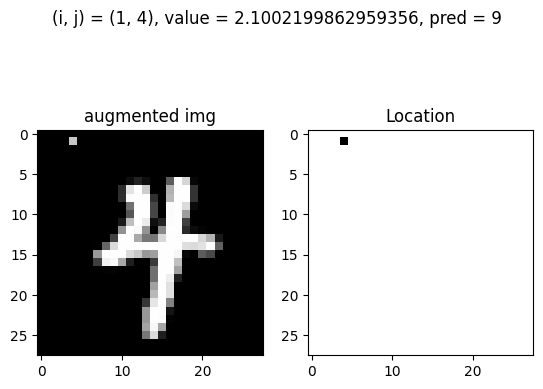

Test: At (i, j) = (1, 4) and value = 2.4608532583216127, pred = 9, before_pred = 4, gt = 4


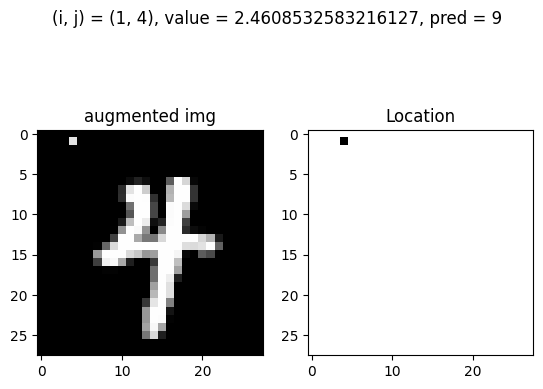

Test: At (i, j) = (1, 4) and value = 2.82148653034729, pred = 9, before_pred = 4, gt = 4


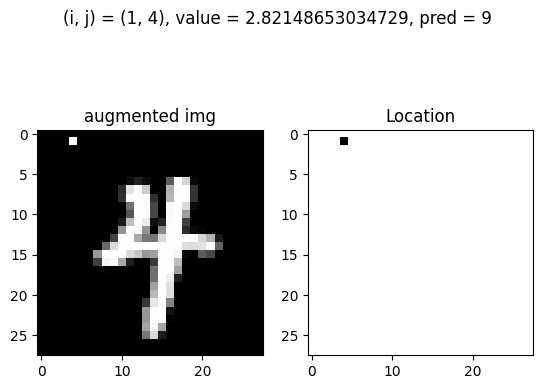

Test: At (i, j) = (1, 8) and value = 1.3789534422445815, pred = 9, before_pred = 4, gt = 4


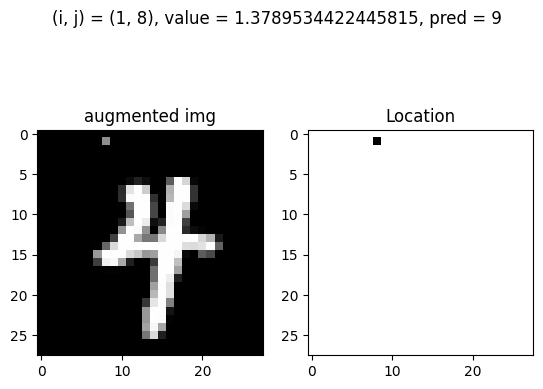

Test: At (i, j) = (1, 8) and value = 1.7395867142702586, pred = 9, before_pred = 4, gt = 4


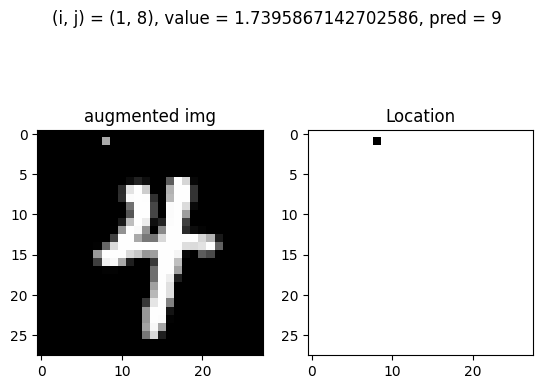

Test: At (i, j) = (1, 8) and value = 2.1002199862959356, pred = 9, before_pred = 4, gt = 4


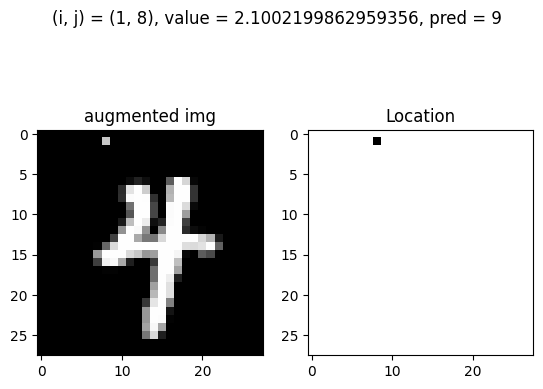

Test: At (i, j) = (1, 8) and value = 2.4608532583216127, pred = 9, before_pred = 4, gt = 4


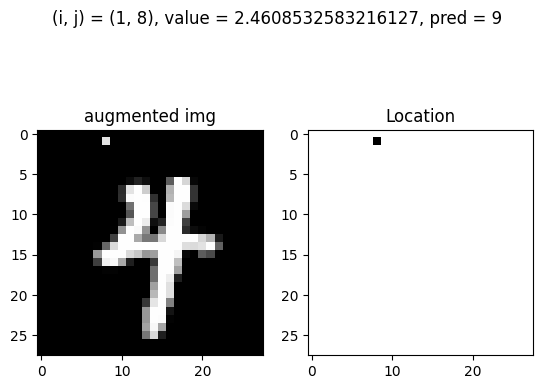

Test: At (i, j) = (1, 8) and value = 2.82148653034729, pred = 9, before_pred = 4, gt = 4


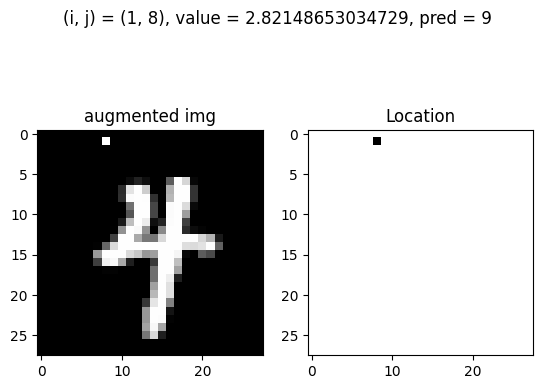

Test: At (i, j) = (1, 21) and value = 1.7395867142702586, pred = 9, before_pred = 4, gt = 4


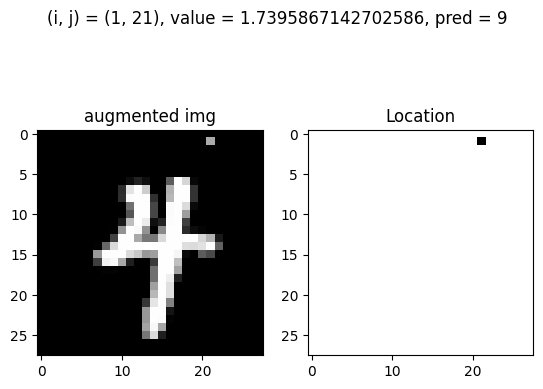

Test: At (i, j) = (1, 21) and value = 2.1002199862959356, pred = 9, before_pred = 4, gt = 4


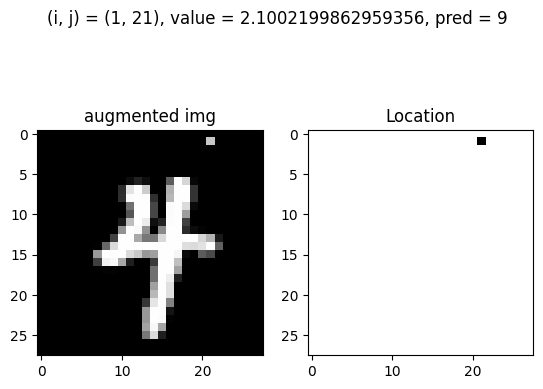

Test: At (i, j) = (1, 21) and value = 2.4608532583216127, pred = 9, before_pred = 4, gt = 4


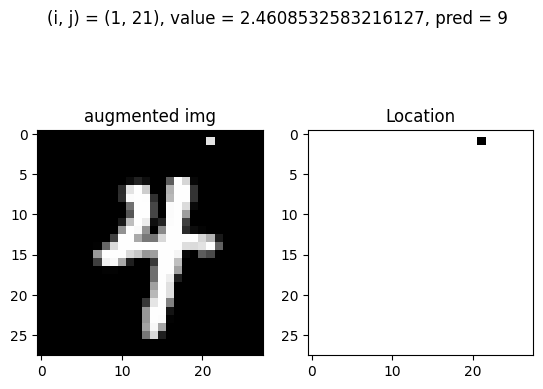

Test: At (i, j) = (1, 21) and value = 2.82148653034729, pred = 9, before_pred = 4, gt = 4


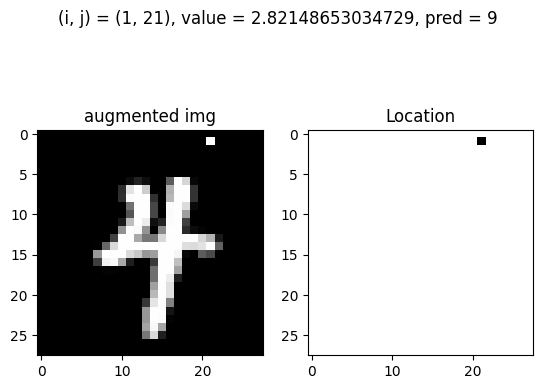

Test: At (i, j) = (1, 25) and value = 2.1002199862959356, pred = 9, before_pred = 4, gt = 4


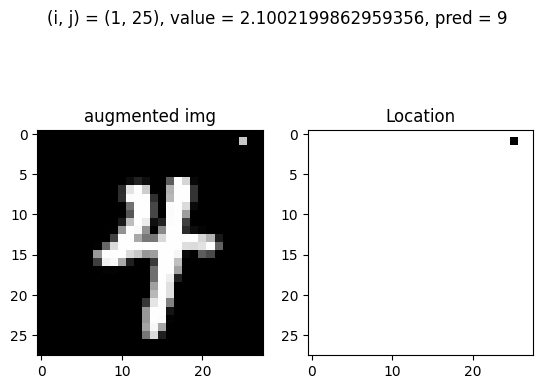

Test: At (i, j) = (1, 25) and value = 2.4608532583216127, pred = 9, before_pred = 4, gt = 4


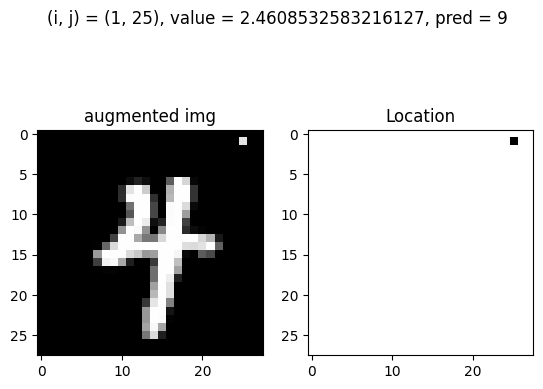

Test: At (i, j) = (1, 25) and value = 2.82148653034729, pred = 9, before_pred = 4, gt = 4


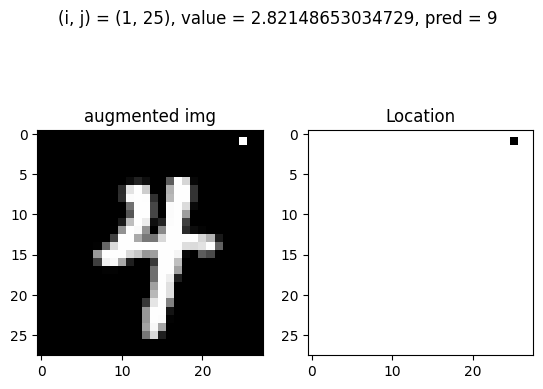

Test: At (i, j) = (2, 3) and value = 1.3789534422445815, pred = 9, before_pred = 4, gt = 4


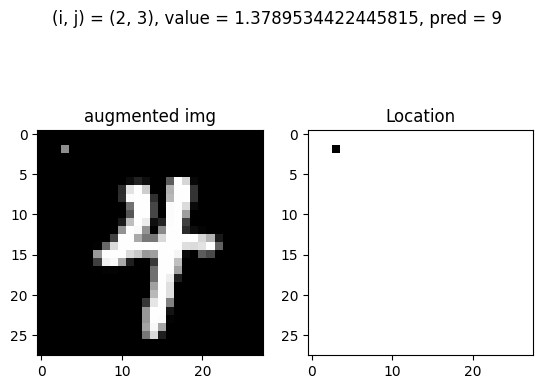

Test: At (i, j) = (2, 3) and value = 1.7395867142702586, pred = 9, before_pred = 4, gt = 4


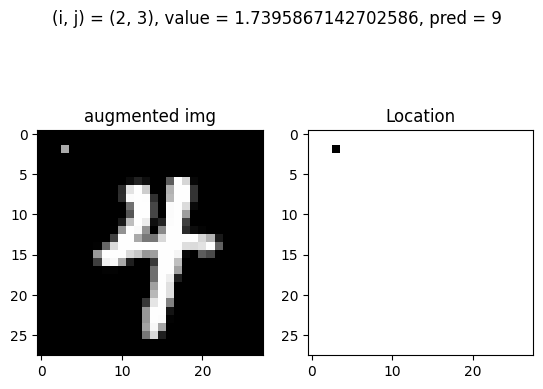

Test: At (i, j) = (2, 3) and value = 2.1002199862959356, pred = 9, before_pred = 4, gt = 4


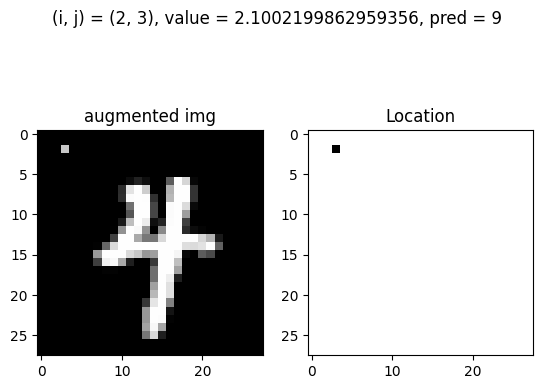

Test: At (i, j) = (2, 3) and value = 2.4608532583216127, pred = 9, before_pred = 4, gt = 4


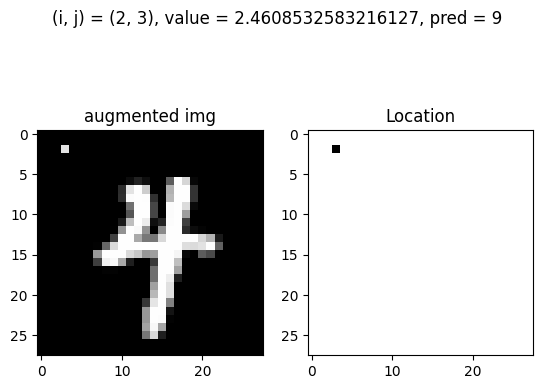

Test: At (i, j) = (2, 3) and value = 2.82148653034729, pred = 9, before_pred = 4, gt = 4


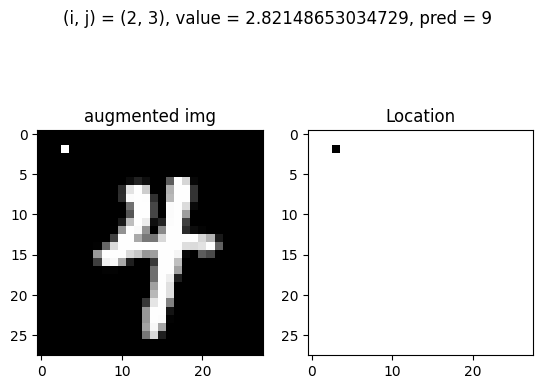

Test: At (i, j) = (2, 4) and value = 1.7395867142702586, pred = 9, before_pred = 4, gt = 4


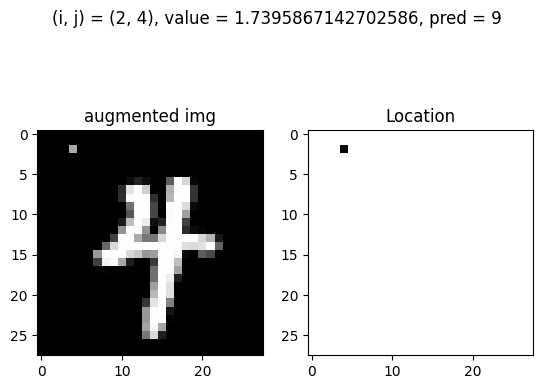

Test: At (i, j) = (2, 4) and value = 2.1002199862959356, pred = 9, before_pred = 4, gt = 4


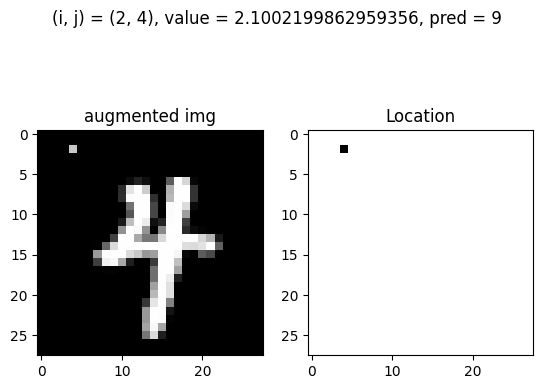

Test: At (i, j) = (2, 4) and value = 2.4608532583216127, pred = 9, before_pred = 4, gt = 4


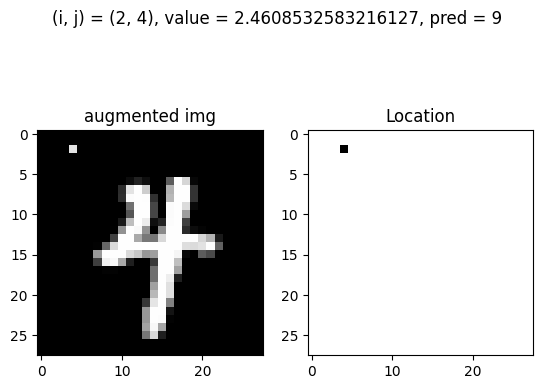

Test: At (i, j) = (2, 4) and value = 2.82148653034729, pred = 9, before_pred = 4, gt = 4


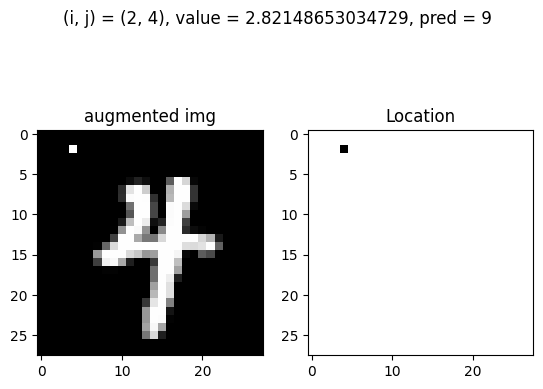

Test: At (i, j) = (3, 5) and value = 2.82148653034729, pred = 9, before_pred = 4, gt = 4


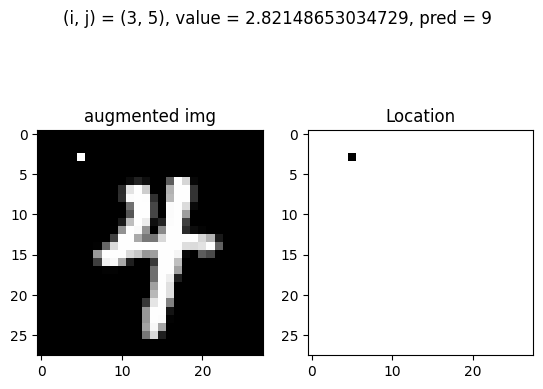

Test: At (i, j) = (4, 0) and value = 2.4608532583216127, pred = 9, before_pred = 4, gt = 4


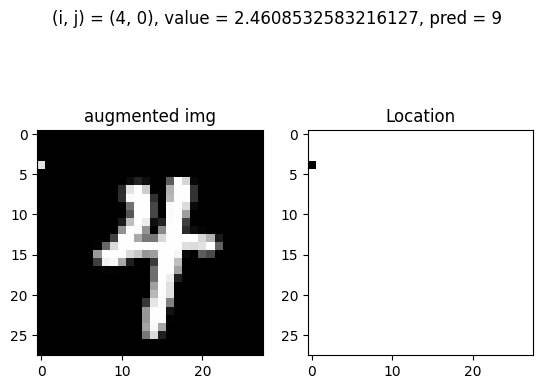

Test: At (i, j) = (4, 0) and value = 2.82148653034729, pred = 9, before_pred = 4, gt = 4


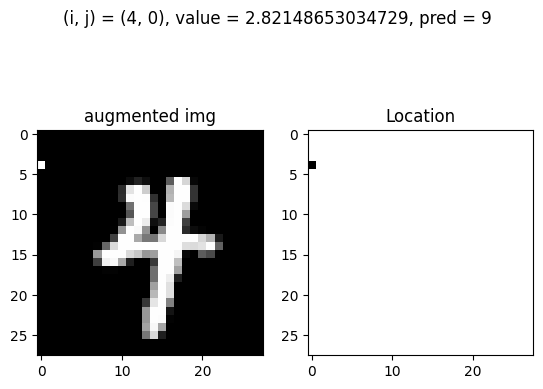

Test: At (i, j) = (4, 2) and value = 1.7395867142702586, pred = 9, before_pred = 4, gt = 4


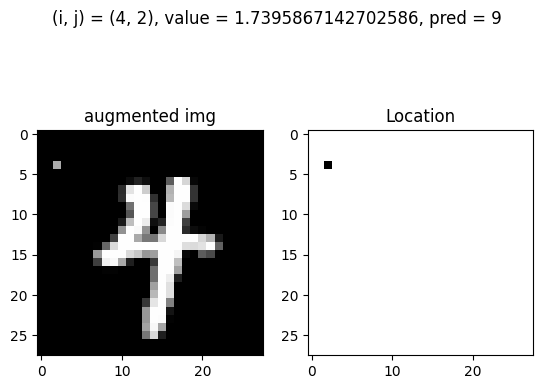

Test: At (i, j) = (4, 2) and value = 2.1002199862959356, pred = 9, before_pred = 4, gt = 4


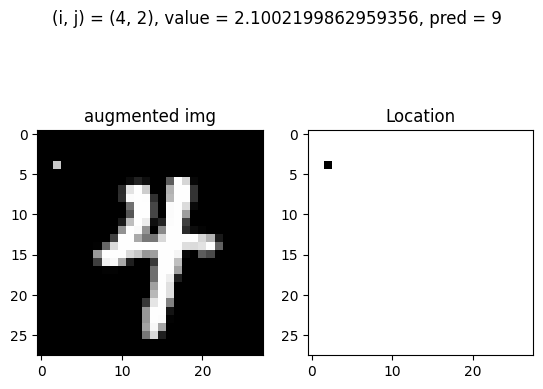

Test: At (i, j) = (4, 2) and value = 2.4608532583216127, pred = 9, before_pred = 4, gt = 4


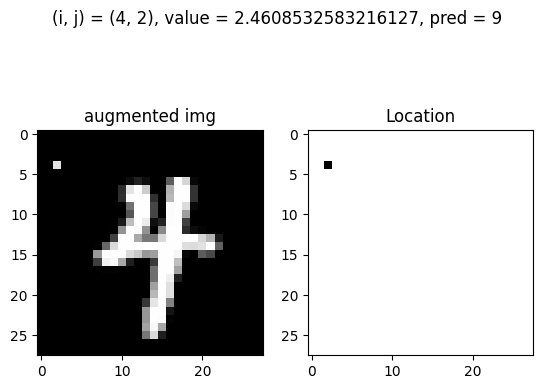

Test: At (i, j) = (4, 2) and value = 2.82148653034729, pred = 9, before_pred = 4, gt = 4


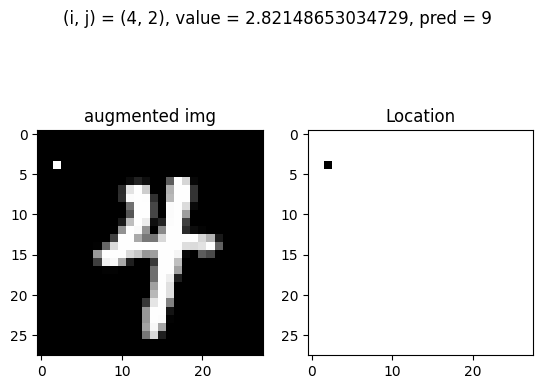

Test: At (i, j) = (4, 7) and value = 1.7395867142702586, pred = 9, before_pred = 4, gt = 4


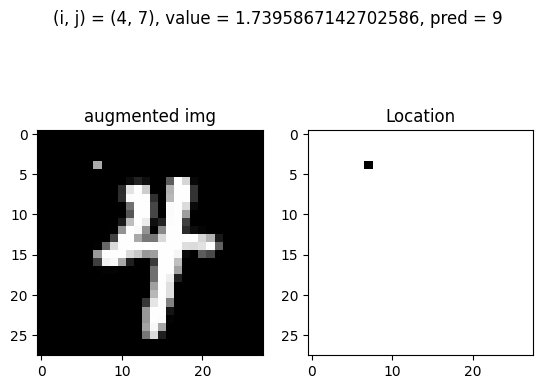

Test: At (i, j) = (4, 7) and value = 2.1002199862959356, pred = 9, before_pred = 4, gt = 4


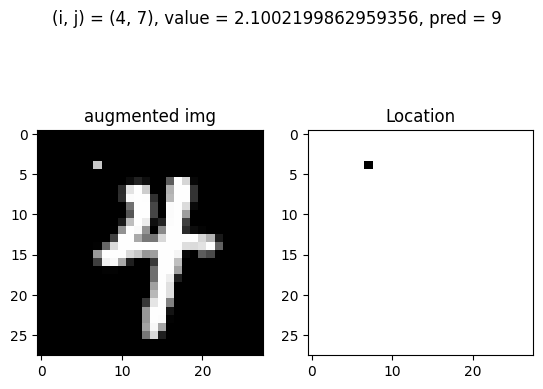

Test: At (i, j) = (4, 7) and value = 2.4608532583216127, pred = 9, before_pred = 4, gt = 4


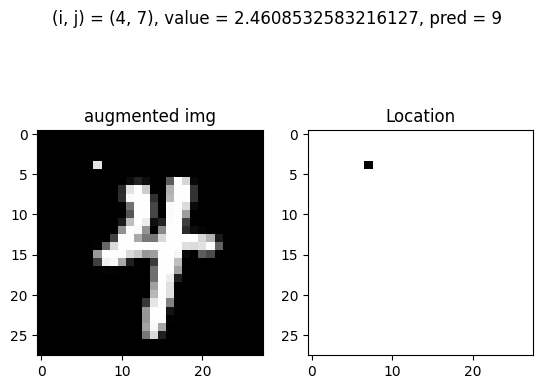

Test: At (i, j) = (4, 7) and value = 2.82148653034729, pred = 9, before_pred = 4, gt = 4


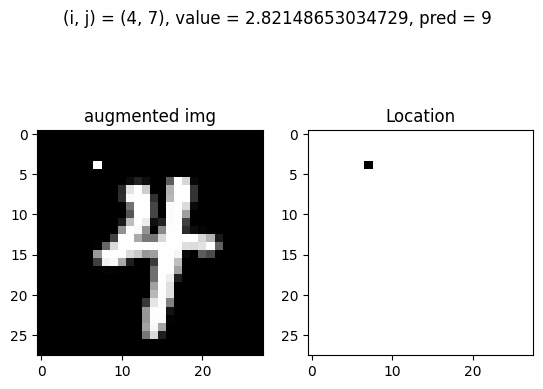

Test: At (i, j) = (5, 3) and value = 2.1002199862959356, pred = 9, before_pred = 4, gt = 4


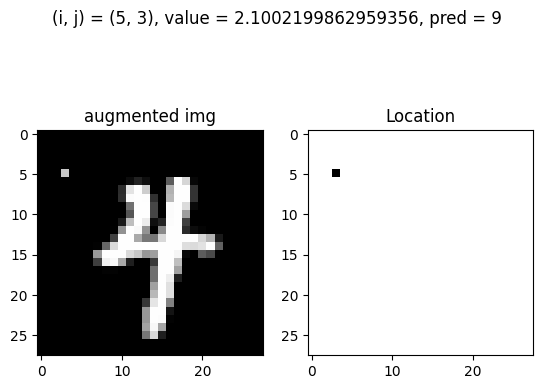

Test: At (i, j) = (5, 3) and value = 2.4608532583216127, pred = 9, before_pred = 4, gt = 4


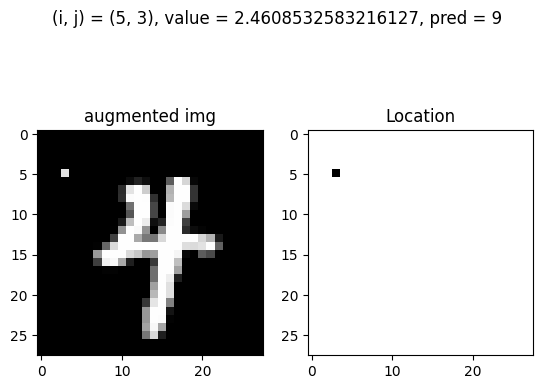

Test: At (i, j) = (5, 3) and value = 2.82148653034729, pred = 9, before_pred = 4, gt = 4


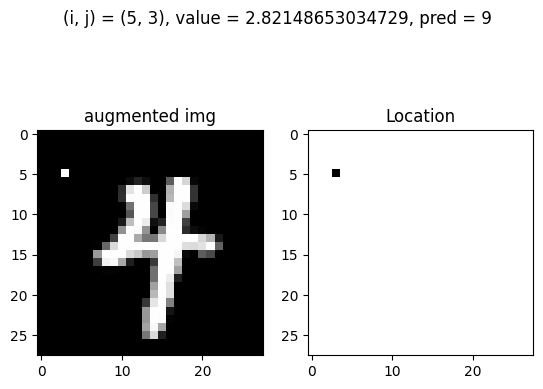

Test: At (i, j) = (5, 26) and value = 1.0183201702189044, pred = 9, before_pred = 4, gt = 4


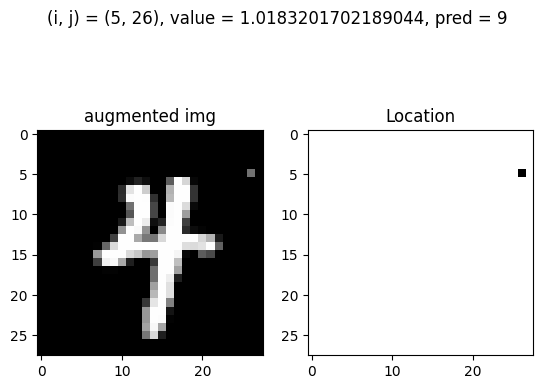

Test: At (i, j) = (5, 26) and value = 1.3789534422445815, pred = 9, before_pred = 4, gt = 4


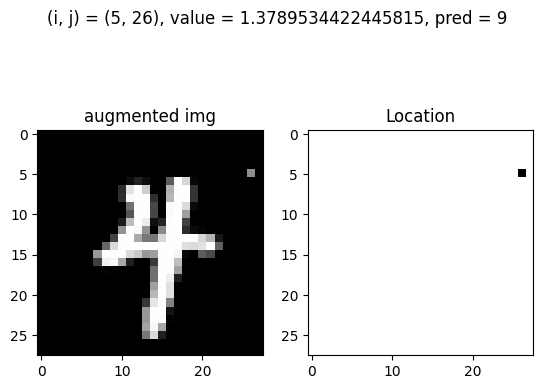

Test: At (i, j) = (5, 26) and value = 1.7395867142702586, pred = 9, before_pred = 4, gt = 4


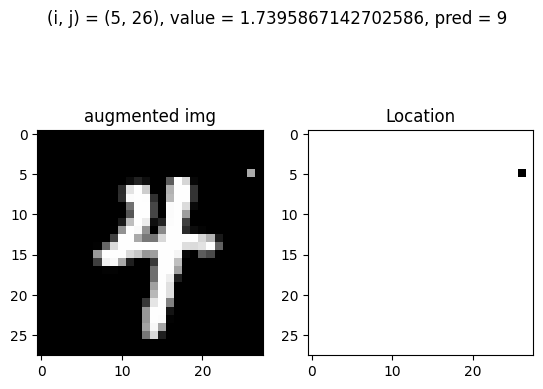

Test: At (i, j) = (5, 26) and value = 2.1002199862959356, pred = 9, before_pred = 4, gt = 4


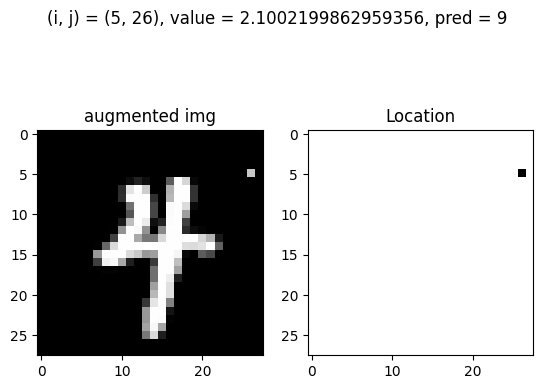

Test: At (i, j) = (5, 26) and value = 2.4608532583216127, pred = 9, before_pred = 4, gt = 4


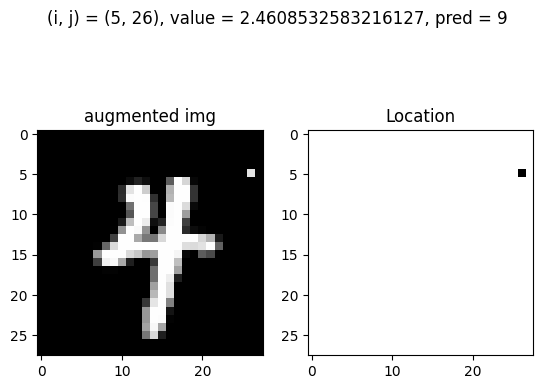

Test: At (i, j) = (5, 26) and value = 2.82148653034729, pred = 9, before_pred = 4, gt = 4


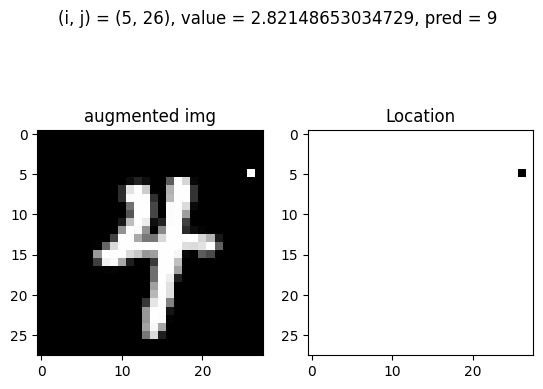

Test: At (i, j) = (6, 4) and value = 2.82148653034729, pred = 9, before_pred = 4, gt = 4


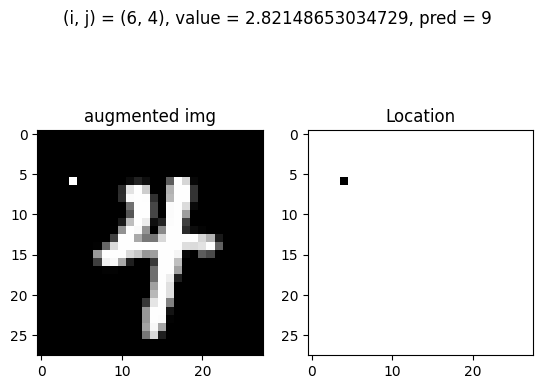

Test: At (i, j) = (6, 12) and value = 2.1002199862959356, pred = 9, before_pred = 4, gt = 4


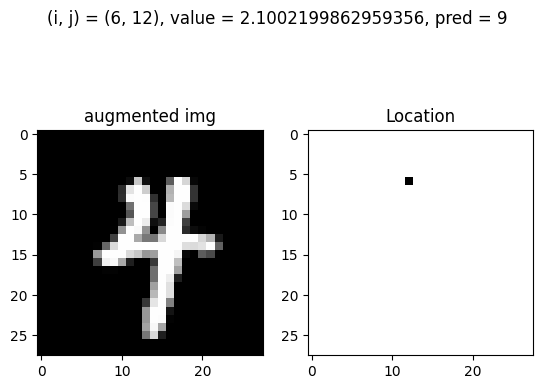

Test: At (i, j) = (6, 12) and value = 2.4608532583216127, pred = 9, before_pred = 4, gt = 4


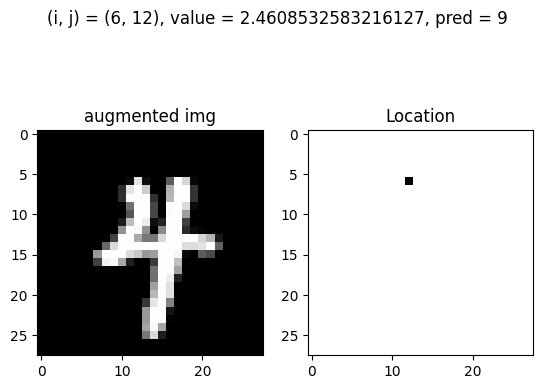

Test: At (i, j) = (6, 12) and value = 2.82148653034729, pred = 9, before_pred = 4, gt = 4


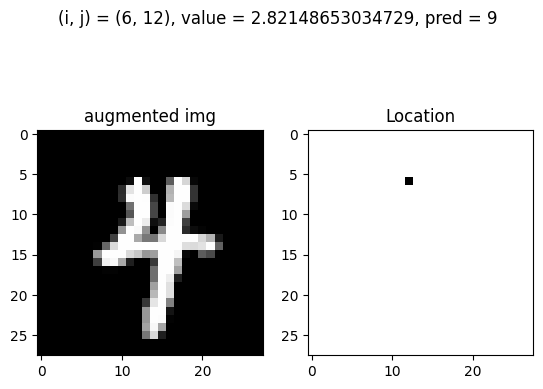

Test: At (i, j) = (6, 14) and value = 0.29705362616755016, pred = 9, before_pred = 4, gt = 4


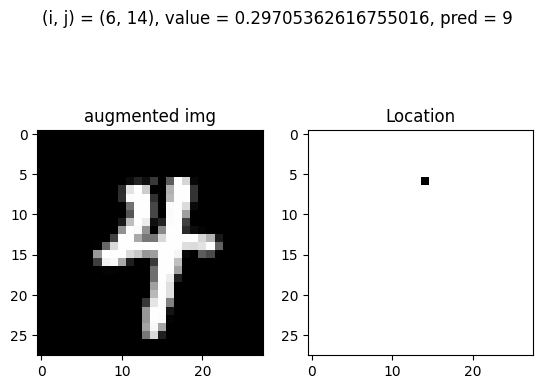

Test: At (i, j) = (6, 14) and value = 0.6576868981932272, pred = 9, before_pred = 4, gt = 4


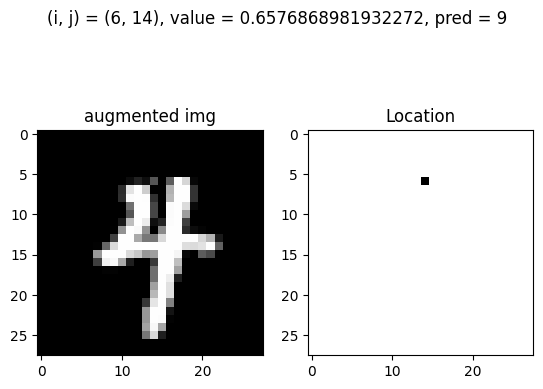

Test: At (i, j) = (6, 14) and value = 1.0183201702189044, pred = 9, before_pred = 4, gt = 4


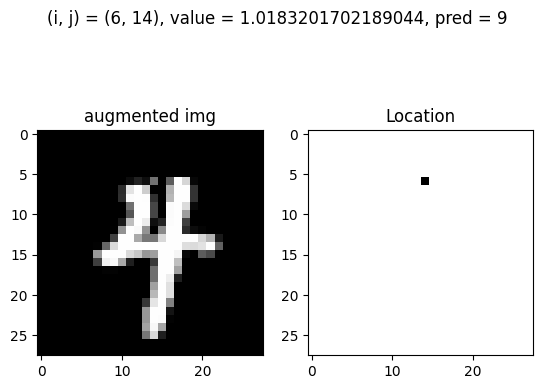

Test: At (i, j) = (6, 14) and value = 1.3789534422445815, pred = 9, before_pred = 4, gt = 4


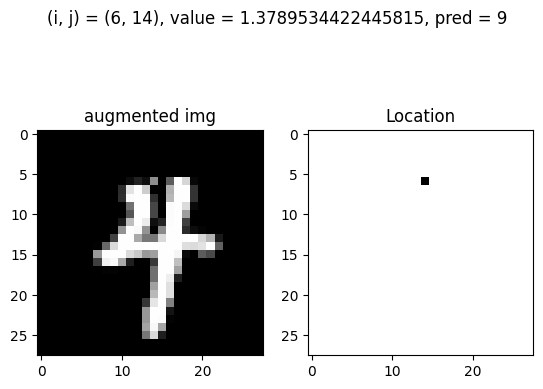

Test: At (i, j) = (6, 14) and value = 1.7395867142702586, pred = 9, before_pred = 4, gt = 4


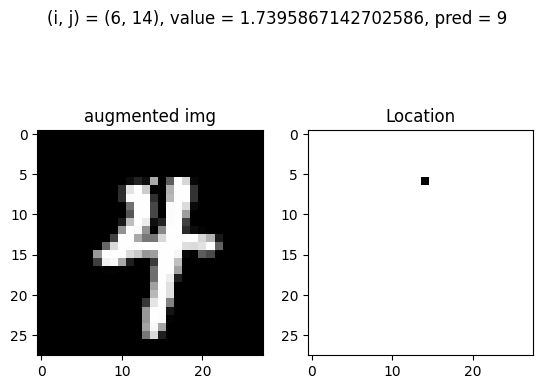

Test: At (i, j) = (6, 14) and value = 2.1002199862959356, pred = 9, before_pred = 4, gt = 4


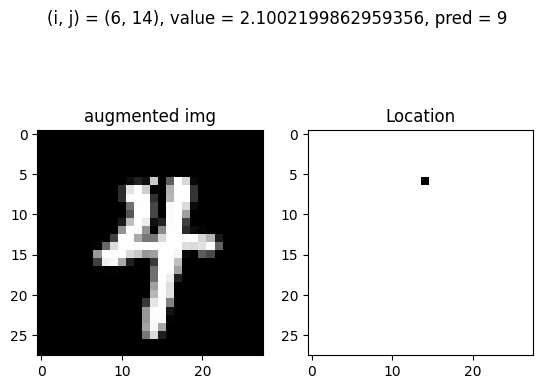

Test: At (i, j) = (6, 14) and value = 2.4608532583216127, pred = 9, before_pred = 4, gt = 4


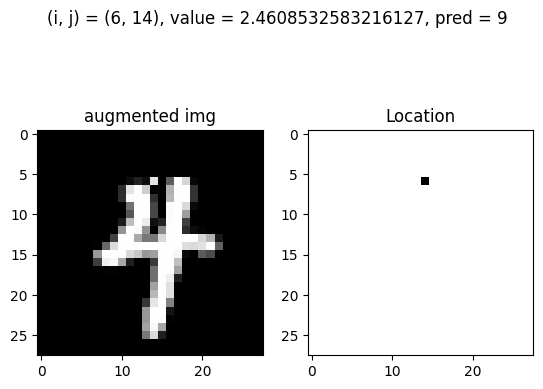

Test: At (i, j) = (6, 14) and value = 2.82148653034729, pred = 9, before_pred = 4, gt = 4


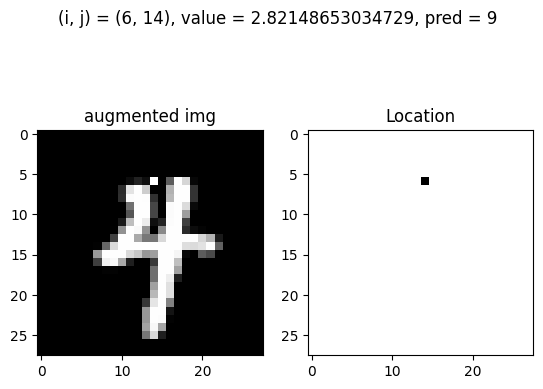

Test: At (i, j) = (6, 15) and value = 0.29705362616755016, pred = 9, before_pred = 4, gt = 4


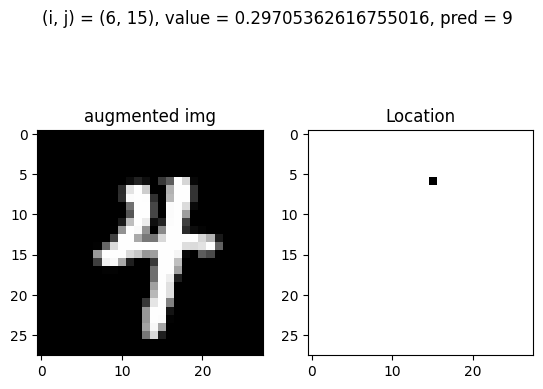

Test: At (i, j) = (6, 15) and value = 0.6576868981932272, pred = 9, before_pred = 4, gt = 4


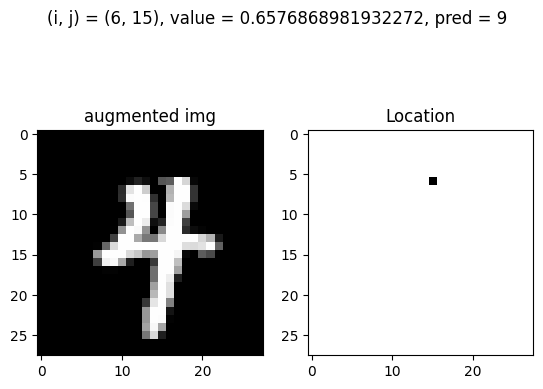

Test: At (i, j) = (6, 15) and value = 1.0183201702189044, pred = 9, before_pred = 4, gt = 4


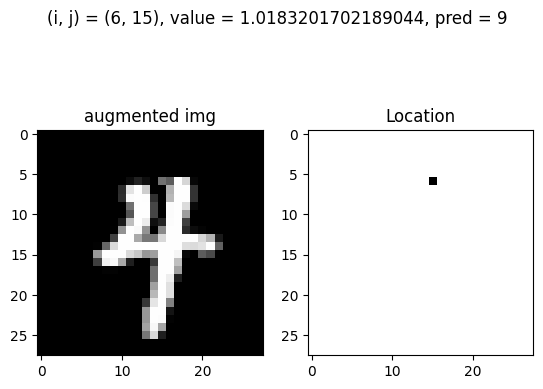

Test: At (i, j) = (6, 15) and value = 1.3789534422445815, pred = 9, before_pred = 4, gt = 4


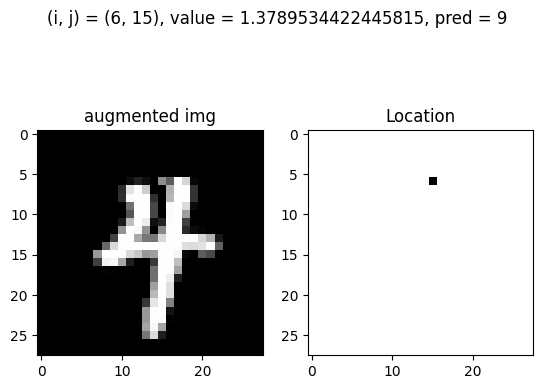

Test: At (i, j) = (6, 15) and value = 1.7395867142702586, pred = 9, before_pred = 4, gt = 4


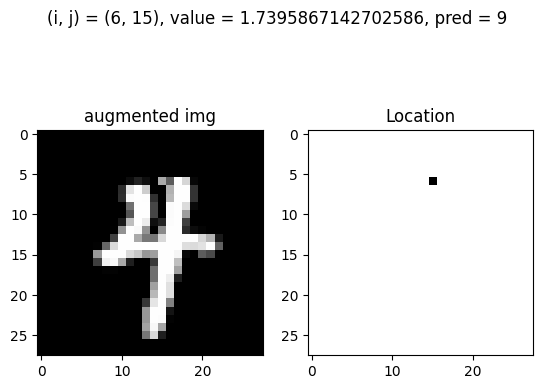

Test: At (i, j) = (6, 15) and value = 2.1002199862959356, pred = 9, before_pred = 4, gt = 4


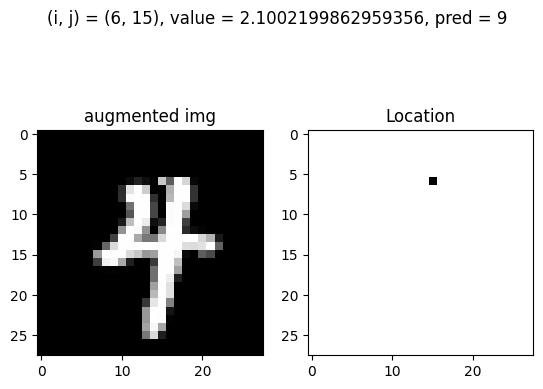

Test: At (i, j) = (6, 15) and value = 2.4608532583216127, pred = 9, before_pred = 4, gt = 4


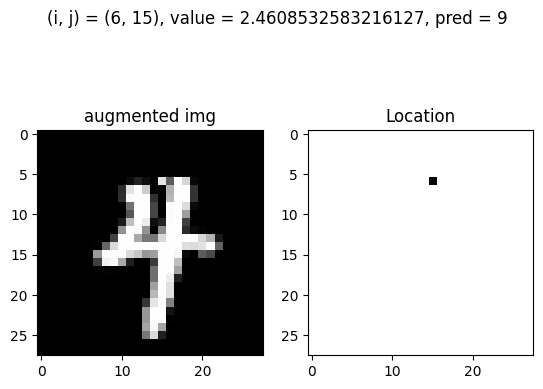

Test: At (i, j) = (6, 15) and value = 2.82148653034729, pred = 9, before_pred = 4, gt = 4


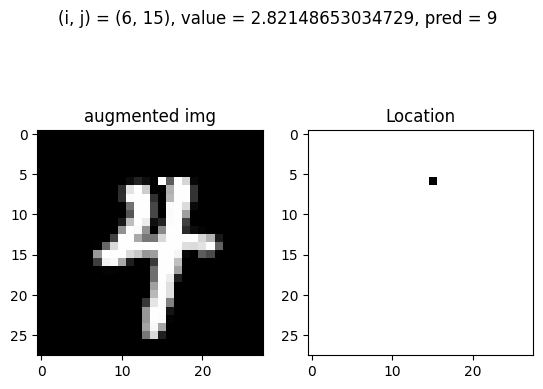

Test: At (i, j) = (6, 16) and value = 2.1002199862959356, pred = 9, before_pred = 4, gt = 4


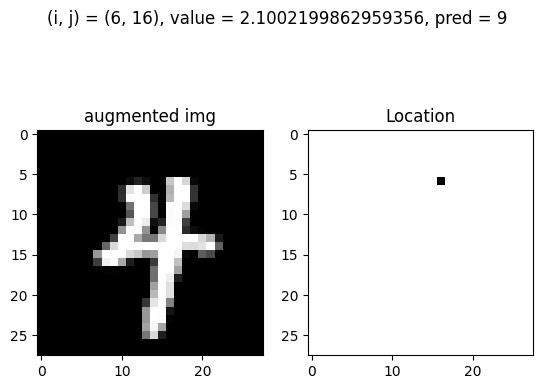

Test: At (i, j) = (6, 16) and value = 2.4608532583216127, pred = 9, before_pred = 4, gt = 4


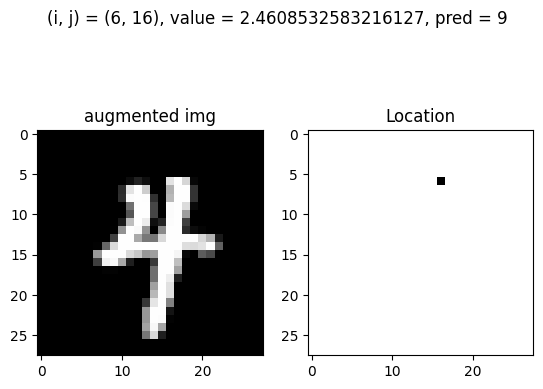

Test: At (i, j) = (6, 16) and value = 2.82148653034729, pred = 9, before_pred = 4, gt = 4


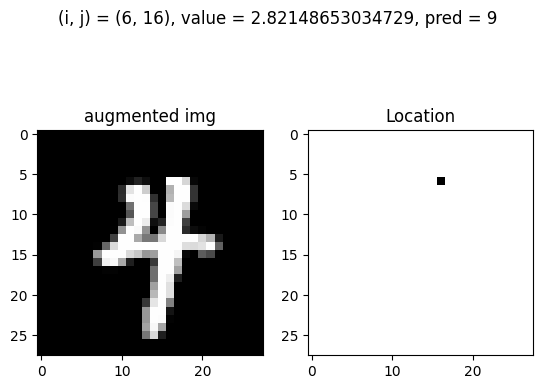

Test: At (i, j) = (7, 5) and value = 2.4608532583216127, pred = 9, before_pred = 4, gt = 4


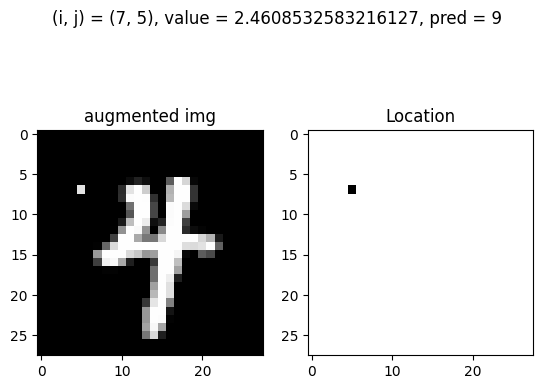

Test: At (i, j) = (7, 5) and value = 2.82148653034729, pred = 9, before_pred = 4, gt = 4


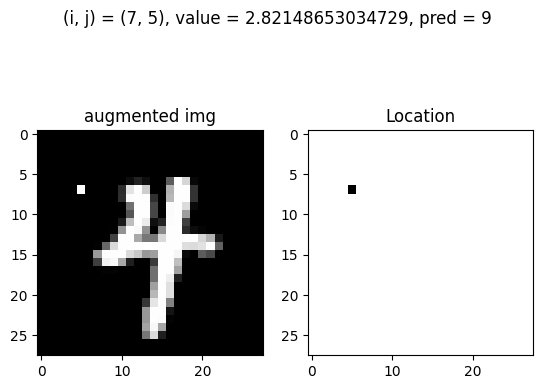

Test: At (i, j) = (7, 14) and value = 0.29705362616755016, pred = 9, before_pred = 4, gt = 4


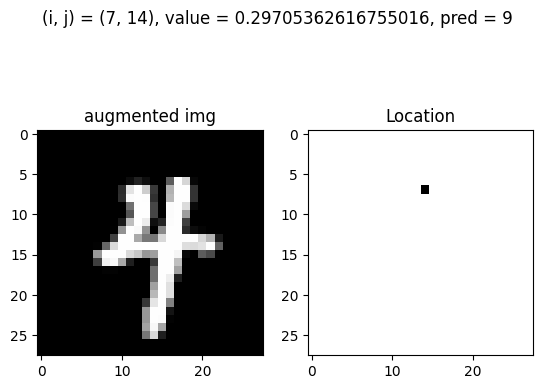

Test: At (i, j) = (7, 14) and value = 0.6576868981932272, pred = 9, before_pred = 4, gt = 4


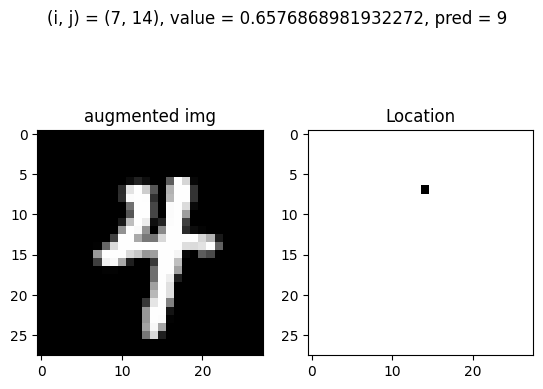

Test: At (i, j) = (7, 14) and value = 1.0183201702189044, pred = 9, before_pred = 4, gt = 4


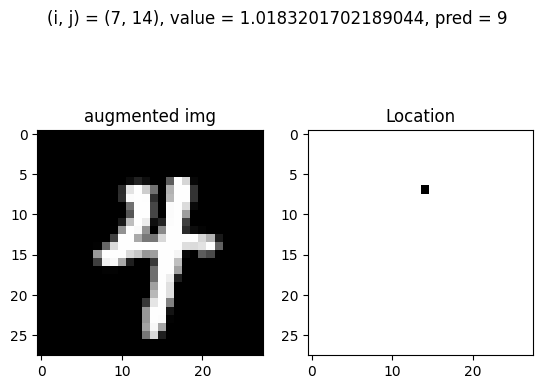

Test: At (i, j) = (7, 14) and value = 1.3789534422445815, pred = 9, before_pred = 4, gt = 4


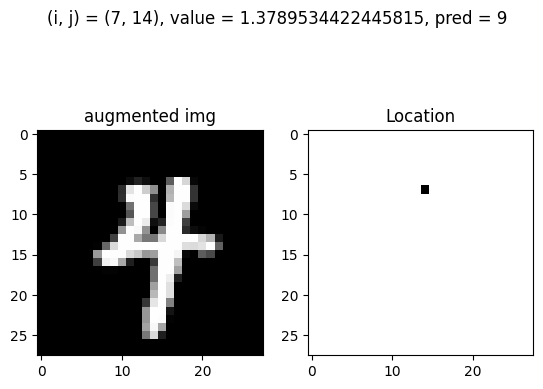

Test: At (i, j) = (7, 14) and value = 1.7395867142702586, pred = 9, before_pred = 4, gt = 4


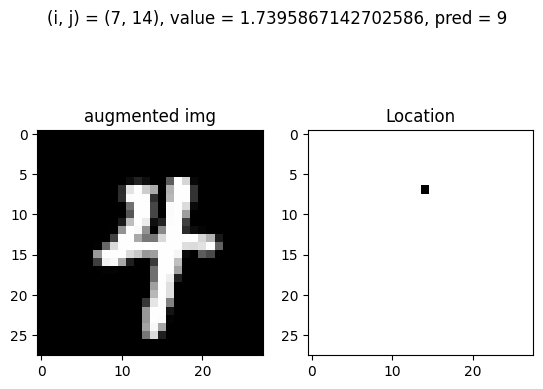

Test: At (i, j) = (7, 14) and value = 2.1002199862959356, pred = 9, before_pred = 4, gt = 4


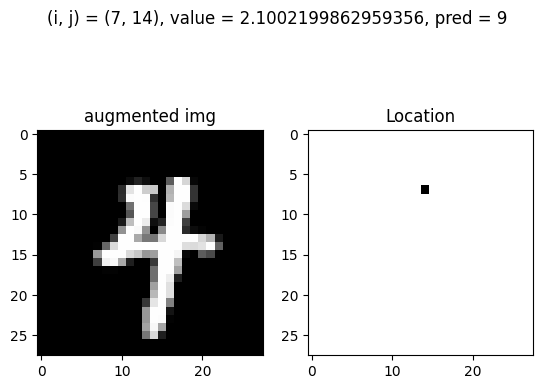

Test: At (i, j) = (7, 14) and value = 2.4608532583216127, pred = 9, before_pred = 4, gt = 4


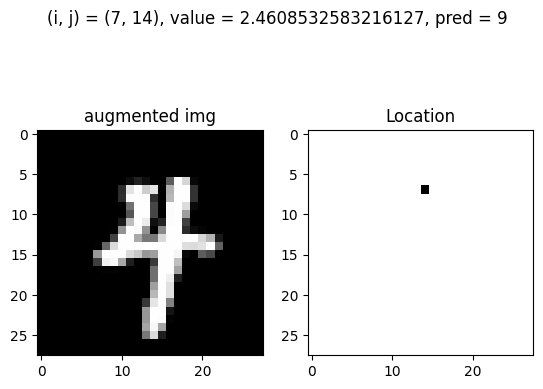

Test: At (i, j) = (7, 14) and value = 2.82148653034729, pred = 9, before_pred = 4, gt = 4


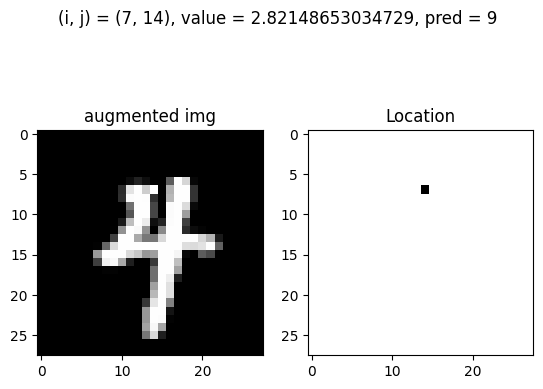

Test: At (i, j) = (7, 15) and value = 0.29705362616755016, pred = 9, before_pred = 4, gt = 4


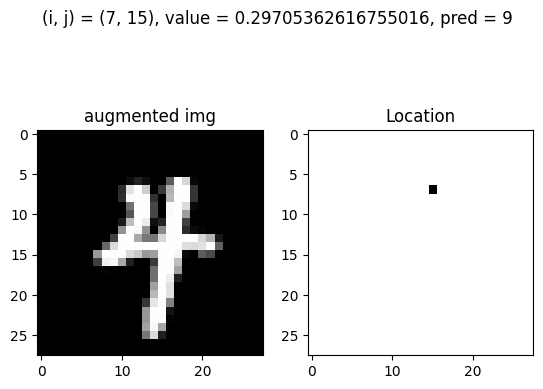

Test: At (i, j) = (7, 15) and value = 0.6576868981932272, pred = 9, before_pred = 4, gt = 4


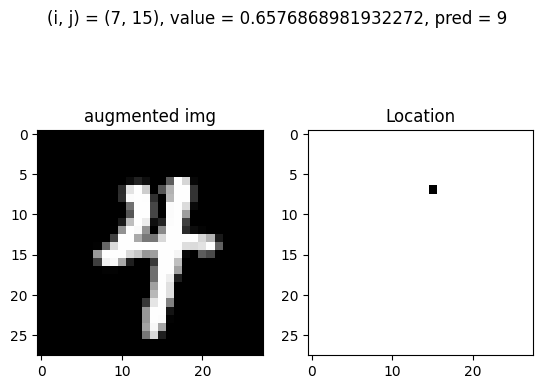

Test: At (i, j) = (7, 15) and value = 1.0183201702189044, pred = 9, before_pred = 4, gt = 4


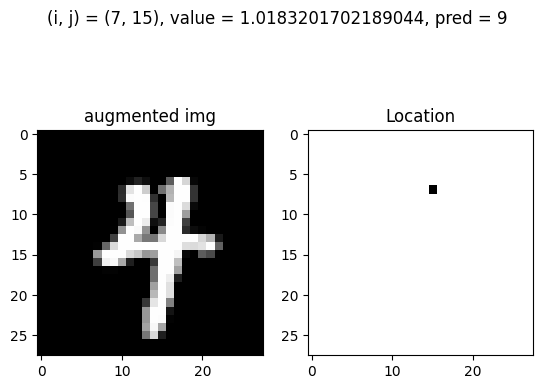

Test: At (i, j) = (7, 15) and value = 1.3789534422445815, pred = 9, before_pred = 4, gt = 4


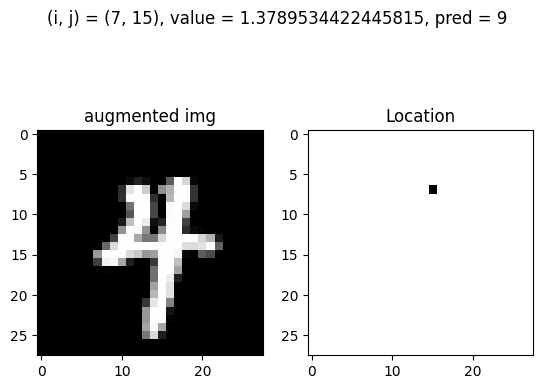

Test: At (i, j) = (7, 15) and value = 1.7395867142702586, pred = 9, before_pred = 4, gt = 4


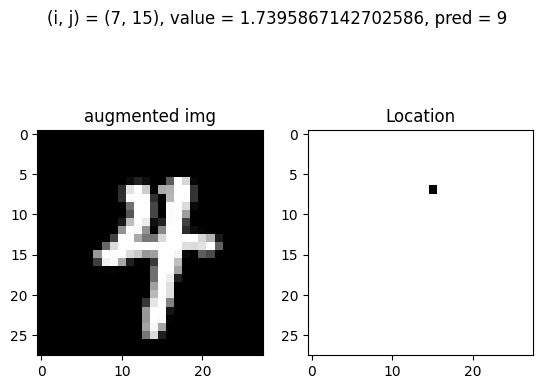

Test: At (i, j) = (7, 15) and value = 2.1002199862959356, pred = 9, before_pred = 4, gt = 4


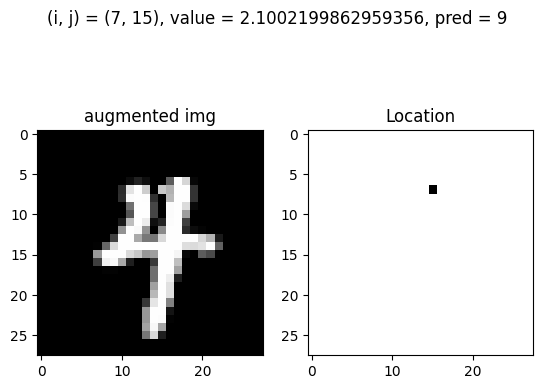

Test: At (i, j) = (7, 15) and value = 2.4608532583216127, pred = 9, before_pred = 4, gt = 4


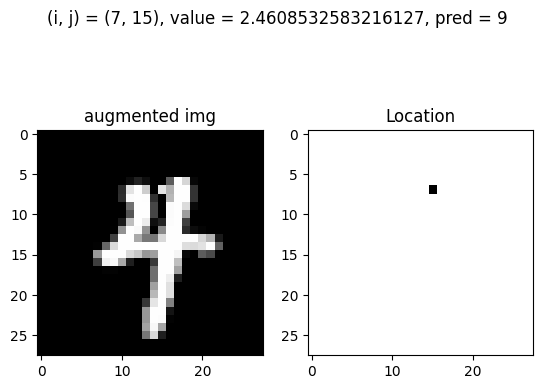

Test: At (i, j) = (7, 15) and value = 2.82148653034729, pred = 9, before_pred = 4, gt = 4


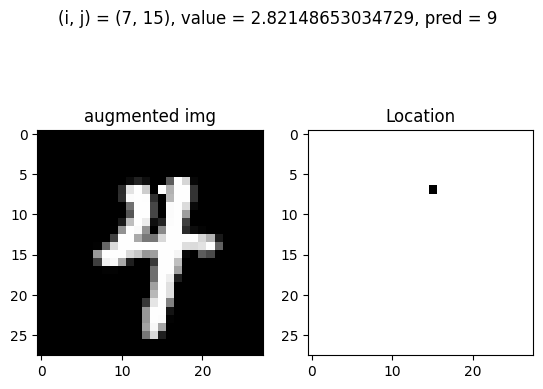

Test: At (i, j) = (7, 16) and value = 2.4608532583216127, pred = 9, before_pred = 4, gt = 4


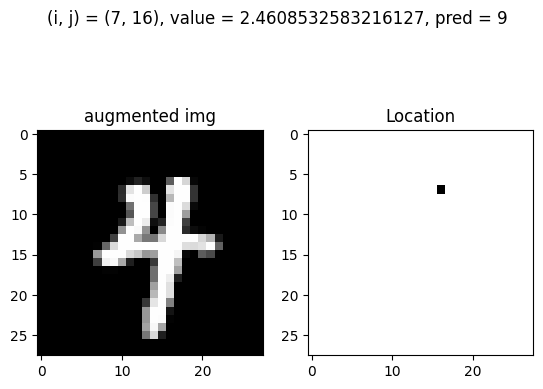

Test: At (i, j) = (7, 16) and value = 2.82148653034729, pred = 9, before_pred = 4, gt = 4


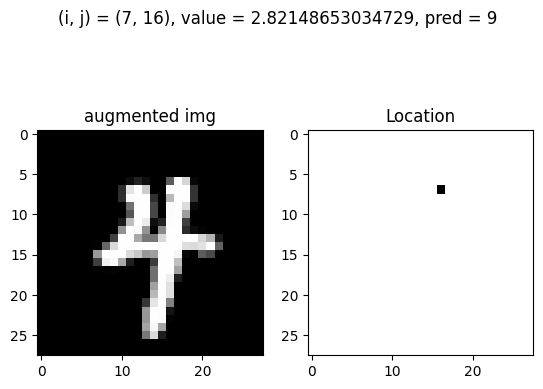

Test: At (i, j) = (7, 19) and value = 1.7395867142702586, pred = 9, before_pred = 4, gt = 4


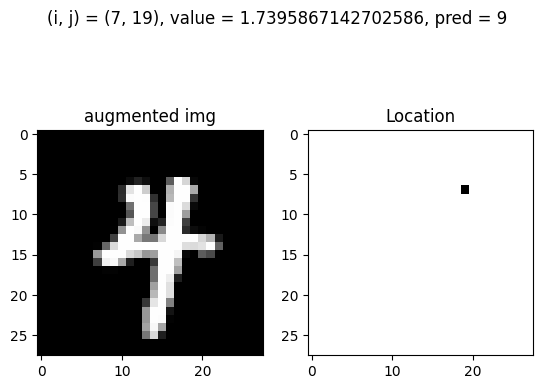

Test: At (i, j) = (7, 19) and value = 2.1002199862959356, pred = 9, before_pred = 4, gt = 4


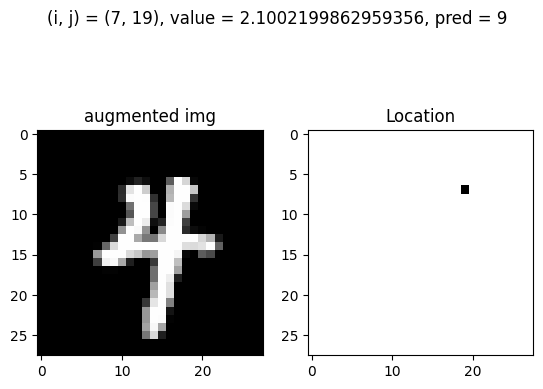

Test: At (i, j) = (7, 19) and value = 2.4608532583216127, pred = 9, before_pred = 4, gt = 4


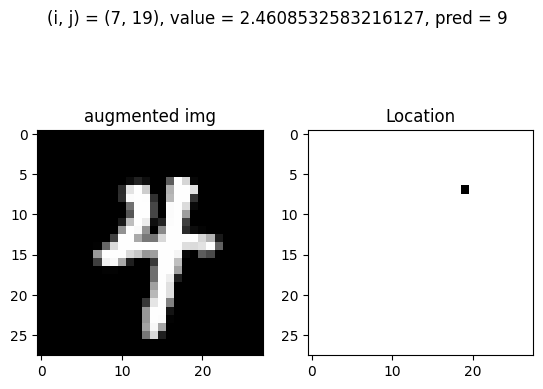

Test: At (i, j) = (7, 19) and value = 2.82148653034729, pred = 9, before_pred = 4, gt = 4


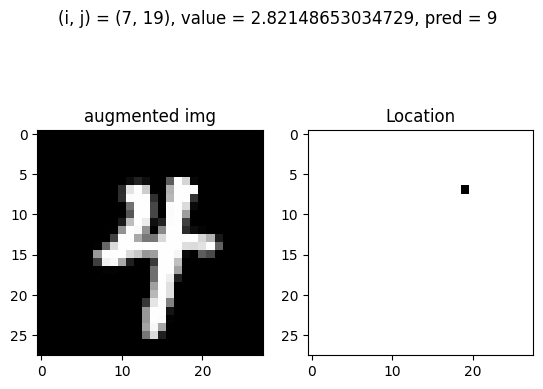

Test: At (i, j) = (7, 20) and value = 1.3789534422445815, pred = 9, before_pred = 4, gt = 4


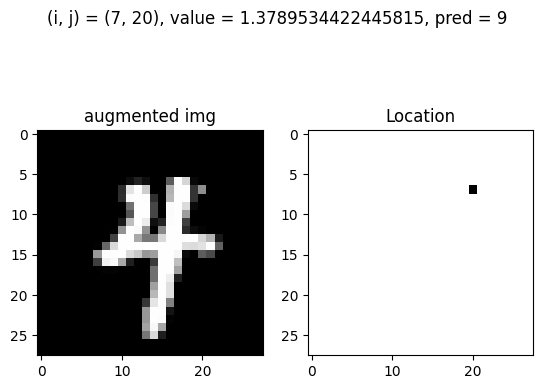

Test: At (i, j) = (7, 20) and value = 1.7395867142702586, pred = 9, before_pred = 4, gt = 4


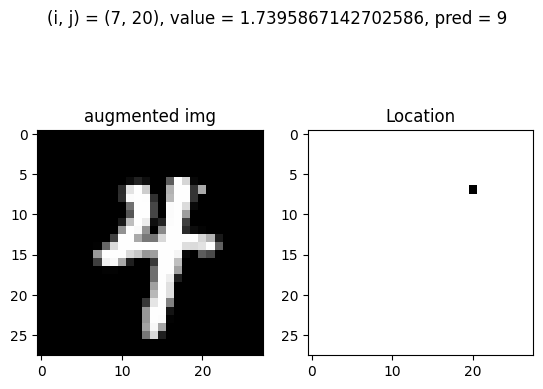

Test: At (i, j) = (7, 20) and value = 2.1002199862959356, pred = 9, before_pred = 4, gt = 4


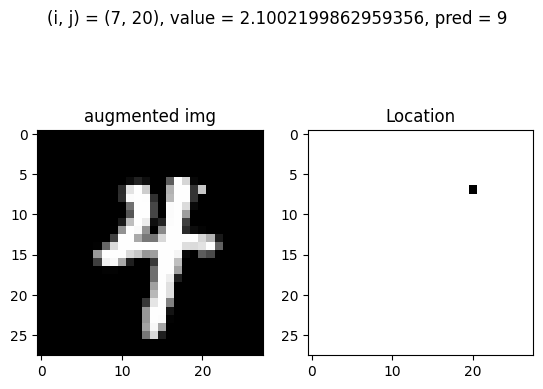

Test: At (i, j) = (7, 20) and value = 2.4608532583216127, pred = 9, before_pred = 4, gt = 4


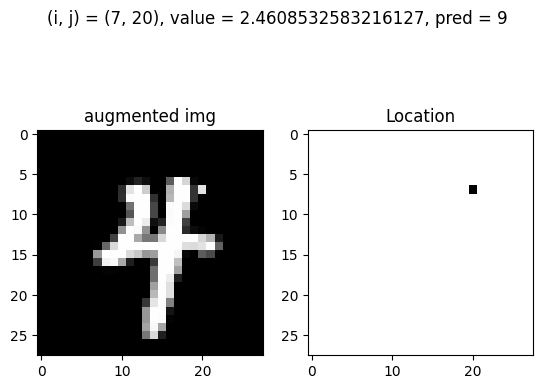

Test: At (i, j) = (7, 20) and value = 2.82148653034729, pred = 9, before_pred = 4, gt = 4


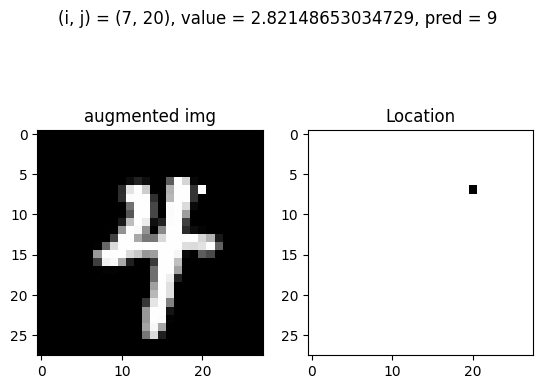

Test: At (i, j) = (7, 25) and value = 1.7395867142702586, pred = 9, before_pred = 4, gt = 4


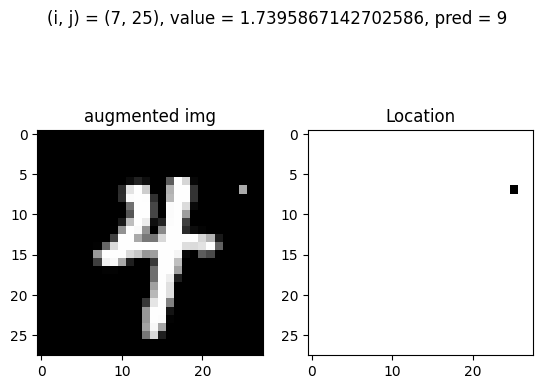

Test: At (i, j) = (7, 25) and value = 2.1002199862959356, pred = 9, before_pred = 4, gt = 4


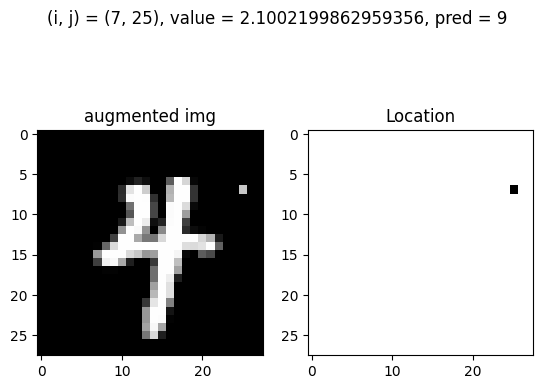

Test: At (i, j) = (7, 25) and value = 2.4608532583216127, pred = 9, before_pred = 4, gt = 4


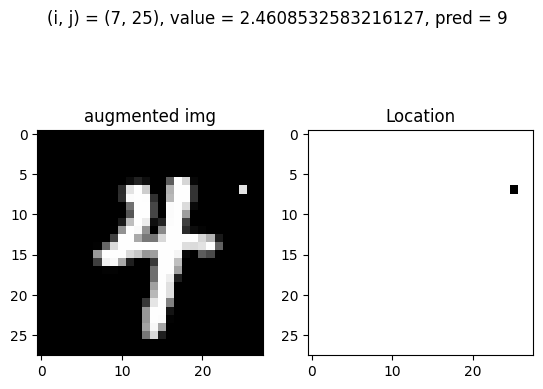

Test: At (i, j) = (7, 25) and value = 2.82148653034729, pred = 9, before_pred = 4, gt = 4


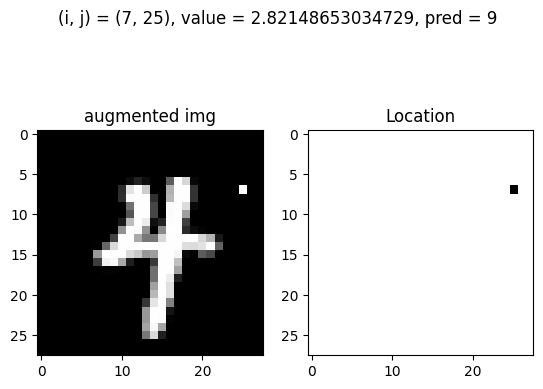

Test: At (i, j) = (8, 14) and value = 1.0183201702189044, pred = 9, before_pred = 4, gt = 4


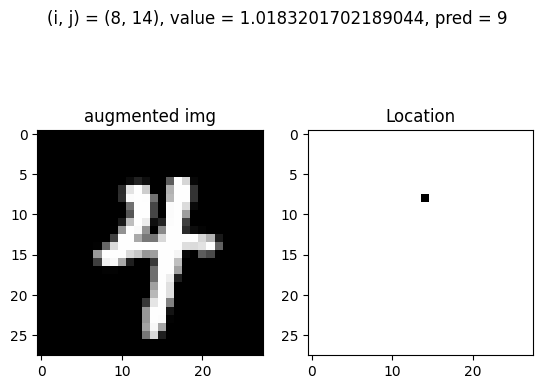

Test: At (i, j) = (8, 14) and value = 1.3789534422445815, pred = 9, before_pred = 4, gt = 4


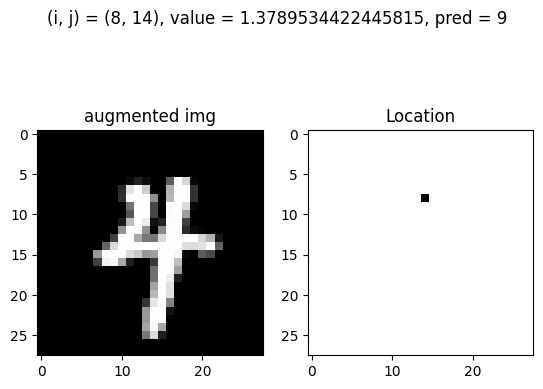

Test: At (i, j) = (8, 14) and value = 1.7395867142702586, pred = 9, before_pred = 4, gt = 4


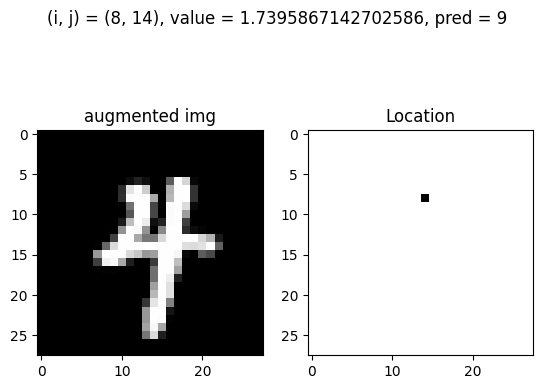

Test: At (i, j) = (8, 14) and value = 2.1002199862959356, pred = 9, before_pred = 4, gt = 4


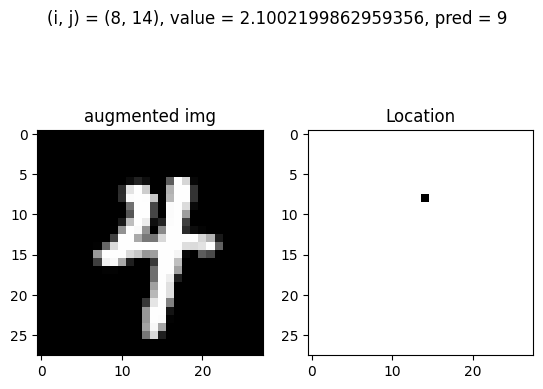

Test: At (i, j) = (8, 14) and value = 2.4608532583216127, pred = 9, before_pred = 4, gt = 4


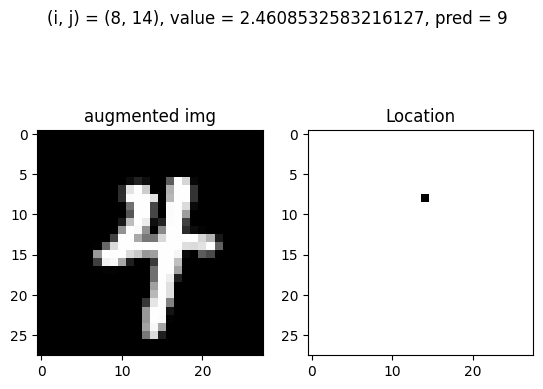

Test: At (i, j) = (8, 14) and value = 2.82148653034729, pred = 9, before_pred = 4, gt = 4


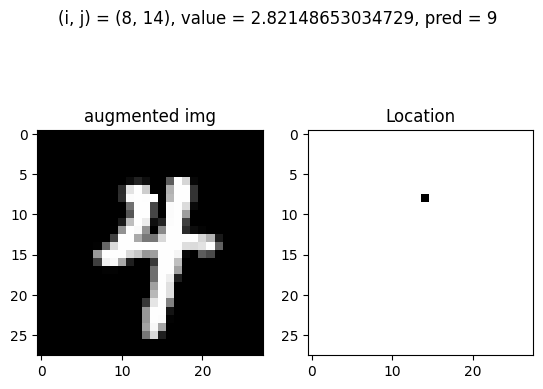

Test: At (i, j) = (8, 15) and value = 0.29705362616755016, pred = 9, before_pred = 4, gt = 4


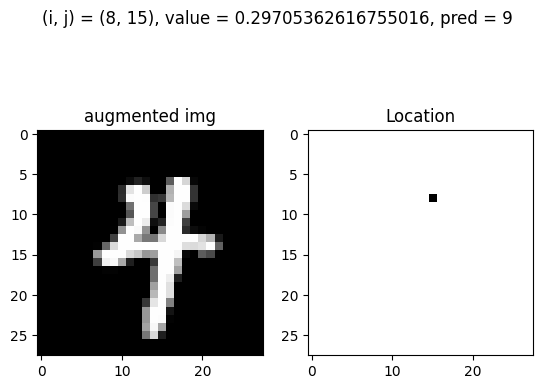

Test: At (i, j) = (8, 15) and value = 0.6576868981932272, pred = 9, before_pred = 4, gt = 4


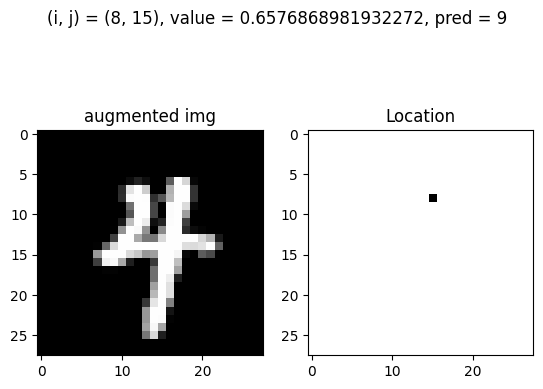

Test: At (i, j) = (8, 15) and value = 1.0183201702189044, pred = 9, before_pred = 4, gt = 4


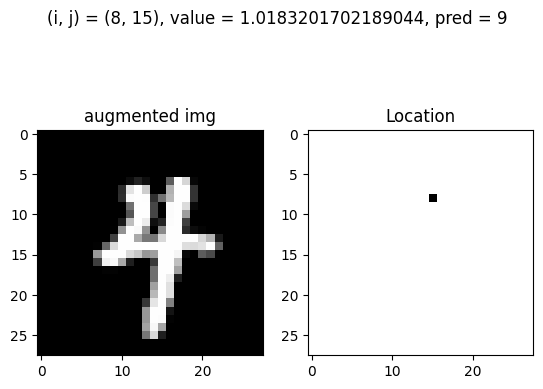

Test: At (i, j) = (8, 15) and value = 1.3789534422445815, pred = 9, before_pred = 4, gt = 4


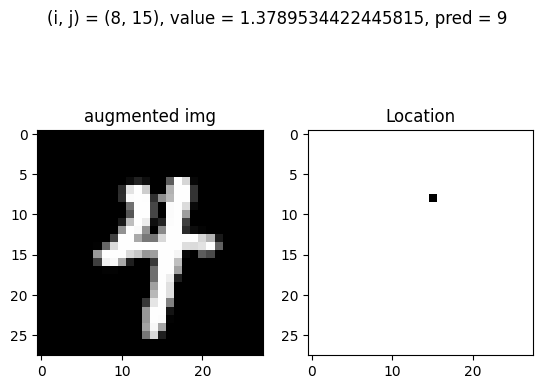

Test: At (i, j) = (8, 15) and value = 1.7395867142702586, pred = 9, before_pred = 4, gt = 4


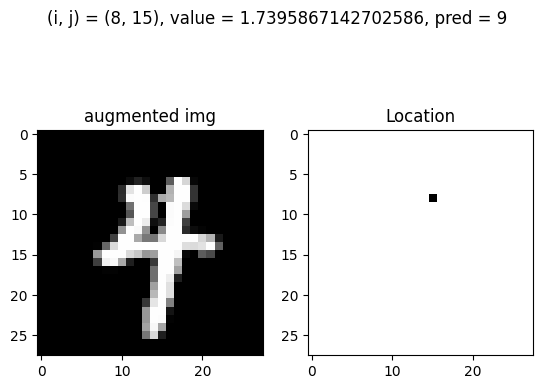

Test: At (i, j) = (8, 15) and value = 2.1002199862959356, pred = 9, before_pred = 4, gt = 4


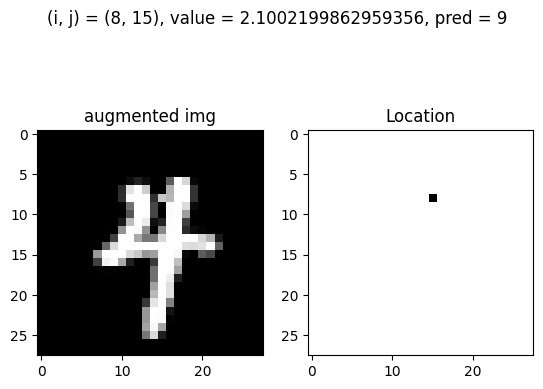

Test: At (i, j) = (8, 15) and value = 2.4608532583216127, pred = 9, before_pred = 4, gt = 4


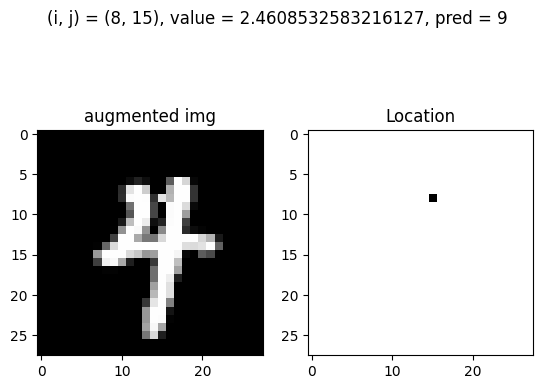

Test: At (i, j) = (8, 15) and value = 2.82148653034729, pred = 9, before_pred = 4, gt = 4


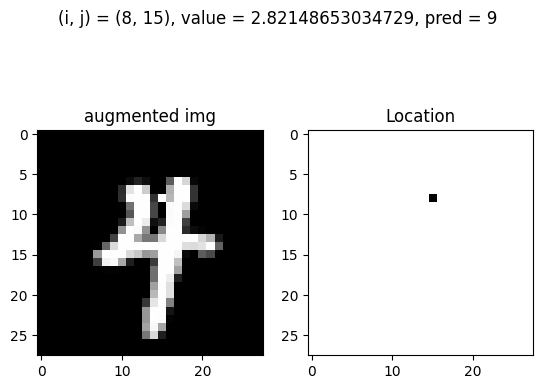

Test: At (i, j) = (8, 16) and value = 2.82148653034729, pred = 9, before_pred = 4, gt = 4


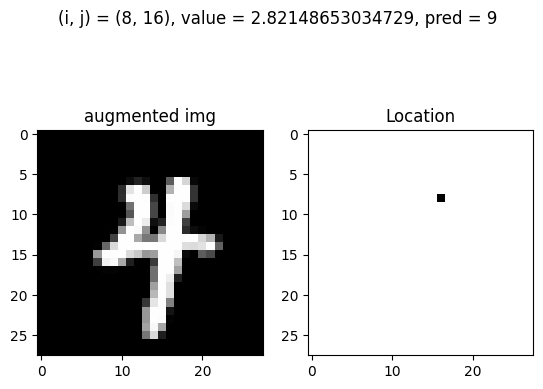

Test: At (i, j) = (8, 20) and value = 1.7395867142702586, pred = 9, before_pred = 4, gt = 4


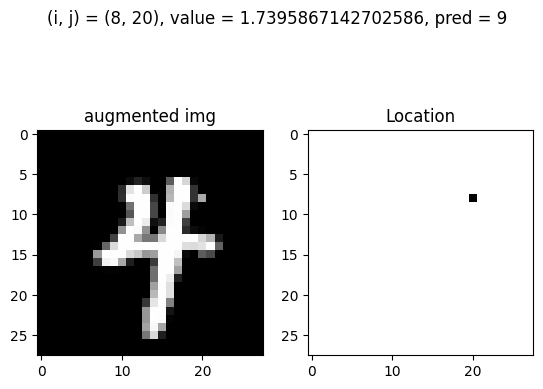

Test: At (i, j) = (8, 20) and value = 2.1002199862959356, pred = 9, before_pred = 4, gt = 4


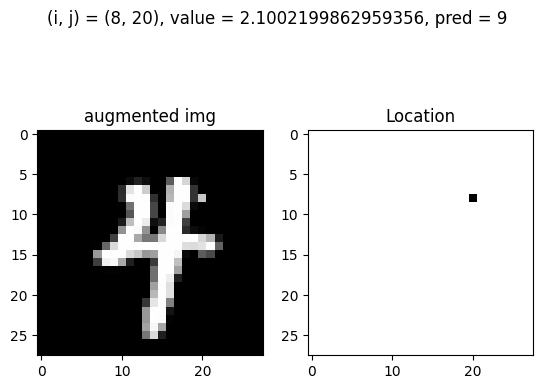

Test: At (i, j) = (8, 20) and value = 2.4608532583216127, pred = 9, before_pred = 4, gt = 4


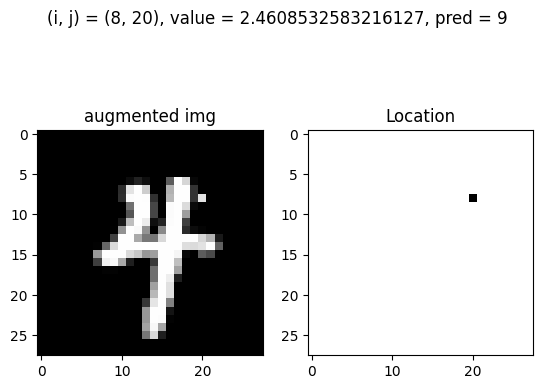

Test: At (i, j) = (8, 20) and value = 2.82148653034729, pred = 9, before_pred = 4, gt = 4


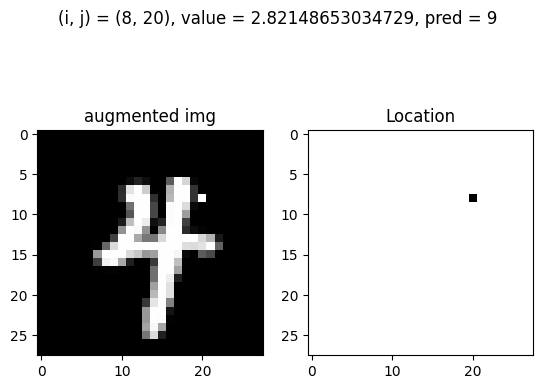

Test: At (i, j) = (8, 22) and value = 2.4608532583216127, pred = 9, before_pred = 4, gt = 4


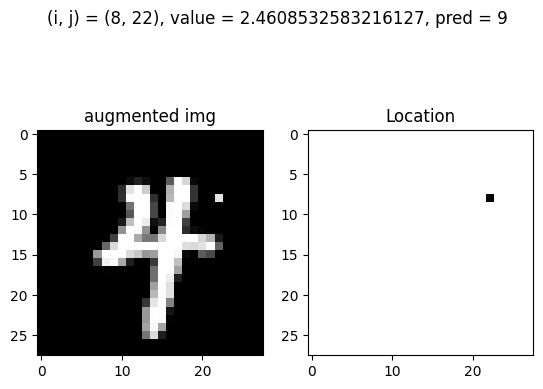

Test: At (i, j) = (8, 22) and value = 2.82148653034729, pred = 9, before_pred = 4, gt = 4


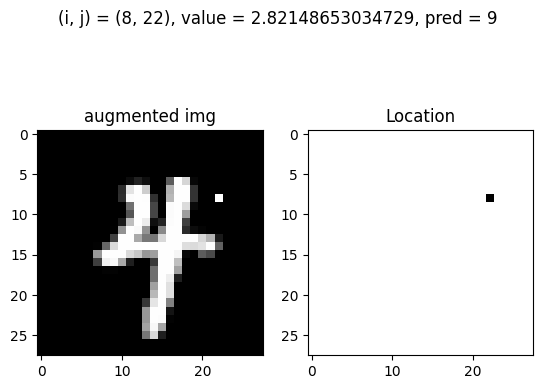

Test: At (i, j) = (9, 4) and value = 1.7395867142702586, pred = 9, before_pred = 4, gt = 4


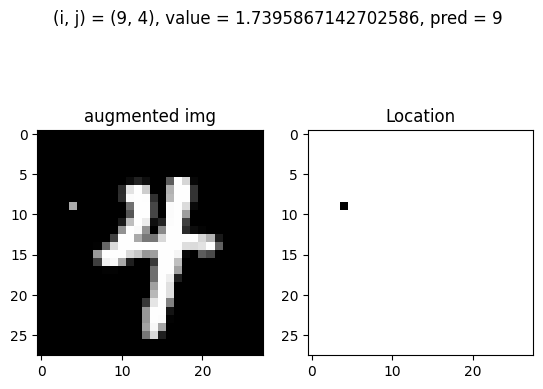

Test: At (i, j) = (9, 4) and value = 2.1002199862959356, pred = 9, before_pred = 4, gt = 4


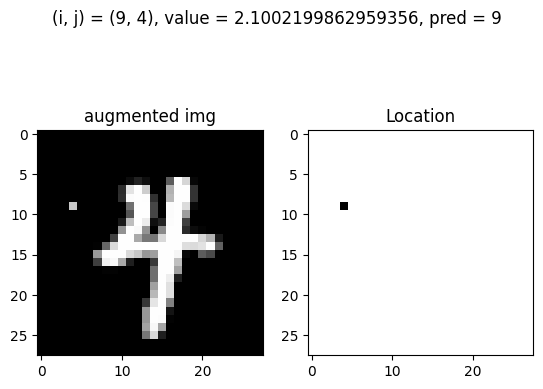

Test: At (i, j) = (9, 4) and value = 2.4608532583216127, pred = 9, before_pred = 4, gt = 4


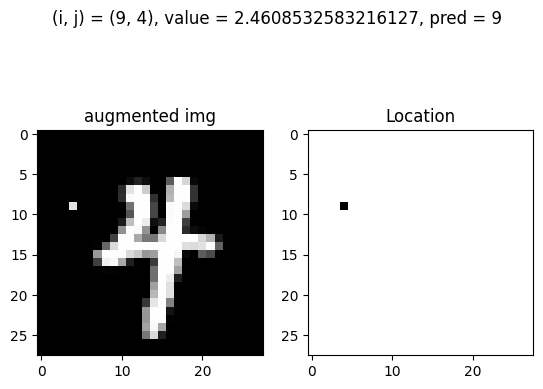

Test: At (i, j) = (9, 4) and value = 2.82148653034729, pred = 9, before_pred = 4, gt = 4


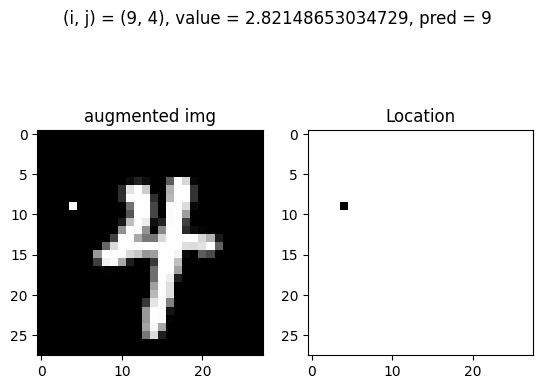

Test: At (i, j) = (9, 10) and value = 0.6576868981932272, pred = 9, before_pred = 4, gt = 4


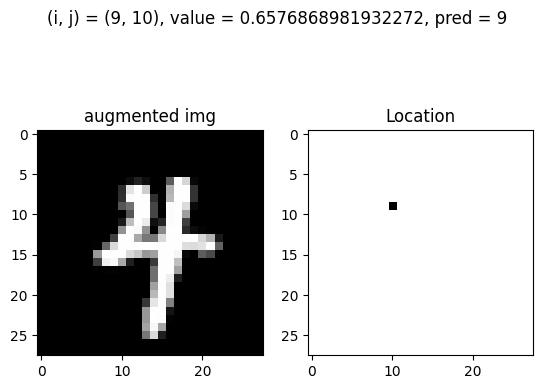

Test: At (i, j) = (9, 10) and value = 1.0183201702189044, pred = 9, before_pred = 4, gt = 4


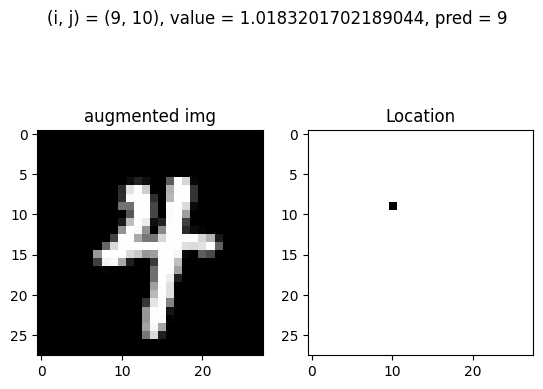

Test: At (i, j) = (9, 10) and value = 1.3789534422445815, pred = 9, before_pred = 4, gt = 4


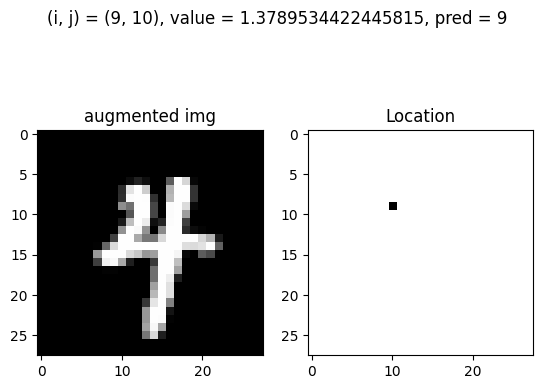

Test: At (i, j) = (9, 10) and value = 1.7395867142702586, pred = 9, before_pred = 4, gt = 4


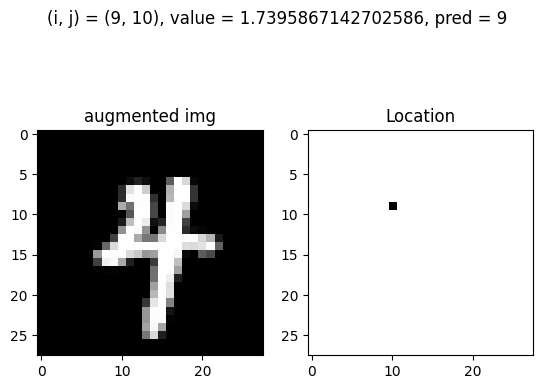

Test: At (i, j) = (9, 10) and value = 2.1002199862959356, pred = 9, before_pred = 4, gt = 4


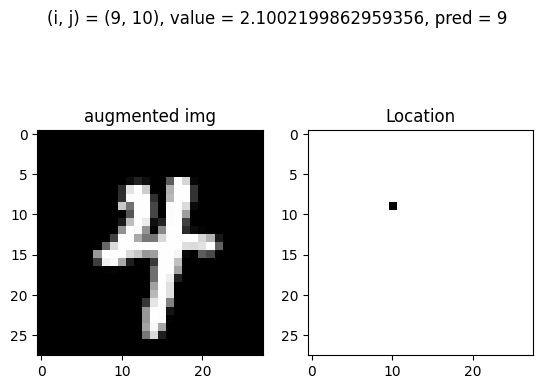

Test: At (i, j) = (9, 10) and value = 2.4608532583216127, pred = 9, before_pred = 4, gt = 4


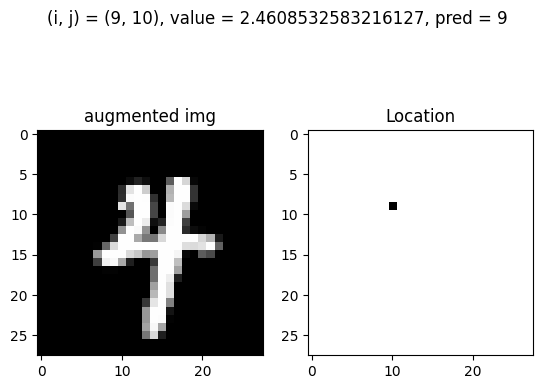

Test: At (i, j) = (9, 10) and value = 2.82148653034729, pred = 9, before_pred = 4, gt = 4


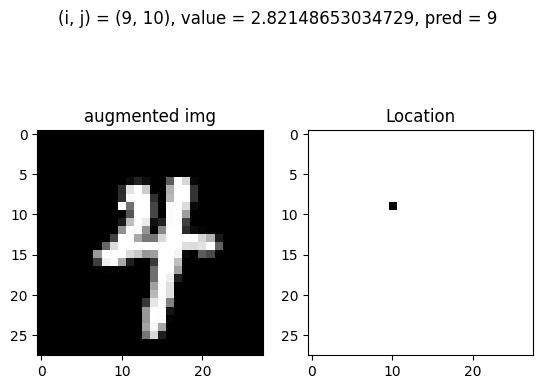

Test: At (i, j) = (9, 11) and value = 2.4608532583216127, pred = 9, before_pred = 4, gt = 4


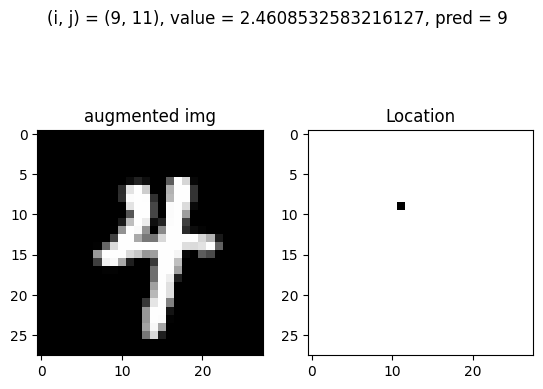

Test: At (i, j) = (9, 11) and value = 2.82148653034729, pred = 9, before_pred = 4, gt = 4


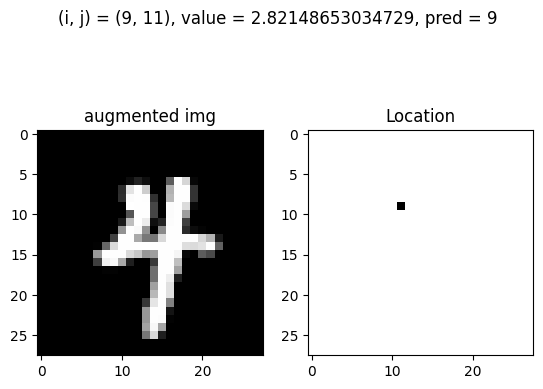

Test: At (i, j) = (9, 14) and value = 1.3789534422445815, pred = 9, before_pred = 4, gt = 4


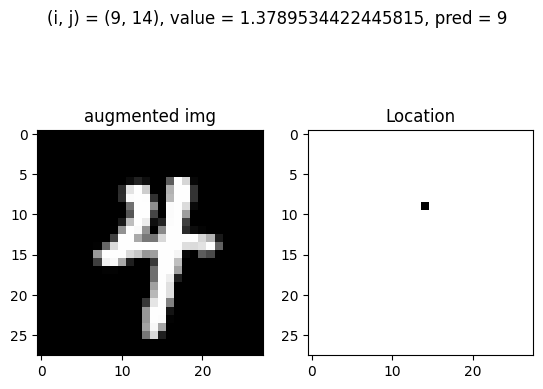

Test: At (i, j) = (9, 14) and value = 1.7395867142702586, pred = 9, before_pred = 4, gt = 4


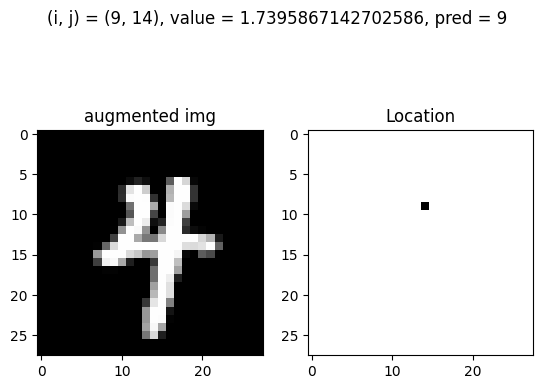

Test: At (i, j) = (9, 14) and value = 2.1002199862959356, pred = 9, before_pred = 4, gt = 4


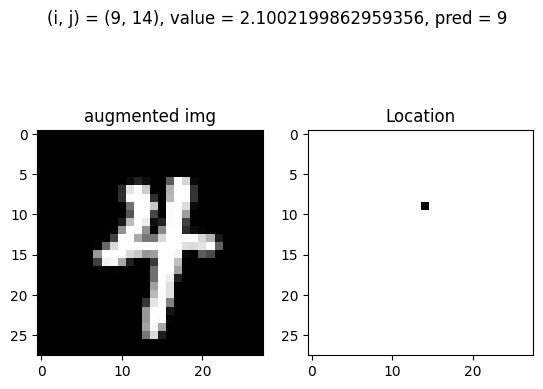

Test: At (i, j) = (9, 14) and value = 2.4608532583216127, pred = 9, before_pred = 4, gt = 4


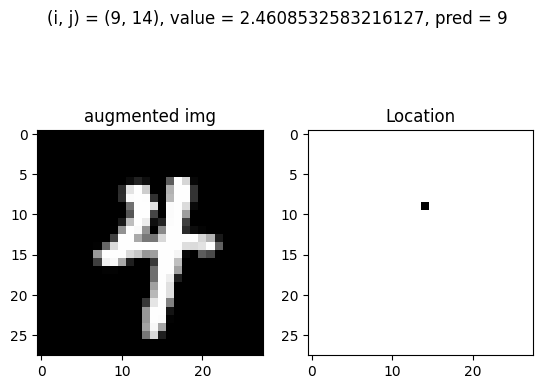

Test: At (i, j) = (9, 14) and value = 2.82148653034729, pred = 9, before_pred = 4, gt = 4


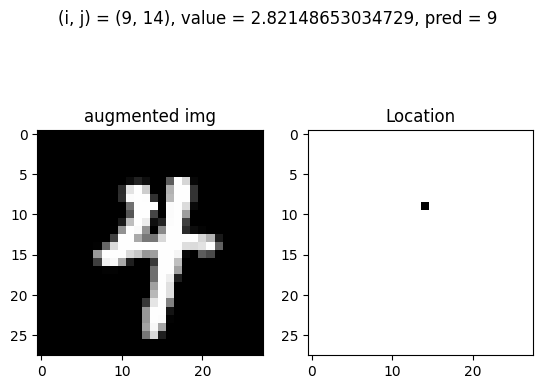

Test: At (i, j) = (9, 15) and value = 0.29705362616755016, pred = 9, before_pred = 4, gt = 4


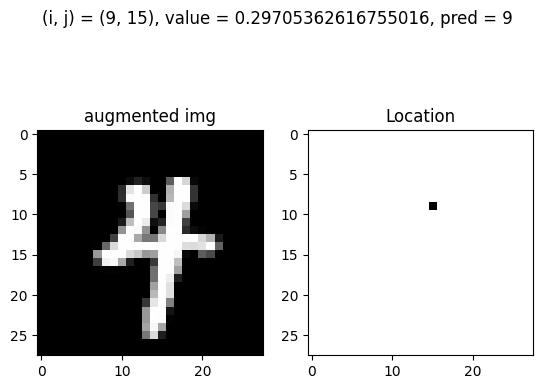

Test: At (i, j) = (9, 15) and value = 0.6576868981932272, pred = 9, before_pred = 4, gt = 4


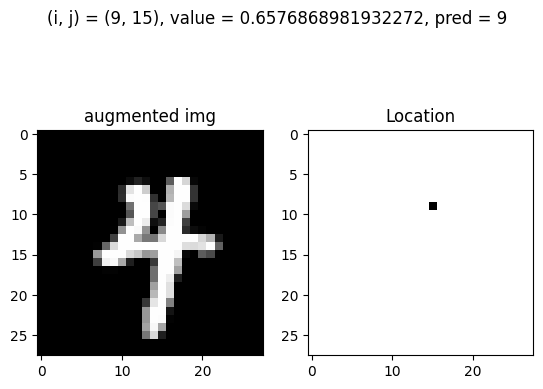

Test: At (i, j) = (9, 15) and value = 1.0183201702189044, pred = 9, before_pred = 4, gt = 4


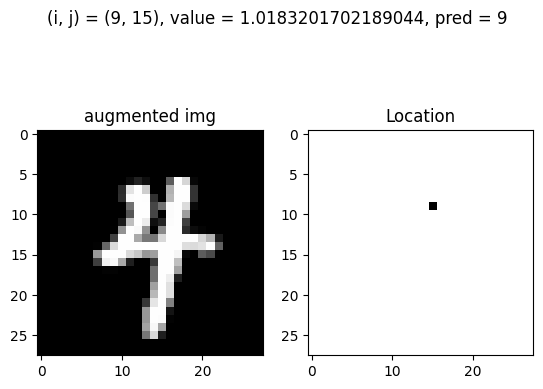

Test: At (i, j) = (9, 15) and value = 1.3789534422445815, pred = 9, before_pred = 4, gt = 4


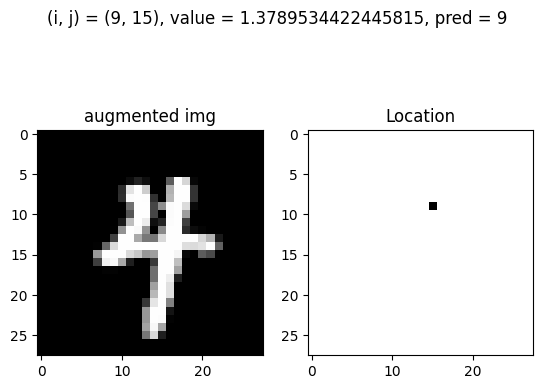

Test: At (i, j) = (9, 15) and value = 1.7395867142702586, pred = 9, before_pred = 4, gt = 4


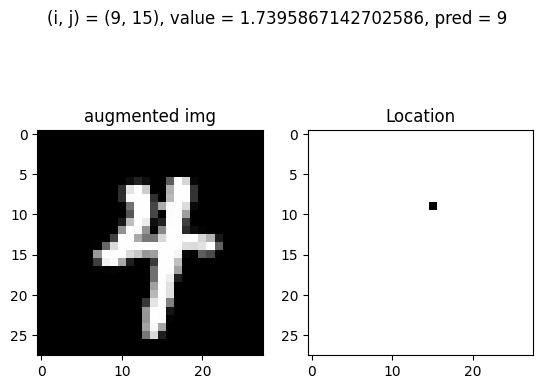

Test: At (i, j) = (9, 15) and value = 2.1002199862959356, pred = 9, before_pred = 4, gt = 4


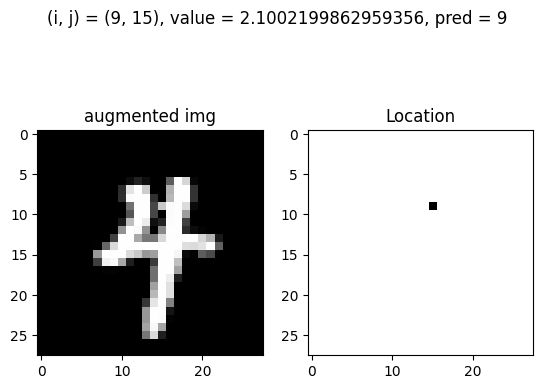

Test: At (i, j) = (9, 15) and value = 2.4608532583216127, pred = 9, before_pred = 4, gt = 4


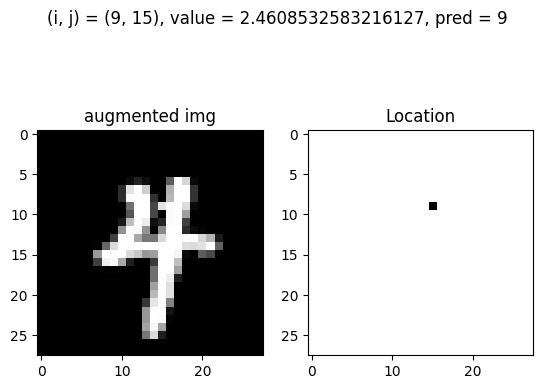

Test: At (i, j) = (9, 15) and value = 2.82148653034729, pred = 9, before_pred = 4, gt = 4


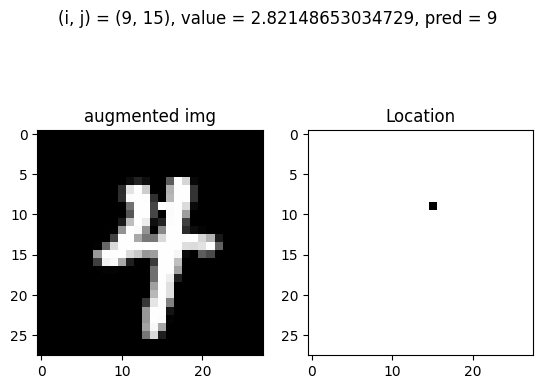

Test: At (i, j) = (9, 19) and value = 1.0183201702189044, pred = 9, before_pred = 4, gt = 4


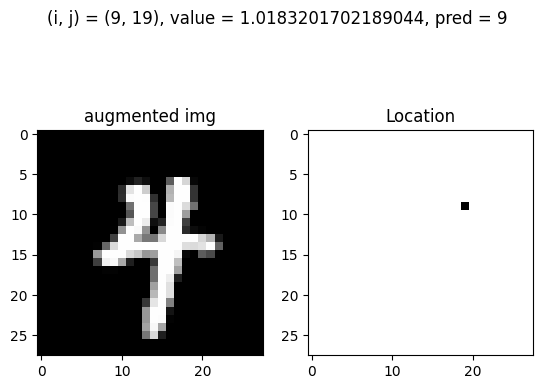

Test: At (i, j) = (9, 19) and value = 1.3789534422445815, pred = 9, before_pred = 4, gt = 4


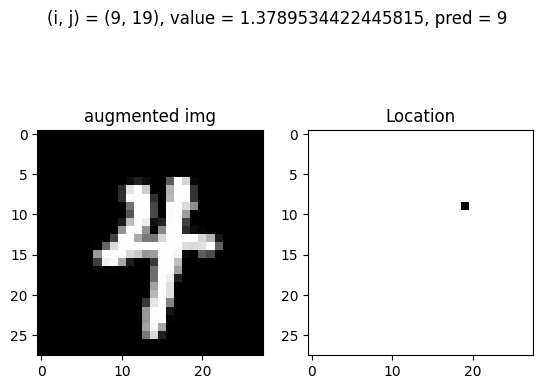

Test: At (i, j) = (9, 19) and value = 1.7395867142702586, pred = 9, before_pred = 4, gt = 4


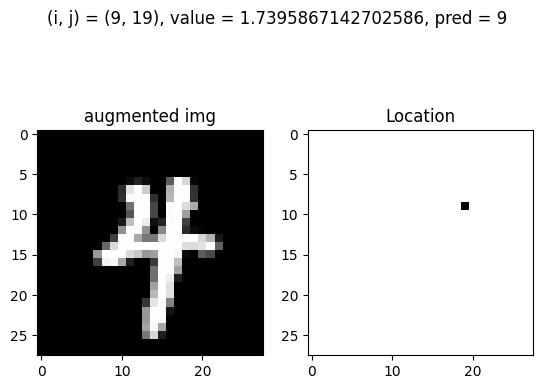

Test: At (i, j) = (9, 19) and value = 2.1002199862959356, pred = 9, before_pred = 4, gt = 4


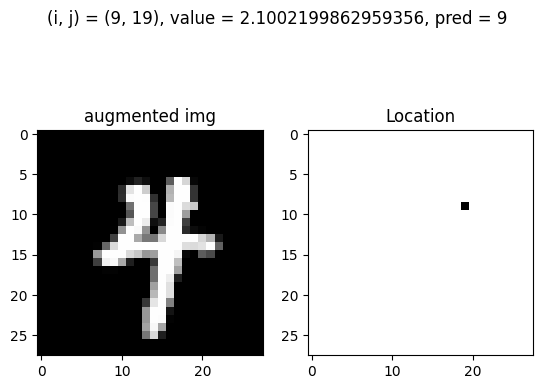

Test: At (i, j) = (9, 19) and value = 2.4608532583216127, pred = 9, before_pred = 4, gt = 4


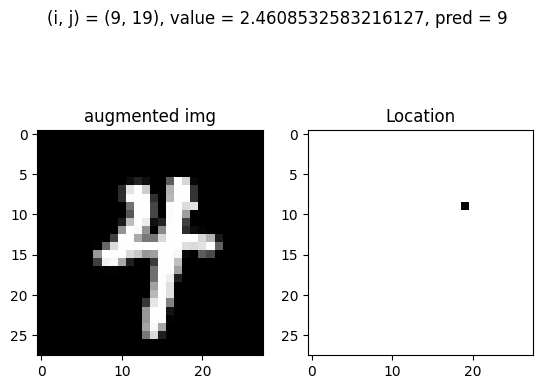

Test: At (i, j) = (9, 19) and value = 2.82148653034729, pred = 9, before_pred = 4, gt = 4


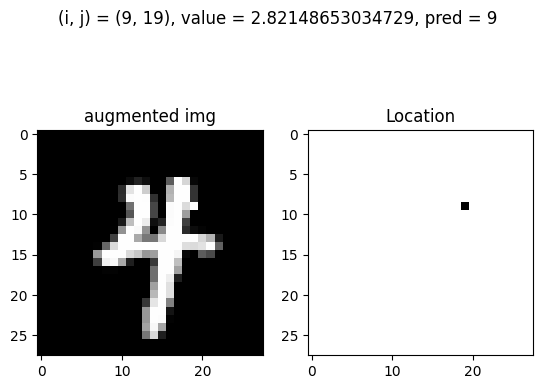

Test: At (i, j) = (9, 20) and value = 1.3789534422445815, pred = 9, before_pred = 4, gt = 4


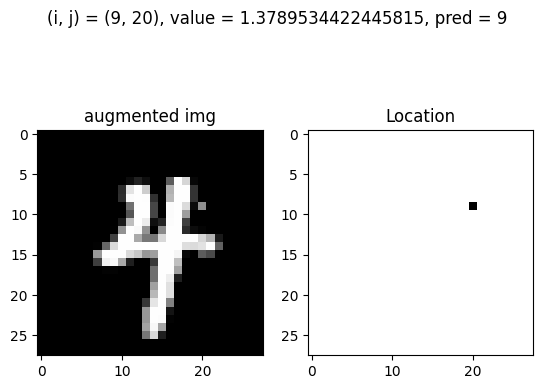

Test: At (i, j) = (9, 20) and value = 1.7395867142702586, pred = 9, before_pred = 4, gt = 4


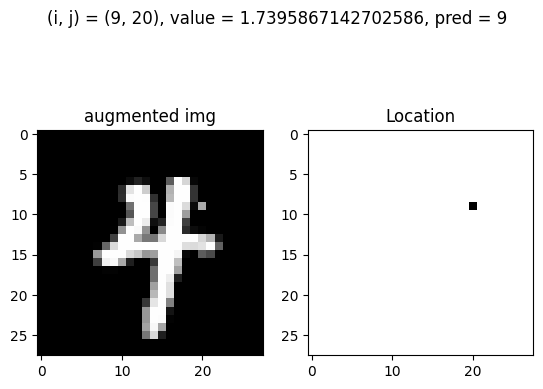

Test: At (i, j) = (9, 20) and value = 2.1002199862959356, pred = 9, before_pred = 4, gt = 4


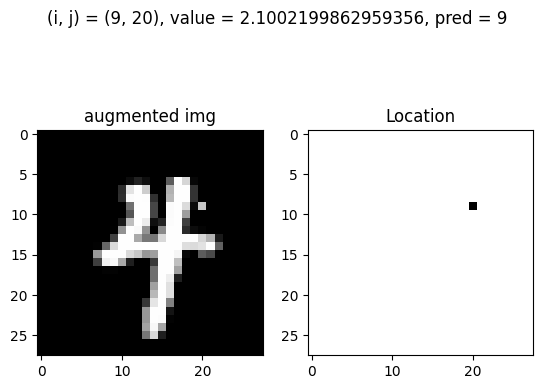

Test: At (i, j) = (9, 20) and value = 2.4608532583216127, pred = 9, before_pred = 4, gt = 4


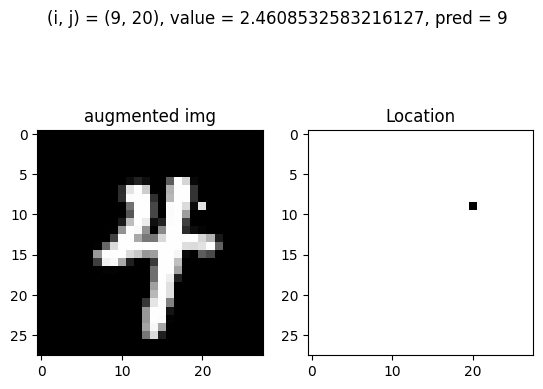

Test: At (i, j) = (9, 20) and value = 2.82148653034729, pred = 9, before_pred = 4, gt = 4


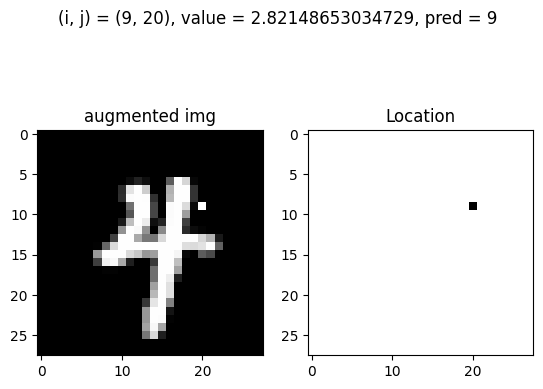

Test: At (i, j) = (9, 21) and value = 1.0183201702189044, pred = 9, before_pred = 4, gt = 4


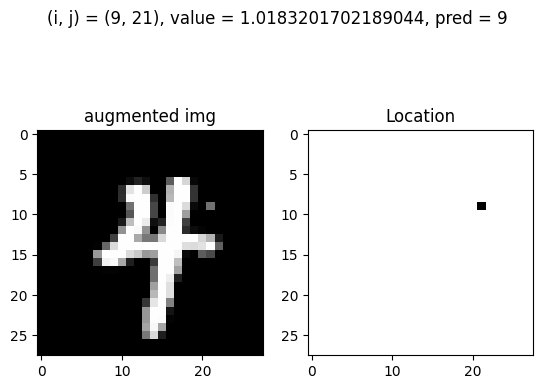

Test: At (i, j) = (9, 21) and value = 1.3789534422445815, pred = 9, before_pred = 4, gt = 4


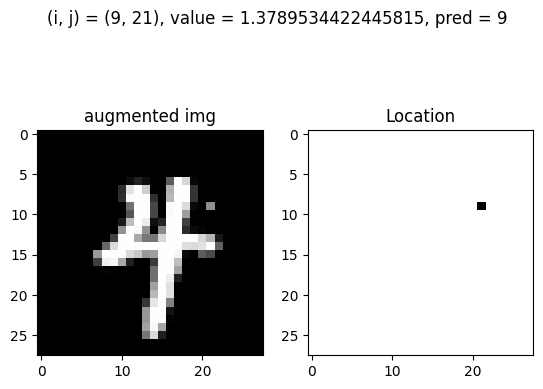

Test: At (i, j) = (9, 21) and value = 1.7395867142702586, pred = 9, before_pred = 4, gt = 4


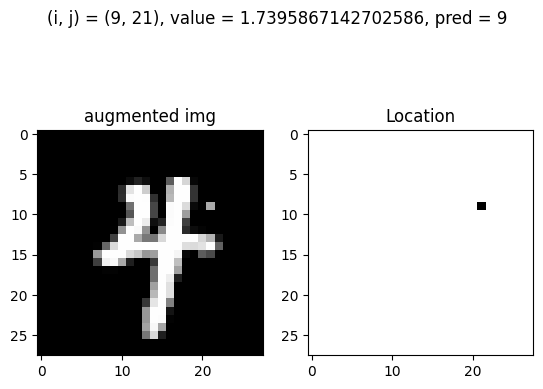

Test: At (i, j) = (9, 21) and value = 2.1002199862959356, pred = 9, before_pred = 4, gt = 4


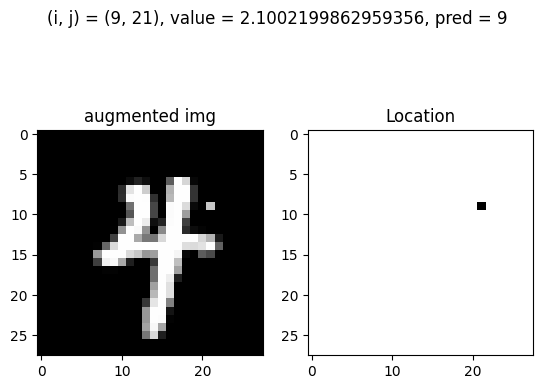

Test: At (i, j) = (9, 21) and value = 2.4608532583216127, pred = 9, before_pred = 4, gt = 4


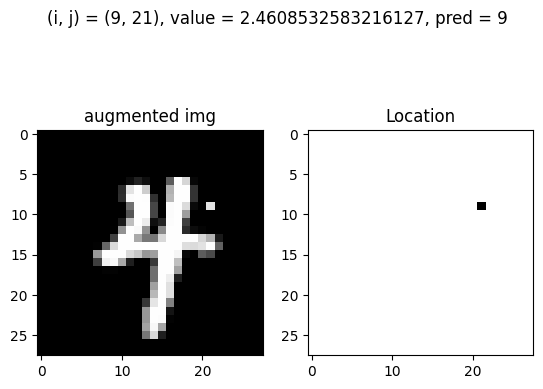

Test: At (i, j) = (9, 21) and value = 2.82148653034729, pred = 9, before_pred = 4, gt = 4


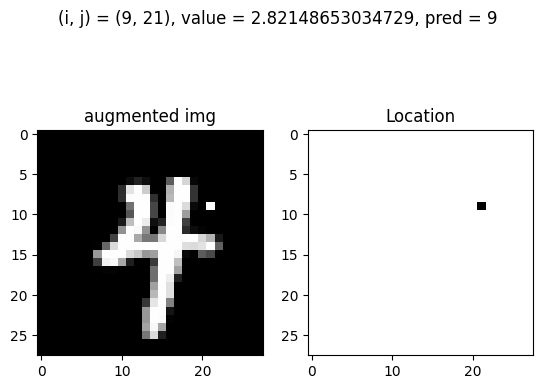

Test: At (i, j) = (9, 22) and value = 1.7395867142702586, pred = 9, before_pred = 4, gt = 4


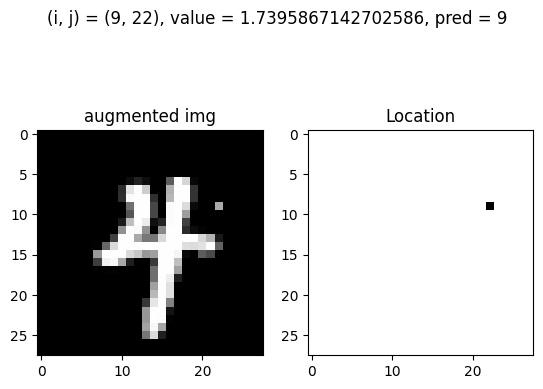

Test: At (i, j) = (9, 22) and value = 2.1002199862959356, pred = 9, before_pred = 4, gt = 4


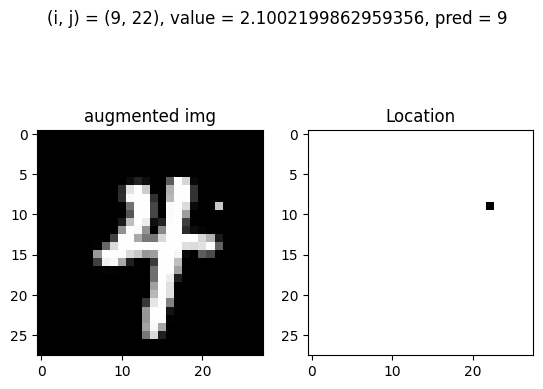

Test: At (i, j) = (9, 22) and value = 2.4608532583216127, pred = 9, before_pred = 4, gt = 4


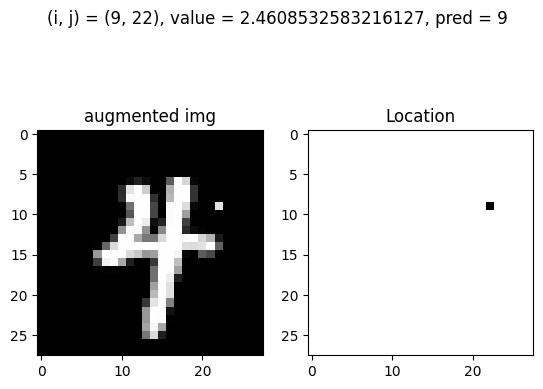

Test: At (i, j) = (9, 22) and value = 2.82148653034729, pred = 9, before_pred = 4, gt = 4


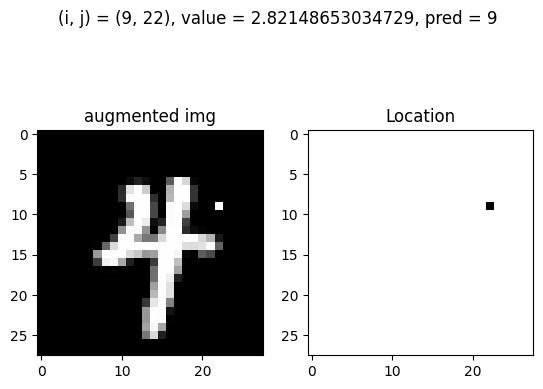

Test: At (i, j) = (10, 2) and value = 1.3789534422445815, pred = 9, before_pred = 4, gt = 4


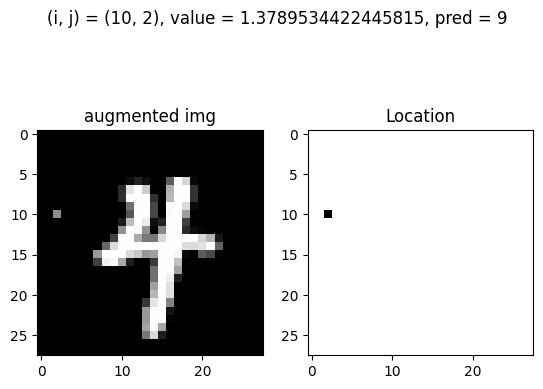

Test: At (i, j) = (10, 2) and value = 1.7395867142702586, pred = 9, before_pred = 4, gt = 4


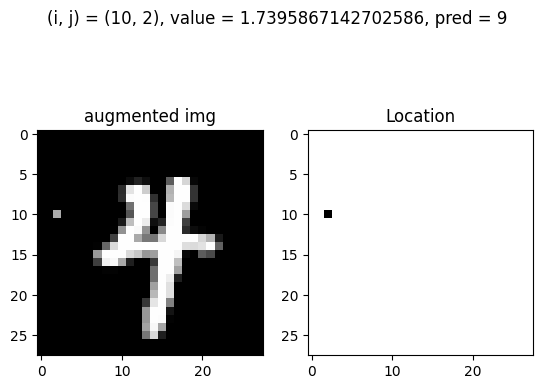

Test: At (i, j) = (10, 2) and value = 2.1002199862959356, pred = 9, before_pred = 4, gt = 4


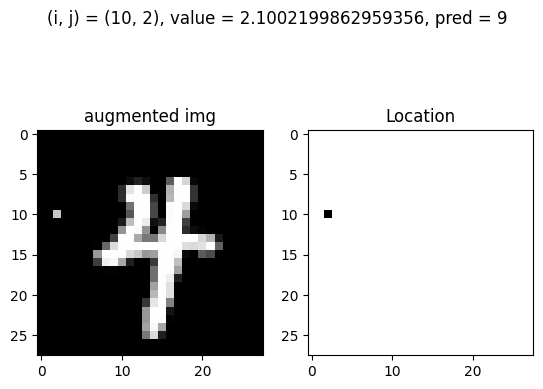

Test: At (i, j) = (10, 2) and value = 2.4608532583216127, pred = 9, before_pred = 4, gt = 4


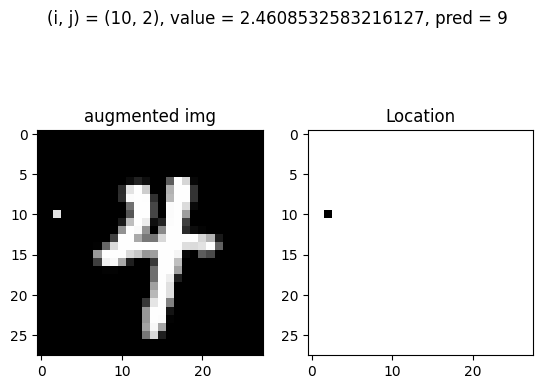

Test: At (i, j) = (10, 2) and value = 2.82148653034729, pred = 9, before_pred = 4, gt = 4


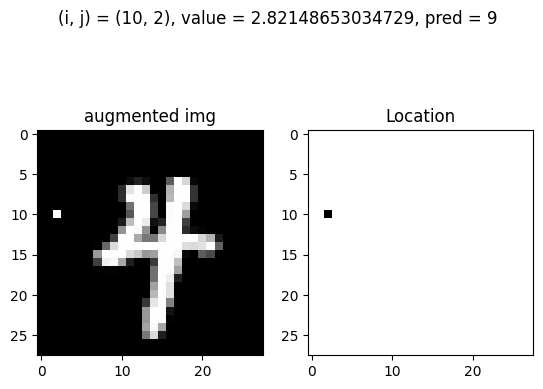

Test: At (i, j) = (10, 7) and value = 1.7395867142702586, pred = 9, before_pred = 4, gt = 4


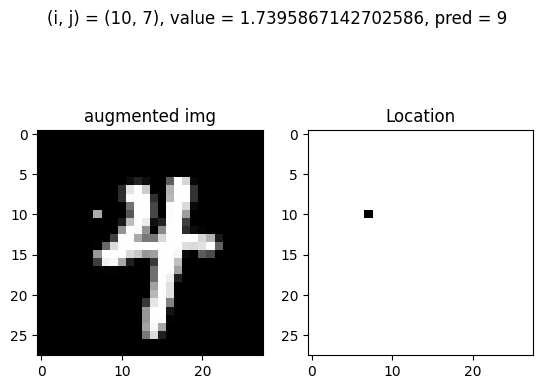

Test: At (i, j) = (10, 7) and value = 2.1002199862959356, pred = 9, before_pred = 4, gt = 4


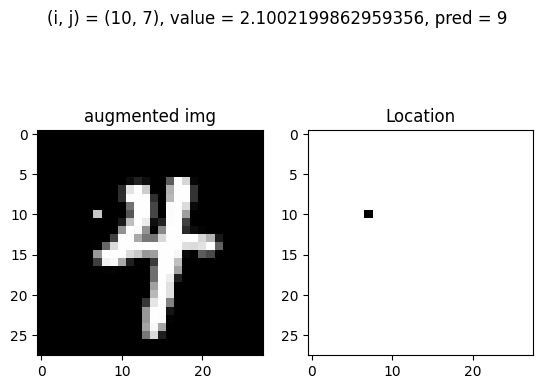

Test: At (i, j) = (10, 7) and value = 2.4608532583216127, pred = 9, before_pred = 4, gt = 4


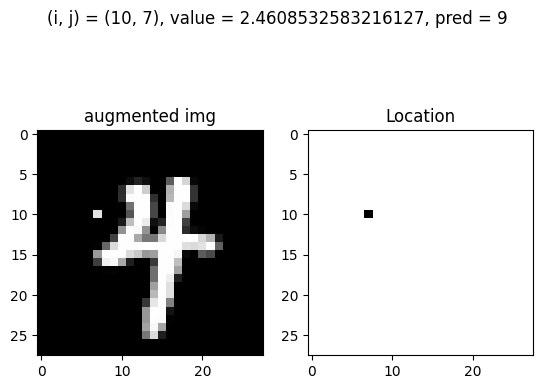

Test: At (i, j) = (10, 7) and value = 2.82148653034729, pred = 9, before_pred = 4, gt = 4


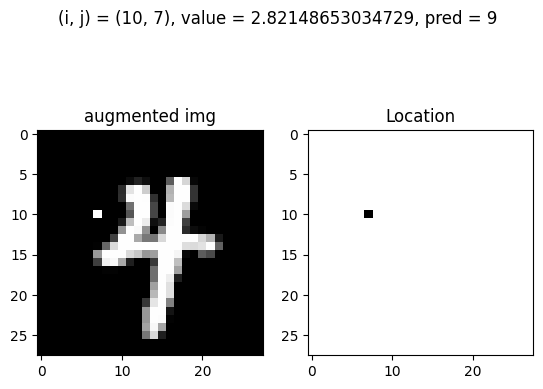

Test: At (i, j) = (10, 8) and value = 2.82148653034729, pred = 9, before_pred = 4, gt = 4


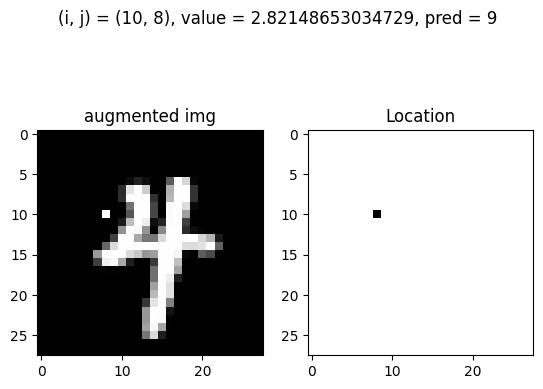

Test: At (i, j) = (10, 10) and value = 2.1002199862959356, pred = 9, before_pred = 4, gt = 4


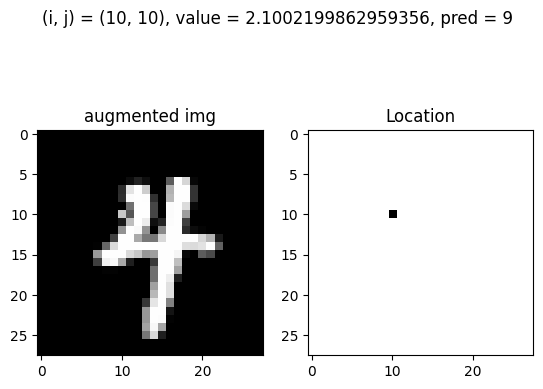

Test: At (i, j) = (10, 10) and value = 2.4608532583216127, pred = 9, before_pred = 4, gt = 4


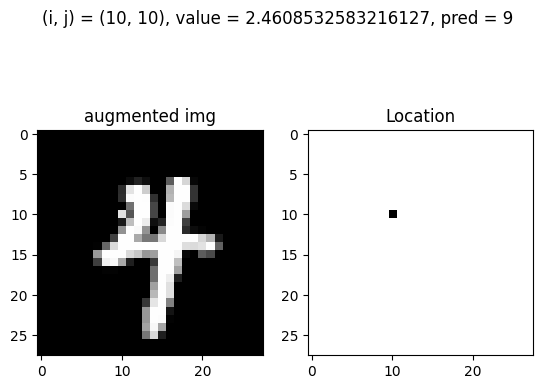

Test: At (i, j) = (10, 10) and value = 2.82148653034729, pred = 9, before_pred = 4, gt = 4


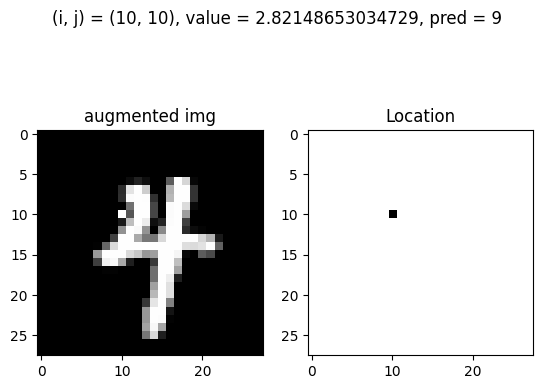

Test: At (i, j) = (10, 14) and value = 1.7395867142702586, pred = 9, before_pred = 4, gt = 4


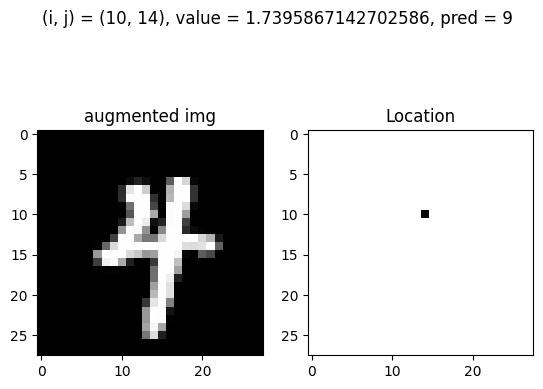

Test: At (i, j) = (10, 14) and value = 2.1002199862959356, pred = 9, before_pred = 4, gt = 4


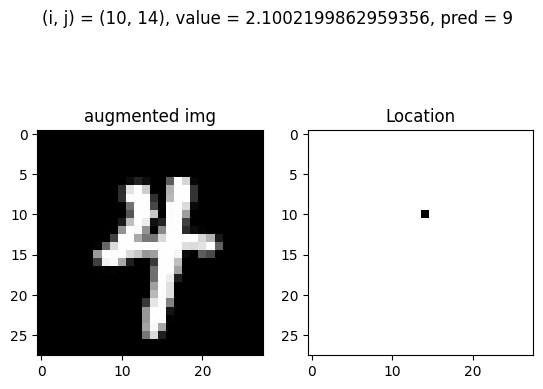

Test: At (i, j) = (10, 14) and value = 2.4608532583216127, pred = 9, before_pred = 4, gt = 4


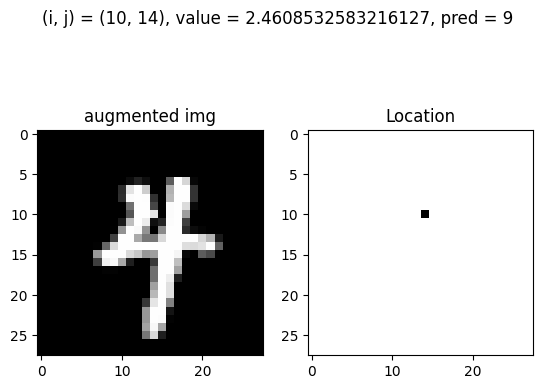

Test: At (i, j) = (10, 14) and value = 2.82148653034729, pred = 9, before_pred = 4, gt = 4


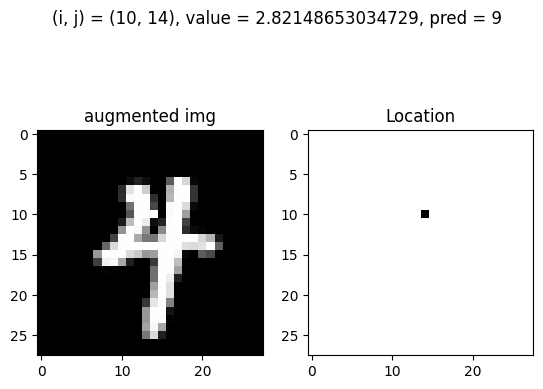

Test: At (i, j) = (10, 15) and value = 0.6576868981932272, pred = 9, before_pred = 4, gt = 4


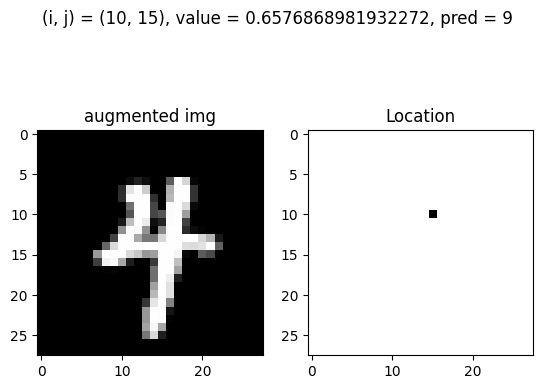

Test: At (i, j) = (10, 15) and value = 1.0183201702189044, pred = 9, before_pred = 4, gt = 4


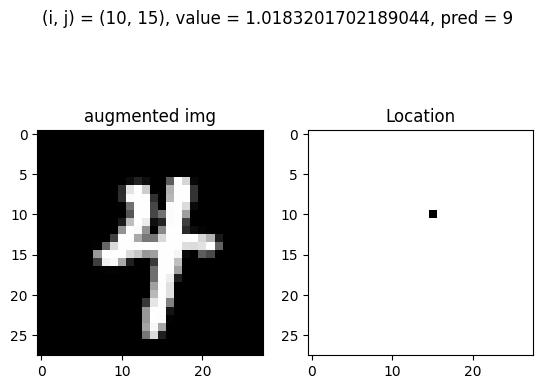

Test: At (i, j) = (10, 15) and value = 1.3789534422445815, pred = 9, before_pred = 4, gt = 4


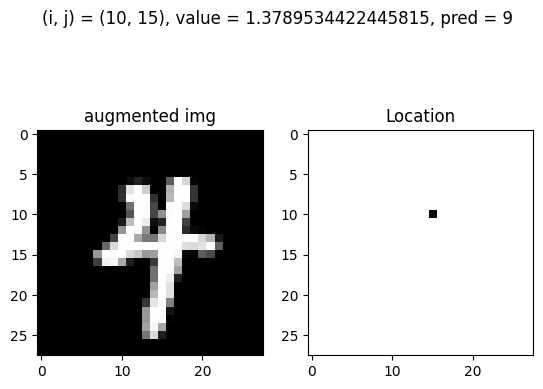

Test: At (i, j) = (10, 15) and value = 1.7395867142702586, pred = 9, before_pred = 4, gt = 4


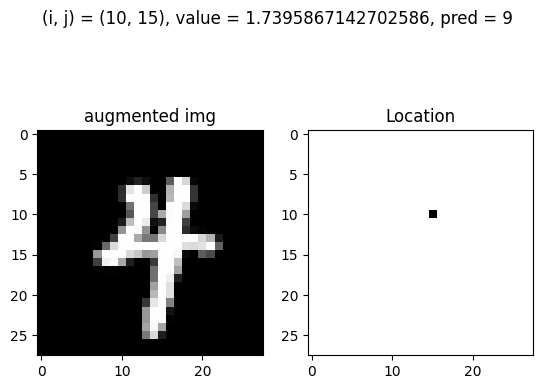

Test: At (i, j) = (10, 15) and value = 2.1002199862959356, pred = 9, before_pred = 4, gt = 4


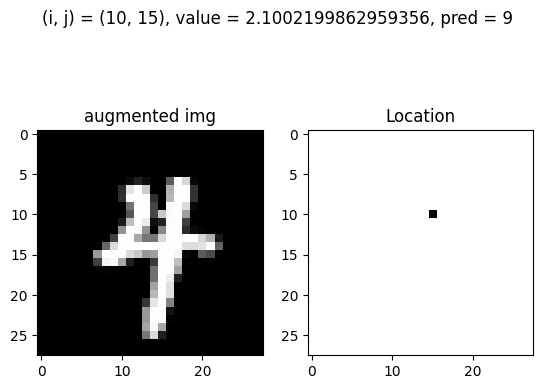

Test: At (i, j) = (10, 15) and value = 2.4608532583216127, pred = 9, before_pred = 4, gt = 4


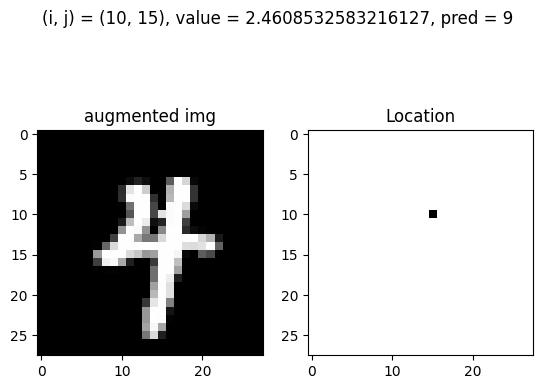

Test: At (i, j) = (10, 15) and value = 2.82148653034729, pred = 9, before_pred = 4, gt = 4


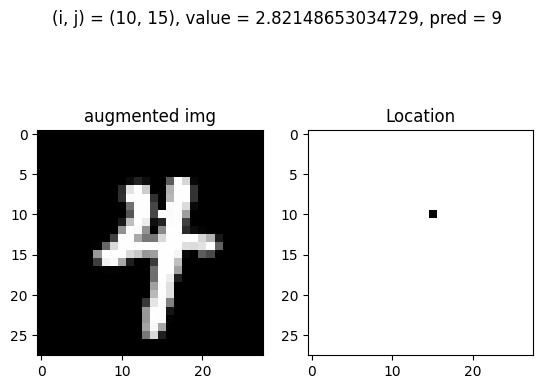

Test: At (i, j) = (10, 18) and value = 2.82148653034729, pred = 9, before_pred = 4, gt = 4


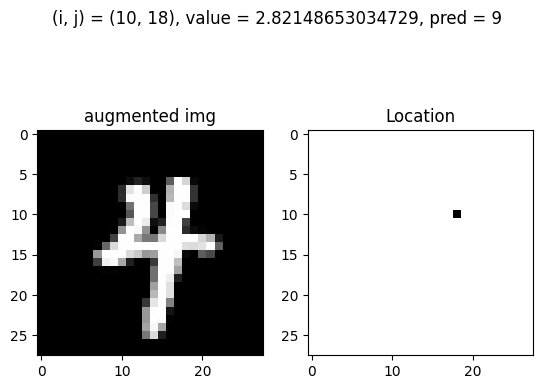

Test: At (i, j) = (10, 19) and value = 1.7395867142702586, pred = 9, before_pred = 4, gt = 4


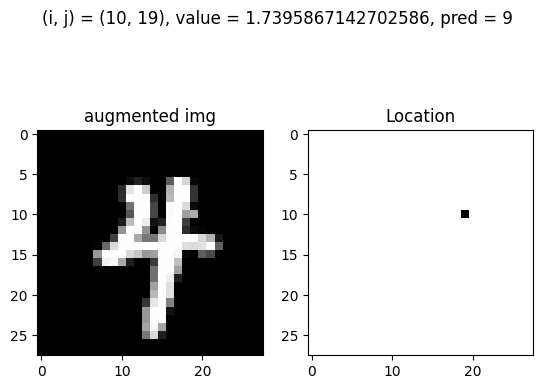

Test: At (i, j) = (10, 19) and value = 2.1002199862959356, pred = 9, before_pred = 4, gt = 4


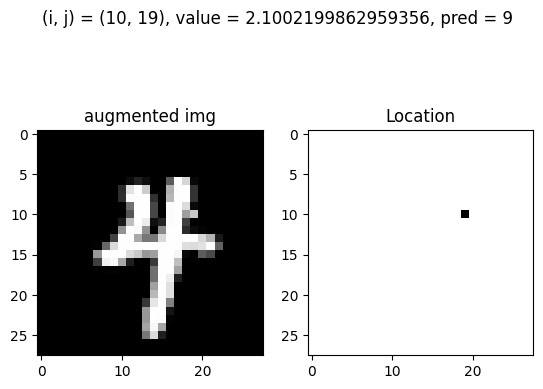

Test: At (i, j) = (10, 19) and value = 2.4608532583216127, pred = 9, before_pred = 4, gt = 4


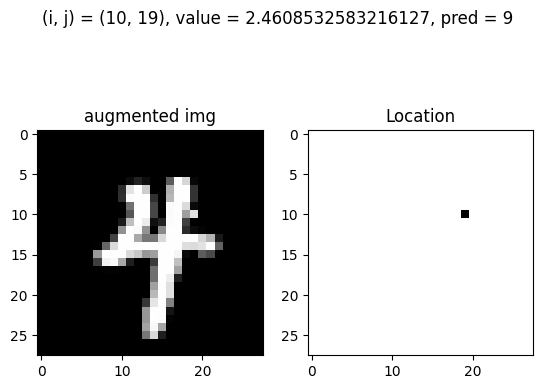

Test: At (i, j) = (10, 19) and value = 2.82148653034729, pred = 9, before_pred = 4, gt = 4


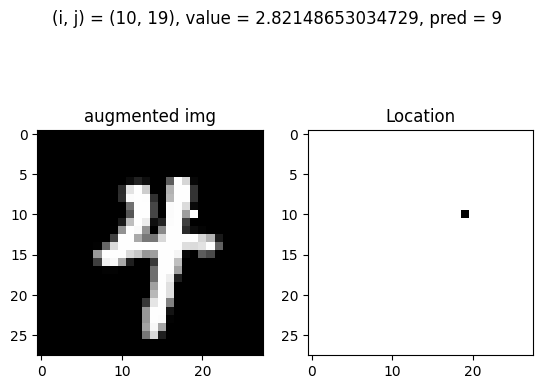

Test: At (i, j) = (10, 20) and value = 1.0183201702189044, pred = 9, before_pred = 4, gt = 4


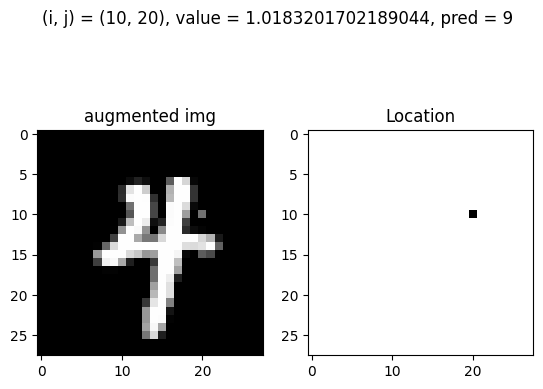

Test: At (i, j) = (10, 20) and value = 1.3789534422445815, pred = 9, before_pred = 4, gt = 4


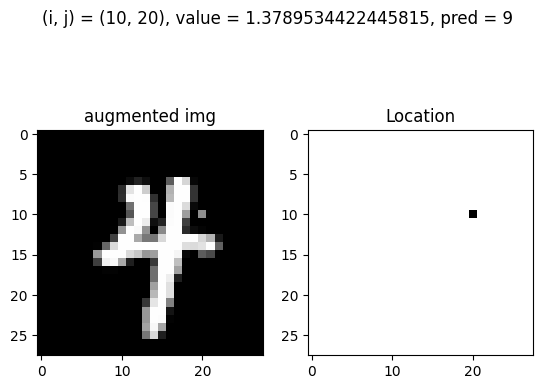

Test: At (i, j) = (10, 20) and value = 1.7395867142702586, pred = 9, before_pred = 4, gt = 4


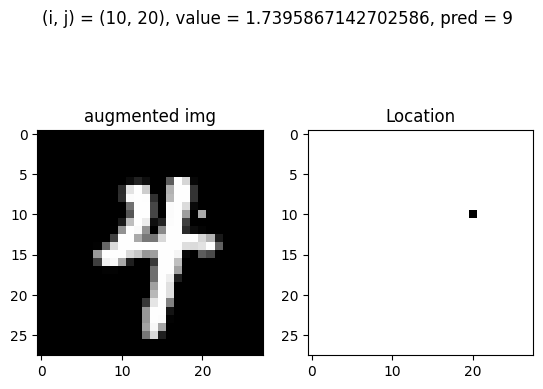

Test: At (i, j) = (10, 20) and value = 2.1002199862959356, pred = 9, before_pred = 4, gt = 4


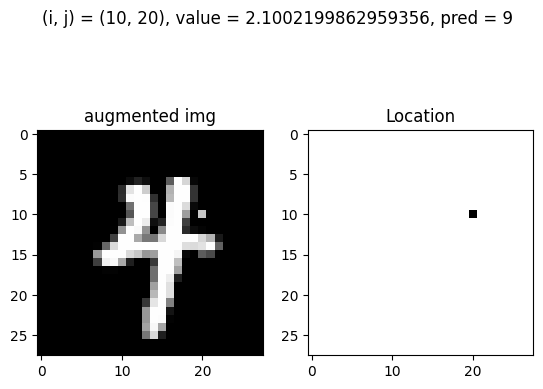

Test: At (i, j) = (10, 20) and value = 2.4608532583216127, pred = 9, before_pred = 4, gt = 4


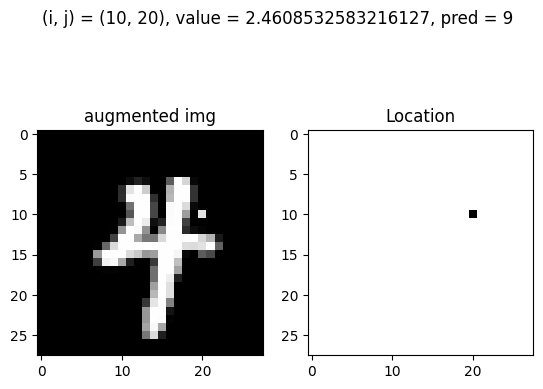

Test: At (i, j) = (10, 20) and value = 2.82148653034729, pred = 9, before_pred = 4, gt = 4


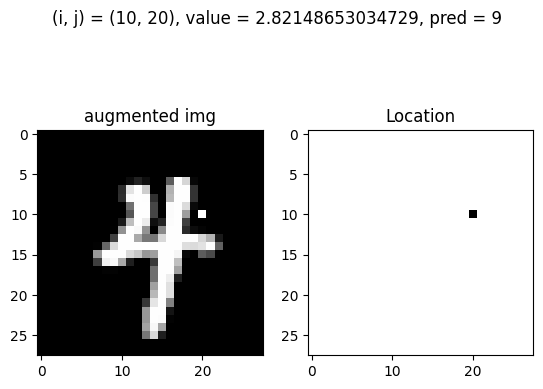

Test: At (i, j) = (10, 21) and value = 1.7395867142702586, pred = 9, before_pred = 4, gt = 4


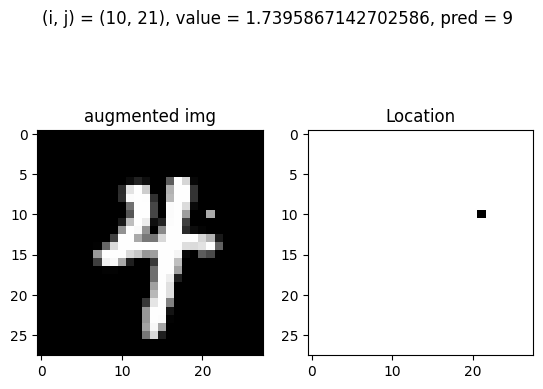

Test: At (i, j) = (10, 21) and value = 2.1002199862959356, pred = 9, before_pred = 4, gt = 4


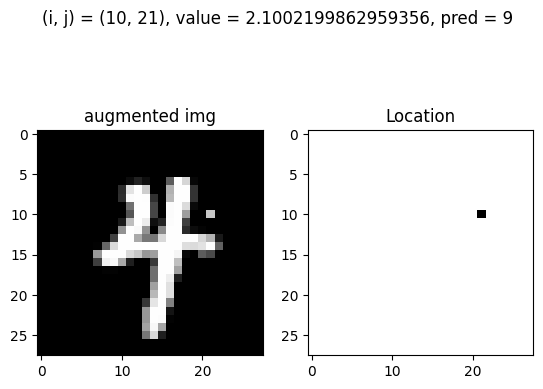

Test: At (i, j) = (10, 21) and value = 2.4608532583216127, pred = 9, before_pred = 4, gt = 4


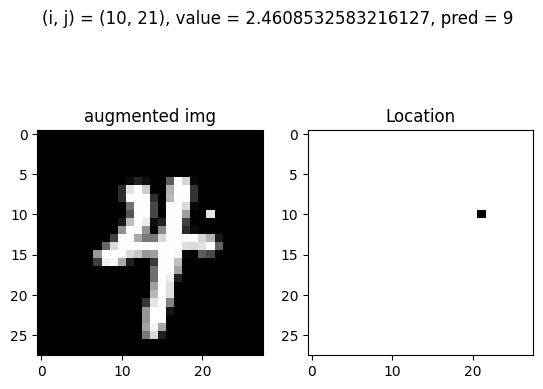

Test: At (i, j) = (10, 21) and value = 2.82148653034729, pred = 9, before_pred = 4, gt = 4


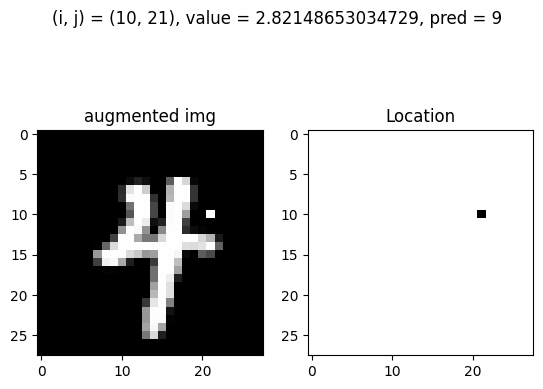

Test: At (i, j) = (10, 23) and value = 2.82148653034729, pred = 9, before_pred = 4, gt = 4


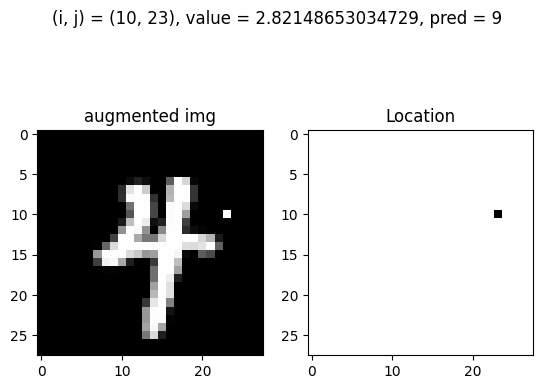

Test: At (i, j) = (10, 24) and value = 2.4608532583216127, pred = 9, before_pred = 4, gt = 4


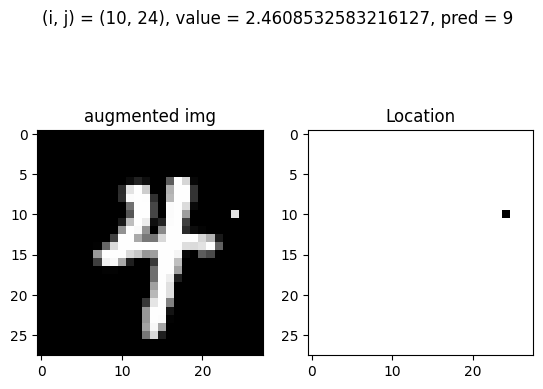

Test: At (i, j) = (10, 24) and value = 2.82148653034729, pred = 9, before_pred = 4, gt = 4


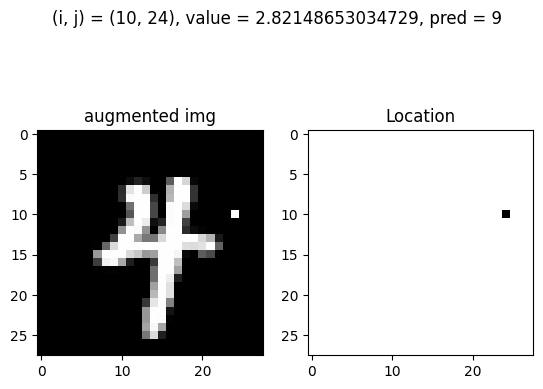

Test: At (i, j) = (11, 4) and value = 2.1002199862959356, pred = 9, before_pred = 4, gt = 4


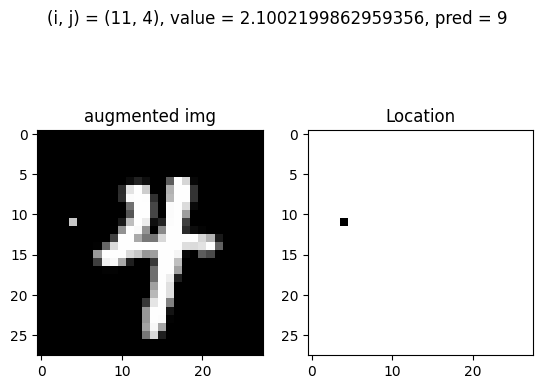

Test: At (i, j) = (11, 4) and value = 2.4608532583216127, pred = 9, before_pred = 4, gt = 4


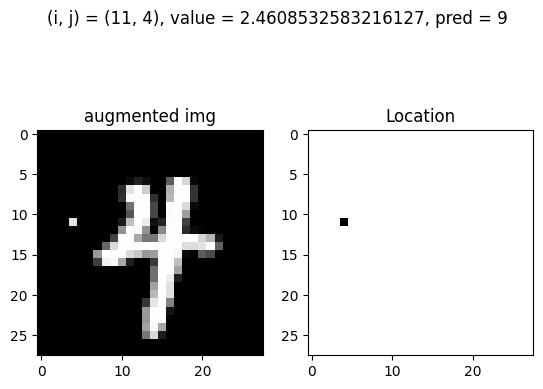

Test: At (i, j) = (11, 4) and value = 2.82148653034729, pred = 9, before_pred = 4, gt = 4


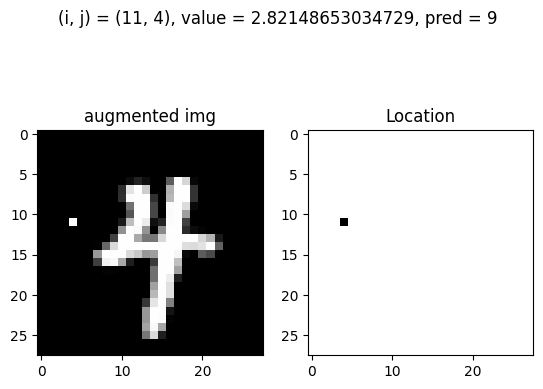

Test: At (i, j) = (11, 8) and value = 2.4608532583216127, pred = 9, before_pred = 4, gt = 4


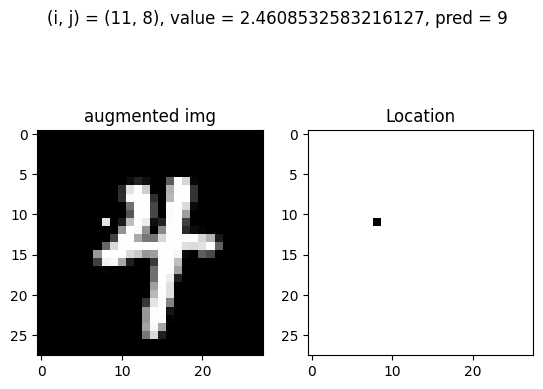

Test: At (i, j) = (11, 8) and value = 2.82148653034729, pred = 9, before_pred = 4, gt = 4


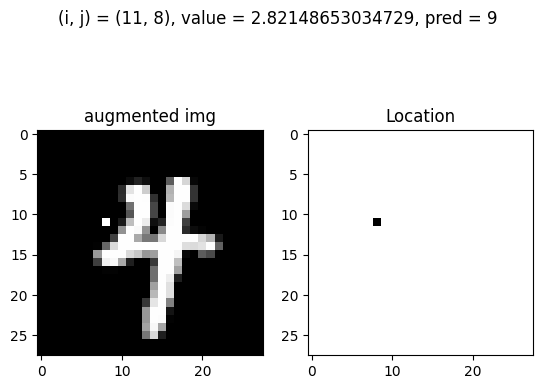

Test: At (i, j) = (11, 14) and value = 2.1002199862959356, pred = 9, before_pred = 4, gt = 4


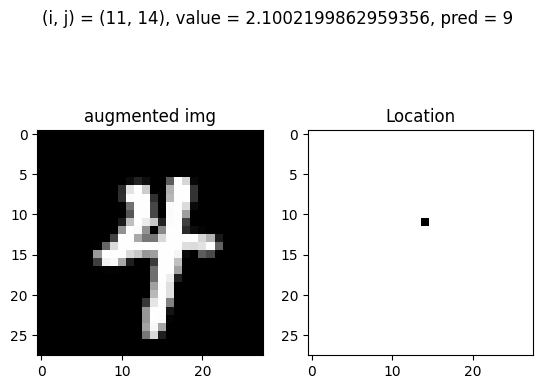

Test: At (i, j) = (11, 14) and value = 2.4608532583216127, pred = 9, before_pred = 4, gt = 4


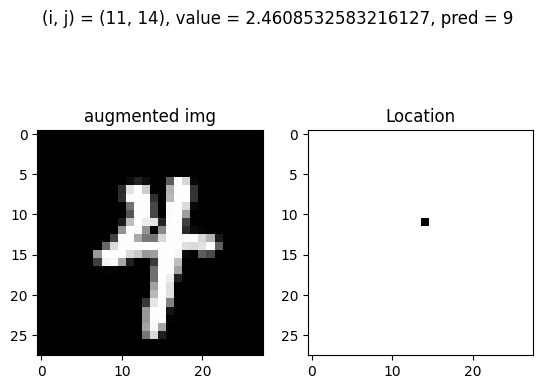

Test: At (i, j) = (11, 14) and value = 2.82148653034729, pred = 9, before_pred = 4, gt = 4


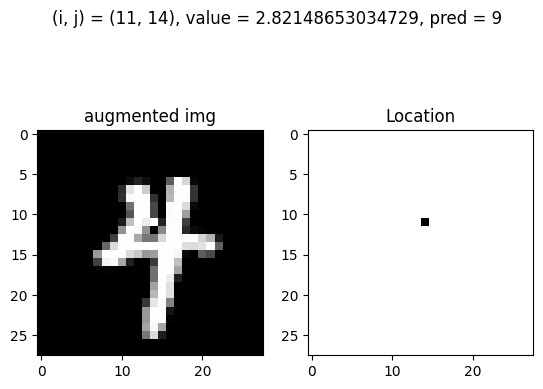

Test: At (i, j) = (11, 15) and value = 1.0183201702189044, pred = 9, before_pred = 4, gt = 4


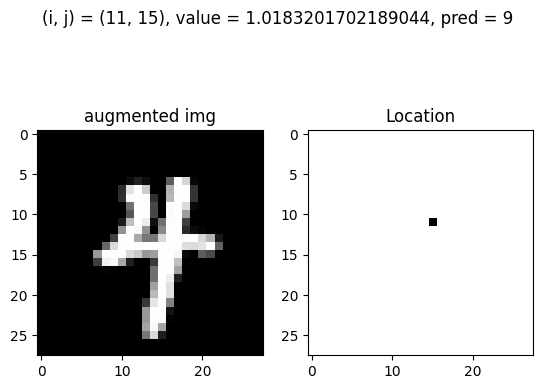

Test: At (i, j) = (11, 15) and value = 1.3789534422445815, pred = 9, before_pred = 4, gt = 4


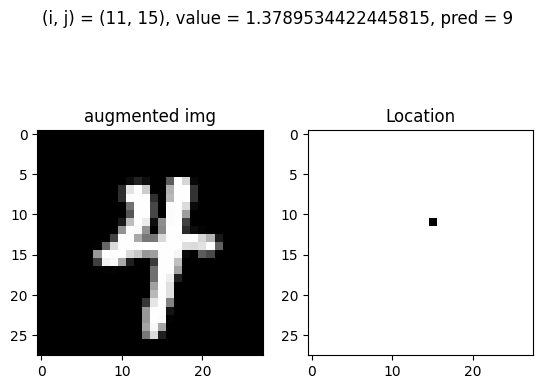

Test: At (i, j) = (11, 15) and value = 1.7395867142702586, pred = 9, before_pred = 4, gt = 4


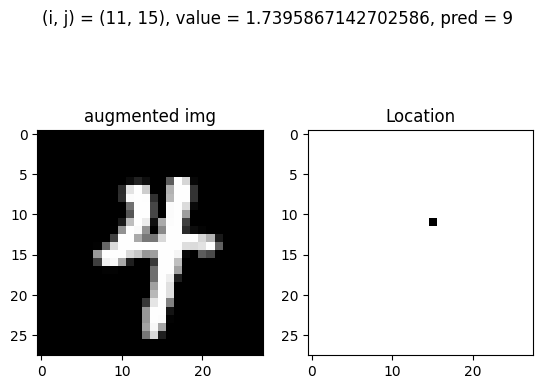

Test: At (i, j) = (11, 15) and value = 2.1002199862959356, pred = 9, before_pred = 4, gt = 4


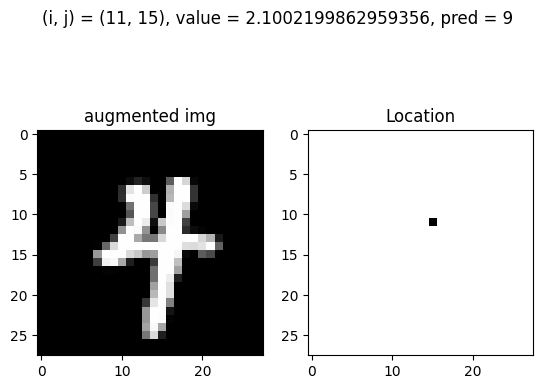

Test: At (i, j) = (11, 15) and value = 2.4608532583216127, pred = 9, before_pred = 4, gt = 4


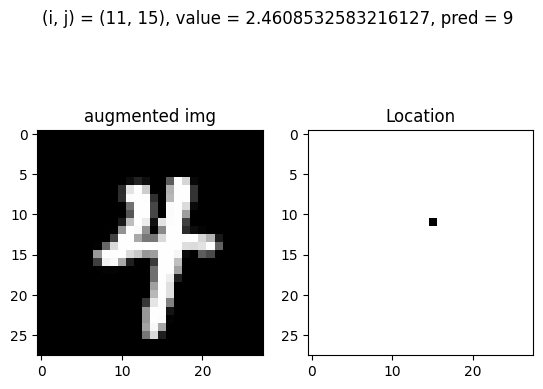

Test: At (i, j) = (11, 15) and value = 2.82148653034729, pred = 9, before_pred = 4, gt = 4


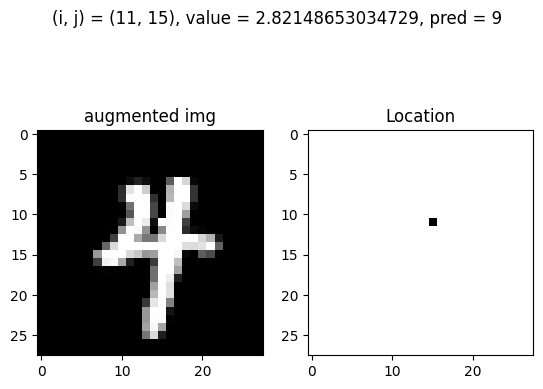

Test: At (i, j) = (11, 20) and value = 2.4608532583216127, pred = 9, before_pred = 4, gt = 4


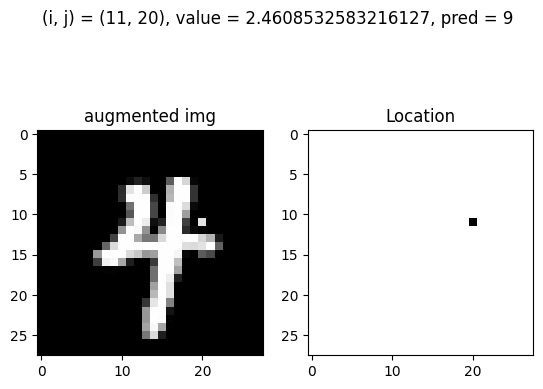

Test: At (i, j) = (11, 20) and value = 2.82148653034729, pred = 9, before_pred = 4, gt = 4


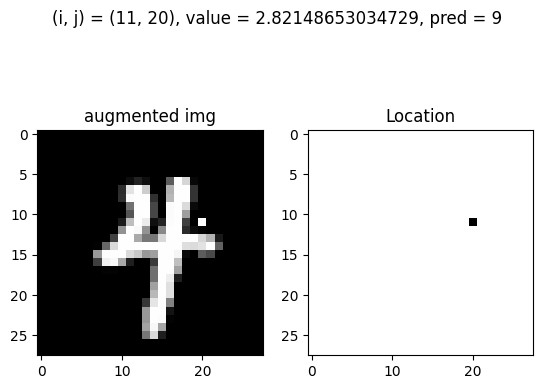

Test: At (i, j) = (11, 21) and value = 1.7395867142702586, pred = 9, before_pred = 4, gt = 4


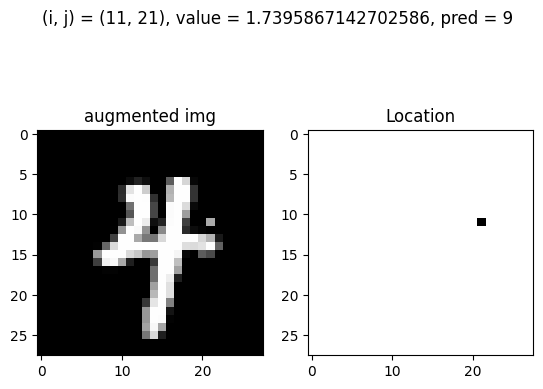

Test: At (i, j) = (11, 21) and value = 2.1002199862959356, pred = 9, before_pred = 4, gt = 4


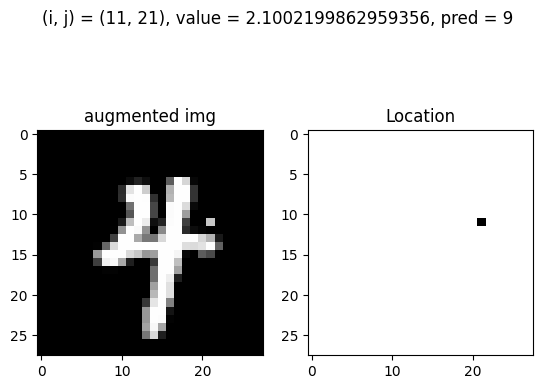

Test: At (i, j) = (11, 21) and value = 2.4608532583216127, pred = 9, before_pred = 4, gt = 4


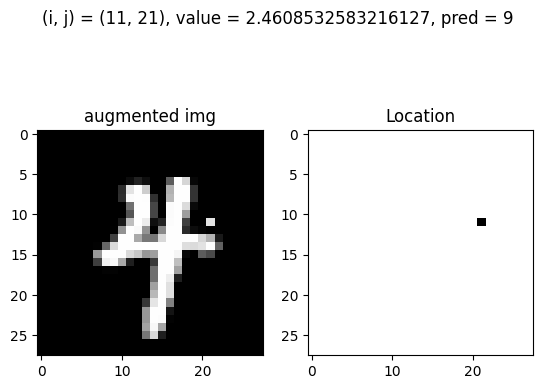

Test: At (i, j) = (11, 21) and value = 2.82148653034729, pred = 9, before_pred = 4, gt = 4


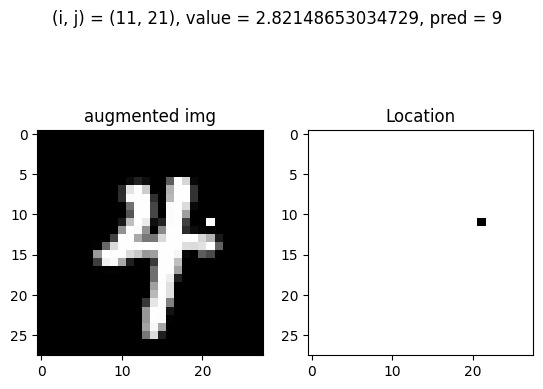

Test: At (i, j) = (11, 24) and value = 2.82148653034729, pred = 9, before_pred = 4, gt = 4


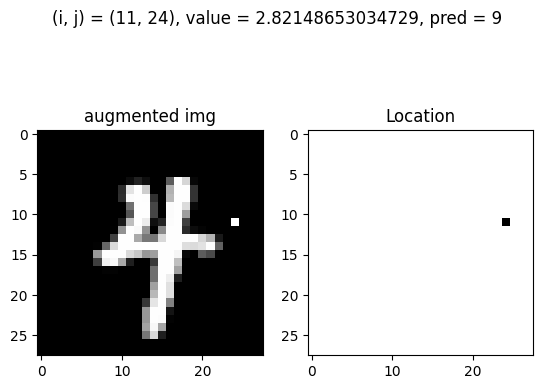

Test: At (i, j) = (12, 5) and value = 2.4608532583216127, pred = 9, before_pred = 4, gt = 4


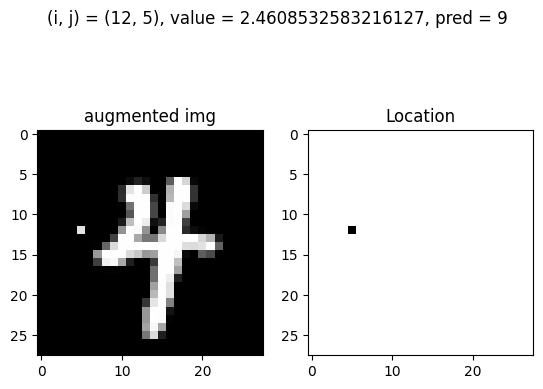

Test: At (i, j) = (12, 5) and value = 2.82148653034729, pred = 9, before_pred = 4, gt = 4


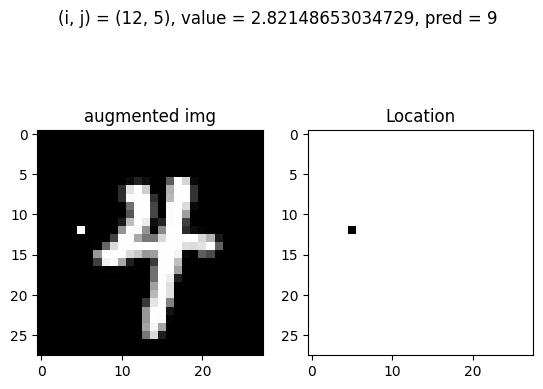

Test: At (i, j) = (12, 10) and value = -0.424212917883804, pred = 9, before_pred = 4, gt = 4


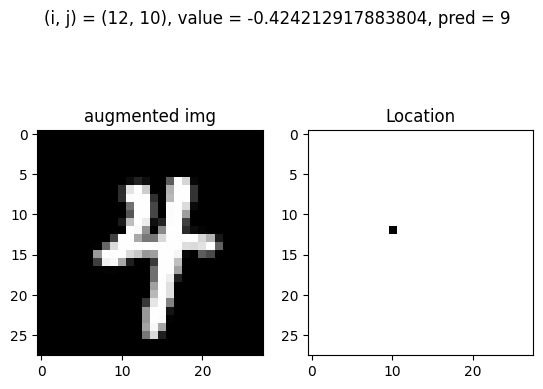

Test: At (i, j) = (12, 11) and value = -0.424212917883804, pred = 9, before_pred = 4, gt = 4


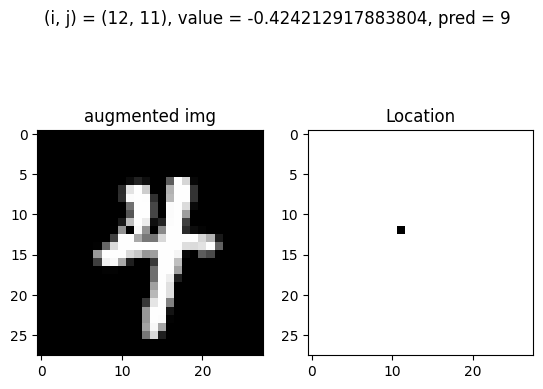

Test: At (i, j) = (12, 11) and value = -0.06357964585812692, pred = 9, before_pred = 4, gt = 4


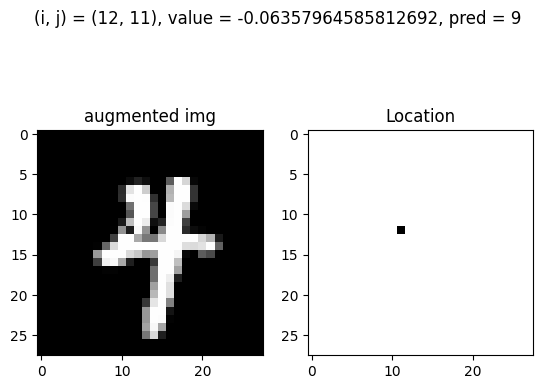

Test: At (i, j) = (12, 11) and value = 0.29705362616755016, pred = 9, before_pred = 4, gt = 4


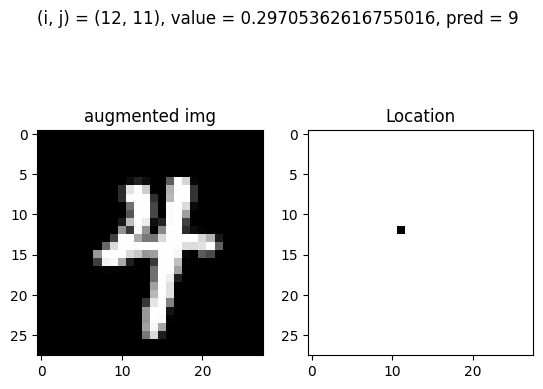

Test: At (i, j) = (12, 11) and value = 0.6576868981932272, pred = 9, before_pred = 4, gt = 4


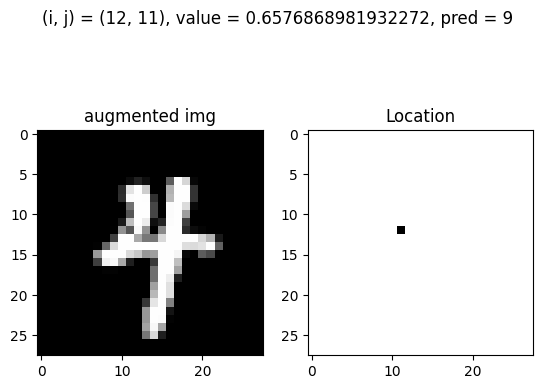

Test: At (i, j) = (12, 11) and value = 1.0183201702189044, pred = 9, before_pred = 4, gt = 4


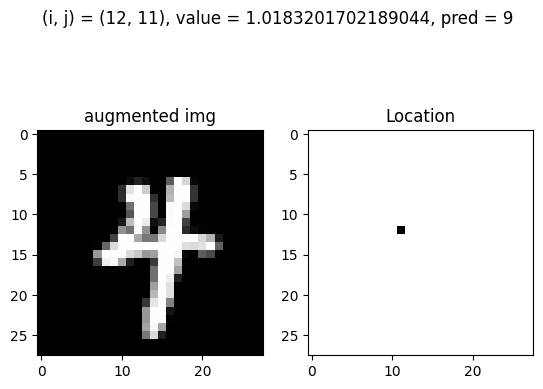

Test: At (i, j) = (12, 11) and value = 1.3789534422445815, pred = 9, before_pred = 4, gt = 4


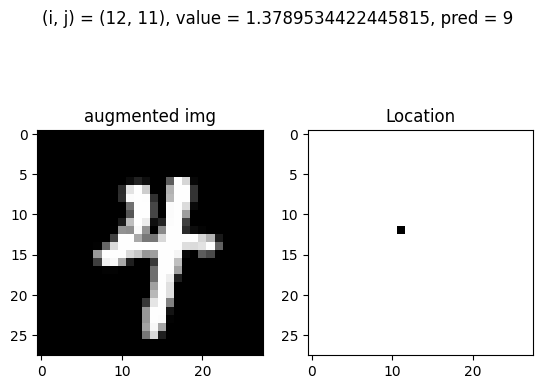

Test: At (i, j) = (12, 12) and value = -0.424212917883804, pred = 9, before_pred = 4, gt = 4


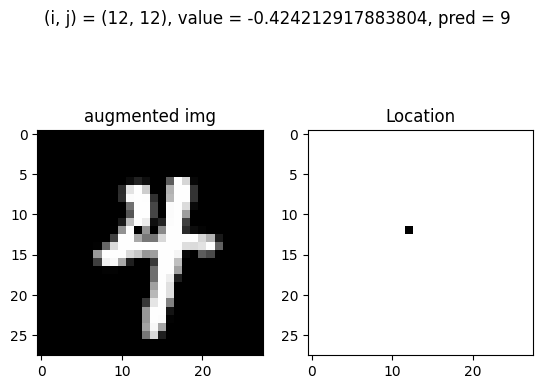

Test: At (i, j) = (12, 12) and value = -0.06357964585812692, pred = 9, before_pred = 4, gt = 4


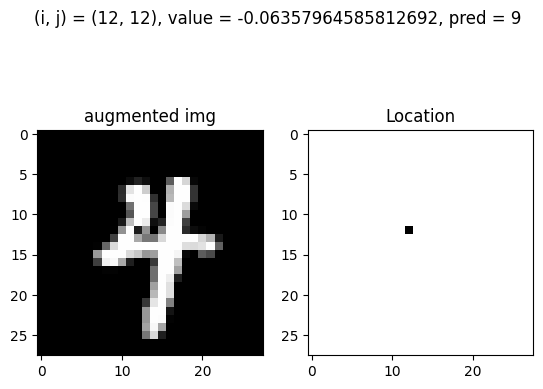

Test: At (i, j) = (12, 12) and value = 0.29705362616755016, pred = 9, before_pred = 4, gt = 4


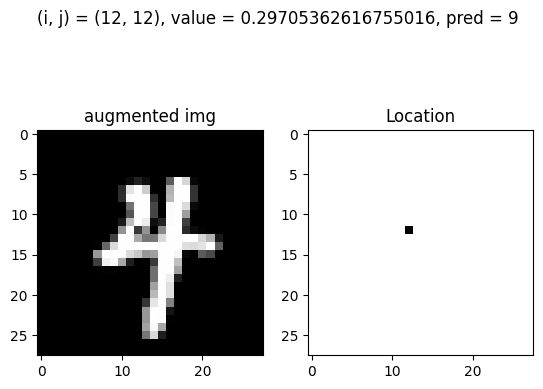

Test: At (i, j) = (12, 12) and value = 0.6576868981932272, pred = 9, before_pred = 4, gt = 4


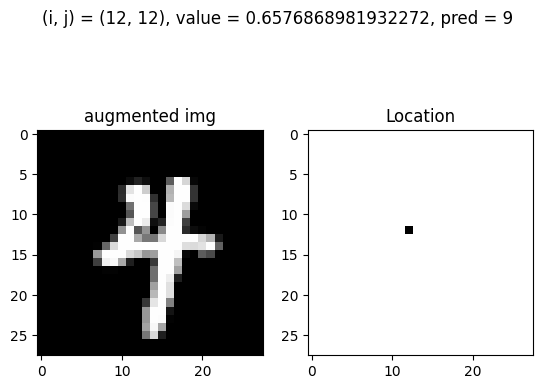

Test: At (i, j) = (12, 12) and value = 1.0183201702189044, pred = 9, before_pred = 4, gt = 4


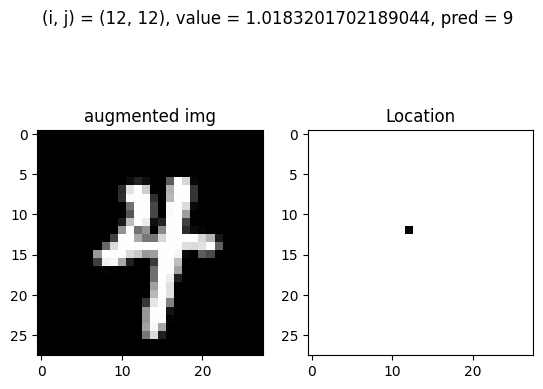

Test: At (i, j) = (12, 12) and value = 1.3789534422445815, pred = 9, before_pred = 4, gt = 4


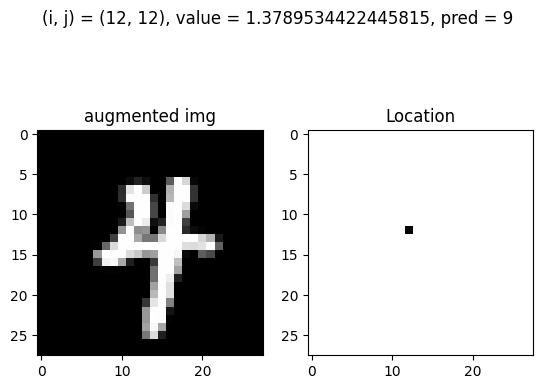

Test: At (i, j) = (12, 13) and value = -0.424212917883804, pred = 9, before_pred = 4, gt = 4


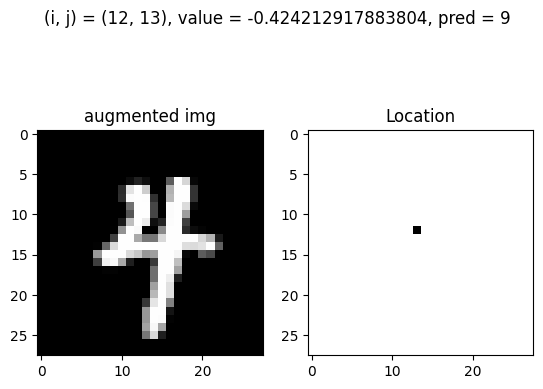

Test: At (i, j) = (12, 14) and value = 2.82148653034729, pred = 9, before_pred = 4, gt = 4


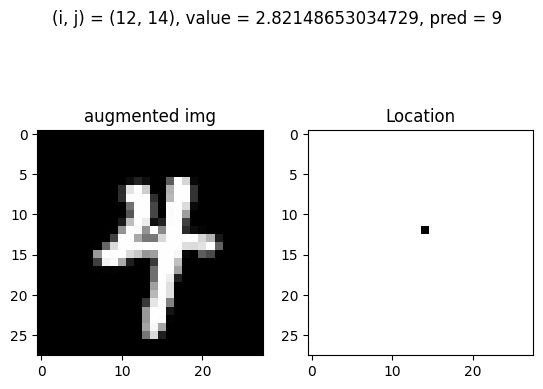

Test: At (i, j) = (12, 18) and value = 2.82148653034729, pred = 9, before_pred = 4, gt = 4


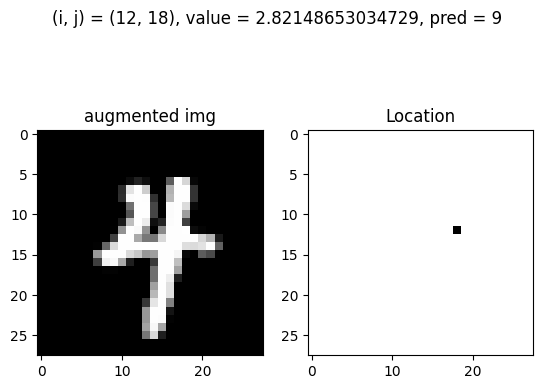

Test: At (i, j) = (12, 19) and value = 2.82148653034729, pred = 9, before_pred = 4, gt = 4


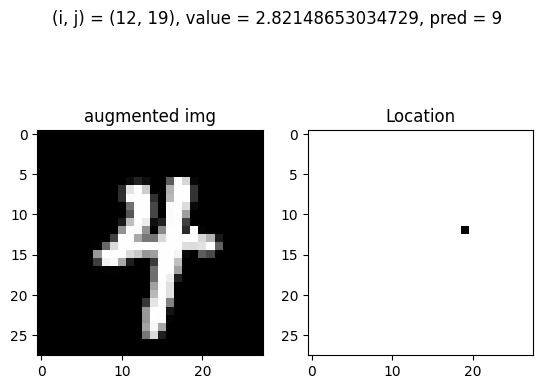

Test: At (i, j) = (12, 20) and value = 1.3789534422445815, pred = 9, before_pred = 4, gt = 4


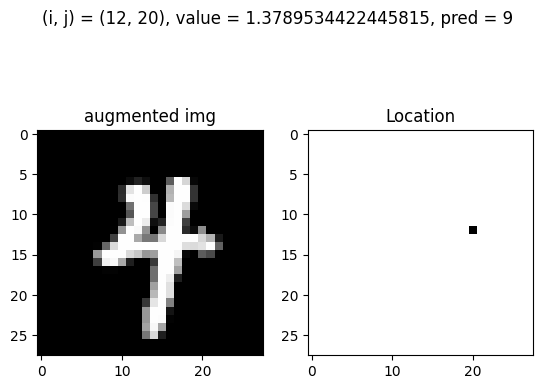

Test: At (i, j) = (12, 20) and value = 1.7395867142702586, pred = 9, before_pred = 4, gt = 4


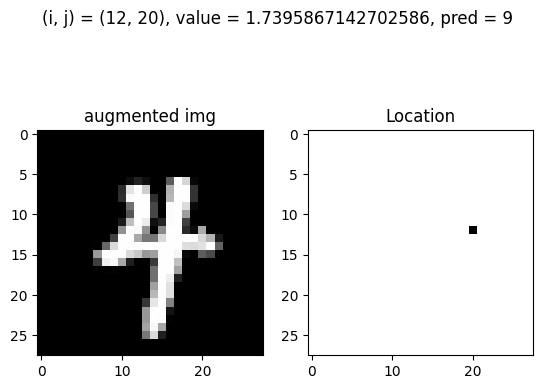

Test: At (i, j) = (12, 20) and value = 2.1002199862959356, pred = 9, before_pred = 4, gt = 4


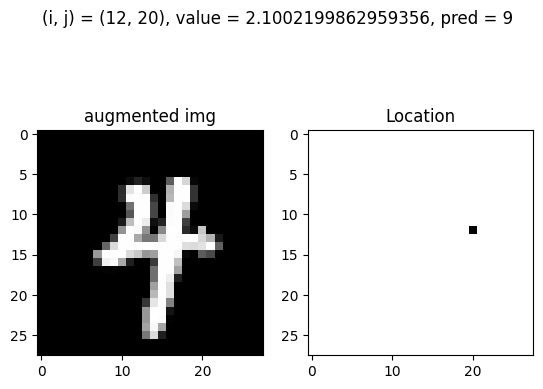

Test: At (i, j) = (12, 20) and value = 2.4608532583216127, pred = 9, before_pred = 4, gt = 4


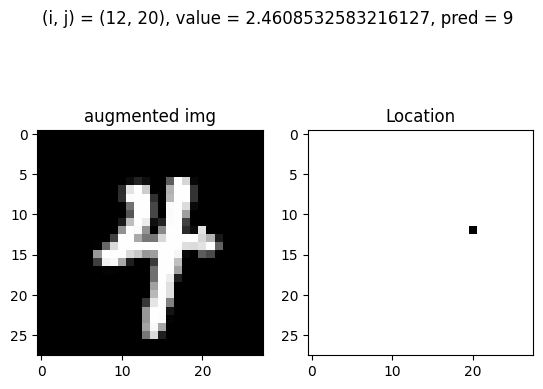

Test: At (i, j) = (12, 20) and value = 2.82148653034729, pred = 9, before_pred = 4, gt = 4


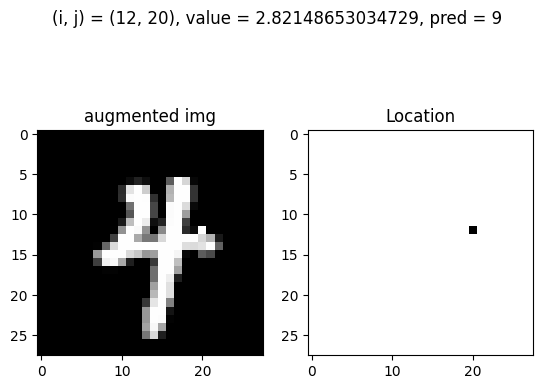

Test: At (i, j) = (13, 5) and value = 1.7395867142702586, pred = 9, before_pred = 4, gt = 4


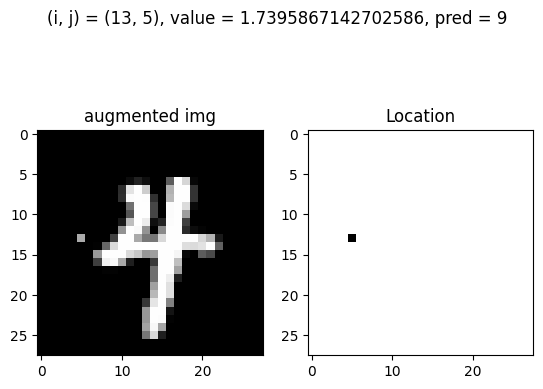

Test: At (i, j) = (13, 5) and value = 2.1002199862959356, pred = 9, before_pred = 4, gt = 4


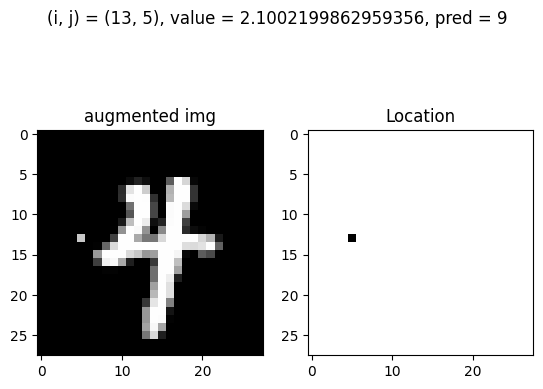

Test: At (i, j) = (13, 5) and value = 2.4608532583216127, pred = 9, before_pred = 4, gt = 4


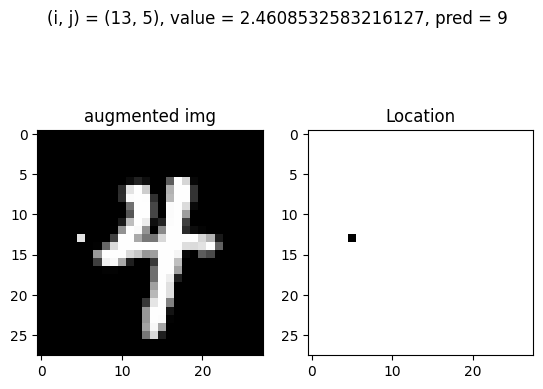

Test: At (i, j) = (13, 5) and value = 2.82148653034729, pred = 9, before_pred = 4, gt = 4


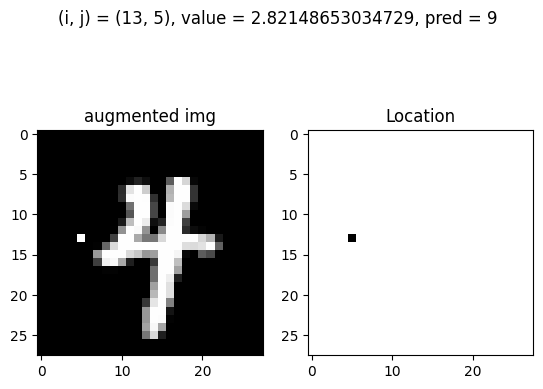

Test: At (i, j) = (13, 10) and value = -0.424212917883804, pred = 9, before_pred = 4, gt = 4


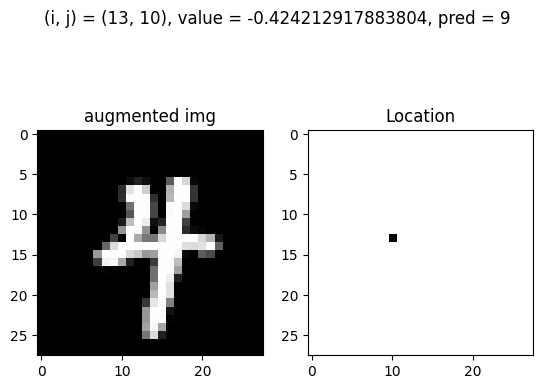

Test: At (i, j) = (13, 10) and value = -0.06357964585812692, pred = 9, before_pred = 4, gt = 4


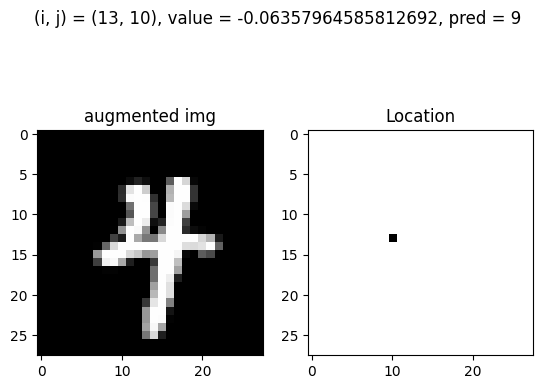

Test: At (i, j) = (13, 10) and value = 0.29705362616755016, pred = 9, before_pred = 4, gt = 4


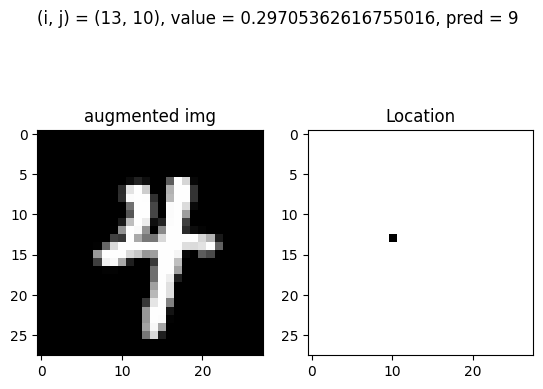

Test: At (i, j) = (13, 10) and value = 0.6576868981932272, pred = 9, before_pred = 4, gt = 4


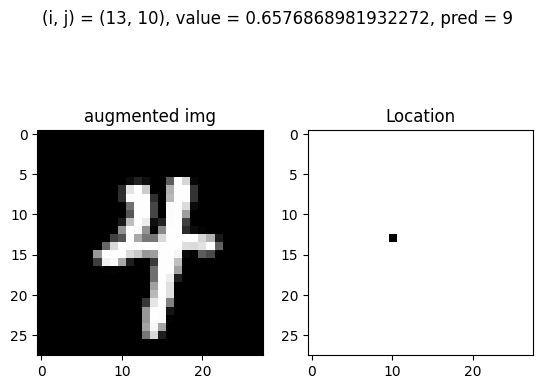

Test: At (i, j) = (13, 10) and value = 1.0183201702189044, pred = 9, before_pred = 4, gt = 4


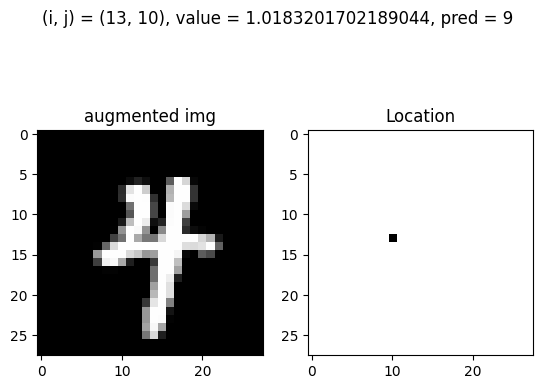

Test: At (i, j) = (13, 10) and value = 1.3789534422445815, pred = 9, before_pred = 4, gt = 4


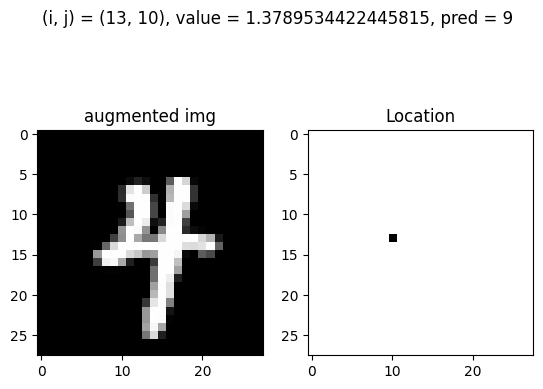

Test: At (i, j) = (13, 10) and value = 1.7395867142702586, pred = 9, before_pred = 4, gt = 4


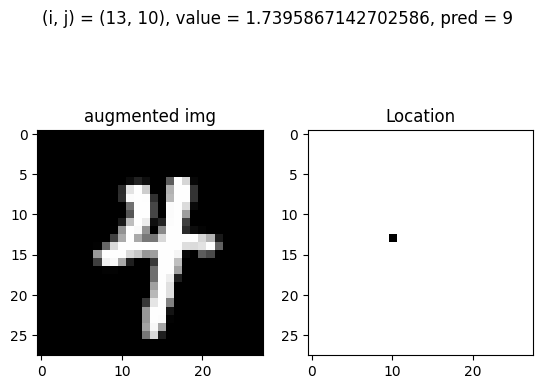

Test: At (i, j) = (13, 11) and value = -0.424212917883804, pred = 9, before_pred = 4, gt = 4


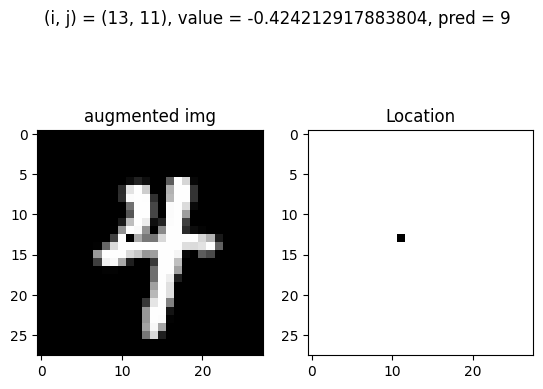

Test: At (i, j) = (13, 11) and value = -0.06357964585812692, pred = 9, before_pred = 4, gt = 4


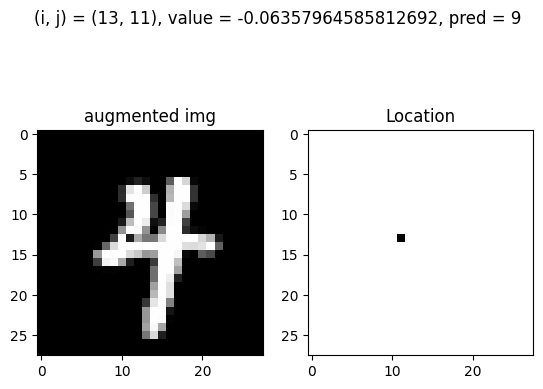

Test: At (i, j) = (13, 11) and value = 0.29705362616755016, pred = 9, before_pred = 4, gt = 4


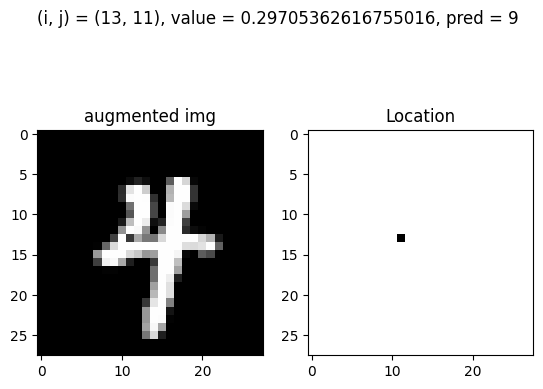

Test: At (i, j) = (13, 11) and value = 0.6576868981932272, pred = 9, before_pred = 4, gt = 4


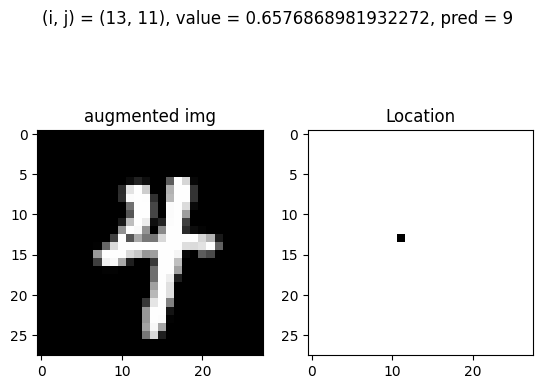

Test: At (i, j) = (13, 11) and value = 1.0183201702189044, pred = 9, before_pred = 4, gt = 4


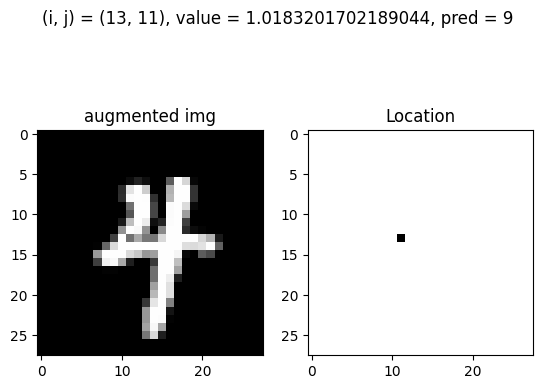

Test: At (i, j) = (13, 11) and value = 1.3789534422445815, pred = 9, before_pred = 4, gt = 4


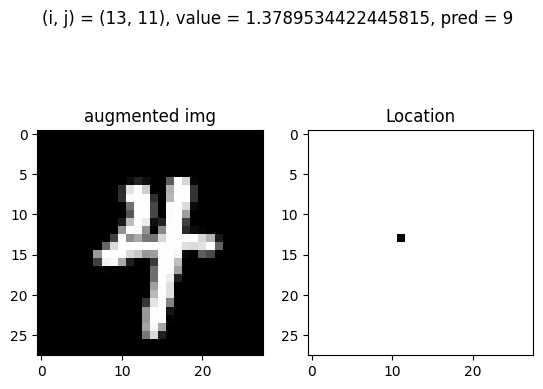

Test: At (i, j) = (13, 11) and value = 1.7395867142702586, pred = 9, before_pred = 4, gt = 4


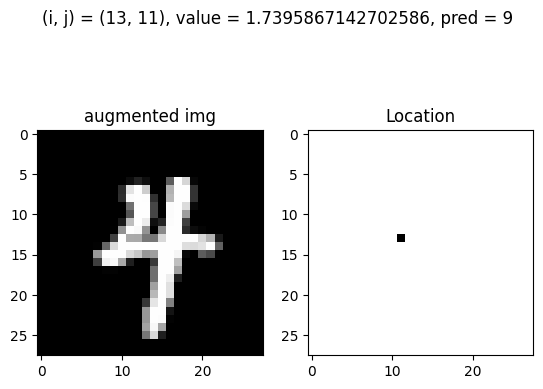

Test: At (i, j) = (13, 12) and value = -0.424212917883804, pred = 9, before_pred = 4, gt = 4


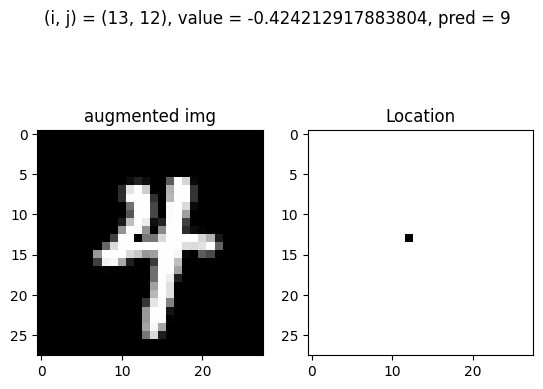

Test: At (i, j) = (13, 12) and value = -0.06357964585812692, pred = 9, before_pred = 4, gt = 4


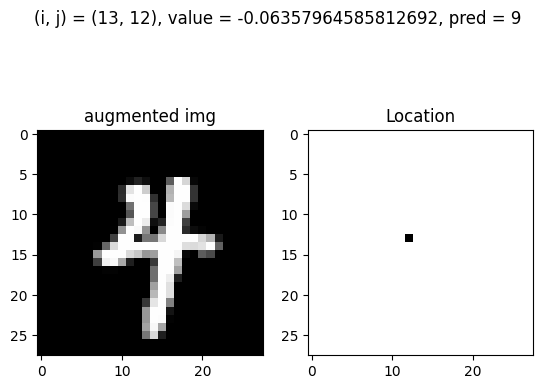

Test: At (i, j) = (13, 12) and value = 0.29705362616755016, pred = 9, before_pred = 4, gt = 4


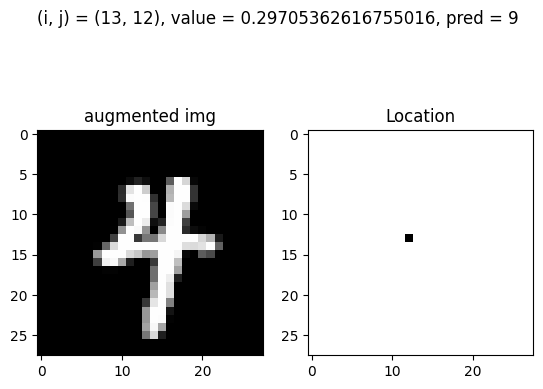

Test: At (i, j) = (13, 16) and value = -0.424212917883804, pred = 9, before_pred = 4, gt = 4


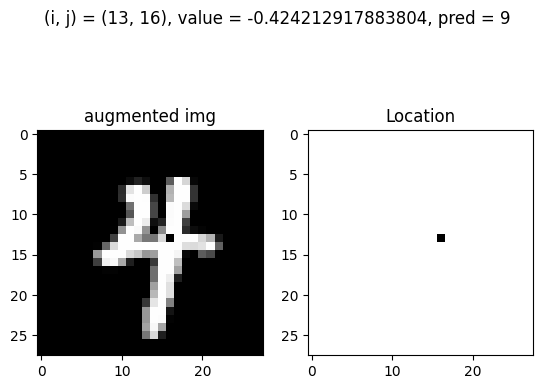

Test: At (i, j) = (13, 16) and value = -0.06357964585812692, pred = 9, before_pred = 4, gt = 4


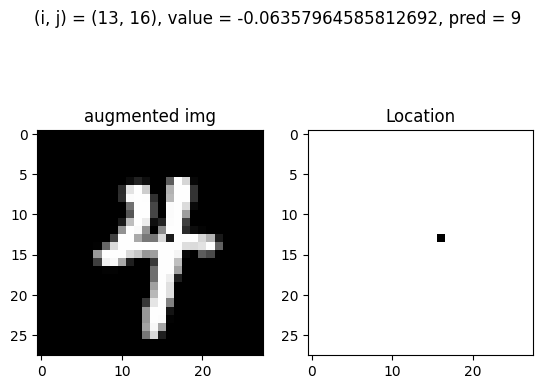

Test: At (i, j) = (13, 16) and value = 0.29705362616755016, pred = 9, before_pred = 4, gt = 4


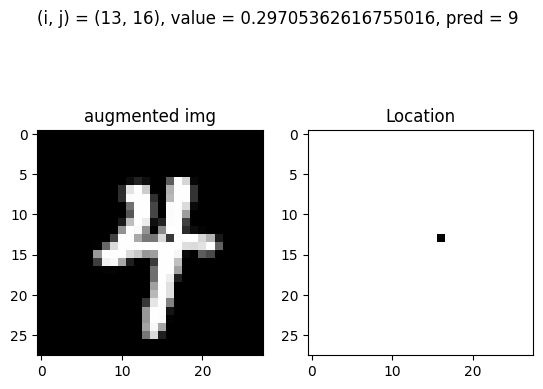

Test: At (i, j) = (13, 21) and value = -0.424212917883804, pred = 9, before_pred = 4, gt = 4


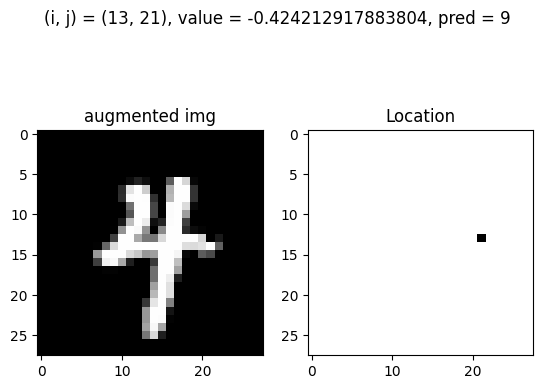

Test: At (i, j) = (13, 23) and value = 2.82148653034729, pred = 9, before_pred = 4, gt = 4


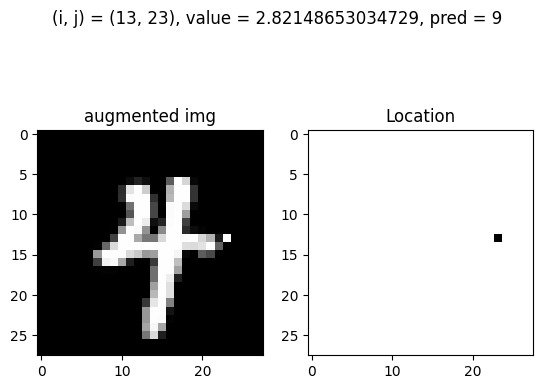

Test: At (i, j) = (14, 9) and value = -0.424212917883804, pred = 9, before_pred = 4, gt = 4


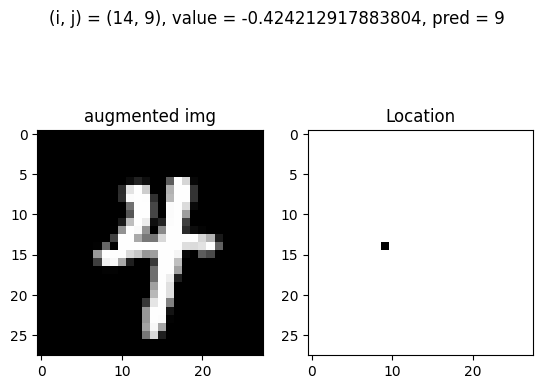

Test: At (i, j) = (14, 9) and value = -0.06357964585812692, pred = 9, before_pred = 4, gt = 4


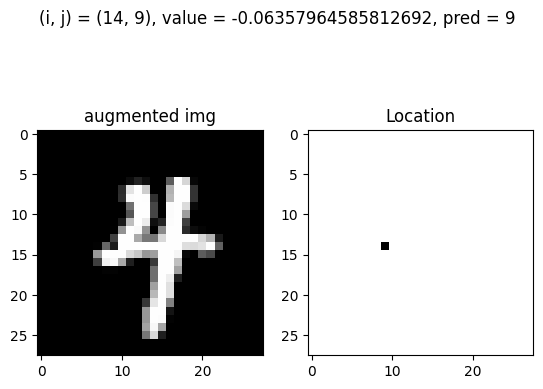

Test: At (i, j) = (14, 9) and value = 0.29705362616755016, pred = 9, before_pred = 4, gt = 4


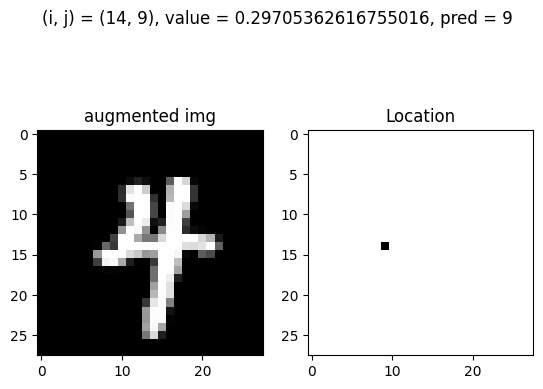

Test: At (i, j) = (14, 9) and value = 0.6576868981932272, pred = 9, before_pred = 4, gt = 4


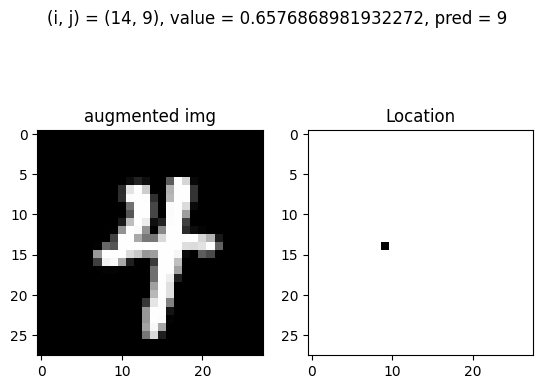

Test: At (i, j) = (14, 10) and value = -0.424212917883804, pred = 9, before_pred = 4, gt = 4


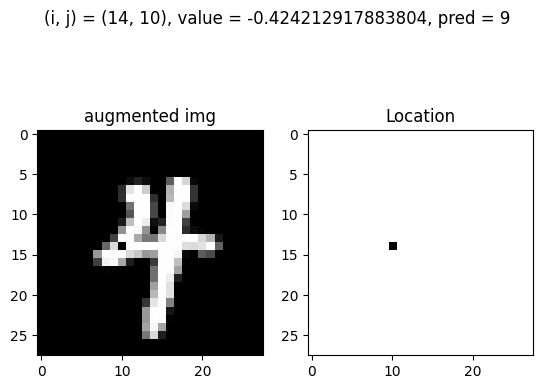

Test: At (i, j) = (14, 10) and value = -0.06357964585812692, pred = 9, before_pred = 4, gt = 4


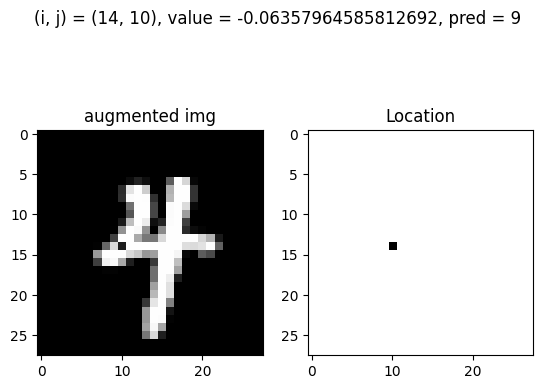

Test: At (i, j) = (14, 10) and value = 0.29705362616755016, pred = 9, before_pred = 4, gt = 4


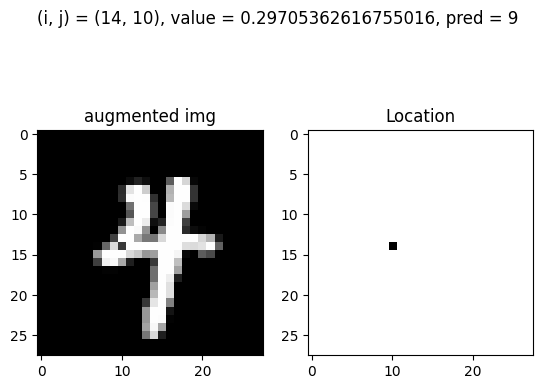

Test: At (i, j) = (14, 10) and value = 0.6576868981932272, pred = 9, before_pred = 4, gt = 4


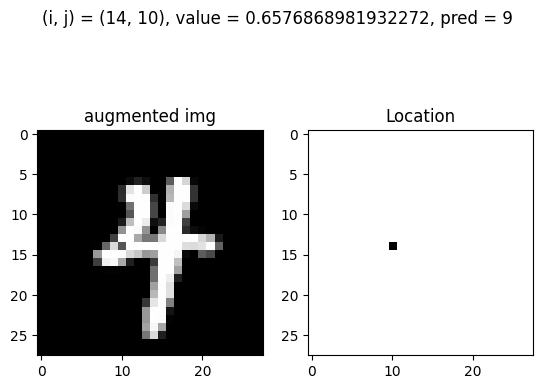

Test: At (i, j) = (14, 10) and value = 1.0183201702189044, pred = 9, before_pred = 4, gt = 4


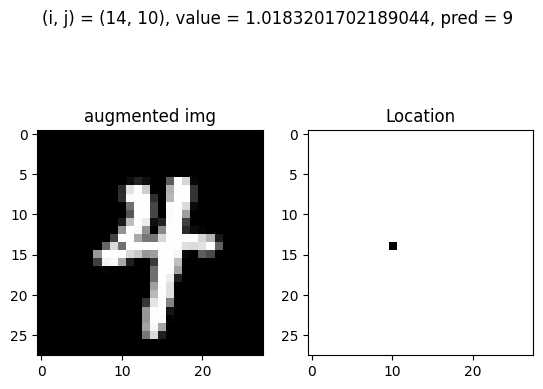

Test: At (i, j) = (14, 10) and value = 1.3789534422445815, pred = 9, before_pred = 4, gt = 4


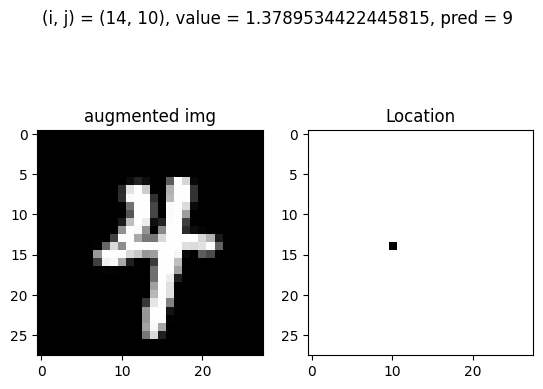

Test: At (i, j) = (14, 10) and value = 1.7395867142702586, pred = 9, before_pred = 4, gt = 4


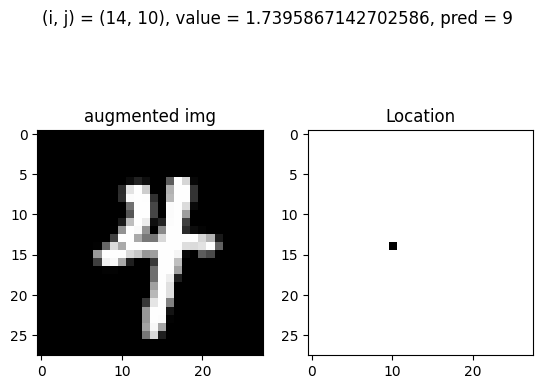

Test: At (i, j) = (14, 11) and value = -0.424212917883804, pred = 9, before_pred = 4, gt = 4


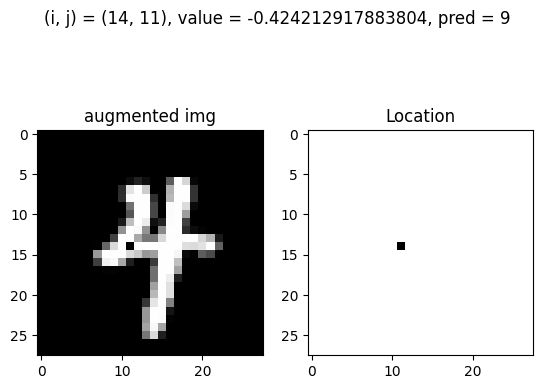

Test: At (i, j) = (14, 11) and value = -0.06357964585812692, pred = 9, before_pred = 4, gt = 4


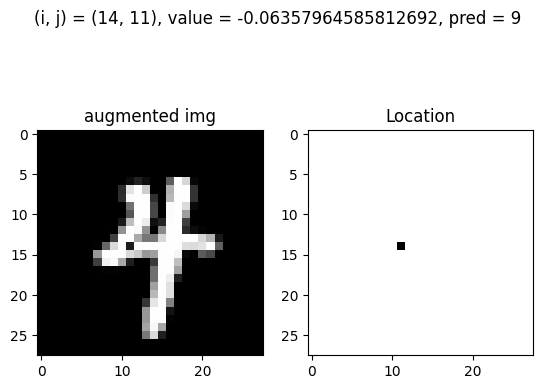

Test: At (i, j) = (14, 11) and value = 0.29705362616755016, pred = 9, before_pred = 4, gt = 4


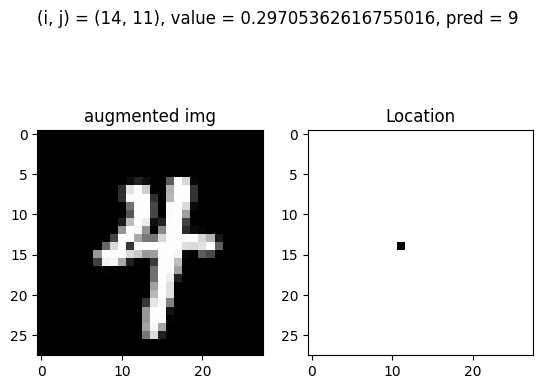

Test: At (i, j) = (14, 11) and value = 0.6576868981932272, pred = 9, before_pred = 4, gt = 4


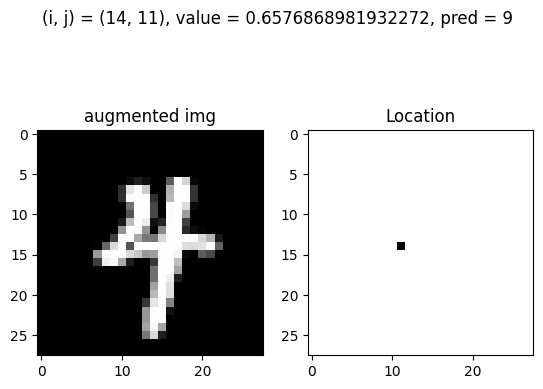

Test: At (i, j) = (14, 11) and value = 1.0183201702189044, pred = 9, before_pred = 4, gt = 4


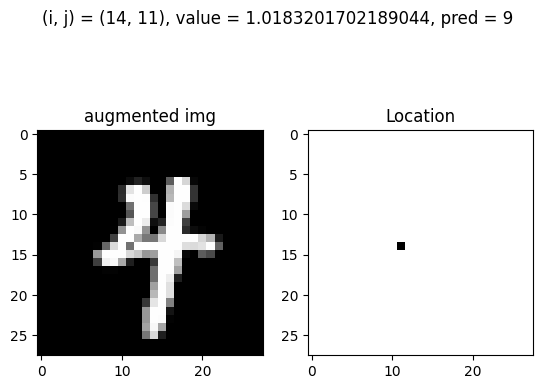

Test: At (i, j) = (14, 11) and value = 1.3789534422445815, pred = 9, before_pred = 4, gt = 4


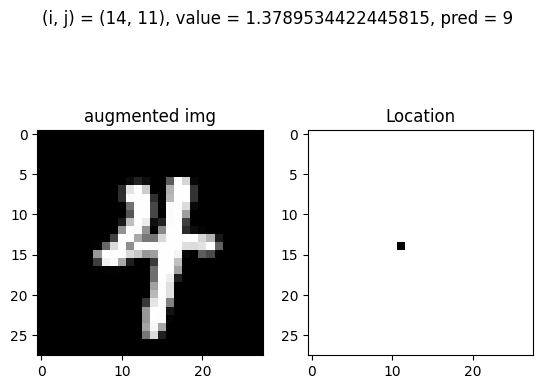

Test: At (i, j) = (14, 11) and value = 1.7395867142702586, pred = 9, before_pred = 4, gt = 4


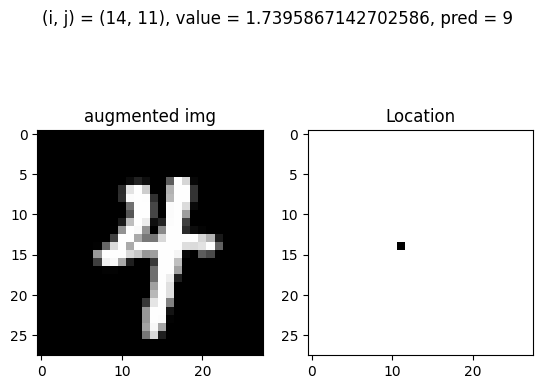

Test: At (i, j) = (14, 12) and value = -0.424212917883804, pred = 9, before_pred = 4, gt = 4


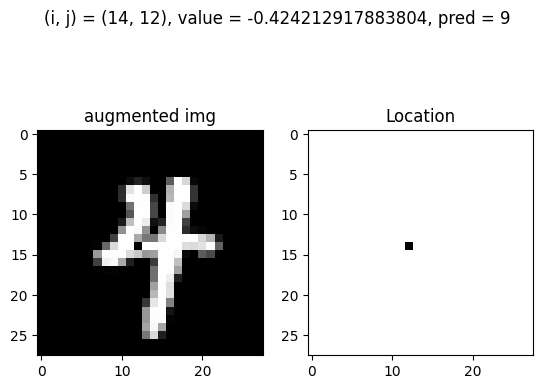

Test: At (i, j) = (14, 12) and value = -0.06357964585812692, pred = 9, before_pred = 4, gt = 4


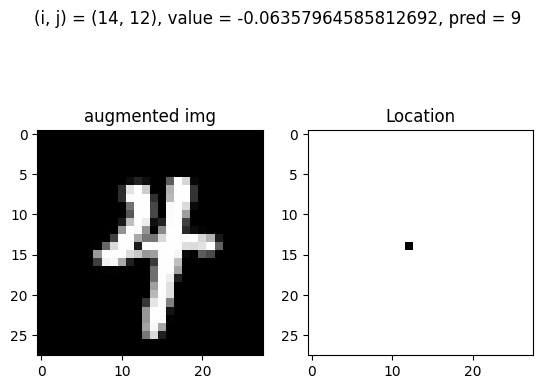

Test: At (i, j) = (14, 12) and value = 0.29705362616755016, pred = 9, before_pred = 4, gt = 4


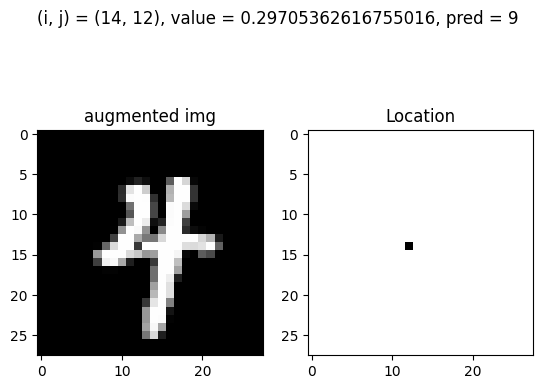

Test: At (i, j) = (14, 12) and value = 0.6576868981932272, pred = 9, before_pred = 4, gt = 4


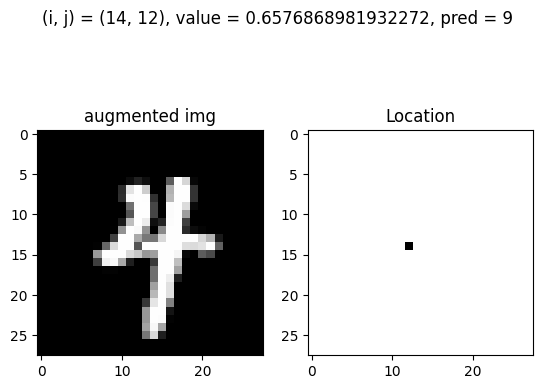

Test: At (i, j) = (14, 12) and value = 1.0183201702189044, pred = 9, before_pred = 4, gt = 4


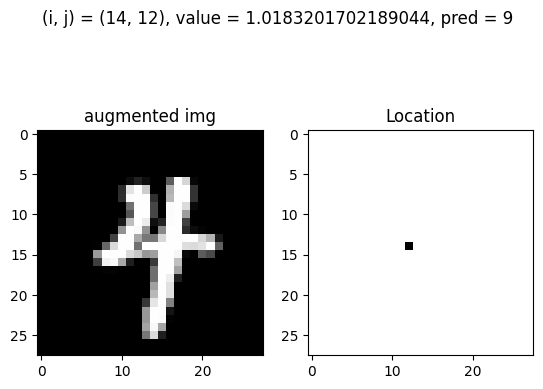

Test: At (i, j) = (14, 12) and value = 1.3789534422445815, pred = 9, before_pred = 4, gt = 4


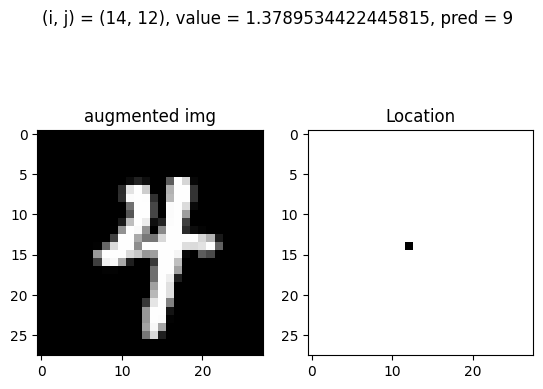

Test: At (i, j) = (14, 14) and value = -0.424212917883804, pred = 9, before_pred = 4, gt = 4


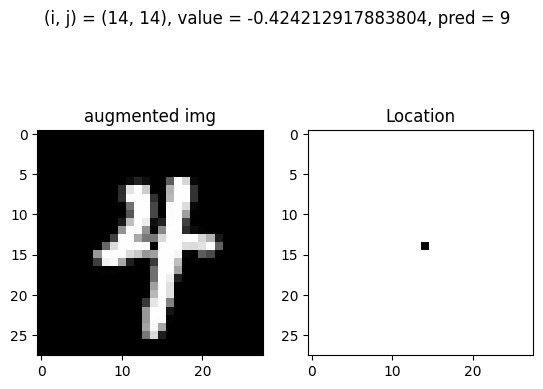

Test: At (i, j) = (14, 14) and value = -0.06357964585812692, pred = 9, before_pred = 4, gt = 4


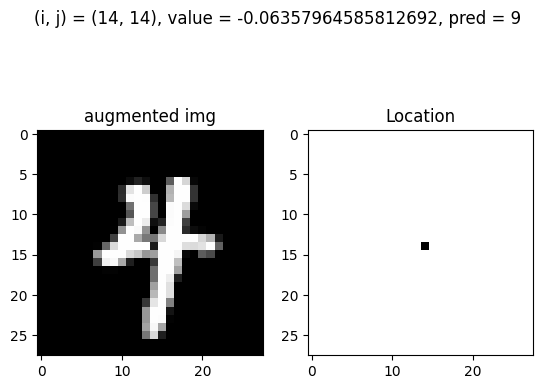

Test: At (i, j) = (14, 14) and value = 0.29705362616755016, pred = 9, before_pred = 4, gt = 4


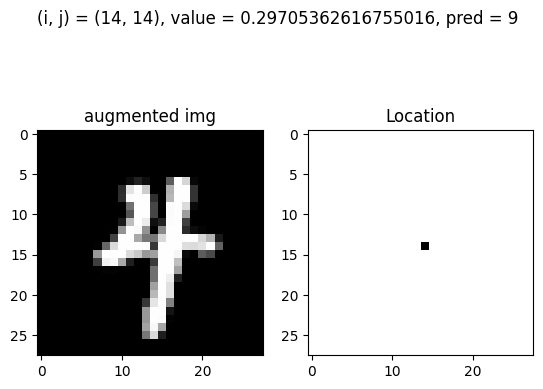

Test: At (i, j) = (14, 14) and value = 0.6576868981932272, pred = 9, before_pred = 4, gt = 4


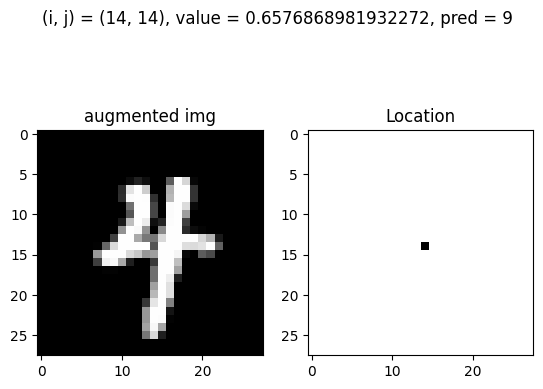

Test: At (i, j) = (14, 14) and value = 1.0183201702189044, pred = 9, before_pred = 4, gt = 4


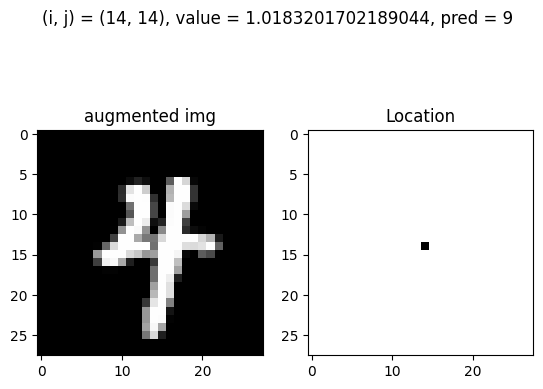

Test: At (i, j) = (14, 14) and value = 1.3789534422445815, pred = 9, before_pred = 4, gt = 4


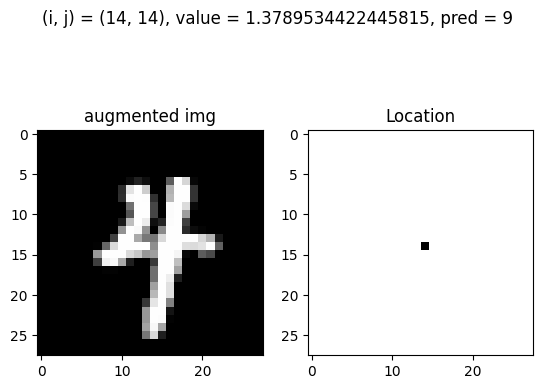

Test: At (i, j) = (14, 15) and value = -0.424212917883804, pred = 9, before_pred = 4, gt = 4


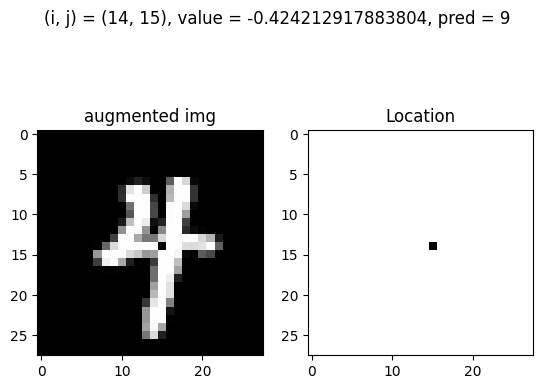

Test: At (i, j) = (14, 15) and value = -0.06357964585812692, pred = 9, before_pred = 4, gt = 4


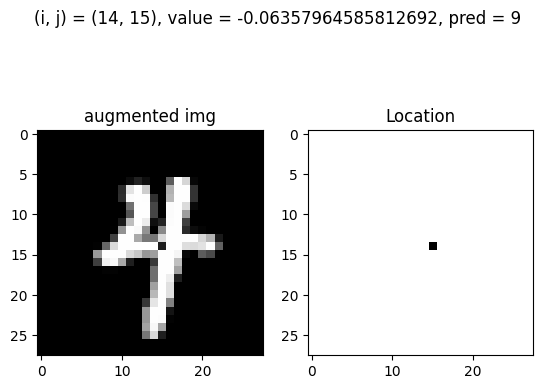

Test: At (i, j) = (14, 16) and value = -0.424212917883804, pred = 9, before_pred = 4, gt = 4


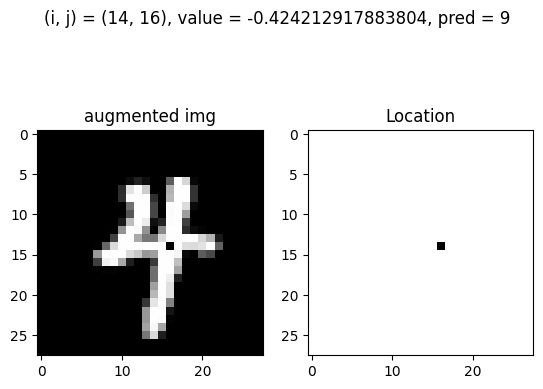

Test: At (i, j) = (14, 16) and value = -0.06357964585812692, pred = 9, before_pred = 4, gt = 4


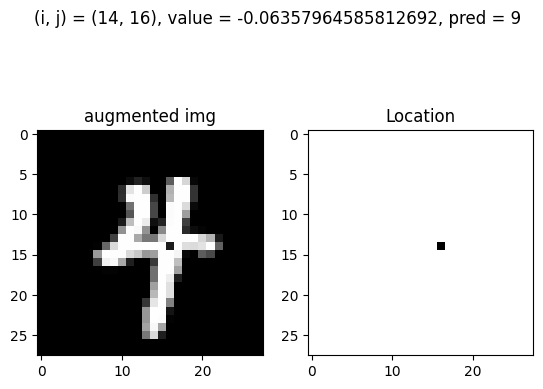

Test: At (i, j) = (14, 16) and value = 0.29705362616755016, pred = 9, before_pred = 4, gt = 4


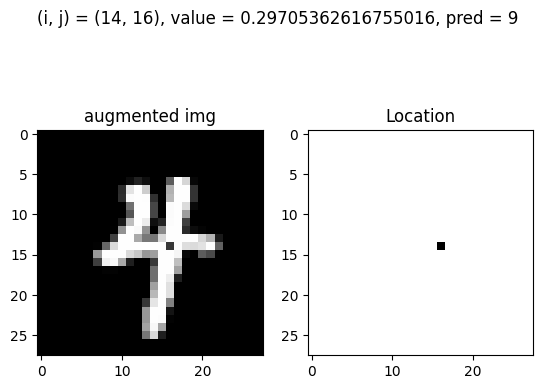

Test: At (i, j) = (14, 16) and value = 0.6576868981932272, pred = 9, before_pred = 4, gt = 4


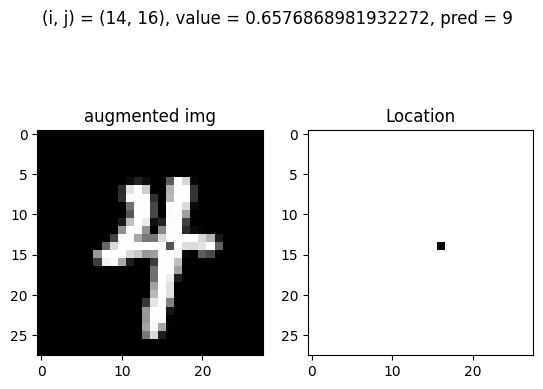

Test: At (i, j) = (14, 16) and value = 1.0183201702189044, pred = 9, before_pred = 4, gt = 4


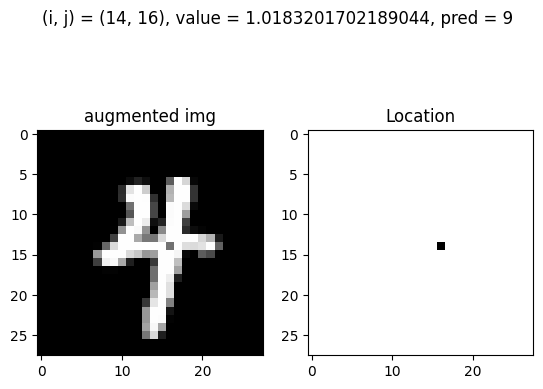

Test: At (i, j) = (14, 17) and value = -0.424212917883804, pred = 9, before_pred = 4, gt = 4


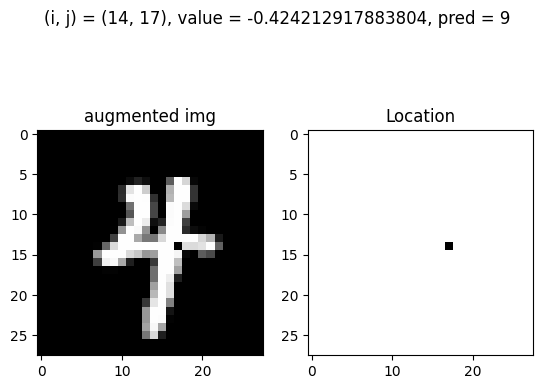

Test: At (i, j) = (14, 17) and value = -0.06357964585812692, pred = 9, before_pred = 4, gt = 4


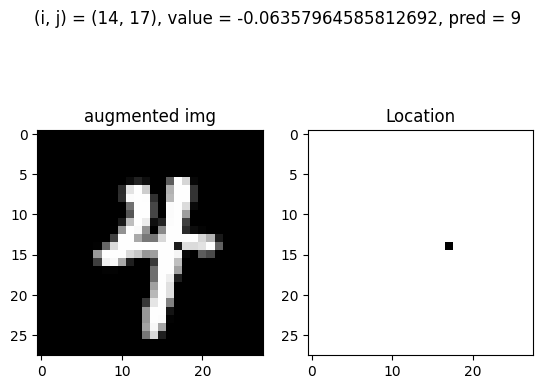

Test: At (i, j) = (14, 17) and value = 0.29705362616755016, pred = 9, before_pred = 4, gt = 4


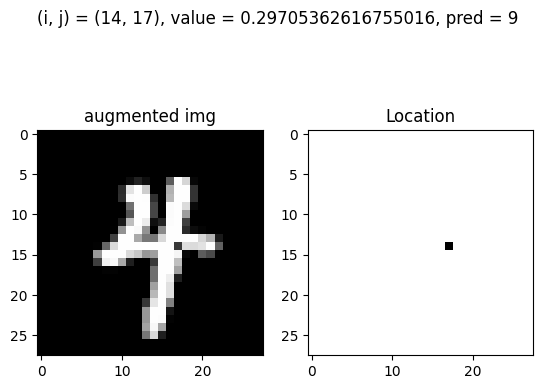

Test: At (i, j) = (14, 17) and value = 0.6576868981932272, pred = 9, before_pred = 4, gt = 4


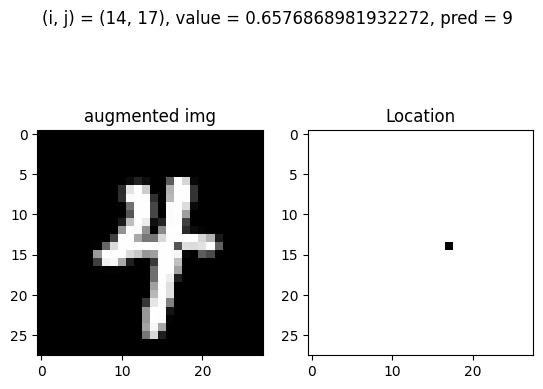

Test: At (i, j) = (14, 17) and value = 1.0183201702189044, pred = 9, before_pred = 4, gt = 4


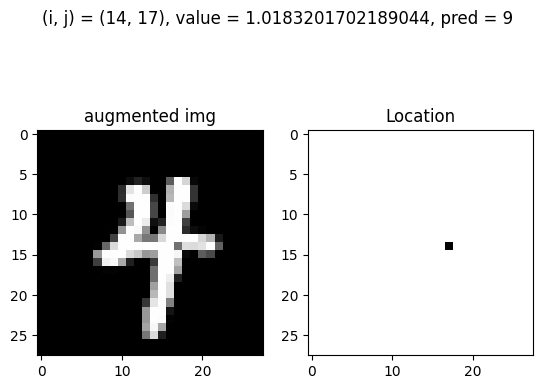

Test: At (i, j) = (14, 20) and value = -0.424212917883804, pred = 9, before_pred = 4, gt = 4


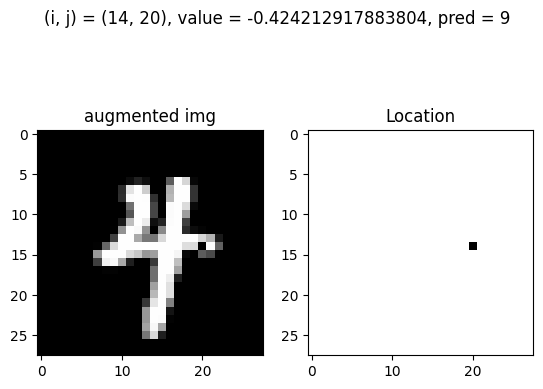

Test: At (i, j) = (14, 20) and value = -0.06357964585812692, pred = 9, before_pred = 4, gt = 4


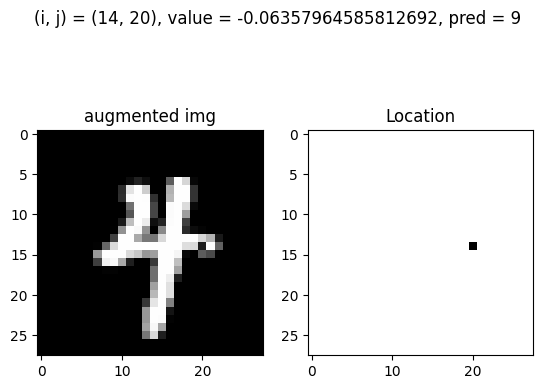

Test: At (i, j) = (14, 20) and value = 0.29705362616755016, pred = 9, before_pred = 4, gt = 4


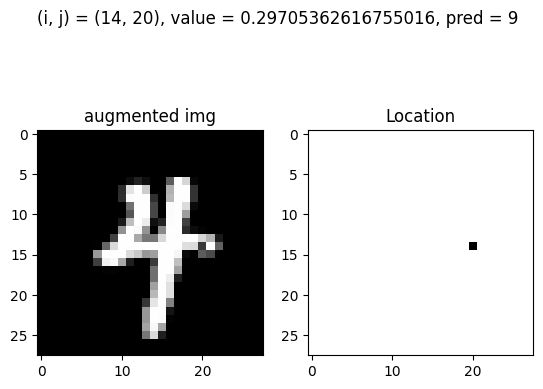

Test: At (i, j) = (14, 27) and value = 1.7395867142702586, pred = 9, before_pred = 4, gt = 4


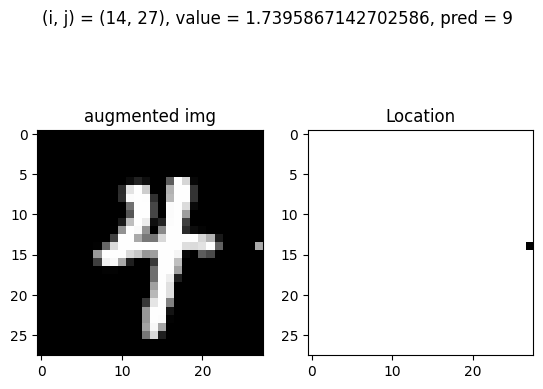

Test: At (i, j) = (14, 27) and value = 2.1002199862959356, pred = 9, before_pred = 4, gt = 4


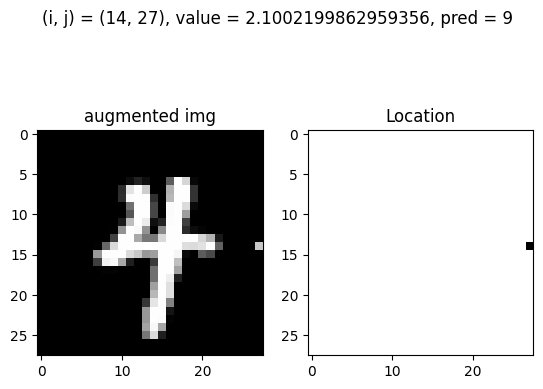

Test: At (i, j) = (14, 27) and value = 2.4608532583216127, pred = 9, before_pred = 4, gt = 4


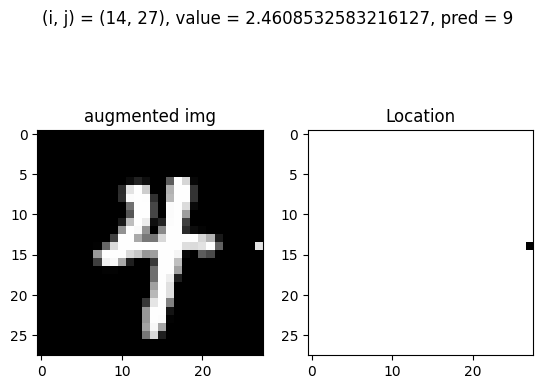

Test: At (i, j) = (14, 27) and value = 2.82148653034729, pred = 9, before_pred = 4, gt = 4


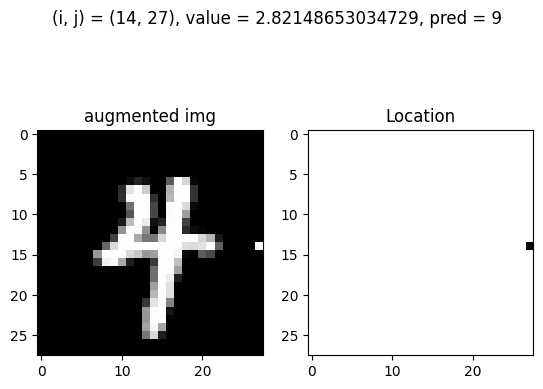

Test: At (i, j) = (15, 7) and value = -0.424212917883804, pred = 9, before_pred = 4, gt = 4


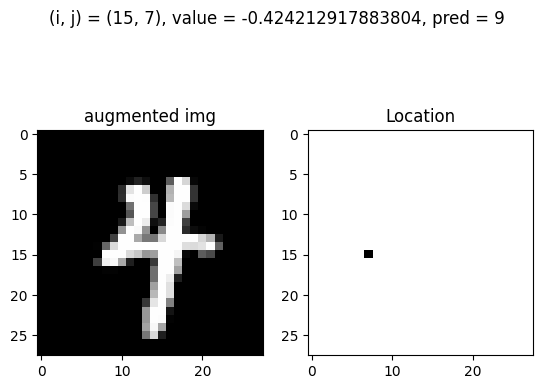

Test: At (i, j) = (15, 7) and value = -0.06357964585812692, pred = 9, before_pred = 4, gt = 4


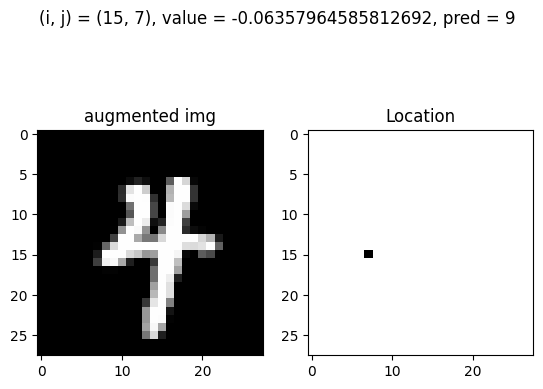

Test: At (i, j) = (15, 8) and value = -0.424212917883804, pred = 9, before_pred = 4, gt = 4


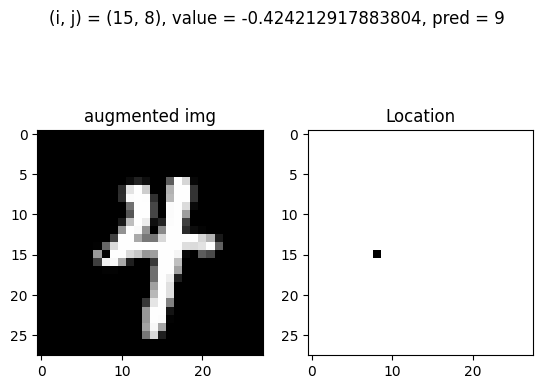

Test: At (i, j) = (15, 8) and value = -0.06357964585812692, pred = 9, before_pred = 4, gt = 4


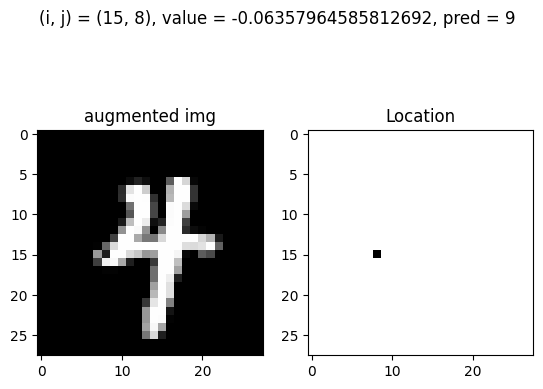

Test: At (i, j) = (15, 8) and value = 0.29705362616755016, pred = 9, before_pred = 4, gt = 4


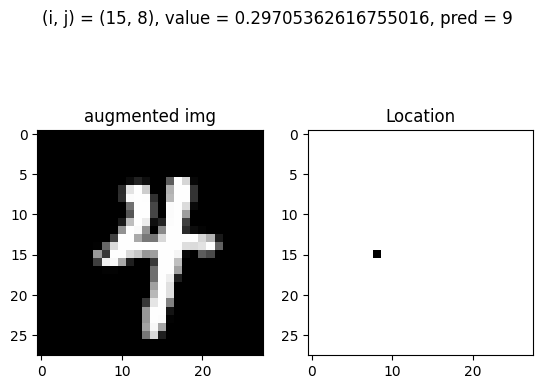

Test: At (i, j) = (15, 8) and value = 0.6576868981932272, pred = 9, before_pred = 4, gt = 4


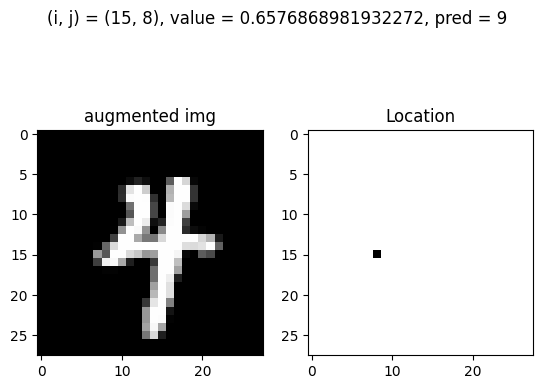

Test: At (i, j) = (15, 8) and value = 1.0183201702189044, pred = 9, before_pred = 4, gt = 4


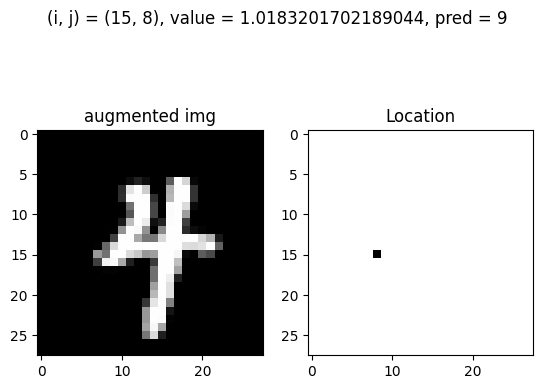

Test: At (i, j) = (15, 8) and value = 1.3789534422445815, pred = 9, before_pred = 4, gt = 4


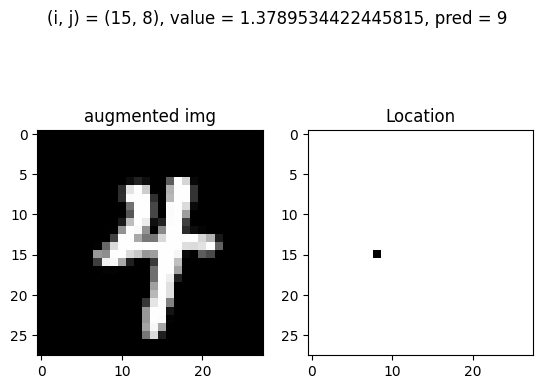

Test: At (i, j) = (15, 9) and value = -0.424212917883804, pred = 9, before_pred = 4, gt = 4


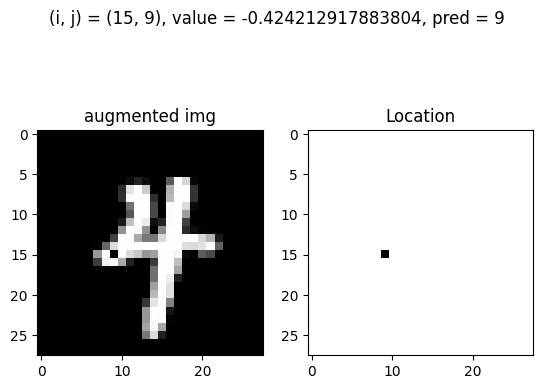

Test: At (i, j) = (15, 9) and value = -0.06357964585812692, pred = 9, before_pred = 4, gt = 4


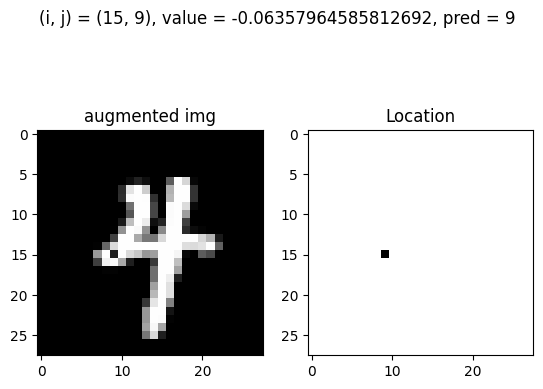

Test: At (i, j) = (15, 9) and value = 0.29705362616755016, pred = 9, before_pred = 4, gt = 4


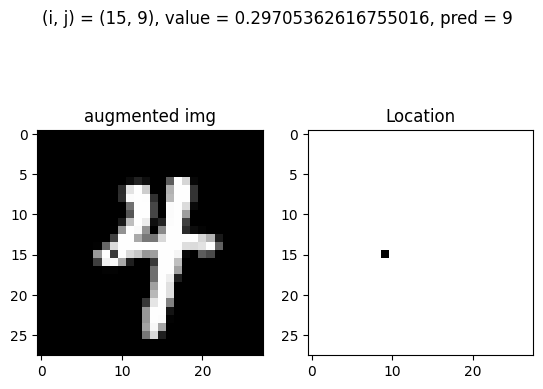

Test: At (i, j) = (15, 9) and value = 0.6576868981932272, pred = 9, before_pred = 4, gt = 4


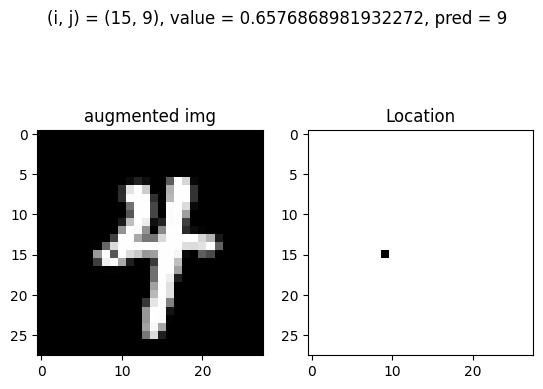

Test: At (i, j) = (15, 9) and value = 1.0183201702189044, pred = 9, before_pred = 4, gt = 4


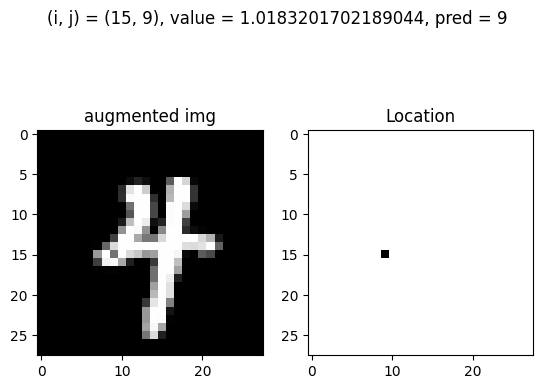

Test: At (i, j) = (15, 9) and value = 1.3789534422445815, pred = 9, before_pred = 4, gt = 4


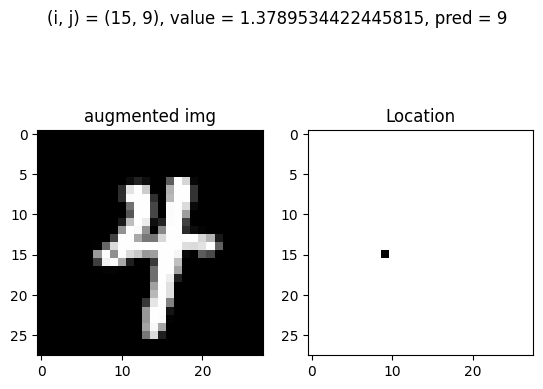

Test: At (i, j) = (15, 10) and value = -0.424212917883804, pred = 9, before_pred = 4, gt = 4


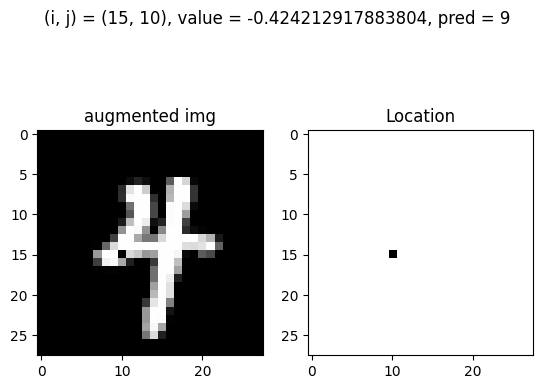

Test: At (i, j) = (15, 10) and value = -0.06357964585812692, pred = 9, before_pred = 4, gt = 4


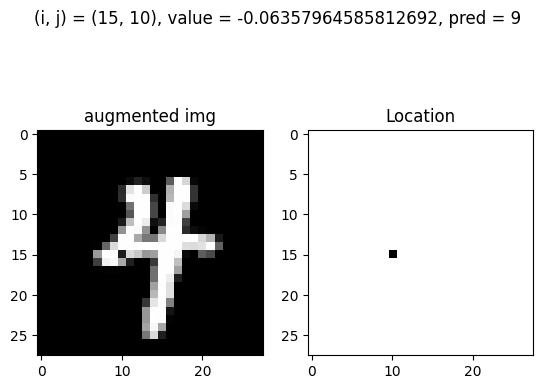

Test: At (i, j) = (15, 10) and value = 0.29705362616755016, pred = 9, before_pred = 4, gt = 4


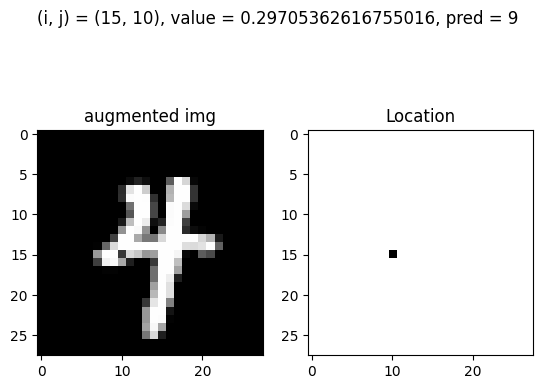

Test: At (i, j) = (15, 11) and value = -0.424212917883804, pred = 9, before_pred = 4, gt = 4


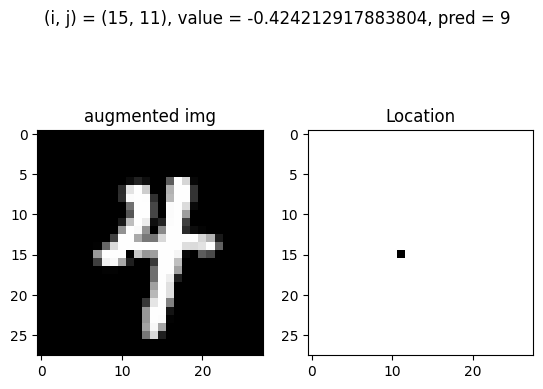

Test: At (i, j) = (15, 11) and value = -0.06357964585812692, pred = 9, before_pred = 4, gt = 4


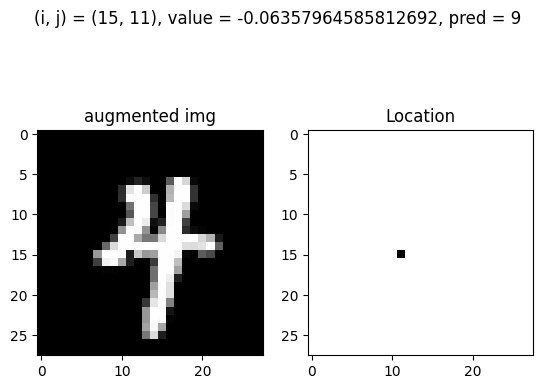

Test: At (i, j) = (15, 11) and value = 0.29705362616755016, pred = 9, before_pred = 4, gt = 4


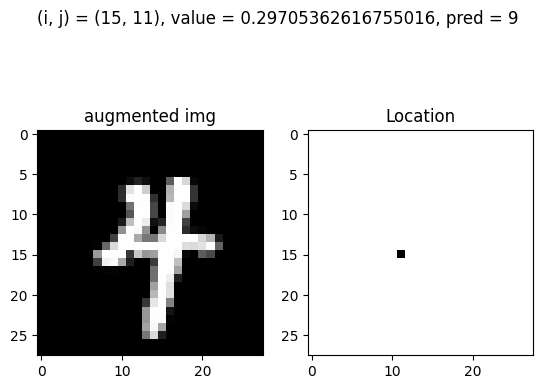

Test: At (i, j) = (15, 11) and value = 0.6576868981932272, pred = 9, before_pred = 4, gt = 4


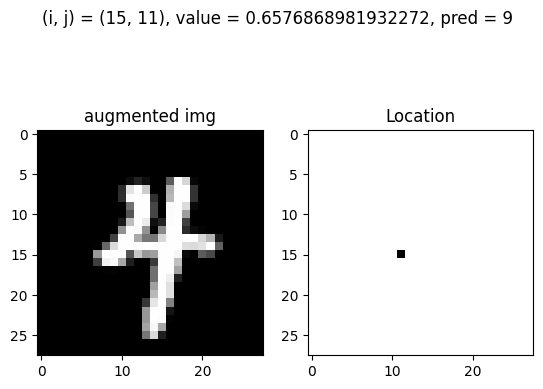

Test: At (i, j) = (15, 11) and value = 1.0183201702189044, pred = 9, before_pred = 4, gt = 4


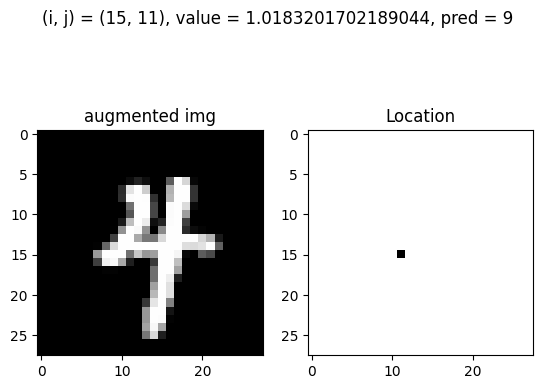

Test: At (i, j) = (15, 11) and value = 1.3789534422445815, pred = 9, before_pred = 4, gt = 4


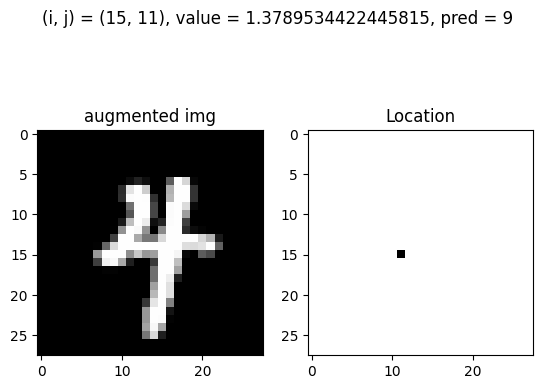

Test: At (i, j) = (15, 12) and value = -0.424212917883804, pred = 9, before_pred = 4, gt = 4


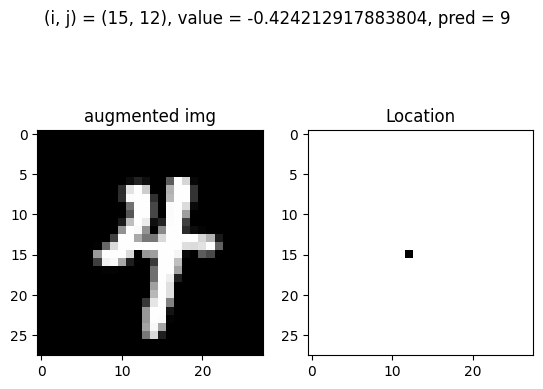

Test: At (i, j) = (15, 12) and value = -0.06357964585812692, pred = 9, before_pred = 4, gt = 4


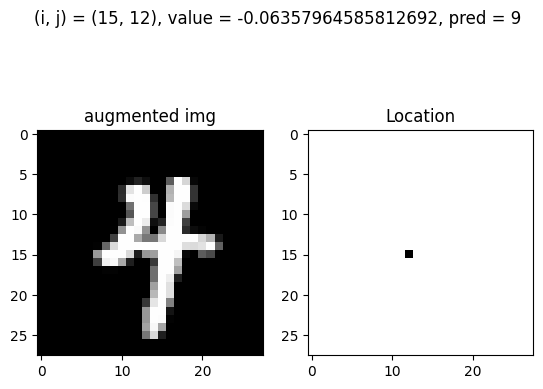

Test: At (i, j) = (15, 12) and value = 0.29705362616755016, pred = 9, before_pred = 4, gt = 4


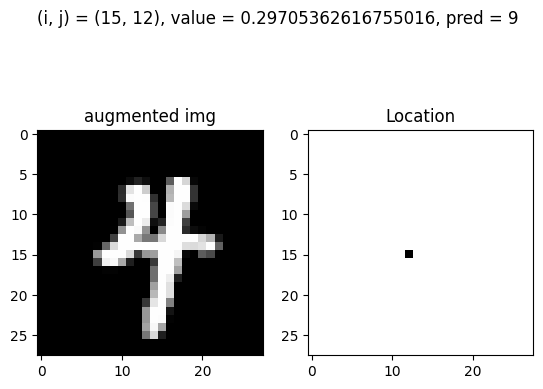

Test: At (i, j) = (15, 12) and value = 0.6576868981932272, pred = 9, before_pred = 4, gt = 4


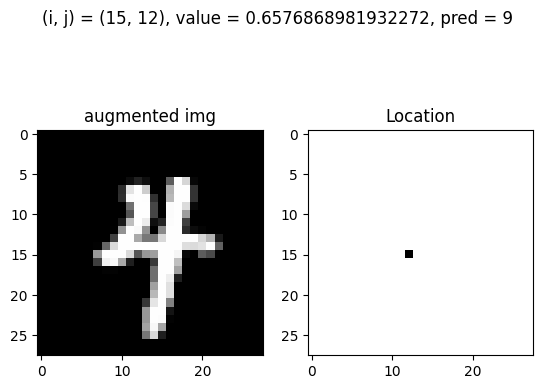

Test: At (i, j) = (15, 12) and value = 1.0183201702189044, pred = 9, before_pred = 4, gt = 4


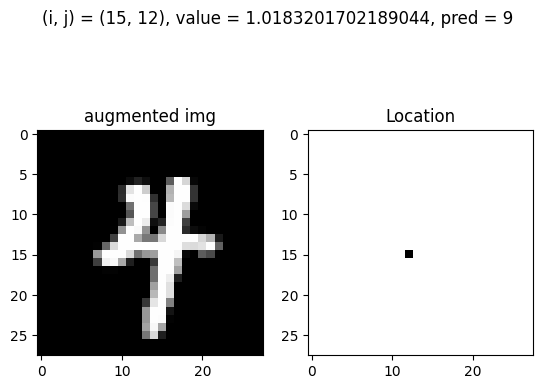

Test: At (i, j) = (15, 13) and value = -0.424212917883804, pred = 9, before_pred = 4, gt = 4


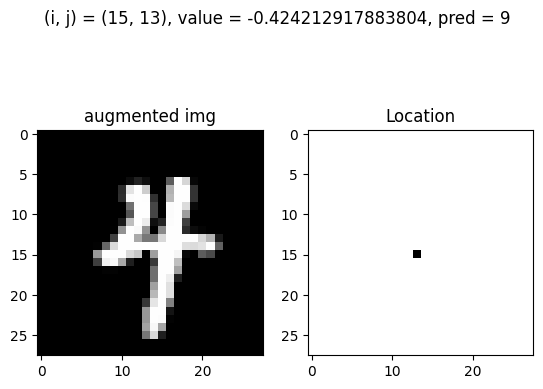

Test: At (i, j) = (15, 13) and value = -0.06357964585812692, pred = 9, before_pred = 4, gt = 4


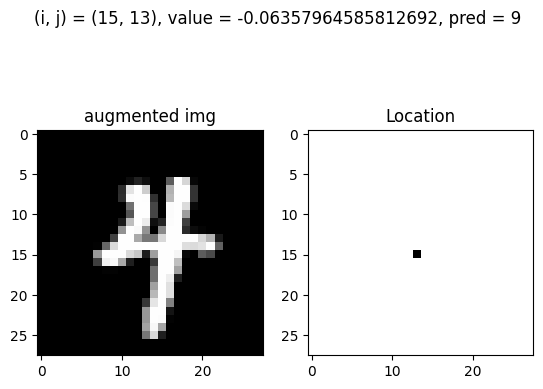

Test: At (i, j) = (15, 13) and value = 0.29705362616755016, pred = 9, before_pred = 4, gt = 4


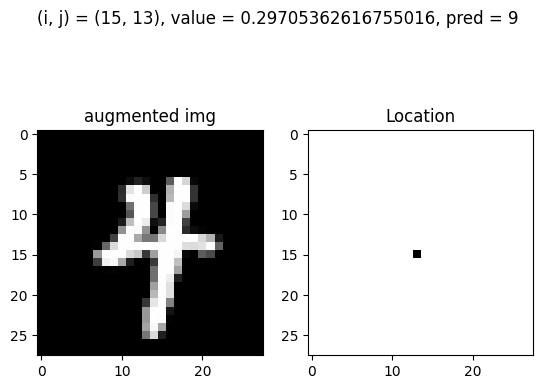

Test: At (i, j) = (15, 13) and value = 0.6576868981932272, pred = 9, before_pred = 4, gt = 4


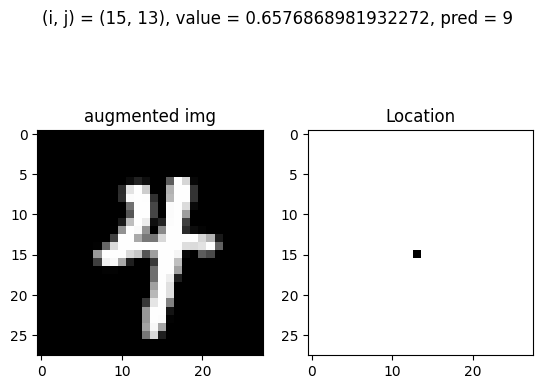

Test: At (i, j) = (15, 14) and value = -0.424212917883804, pred = 9, before_pred = 4, gt = 4


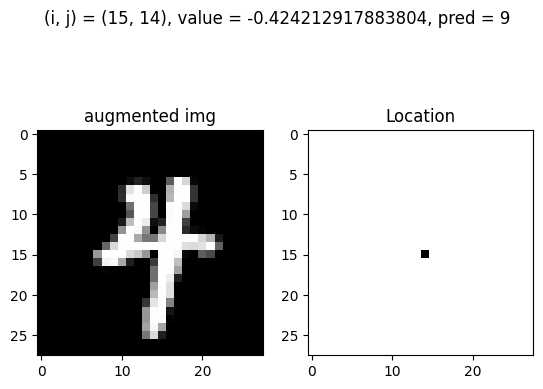

Test: At (i, j) = (15, 14) and value = -0.06357964585812692, pred = 9, before_pred = 4, gt = 4


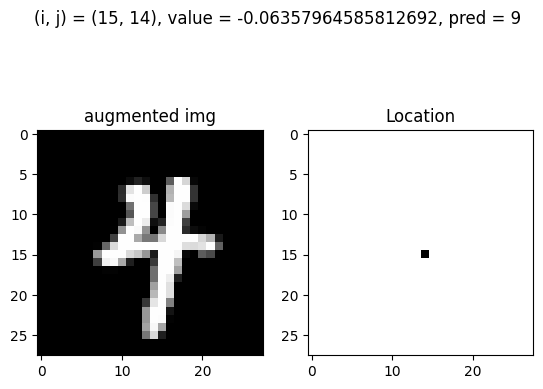

Test: At (i, j) = (15, 14) and value = 0.29705362616755016, pred = 9, before_pred = 4, gt = 4


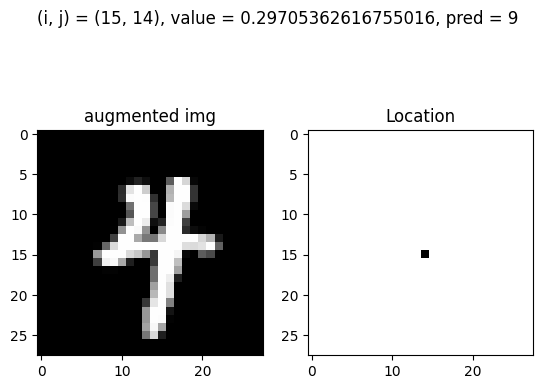

Test: At (i, j) = (15, 15) and value = -0.424212917883804, pred = 9, before_pred = 4, gt = 4


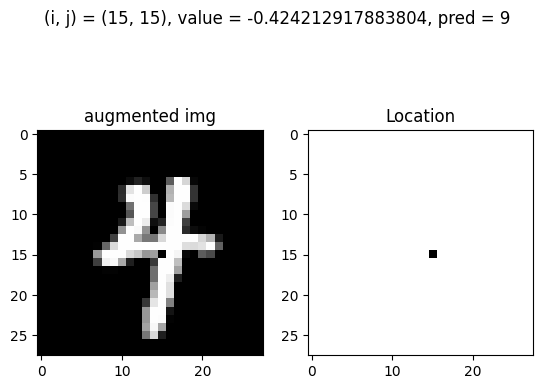

Test: At (i, j) = (15, 15) and value = -0.06357964585812692, pred = 9, before_pred = 4, gt = 4


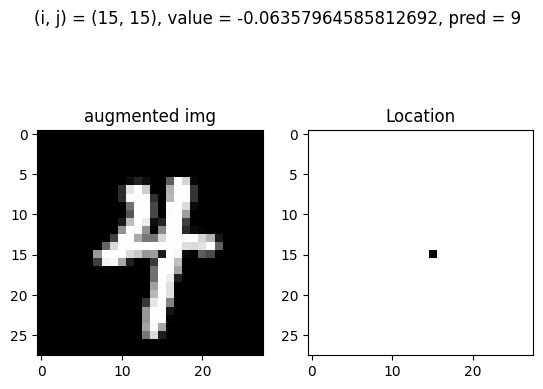

Test: At (i, j) = (15, 15) and value = 0.29705362616755016, pred = 9, before_pred = 4, gt = 4


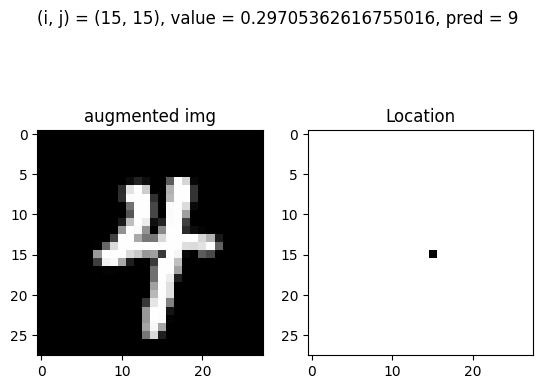

Test: At (i, j) = (15, 15) and value = 0.6576868981932272, pred = 9, before_pred = 4, gt = 4


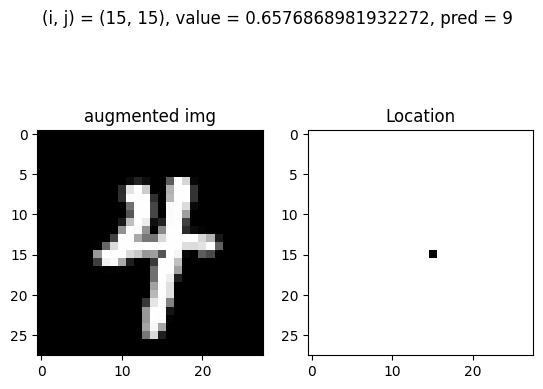

Test: At (i, j) = (15, 15) and value = 1.0183201702189044, pred = 9, before_pred = 4, gt = 4


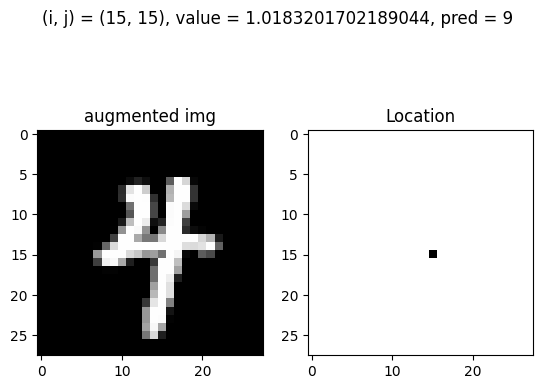

Test: At (i, j) = (15, 15) and value = 1.3789534422445815, pred = 9, before_pred = 4, gt = 4


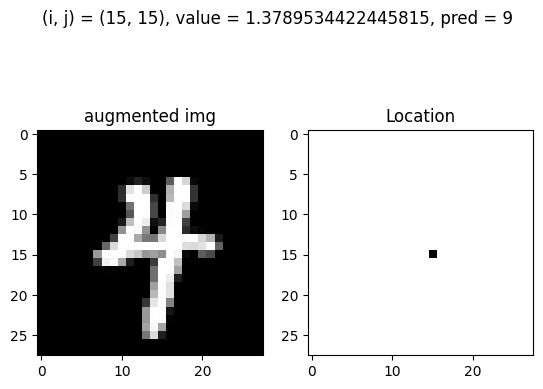

Test: At (i, j) = (15, 16) and value = -0.424212917883804, pred = 9, before_pred = 4, gt = 4


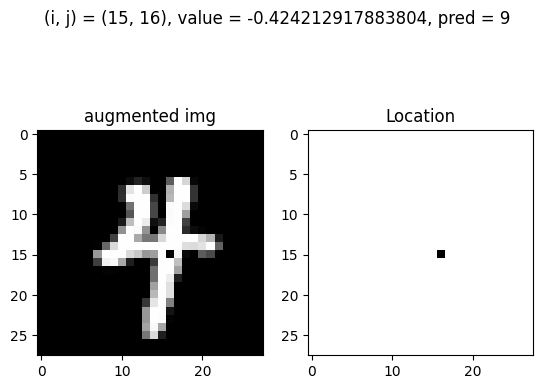

Test: At (i, j) = (15, 16) and value = -0.06357964585812692, pred = 9, before_pred = 4, gt = 4


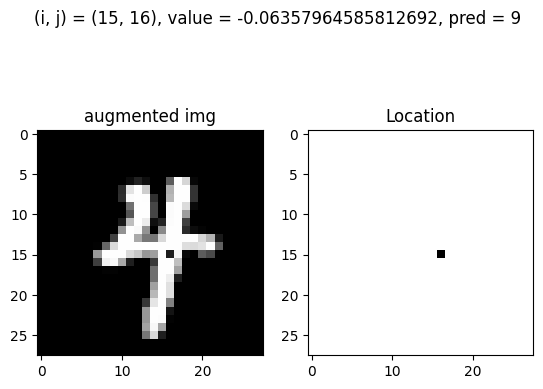

Test: At (i, j) = (15, 16) and value = 0.29705362616755016, pred = 9, before_pred = 4, gt = 4


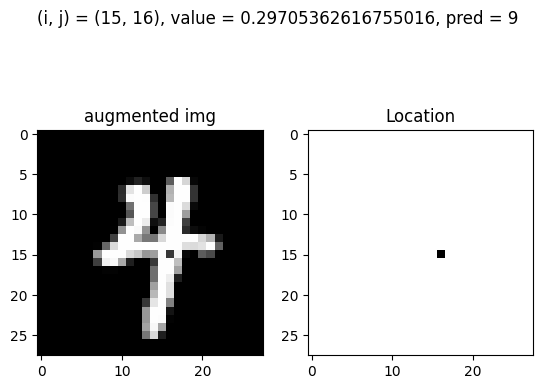

Test: At (i, j) = (15, 16) and value = 0.6576868981932272, pred = 9, before_pred = 4, gt = 4


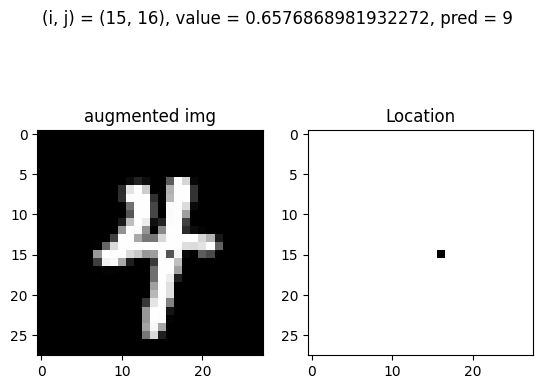

Test: At (i, j) = (15, 16) and value = 1.0183201702189044, pred = 9, before_pred = 4, gt = 4


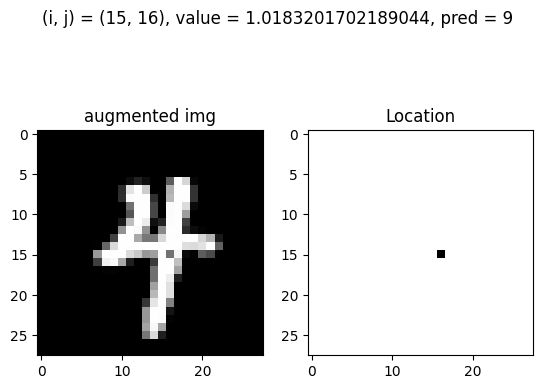

Test: At (i, j) = (15, 16) and value = 1.3789534422445815, pred = 9, before_pred = 4, gt = 4


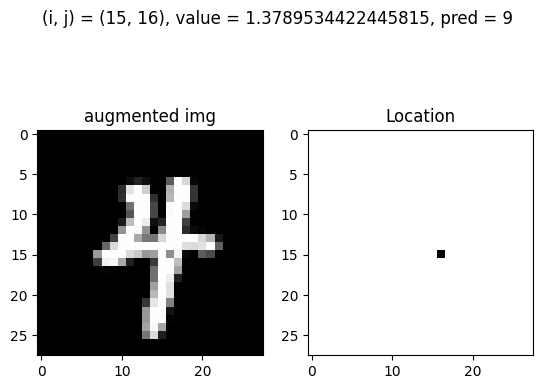

Test: At (i, j) = (15, 16) and value = 1.7395867142702586, pred = 9, before_pred = 4, gt = 4


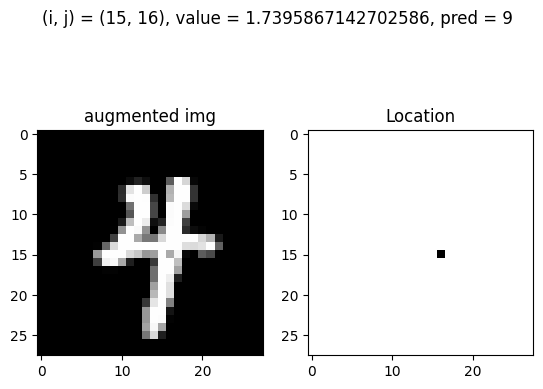

Test: At (i, j) = (15, 17) and value = -0.424212917883804, pred = 9, before_pred = 4, gt = 4


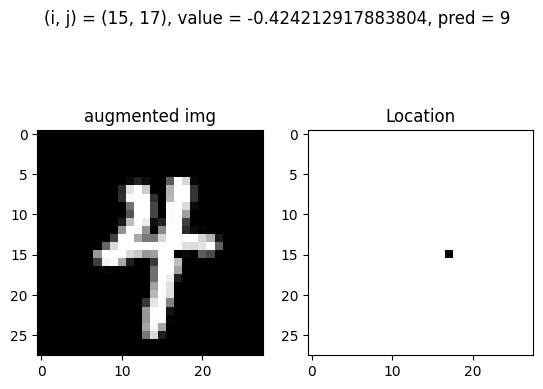

Test: At (i, j) = (15, 17) and value = -0.06357964585812692, pred = 9, before_pred = 4, gt = 4


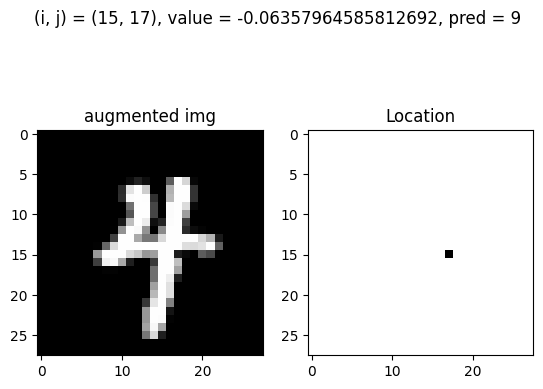

Test: At (i, j) = (15, 17) and value = 0.29705362616755016, pred = 9, before_pred = 4, gt = 4


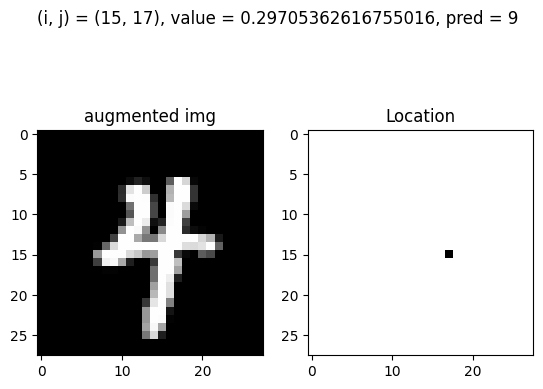

Test: At (i, j) = (15, 17) and value = 0.6576868981932272, pred = 9, before_pred = 4, gt = 4


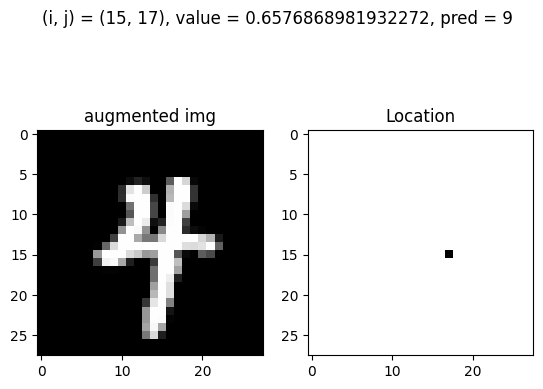

Test: At (i, j) = (15, 17) and value = 1.0183201702189044, pred = 9, before_pred = 4, gt = 4


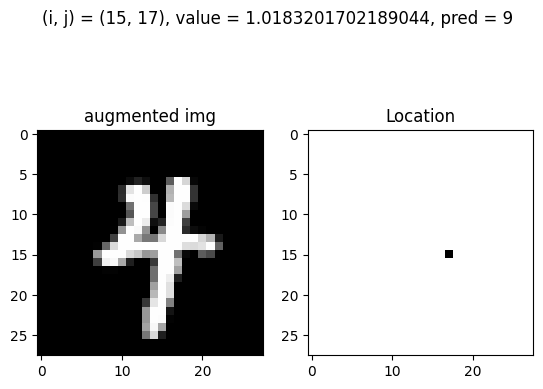

Test: At (i, j) = (16, 0) and value = 2.82148653034729, pred = 9, before_pred = 4, gt = 4


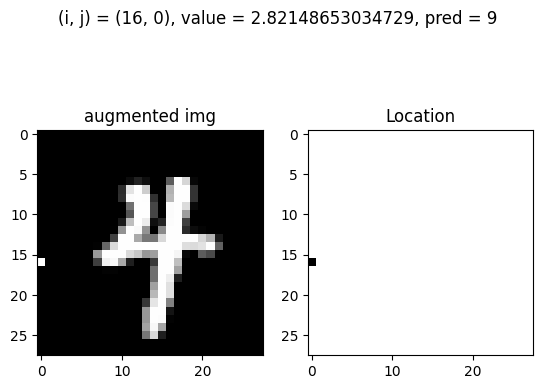

Test: At (i, j) = (16, 8) and value = -0.424212917883804, pred = 9, before_pred = 4, gt = 4


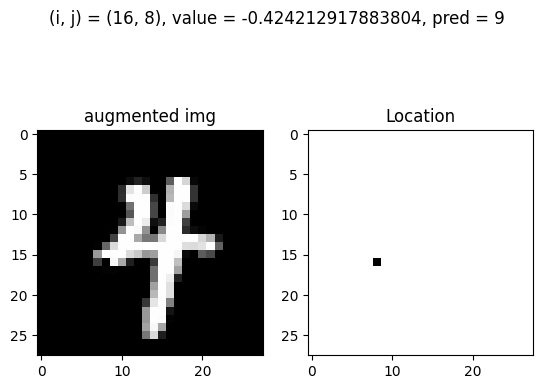

Test: At (i, j) = (16, 8) and value = -0.06357964585812692, pred = 9, before_pred = 4, gt = 4


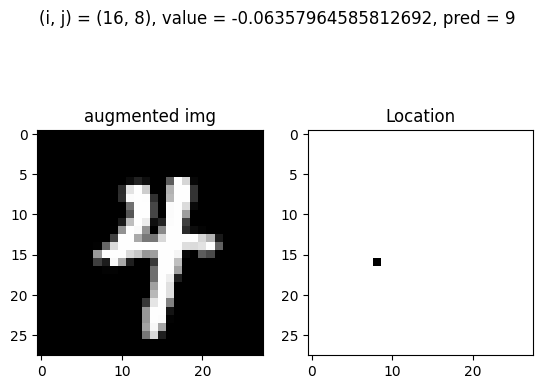

Test: At (i, j) = (16, 8) and value = 0.29705362616755016, pred = 9, before_pred = 4, gt = 4


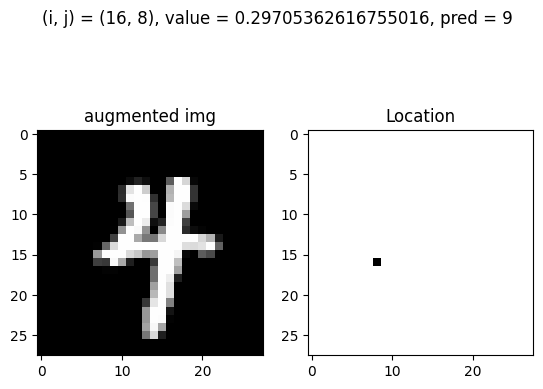

Test: At (i, j) = (16, 9) and value = -0.424212917883804, pred = 9, before_pred = 4, gt = 4


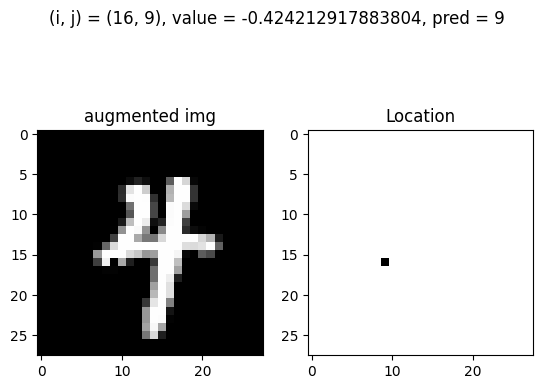

Test: At (i, j) = (16, 9) and value = -0.06357964585812692, pred = 9, before_pred = 4, gt = 4


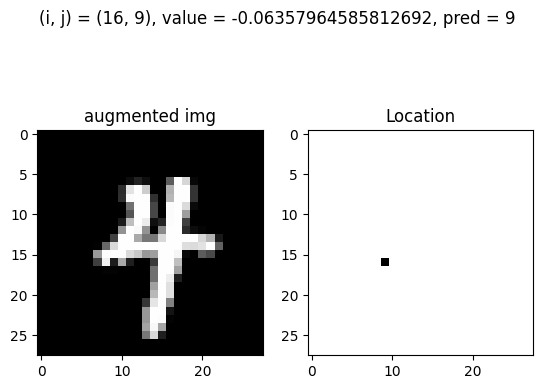

Test: At (i, j) = (16, 9) and value = 0.29705362616755016, pred = 9, before_pred = 4, gt = 4


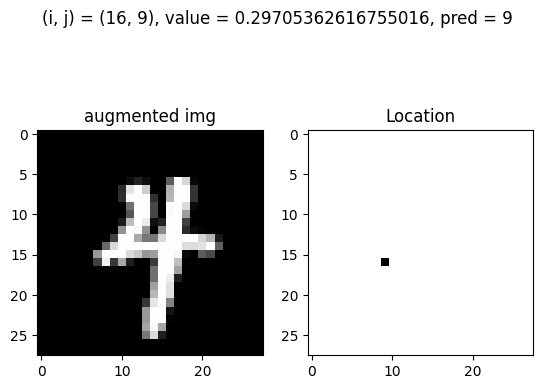

Test: At (i, j) = (16, 9) and value = 0.6576868981932272, pred = 9, before_pred = 4, gt = 4


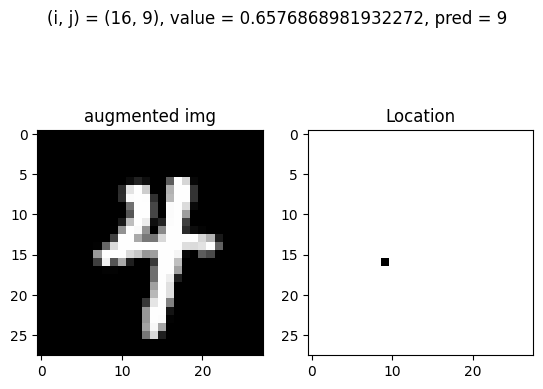

Test: At (i, j) = (16, 9) and value = 1.0183201702189044, pred = 9, before_pred = 4, gt = 4


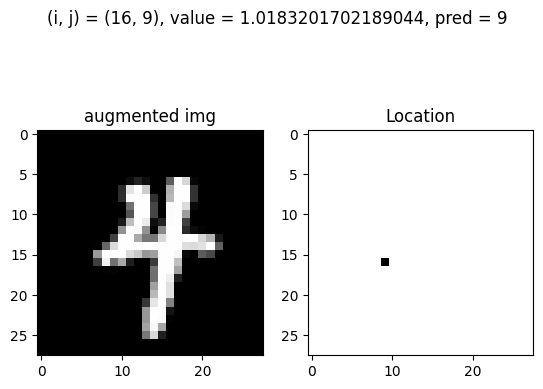

Test: At (i, j) = (16, 10) and value = -0.424212917883804, pred = 9, before_pred = 4, gt = 4


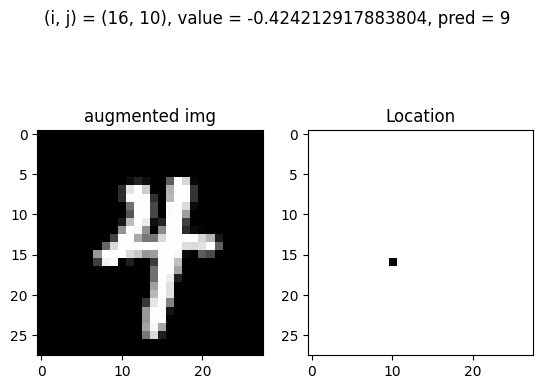

Test: At (i, j) = (16, 10) and value = -0.06357964585812692, pred = 9, before_pred = 4, gt = 4


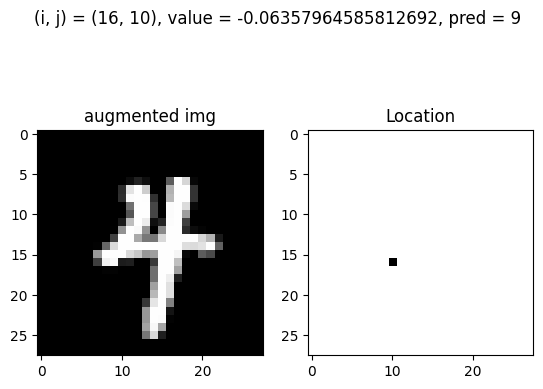

Test: At (i, j) = (16, 15) and value = -0.424212917883804, pred = 9, before_pred = 4, gt = 4


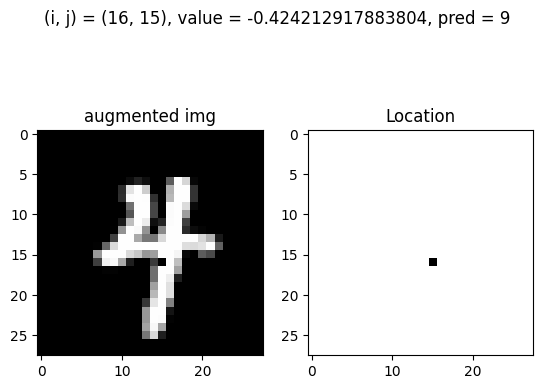

Test: At (i, j) = (16, 15) and value = -0.06357964585812692, pred = 9, before_pred = 4, gt = 4


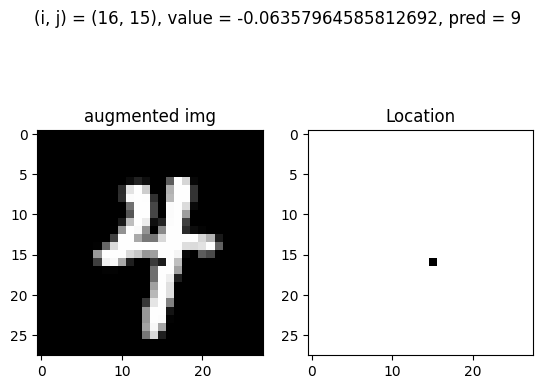

Test: At (i, j) = (16, 15) and value = 0.29705362616755016, pred = 9, before_pred = 4, gt = 4


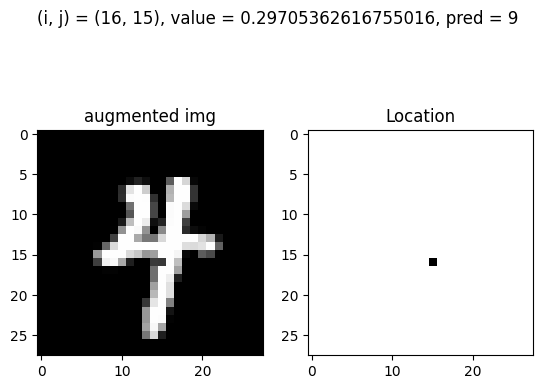

Test: At (i, j) = (16, 15) and value = 0.6576868981932272, pred = 9, before_pred = 4, gt = 4


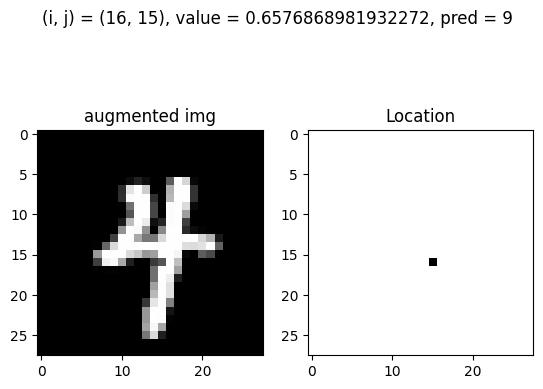

Test: At (i, j) = (16, 15) and value = 1.0183201702189044, pred = 9, before_pred = 4, gt = 4


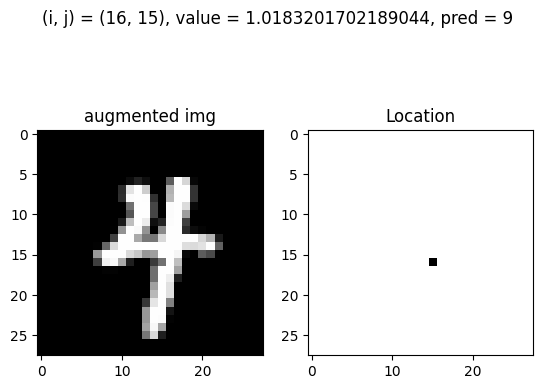

Test: At (i, j) = (16, 15) and value = 1.3789534422445815, pred = 9, before_pred = 4, gt = 4


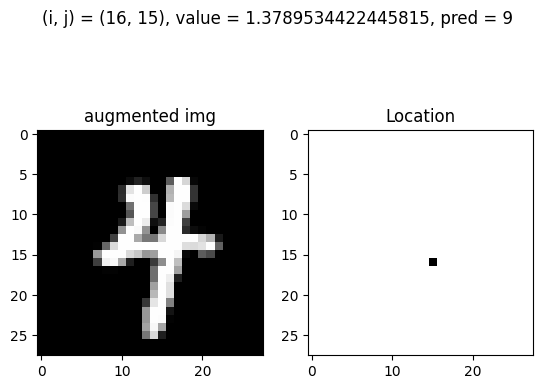

Test: At (i, j) = (16, 15) and value = 1.7395867142702586, pred = 9, before_pred = 4, gt = 4


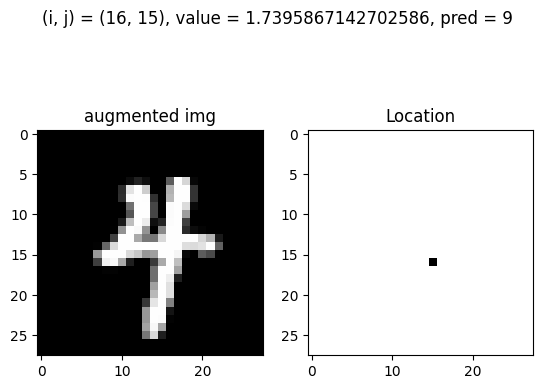

Test: At (i, j) = (16, 16) and value = -0.424212917883804, pred = 9, before_pred = 4, gt = 4


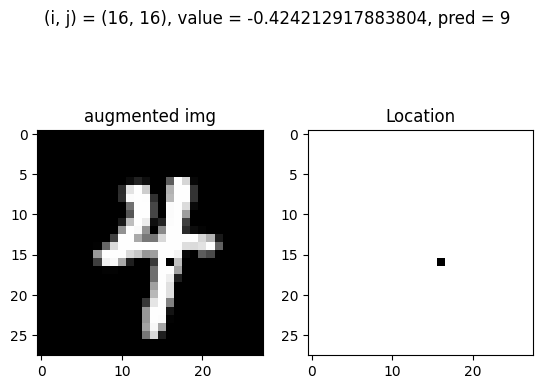

Test: At (i, j) = (16, 16) and value = -0.06357964585812692, pred = 9, before_pred = 4, gt = 4


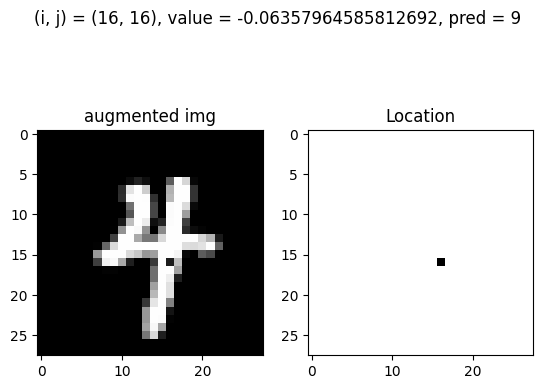

Test: At (i, j) = (16, 16) and value = 0.29705362616755016, pred = 9, before_pred = 4, gt = 4


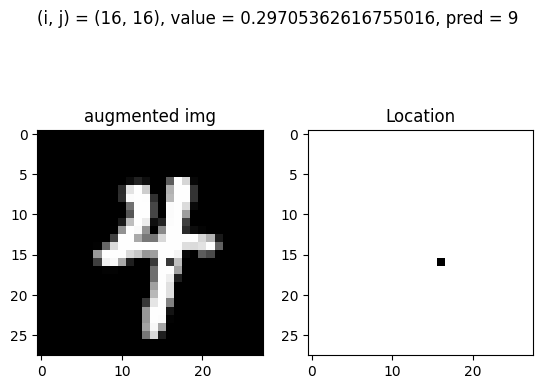

Test: At (i, j) = (16, 16) and value = 0.6576868981932272, pred = 9, before_pred = 4, gt = 4


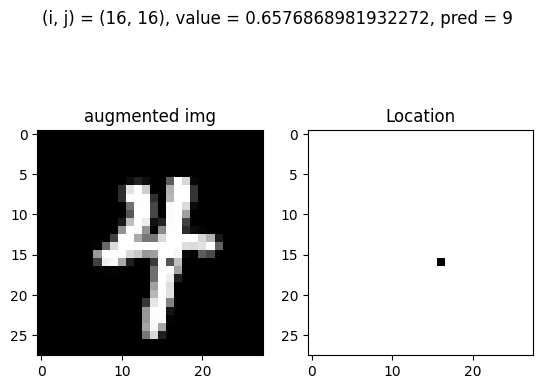

Test: At (i, j) = (16, 16) and value = 1.0183201702189044, pred = 9, before_pred = 4, gt = 4


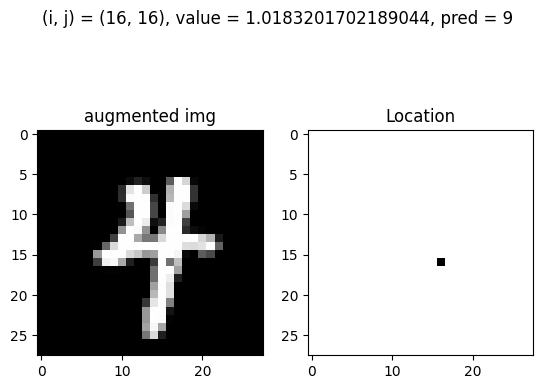

Test: At (i, j) = (16, 16) and value = 1.3789534422445815, pred = 9, before_pred = 4, gt = 4


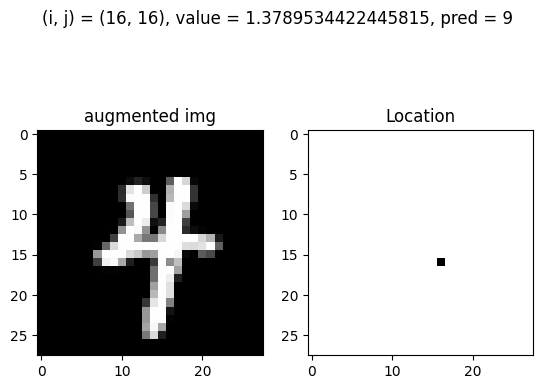

Test: At (i, j) = (17, 14) and value = -0.424212917883804, pred = 9, before_pred = 4, gt = 4


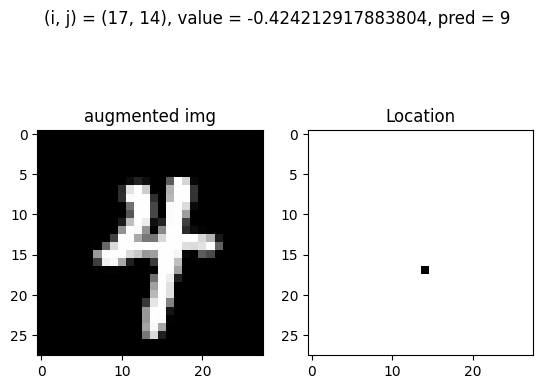

Test: At (i, j) = (17, 14) and value = -0.06357964585812692, pred = 9, before_pred = 4, gt = 4


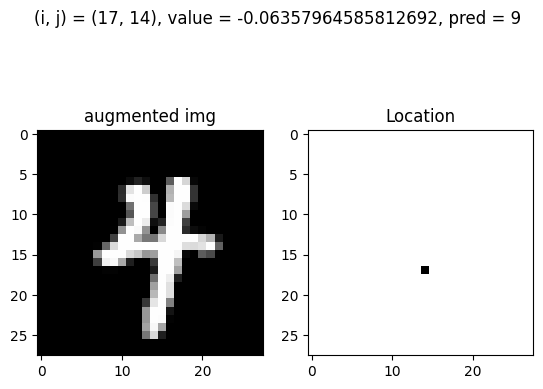

Test: At (i, j) = (17, 15) and value = -0.424212917883804, pred = 9, before_pred = 4, gt = 4


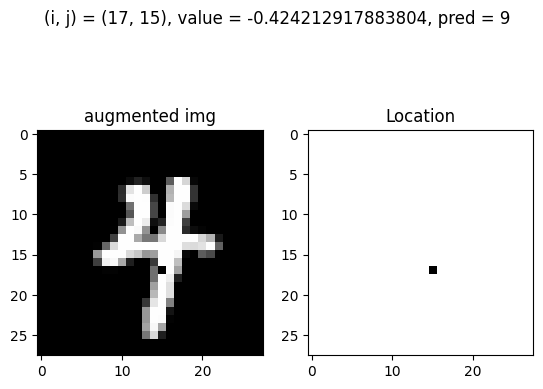

Test: At (i, j) = (17, 15) and value = -0.06357964585812692, pred = 9, before_pred = 4, gt = 4


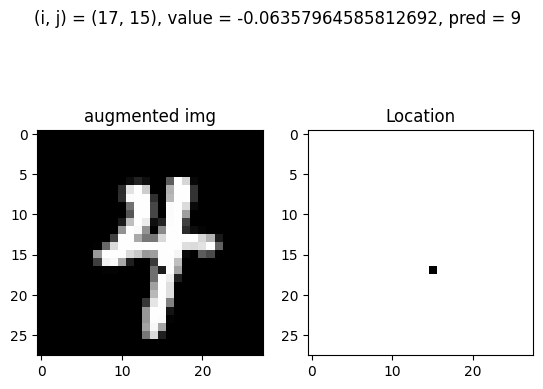

Test: At (i, j) = (17, 15) and value = 0.29705362616755016, pred = 9, before_pred = 4, gt = 4


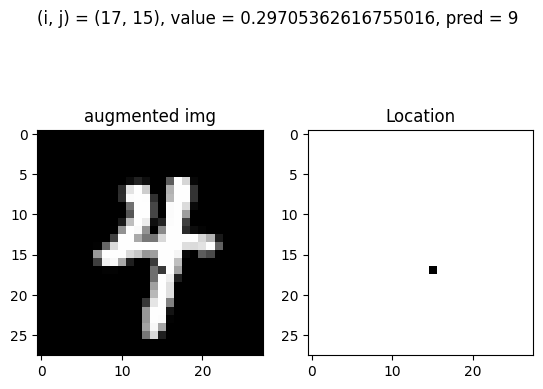

Test: At (i, j) = (17, 15) and value = 0.6576868981932272, pred = 9, before_pred = 4, gt = 4


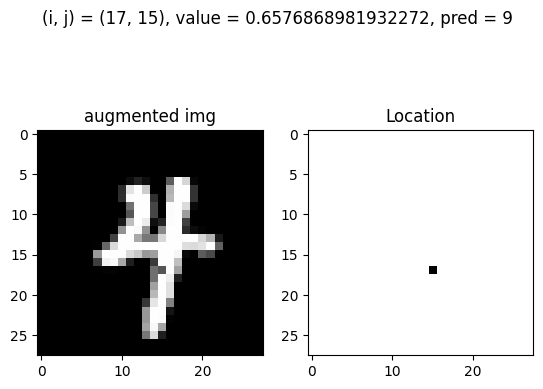

Test: At (i, j) = (17, 15) and value = 1.0183201702189044, pred = 9, before_pred = 4, gt = 4


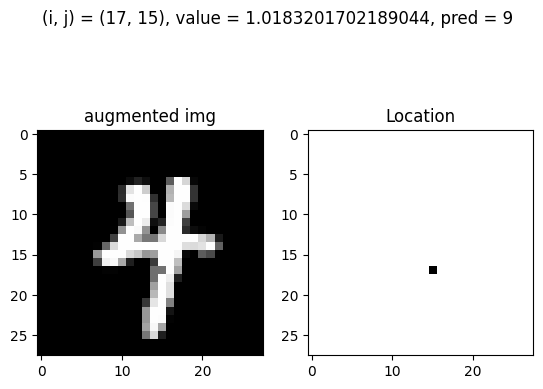

Test: At (i, j) = (17, 15) and value = 1.3789534422445815, pred = 9, before_pred = 4, gt = 4


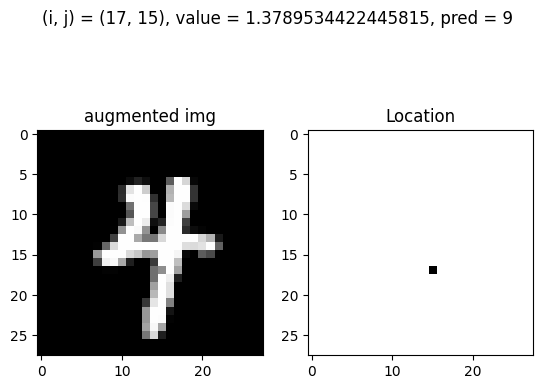

Test: At (i, j) = (17, 16) and value = -0.424212917883804, pred = 9, before_pred = 4, gt = 4


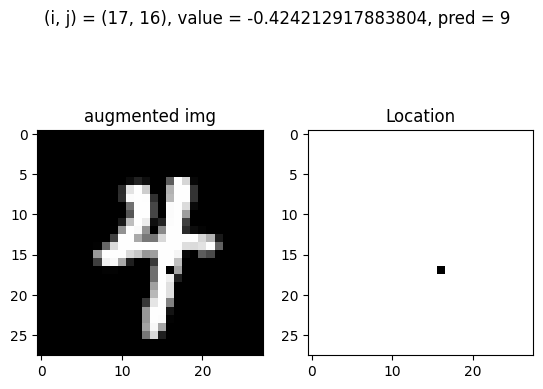

Test: At (i, j) = (18, 1) and value = 2.1002199862959356, pred = 9, before_pred = 4, gt = 4


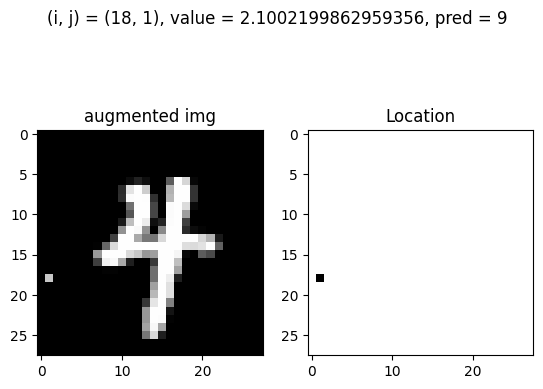

Test: At (i, j) = (18, 1) and value = 2.4608532583216127, pred = 9, before_pred = 4, gt = 4


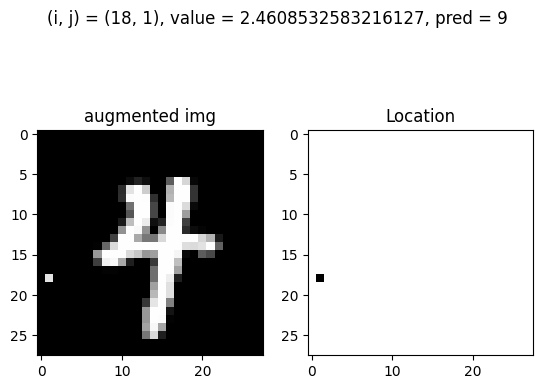

Test: At (i, j) = (18, 1) and value = 2.82148653034729, pred = 9, before_pred = 4, gt = 4


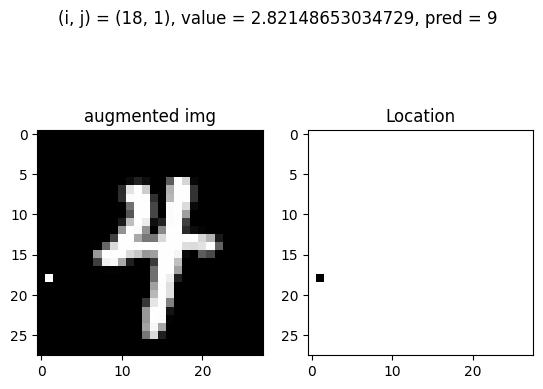

Test: At (i, j) = (18, 4) and value = 2.1002199862959356, pred = 9, before_pred = 4, gt = 4


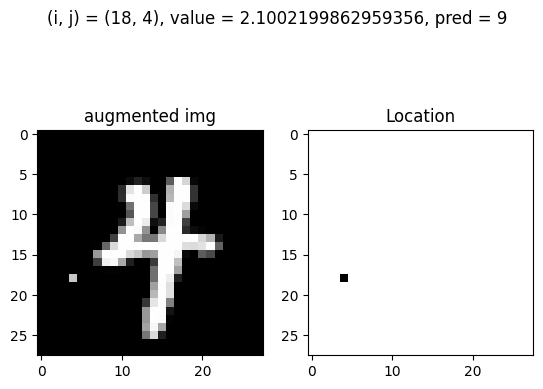

Test: At (i, j) = (18, 4) and value = 2.4608532583216127, pred = 9, before_pred = 4, gt = 4


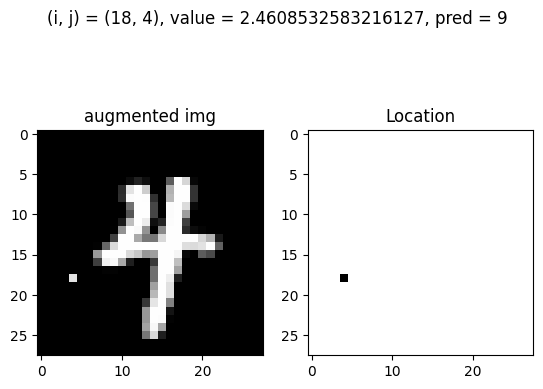

Test: At (i, j) = (18, 4) and value = 2.82148653034729, pred = 9, before_pred = 4, gt = 4


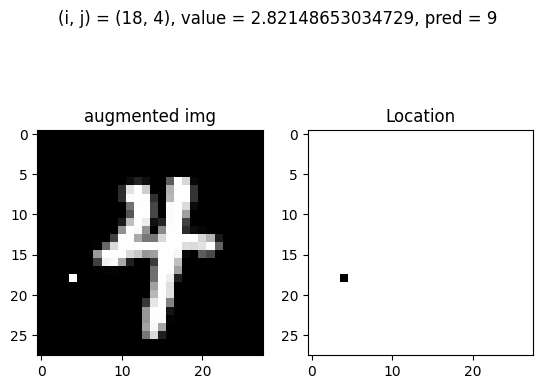

Test: At (i, j) = (18, 6) and value = 2.82148653034729, pred = 9, before_pred = 4, gt = 4


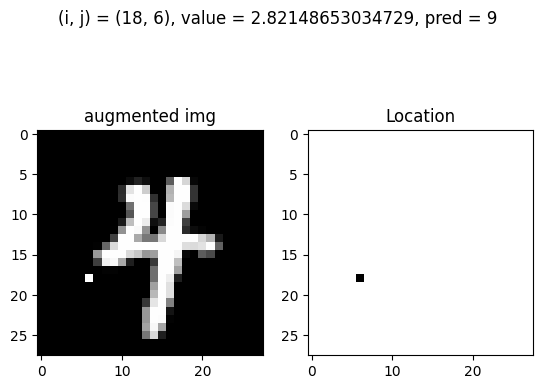

Test: At (i, j) = (18, 14) and value = -0.424212917883804, pred = 9, before_pred = 4, gt = 4


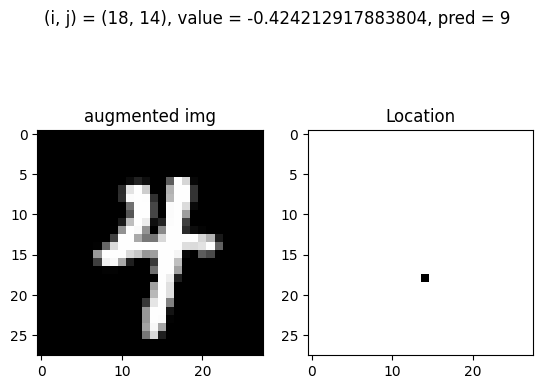

Test: At (i, j) = (18, 14) and value = -0.06357964585812692, pred = 9, before_pred = 4, gt = 4


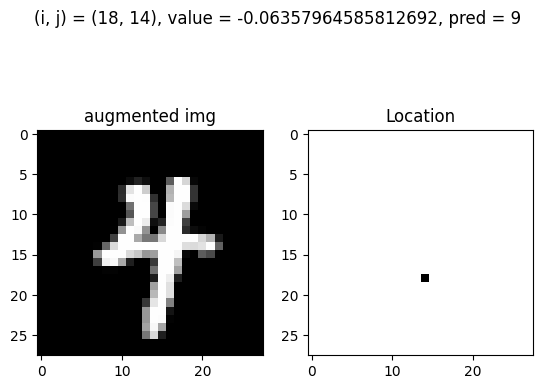

Test: At (i, j) = (18, 15) and value = -0.424212917883804, pred = 9, before_pred = 4, gt = 4


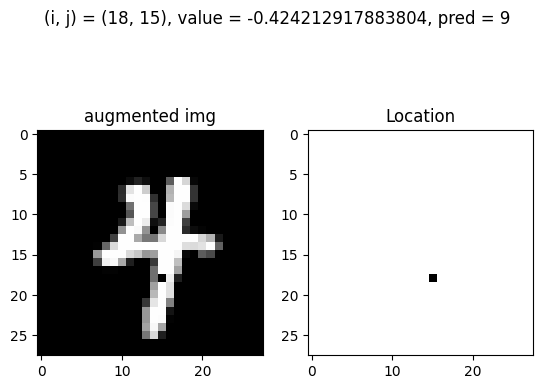

Test: At (i, j) = (18, 15) and value = -0.06357964585812692, pred = 9, before_pred = 4, gt = 4


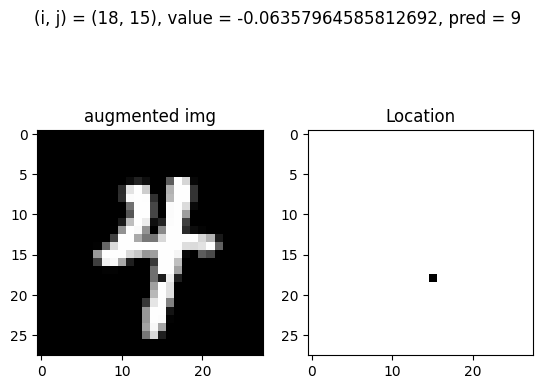

Test: At (i, j) = (18, 27) and value = 2.1002199862959356, pred = 9, before_pred = 4, gt = 4


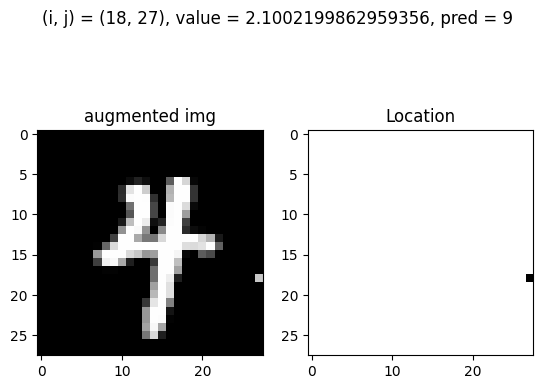

Test: At (i, j) = (18, 27) and value = 2.4608532583216127, pred = 9, before_pred = 4, gt = 4


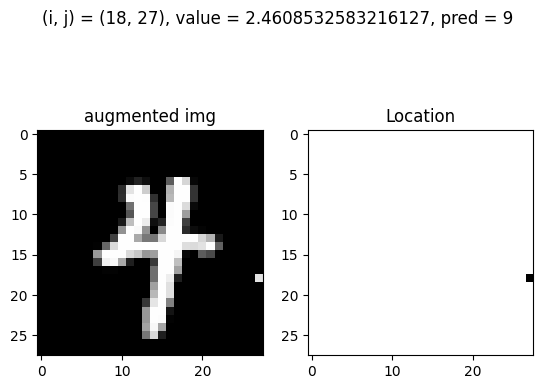

Test: At (i, j) = (18, 27) and value = 2.82148653034729, pred = 9, before_pred = 4, gt = 4


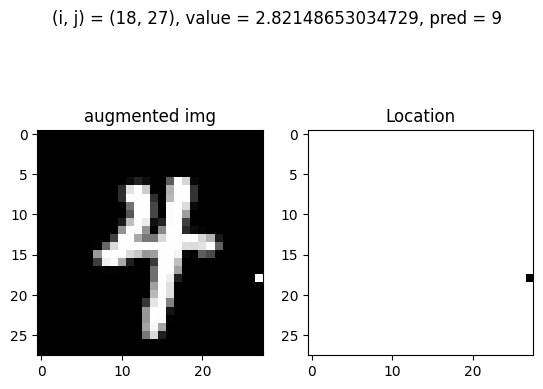

Test: At (i, j) = (19, 4) and value = 2.4608532583216127, pred = 9, before_pred = 4, gt = 4


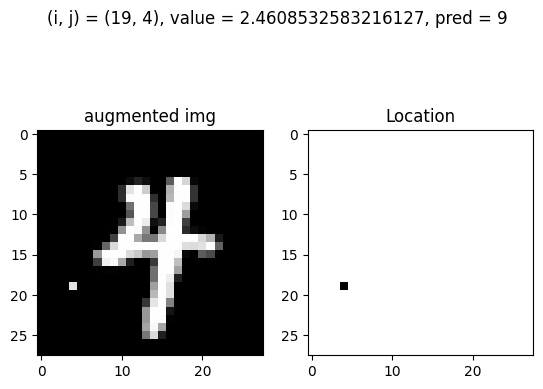

Test: At (i, j) = (19, 4) and value = 2.82148653034729, pred = 9, before_pred = 4, gt = 4


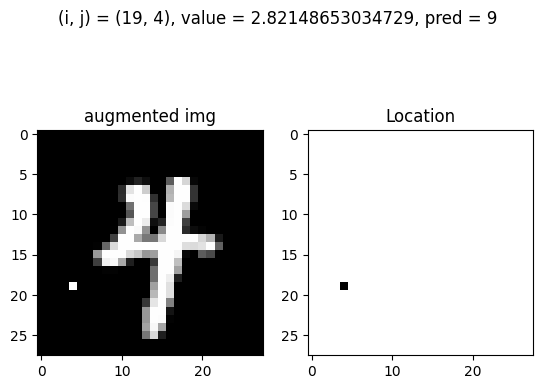

Test: At (i, j) = (19, 7) and value = 2.82148653034729, pred = 9, before_pred = 4, gt = 4


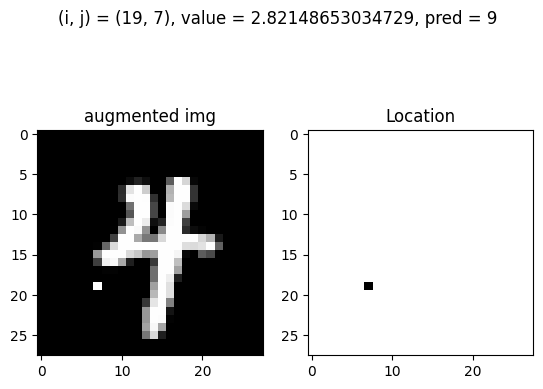

Test: At (i, j) = (19, 8) and value = 1.3789534422445815, pred = 9, before_pred = 4, gt = 4


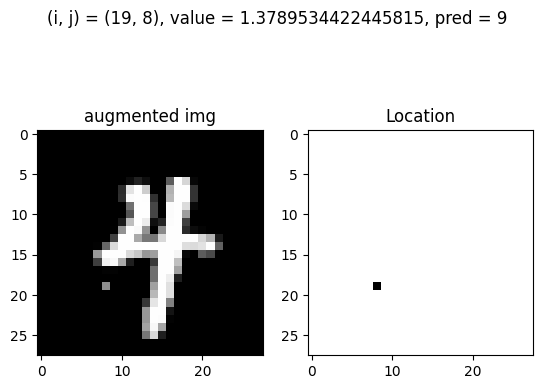

Test: At (i, j) = (19, 8) and value = 1.7395867142702586, pred = 9, before_pred = 4, gt = 4


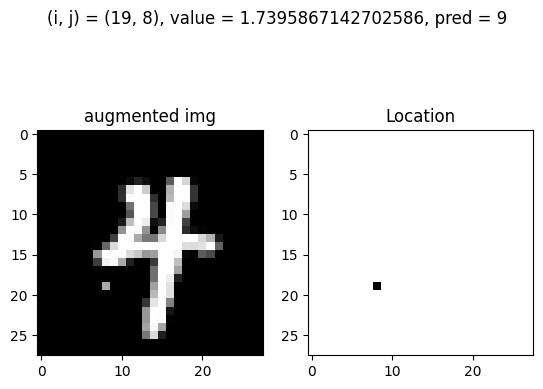

Test: At (i, j) = (19, 8) and value = 2.1002199862959356, pred = 9, before_pred = 4, gt = 4


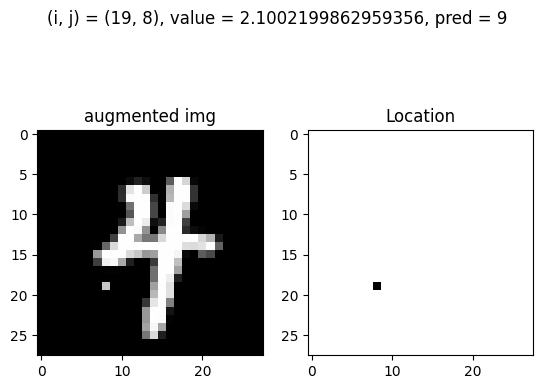

Test: At (i, j) = (19, 8) and value = 2.4608532583216127, pred = 9, before_pred = 4, gt = 4


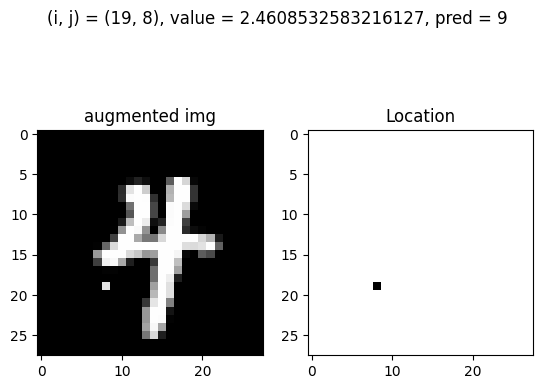

Test: At (i, j) = (19, 8) and value = 2.82148653034729, pred = 9, before_pred = 4, gt = 4


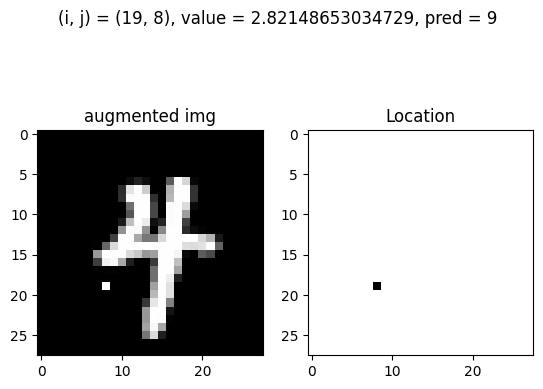

Test: At (i, j) = (19, 16) and value = -0.424212917883804, pred = 9, before_pred = 4, gt = 4


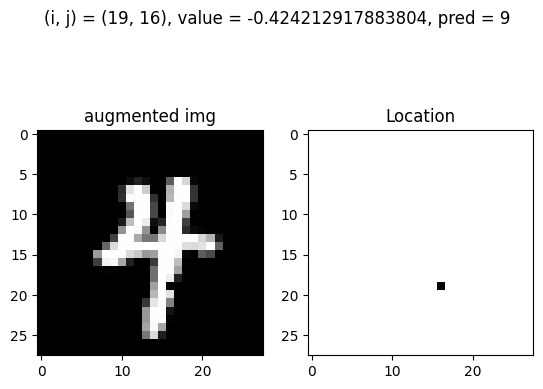

Test: At (i, j) = (19, 16) and value = -0.06357964585812692, pred = 9, before_pred = 4, gt = 4


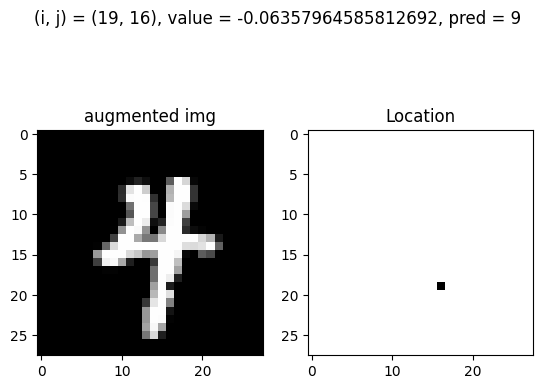

Test: At (i, j) = (19, 16) and value = 0.29705362616755016, pred = 9, before_pred = 4, gt = 4


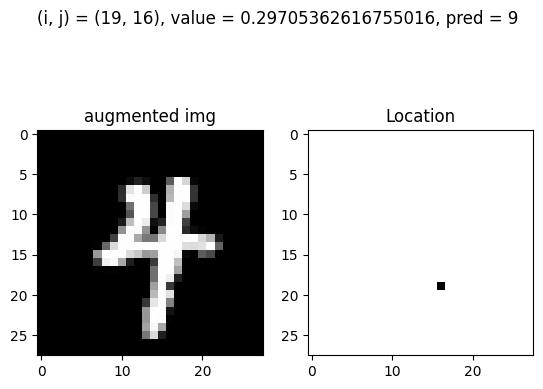

Test: At (i, j) = (19, 16) and value = 0.6576868981932272, pred = 9, before_pred = 4, gt = 4


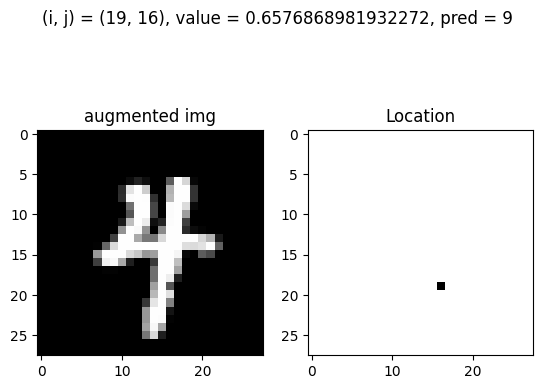

Test: At (i, j) = (19, 26) and value = 2.4608532583216127, pred = 9, before_pred = 4, gt = 4


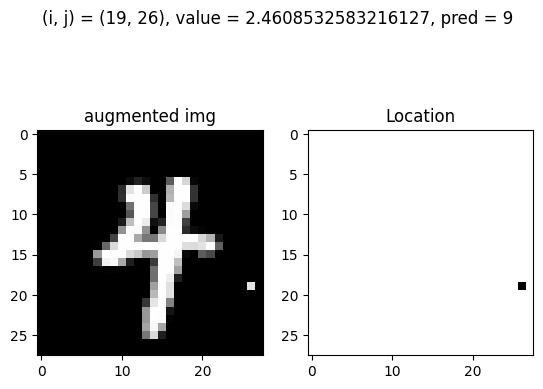

Test: At (i, j) = (19, 26) and value = 2.82148653034729, pred = 9, before_pred = 4, gt = 4


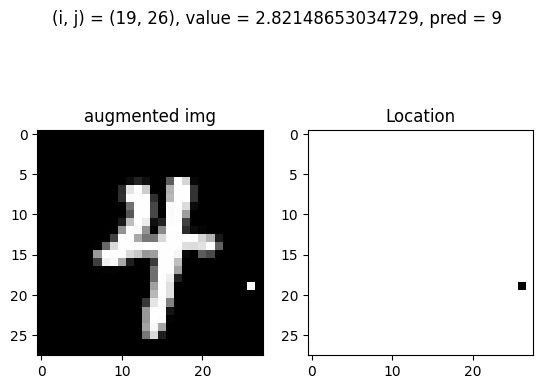

Test: At (i, j) = (20, 2) and value = 1.7395867142702586, pred = 9, before_pred = 4, gt = 4


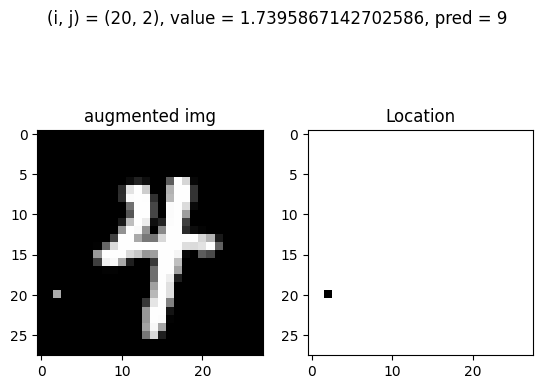

Test: At (i, j) = (20, 2) and value = 2.1002199862959356, pred = 9, before_pred = 4, gt = 4


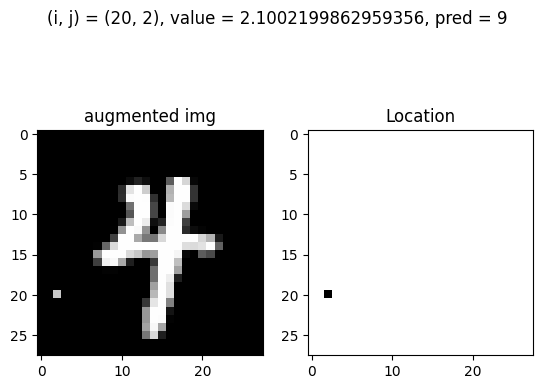

Test: At (i, j) = (20, 2) and value = 2.4608532583216127, pred = 9, before_pred = 4, gt = 4


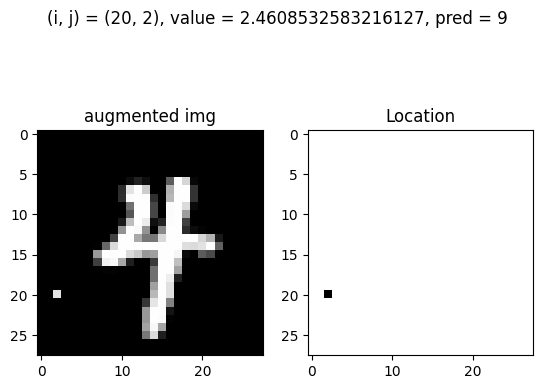

Test: At (i, j) = (20, 2) and value = 2.82148653034729, pred = 9, before_pred = 4, gt = 4


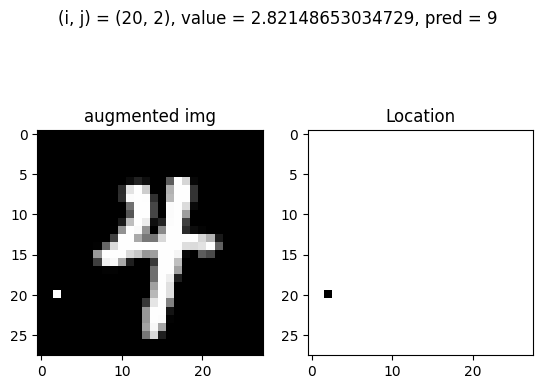

Test: At (i, j) = (20, 4) and value = 1.0183201702189044, pred = 9, before_pred = 4, gt = 4


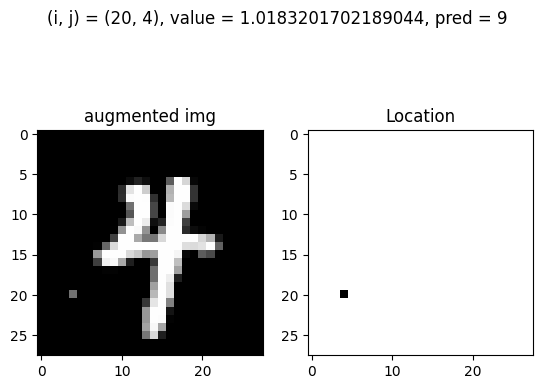

Test: At (i, j) = (20, 4) and value = 1.3789534422445815, pred = 9, before_pred = 4, gt = 4


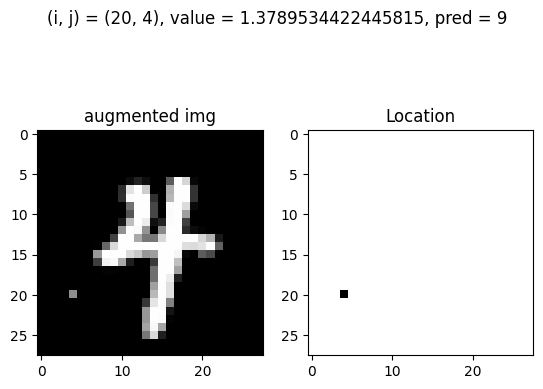

Test: At (i, j) = (20, 4) and value = 1.7395867142702586, pred = 9, before_pred = 4, gt = 4


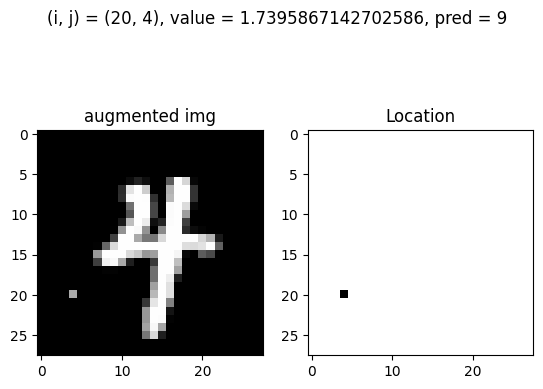

Test: At (i, j) = (20, 4) and value = 2.1002199862959356, pred = 9, before_pred = 4, gt = 4


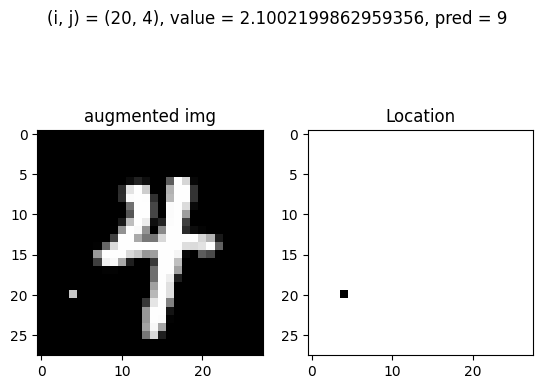

Test: At (i, j) = (20, 4) and value = 2.4608532583216127, pred = 9, before_pred = 4, gt = 4


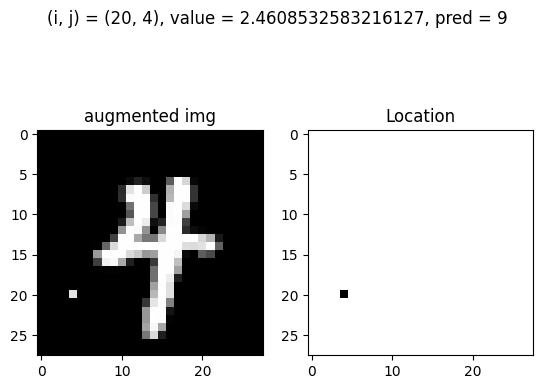

Test: At (i, j) = (20, 4) and value = 2.82148653034729, pred = 9, before_pred = 4, gt = 4


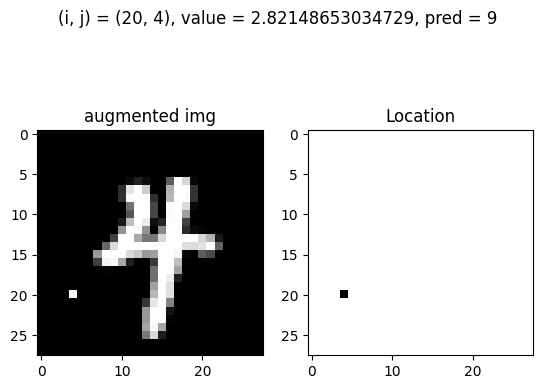

Test: At (i, j) = (20, 6) and value = 1.7395867142702586, pred = 9, before_pred = 4, gt = 4


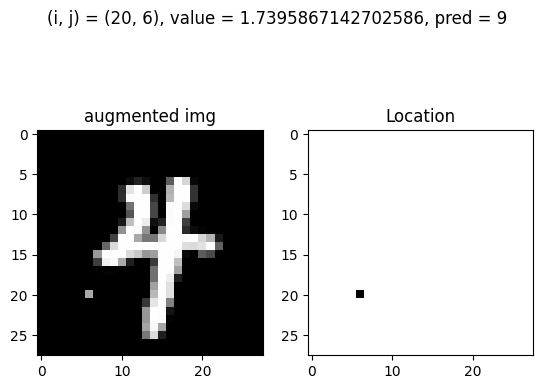

Test: At (i, j) = (20, 6) and value = 2.1002199862959356, pred = 9, before_pred = 4, gt = 4


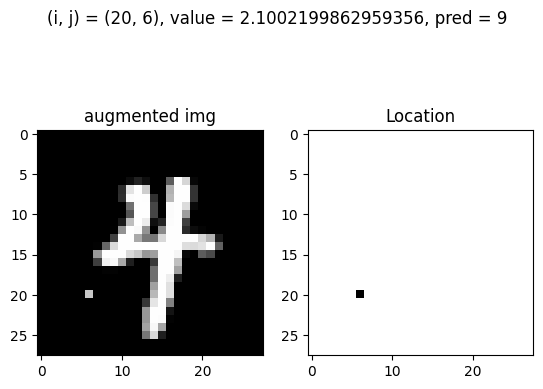

Test: At (i, j) = (20, 6) and value = 2.4608532583216127, pred = 9, before_pred = 4, gt = 4


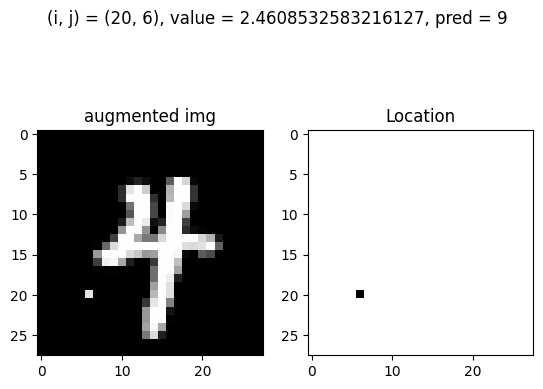

Test: At (i, j) = (20, 6) and value = 2.82148653034729, pred = 9, before_pred = 4, gt = 4


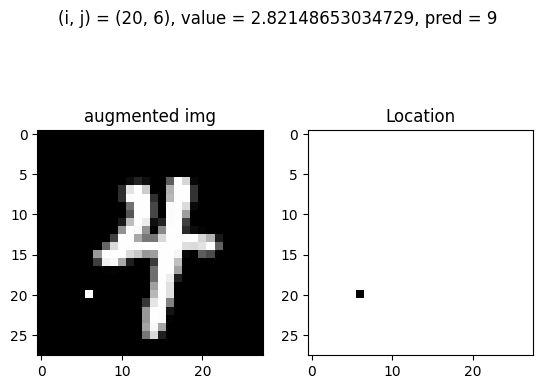

Test: At (i, j) = (20, 14) and value = -0.424212917883804, pred = 9, before_pred = 4, gt = 4


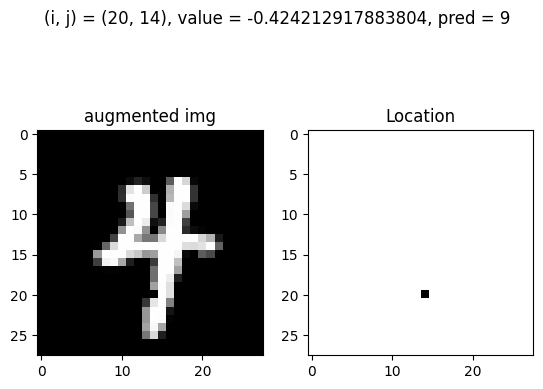

Test: At (i, j) = (20, 14) and value = -0.06357964585812692, pred = 9, before_pred = 4, gt = 4


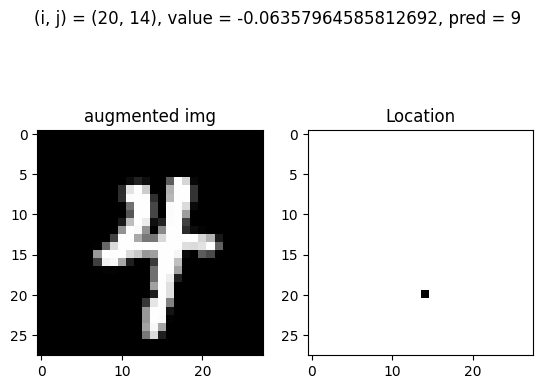

Test: At (i, j) = (20, 14) and value = 0.29705362616755016, pred = 9, before_pred = 4, gt = 4


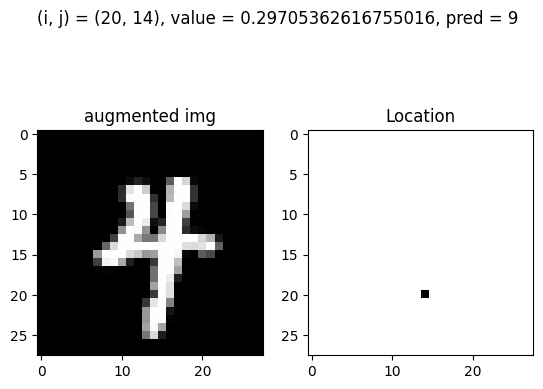

Test: At (i, j) = (20, 15) and value = -0.424212917883804, pred = 9, before_pred = 4, gt = 4


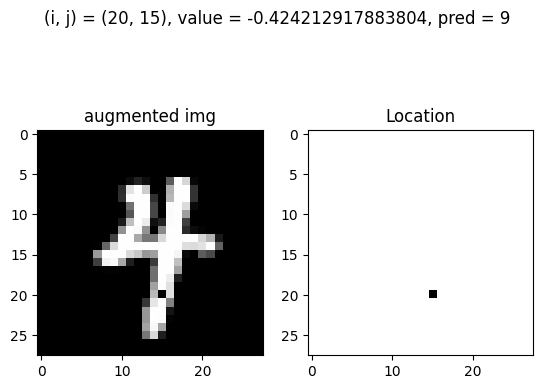

Test: At (i, j) = (20, 15) and value = -0.06357964585812692, pred = 9, before_pred = 4, gt = 4


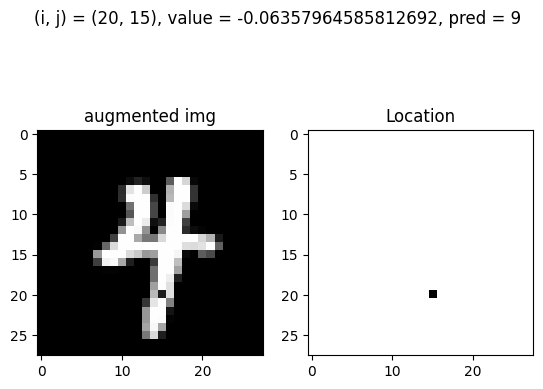

Test: At (i, j) = (20, 16) and value = -0.424212917883804, pred = 9, before_pred = 4, gt = 4


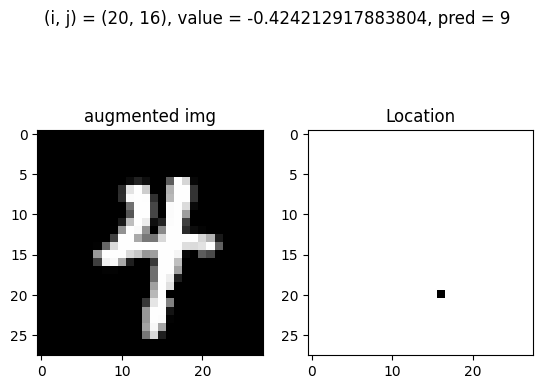

Test: At (i, j) = (20, 16) and value = -0.06357964585812692, pred = 9, before_pred = 4, gt = 4


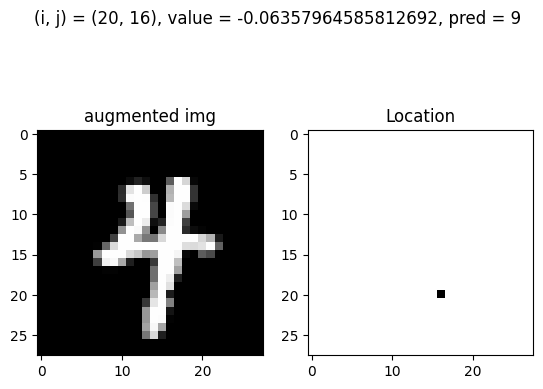

Test: At (i, j) = (21, 1) and value = 2.1002199862959356, pred = 9, before_pred = 4, gt = 4


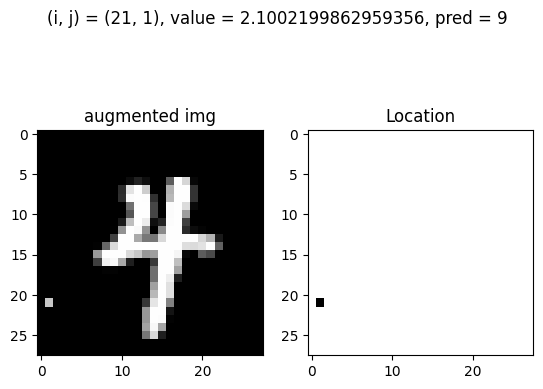

Test: At (i, j) = (21, 1) and value = 2.4608532583216127, pred = 9, before_pred = 4, gt = 4


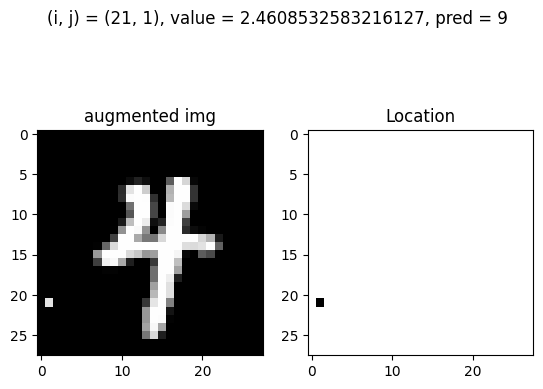

Test: At (i, j) = (21, 1) and value = 2.82148653034729, pred = 9, before_pred = 4, gt = 4


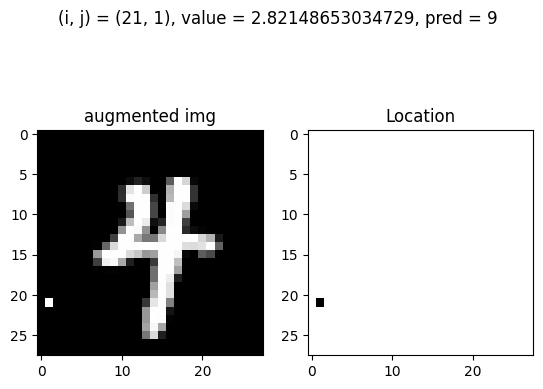

Test: At (i, j) = (21, 6) and value = 2.1002199862959356, pred = 9, before_pred = 4, gt = 4


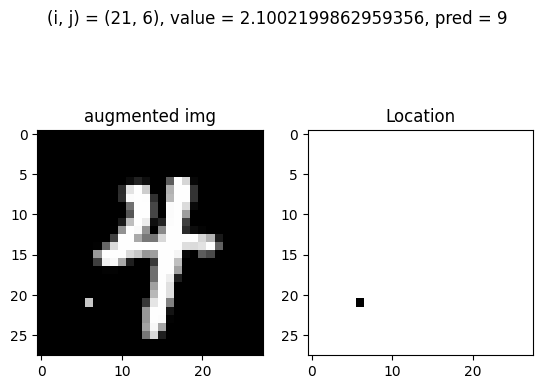

Test: At (i, j) = (21, 6) and value = 2.4608532583216127, pred = 9, before_pred = 4, gt = 4


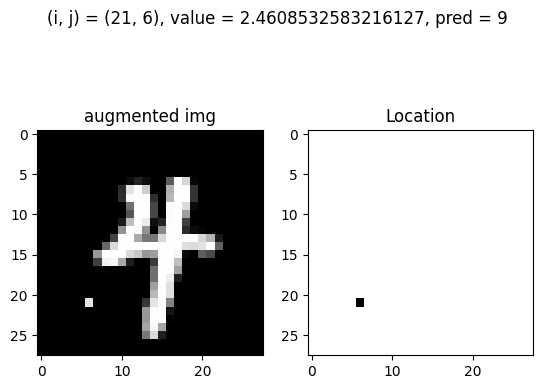

Test: At (i, j) = (21, 6) and value = 2.82148653034729, pred = 9, before_pred = 4, gt = 4


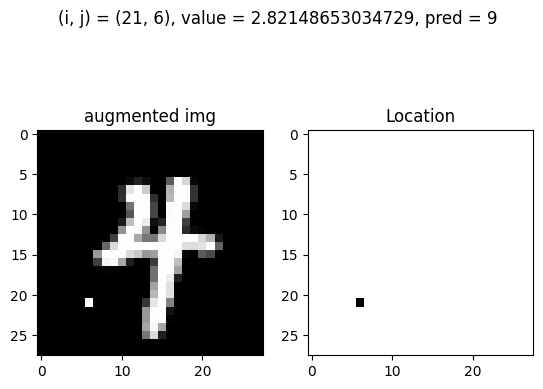

Test: At (i, j) = (21, 7) and value = 1.7395867142702586, pred = 9, before_pred = 4, gt = 4


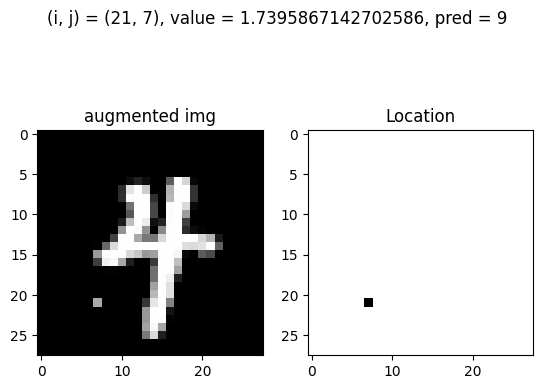

Test: At (i, j) = (21, 7) and value = 2.1002199862959356, pred = 9, before_pred = 4, gt = 4


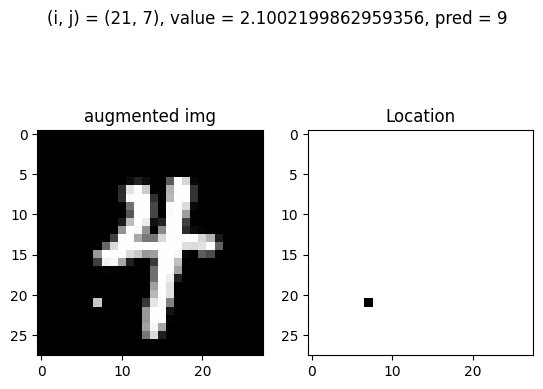

Test: At (i, j) = (21, 7) and value = 2.4608532583216127, pred = 9, before_pred = 4, gt = 4


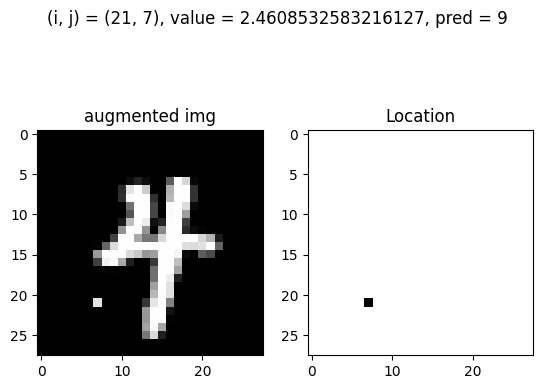

Test: At (i, j) = (21, 7) and value = 2.82148653034729, pred = 9, before_pred = 4, gt = 4


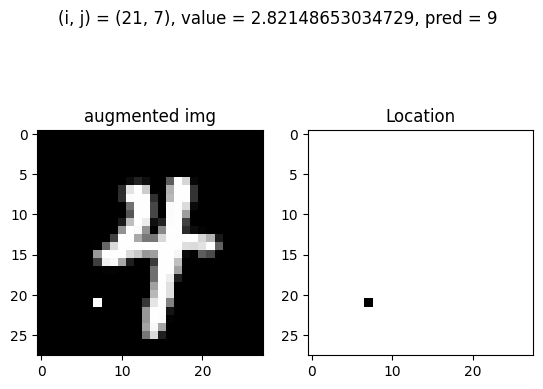

Test: At (i, j) = (21, 8) and value = 1.3789534422445815, pred = 9, before_pred = 4, gt = 4


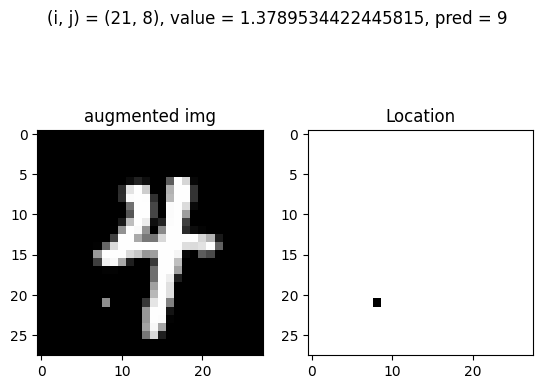

Test: At (i, j) = (21, 8) and value = 1.7395867142702586, pred = 9, before_pred = 4, gt = 4


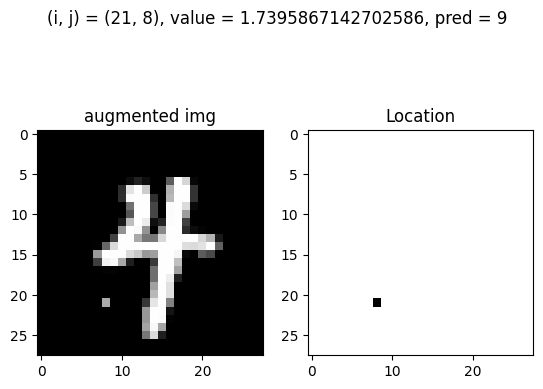

Test: At (i, j) = (21, 8) and value = 2.1002199862959356, pred = 9, before_pred = 4, gt = 4


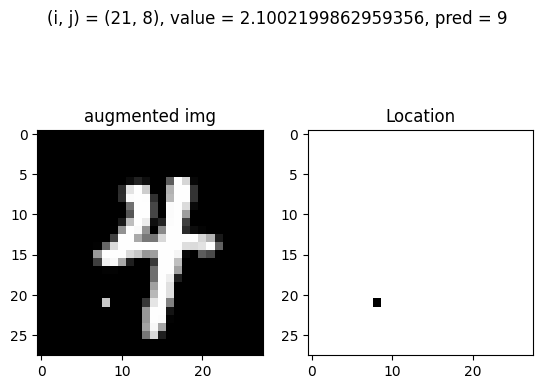

Test: At (i, j) = (21, 8) and value = 2.4608532583216127, pred = 9, before_pred = 4, gt = 4


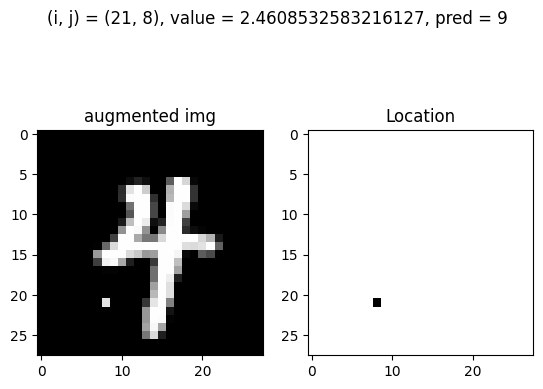

Test: At (i, j) = (21, 8) and value = 2.82148653034729, pred = 9, before_pred = 4, gt = 4


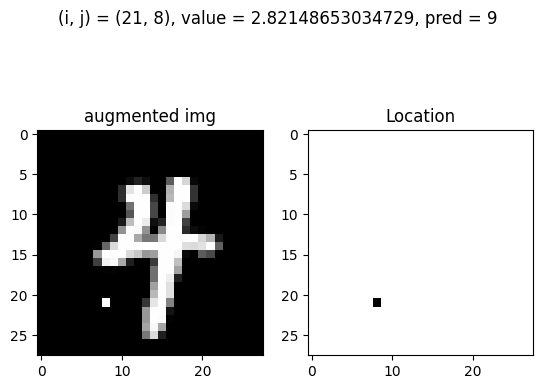

Test: At (i, j) = (21, 9) and value = 1.3789534422445815, pred = 9, before_pred = 4, gt = 4


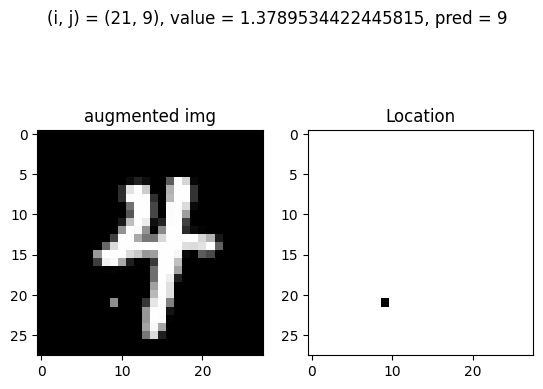

Test: At (i, j) = (21, 9) and value = 1.7395867142702586, pred = 9, before_pred = 4, gt = 4


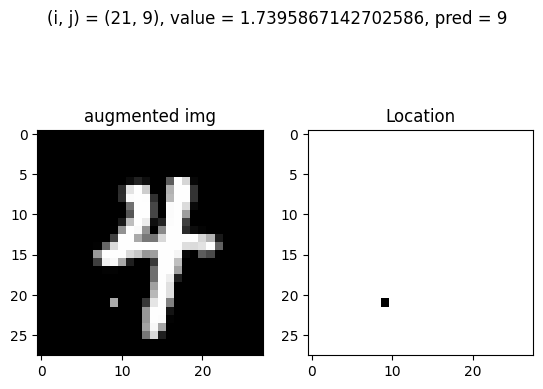

Test: At (i, j) = (21, 9) and value = 2.1002199862959356, pred = 9, before_pred = 4, gt = 4


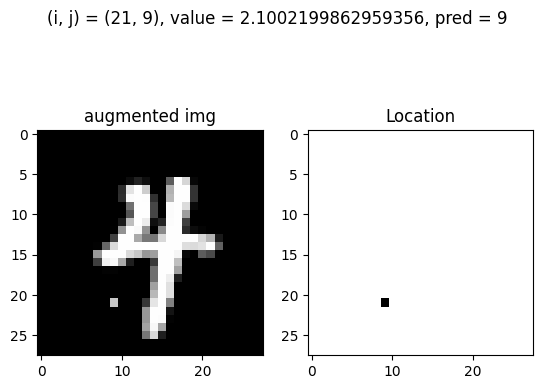

Test: At (i, j) = (21, 9) and value = 2.4608532583216127, pred = 9, before_pred = 4, gt = 4


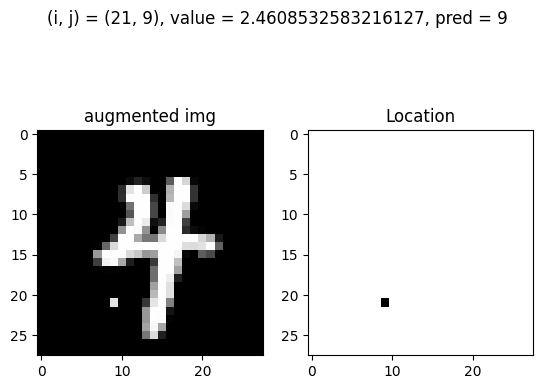

Test: At (i, j) = (21, 9) and value = 2.82148653034729, pred = 9, before_pred = 4, gt = 4


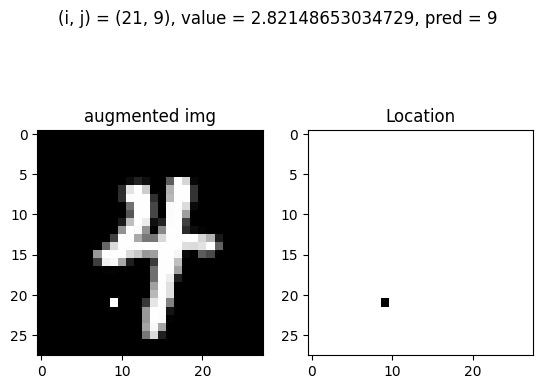

Test: At (i, j) = (21, 10) and value = 2.82148653034729, pred = 9, before_pred = 4, gt = 4


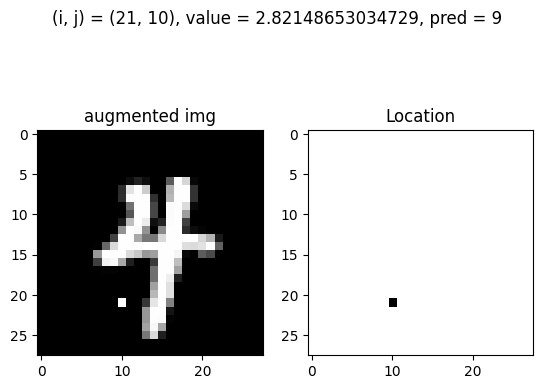

Test: At (i, j) = (21, 14) and value = -0.424212917883804, pred = 9, before_pred = 4, gt = 4


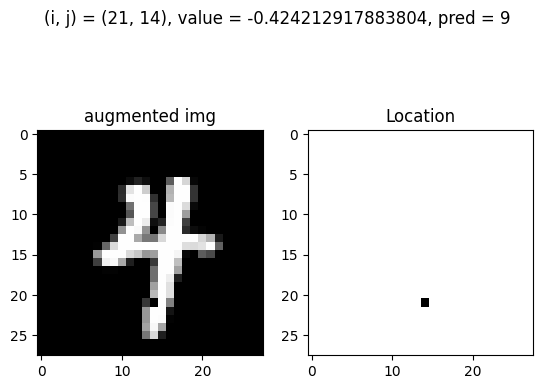

Test: At (i, j) = (21, 14) and value = -0.06357964585812692, pred = 9, before_pred = 4, gt = 4


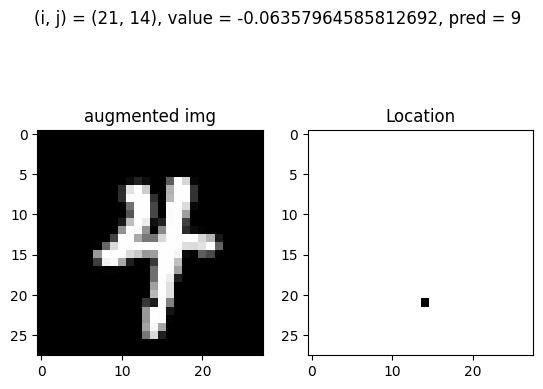

Test: At (i, j) = (21, 14) and value = 0.29705362616755016, pred = 9, before_pred = 4, gt = 4


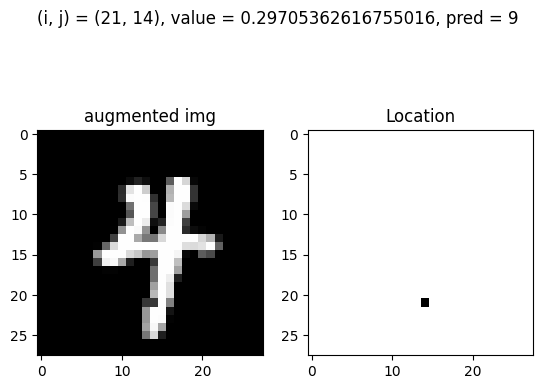

Test: At (i, j) = (21, 14) and value = 0.6576868981932272, pred = 9, before_pred = 4, gt = 4


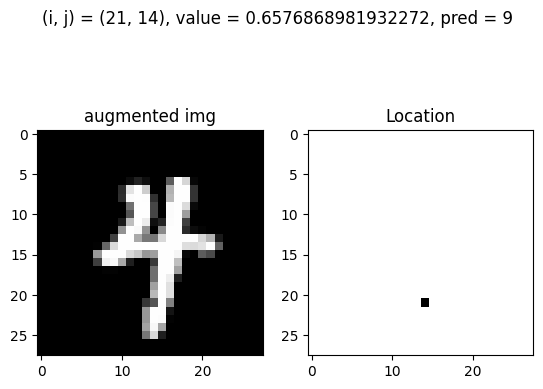

Test: At (i, j) = (21, 14) and value = 1.0183201702189044, pred = 9, before_pred = 4, gt = 4


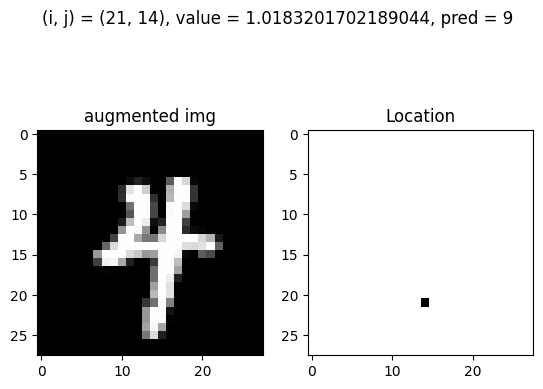

Test: At (i, j) = (21, 23) and value = 2.1002199862959356, pred = 9, before_pred = 4, gt = 4


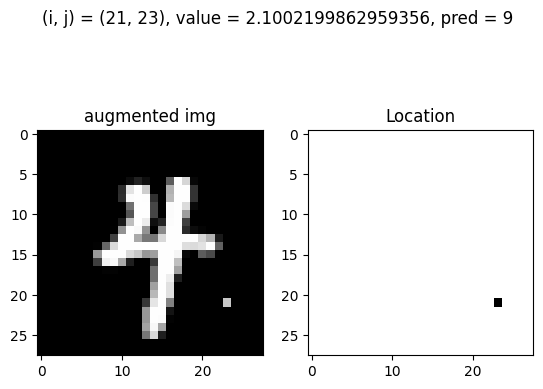

Test: At (i, j) = (21, 23) and value = 2.4608532583216127, pred = 9, before_pred = 4, gt = 4


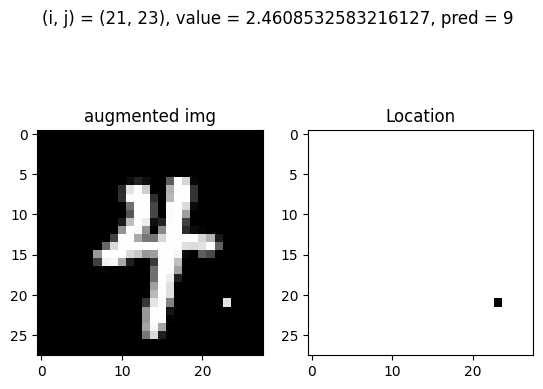

Test: At (i, j) = (21, 23) and value = 2.82148653034729, pred = 9, before_pred = 4, gt = 4


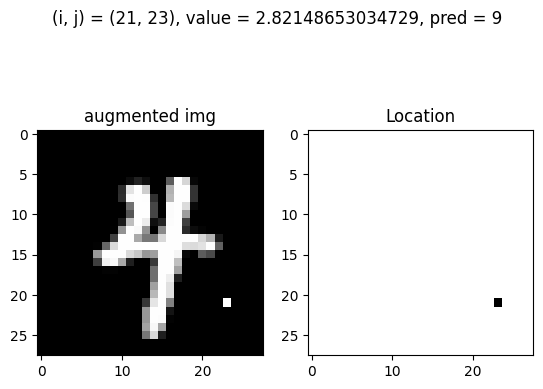

Test: At (i, j) = (21, 24) and value = 2.82148653034729, pred = 9, before_pred = 4, gt = 4


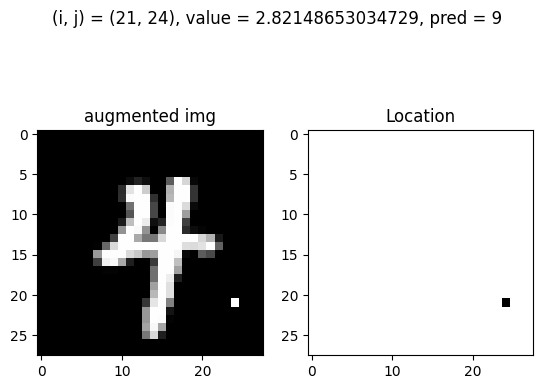

Test: At (i, j) = (22, 6) and value = 2.1002199862959356, pred = 9, before_pred = 4, gt = 4


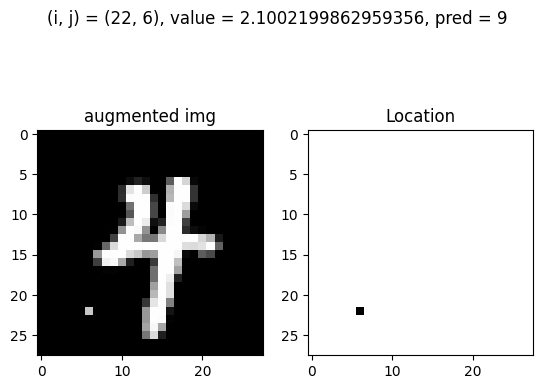

Test: At (i, j) = (22, 6) and value = 2.4608532583216127, pred = 9, before_pred = 4, gt = 4


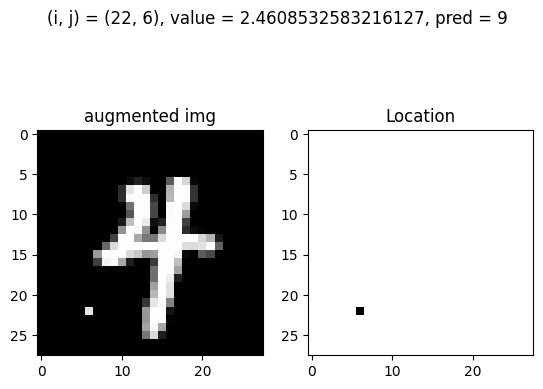

Test: At (i, j) = (22, 6) and value = 2.82148653034729, pred = 9, before_pred = 4, gt = 4


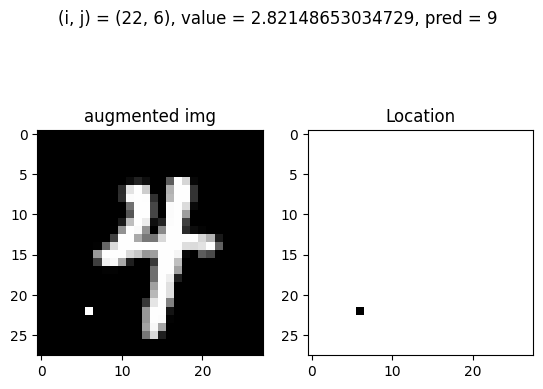

Test: At (i, j) = (22, 7) and value = 2.82148653034729, pred = 9, before_pred = 4, gt = 4


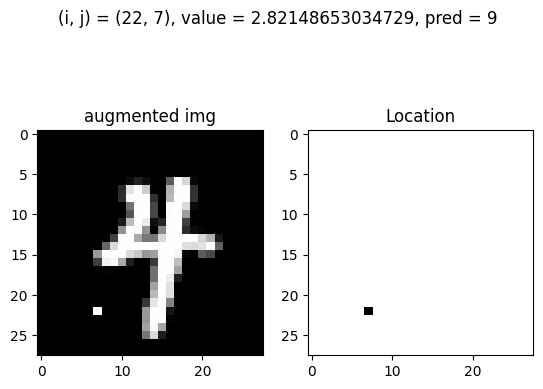

Test: At (i, j) = (22, 8) and value = 2.1002199862959356, pred = 9, before_pred = 4, gt = 4


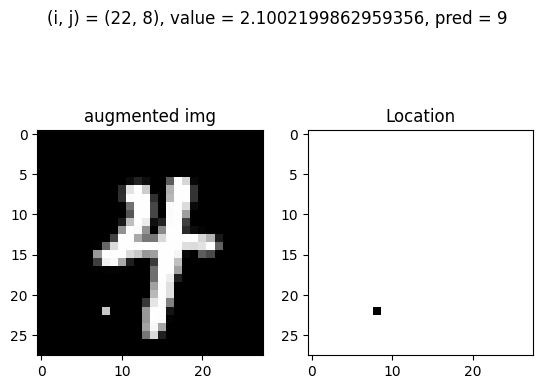

Test: At (i, j) = (22, 8) and value = 2.4608532583216127, pred = 9, before_pred = 4, gt = 4


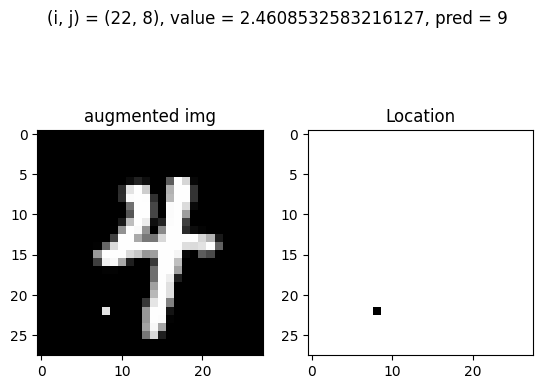

Test: At (i, j) = (22, 8) and value = 2.82148653034729, pred = 9, before_pred = 4, gt = 4


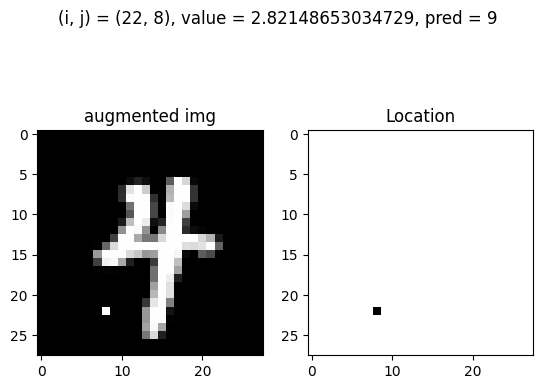

Test: At (i, j) = (22, 9) and value = 1.3789534422445815, pred = 9, before_pred = 4, gt = 4


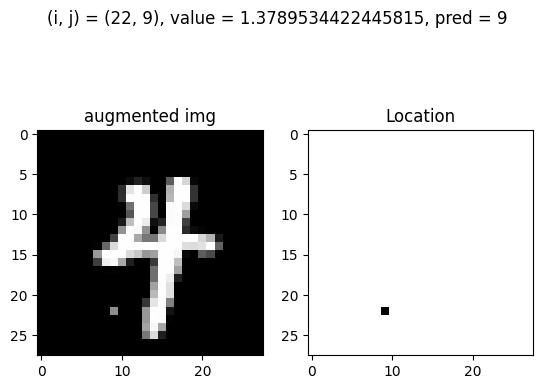

Test: At (i, j) = (22, 9) and value = 1.7395867142702586, pred = 9, before_pred = 4, gt = 4


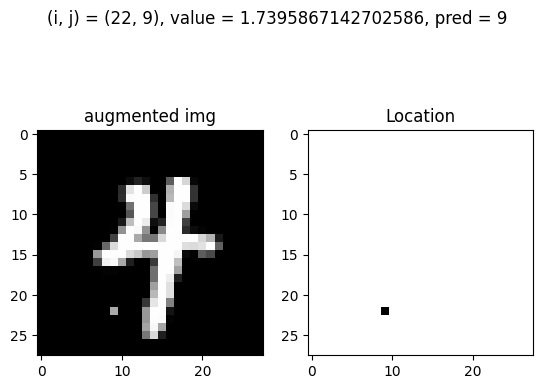

Test: At (i, j) = (22, 9) and value = 2.1002199862959356, pred = 9, before_pred = 4, gt = 4


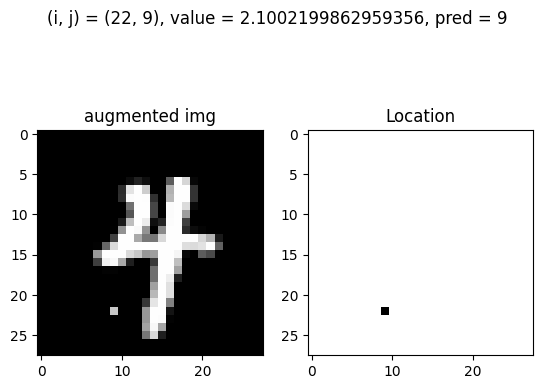

Test: At (i, j) = (22, 9) and value = 2.4608532583216127, pred = 9, before_pred = 4, gt = 4


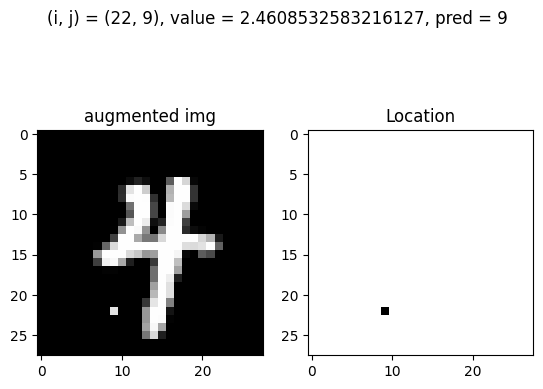

Test: At (i, j) = (22, 9) and value = 2.82148653034729, pred = 9, before_pred = 4, gt = 4


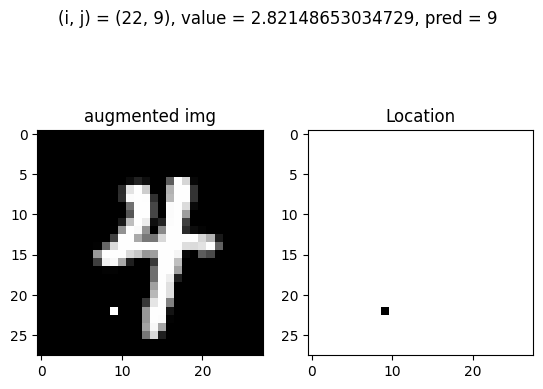

Test: At (i, j) = (22, 10) and value = 1.3789534422445815, pred = 9, before_pred = 4, gt = 4


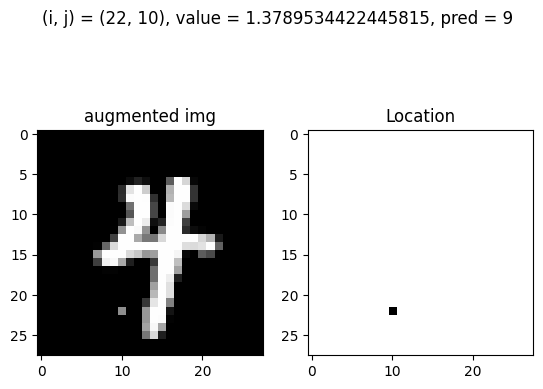

Test: At (i, j) = (22, 10) and value = 1.7395867142702586, pred = 9, before_pred = 4, gt = 4


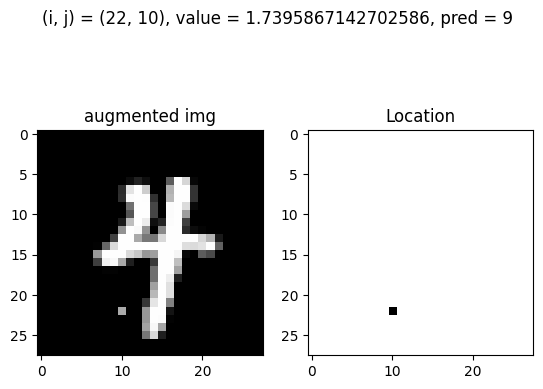

Test: At (i, j) = (22, 10) and value = 2.1002199862959356, pred = 9, before_pred = 4, gt = 4


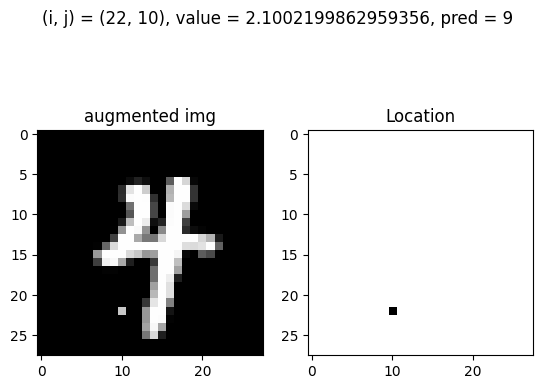

Test: At (i, j) = (22, 10) and value = 2.4608532583216127, pred = 9, before_pred = 4, gt = 4


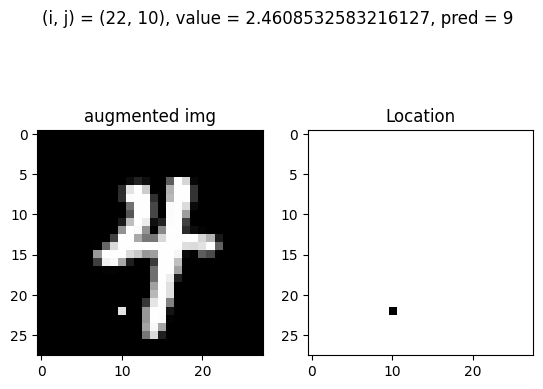

Test: At (i, j) = (22, 10) and value = 2.82148653034729, pred = 9, before_pred = 4, gt = 4


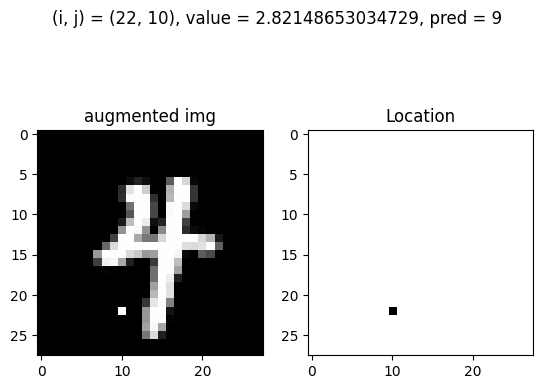

Test: At (i, j) = (22, 11) and value = 1.0183201702189044, pred = 9, before_pred = 4, gt = 4


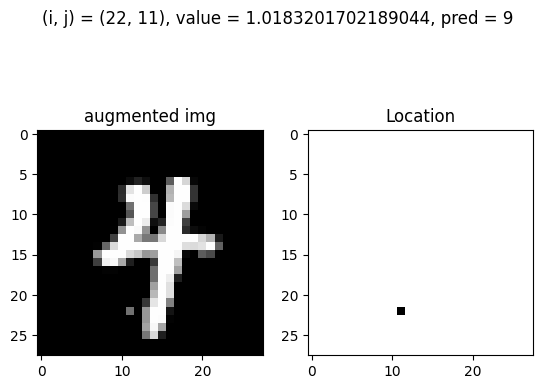

Test: At (i, j) = (22, 11) and value = 1.3789534422445815, pred = 9, before_pred = 4, gt = 4


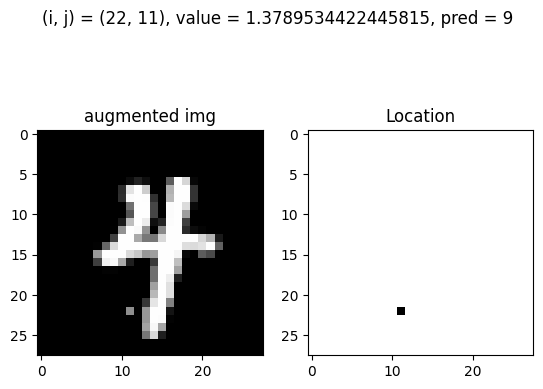

Test: At (i, j) = (22, 11) and value = 1.7395867142702586, pred = 9, before_pred = 4, gt = 4


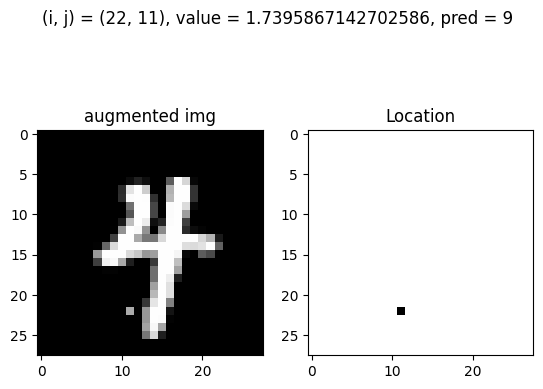

Test: At (i, j) = (22, 11) and value = 2.1002199862959356, pred = 9, before_pred = 4, gt = 4


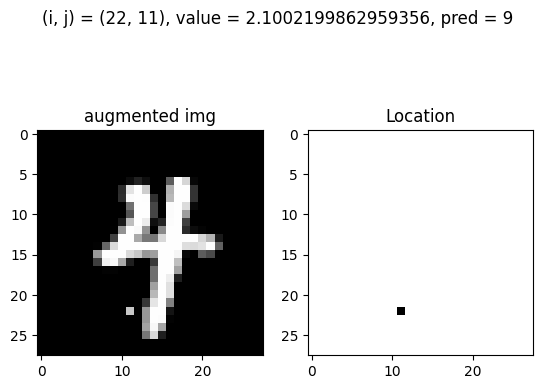

Test: At (i, j) = (22, 11) and value = 2.4608532583216127, pred = 9, before_pred = 4, gt = 4


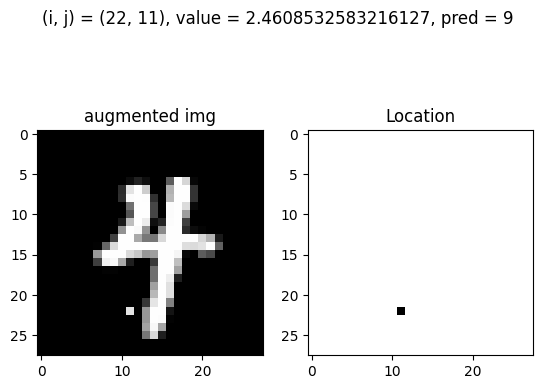

Test: At (i, j) = (22, 11) and value = 2.82148653034729, pred = 9, before_pred = 4, gt = 4


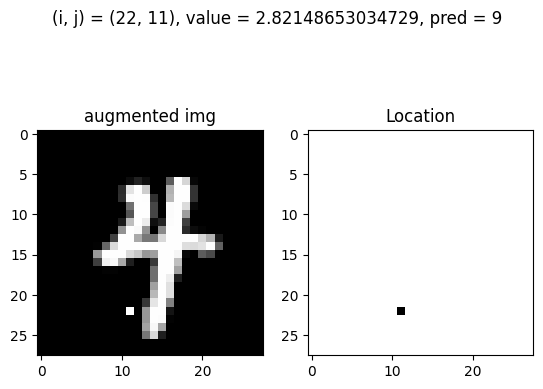

Test: At (i, j) = (22, 12) and value = 1.7395867142702586, pred = 9, before_pred = 4, gt = 4


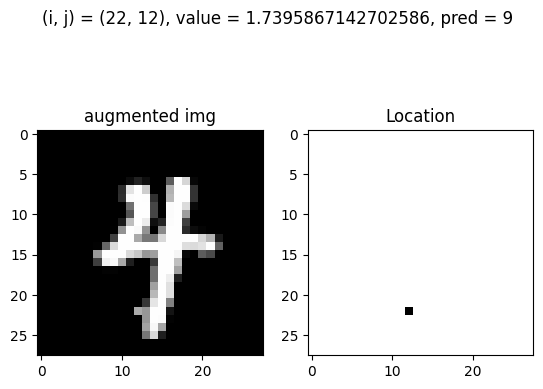

Test: At (i, j) = (22, 12) and value = 2.1002199862959356, pred = 9, before_pred = 4, gt = 4


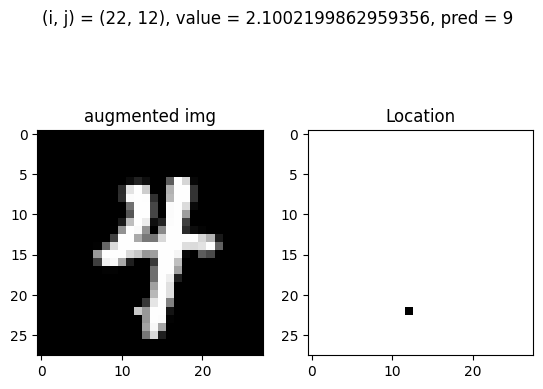

Test: At (i, j) = (22, 12) and value = 2.4608532583216127, pred = 9, before_pred = 4, gt = 4


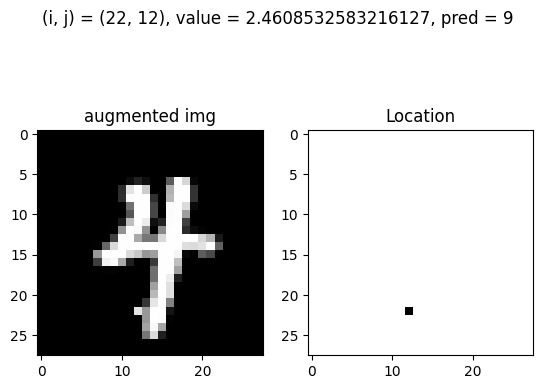

Test: At (i, j) = (22, 12) and value = 2.82148653034729, pred = 9, before_pred = 4, gt = 4


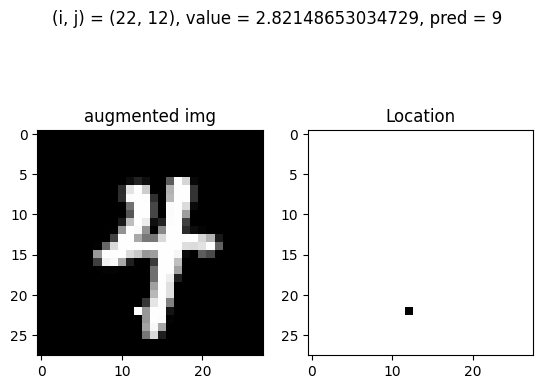

Test: At (i, j) = (22, 14) and value = -0.424212917883804, pred = 9, before_pred = 4, gt = 4


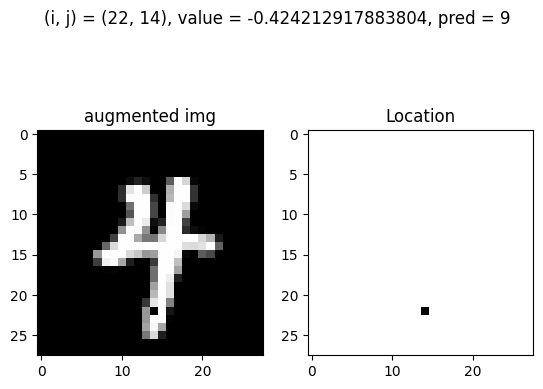

Test: At (i, j) = (22, 17) and value = 2.82148653034729, pred = 9, before_pred = 4, gt = 4


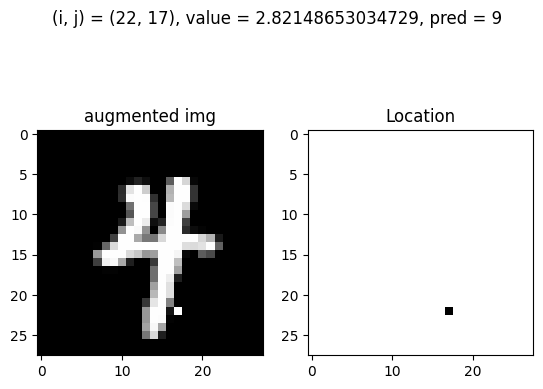

Test: At (i, j) = (23, 1) and value = 1.7395867142702586, pred = 9, before_pred = 4, gt = 4


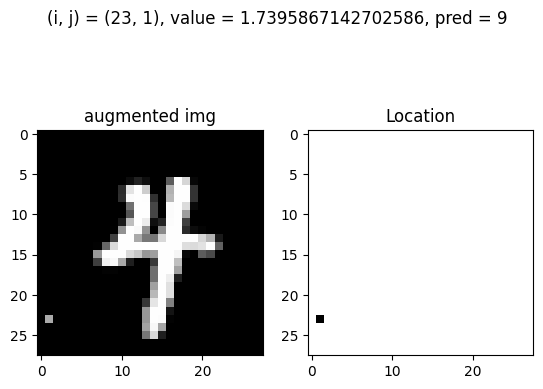

Test: At (i, j) = (23, 1) and value = 2.1002199862959356, pred = 9, before_pred = 4, gt = 4


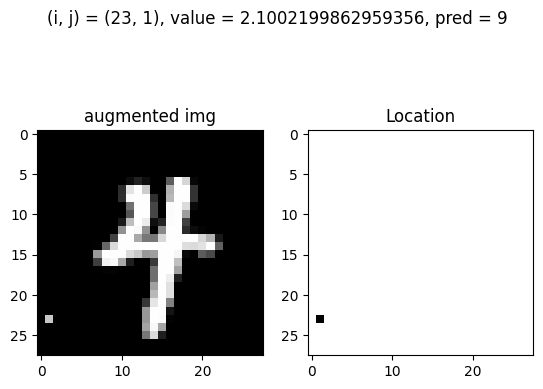

Test: At (i, j) = (23, 1) and value = 2.4608532583216127, pred = 9, before_pred = 4, gt = 4


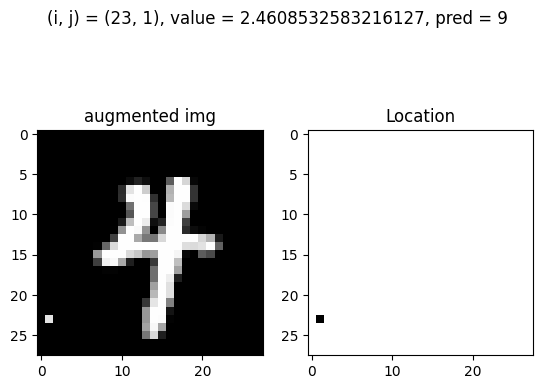

Test: At (i, j) = (23, 1) and value = 2.82148653034729, pred = 9, before_pred = 4, gt = 4


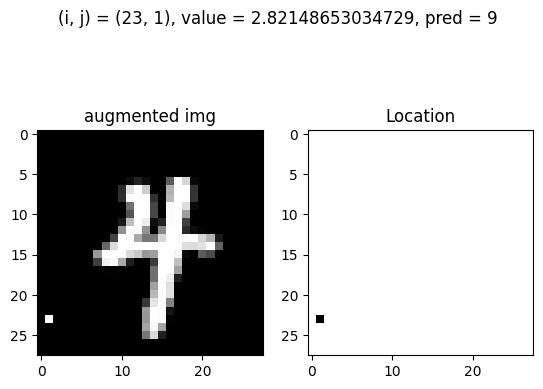

Test: At (i, j) = (23, 8) and value = 2.4608532583216127, pred = 9, before_pred = 4, gt = 4


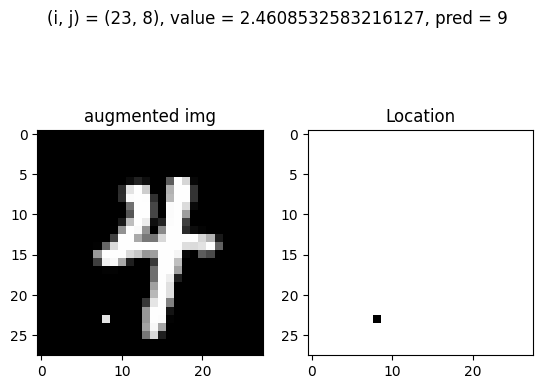

Test: At (i, j) = (23, 8) and value = 2.82148653034729, pred = 9, before_pred = 4, gt = 4


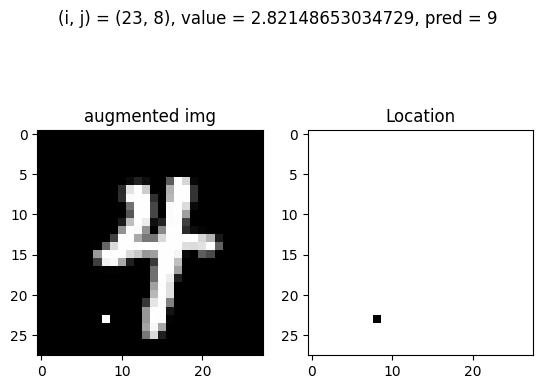

Test: At (i, j) = (23, 9) and value = 1.0183201702189044, pred = 9, before_pred = 4, gt = 4


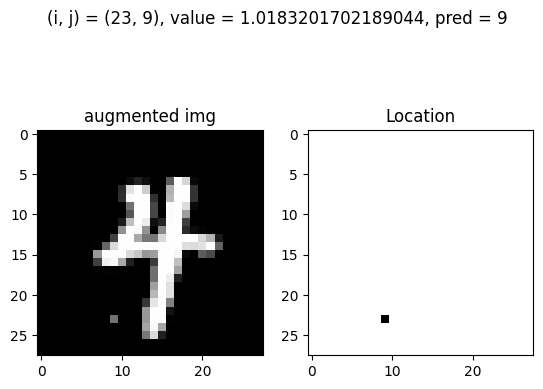

Test: At (i, j) = (23, 9) and value = 1.3789534422445815, pred = 9, before_pred = 4, gt = 4


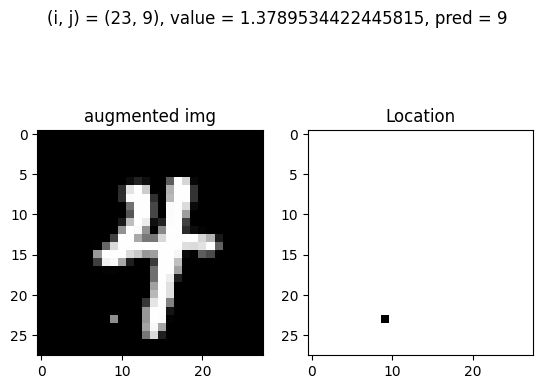

Test: At (i, j) = (23, 9) and value = 1.7395867142702586, pred = 9, before_pred = 4, gt = 4


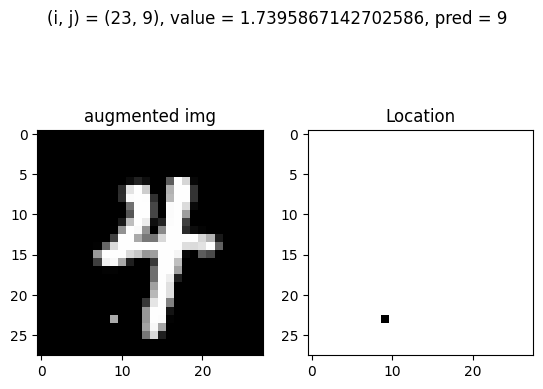

Test: At (i, j) = (23, 9) and value = 2.1002199862959356, pred = 9, before_pred = 4, gt = 4


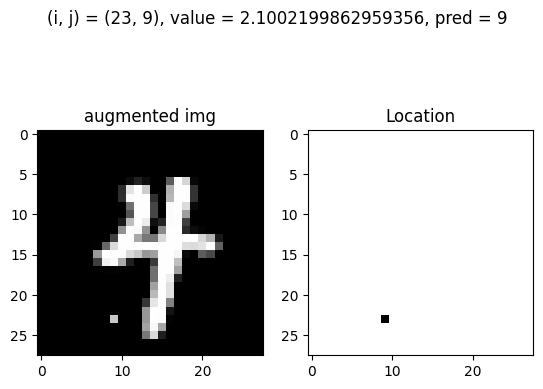

Test: At (i, j) = (23, 9) and value = 2.4608532583216127, pred = 9, before_pred = 4, gt = 4


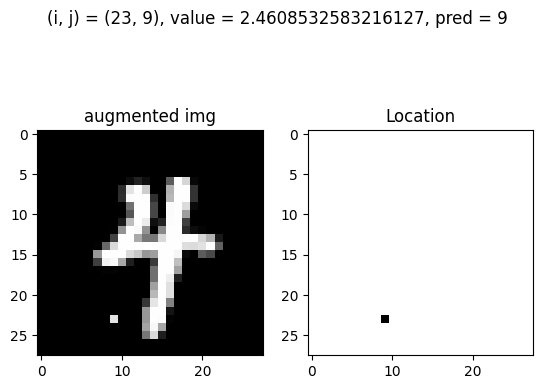

Test: At (i, j) = (23, 9) and value = 2.82148653034729, pred = 9, before_pred = 4, gt = 4


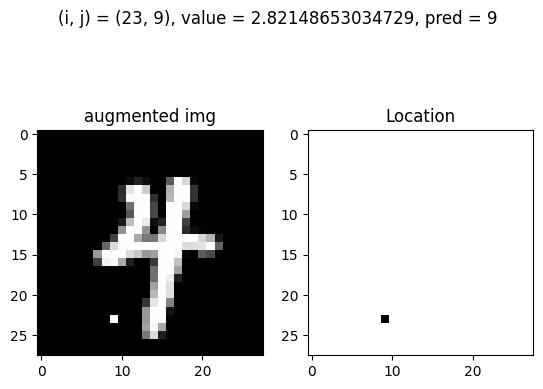

Test: At (i, j) = (23, 10) and value = 1.7395867142702586, pred = 9, before_pred = 4, gt = 4


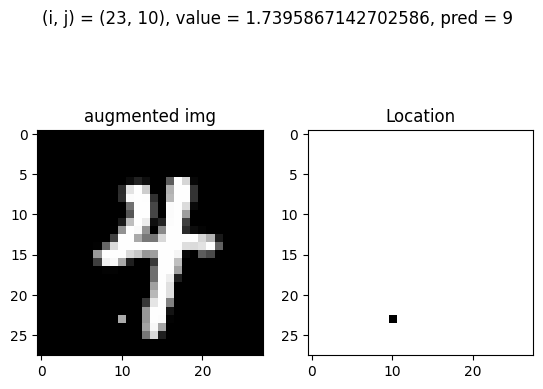

Test: At (i, j) = (23, 10) and value = 2.1002199862959356, pred = 9, before_pred = 4, gt = 4


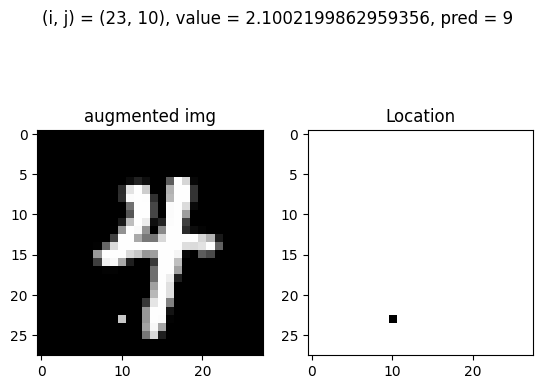

Test: At (i, j) = (23, 10) and value = 2.4608532583216127, pred = 9, before_pred = 4, gt = 4


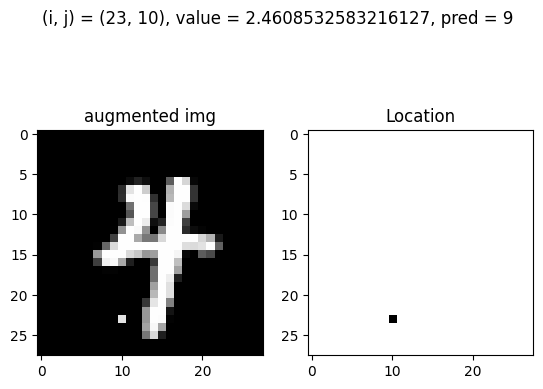

Test: At (i, j) = (23, 10) and value = 2.82148653034729, pred = 9, before_pred = 4, gt = 4


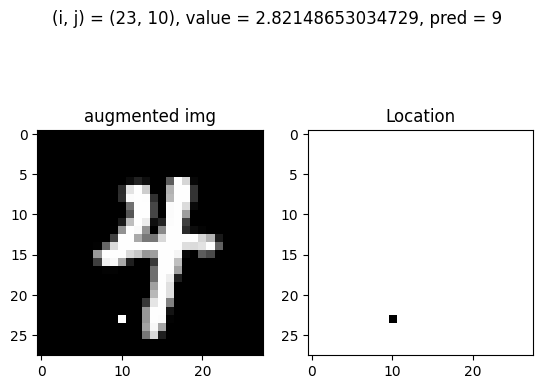

Test: At (i, j) = (23, 11) and value = 2.1002199862959356, pred = 9, before_pred = 4, gt = 4


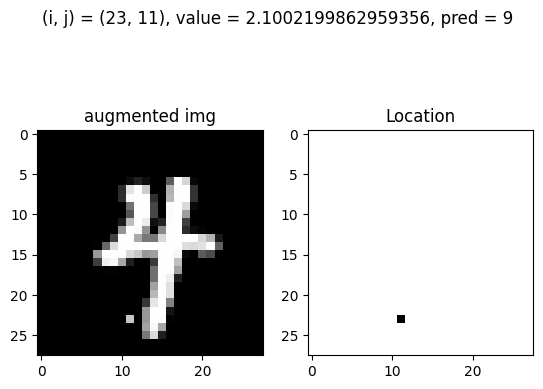

Test: At (i, j) = (23, 11) and value = 2.4608532583216127, pred = 9, before_pred = 4, gt = 4


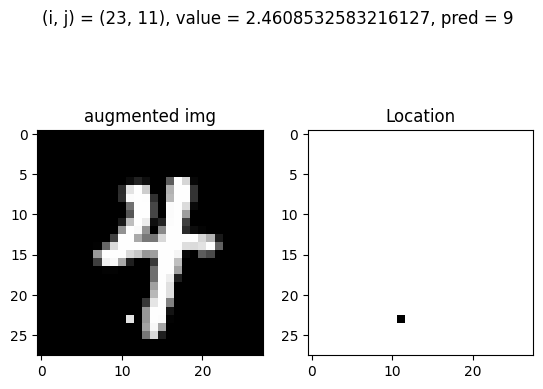

Test: At (i, j) = (23, 11) and value = 2.82148653034729, pred = 9, before_pred = 4, gt = 4


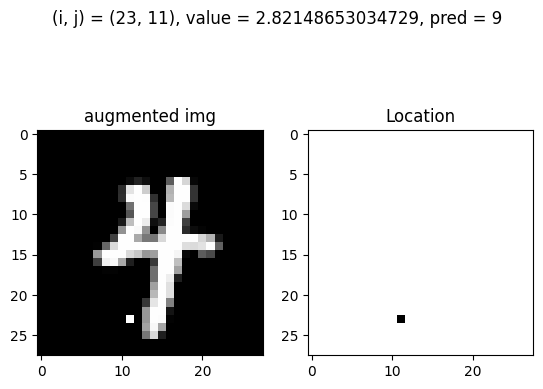

Test: At (i, j) = (23, 12) and value = 1.0183201702189044, pred = 9, before_pred = 4, gt = 4


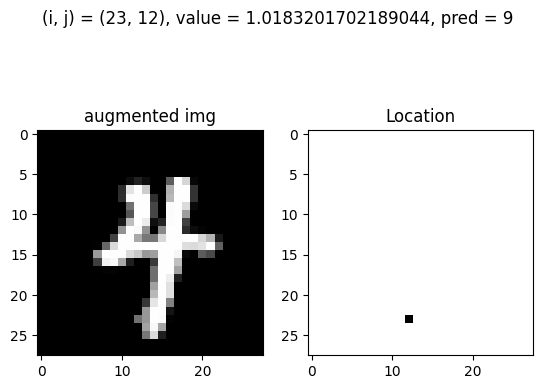

Test: At (i, j) = (23, 12) and value = 1.3789534422445815, pred = 9, before_pred = 4, gt = 4


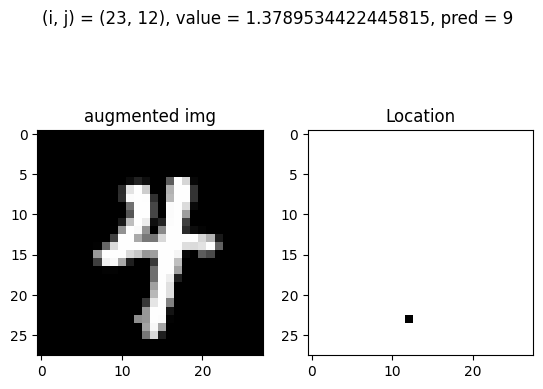

Test: At (i, j) = (23, 12) and value = 1.7395867142702586, pred = 9, before_pred = 4, gt = 4


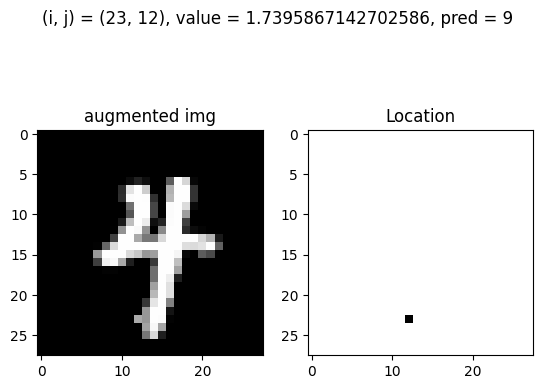

Test: At (i, j) = (23, 12) and value = 2.1002199862959356, pred = 9, before_pred = 4, gt = 4


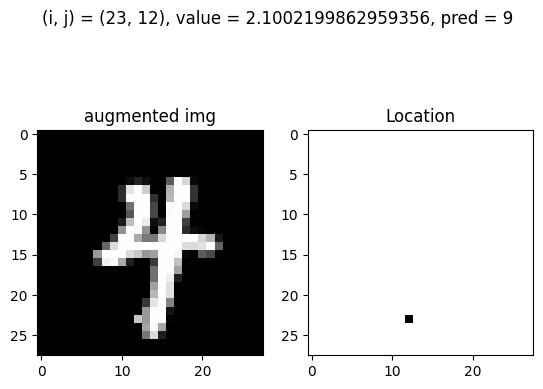

Test: At (i, j) = (23, 12) and value = 2.4608532583216127, pred = 9, before_pred = 4, gt = 4


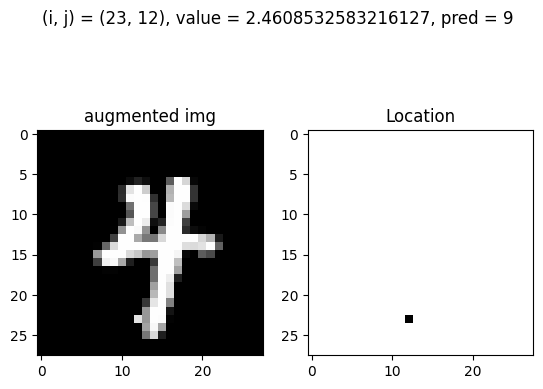

Test: At (i, j) = (23, 12) and value = 2.82148653034729, pred = 9, before_pred = 4, gt = 4


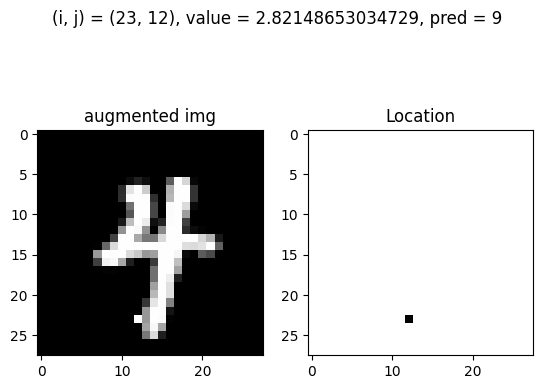

Test: At (i, j) = (23, 27) and value = 2.82148653034729, pred = 9, before_pred = 4, gt = 4


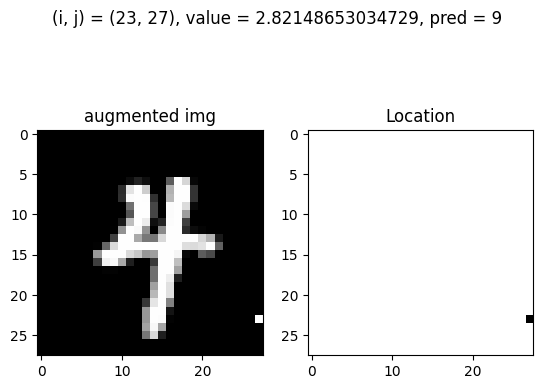

Test: At (i, j) = (24, 0) and value = 2.82148653034729, pred = 9, before_pred = 4, gt = 4


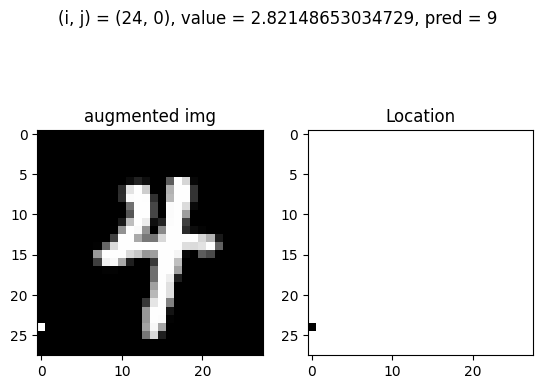

Test: At (i, j) = (24, 5) and value = 2.82148653034729, pred = 9, before_pred = 4, gt = 4


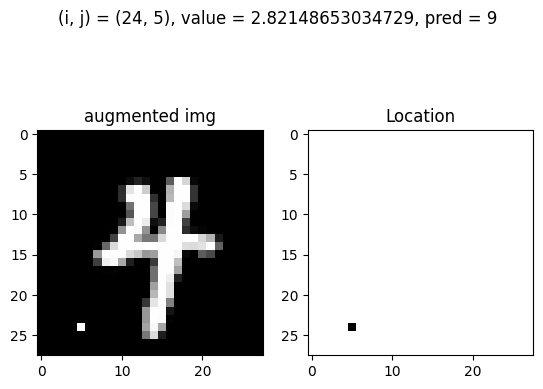

Test: At (i, j) = (24, 6) and value = 2.1002199862959356, pred = 9, before_pred = 4, gt = 4


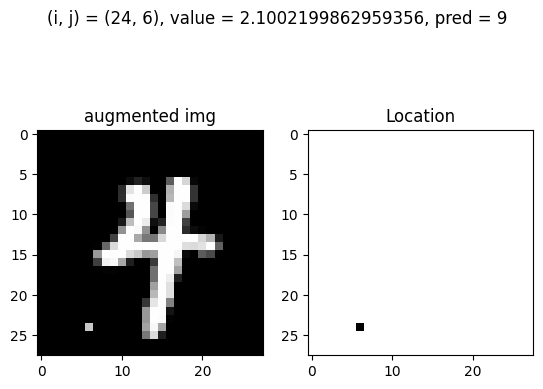

Test: At (i, j) = (24, 6) and value = 2.4608532583216127, pred = 9, before_pred = 4, gt = 4


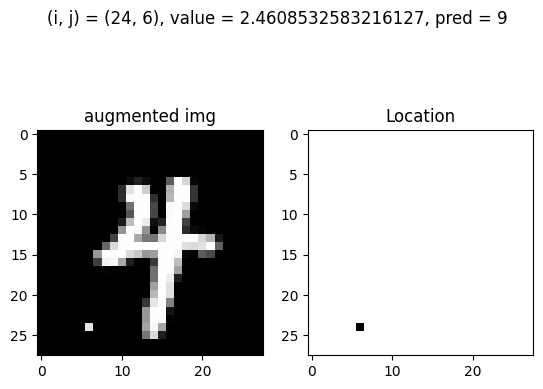

Test: At (i, j) = (24, 6) and value = 2.82148653034729, pred = 9, before_pred = 4, gt = 4


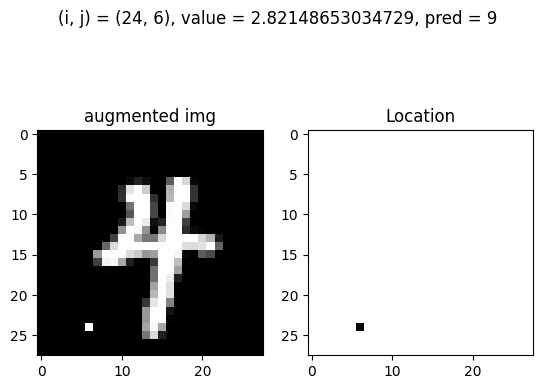

Test: At (i, j) = (24, 7) and value = 1.0183201702189044, pred = 9, before_pred = 4, gt = 4


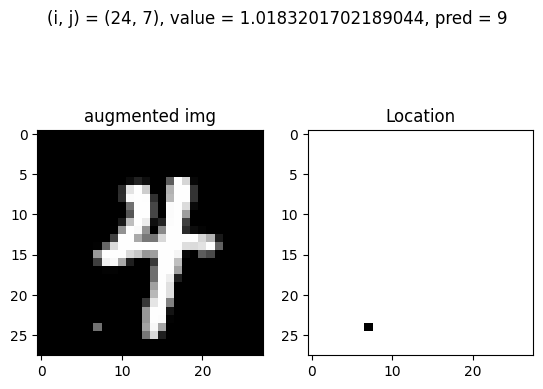

Test: At (i, j) = (24, 7) and value = 1.3789534422445815, pred = 9, before_pred = 4, gt = 4


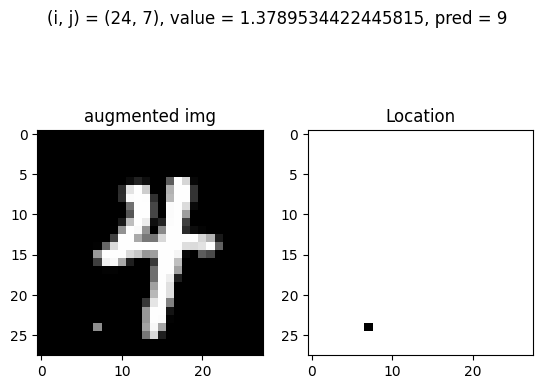

Test: At (i, j) = (24, 7) and value = 1.7395867142702586, pred = 9, before_pred = 4, gt = 4


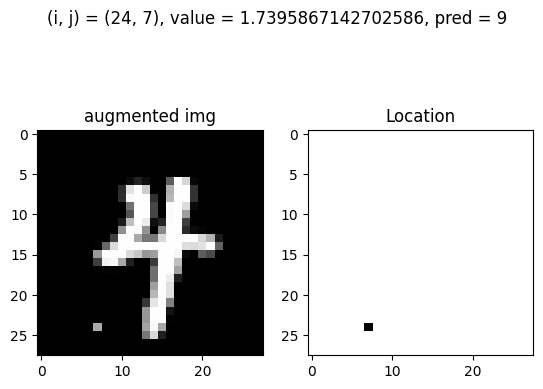

Test: At (i, j) = (24, 7) and value = 2.1002199862959356, pred = 9, before_pred = 4, gt = 4


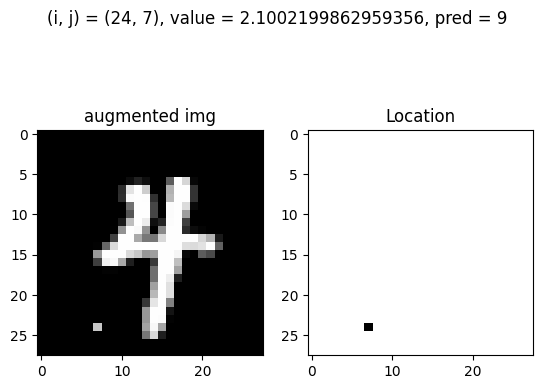

Test: At (i, j) = (24, 7) and value = 2.4608532583216127, pred = 9, before_pred = 4, gt = 4


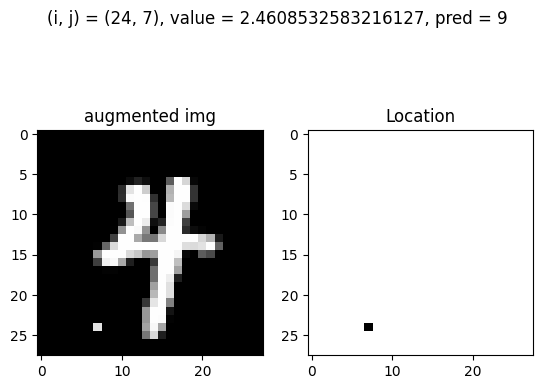

Test: At (i, j) = (24, 7) and value = 2.82148653034729, pred = 9, before_pred = 4, gt = 4


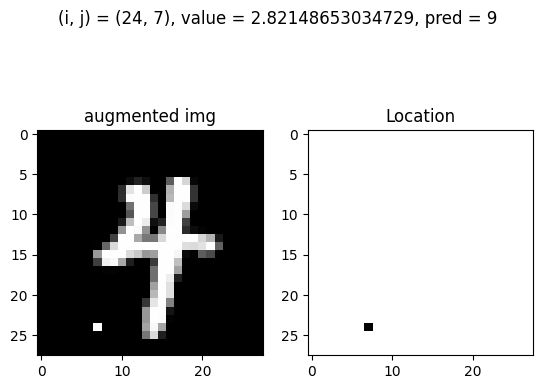

Test: At (i, j) = (24, 8) and value = 1.3789534422445815, pred = 9, before_pred = 4, gt = 4


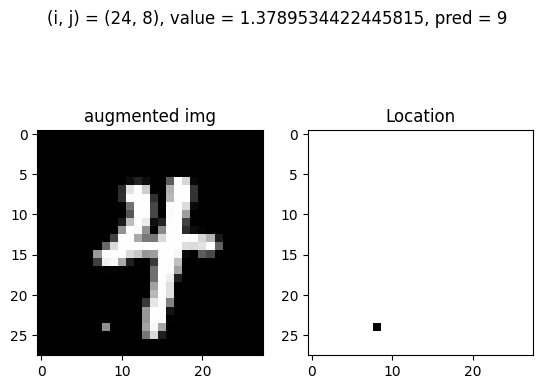

Test: At (i, j) = (24, 8) and value = 1.7395867142702586, pred = 9, before_pred = 4, gt = 4


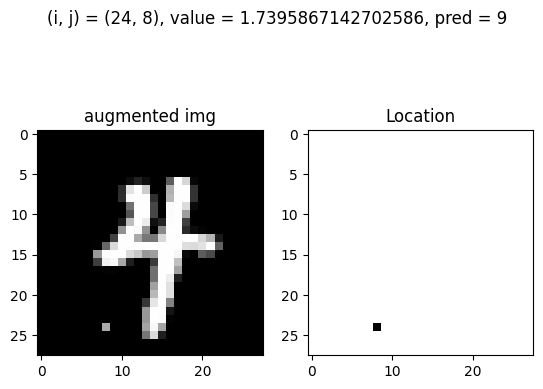

Test: At (i, j) = (24, 8) and value = 2.1002199862959356, pred = 9, before_pred = 4, gt = 4


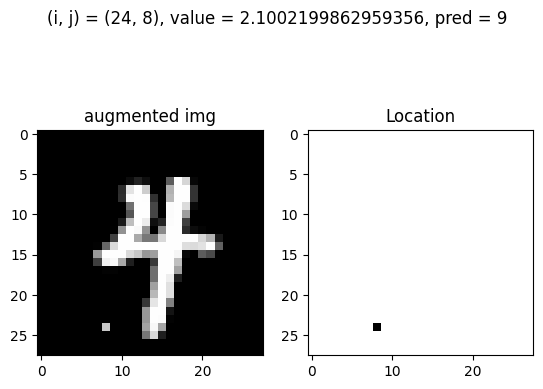

Test: At (i, j) = (24, 8) and value = 2.4608532583216127, pred = 9, before_pred = 4, gt = 4


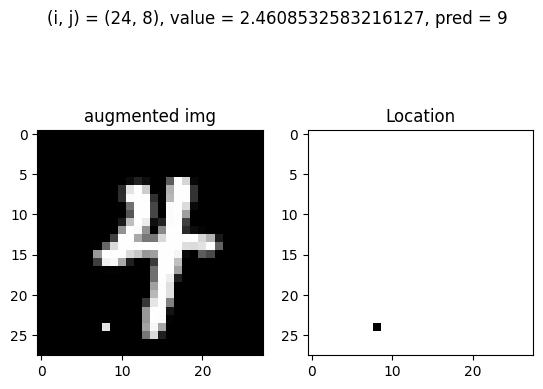

Test: At (i, j) = (24, 8) and value = 2.82148653034729, pred = 9, before_pred = 4, gt = 4


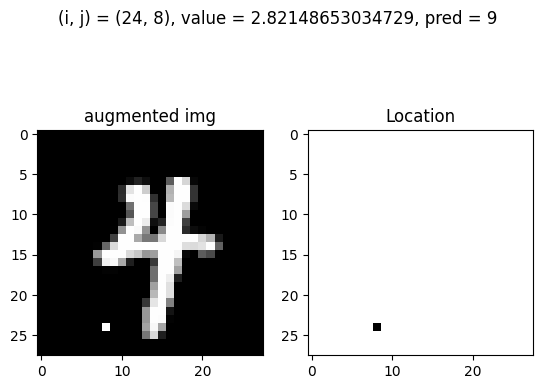

Test: At (i, j) = (24, 9) and value = 1.0183201702189044, pred = 9, before_pred = 4, gt = 4


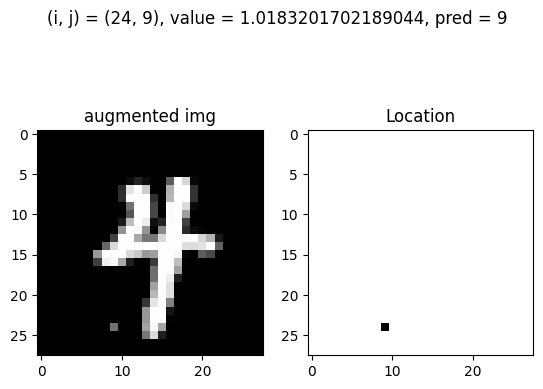

Test: At (i, j) = (24, 9) and value = 1.3789534422445815, pred = 9, before_pred = 4, gt = 4


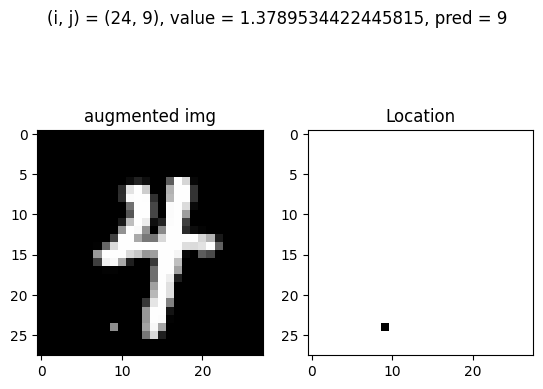

Test: At (i, j) = (24, 9) and value = 1.7395867142702586, pred = 9, before_pred = 4, gt = 4


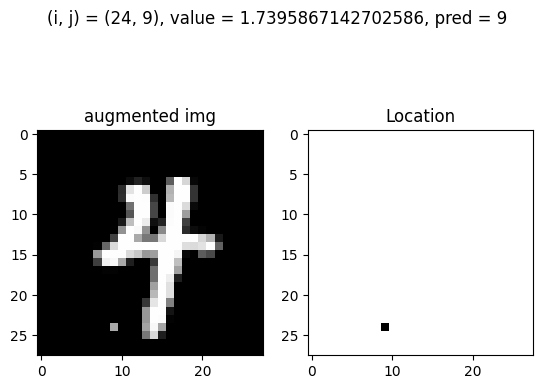

Test: At (i, j) = (24, 9) and value = 2.1002199862959356, pred = 9, before_pred = 4, gt = 4


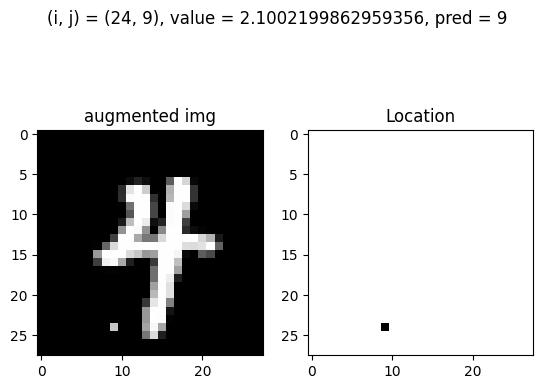

Test: At (i, j) = (24, 9) and value = 2.4608532583216127, pred = 9, before_pred = 4, gt = 4


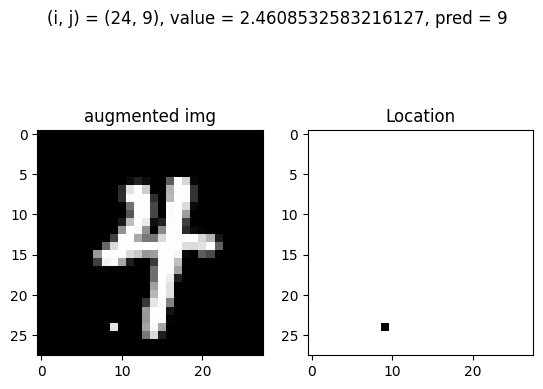

Test: At (i, j) = (24, 9) and value = 2.82148653034729, pred = 9, before_pred = 4, gt = 4


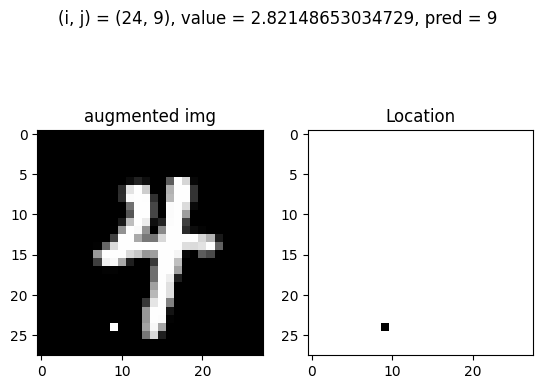

Test: At (i, j) = (24, 11) and value = 1.0183201702189044, pred = 9, before_pred = 4, gt = 4


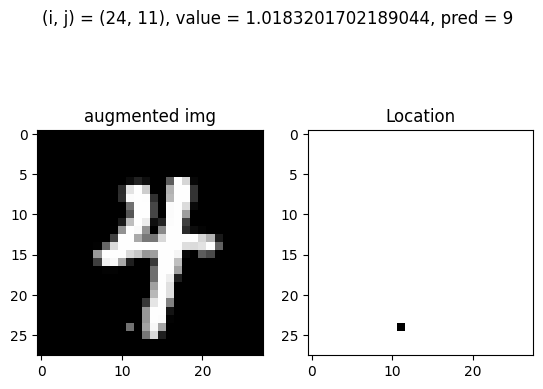

Test: At (i, j) = (24, 11) and value = 1.3789534422445815, pred = 9, before_pred = 4, gt = 4


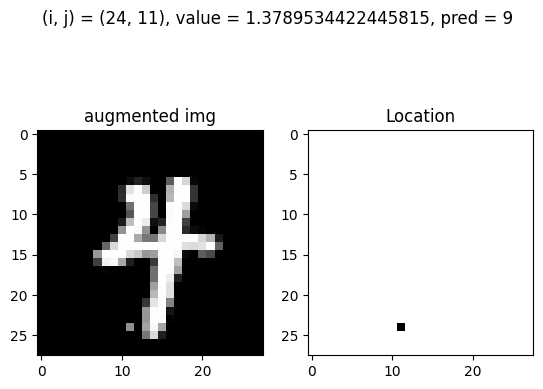

Test: At (i, j) = (24, 11) and value = 1.7395867142702586, pred = 9, before_pred = 4, gt = 4


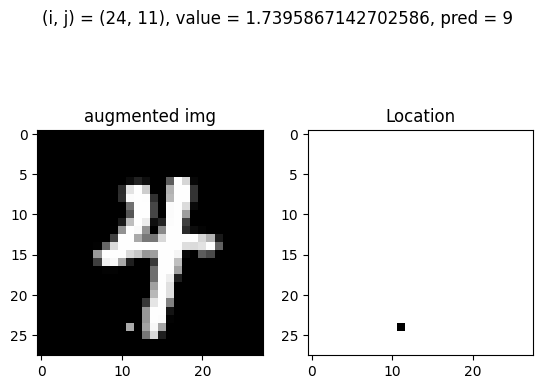

Test: At (i, j) = (24, 11) and value = 2.1002199862959356, pred = 9, before_pred = 4, gt = 4


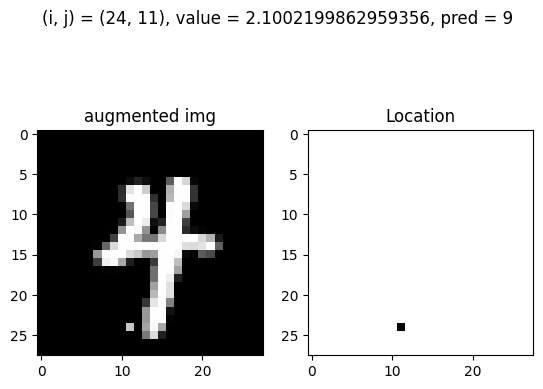

Test: At (i, j) = (24, 11) and value = 2.4608532583216127, pred = 9, before_pred = 4, gt = 4


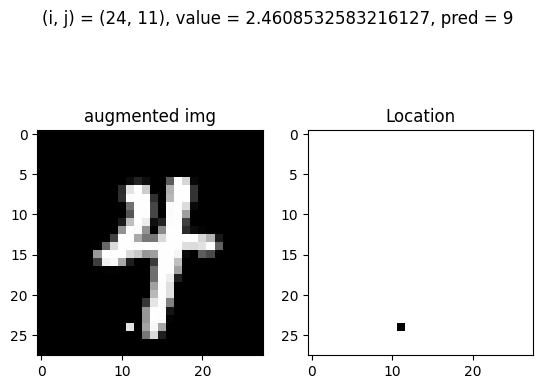

Test: At (i, j) = (24, 11) and value = 2.82148653034729, pred = 9, before_pred = 4, gt = 4


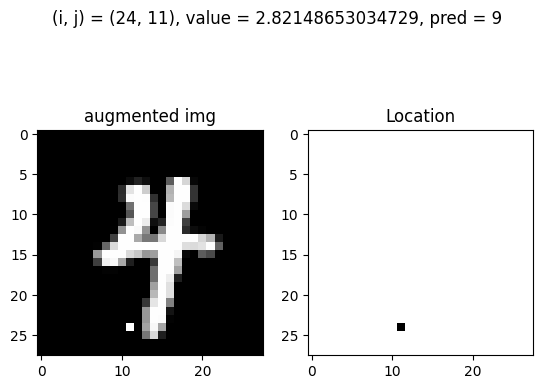

Test: At (i, j) = (24, 12) and value = 1.3789534422445815, pred = 9, before_pred = 4, gt = 4


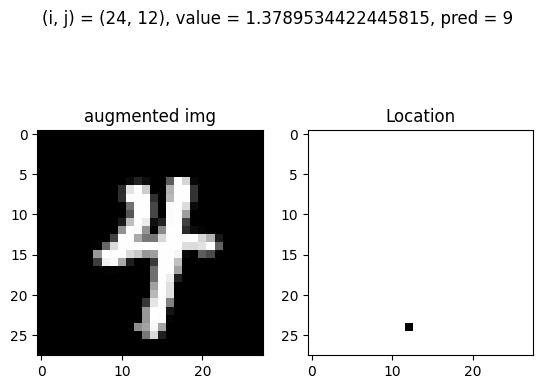

Test: At (i, j) = (24, 12) and value = 1.7395867142702586, pred = 9, before_pred = 4, gt = 4


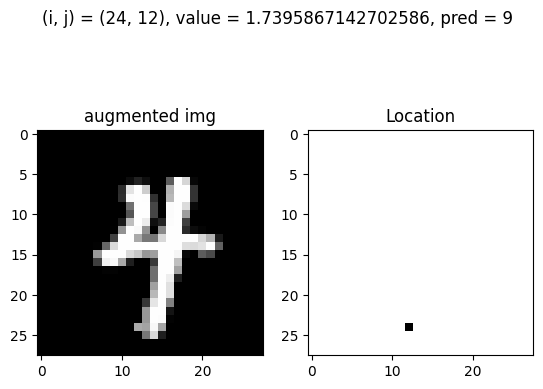

Test: At (i, j) = (24, 12) and value = 2.1002199862959356, pred = 9, before_pred = 4, gt = 4


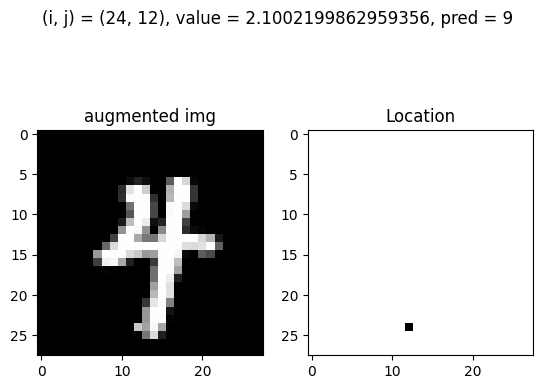

Test: At (i, j) = (24, 12) and value = 2.4608532583216127, pred = 9, before_pred = 4, gt = 4


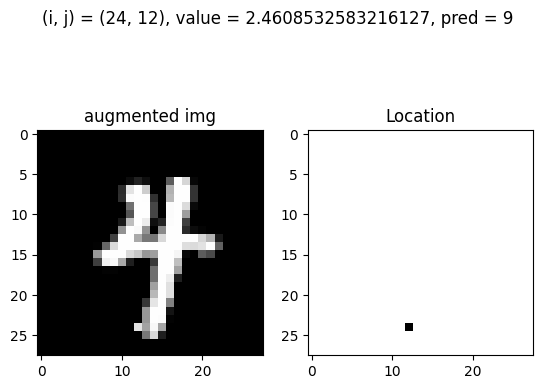

Test: At (i, j) = (24, 12) and value = 2.82148653034729, pred = 9, before_pred = 4, gt = 4


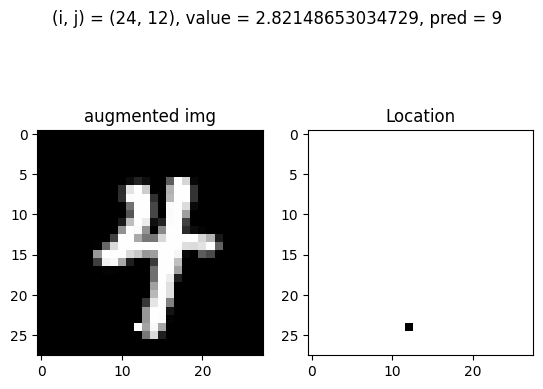

Test: At (i, j) = (24, 17) and value = 1.0183201702189044, pred = 9, before_pred = 4, gt = 4


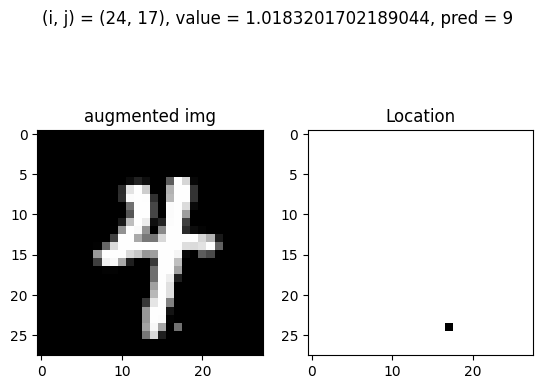

Test: At (i, j) = (24, 17) and value = 1.3789534422445815, pred = 9, before_pred = 4, gt = 4


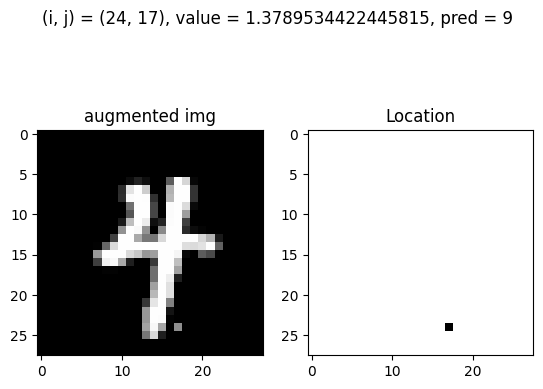

Test: At (i, j) = (24, 17) and value = 1.7395867142702586, pred = 9, before_pred = 4, gt = 4


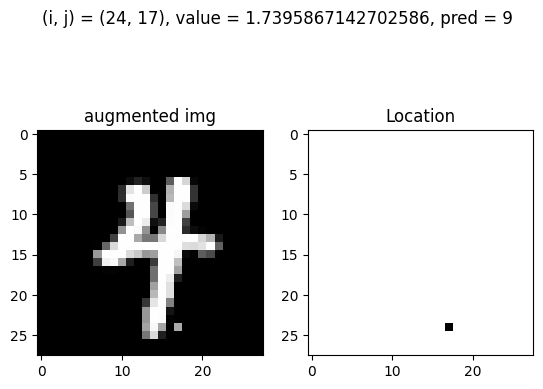

Test: At (i, j) = (24, 17) and value = 2.1002199862959356, pred = 9, before_pred = 4, gt = 4


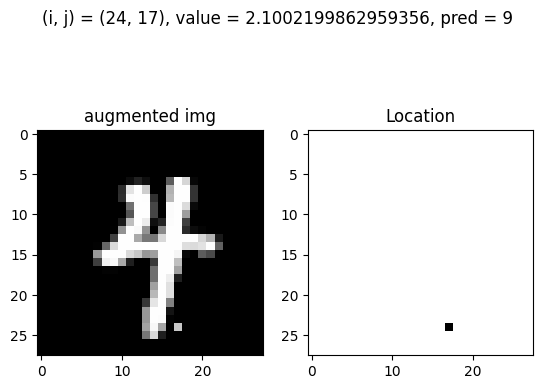

Test: At (i, j) = (24, 17) and value = 2.4608532583216127, pred = 9, before_pred = 4, gt = 4


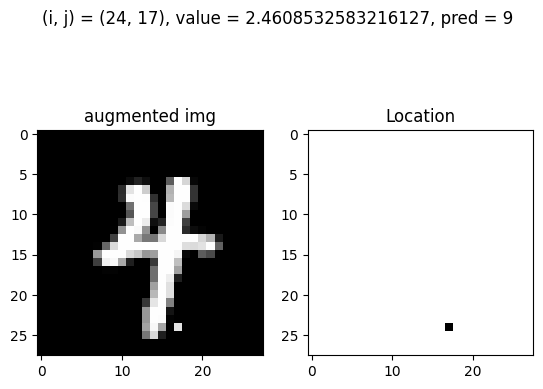

Test: At (i, j) = (24, 17) and value = 2.82148653034729, pred = 9, before_pred = 4, gt = 4


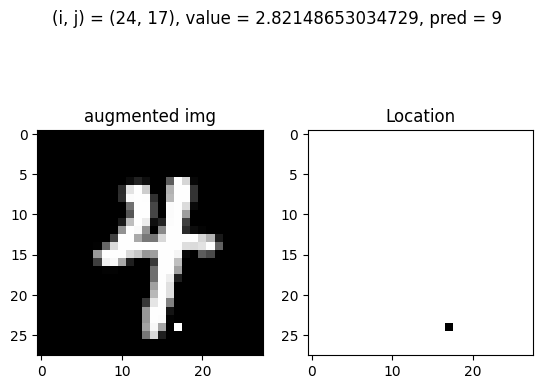

Test: At (i, j) = (24, 18) and value = 1.7395867142702586, pred = 9, before_pred = 4, gt = 4


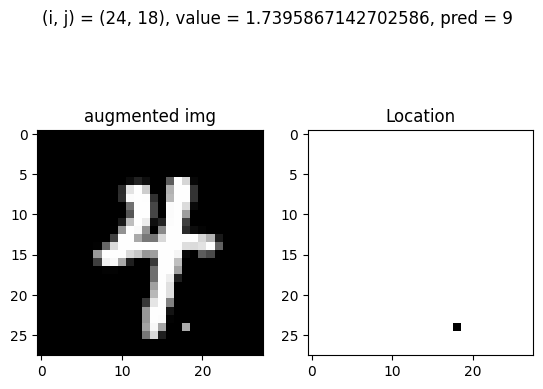

Test: At (i, j) = (24, 18) and value = 2.1002199862959356, pred = 9, before_pred = 4, gt = 4


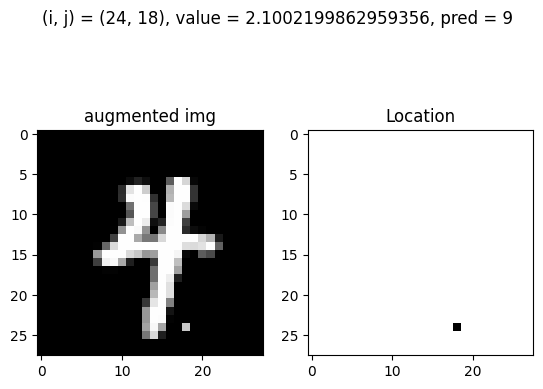

Test: At (i, j) = (24, 18) and value = 2.4608532583216127, pred = 9, before_pred = 4, gt = 4


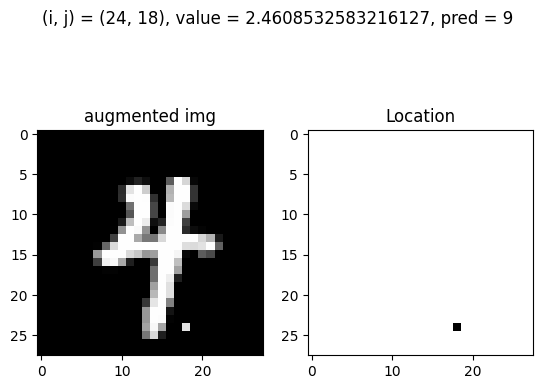

Test: At (i, j) = (24, 18) and value = 2.82148653034729, pred = 9, before_pred = 4, gt = 4


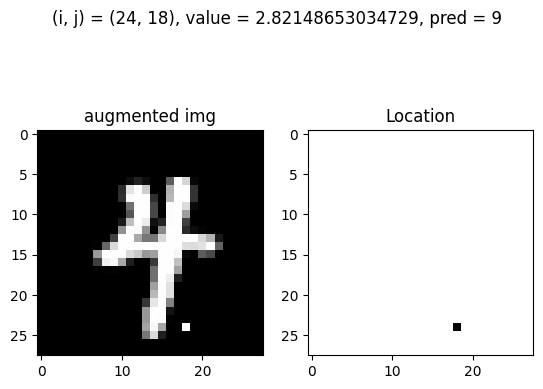

Test: At (i, j) = (24, 19) and value = 1.3789534422445815, pred = 9, before_pred = 4, gt = 4


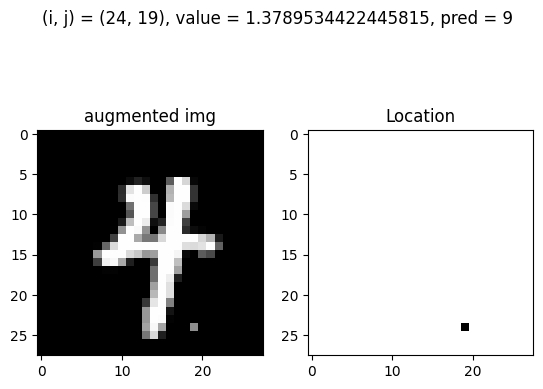

Test: At (i, j) = (24, 19) and value = 1.7395867142702586, pred = 9, before_pred = 4, gt = 4


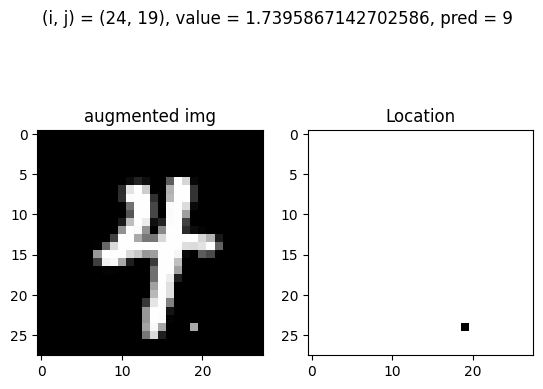

Test: At (i, j) = (24, 19) and value = 2.1002199862959356, pred = 9, before_pred = 4, gt = 4


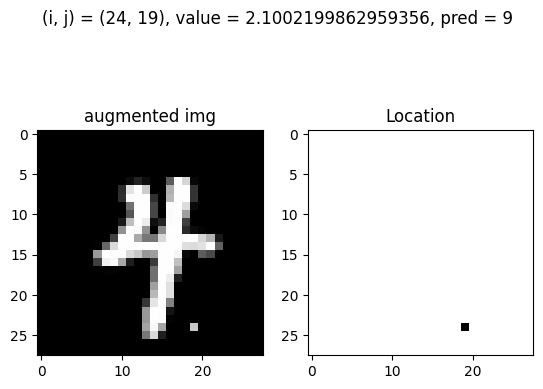

Test: At (i, j) = (24, 19) and value = 2.4608532583216127, pred = 9, before_pred = 4, gt = 4


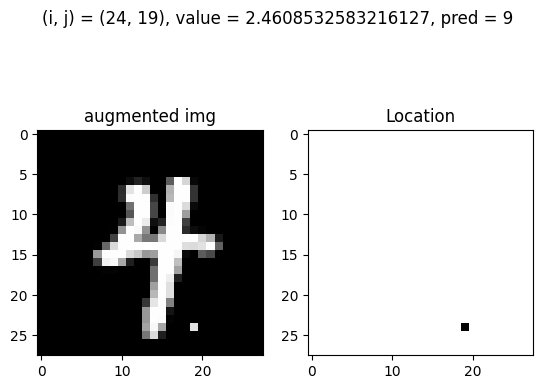

Test: At (i, j) = (24, 19) and value = 2.82148653034729, pred = 9, before_pred = 4, gt = 4


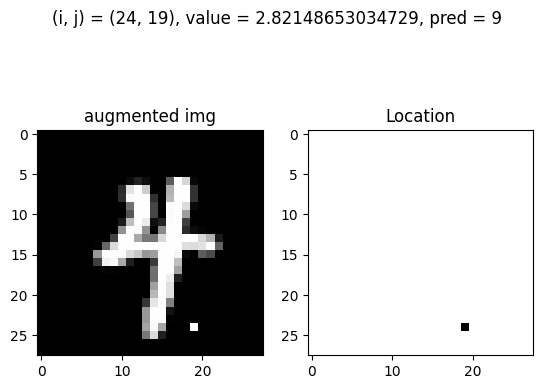

Test: At (i, j) = (24, 21) and value = 2.82148653034729, pred = 9, before_pred = 4, gt = 4


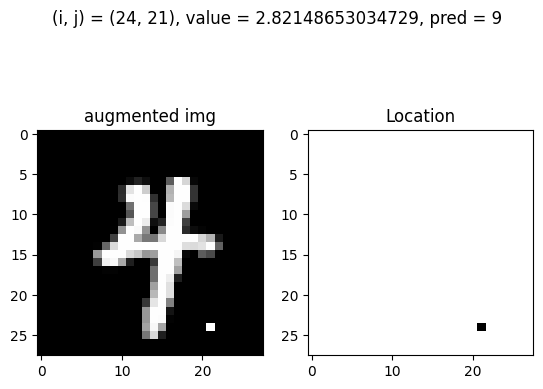

Test: At (i, j) = (25, 8) and value = 2.1002199862959356, pred = 9, before_pred = 4, gt = 4


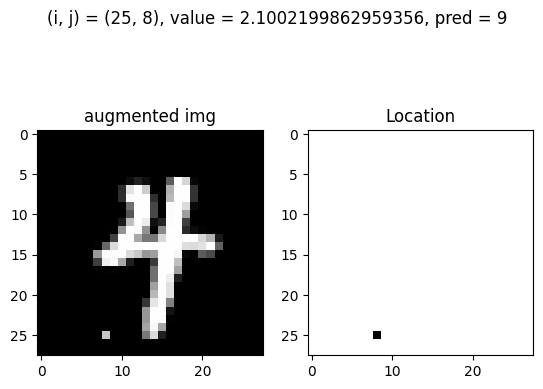

Test: At (i, j) = (25, 8) and value = 2.4608532583216127, pred = 9, before_pred = 4, gt = 4


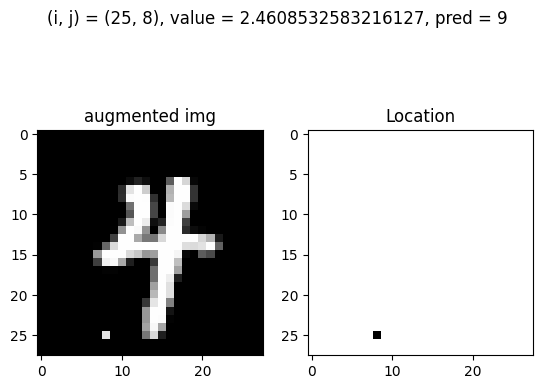

Test: At (i, j) = (25, 8) and value = 2.82148653034729, pred = 9, before_pred = 4, gt = 4


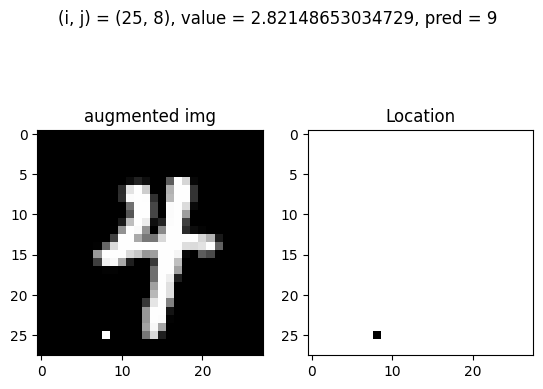

Test: At (i, j) = (25, 9) and value = 1.3789534422445815, pred = 9, before_pred = 4, gt = 4


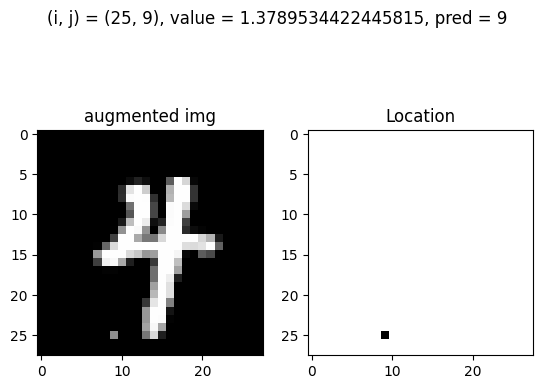

Test: At (i, j) = (25, 9) and value = 1.7395867142702586, pred = 9, before_pred = 4, gt = 4


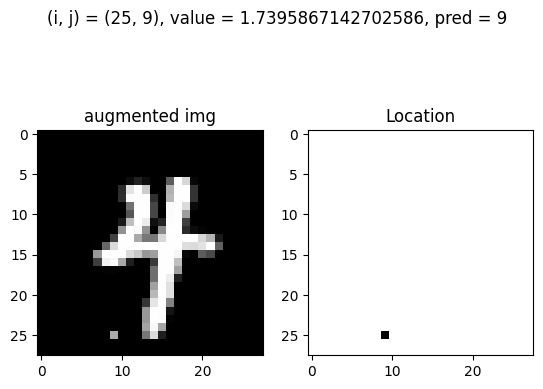

Test: At (i, j) = (25, 9) and value = 2.1002199862959356, pred = 9, before_pred = 4, gt = 4


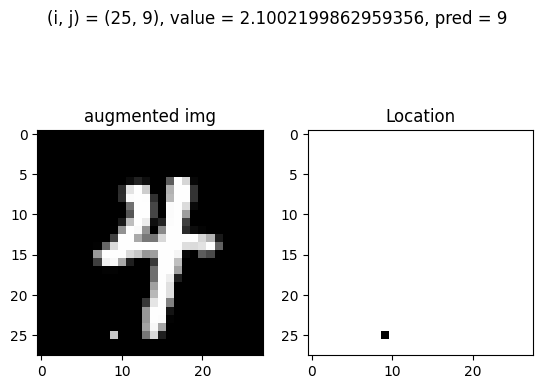

Test: At (i, j) = (25, 9) and value = 2.4608532583216127, pred = 9, before_pred = 4, gt = 4


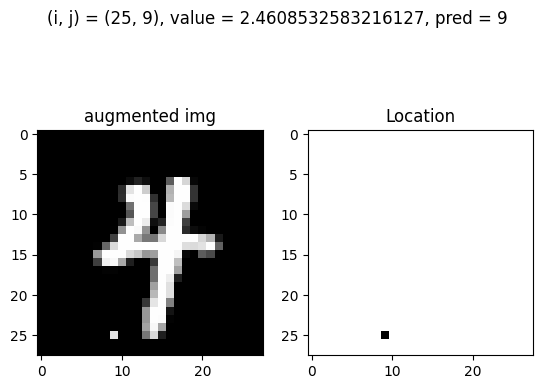

Test: At (i, j) = (25, 9) and value = 2.82148653034729, pred = 9, before_pred = 4, gt = 4


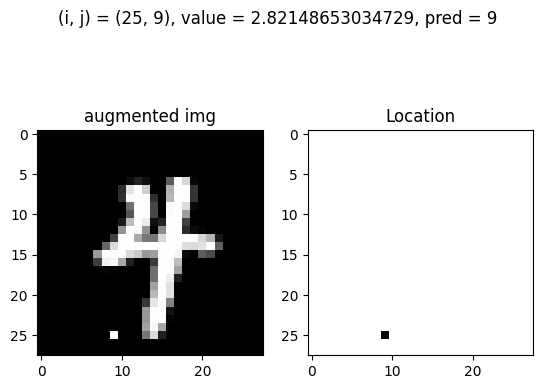

Test: At (i, j) = (25, 10) and value = 1.3789534422445815, pred = 9, before_pred = 4, gt = 4


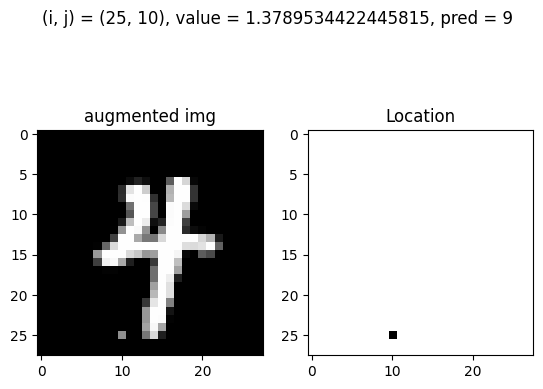

Test: At (i, j) = (25, 10) and value = 1.7395867142702586, pred = 9, before_pred = 4, gt = 4


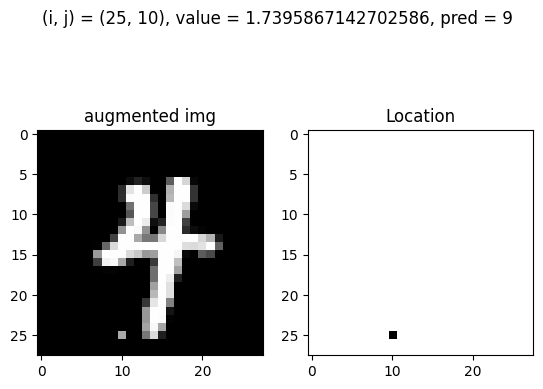

Test: At (i, j) = (25, 10) and value = 2.1002199862959356, pred = 9, before_pred = 4, gt = 4


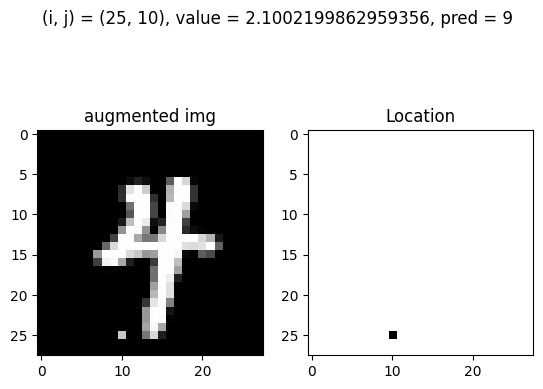

Test: At (i, j) = (25, 10) and value = 2.4608532583216127, pred = 9, before_pred = 4, gt = 4


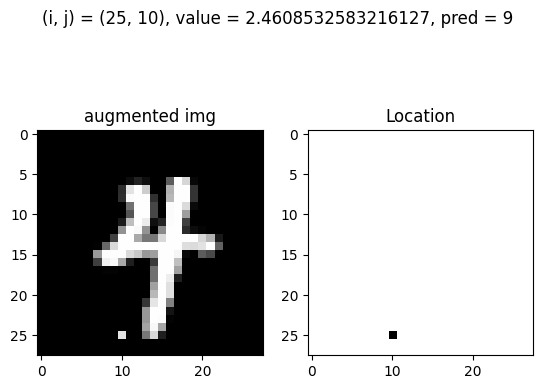

Test: At (i, j) = (25, 10) and value = 2.82148653034729, pred = 9, before_pred = 4, gt = 4


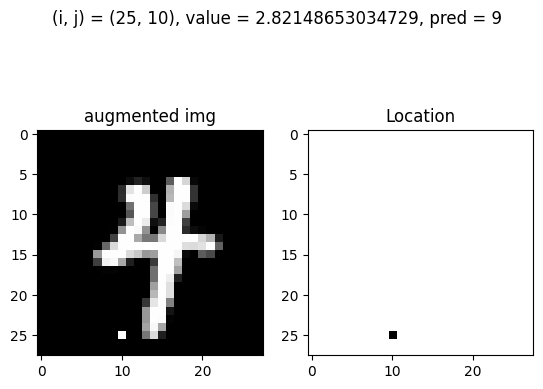

Test: At (i, j) = (25, 11) and value = 1.7395867142702586, pred = 9, before_pred = 4, gt = 4


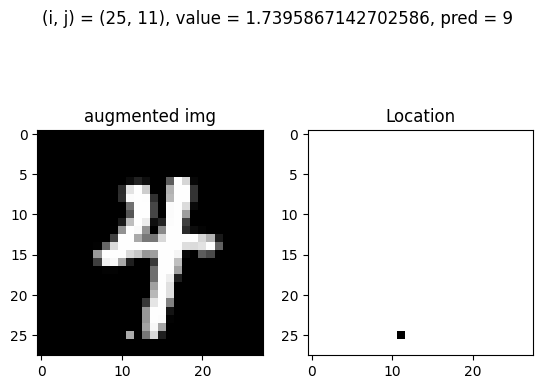

Test: At (i, j) = (25, 11) and value = 2.1002199862959356, pred = 9, before_pred = 4, gt = 4


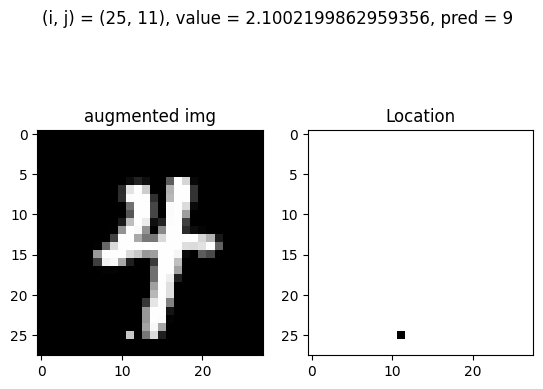

Test: At (i, j) = (25, 11) and value = 2.4608532583216127, pred = 9, before_pred = 4, gt = 4


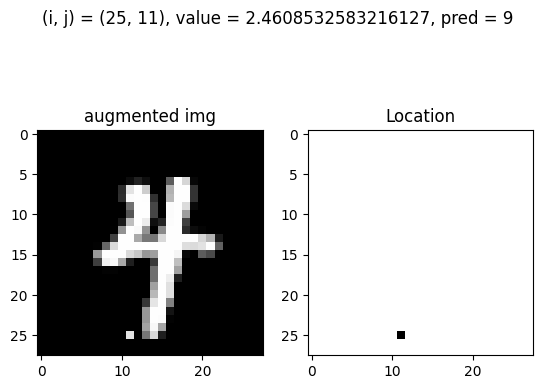

Test: At (i, j) = (25, 11) and value = 2.82148653034729, pred = 9, before_pred = 4, gt = 4


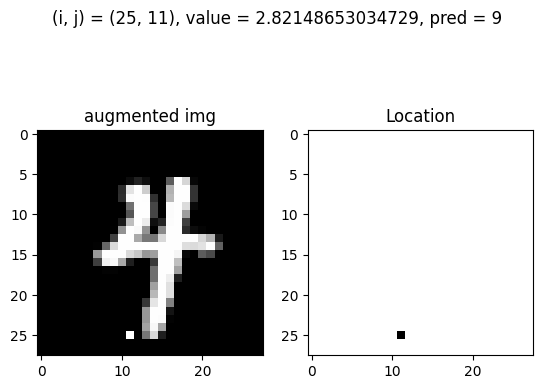

Test: At (i, j) = (25, 12) and value = 1.3789534422445815, pred = 9, before_pred = 4, gt = 4


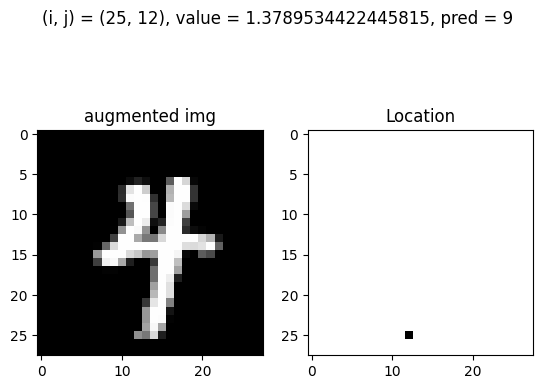

Test: At (i, j) = (25, 12) and value = 1.7395867142702586, pred = 9, before_pred = 4, gt = 4


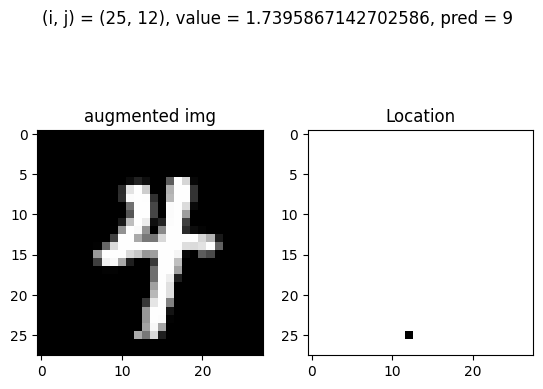

Test: At (i, j) = (25, 12) and value = 2.1002199862959356, pred = 9, before_pred = 4, gt = 4


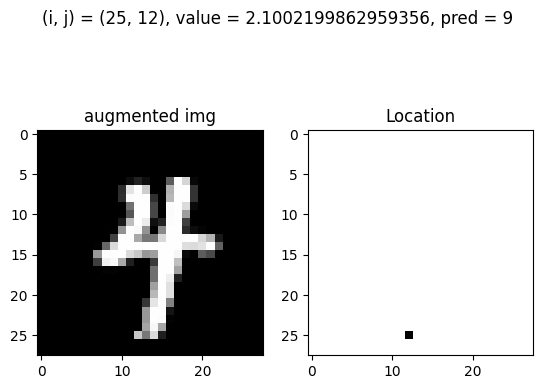

Test: At (i, j) = (25, 12) and value = 2.4608532583216127, pred = 9, before_pred = 4, gt = 4


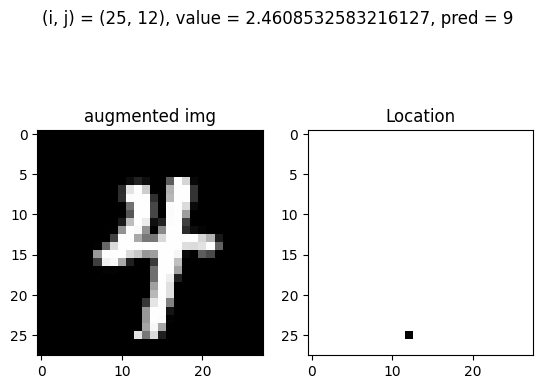

Test: At (i, j) = (25, 12) and value = 2.82148653034729, pred = 9, before_pred = 4, gt = 4


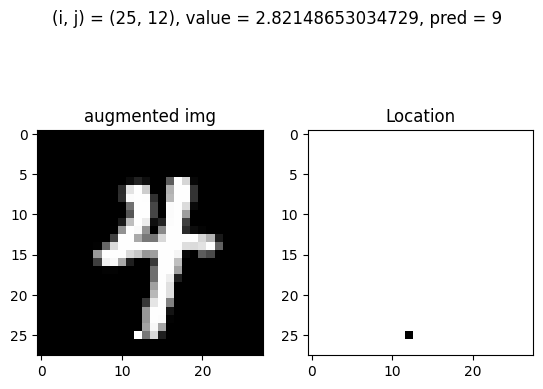

Test: At (i, j) = (25, 13) and value = 2.4608532583216127, pred = 9, before_pred = 4, gt = 4


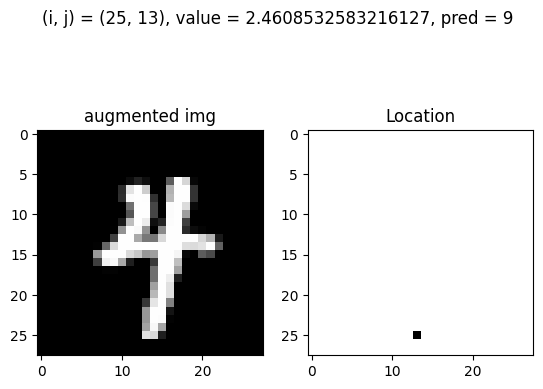

Test: At (i, j) = (25, 13) and value = 2.82148653034729, pred = 9, before_pred = 4, gt = 4


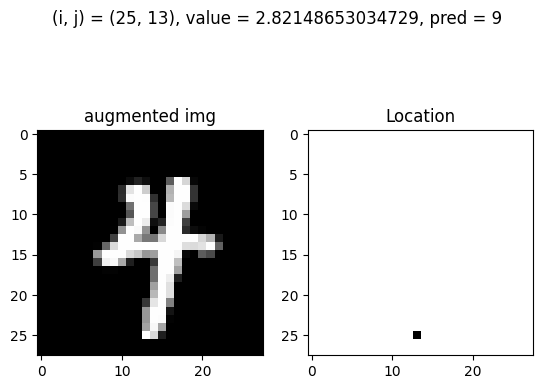

Test: At (i, j) = (25, 15) and value = 1.7395867142702586, pred = 9, before_pred = 4, gt = 4


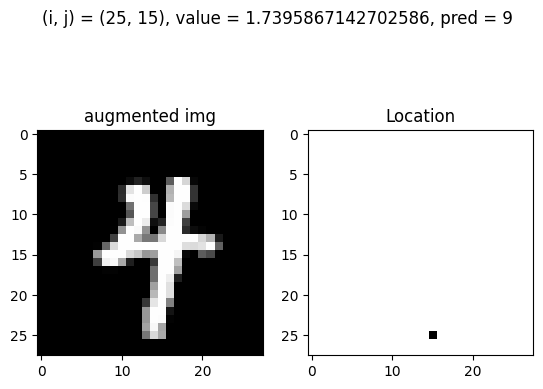

Test: At (i, j) = (25, 15) and value = 2.1002199862959356, pred = 9, before_pred = 4, gt = 4


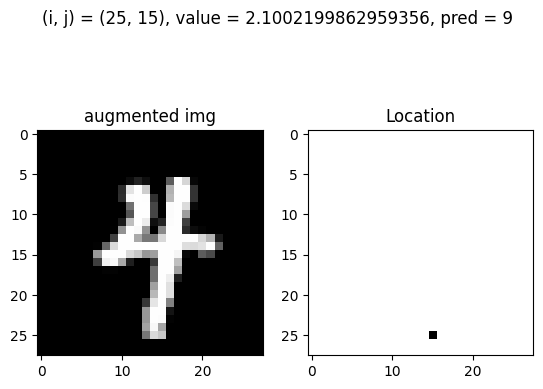

Test: At (i, j) = (25, 15) and value = 2.4608532583216127, pred = 9, before_pred = 4, gt = 4


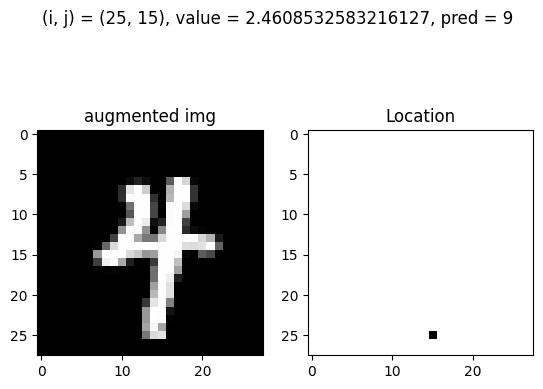

Test: At (i, j) = (25, 15) and value = 2.82148653034729, pred = 9, before_pred = 4, gt = 4


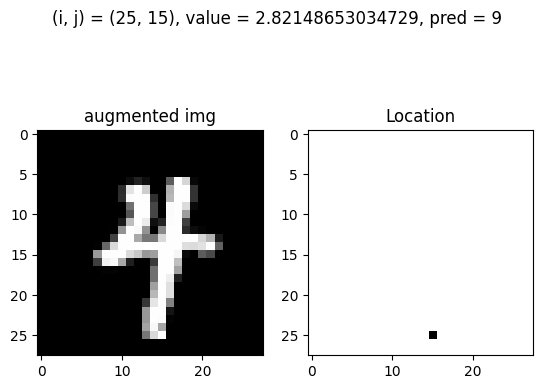

Test: At (i, j) = (25, 16) and value = 1.3789534422445815, pred = 9, before_pred = 4, gt = 4


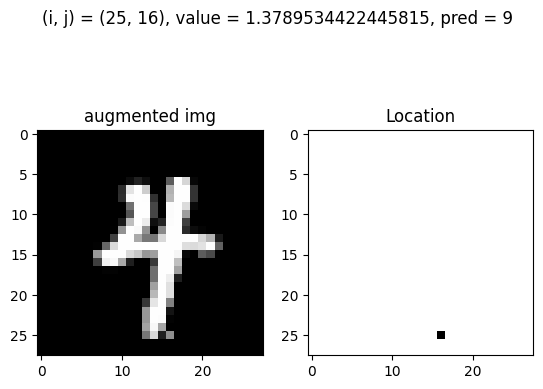

Test: At (i, j) = (25, 16) and value = 1.7395867142702586, pred = 9, before_pred = 4, gt = 4


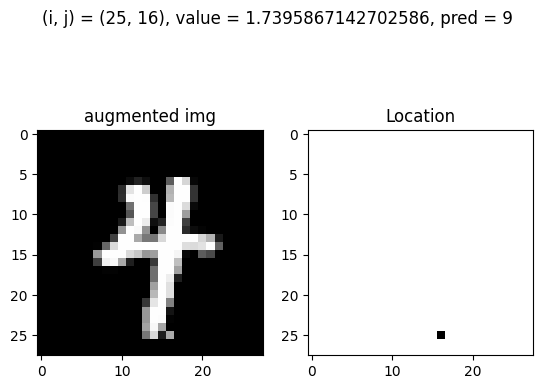

Test: At (i, j) = (25, 16) and value = 2.1002199862959356, pred = 9, before_pred = 4, gt = 4


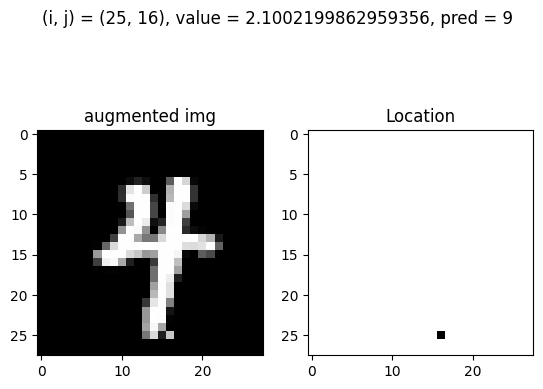

Test: At (i, j) = (25, 16) and value = 2.4608532583216127, pred = 9, before_pred = 4, gt = 4


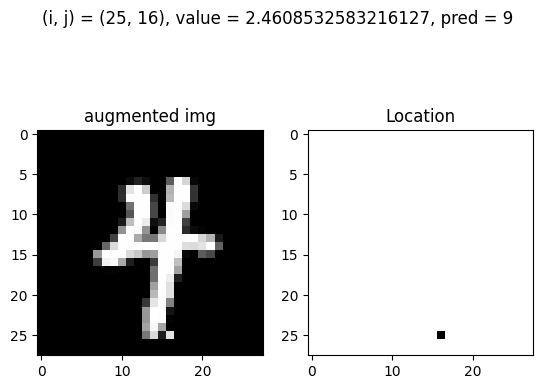

Test: At (i, j) = (25, 16) and value = 2.82148653034729, pred = 9, before_pred = 4, gt = 4


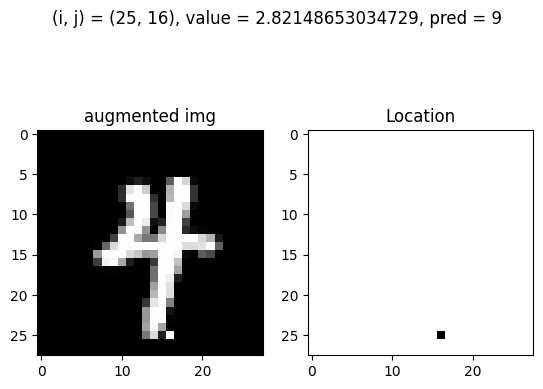

Test: At (i, j) = (25, 17) and value = 0.6576868981932272, pred = 9, before_pred = 4, gt = 4


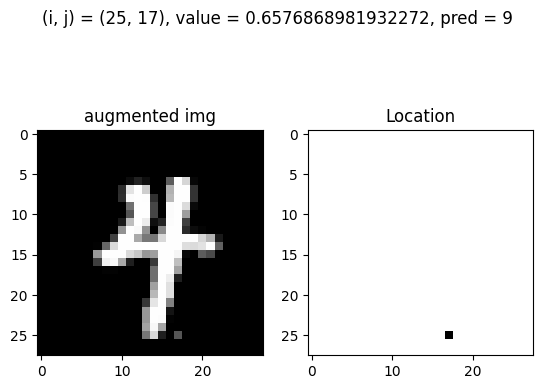

Test: At (i, j) = (25, 17) and value = 1.0183201702189044, pred = 9, before_pred = 4, gt = 4


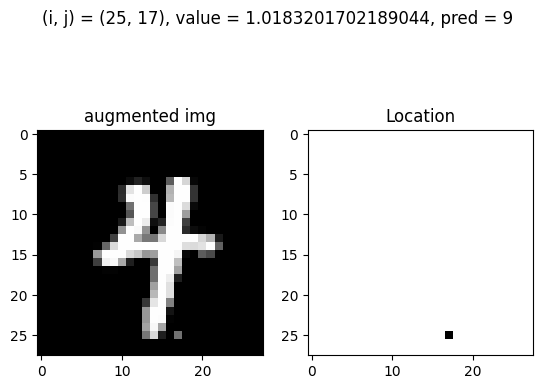

Test: At (i, j) = (25, 17) and value = 1.3789534422445815, pred = 9, before_pred = 4, gt = 4


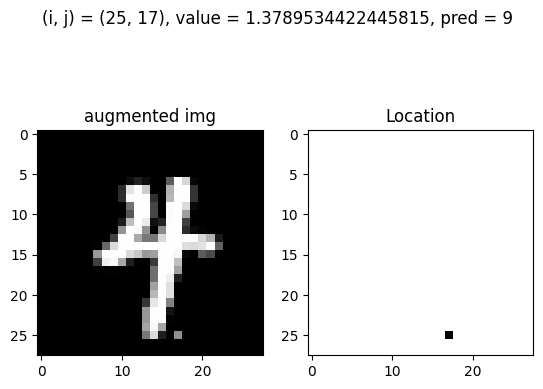

Test: At (i, j) = (25, 17) and value = 1.7395867142702586, pred = 9, before_pred = 4, gt = 4


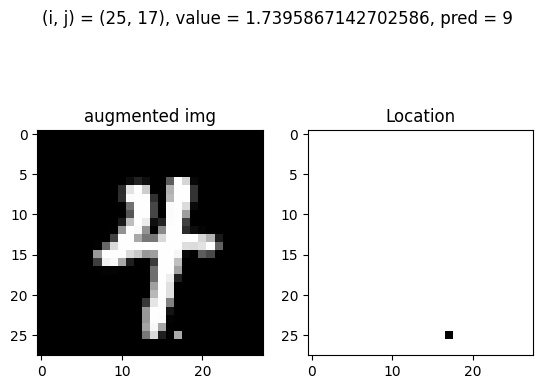

Test: At (i, j) = (25, 17) and value = 2.1002199862959356, pred = 9, before_pred = 4, gt = 4


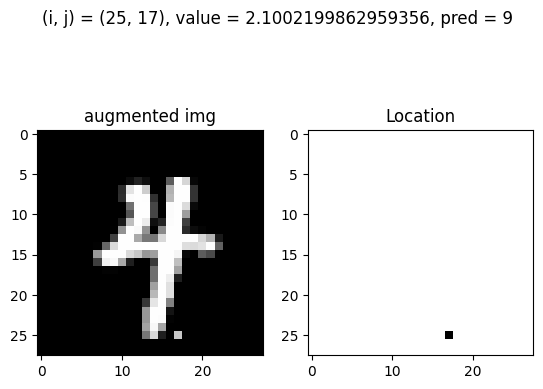

Test: At (i, j) = (25, 17) and value = 2.4608532583216127, pred = 9, before_pred = 4, gt = 4


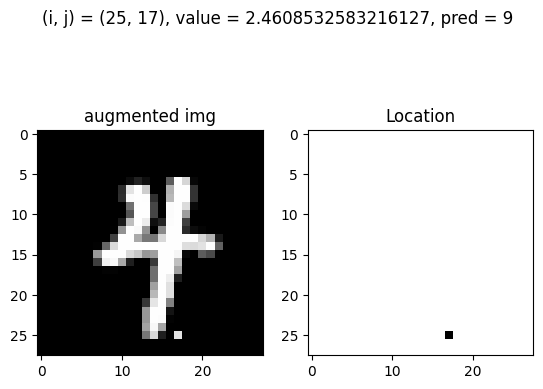

Test: At (i, j) = (25, 17) and value = 2.82148653034729, pred = 9, before_pred = 4, gt = 4


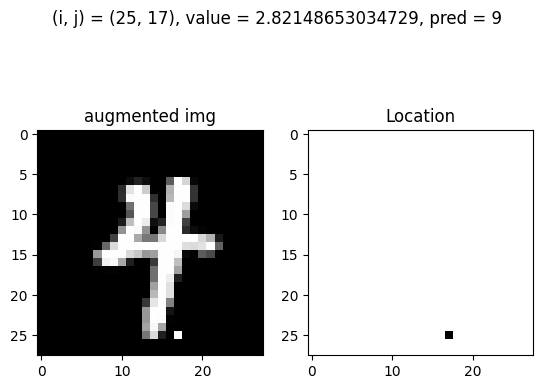

Test: At (i, j) = (25, 18) and value = 1.0183201702189044, pred = 9, before_pred = 4, gt = 4


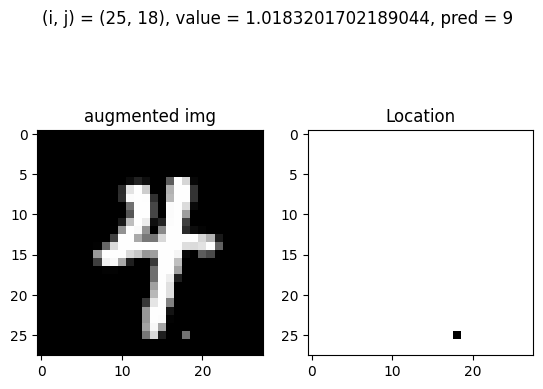

Test: At (i, j) = (25, 18) and value = 1.3789534422445815, pred = 9, before_pred = 4, gt = 4


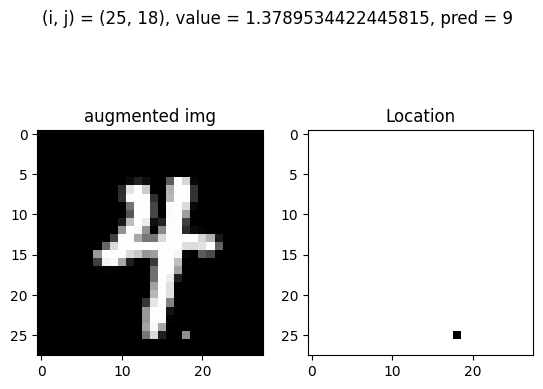

Test: At (i, j) = (25, 18) and value = 1.7395867142702586, pred = 9, before_pred = 4, gt = 4


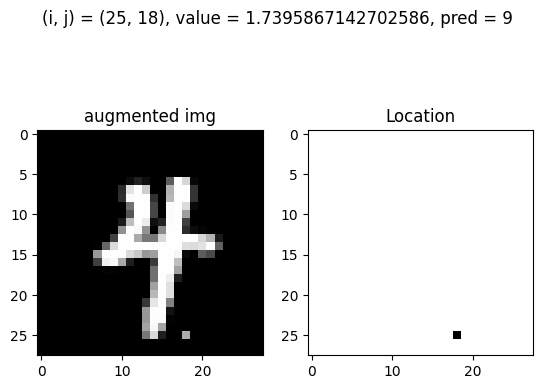

Test: At (i, j) = (25, 18) and value = 2.1002199862959356, pred = 9, before_pred = 4, gt = 4


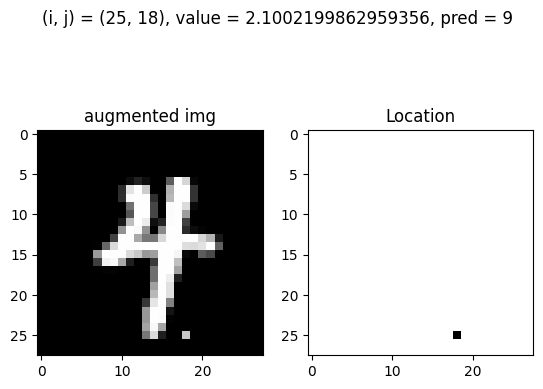

Test: At (i, j) = (25, 18) and value = 2.4608532583216127, pred = 9, before_pred = 4, gt = 4


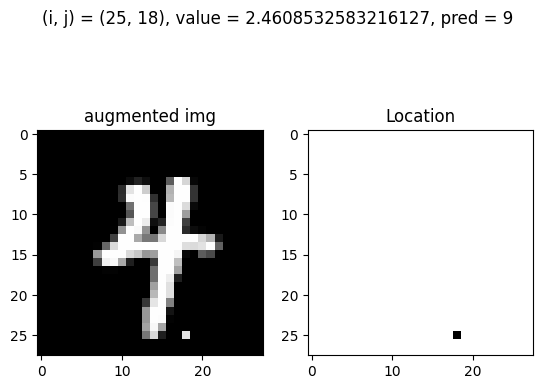

Test: At (i, j) = (25, 18) and value = 2.82148653034729, pred = 9, before_pred = 4, gt = 4


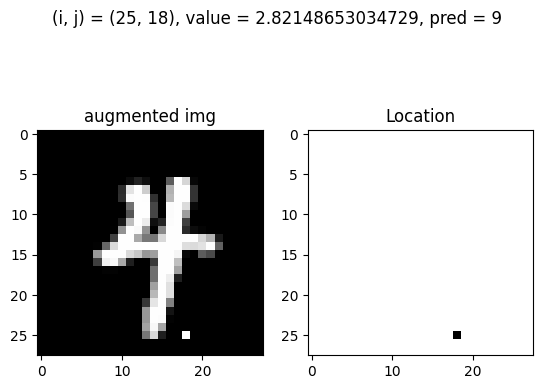

Test: At (i, j) = (25, 19) and value = 2.82148653034729, pred = 9, before_pred = 4, gt = 4


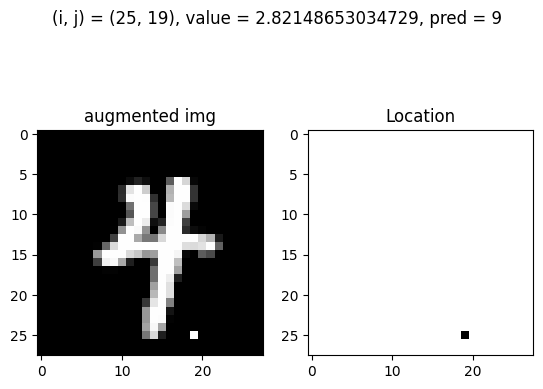

Test: At (i, j) = (25, 20) and value = 2.1002199862959356, pred = 9, before_pred = 4, gt = 4


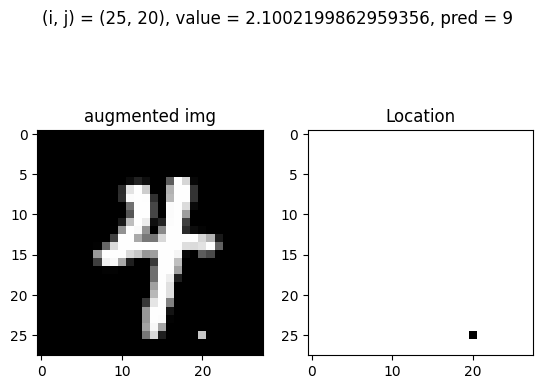

Test: At (i, j) = (25, 20) and value = 2.4608532583216127, pred = 9, before_pred = 4, gt = 4


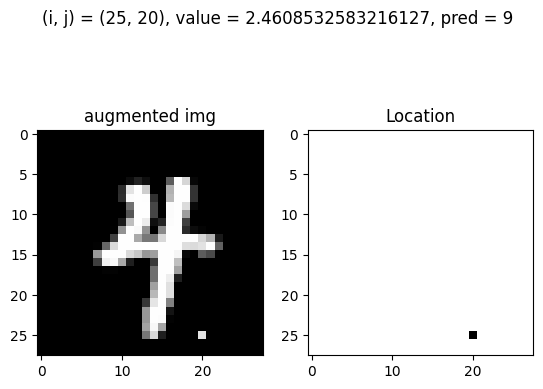

Test: At (i, j) = (25, 20) and value = 2.82148653034729, pred = 9, before_pred = 4, gt = 4


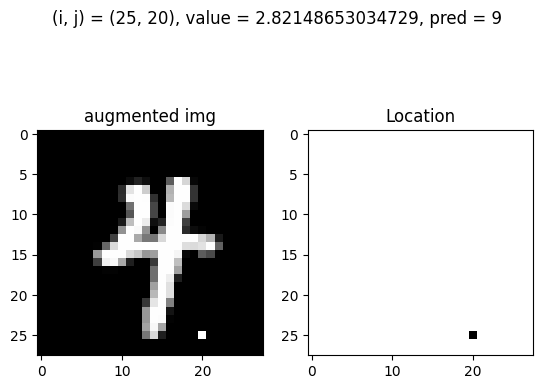

Test: At (i, j) = (25, 21) and value = 2.4608532583216127, pred = 9, before_pred = 4, gt = 4


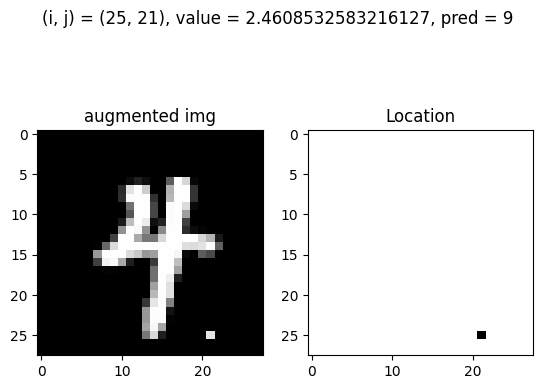

Test: At (i, j) = (25, 21) and value = 2.82148653034729, pred = 9, before_pred = 4, gt = 4


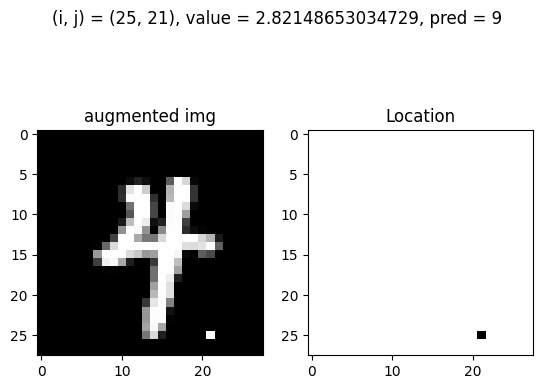

Test: At (i, j) = (25, 24) and value = 1.7395867142702586, pred = 9, before_pred = 4, gt = 4


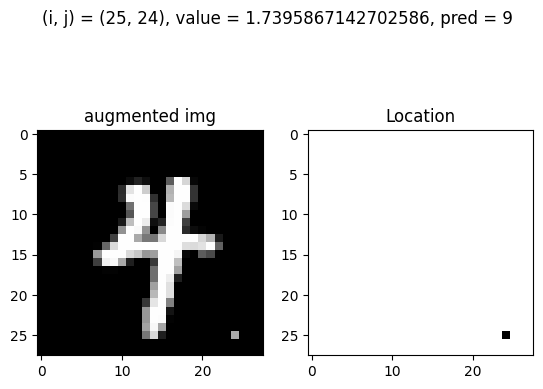

Test: At (i, j) = (25, 24) and value = 2.1002199862959356, pred = 9, before_pred = 4, gt = 4


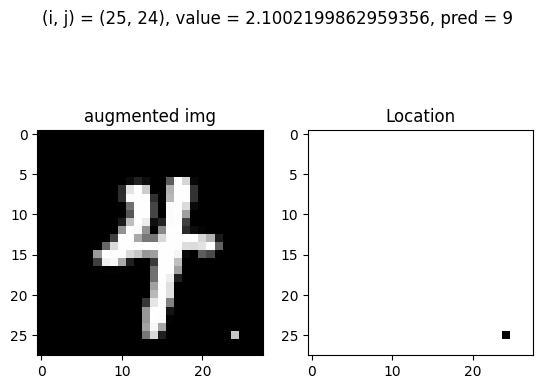

Test: At (i, j) = (25, 24) and value = 2.4608532583216127, pred = 9, before_pred = 4, gt = 4


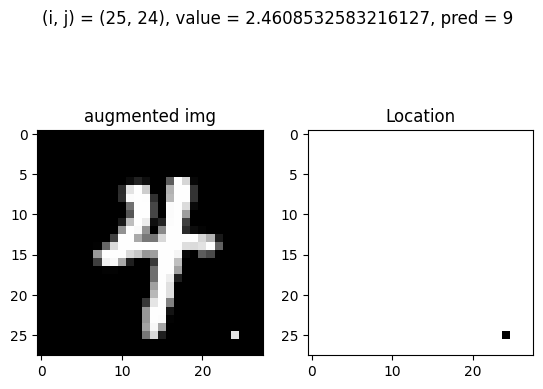

Test: At (i, j) = (25, 24) and value = 2.82148653034729, pred = 9, before_pred = 4, gt = 4


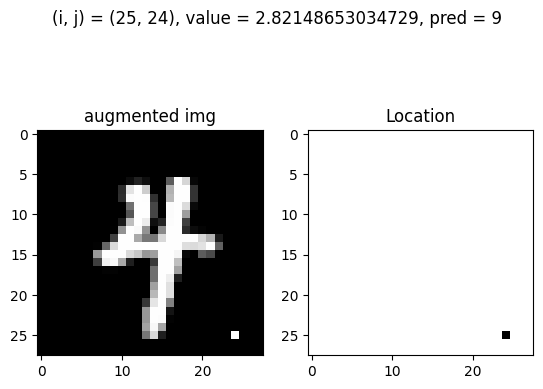

Test: At (i, j) = (26, 10) and value = 2.1002199862959356, pred = 9, before_pred = 4, gt = 4


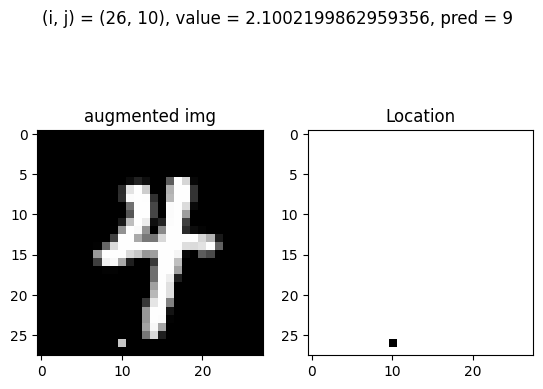

Test: At (i, j) = (26, 10) and value = 2.4608532583216127, pred = 9, before_pred = 4, gt = 4


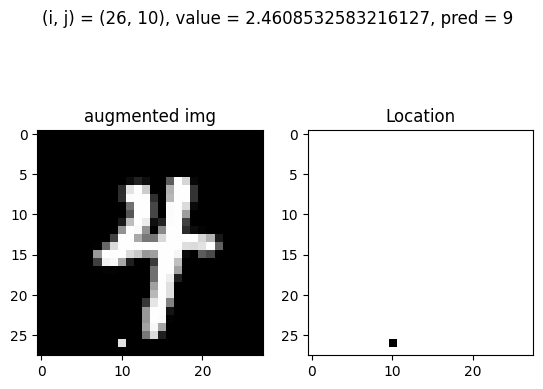

Test: At (i, j) = (26, 10) and value = 2.82148653034729, pred = 9, before_pred = 4, gt = 4


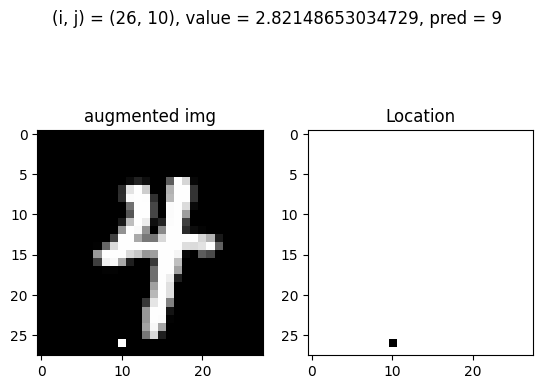

Test: At (i, j) = (26, 11) and value = 2.1002199862959356, pred = 9, before_pred = 4, gt = 4


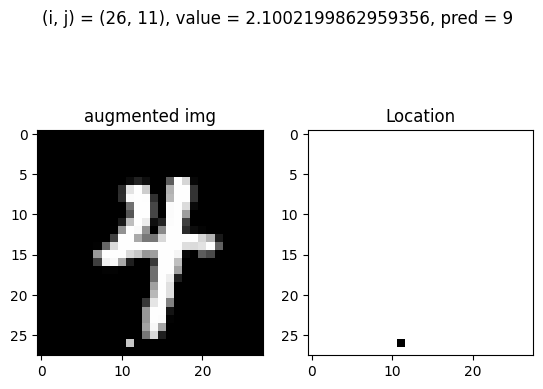

Test: At (i, j) = (26, 11) and value = 2.4608532583216127, pred = 9, before_pred = 4, gt = 4


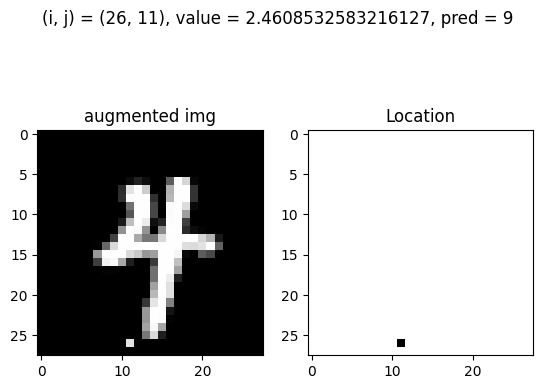

Test: At (i, j) = (26, 11) and value = 2.82148653034729, pred = 9, before_pred = 4, gt = 4


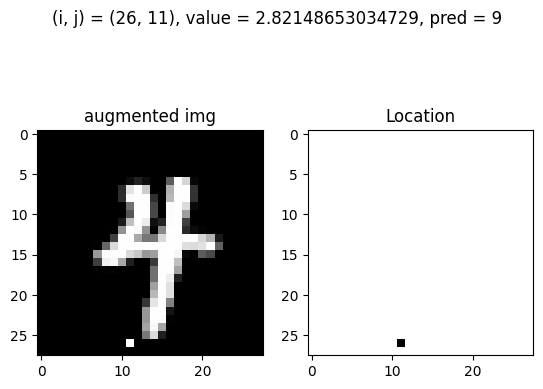

Test: At (i, j) = (26, 13) and value = 1.3789534422445815, pred = 9, before_pred = 4, gt = 4


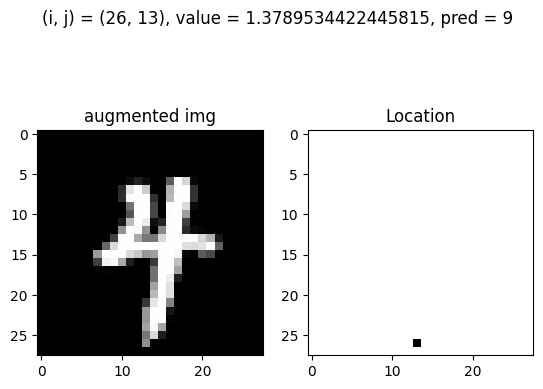

Test: At (i, j) = (26, 13) and value = 1.7395867142702586, pred = 9, before_pred = 4, gt = 4


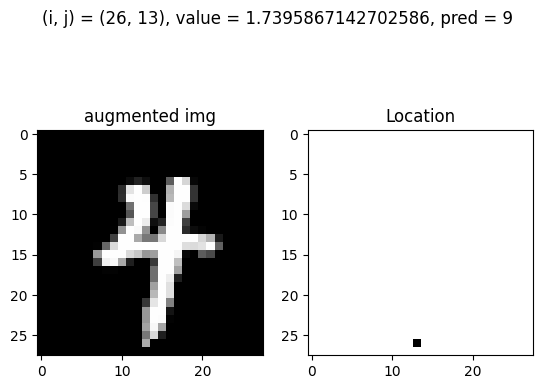

Test: At (i, j) = (26, 13) and value = 2.1002199862959356, pred = 9, before_pred = 4, gt = 4


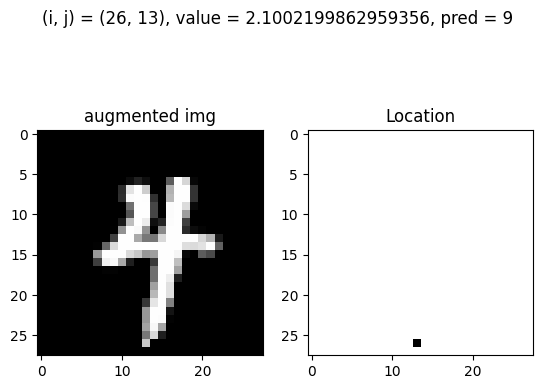

Test: At (i, j) = (26, 13) and value = 2.4608532583216127, pred = 9, before_pred = 4, gt = 4


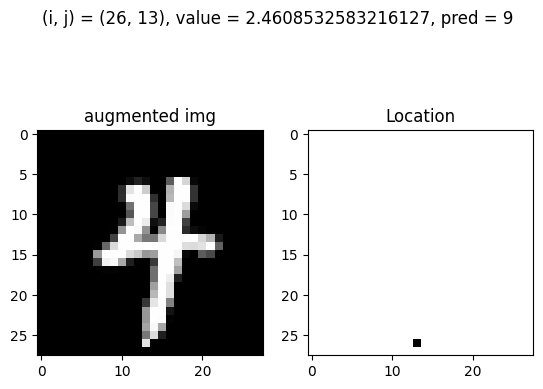

Test: At (i, j) = (26, 13) and value = 2.82148653034729, pred = 9, before_pred = 4, gt = 4


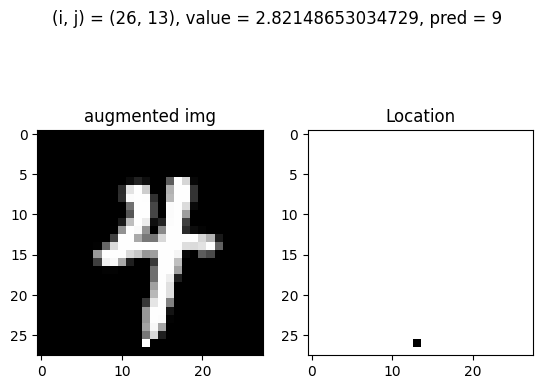

Test: At (i, j) = (26, 15) and value = 2.82148653034729, pred = 9, before_pred = 4, gt = 4


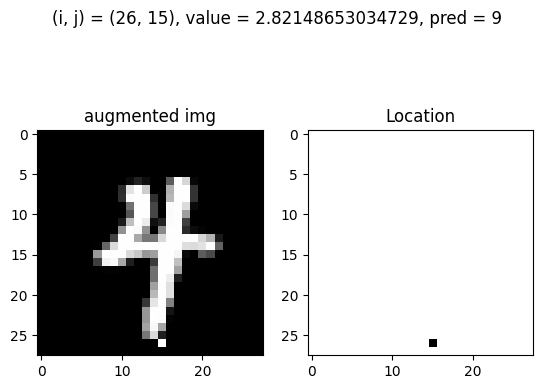

Test: At (i, j) = (26, 16) and value = 1.3789534422445815, pred = 9, before_pred = 4, gt = 4


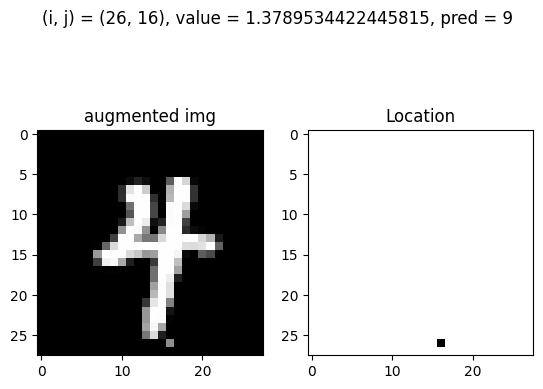

Test: At (i, j) = (26, 16) and value = 1.7395867142702586, pred = 9, before_pred = 4, gt = 4


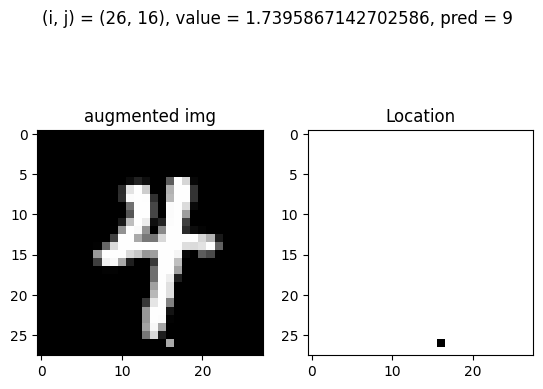

Test: At (i, j) = (26, 16) and value = 2.1002199862959356, pred = 9, before_pred = 4, gt = 4


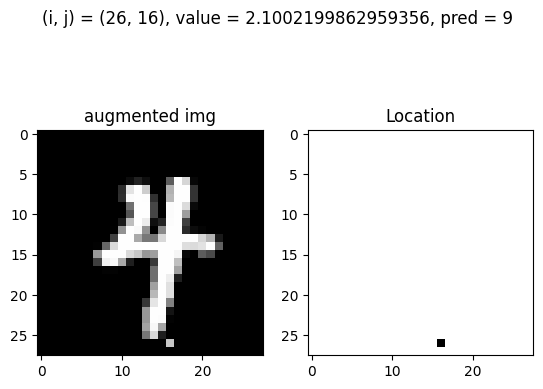

Test: At (i, j) = (26, 16) and value = 2.4608532583216127, pred = 9, before_pred = 4, gt = 4


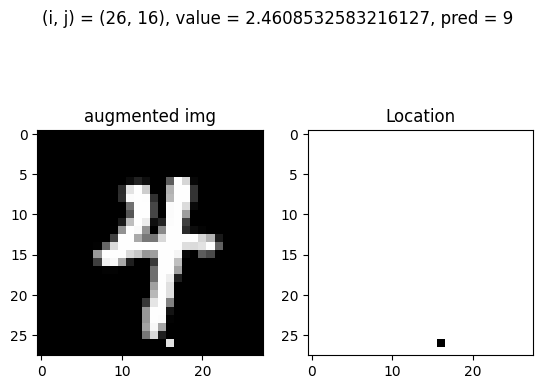

Test: At (i, j) = (26, 16) and value = 2.82148653034729, pred = 9, before_pred = 4, gt = 4


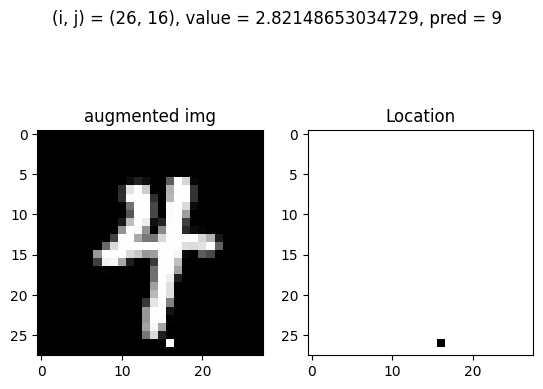

Test: At (i, j) = (26, 17) and value = 1.0183201702189044, pred = 9, before_pred = 4, gt = 4


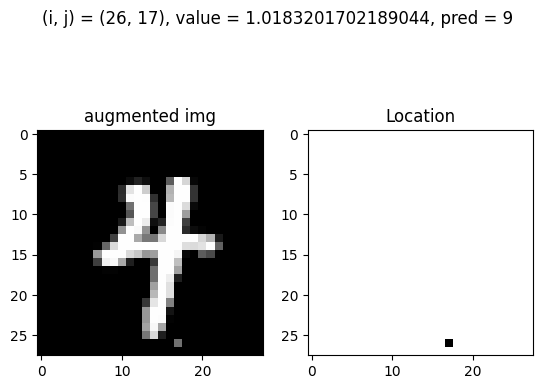

Test: At (i, j) = (26, 17) and value = 1.3789534422445815, pred = 9, before_pred = 4, gt = 4


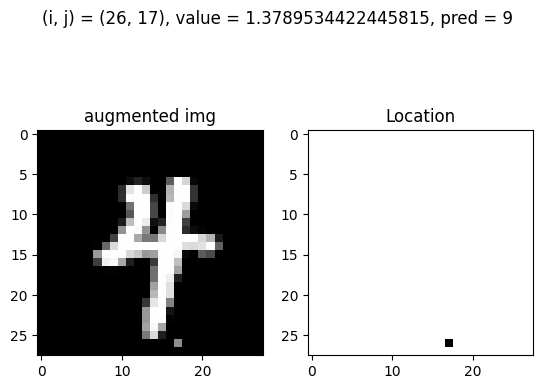

Test: At (i, j) = (26, 17) and value = 1.7395867142702586, pred = 9, before_pred = 4, gt = 4


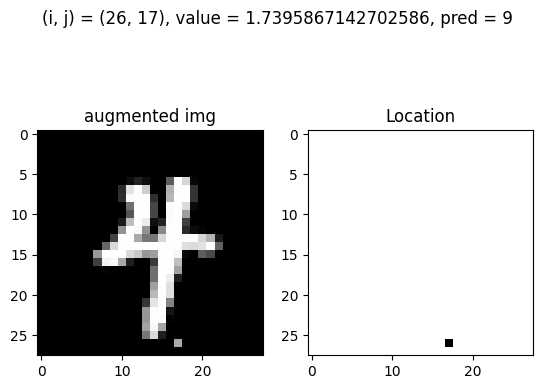

Test: At (i, j) = (26, 17) and value = 2.1002199862959356, pred = 9, before_pred = 4, gt = 4


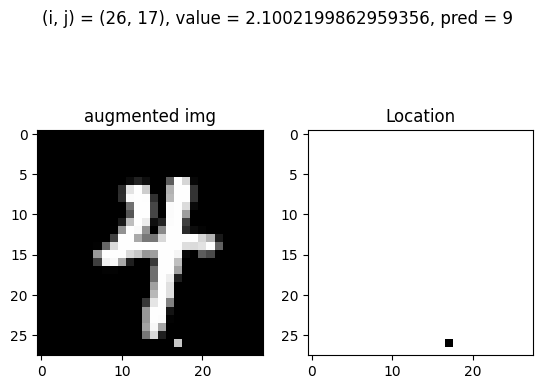

Test: At (i, j) = (26, 17) and value = 2.4608532583216127, pred = 9, before_pred = 4, gt = 4


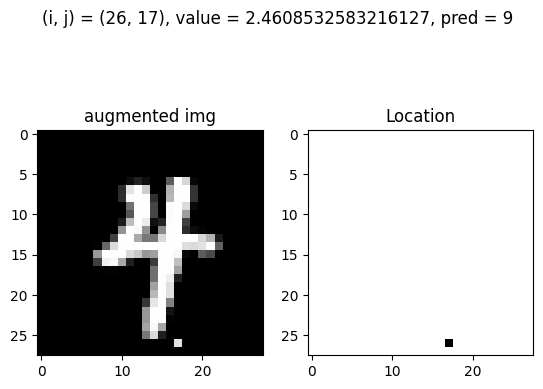

Test: At (i, j) = (26, 17) and value = 2.82148653034729, pred = 9, before_pred = 4, gt = 4


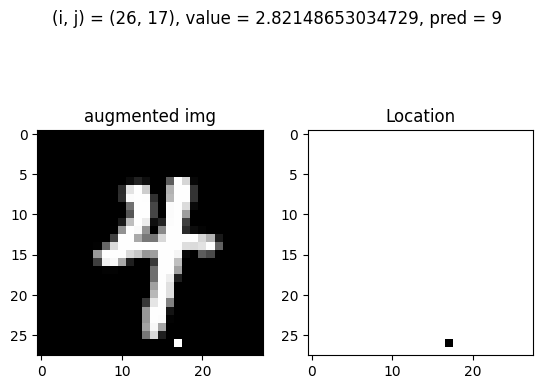

Test: At (i, j) = (26, 18) and value = 1.7395867142702586, pred = 9, before_pred = 4, gt = 4


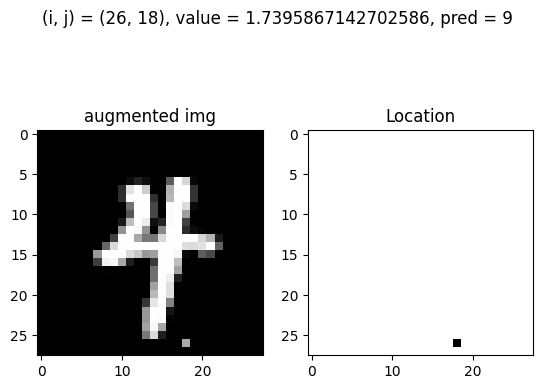

Test: At (i, j) = (26, 18) and value = 2.1002199862959356, pred = 9, before_pred = 4, gt = 4


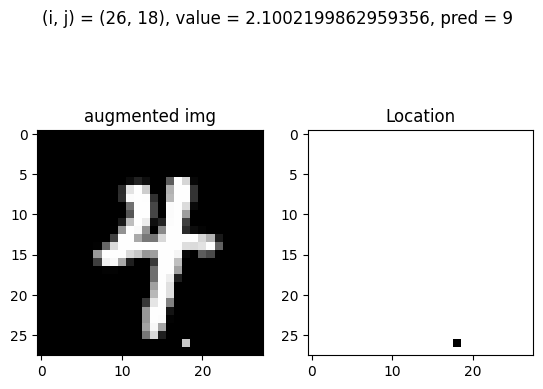

Test: At (i, j) = (26, 18) and value = 2.4608532583216127, pred = 9, before_pred = 4, gt = 4


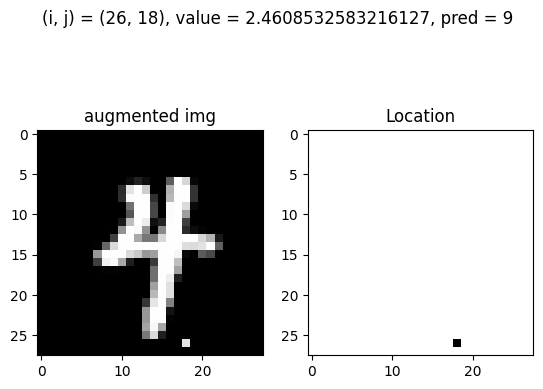

Test: At (i, j) = (26, 18) and value = 2.82148653034729, pred = 9, before_pred = 4, gt = 4


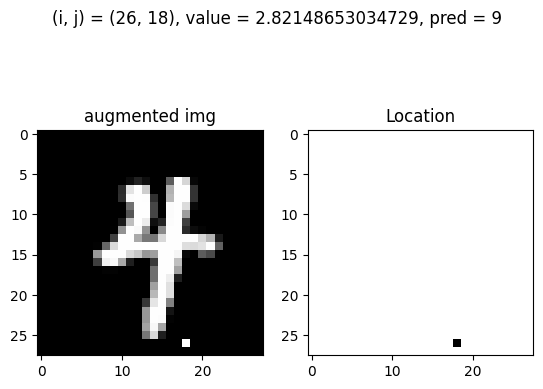

Test: At (i, j) = (26, 20) and value = 2.1002199862959356, pred = 9, before_pred = 4, gt = 4


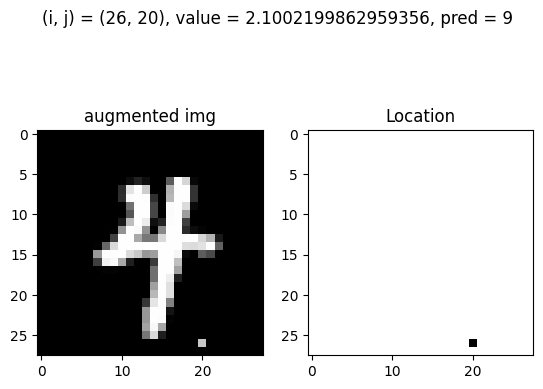

Test: At (i, j) = (26, 20) and value = 2.4608532583216127, pred = 9, before_pred = 4, gt = 4


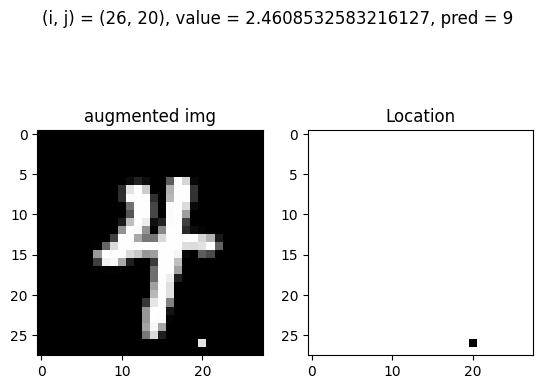

Test: At (i, j) = (26, 20) and value = 2.82148653034729, pred = 9, before_pred = 4, gt = 4


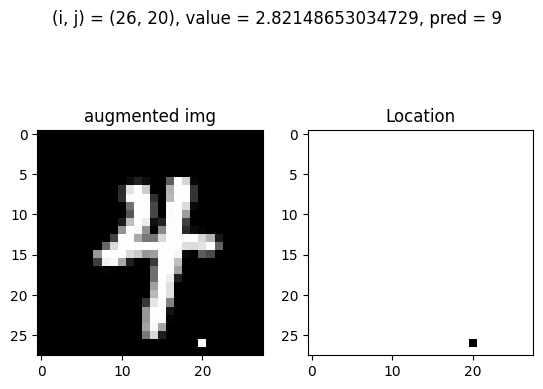

7840 done
7840 done
7840 done
Test: At (i, j) = (3, 21) and value = 2.82148653034729, pred = 5, before_pred = 3, gt = 3


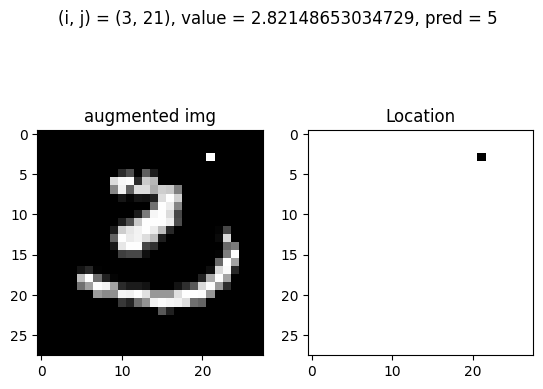

Test: At (i, j) = (4, 17) and value = 2.82148653034729, pred = 5, before_pred = 3, gt = 3


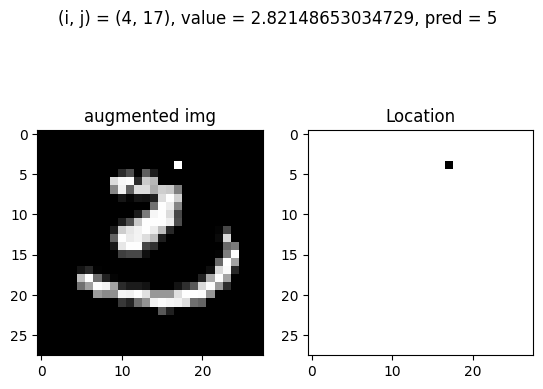

Test: At (i, j) = (5, 3) and value = 2.82148653034729, pred = 5, before_pred = 3, gt = 3


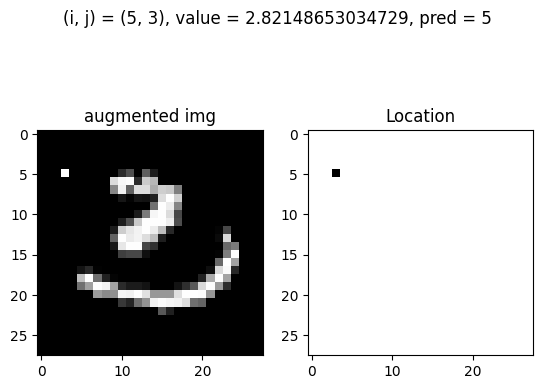

Test: At (i, j) = (5, 19) and value = 1.7395867142702586, pred = 5, before_pred = 3, gt = 3


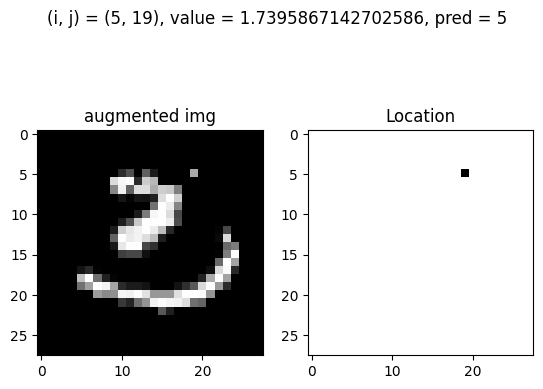

Test: At (i, j) = (5, 19) and value = 2.1002199862959356, pred = 5, before_pred = 3, gt = 3


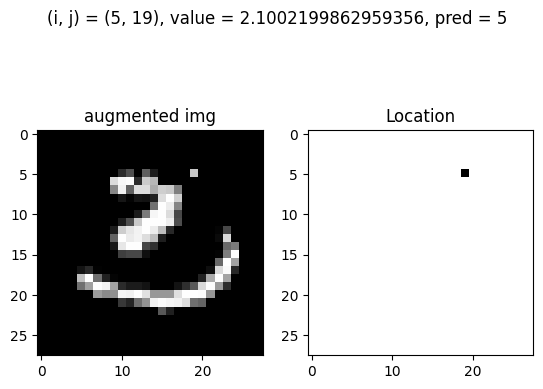

Test: At (i, j) = (5, 19) and value = 2.4608532583216127, pred = 5, before_pred = 3, gt = 3


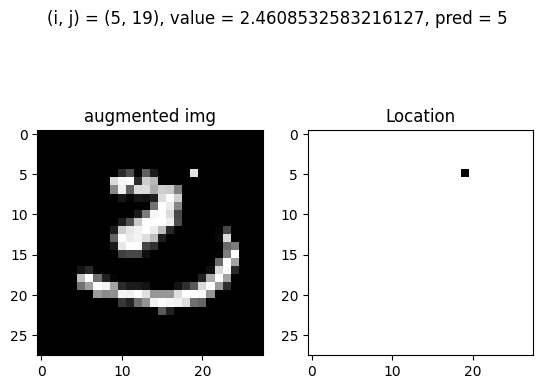

Test: At (i, j) = (5, 19) and value = 2.82148653034729, pred = 5, before_pred = 3, gt = 3


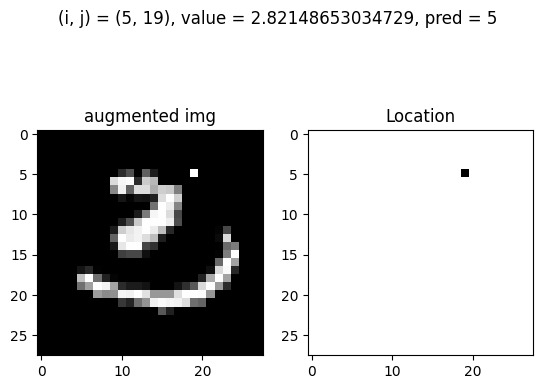

Test: At (i, j) = (5, 21) and value = 2.1002199862959356, pred = 5, before_pred = 3, gt = 3


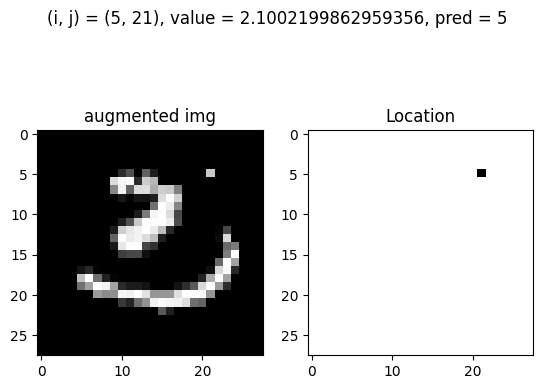

Test: At (i, j) = (5, 21) and value = 2.4608532583216127, pred = 5, before_pred = 3, gt = 3


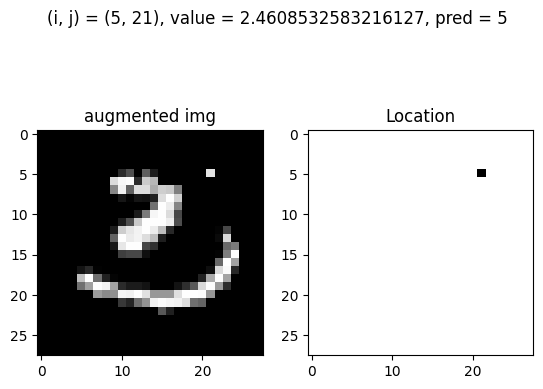

Test: At (i, j) = (5, 21) and value = 2.82148653034729, pred = 5, before_pred = 3, gt = 3


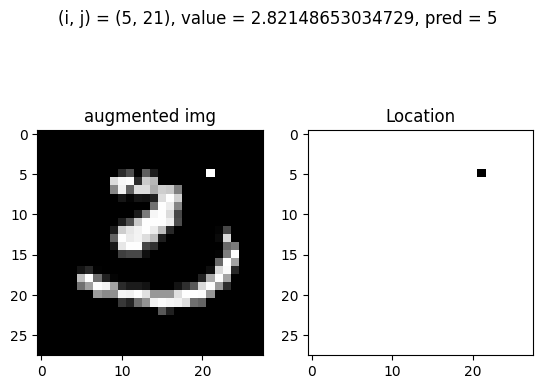

Test: At (i, j) = (6, 10) and value = -0.424212917883804, pred = 5, before_pred = 3, gt = 3


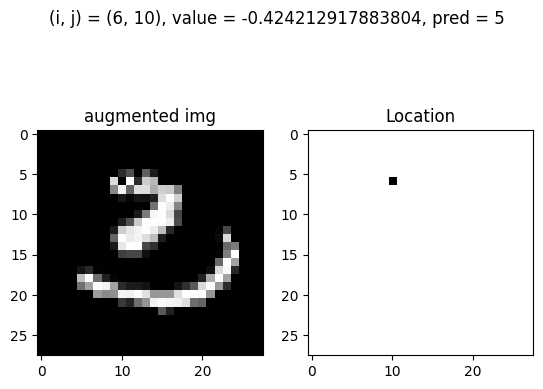

Test: At (i, j) = (6, 10) and value = -0.06357964585812692, pred = 5, before_pred = 3, gt = 3


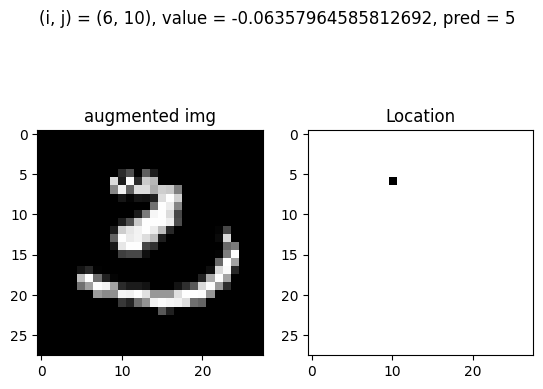

Test: At (i, j) = (6, 10) and value = 0.29705362616755016, pred = 5, before_pred = 3, gt = 3


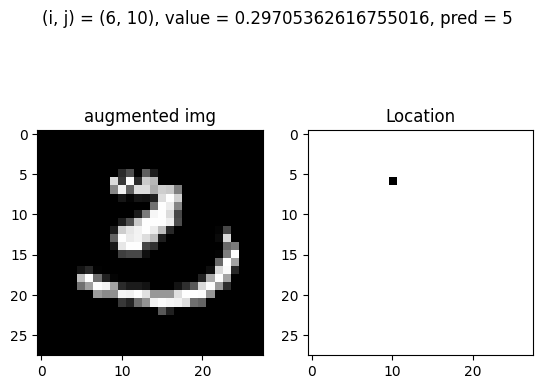

Test: At (i, j) = (6, 11) and value = -0.424212917883804, pred = 5, before_pred = 3, gt = 3


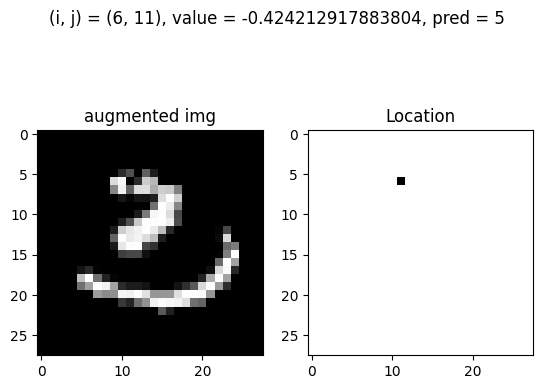

Test: At (i, j) = (6, 11) and value = -0.06357964585812692, pred = 5, before_pred = 3, gt = 3


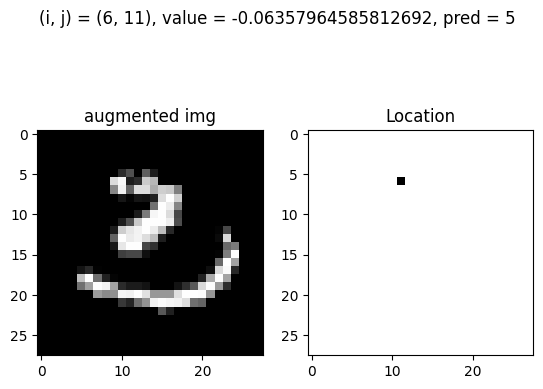

Test: At (i, j) = (6, 14) and value = -0.424212917883804, pred = 5, before_pred = 3, gt = 3


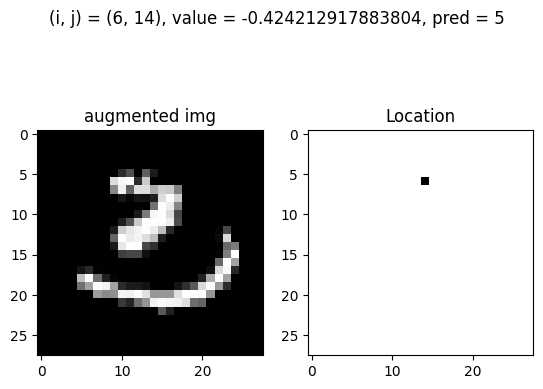

Test: At (i, j) = (6, 20) and value = 2.82148653034729, pred = 5, before_pred = 3, gt = 3


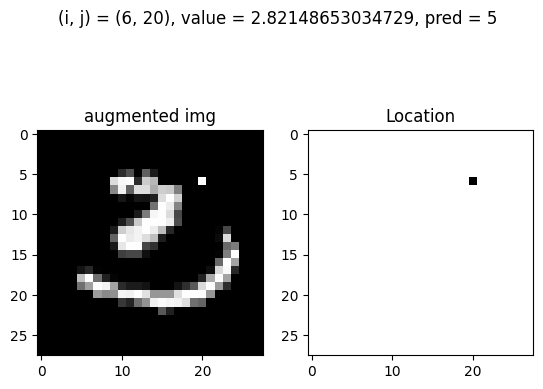

Test: At (i, j) = (6, 24) and value = 1.7395867142702586, pred = 5, before_pred = 3, gt = 3


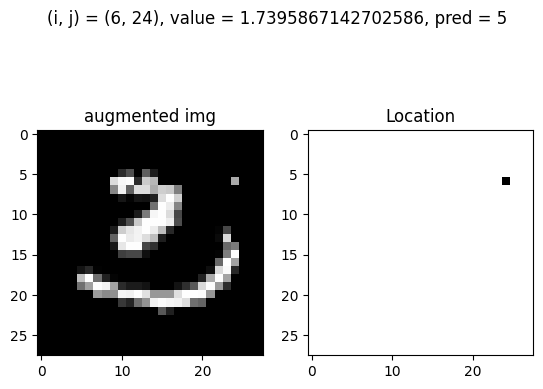

Test: At (i, j) = (6, 24) and value = 2.1002199862959356, pred = 5, before_pred = 3, gt = 3


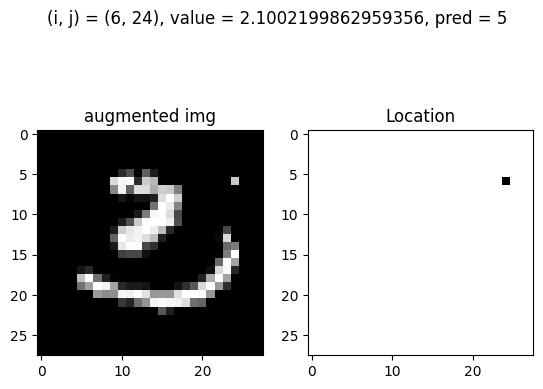

Test: At (i, j) = (6, 24) and value = 2.4608532583216127, pred = 5, before_pred = 3, gt = 3


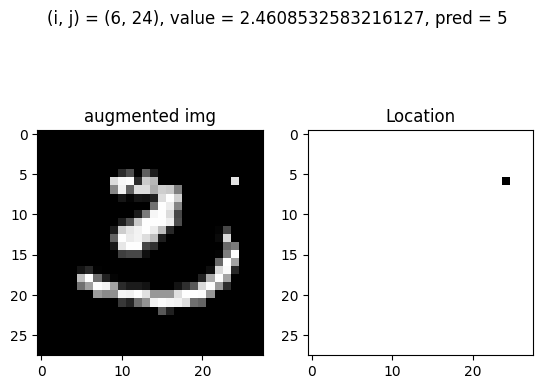

Test: At (i, j) = (6, 24) and value = 2.82148653034729, pred = 5, before_pred = 3, gt = 3


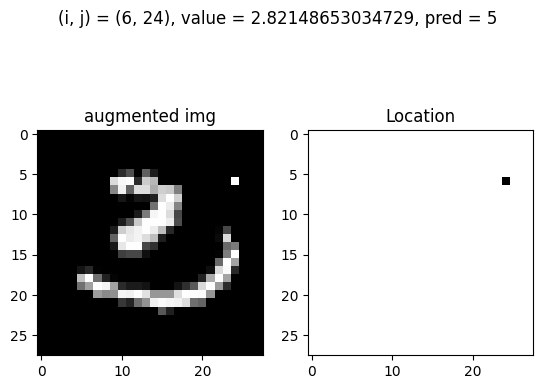

Test: At (i, j) = (7, 10) and value = -0.424212917883804, pred = 5, before_pred = 3, gt = 3


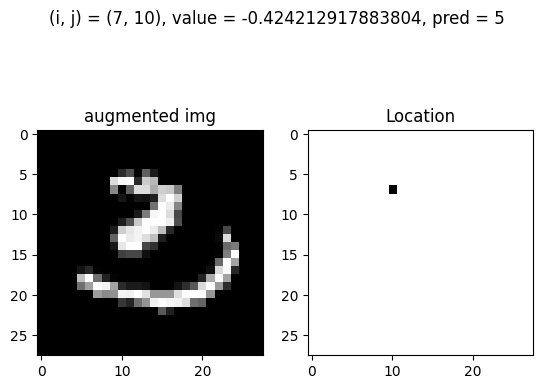

Test: At (i, j) = (7, 10) and value = -0.06357964585812692, pred = 5, before_pred = 3, gt = 3


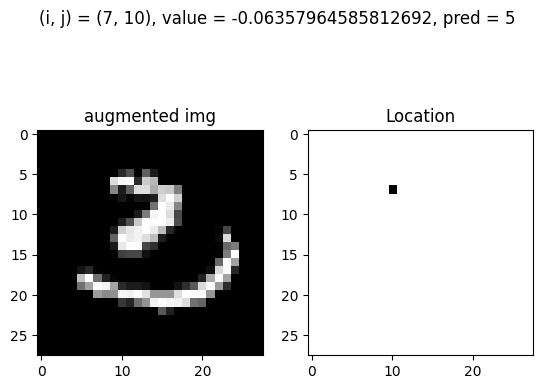

Test: At (i, j) = (7, 23) and value = 2.1002199862959356, pred = 5, before_pred = 3, gt = 3


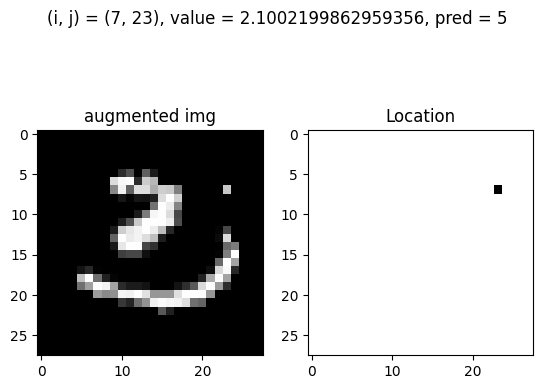

Test: At (i, j) = (7, 23) and value = 2.4608532583216127, pred = 5, before_pred = 3, gt = 3


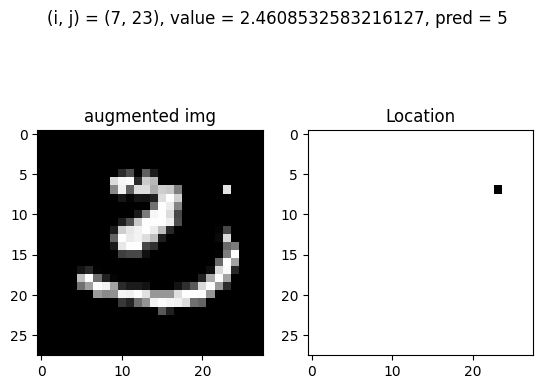

Test: At (i, j) = (7, 23) and value = 2.82148653034729, pred = 5, before_pred = 3, gt = 3


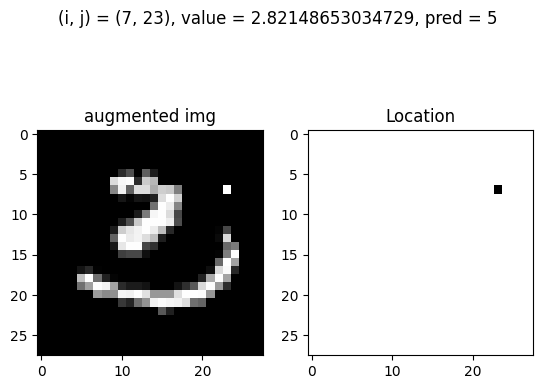

Test: At (i, j) = (8, 15) and value = -0.424212917883804, pred = 5, before_pred = 3, gt = 3


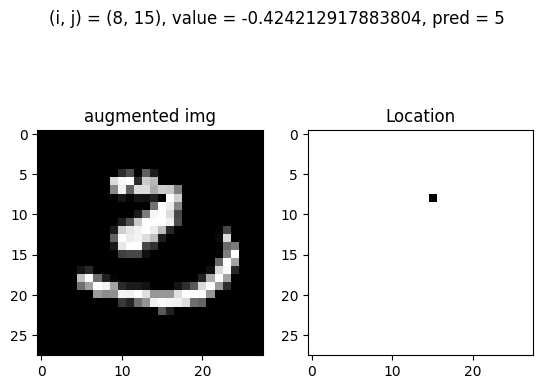

Test: At (i, j) = (8, 15) and value = -0.06357964585812692, pred = 5, before_pred = 3, gt = 3


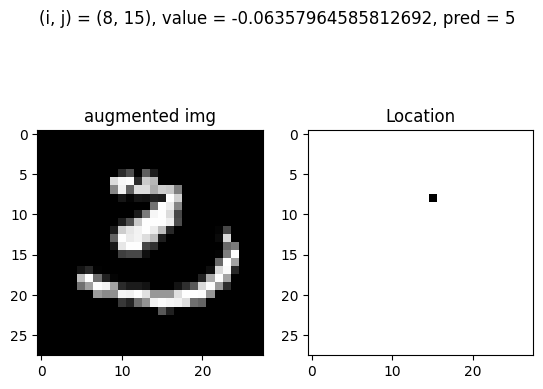

Test: At (i, j) = (8, 16) and value = -0.424212917883804, pred = 5, before_pred = 3, gt = 3


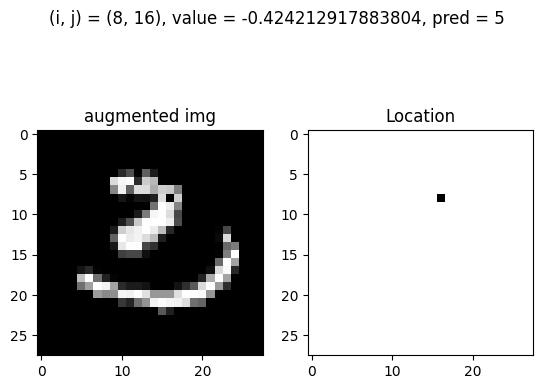

Test: At (i, j) = (8, 16) and value = -0.06357964585812692, pred = 5, before_pred = 3, gt = 3


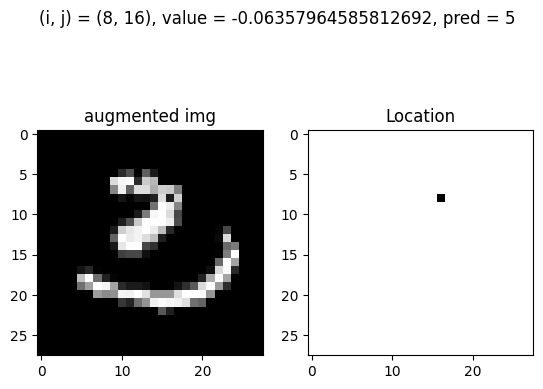

Test: At (i, j) = (8, 16) and value = 0.29705362616755016, pred = 5, before_pred = 3, gt = 3


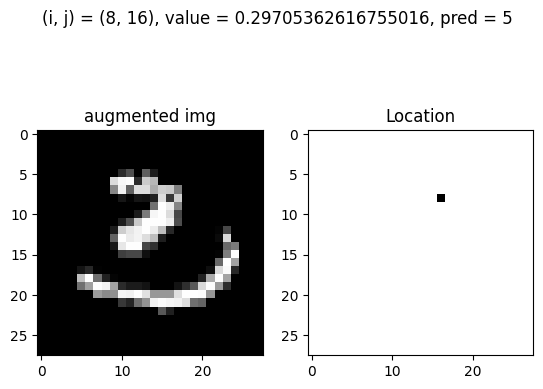

Test: At (i, j) = (8, 22) and value = 2.4608532583216127, pred = 5, before_pred = 3, gt = 3


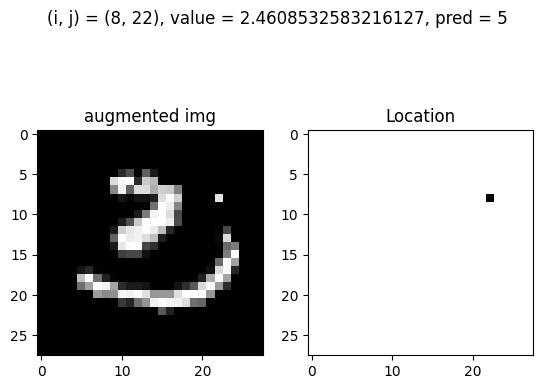

Test: At (i, j) = (8, 22) and value = 2.82148653034729, pred = 5, before_pred = 3, gt = 3


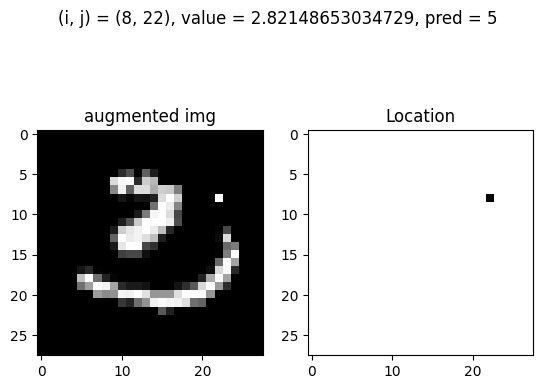

Test: At (i, j) = (9, 8) and value = 2.82148653034729, pred = 5, before_pred = 3, gt = 3


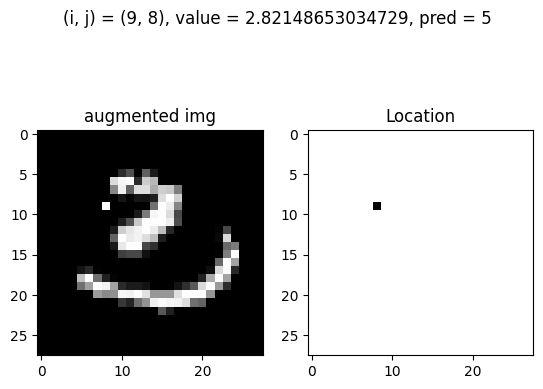

Test: At (i, j) = (9, 10) and value = 2.4608532583216127, pred = 5, before_pred = 3, gt = 3


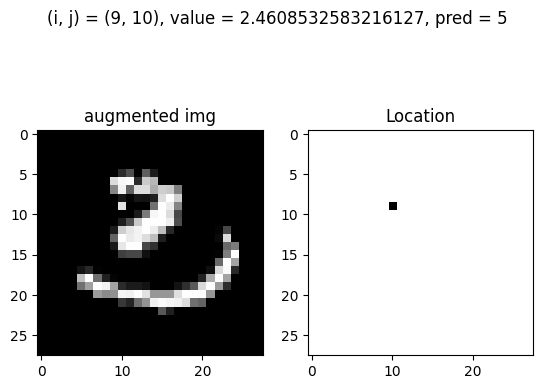

Test: At (i, j) = (9, 10) and value = 2.82148653034729, pred = 5, before_pred = 3, gt = 3


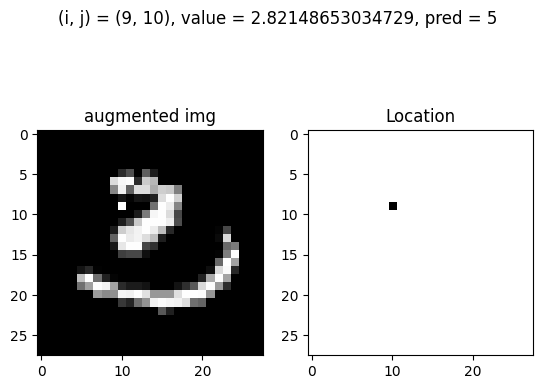

Test: At (i, j) = (9, 11) and value = 2.4608532583216127, pred = 5, before_pred = 3, gt = 3


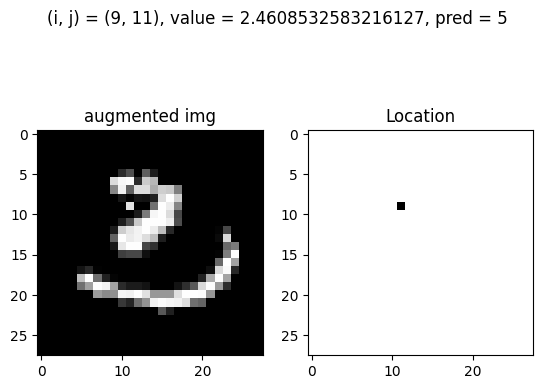

Test: At (i, j) = (9, 11) and value = 2.82148653034729, pred = 5, before_pred = 3, gt = 3


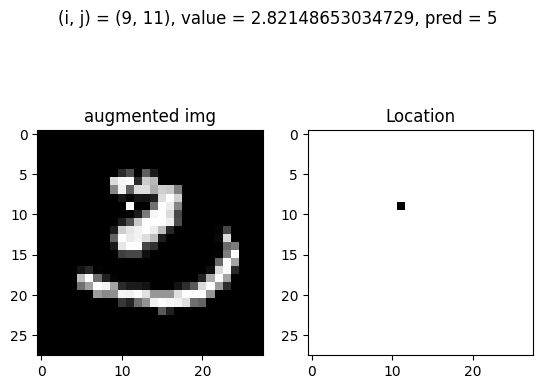

Test: At (i, j) = (9, 12) and value = 2.4608532583216127, pred = 5, before_pred = 3, gt = 3


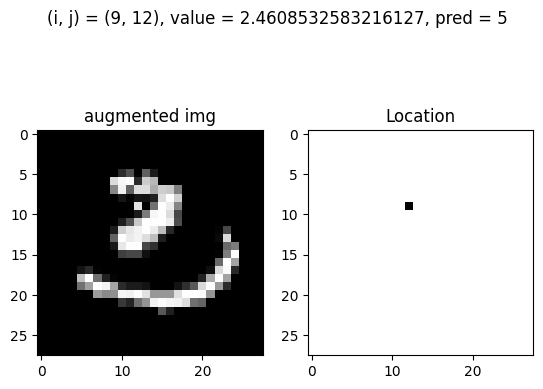

Test: At (i, j) = (9, 12) and value = 2.82148653034729, pred = 5, before_pred = 3, gt = 3


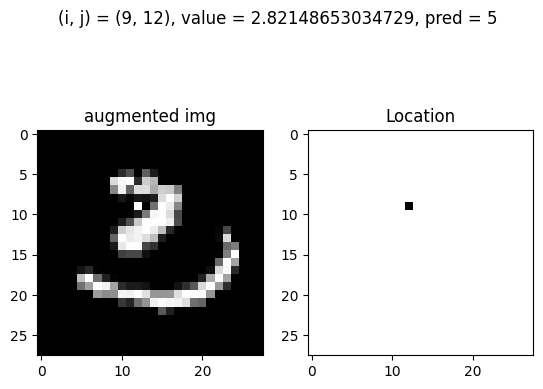

Test: At (i, j) = (9, 15) and value = -0.424212917883804, pred = 5, before_pred = 3, gt = 3


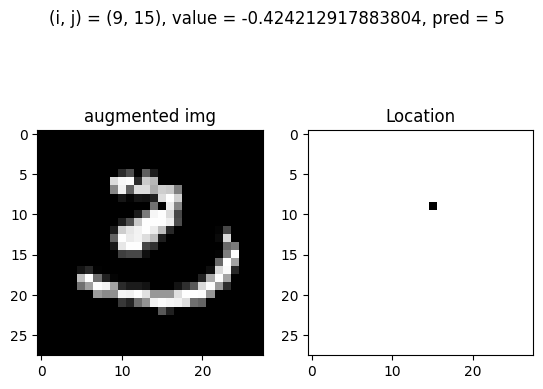

Test: At (i, j) = (9, 15) and value = -0.06357964585812692, pred = 5, before_pred = 3, gt = 3


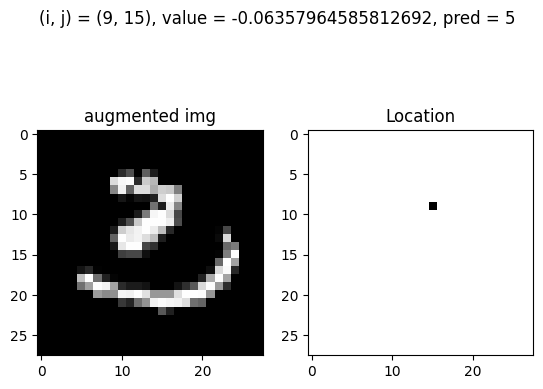

Test: At (i, j) = (9, 16) and value = -0.424212917883804, pred = 5, before_pred = 3, gt = 3


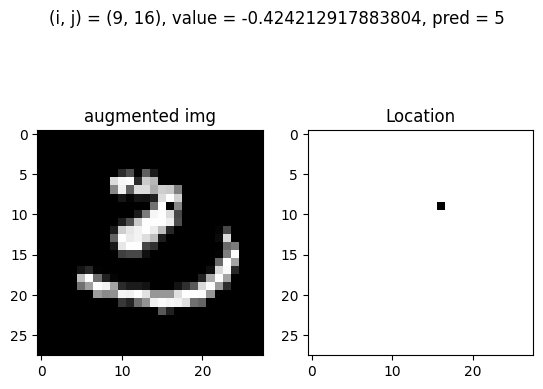

Test: At (i, j) = (9, 16) and value = -0.06357964585812692, pred = 5, before_pred = 3, gt = 3


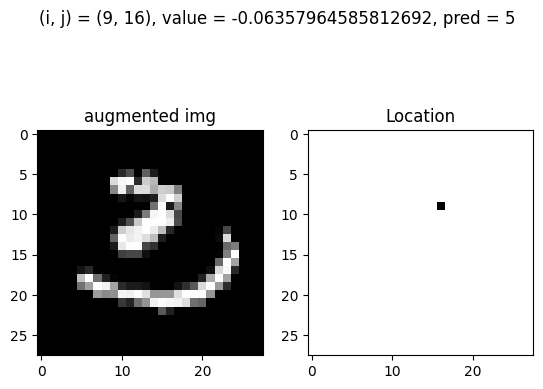

Test: At (i, j) = (9, 16) and value = 0.29705362616755016, pred = 5, before_pred = 3, gt = 3


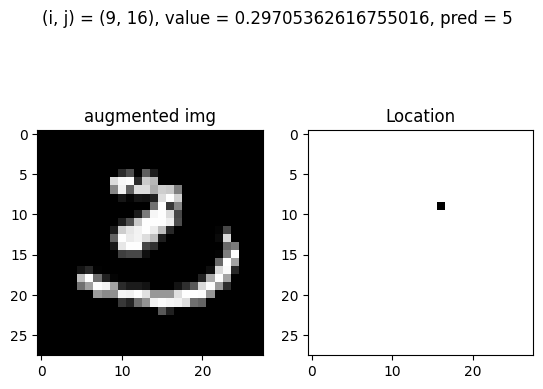

Test: At (i, j) = (9, 16) and value = 0.6576868981932272, pred = 5, before_pred = 3, gt = 3


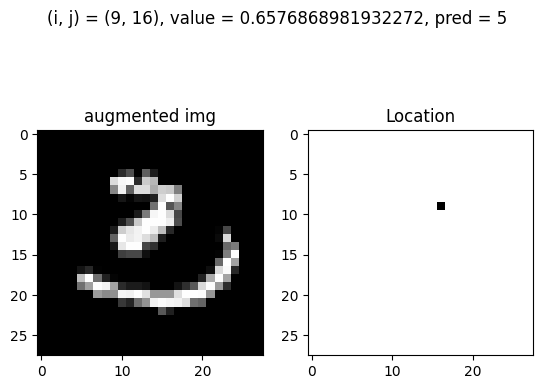

Test: At (i, j) = (9, 16) and value = 1.0183201702189044, pred = 5, before_pred = 3, gt = 3


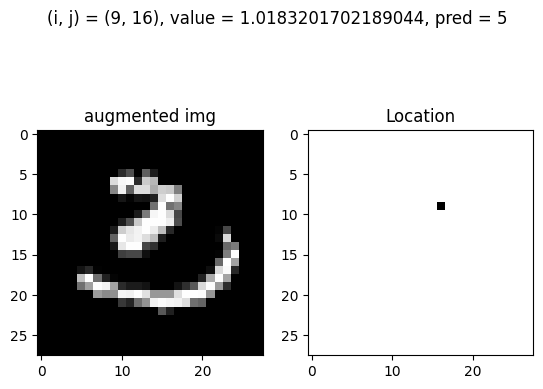

Test: At (i, j) = (10, 7) and value = 1.7395867142702586, pred = 5, before_pred = 3, gt = 3


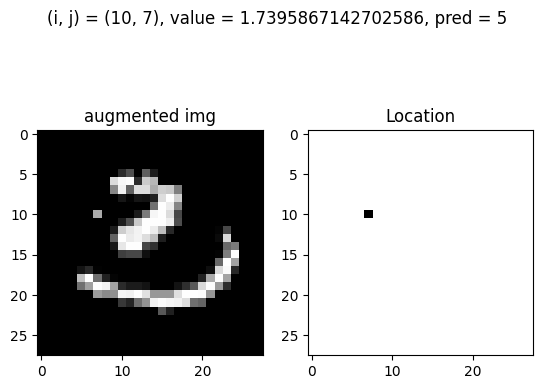

Test: At (i, j) = (10, 7) and value = 2.1002199862959356, pred = 5, before_pred = 3, gt = 3


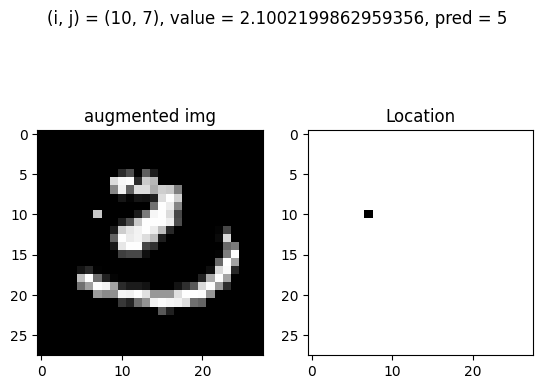

Test: At (i, j) = (10, 7) and value = 2.4608532583216127, pred = 5, before_pred = 3, gt = 3


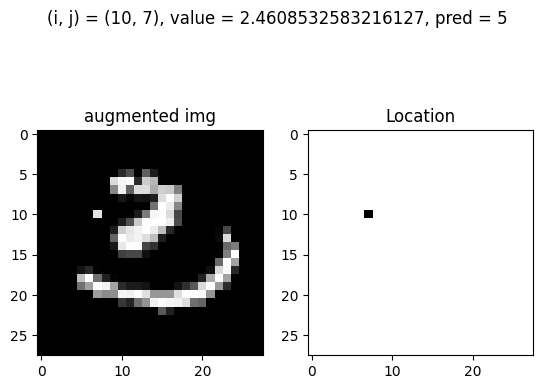

Test: At (i, j) = (10, 7) and value = 2.82148653034729, pred = 5, before_pred = 3, gt = 3


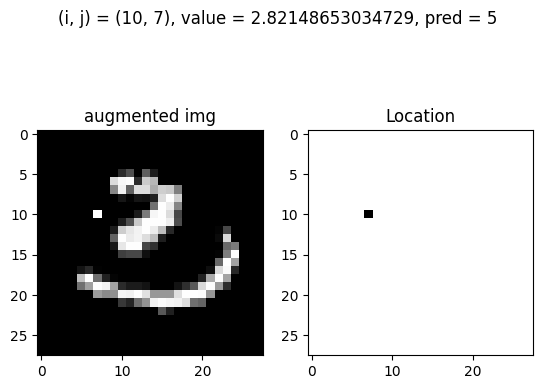

Test: At (i, j) = (10, 8) and value = 1.7395867142702586, pred = 5, before_pred = 3, gt = 3


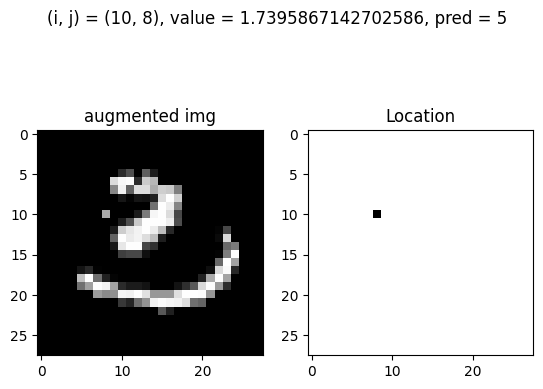

Test: At (i, j) = (10, 8) and value = 2.1002199862959356, pred = 5, before_pred = 3, gt = 3


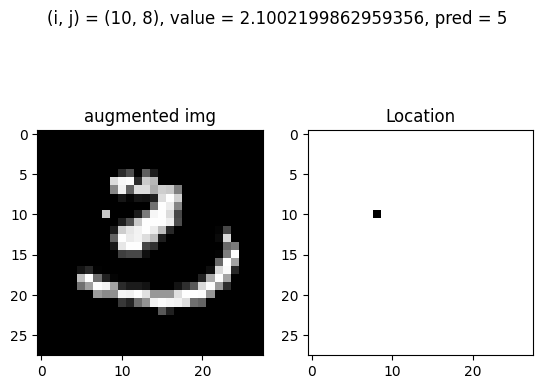

Test: At (i, j) = (10, 8) and value = 2.4608532583216127, pred = 5, before_pred = 3, gt = 3


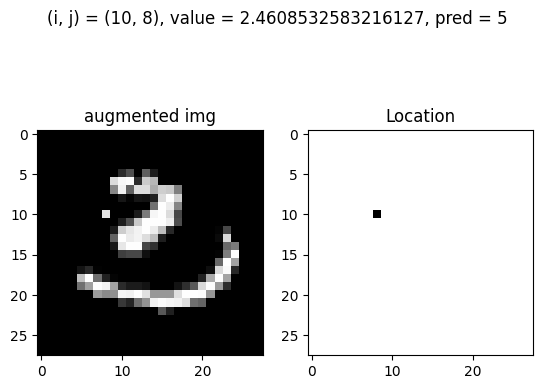

Test: At (i, j) = (10, 8) and value = 2.82148653034729, pred = 5, before_pred = 3, gt = 3


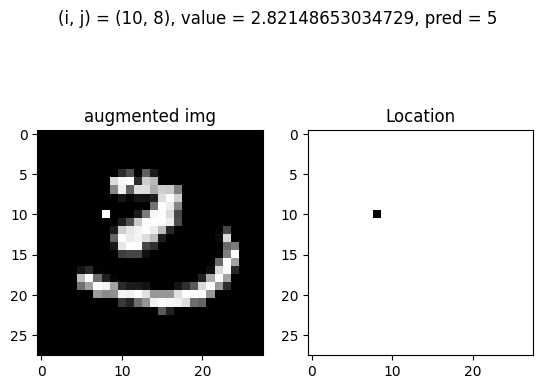

Test: At (i, j) = (10, 9) and value = 1.0183201702189044, pred = 5, before_pred = 3, gt = 3


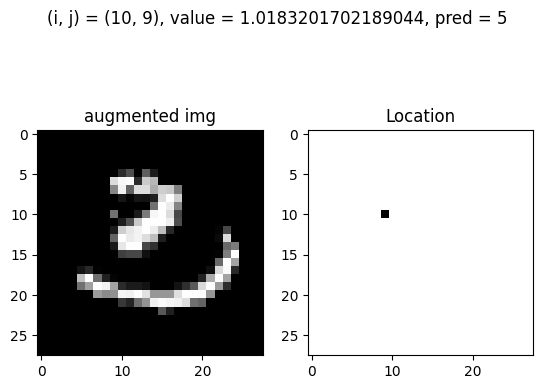

Test: At (i, j) = (10, 9) and value = 1.3789534422445815, pred = 5, before_pred = 3, gt = 3


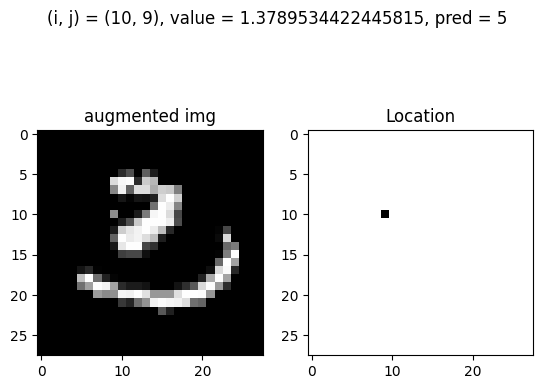

Test: At (i, j) = (10, 9) and value = 1.7395867142702586, pred = 5, before_pred = 3, gt = 3


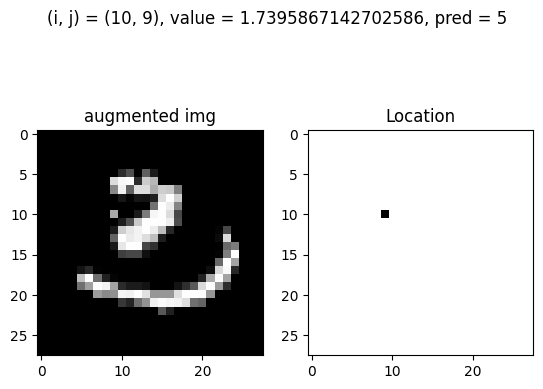

Test: At (i, j) = (10, 9) and value = 2.1002199862959356, pred = 5, before_pred = 3, gt = 3


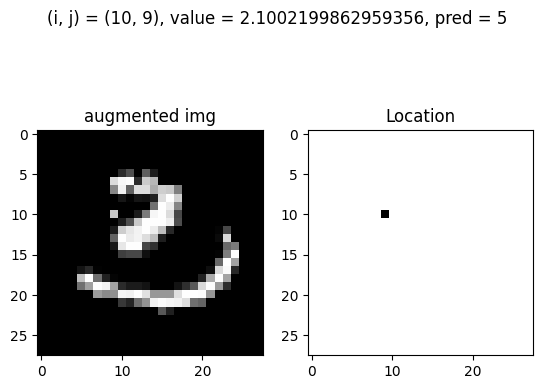

Test: At (i, j) = (10, 9) and value = 2.4608532583216127, pred = 5, before_pred = 3, gt = 3


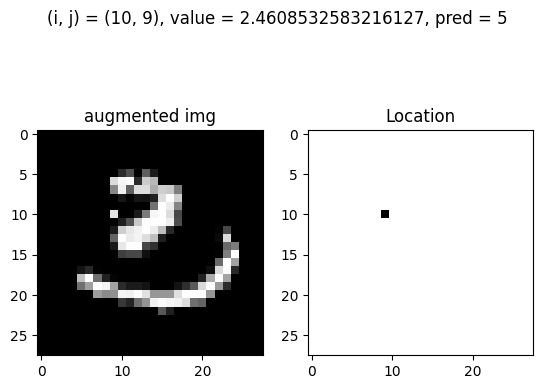

Test: At (i, j) = (10, 9) and value = 2.82148653034729, pred = 5, before_pred = 3, gt = 3


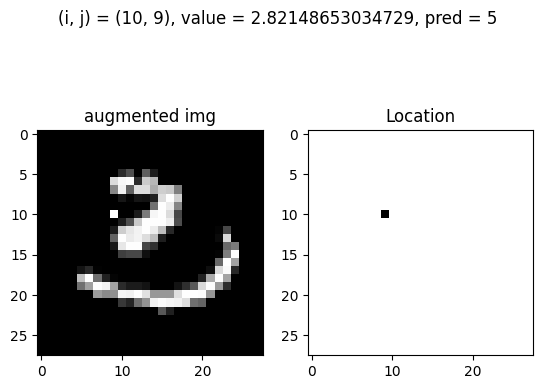

Test: At (i, j) = (10, 10) and value = 1.0183201702189044, pred = 5, before_pred = 3, gt = 3


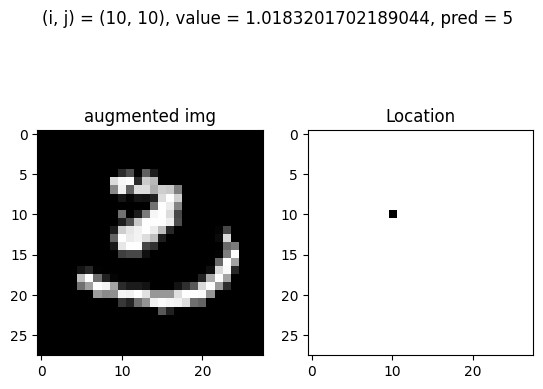

Test: At (i, j) = (10, 10) and value = 1.3789534422445815, pred = 5, before_pred = 3, gt = 3


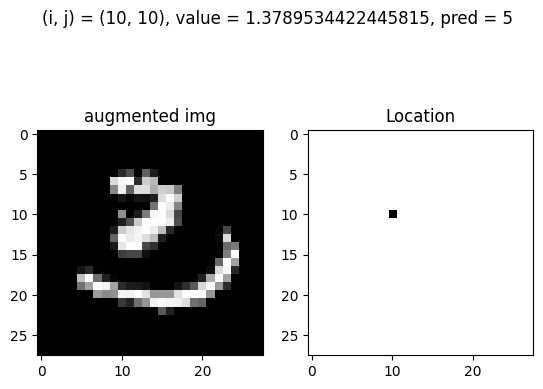

Test: At (i, j) = (10, 10) and value = 1.7395867142702586, pred = 5, before_pred = 3, gt = 3


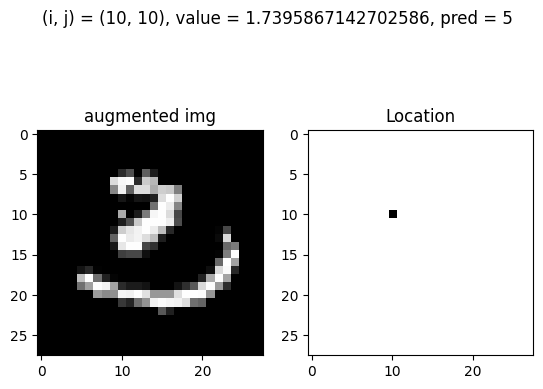

Test: At (i, j) = (10, 10) and value = 2.1002199862959356, pred = 5, before_pred = 3, gt = 3


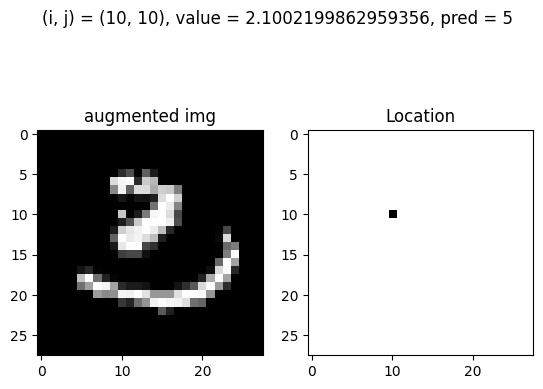

Test: At (i, j) = (10, 10) and value = 2.4608532583216127, pred = 5, before_pred = 3, gt = 3


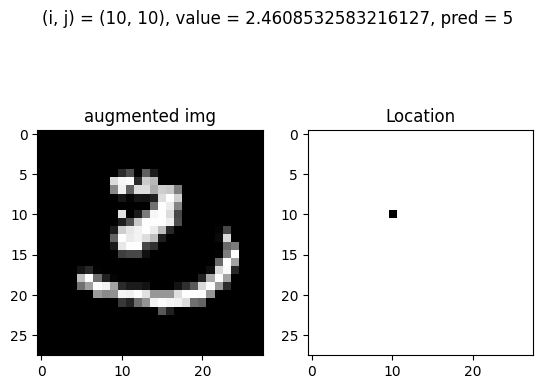

Test: At (i, j) = (10, 10) and value = 2.82148653034729, pred = 5, before_pred = 3, gt = 3


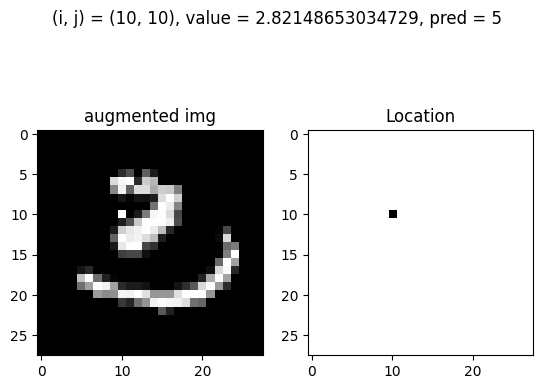

Test: At (i, j) = (10, 11) and value = 0.6576868981932272, pred = 5, before_pred = 3, gt = 3


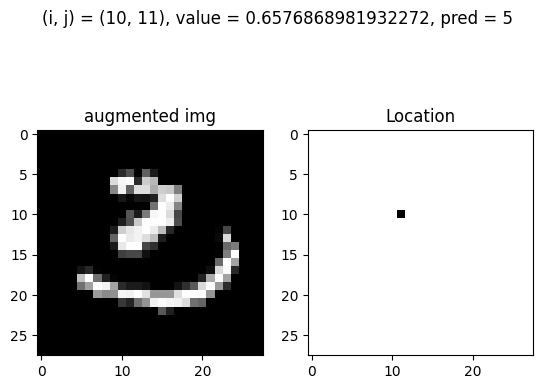

Test: At (i, j) = (10, 11) and value = 1.0183201702189044, pred = 5, before_pred = 3, gt = 3


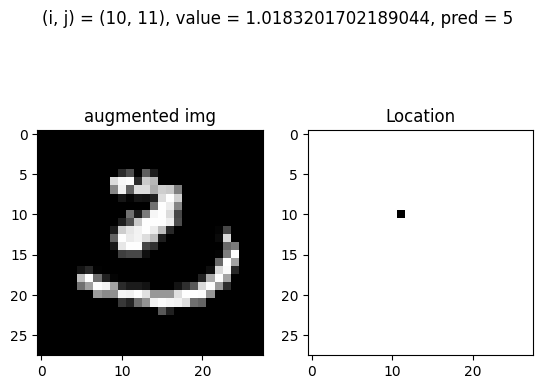

Test: At (i, j) = (10, 11) and value = 1.3789534422445815, pred = 5, before_pred = 3, gt = 3


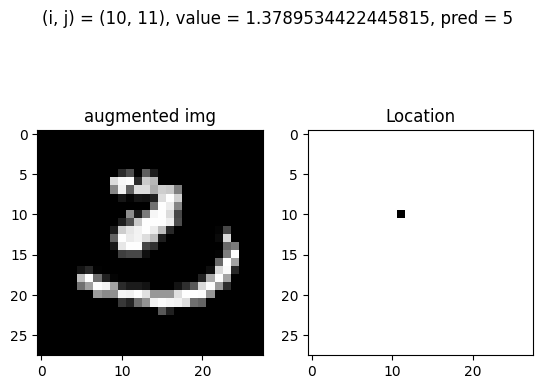

Test: At (i, j) = (10, 11) and value = 1.7395867142702586, pred = 5, before_pred = 3, gt = 3


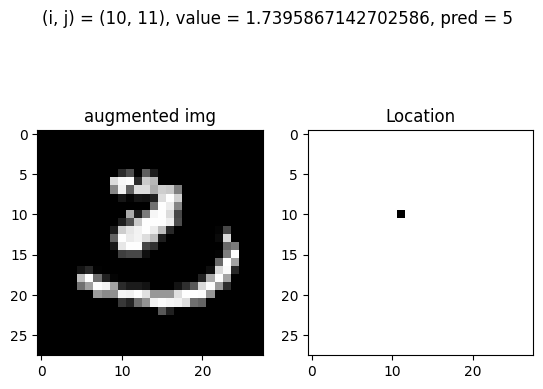

Test: At (i, j) = (10, 11) and value = 2.1002199862959356, pred = 5, before_pred = 3, gt = 3


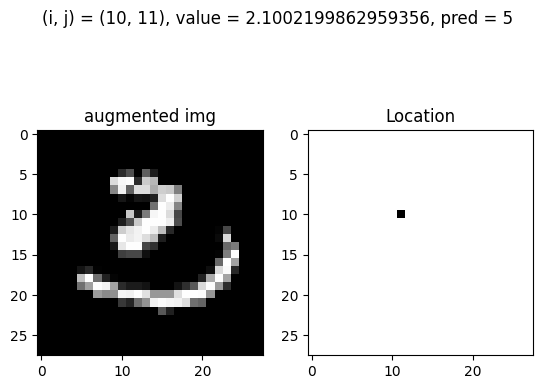

Test: At (i, j) = (10, 11) and value = 2.4608532583216127, pred = 5, before_pred = 3, gt = 3


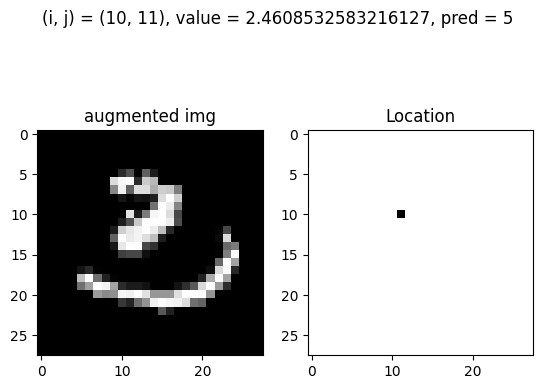

Test: At (i, j) = (10, 11) and value = 2.82148653034729, pred = 5, before_pred = 3, gt = 3


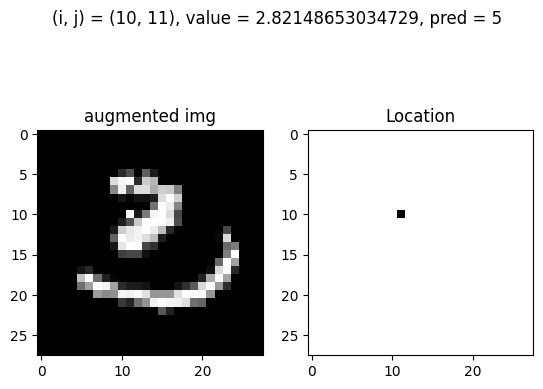

Test: At (i, j) = (10, 12) and value = 1.3789534422445815, pred = 5, before_pred = 3, gt = 3


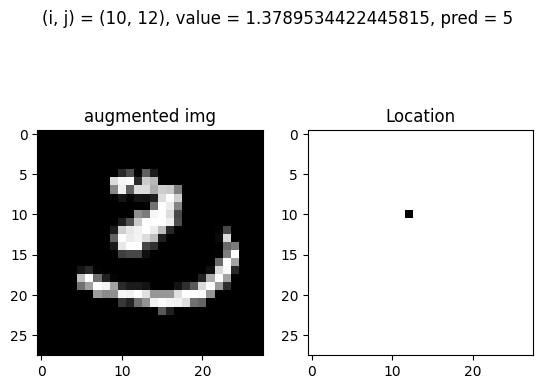

Test: At (i, j) = (10, 12) and value = 1.7395867142702586, pred = 5, before_pred = 3, gt = 3


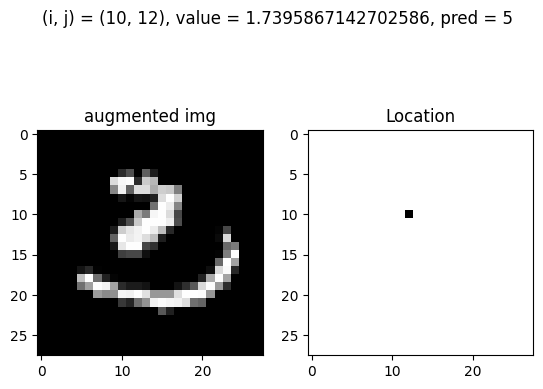

Test: At (i, j) = (10, 12) and value = 2.1002199862959356, pred = 5, before_pred = 3, gt = 3


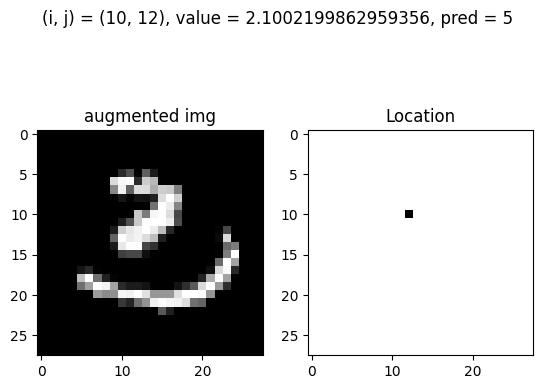

Test: At (i, j) = (10, 12) and value = 2.4608532583216127, pred = 5, before_pred = 3, gt = 3


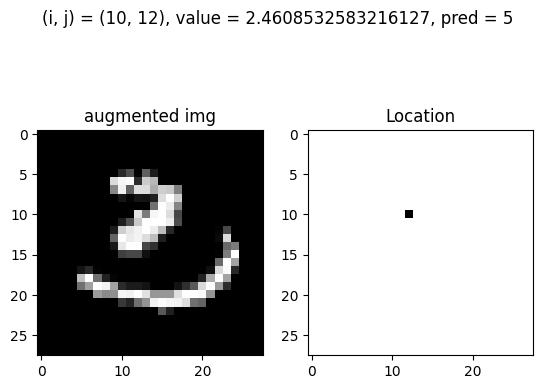

Test: At (i, j) = (10, 12) and value = 2.82148653034729, pred = 5, before_pred = 3, gt = 3


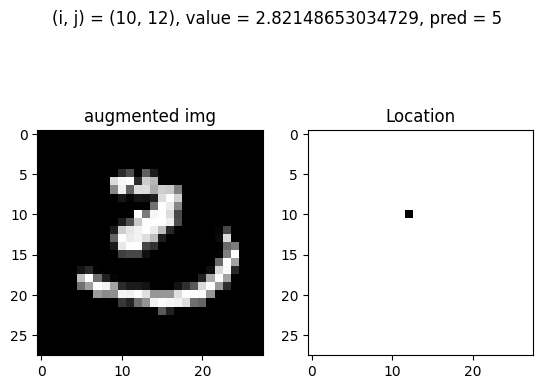

Test: At (i, j) = (10, 14) and value = -0.424212917883804, pred = 5, before_pred = 3, gt = 3


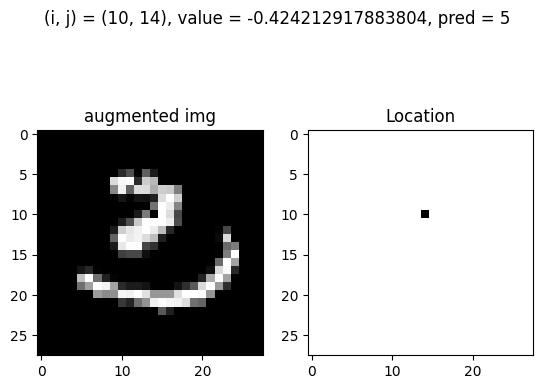

Test: At (i, j) = (10, 15) and value = -0.424212917883804, pred = 5, before_pred = 3, gt = 3


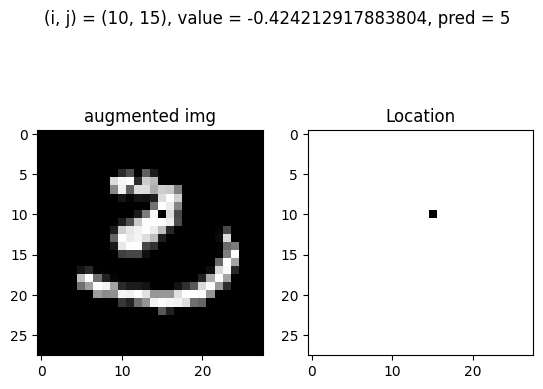

Test: At (i, j) = (10, 15) and value = -0.06357964585812692, pred = 5, before_pred = 3, gt = 3


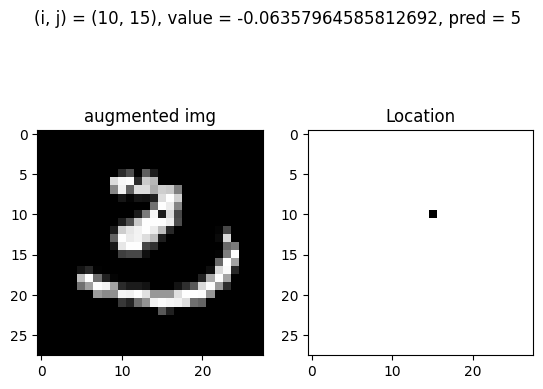

Test: At (i, j) = (10, 15) and value = 0.29705362616755016, pred = 5, before_pred = 3, gt = 3


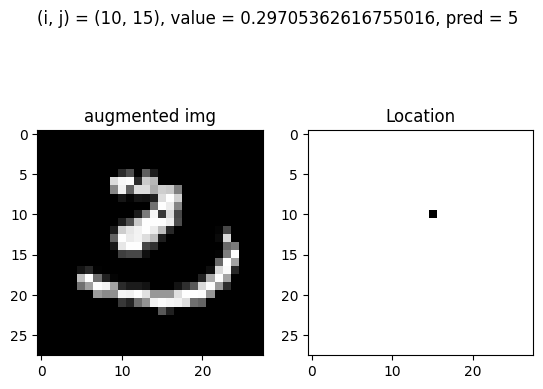

Test: At (i, j) = (10, 15) and value = 0.6576868981932272, pred = 5, before_pred = 3, gt = 3


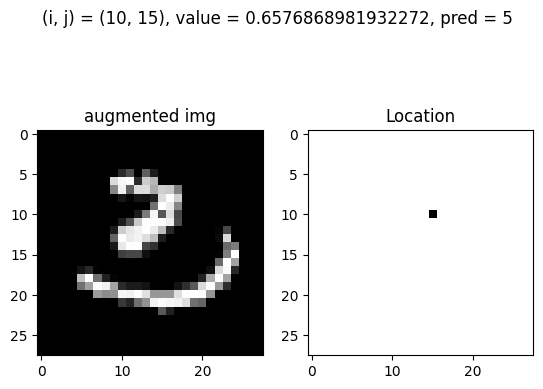

Test: At (i, j) = (10, 15) and value = 1.0183201702189044, pred = 5, before_pred = 3, gt = 3


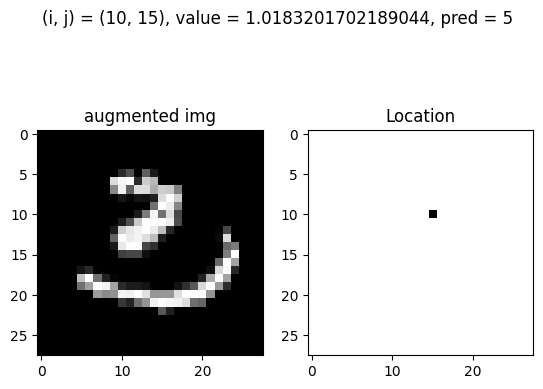

Test: At (i, j) = (10, 15) and value = 1.3789534422445815, pred = 5, before_pred = 3, gt = 3


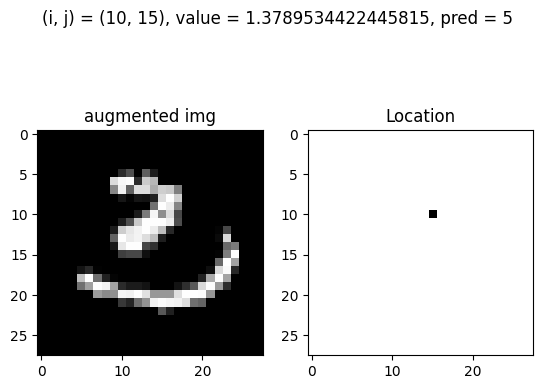

Test: At (i, j) = (10, 16) and value = -0.424212917883804, pred = 5, before_pred = 3, gt = 3


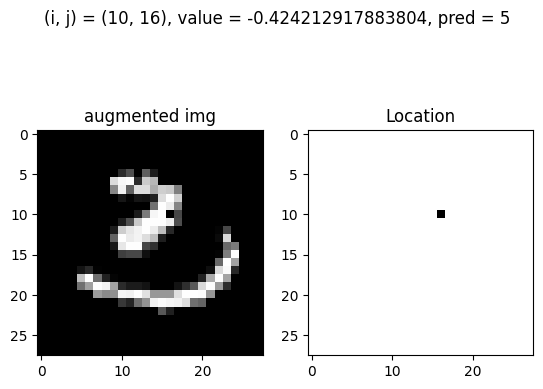

Test: At (i, j) = (10, 16) and value = -0.06357964585812692, pred = 5, before_pred = 3, gt = 3


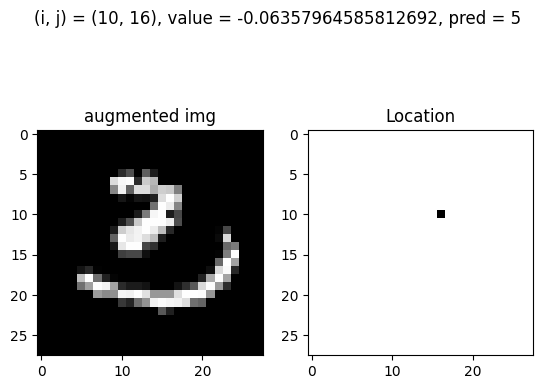

Test: At (i, j) = (10, 16) and value = 0.29705362616755016, pred = 5, before_pred = 3, gt = 3


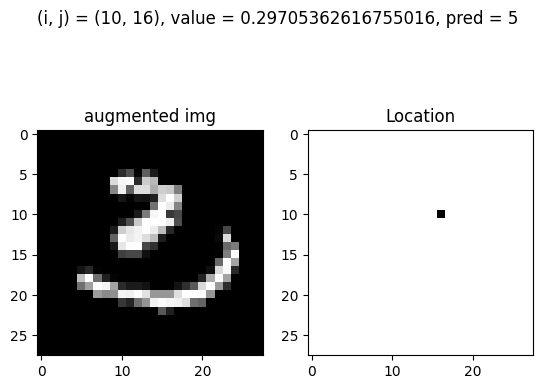

Test: At (i, j) = (10, 16) and value = 0.6576868981932272, pred = 5, before_pred = 3, gt = 3


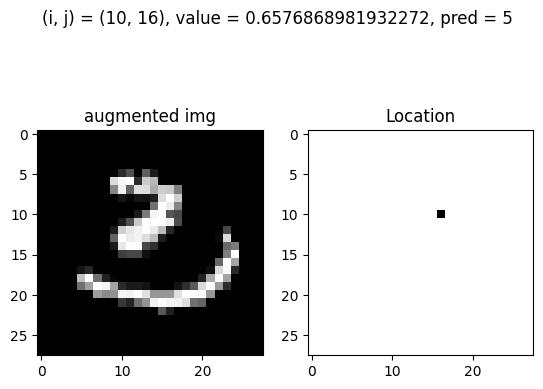

Test: At (i, j) = (10, 16) and value = 1.0183201702189044, pred = 5, before_pred = 3, gt = 3


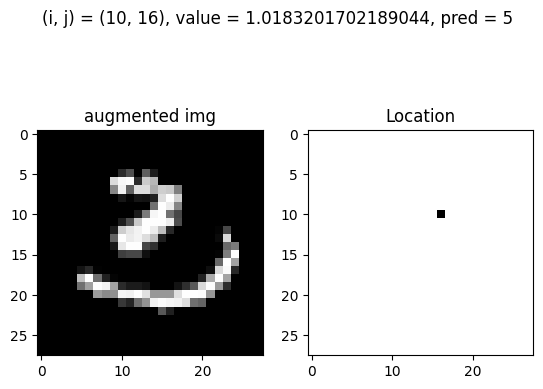

Test: At (i, j) = (10, 22) and value = 2.1002199862959356, pred = 5, before_pred = 3, gt = 3


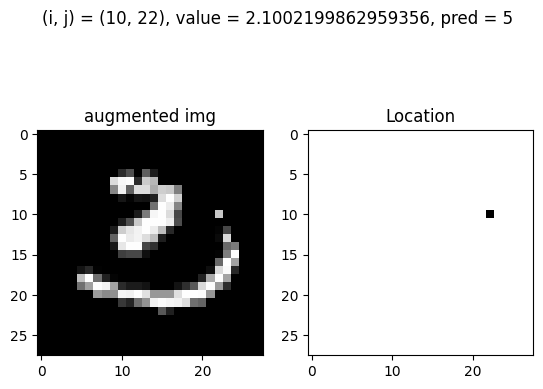

Test: At (i, j) = (10, 22) and value = 2.4608532583216127, pred = 5, before_pred = 3, gt = 3


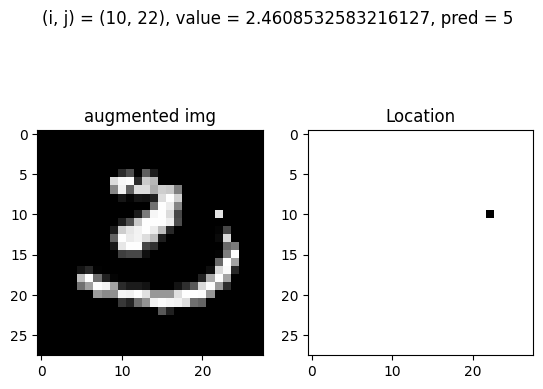

Test: At (i, j) = (10, 22) and value = 2.82148653034729, pred = 5, before_pred = 3, gt = 3


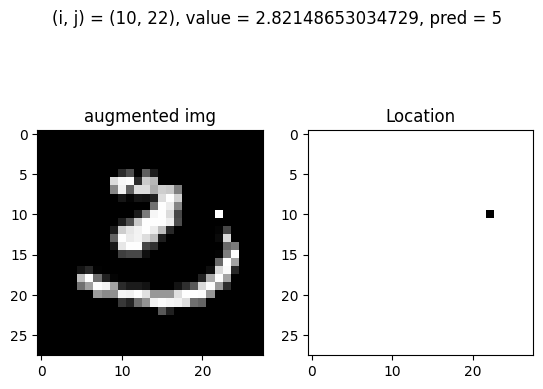

Test: At (i, j) = (11, 6) and value = 2.1002199862959356, pred = 5, before_pred = 3, gt = 3


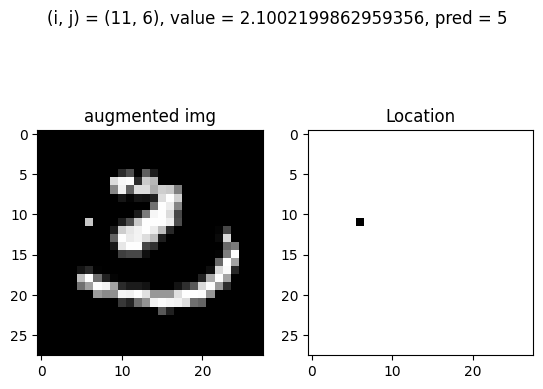

Test: At (i, j) = (11, 6) and value = 2.4608532583216127, pred = 5, before_pred = 3, gt = 3


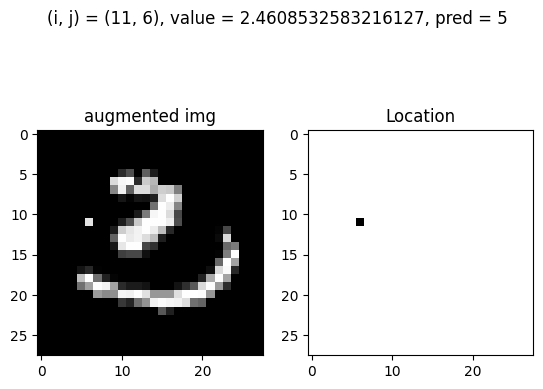

Test: At (i, j) = (11, 6) and value = 2.82148653034729, pred = 5, before_pred = 3, gt = 3


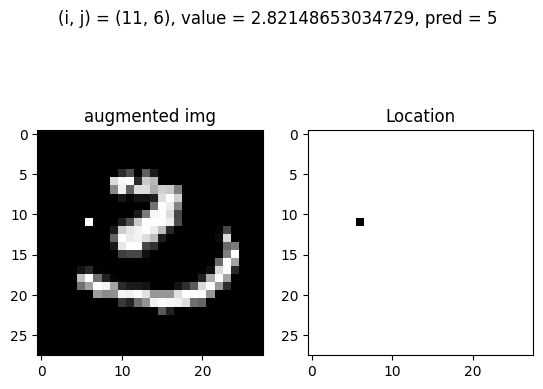

Test: At (i, j) = (11, 7) and value = 1.7395867142702586, pred = 5, before_pred = 3, gt = 3


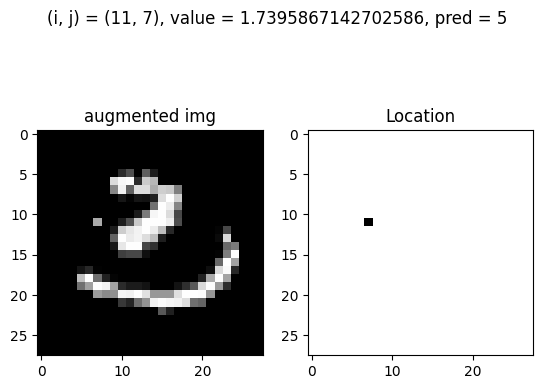

Test: At (i, j) = (11, 7) and value = 2.1002199862959356, pred = 5, before_pred = 3, gt = 3


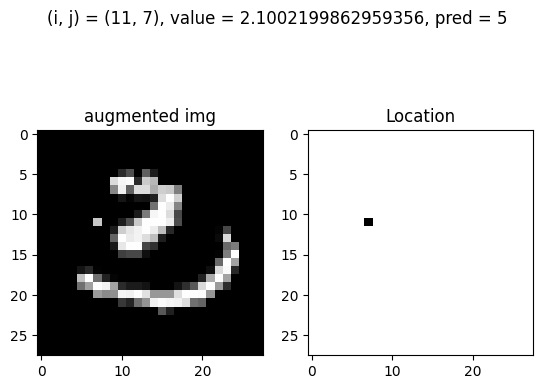

Test: At (i, j) = (11, 7) and value = 2.4608532583216127, pred = 5, before_pred = 3, gt = 3


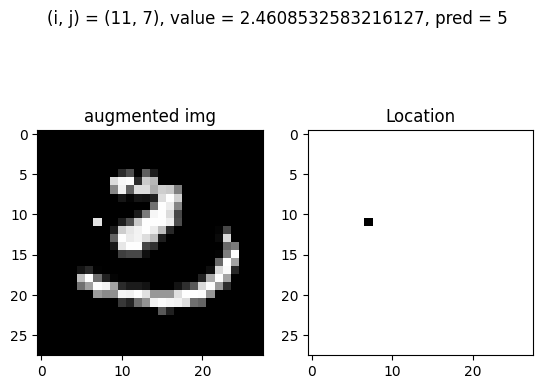

Test: At (i, j) = (11, 7) and value = 2.82148653034729, pred = 5, before_pred = 3, gt = 3


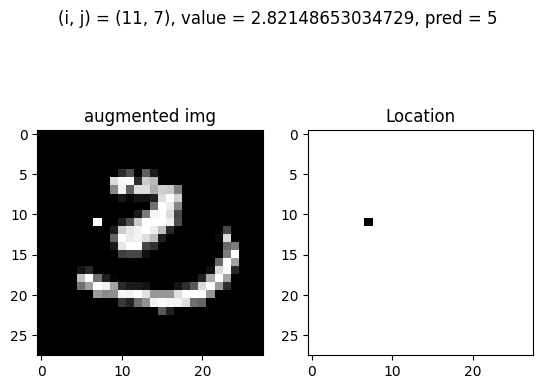

Test: At (i, j) = (11, 8) and value = 1.0183201702189044, pred = 5, before_pred = 3, gt = 3


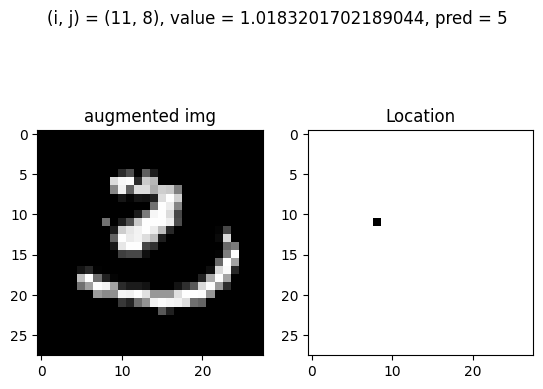

Test: At (i, j) = (11, 8) and value = 1.3789534422445815, pred = 5, before_pred = 3, gt = 3


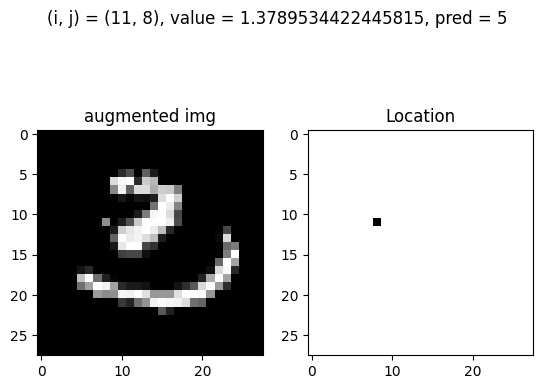

Test: At (i, j) = (11, 8) and value = 1.7395867142702586, pred = 5, before_pred = 3, gt = 3


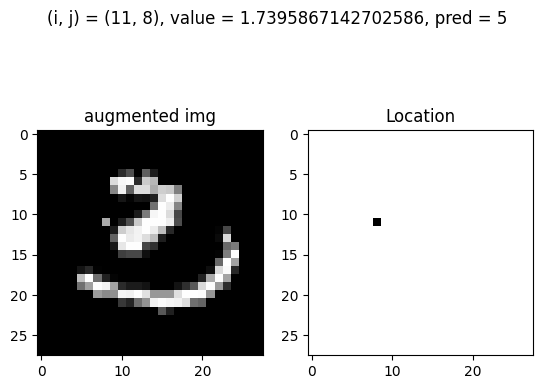

Test: At (i, j) = (11, 8) and value = 2.1002199862959356, pred = 5, before_pred = 3, gt = 3


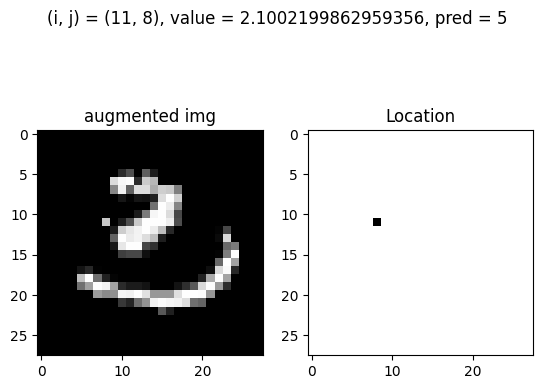

Test: At (i, j) = (11, 8) and value = 2.4608532583216127, pred = 5, before_pred = 3, gt = 3


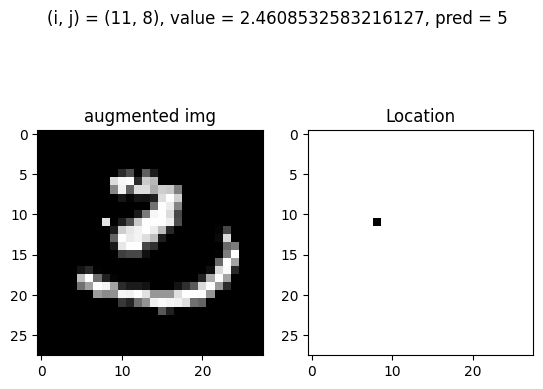

Test: At (i, j) = (11, 8) and value = 2.82148653034729, pred = 5, before_pred = 3, gt = 3


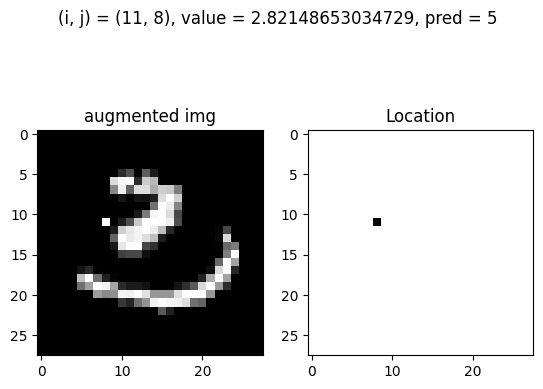

Test: At (i, j) = (11, 9) and value = 0.6576868981932272, pred = 5, before_pred = 3, gt = 3


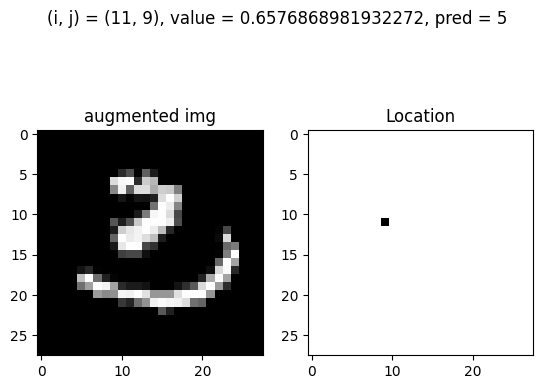

Test: At (i, j) = (11, 9) and value = 1.0183201702189044, pred = 5, before_pred = 3, gt = 3


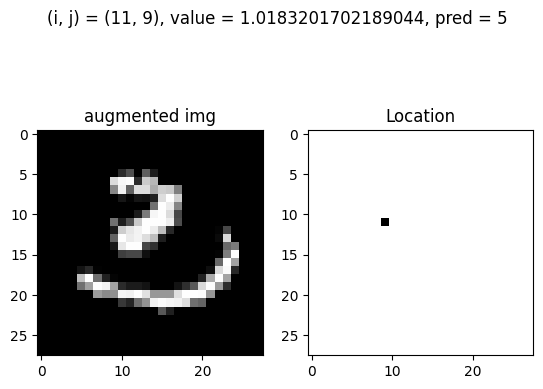

Test: At (i, j) = (11, 9) and value = 1.3789534422445815, pred = 5, before_pred = 3, gt = 3


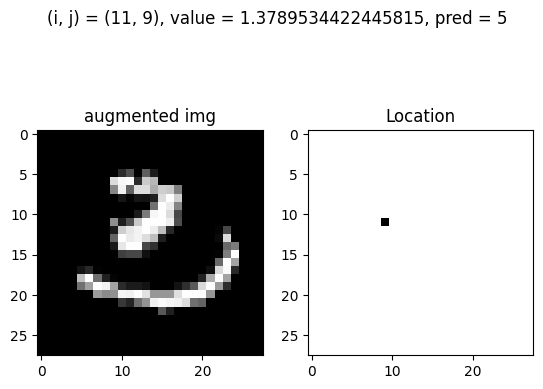

Test: At (i, j) = (11, 9) and value = 1.7395867142702586, pred = 5, before_pred = 3, gt = 3


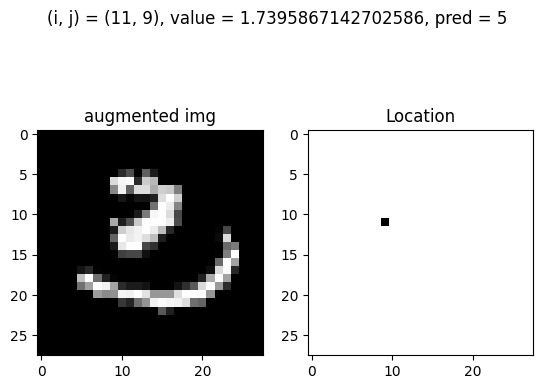

Test: At (i, j) = (11, 9) and value = 2.1002199862959356, pred = 5, before_pred = 3, gt = 3


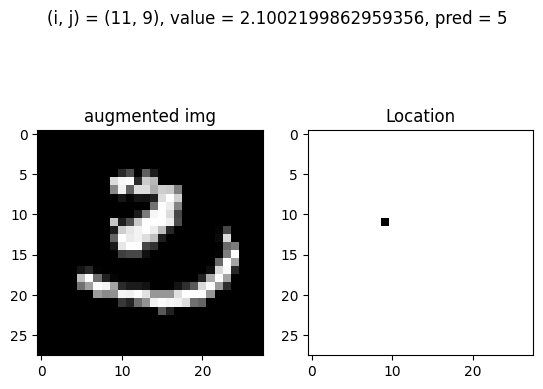

Test: At (i, j) = (11, 9) and value = 2.4608532583216127, pred = 5, before_pred = 3, gt = 3


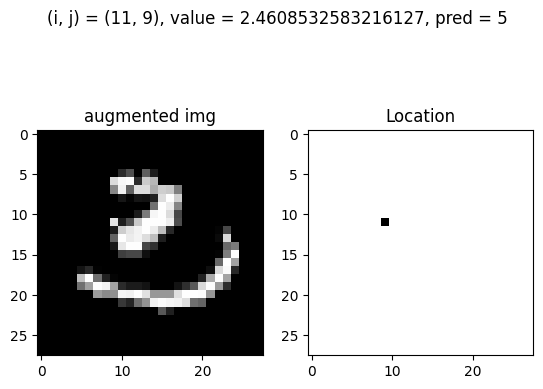

Test: At (i, j) = (11, 9) and value = 2.82148653034729, pred = 5, before_pred = 3, gt = 3


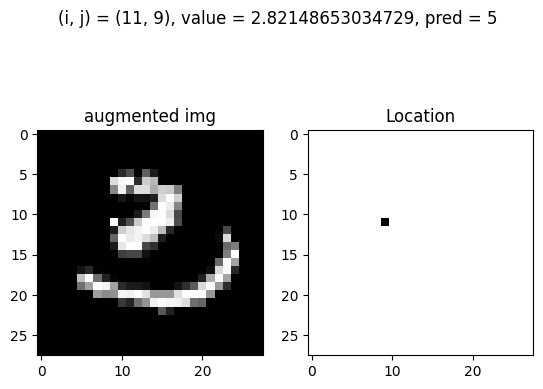

Test: At (i, j) = (11, 10) and value = 1.0183201702189044, pred = 5, before_pred = 3, gt = 3


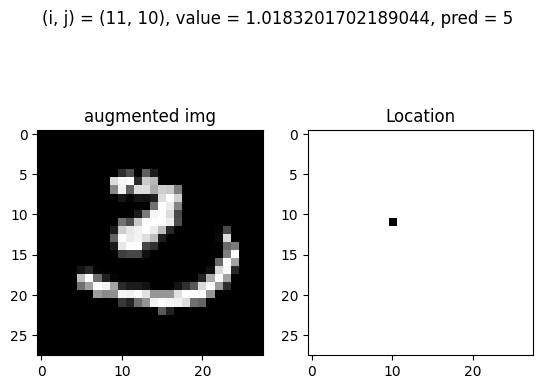

Test: At (i, j) = (11, 10) and value = 1.3789534422445815, pred = 5, before_pred = 3, gt = 3


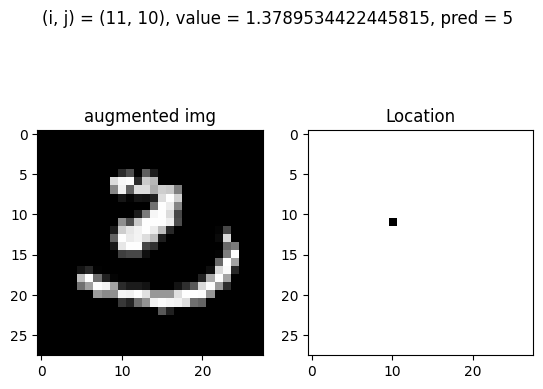

Test: At (i, j) = (11, 10) and value = 1.7395867142702586, pred = 5, before_pred = 3, gt = 3


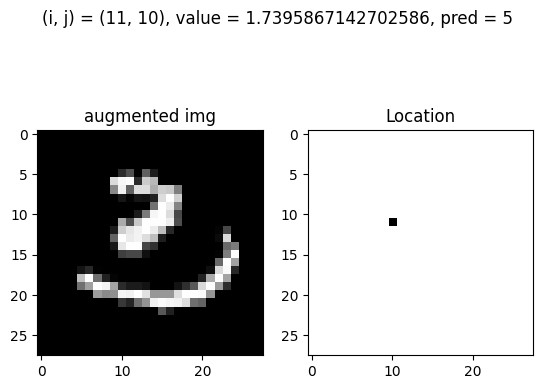

Test: At (i, j) = (11, 10) and value = 2.1002199862959356, pred = 5, before_pred = 3, gt = 3


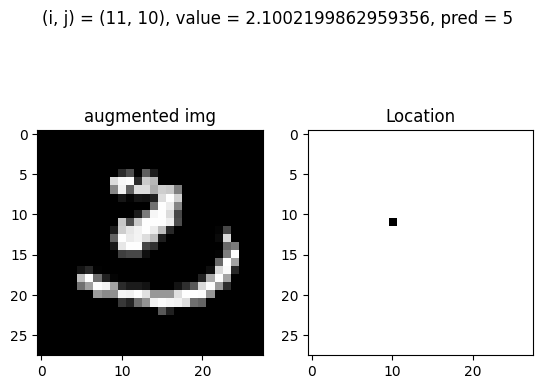

Test: At (i, j) = (11, 10) and value = 2.4608532583216127, pred = 5, before_pred = 3, gt = 3


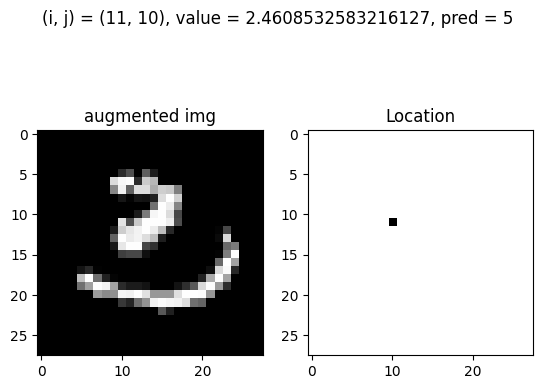

Test: At (i, j) = (11, 10) and value = 2.82148653034729, pred = 5, before_pred = 3, gt = 3


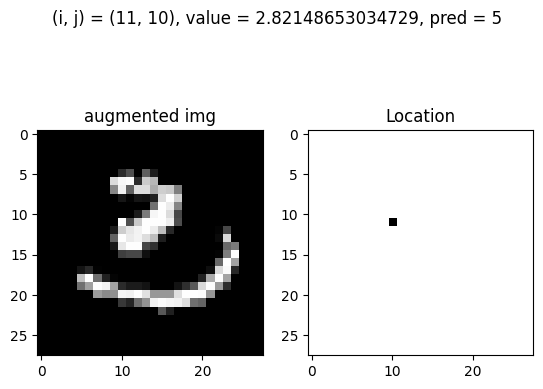

Test: At (i, j) = (11, 11) and value = 1.7395867142702586, pred = 5, before_pred = 3, gt = 3


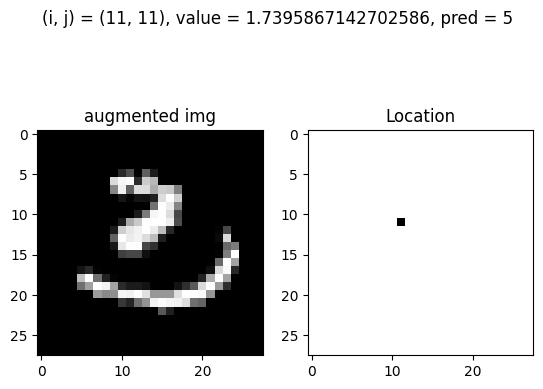

Test: At (i, j) = (11, 11) and value = 2.1002199862959356, pred = 5, before_pred = 3, gt = 3


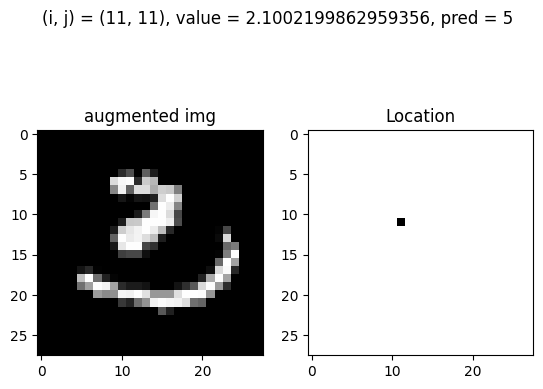

Test: At (i, j) = (11, 11) and value = 2.4608532583216127, pred = 5, before_pred = 3, gt = 3


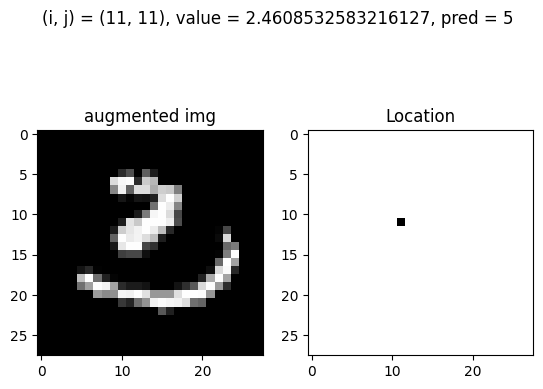

Test: At (i, j) = (11, 11) and value = 2.82148653034729, pred = 5, before_pred = 3, gt = 3


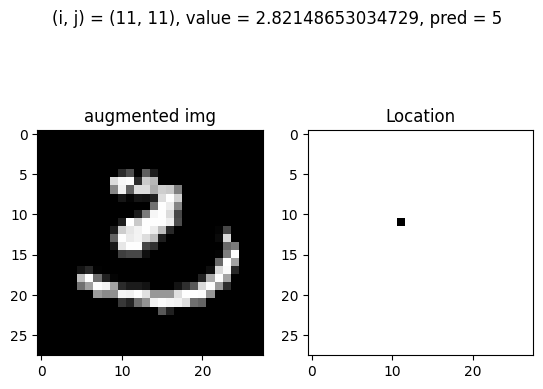

Test: At (i, j) = (11, 14) and value = -0.424212917883804, pred = 5, before_pred = 3, gt = 3


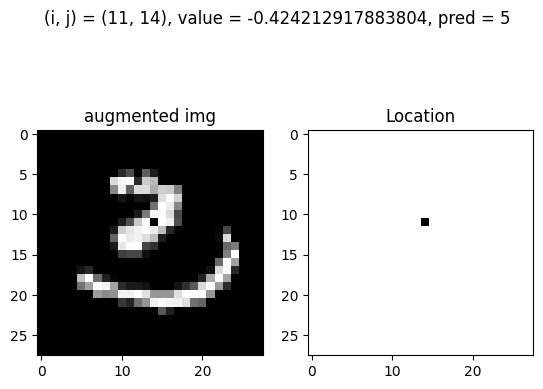

Test: At (i, j) = (11, 15) and value = -0.424212917883804, pred = 5, before_pred = 3, gt = 3


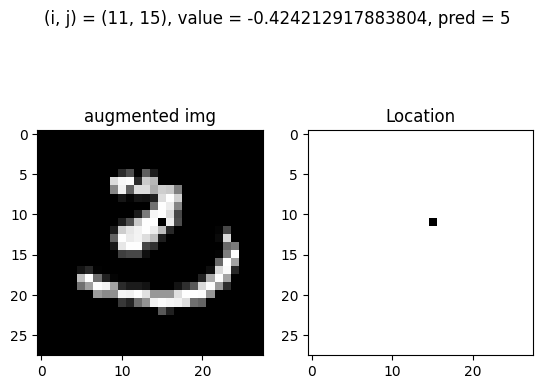

Test: At (i, j) = (11, 15) and value = -0.06357964585812692, pred = 5, before_pred = 3, gt = 3


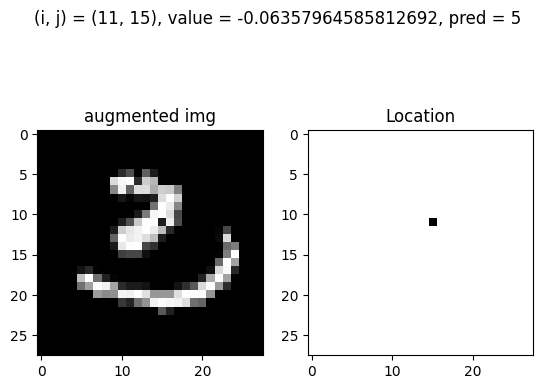

Test: At (i, j) = (11, 15) and value = 0.29705362616755016, pred = 5, before_pred = 3, gt = 3


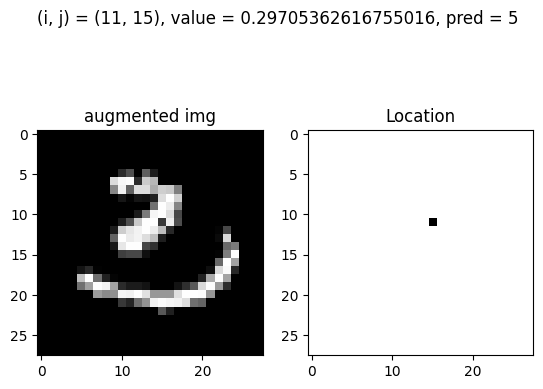

Test: At (i, j) = (11, 15) and value = 0.6576868981932272, pred = 5, before_pred = 3, gt = 3


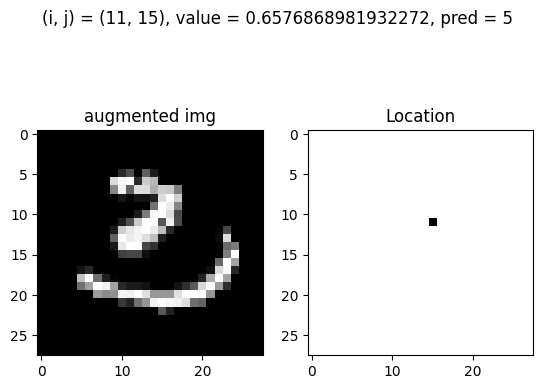

Test: At (i, j) = (11, 15) and value = 1.0183201702189044, pred = 5, before_pred = 3, gt = 3


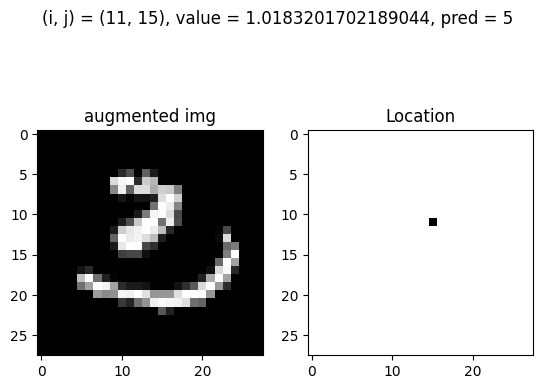

Test: At (i, j) = (11, 15) and value = 1.3789534422445815, pred = 5, before_pred = 3, gt = 3


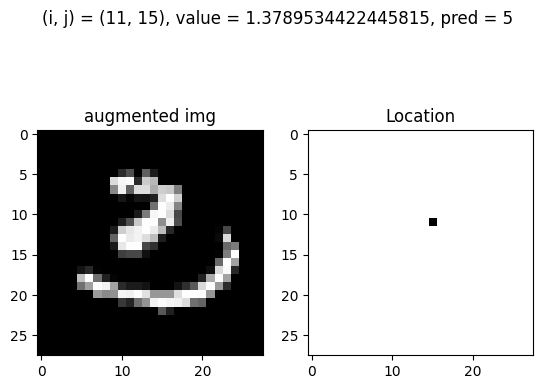

Test: At (i, j) = (11, 16) and value = -0.424212917883804, pred = 5, before_pred = 3, gt = 3


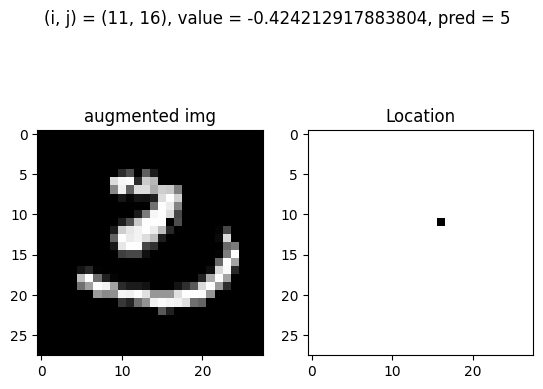

Test: At (i, j) = (11, 16) and value = -0.06357964585812692, pred = 5, before_pred = 3, gt = 3


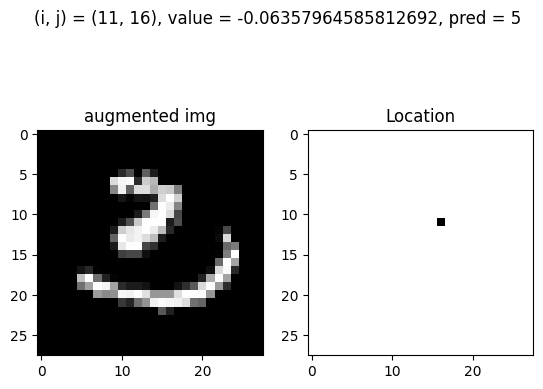

Test: At (i, j) = (11, 16) and value = 0.29705362616755016, pred = 5, before_pred = 3, gt = 3


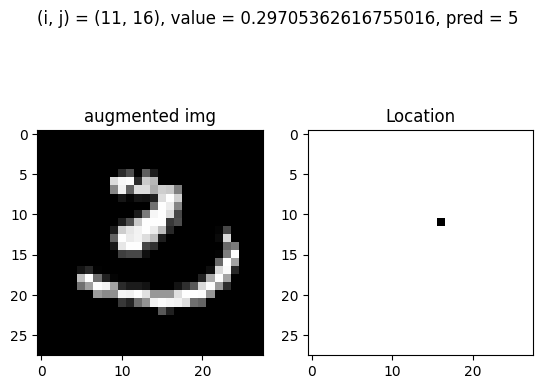

Test: At (i, j) = (11, 21) and value = 2.4608532583216127, pred = 5, before_pred = 3, gt = 3


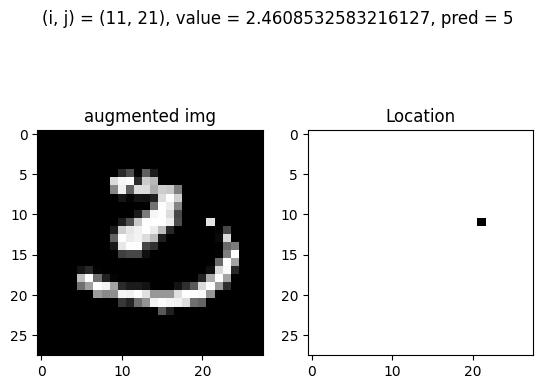

Test: At (i, j) = (11, 21) and value = 2.82148653034729, pred = 5, before_pred = 3, gt = 3


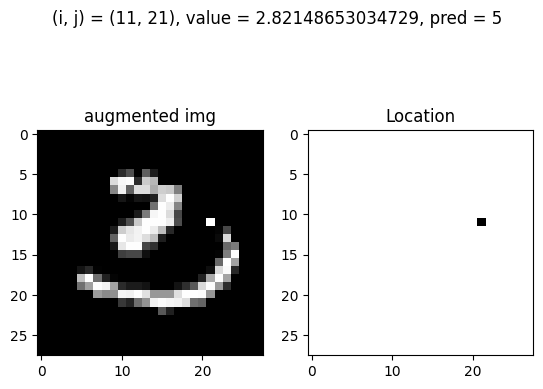

Test: At (i, j) = (12, 6) and value = 2.1002199862959356, pred = 5, before_pred = 3, gt = 3


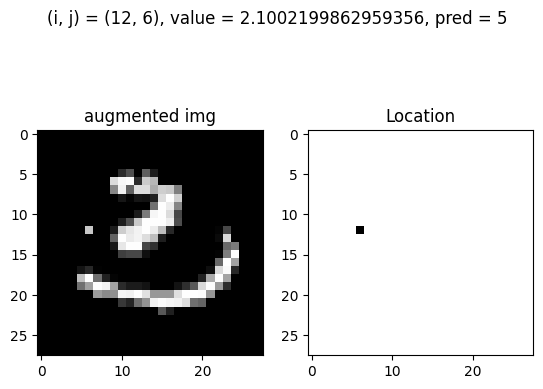

Test: At (i, j) = (12, 6) and value = 2.4608532583216127, pred = 5, before_pred = 3, gt = 3


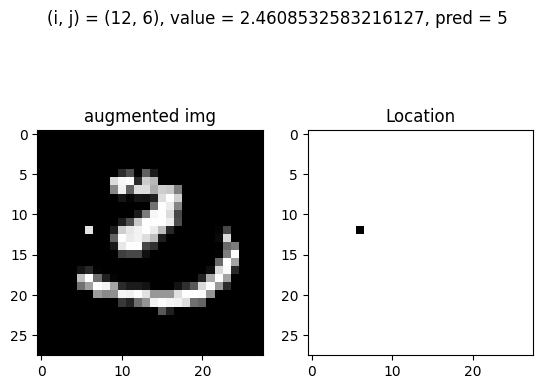

Test: At (i, j) = (12, 6) and value = 2.82148653034729, pred = 5, before_pred = 3, gt = 3


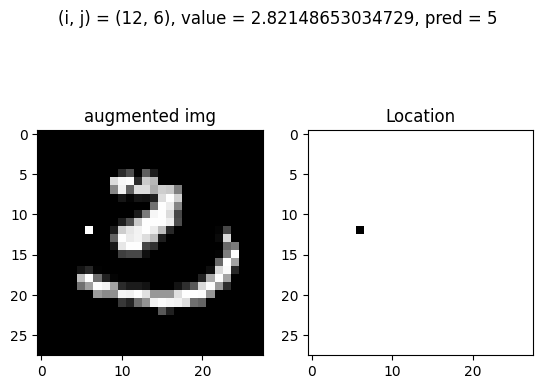

Test: At (i, j) = (12, 7) and value = 1.0183201702189044, pred = 5, before_pred = 3, gt = 3


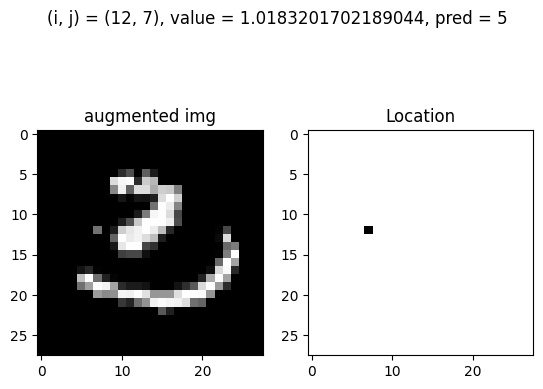

Test: At (i, j) = (12, 7) and value = 1.3789534422445815, pred = 5, before_pred = 3, gt = 3


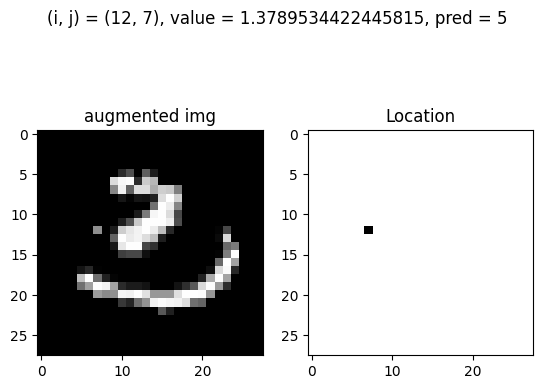

Test: At (i, j) = (12, 7) and value = 1.7395867142702586, pred = 5, before_pred = 3, gt = 3


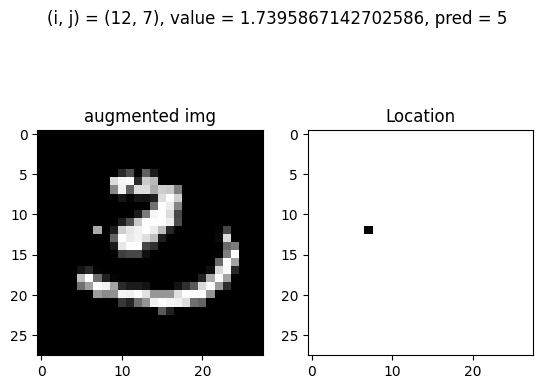

Test: At (i, j) = (12, 7) and value = 2.1002199862959356, pred = 5, before_pred = 3, gt = 3


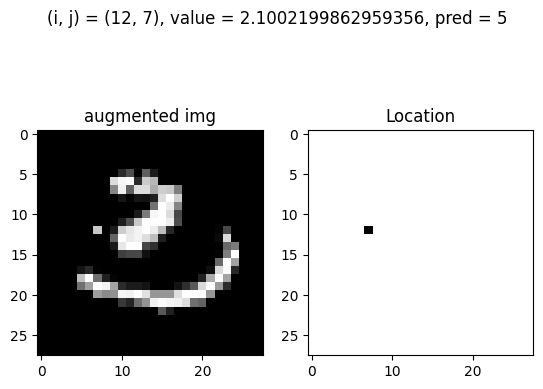

Test: At (i, j) = (12, 7) and value = 2.4608532583216127, pred = 5, before_pred = 3, gt = 3


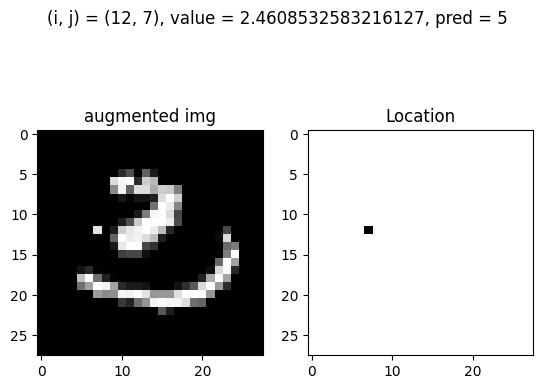

Test: At (i, j) = (12, 7) and value = 2.82148653034729, pred = 5, before_pred = 3, gt = 3


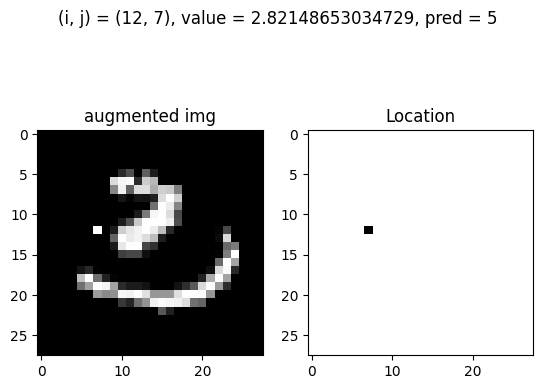

Test: At (i, j) = (12, 8) and value = 1.0183201702189044, pred = 5, before_pred = 3, gt = 3


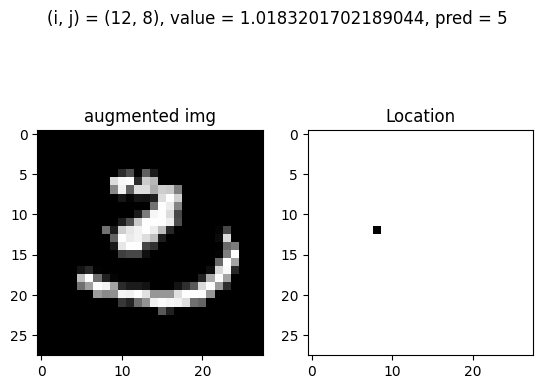

Test: At (i, j) = (12, 8) and value = 1.3789534422445815, pred = 5, before_pred = 3, gt = 3


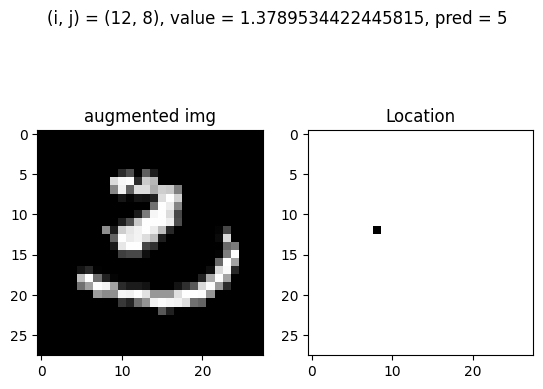

Test: At (i, j) = (12, 8) and value = 1.7395867142702586, pred = 5, before_pred = 3, gt = 3


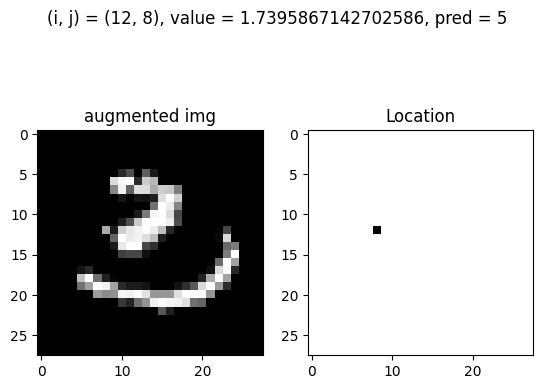

Test: At (i, j) = (12, 8) and value = 2.1002199862959356, pred = 5, before_pred = 3, gt = 3


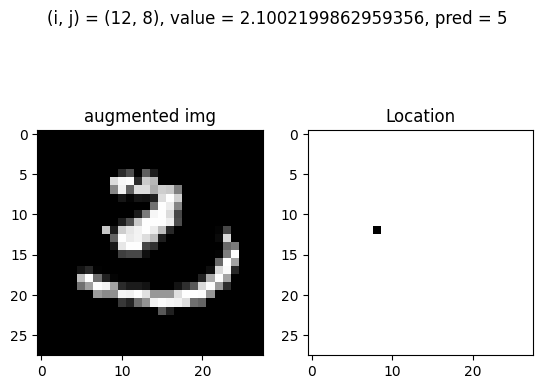

Test: At (i, j) = (12, 8) and value = 2.4608532583216127, pred = 5, before_pred = 3, gt = 3


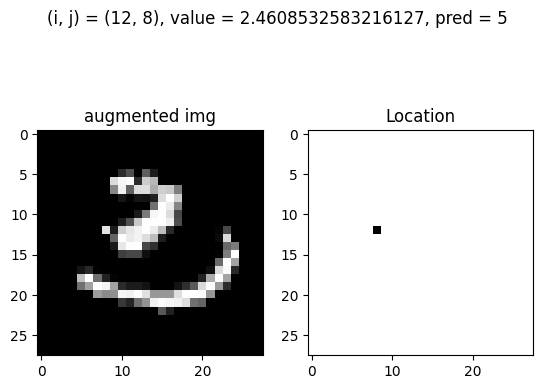

Test: At (i, j) = (12, 8) and value = 2.82148653034729, pred = 5, before_pred = 3, gt = 3


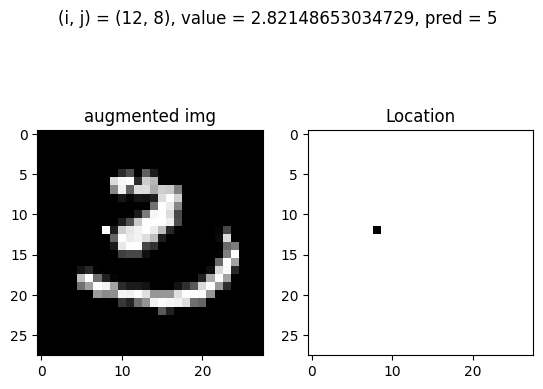

Test: At (i, j) = (12, 9) and value = 1.3789534422445815, pred = 5, before_pred = 3, gt = 3


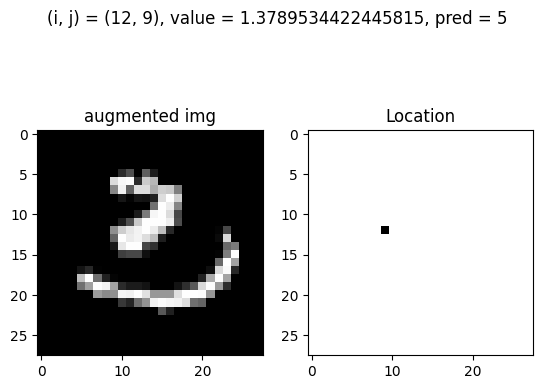

Test: At (i, j) = (12, 9) and value = 1.7395867142702586, pred = 5, before_pred = 3, gt = 3


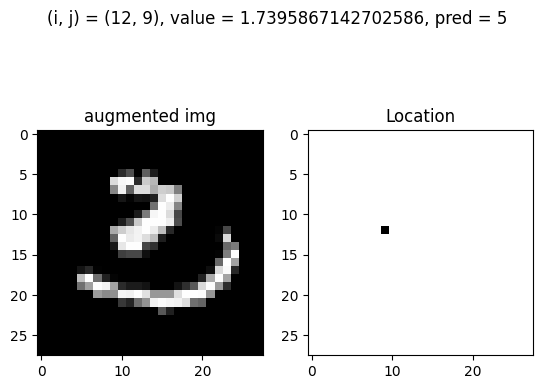

Test: At (i, j) = (12, 9) and value = 2.1002199862959356, pred = 5, before_pred = 3, gt = 3


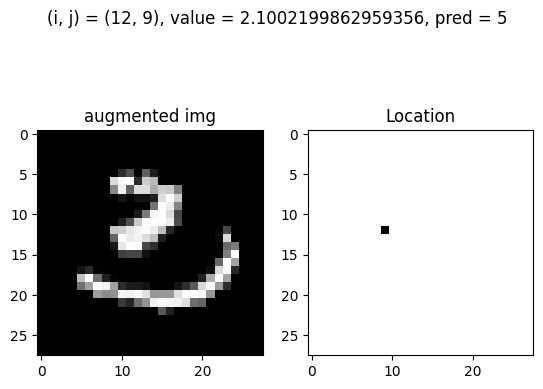

Test: At (i, j) = (12, 9) and value = 2.4608532583216127, pred = 5, before_pred = 3, gt = 3


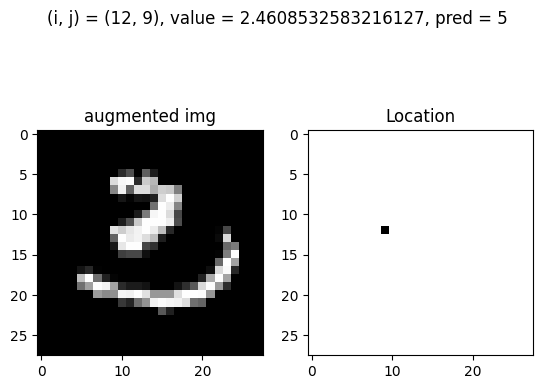

Test: At (i, j) = (12, 9) and value = 2.82148653034729, pred = 5, before_pred = 3, gt = 3


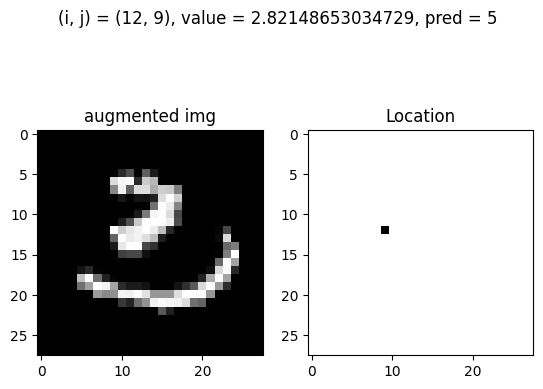

Test: At (i, j) = (12, 14) and value = -0.424212917883804, pred = 5, before_pred = 3, gt = 3


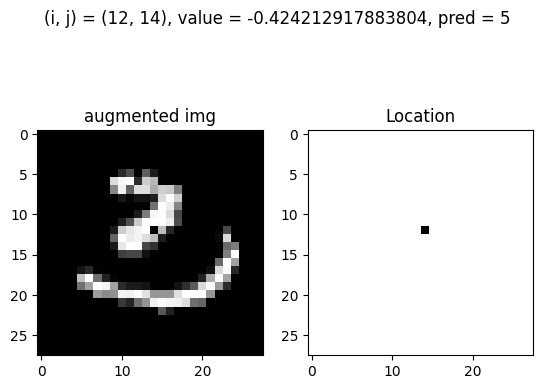

Test: At (i, j) = (12, 14) and value = -0.06357964585812692, pred = 5, before_pred = 3, gt = 3


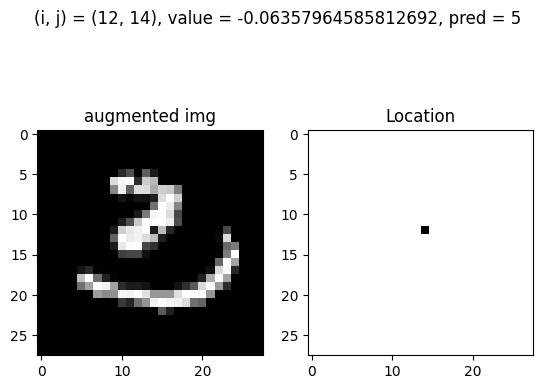

Test: At (i, j) = (12, 14) and value = 0.29705362616755016, pred = 5, before_pred = 3, gt = 3


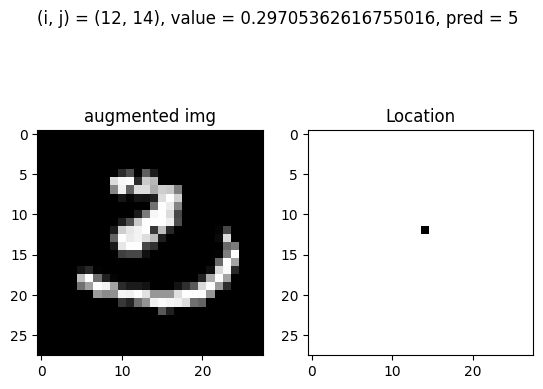

Test: At (i, j) = (12, 14) and value = 0.6576868981932272, pred = 5, before_pred = 3, gt = 3


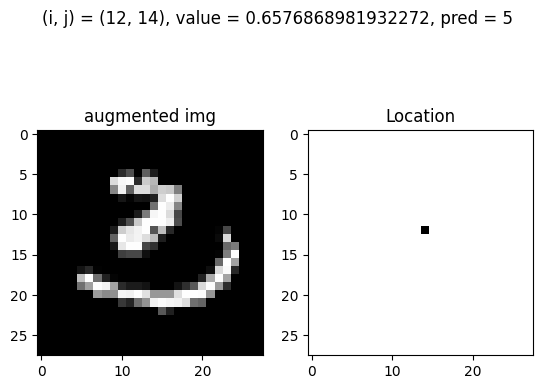

Test: At (i, j) = (12, 15) and value = -0.424212917883804, pred = 5, before_pred = 3, gt = 3


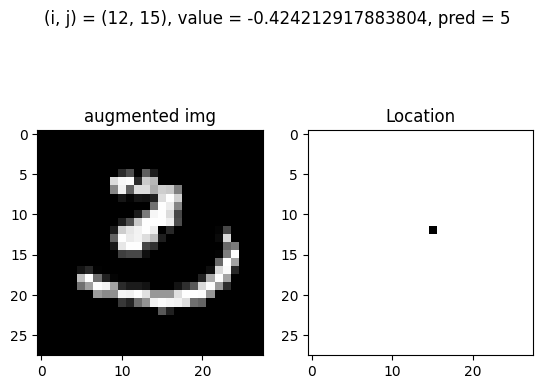

Test: At (i, j) = (13, 6) and value = 1.3789534422445815, pred = 5, before_pred = 3, gt = 3


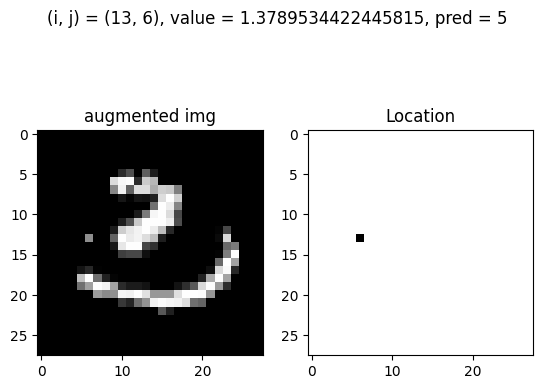

Test: At (i, j) = (13, 6) and value = 1.7395867142702586, pred = 5, before_pred = 3, gt = 3


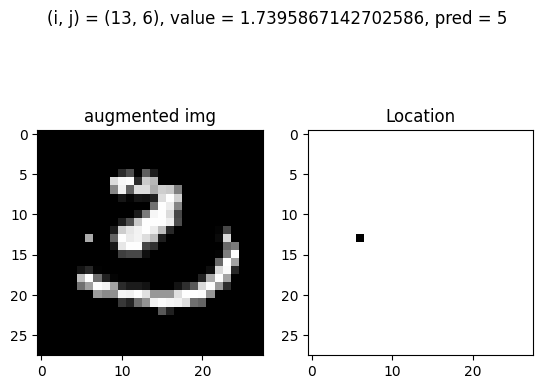

Test: At (i, j) = (13, 6) and value = 2.1002199862959356, pred = 5, before_pred = 3, gt = 3


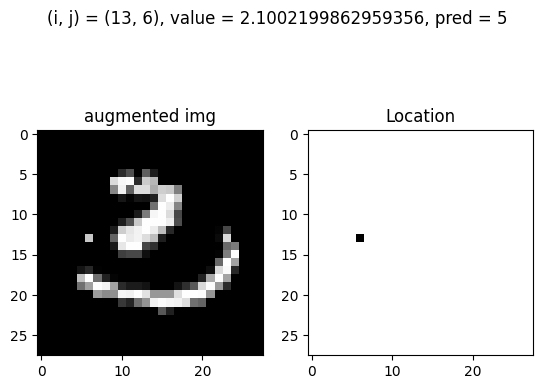

Test: At (i, j) = (13, 6) and value = 2.4608532583216127, pred = 5, before_pred = 3, gt = 3


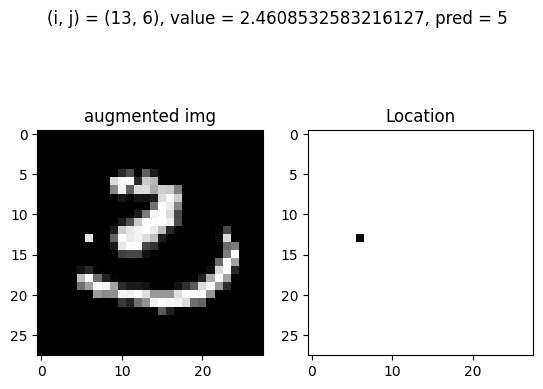

Test: At (i, j) = (13, 6) and value = 2.82148653034729, pred = 5, before_pred = 3, gt = 3


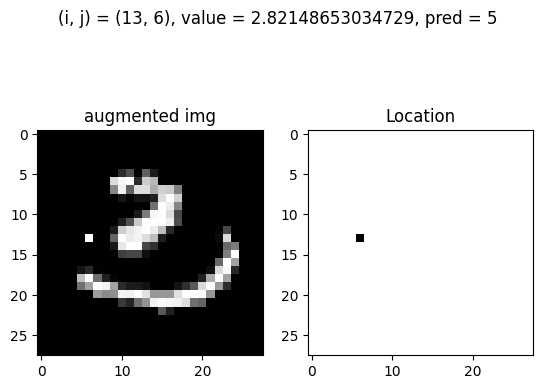

Test: At (i, j) = (13, 7) and value = 1.3789534422445815, pred = 5, before_pred = 3, gt = 3


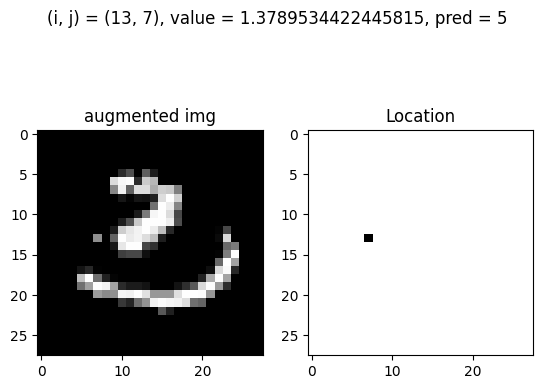

Test: At (i, j) = (13, 7) and value = 1.7395867142702586, pred = 5, before_pred = 3, gt = 3


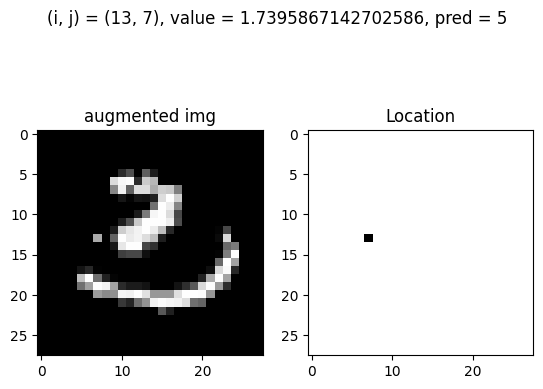

Test: At (i, j) = (13, 7) and value = 2.1002199862959356, pred = 5, before_pred = 3, gt = 3


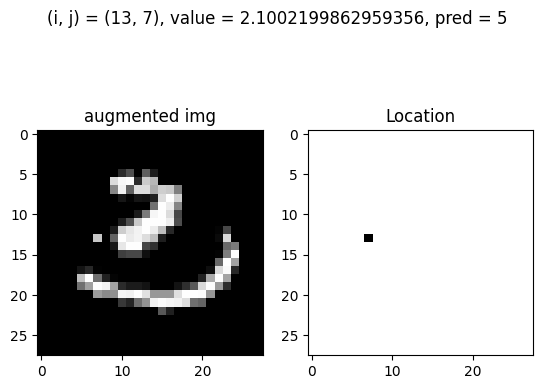

Test: At (i, j) = (13, 7) and value = 2.4608532583216127, pred = 5, before_pred = 3, gt = 3


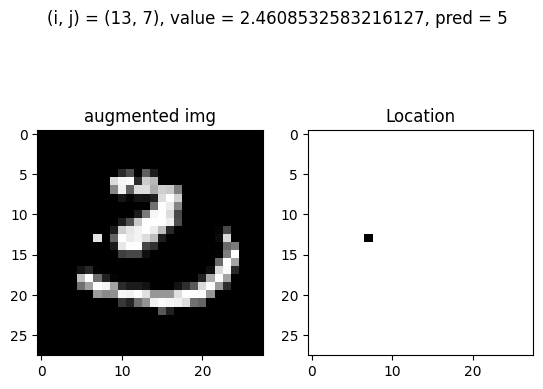

Test: At (i, j) = (13, 7) and value = 2.82148653034729, pred = 5, before_pred = 3, gt = 3


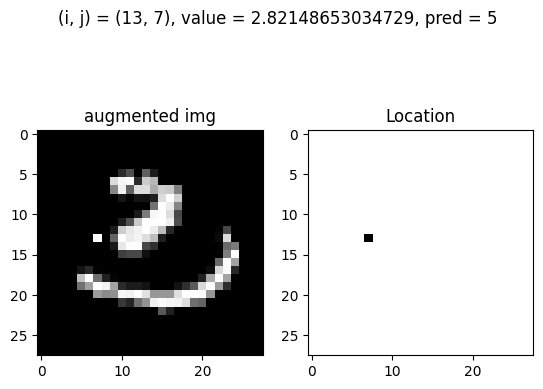

Test: At (i, j) = (13, 8) and value = 0.6576868981932272, pred = 5, before_pred = 3, gt = 3


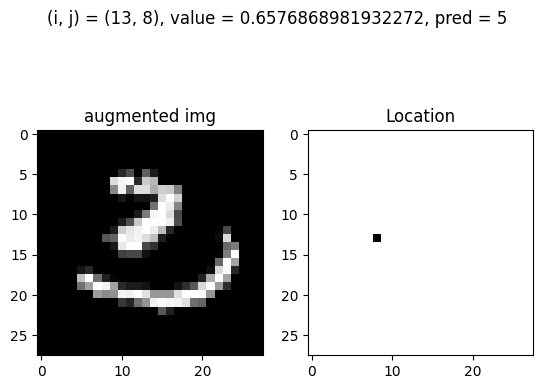

Test: At (i, j) = (13, 8) and value = 1.0183201702189044, pred = 5, before_pred = 3, gt = 3


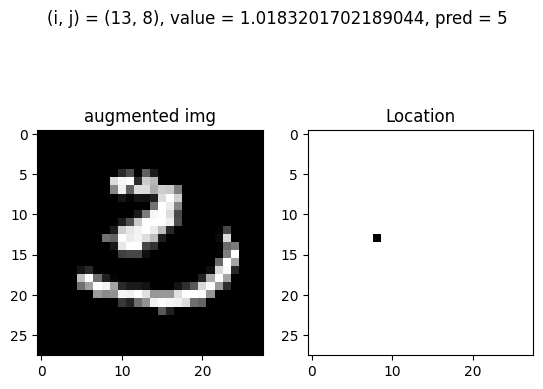

Test: At (i, j) = (13, 8) and value = 1.3789534422445815, pred = 5, before_pred = 3, gt = 3


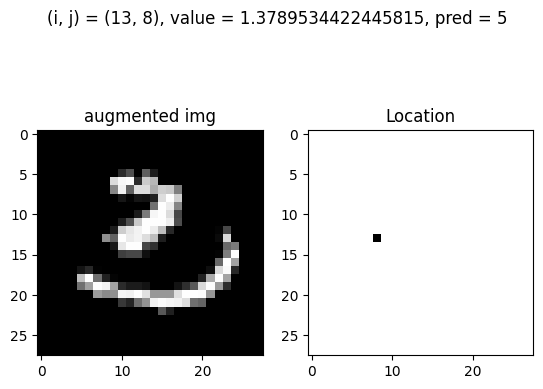

Test: At (i, j) = (13, 8) and value = 1.7395867142702586, pred = 5, before_pred = 3, gt = 3


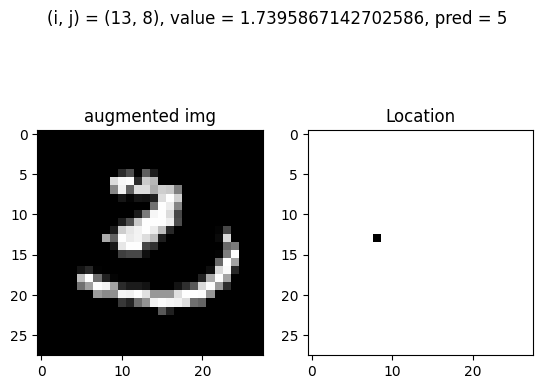

Test: At (i, j) = (13, 8) and value = 2.1002199862959356, pred = 5, before_pred = 3, gt = 3


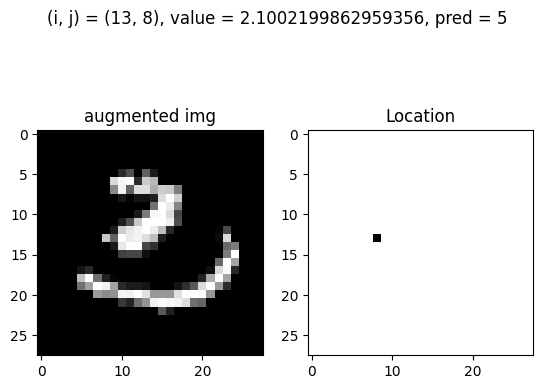

Test: At (i, j) = (13, 8) and value = 2.4608532583216127, pred = 5, before_pred = 3, gt = 3


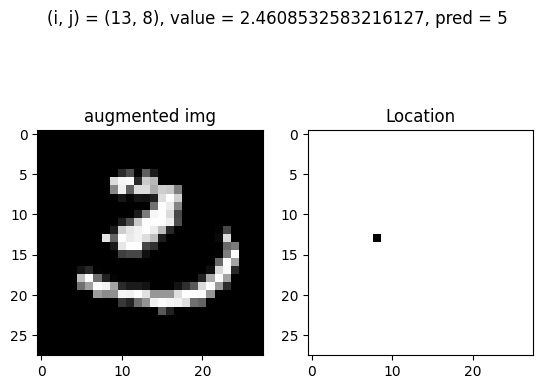

Test: At (i, j) = (13, 8) and value = 2.82148653034729, pred = 5, before_pred = 3, gt = 3


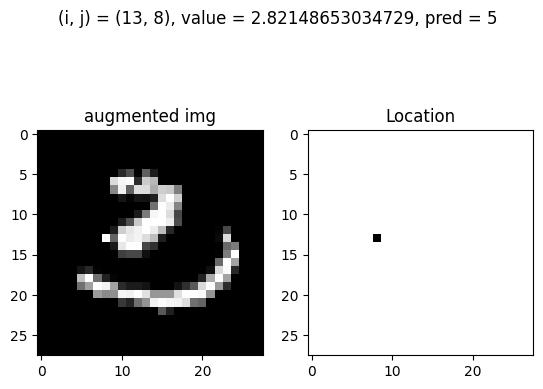

Test: At (i, j) = (13, 9) and value = 2.1002199862959356, pred = 5, before_pred = 3, gt = 3


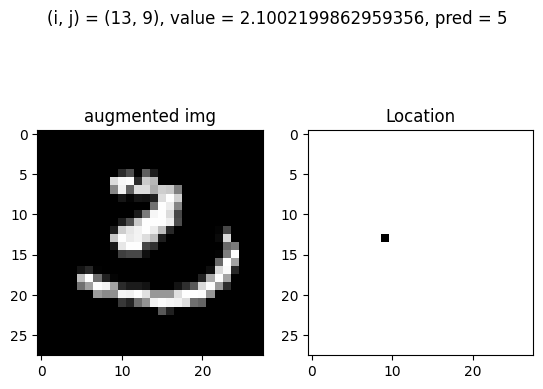

Test: At (i, j) = (13, 9) and value = 2.4608532583216127, pred = 5, before_pred = 3, gt = 3


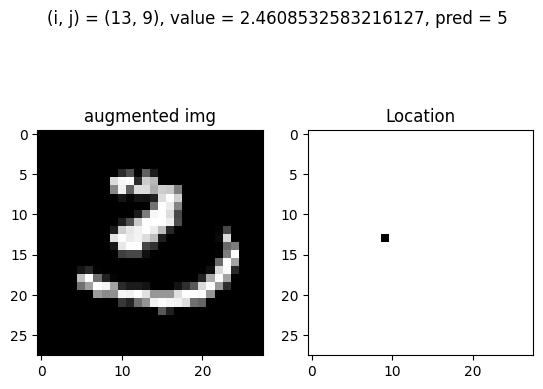

Test: At (i, j) = (13, 9) and value = 2.82148653034729, pred = 5, before_pred = 3, gt = 3


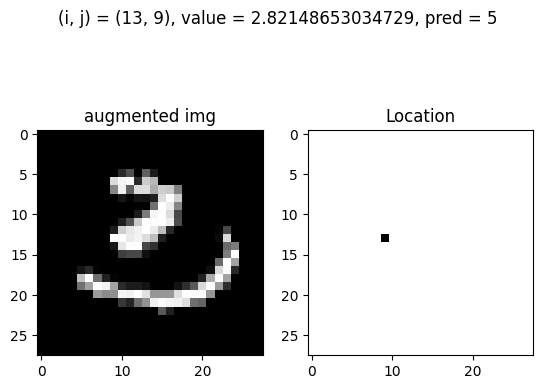

Test: At (i, j) = (13, 22) and value = 2.4608532583216127, pred = 5, before_pred = 3, gt = 3


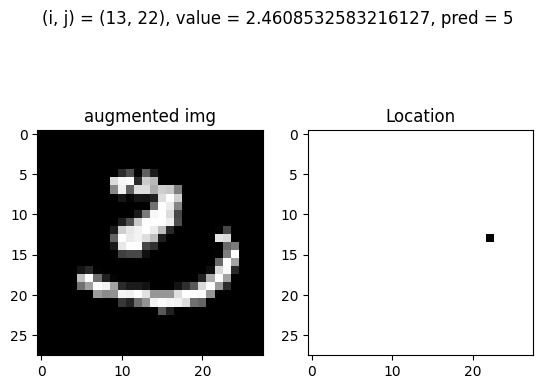

Test: At (i, j) = (13, 22) and value = 2.82148653034729, pred = 5, before_pred = 3, gt = 3


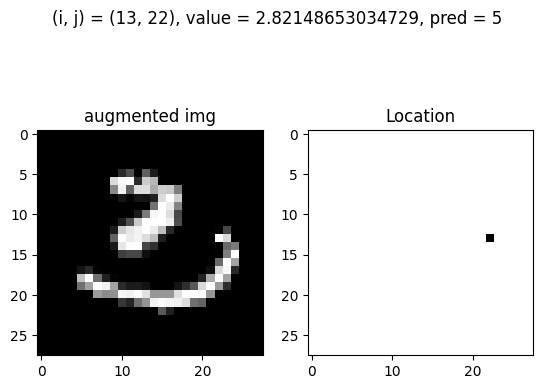

Test: At (i, j) = (14, 4) and value = 2.1002199862959356, pred = 5, before_pred = 3, gt = 3


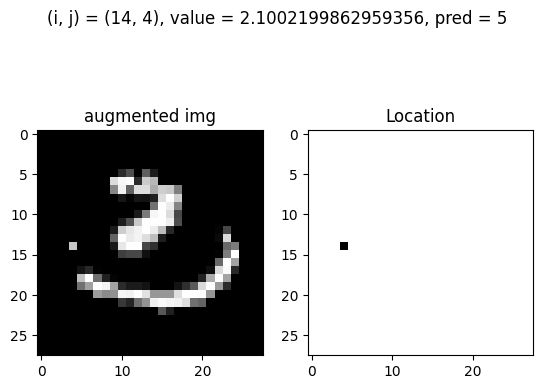

Test: At (i, j) = (14, 4) and value = 2.4608532583216127, pred = 5, before_pred = 3, gt = 3


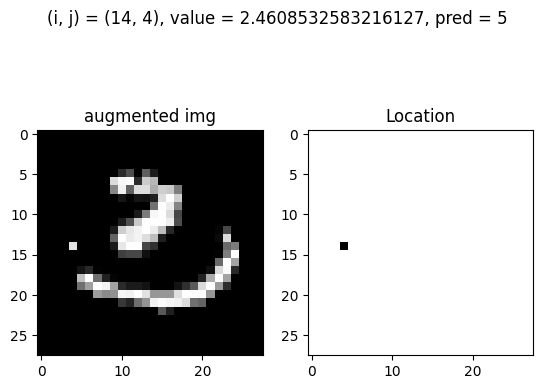

Test: At (i, j) = (14, 4) and value = 2.82148653034729, pred = 5, before_pred = 3, gt = 3


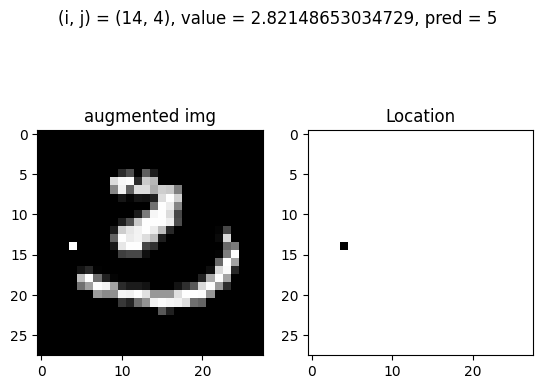

Test: At (i, j) = (14, 6) and value = 1.7395867142702586, pred = 5, before_pred = 3, gt = 3


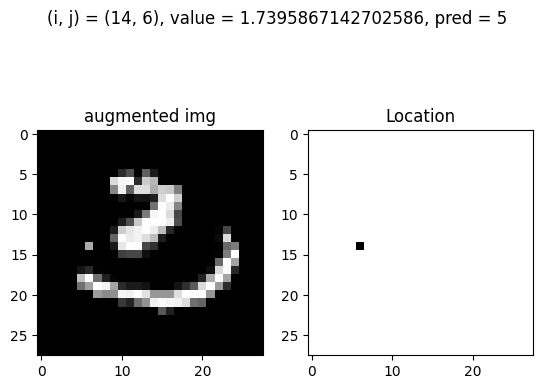

Test: At (i, j) = (14, 6) and value = 2.1002199862959356, pred = 5, before_pred = 3, gt = 3


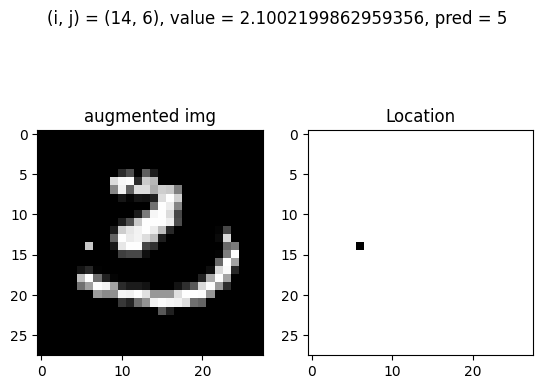

Test: At (i, j) = (14, 6) and value = 2.4608532583216127, pred = 5, before_pred = 3, gt = 3


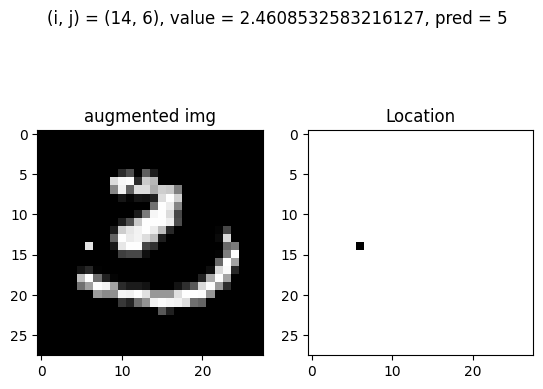

Test: At (i, j) = (14, 6) and value = 2.82148653034729, pred = 5, before_pred = 3, gt = 3


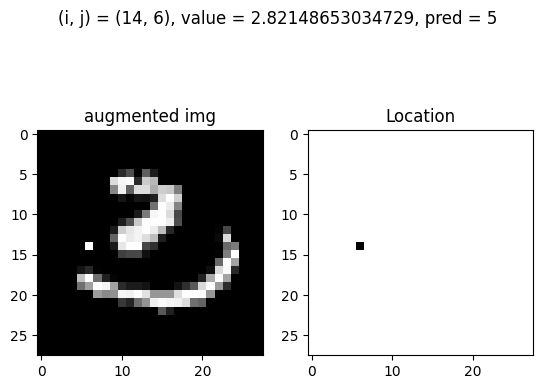

Test: At (i, j) = (14, 7) and value = 1.3789534422445815, pred = 5, before_pred = 3, gt = 3


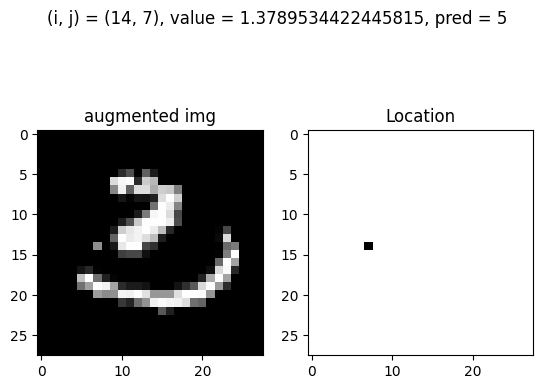

Test: At (i, j) = (14, 7) and value = 1.7395867142702586, pred = 5, before_pred = 3, gt = 3


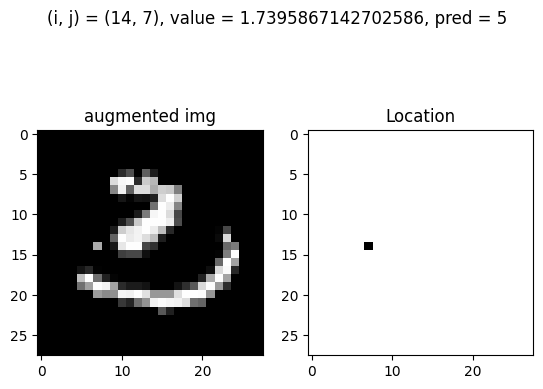

Test: At (i, j) = (14, 7) and value = 2.1002199862959356, pred = 5, before_pred = 3, gt = 3


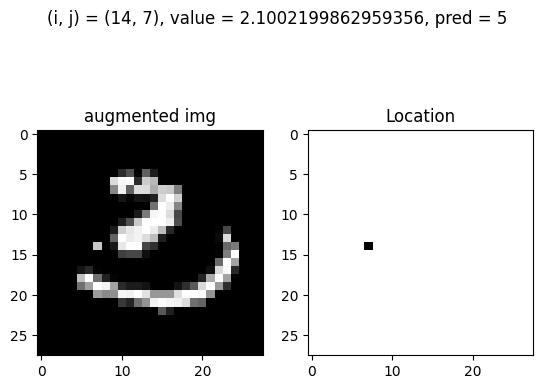

Test: At (i, j) = (14, 7) and value = 2.4608532583216127, pred = 5, before_pred = 3, gt = 3


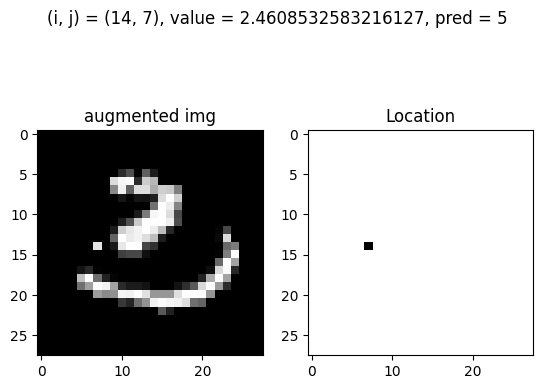

Test: At (i, j) = (14, 7) and value = 2.82148653034729, pred = 5, before_pred = 3, gt = 3


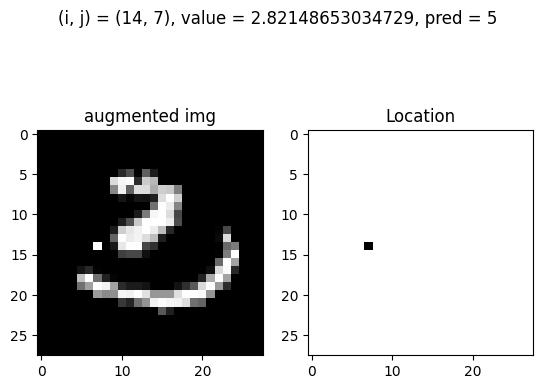

Test: At (i, j) = (14, 8) and value = 1.0183201702189044, pred = 5, before_pred = 3, gt = 3


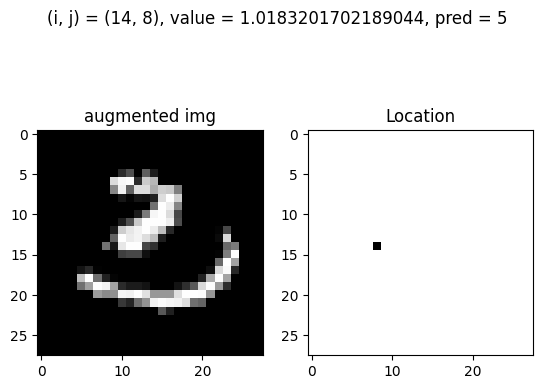

Test: At (i, j) = (14, 8) and value = 1.3789534422445815, pred = 5, before_pred = 3, gt = 3


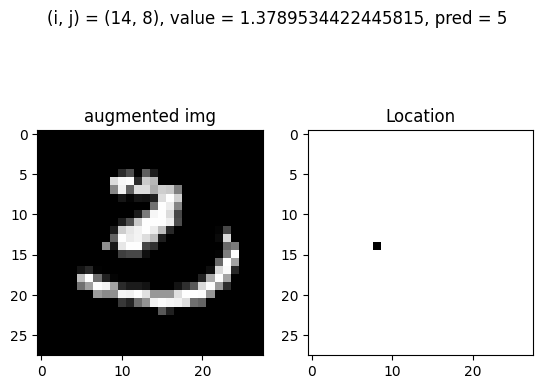

Test: At (i, j) = (14, 8) and value = 1.7395867142702586, pred = 5, before_pred = 3, gt = 3


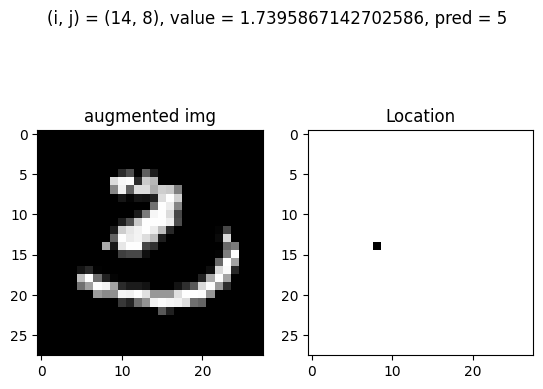

Test: At (i, j) = (14, 8) and value = 2.1002199862959356, pred = 5, before_pred = 3, gt = 3


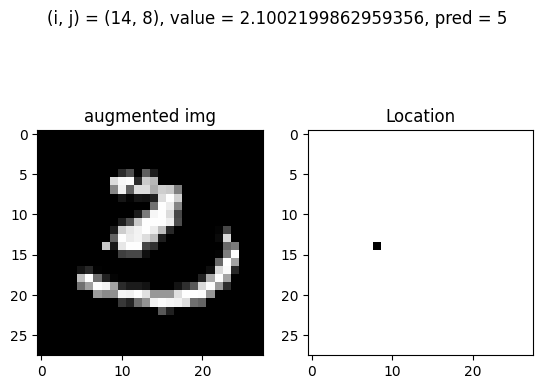

Test: At (i, j) = (14, 8) and value = 2.4608532583216127, pred = 5, before_pred = 3, gt = 3


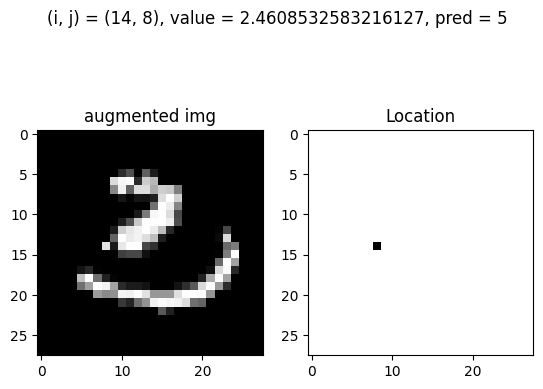

Test: At (i, j) = (14, 8) and value = 2.82148653034729, pred = 5, before_pred = 3, gt = 3


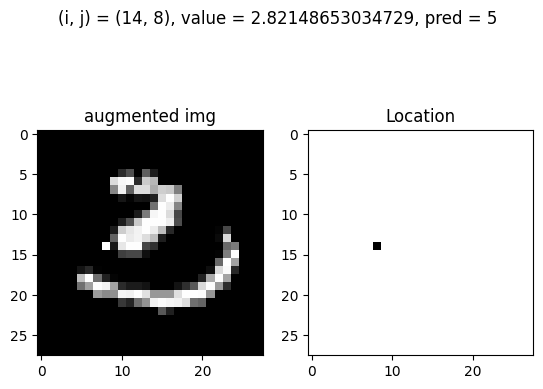

Test: At (i, j) = (14, 9) and value = 1.3789534422445815, pred = 5, before_pred = 3, gt = 3


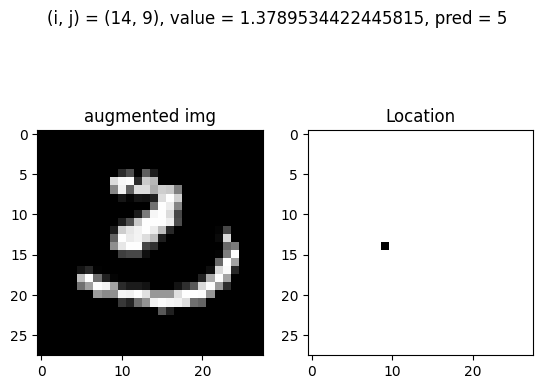

Test: At (i, j) = (14, 9) and value = 1.7395867142702586, pred = 5, before_pred = 3, gt = 3


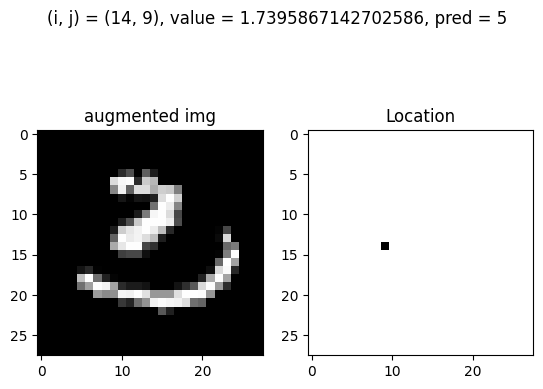

Test: At (i, j) = (14, 9) and value = 2.1002199862959356, pred = 5, before_pred = 3, gt = 3


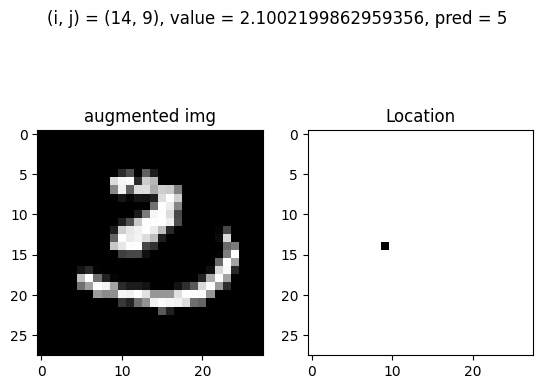

Test: At (i, j) = (14, 9) and value = 2.4608532583216127, pred = 5, before_pred = 3, gt = 3


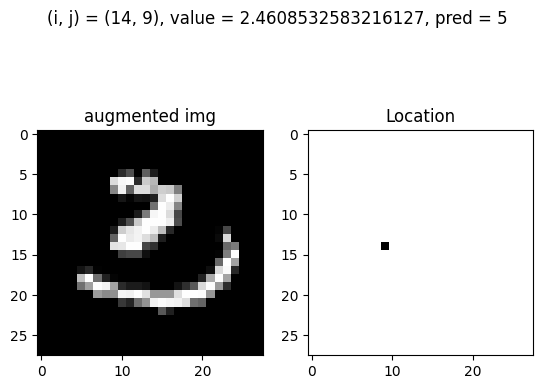

Test: At (i, j) = (14, 9) and value = 2.82148653034729, pred = 5, before_pred = 3, gt = 3


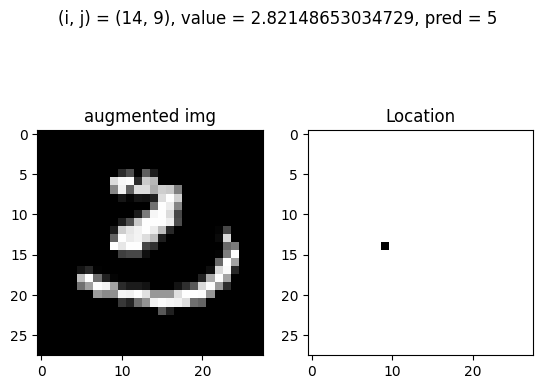

Test: At (i, j) = (14, 22) and value = 2.1002199862959356, pred = 5, before_pred = 3, gt = 3


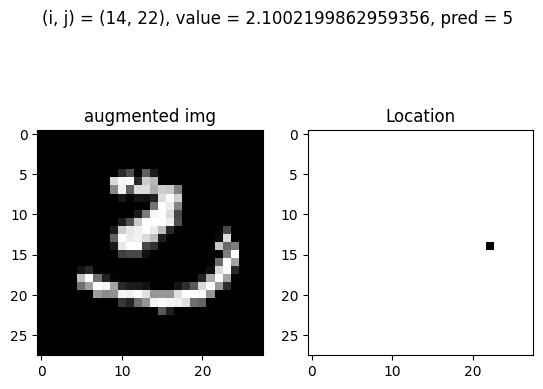

Test: At (i, j) = (14, 22) and value = 2.4608532583216127, pred = 5, before_pred = 3, gt = 3


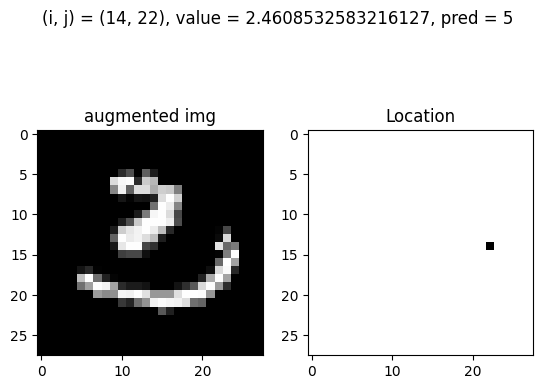

Test: At (i, j) = (14, 22) and value = 2.82148653034729, pred = 5, before_pred = 3, gt = 3


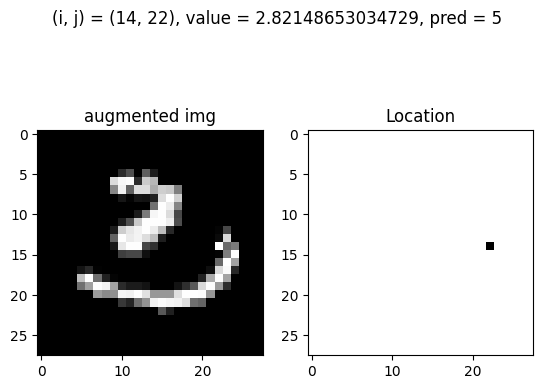

Test: At (i, j) = (15, 6) and value = 2.82148653034729, pred = 5, before_pred = 3, gt = 3


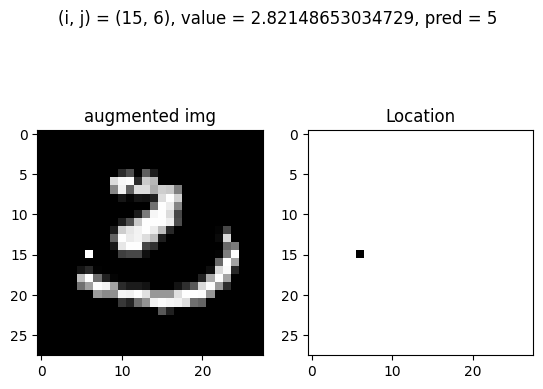

Test: At (i, j) = (15, 7) and value = 1.7395867142702586, pred = 5, before_pred = 3, gt = 3


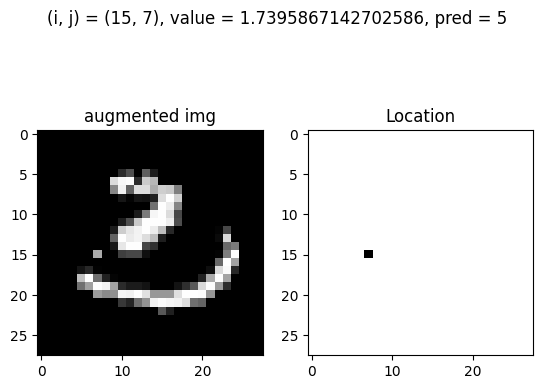

Test: At (i, j) = (15, 7) and value = 2.1002199862959356, pred = 5, before_pred = 3, gt = 3


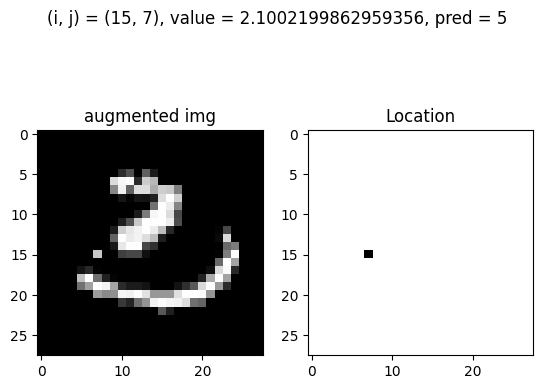

Test: At (i, j) = (15, 7) and value = 2.4608532583216127, pred = 5, before_pred = 3, gt = 3


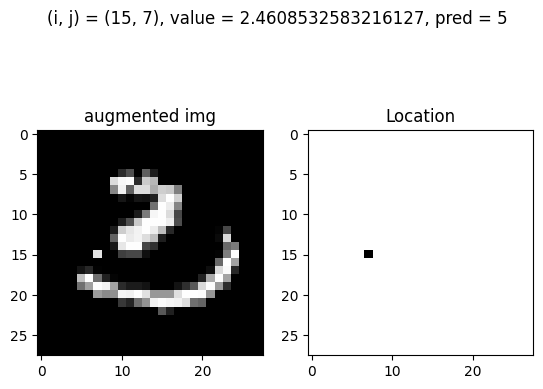

Test: At (i, j) = (15, 7) and value = 2.82148653034729, pred = 5, before_pred = 3, gt = 3


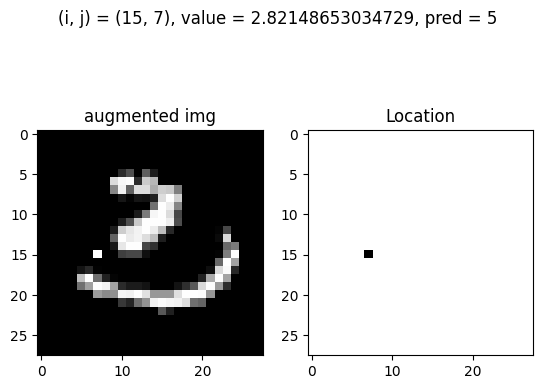

Test: At (i, j) = (15, 11) and value = 2.82148653034729, pred = 5, before_pred = 3, gt = 3


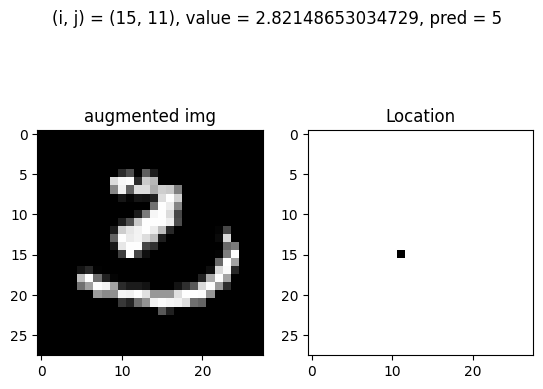

Test: At (i, j) = (16, 7) and value = 2.4608532583216127, pred = 5, before_pred = 3, gt = 3


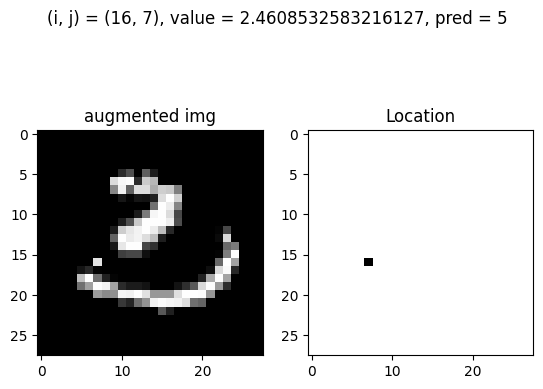

Test: At (i, j) = (16, 7) and value = 2.82148653034729, pred = 5, before_pred = 3, gt = 3


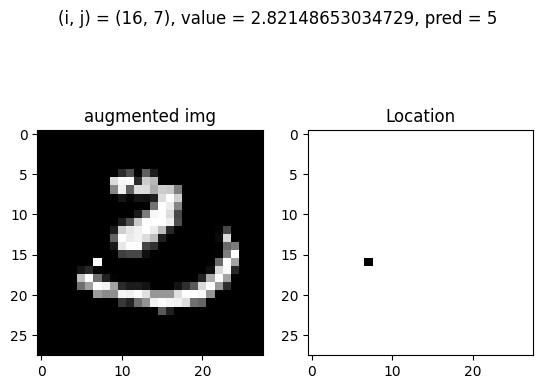

Test: At (i, j) = (16, 8) and value = 2.1002199862959356, pred = 5, before_pred = 3, gt = 3


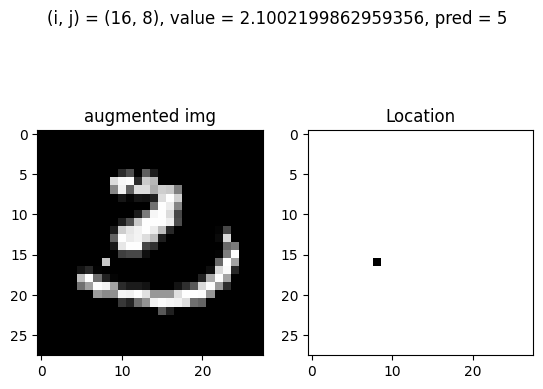

Test: At (i, j) = (16, 8) and value = 2.4608532583216127, pred = 5, before_pred = 3, gt = 3


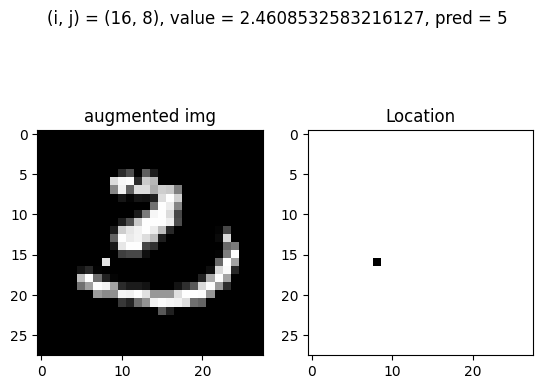

Test: At (i, j) = (16, 8) and value = 2.82148653034729, pred = 5, before_pred = 3, gt = 3


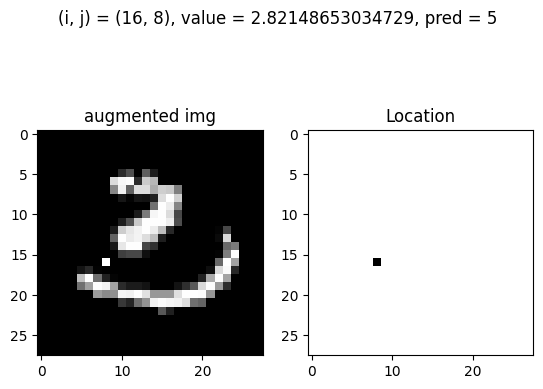

Test: At (i, j) = (16, 9) and value = 2.4608532583216127, pred = 5, before_pred = 3, gt = 3


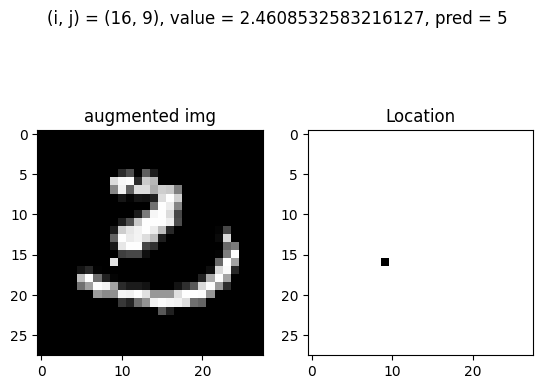

Test: At (i, j) = (16, 9) and value = 2.82148653034729, pred = 5, before_pred = 3, gt = 3


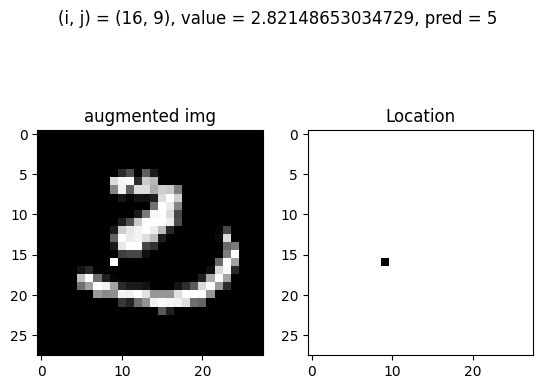

Test: At (i, j) = (16, 10) and value = 2.4608532583216127, pred = 5, before_pred = 3, gt = 3


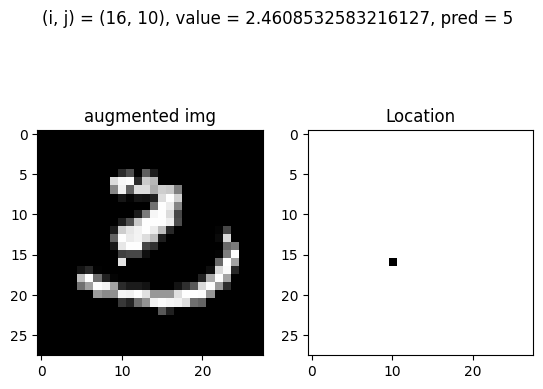

Test: At (i, j) = (16, 10) and value = 2.82148653034729, pred = 5, before_pred = 3, gt = 3


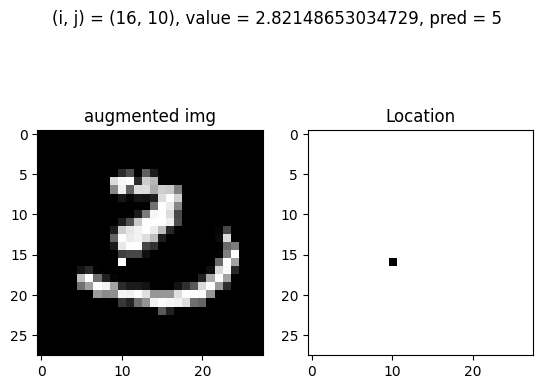

Test: At (i, j) = (17, 7) and value = 2.1002199862959356, pred = 5, before_pred = 3, gt = 3


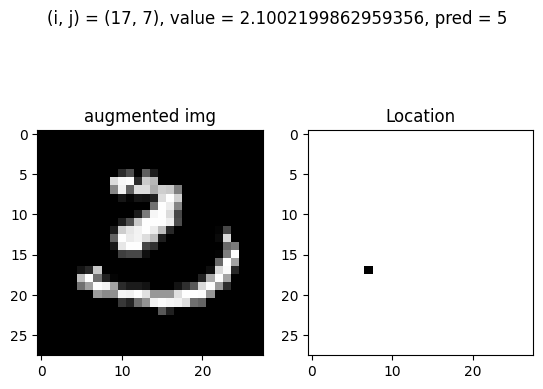

Test: At (i, j) = (17, 7) and value = 2.4608532583216127, pred = 5, before_pred = 3, gt = 3


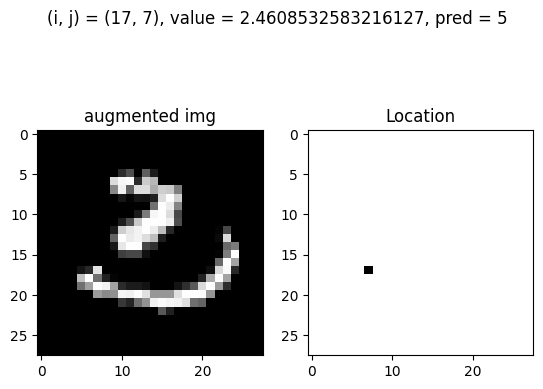

Test: At (i, j) = (17, 7) and value = 2.82148653034729, pred = 5, before_pred = 3, gt = 3


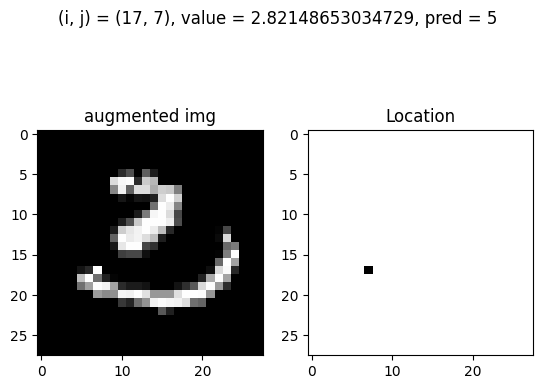

Test: At (i, j) = (17, 8) and value = 2.1002199862959356, pred = 5, before_pred = 3, gt = 3


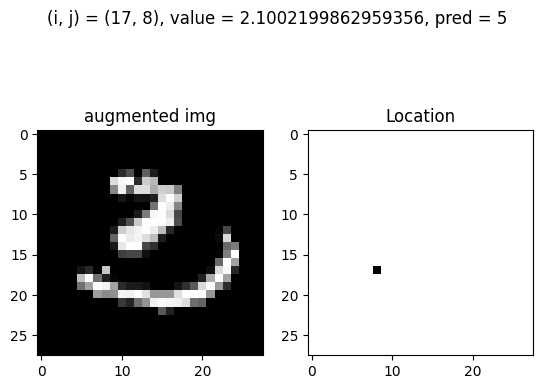

Test: At (i, j) = (17, 8) and value = 2.4608532583216127, pred = 5, before_pred = 3, gt = 3


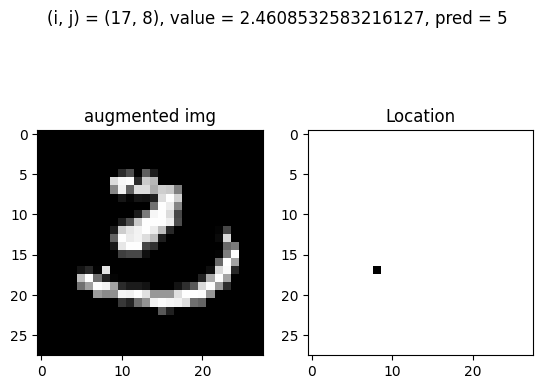

Test: At (i, j) = (17, 8) and value = 2.82148653034729, pred = 5, before_pred = 3, gt = 3


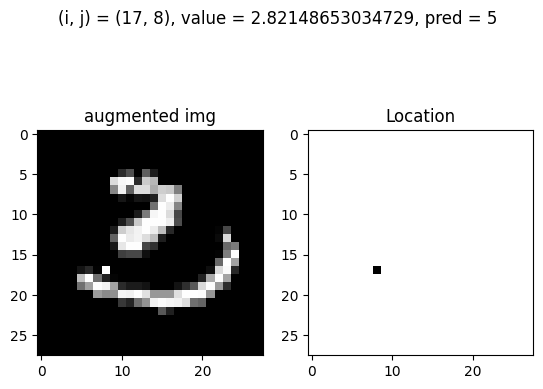

Test: At (i, j) = (17, 9) and value = 2.4608532583216127, pred = 5, before_pred = 3, gt = 3


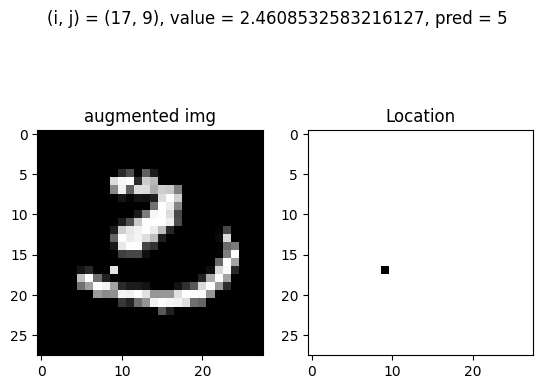

Test: At (i, j) = (17, 9) and value = 2.82148653034729, pred = 5, before_pred = 3, gt = 3


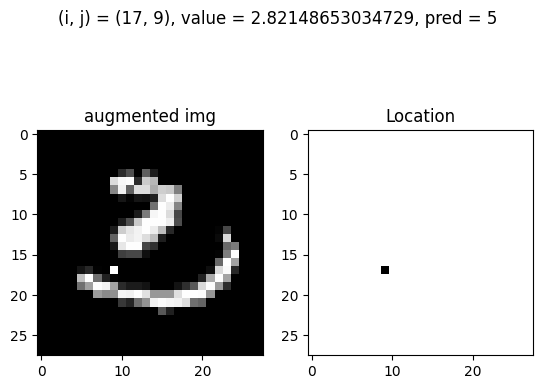

Test: At (i, j) = (17, 10) and value = 2.4608532583216127, pred = 5, before_pred = 3, gt = 3


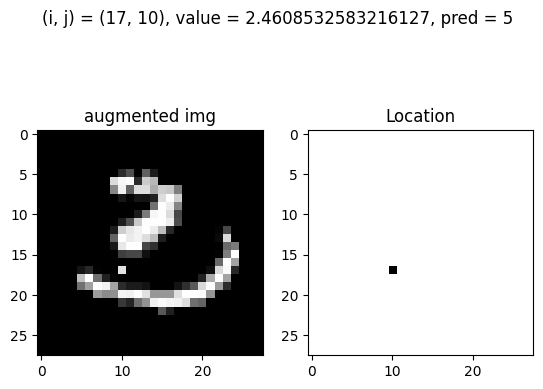

Test: At (i, j) = (17, 10) and value = 2.82148653034729, pred = 5, before_pred = 3, gt = 3


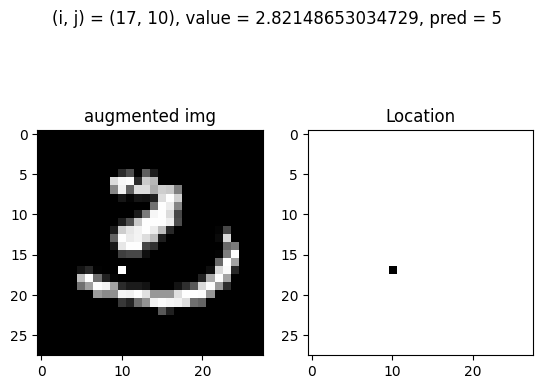

Test: At (i, j) = (20, 20) and value = -0.424212917883804, pred = 5, before_pred = 3, gt = 3


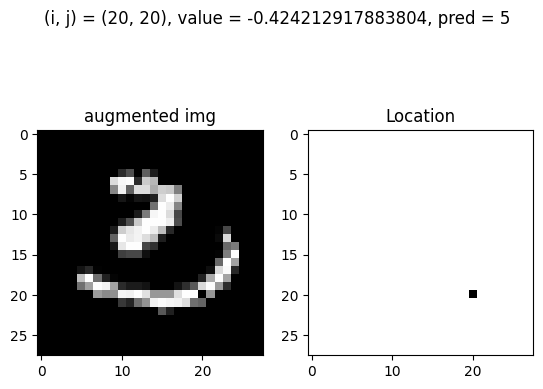

Test: At (i, j) = (20, 20) and value = -0.06357964585812692, pred = 5, before_pred = 3, gt = 3


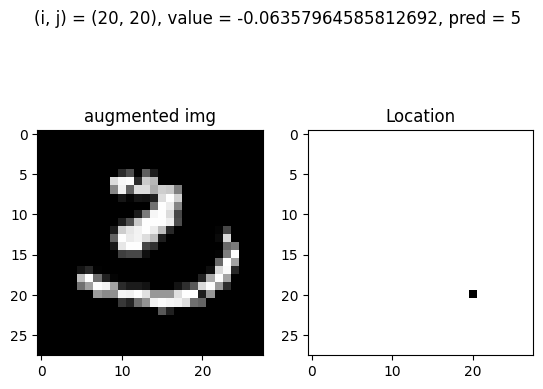

Test: At (i, j) = (24, 20) and value = 2.82148653034729, pred = 5, before_pred = 3, gt = 3


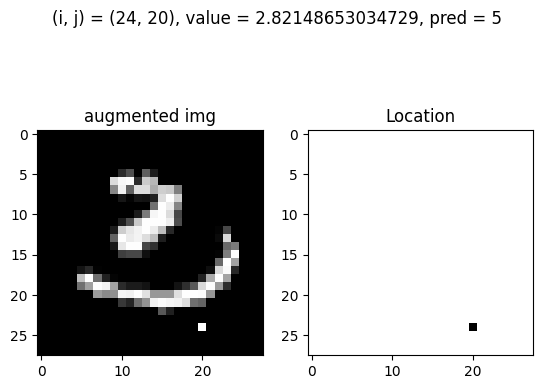

7840 done
7840 done
7840 done
7840 done
7840 done
7840 done
7840 done
7840 done
7840 done
7840 done
7840 done
7840 done
Test: At (i, j) = (11, 9) and value = -0.424212917883804, pred = 3, before_pred = 5, gt = 5


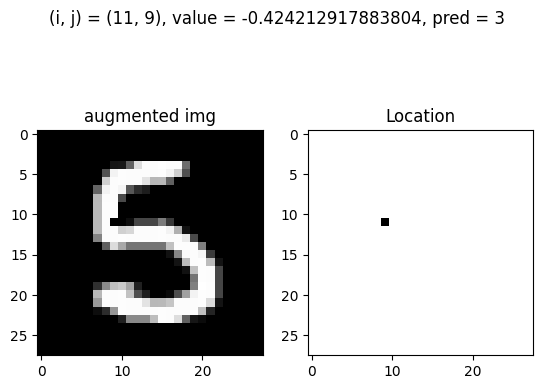

Test: At (i, j) = (11, 9) and value = -0.06357964585812692, pred = 3, before_pred = 5, gt = 5


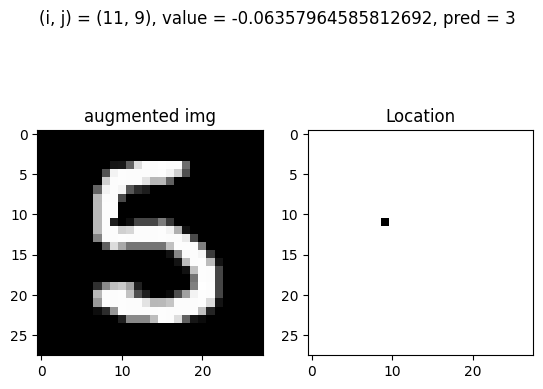

Test: At (i, j) = (12, 8) and value = -0.424212917883804, pred = 3, before_pred = 5, gt = 5


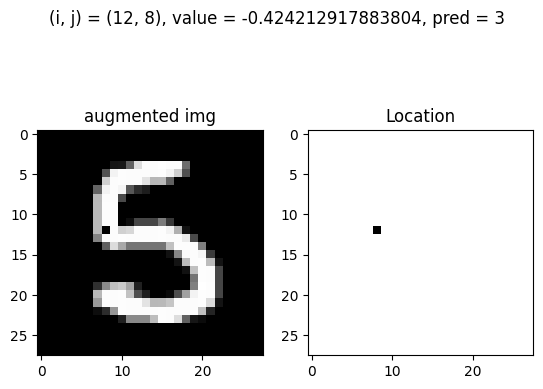

Test: At (i, j) = (13, 10) and value = -0.424212917883804, pred = 3, before_pred = 5, gt = 5


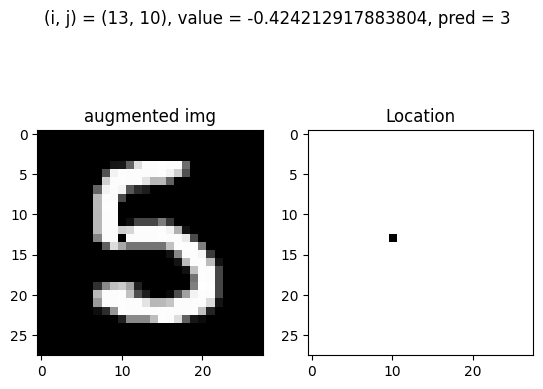

7840 done
7840 done
7840 done
7840 done
7840 done
7840 done
7840 done
7840 done
7840 done
7840 done
7840 done
7840 done
7840 done
7840 done
7840 done
7840 done
7840 done
7840 done
{1920, 4483, 4419, 9959, 5518, 5975, 3448, 1499, 2715}
Test: totally 9 (out of 100 randomly picked) images changed prediction.
 The indices of these images are 
 {1920, 4483, 4419, 9959, 5518, 5975, 3448, 1499, 2715}



In [12]:


num_sample  = 10
check_values =  np.linspace(pixel_min, pixel_max, num_sample)
print(f"Check Values = {check_values}")

# series_model_name = "FFN19-44-07"
series_model_name = "FFN15-58-32"
ep=25
model_file_name = series_model_name +f"-ep{ep}"

new_model = FeedforwardNeuralNetModel(28*28, 128, 10).to(device)
new_model.load_state_dict(torch.load(model_file_name, map_location=device))

test_problem_idx = []

num_checking = 100

for _ in range(num_checking):
    # Get the image
    random_test_idx = random.randint(0, len(test_target)-1)

    random_test_img = test_data[random_test_idx]
    random_test_label = test_target[random_test_idx]
    
    with torch.no_grad():
        random_test_pred = new_model(random_test_img[None, :]).argmax(dim=1).item()

    c = 0
    for i in range(28):
        for j in range(28):
            mask = torch.ones(random_test_img.shape)
            mask[..., i, j] = 0
            augmented_test_img = random_test_img * mask
            for v in check_values:
                c+=1
                augmented_test_img[..., i, j] = v
                with torch.no_grad():
                    test_output = new_model(augmented_test_img[None, :]).argmax(dim=1).item()

                if test_output != random_test_pred:
                    test_problem_idx.append(random_test_idx)
                    print(f"Test: At (i, j) = ({i}, {j}) and value = {v}, pred = {test_output}, before_pred = {random_test_pred}, gt = {random_test_label}")


                    plt.style.use('default')
                    f, axarr = plt.subplots(1, 2)
                    axarr[0].imshow(augmented_test_img.cpu().detach().numpy().reshape(28, 28), cmap="gray")
                    axarr[0].title.set_text(f'augmented img')
                    axarr[1].imshow(mask.cpu().detach().numpy().reshape(28, 28), cmap="gray")
                    axarr[1].title.set_text('Location')
                    plt.suptitle(f"(i, j) = ({i}, {j}), value = {v}, pred = {test_output}")
                    plt.show()
                    plt.close(f)
                    
                    
    print(c, "done")
    
print(set(test_problem_idx))
print(f"Test: totally {len(set(test_problem_idx))} (out of {num_checking} randomly picked) images changed prediction.\n The indices of these images are \n {set(test_problem_idx)}\n" )

## Checking how pixel wise of modification will affect the prediction but among all the images predicted WRONGLY by the model

In [14]:
num_sample  = 10
check_values =  np.linspace(pixel_min, pixel_max, num_sample)
print(f"Check Values = {check_values}")

# series_model_name = "FFN19-44-07"
series_model_name = "FFN15-58-32"
ep=25
model_file_name = series_model_name +f"-ep{ep}"

new_model = FeedforwardNeuralNetModel(28*28, 128, 10).to(device)
new_model.load_state_dict(torch.load(model_file_name, map_location=device))

_, train_pred = new_model(train_data).max(1)
_, test_pred = new_model(test_data).max(1)

wrong_train_pred_idx = train_pred != train_target
wrong_test_pred_idx = test_pred != test_target

wrong_train_pred_data = train_data[wrong_train_pred_idx]
wrong_test_pred_data = test_data[wrong_test_pred_idx]

wrong_train_pred_target = train_target[wrong_train_pred_idx]
wrong_test_pred_target = test_target[wrong_test_pred_idx]


train_problem_idx = []
test_problem_idx = []

num_check = 100

for img_idx in range(num_check):
    # Get the image

    random_train_idx = random.randint(0, len(wrong_train_pred_target)-1)
    random_test_idx = random.randint(0, len(wrong_test_pred_target)-1)

    random_train_img = wrong_train_pred_data[random_train_idx]
    random_test_img = wrong_test_pred_data[random_test_idx]
    random_train_label = wrong_train_pred_target[random_train_idx]
    random_test_label = wrong_test_pred_target[random_test_idx]
    with torch.no_grad():
        random_train_pred = new_model(random_train_img[None, :]).argmax(dim=1).item()
        random_test_pred = new_model(random_test_img[None, :]).argmax(dim=1).item()
        
    c = 0
    train_break = False
    test_break = False
    for i in range(28):
        for j in range(28):
            mask = torch.ones(random_train_img.shape)
            mask[..., i, j] = 0
            augmented_train_img = random_train_img * mask
            augmented_test_img = random_test_img * mask
            for v in check_values:
                c+=1
                augmented_train_img[..., i, j] = v
                augmented_test_img[..., i, j] = v
                with torch.no_grad():
                    train_output = new_model(augmented_train_img[None, :]).argmax(dim=1).item()
                    test_output = new_model(augmented_test_img[None, :]).argmax(dim=1).item()

                if train_output != random_train_pred:
                    train_problem_idx.append(random_train_idx)
#                     print(f"Train: At (i, j) = ({i}, {j}) and value = {v}, pred = {train_output}, before_pred = {random_train_pred}, gt = {random_train_label}")
                    train_break = True

#                     plt.style.use('default')
#                     f, axarr = plt.subplots(1, 2)
#     #                 axarr[0].imshow(random_train_img.cpu().detach().numpy().reshape(28, 28), cmap="gray")
#     #                 axarr[0].title.set_text(f'From train - GT {random_train_label}')
#                     axarr[0].imshow(augmented_train_img.cpu().detach().numpy().reshape(28, 28), cmap="gray")
#                     axarr[0].title.set_text(f'augmented img')
#                     axarr[1].imshow(mask.cpu().detach().numpy().reshape(28, 28), cmap="gray")
#                     axarr[1].title.set_text('Location')
#                     plt.suptitle(f"(i, j) = ({i}, {j}), value = {v}, pred = {train_output}")
#                     plt.show()
#                     plt.close(f)

                if test_output != random_test_pred:
                    test_problem_idx.append(random_test_idx)
#                     print(f"Test: At (i, j) = ({i}, {j}) and value = {v}, pred = {test_output}, before_pred = {random_test_pred}, gt = {random_test_label}")
                    test_break = True

#                     plt.style.use('default')
#                     f, axarr = plt.subplots(1, 2)

#                     axarr[0].imshow(augmented_test_img.cpu().detach().numpy().reshape(28, 28), cmap="gray")
#                     axarr[0].title.set_text(f'augmented img')
#                     axarr[1].imshow(mask.cpu().detach().numpy().reshape(28, 28), cmap="gray")
#                     axarr[1].title.set_text('Location')
#                     plt.suptitle(f"(i, j) = ({i}, {j}), value = {v}, pred = {test_output}")
#                     plt.show()
#                     plt.close(f)
                if train_break and test_break:
                    break
print(f"From all the wrongly predicted {num_check} images in both train and test set respectively:")
print(f"\t Train: {len(set(train_problem_idx))} image's predictions are affected by pixelwise checking, indices are {set(train_problem_idx)}" )
print(f"\t Test: {len(set(test_problem_idx))} image's predictions , indices are {set(test_problem_idx)}" )


Check Values = [-0.42421292 -0.06357965  0.29705363  0.6576869   1.01832017  1.37895344
  1.73958671  2.10021999  2.46085326  2.82148653]
From all the wrongly predicted 100 images in both train and test set respectively:
	 Train: 36 image's predictions are affected by pixelwise checking, indices are {2690, 1924, 4102, 2827, 1558, 1559, 5786, 284, 1309, 1821, 5539, 5795, 5669, 1065, 5546, 2606, 1711, 5936, 4407, 1727, 836, 838, 5830, 5454, 4302, 3793, 1235, 1236, 3924, 3927, 986, 3676, 3425, 2925, 2685, 2175}
	 Test: 43 image's predictions , indices are {517, 262, 903, 776, 781, 526, 911, 917, 280, 536, 156, 419, 293, 39, 429, 815, 689, 693, 949, 696, 697, 188, 966, 331, 972, 716, 337, 854, 732, 223, 352, 97, 994, 480, 228, 96, 99, 360, 105, 874, 234, 624, 882}


## Checking how pixel wise of modification will affect the prediction but among all the images predicted CORRECTLY by the model

In [15]:
num_sample = 10
check_values = np.linspace(pixel_min, pixel_max, num_sample)
print(f"Check Values = {check_values}")

# series_model_name = "FFN19-44-07"
series_model_name = "FFN15-58-32"
ep=25
model_file_name = series_model_name +f"-ep{ep}"

new_model = FeedforwardNeuralNetModel(28*28, 128, 10).to(device)
new_model.load_state_dict(torch.load(model_file_name, map_location=device))

_, train_pred = new_model(train_data).max(1)
_, test_pred = new_model(test_data).max(1)

correct_train_pred_idx = train_pred == train_target
correct_test_pred_idx = test_pred == test_target

correct_train_pred_data = train_data[correct_train_pred_idx]
correct_test_pred_data = test_data[correct_test_pred_idx]

correct_train_pred_target = train_target[correct_train_pred_idx]
correct_test_pred_target = test_target[correct_test_pred_idx]

train_problem_idx = []
test_problem_idx = []
for img_idx in range(100):
    # Get the image
    random_train_idx = random.randint(0, len(correct_train_pred_target)-1)
    random_test_idx = random.randint(0, len(correct_test_pred_target)-1)

    random_train_img = correct_train_pred_data[random_train_idx]
    random_test_img = correct_test_pred_data[random_test_idx]
    random_train_label = correct_train_pred_target[random_train_idx]
    random_test_label = correct_test_pred_target[random_test_idx]
    with torch.no_grad():
        random_train_pred = new_model(random_train_img[None, :]).argmax(dim=1).item()
        random_test_pred = new_model(random_test_img[None, :]).argmax(dim=1).item()

    c = 0
    train_break = False
    test_break = False
    for i in range(28):
        for j in range(28):
            mask = torch.ones(random_train_img.shape)
            mask[..., i, j] = 0
            augmented_train_img = random_train_img * mask
            augmented_test_img = random_test_img * mask
            for v in check_values:
                c += 1
                augmented_train_img[..., i, j] = v
                augmented_test_img[..., i, j] = v
                with torch.no_grad():
                    train_output = new_model(augmented_train_img[None, :]).argmax(dim=1).item()
                    test_output = new_model(augmented_test_img[None, :]).argmax(dim=1).item()

                if train_output != random_train_pred:
                    train_problem_idx.append(random_train_idx)
                    #                     print(f"Train: At (i, j) = ({i}, {j}) and value = {v}, pred = {train_output}, before_pred = {random_train_pred}, gt = {random_train_label}")
                    train_break = True

                #                     plt.style.use('default')
                #                     f, axarr = plt.subplots(1, 2)
                #     #                 axarr[0].imshow(random_train_img.cpu().detach().numpy().reshape(28, 28), cmap="gray")
                #     #                 axarr[0].title.set_text(f'From train - GT {random_train_label}')
                #                     axarr[0].imshow(augmented_train_img.cpu().detach().numpy().reshape(28, 28), cmap="gray")
                #                     axarr[0].title.set_text(f'augmented img')
                #                     axarr[1].imshow(mask.cpu().detach().numpy().reshape(28, 28), cmap="gray")
                #                     axarr[1].title.set_text('Location')
                #                     plt.suptitle(f"(i, j) = ({i}, {j}), value = {v}, pred = {train_output}")
                #                     plt.show()
                #                     plt.close(f)

                if test_output != random_test_pred:
                    test_problem_idx.append(random_test_idx)
                    #                     print(f"Test: At (i, j) = ({i}, {j}) and value = {v}, pred = {test_output}, before_pred = {random_test_pred}, gt = {random_test_label}")
                    test_break = True

                #                     plt.style.use('default')
                #                     f, axarr = plt.subplots(1, 2)

                #                     axarr[0].imshow(augmented_test_img.cpu().detach().numpy().reshape(28, 28), cmap="gray")
                #                     axarr[0].title.set_text(f'augmented img')
                #                     axarr[1].imshow(mask.cpu().detach().numpy().reshape(28, 28), cmap="gray")
                #                     axarr[1].title.set_text('Location')
                #                     plt.suptitle(f"(i, j) = ({i}, {j}), value = {v}, pred = {test_output}")
                #                     plt.show()
                #                     plt.close(f)
                if train_break and test_break:
                    break
                    
                    
print(f"From all the correctly predicted {num_check} images in both train and test set respectively:")
print(f"\t Train: {len(set(train_problem_idx))} image's predictions are affected by pixelwise checking, indices are {set(train_problem_idx)}" )
print(f"\t Test: {len(set(test_problem_idx))} image's predictions , indices are {set(test_problem_idx)}" )


Check Values = [-0.42421292 -0.06357965  0.29705363  0.6576869   1.01832017  1.37895344
  1.73958671  2.10021999  2.46085326  2.82148653]
From all the correctly predicted 100 images in both train and test set respectively:
	 Train: 5 image's predictions are affected by pixelwise checking, indices are {39364, 31975, 37452, 43709, 53535}
	 Test: 2 image's predictions , indices are {5216, 3707}
